#### Dependencies:

In [1]:
import os
import torch
import numpy as np
import pickle
import xgboost as xgb
import tensorflow as tf
from tensorflow.keras import layers
import shutil
import warnings
import esm

C:\Users\marle\anaconda3\envs\py37\lib\site-packages\numpy\_distributor_init.py:32: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\marle\anaconda3\envs\py37\lib\site-packages\numpy\.libs\libopenblas.PYQHXLVVQ7VESDPUVUADXEVJOBGHJPAY.gfortran-win_amd64.dll
C:\Users\marle\anaconda3\envs\py37\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  stacklevel=1)
C:\Users\marle\anaconda3\envs\py37\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
from KM_prediction import *
import os
from os.path import join
CURRENT_DIR = os.getcwd()

Before using KM prediction for the first time, we have to download the ESM-1b model:

In [3]:
import esm
model, alphabet = torch.hub.load("facebookresearch/esm:v0.4.0", "esm1b_t33_650M_UR50S")

Using cache found in C:\Users\marle/.cache\torch\hub\facebookresearch_esm_v0.4.0


Example for calculating KM prediction. You can enter multiple enyzmes and substrates. Enzyme 1 will be paired with substrate 1, enzyme 2 will be paired with substrate 2 and so on...

Enter enzymes as amino acid sequences and substrate either as SMILES strings, KEGG Compound IDs, or InChI strings.

In [2]:
from KM_prediction import *

import pandas as pd

organism = 'Escherichia coli'

data = pd.read_table('../data/KM_model_' + organism + '.tsv', sep='\t')

data["KM"] = data["KM"]*10**3

KMvalid, KMinvalid = KM_predicton(substrate_list = data["substrate ID"].tolist(), 
             enzyme_list = data["Sequence"].tolist(),
                                 KM = np.log10(data["KM"].tolist()),
                                 EC = data["ECs"].tolist())

C:\Users\marle\anaconda3\envs\py37\lib\site-packages\numpy\_distributor_init.py:32: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\marle\anaconda3\envs\py37\lib\site-packages\numpy\.libs\libopenblas.PYQHXLVVQ7VESDPUVUADXEVJOBGHJPAY.gfortran-win_amd64.dll
C:\Users\marle\anaconda3\envs\py37\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  stacklevel=1)


In [18]:
df.replace(-np.inf, np.nan, inplace=True)
df.dropna(inplace=True)

In [12]:
import scipy as sci
import sklearn.metrics as sk

rms = sk.mean_squared_error(df["value"].tolist(), df["KM [mM]"].tolist(), squared=False)
R2 = sk.r2_score(df["value"].tolist(), df["KM [mM]"].tolist())
Pearson = sci.stats.pearsonr(df["value"].tolist(), df["KM [mM]"].tolist())[0]

print(rms, R2, Pearson)

rms = sk.mean_squared_error((10**df["value"]).tolist(), (10**df["KM [mM]"]).tolist(), squared=False)
R2 = sk.r2_score((10**df["value"]).tolist(), (10**df["KM [mM]"]).tolist())
Pearson = sci.stats.pearsonr((10**df["value"]).tolist(), (10**df["KM [mM]"]).tolist())[0]

print(rms, R2, Pearson)

1.2546283432722383 0.06406872016751264 0.3744127529009388
44.44582138539796 -0.04698344917247943 0.05579753212581799


In [6]:
df = KMvalid
df = df.rename(columns={'enzyme': 'Sequence'})       
KMvalid.to_pickle('../data/output_' + organism + '.pkl')
df = pd.read_pickle(open('../data/output_Escherichia coli.pkl', 'rb'))
data_train = pd.read_pickle(open("../data/train-test data/training_data.pkl", "rb"))

In [49]:
df["reaction_sim"] = np.nan

for ind in df.index:
    max_sim=[]
    for ind2 in data_train.index:
        vector1_norm = df["GNN rep"][ind] / np.linalg.norm(df["GNN rep"][ind])
        vector2_norm = data_train["GNN FP"][ind2] / np.linalg.norm(data_train["GNN FP"][ind2])
        sim = 1- scipy.spatial.distance.cdist(vector1_norm.reshape(1,-1),vector2_norm.reshape(1,-1), metric='cosine')
        max_sim.append(sim)
        print(sim)
    df["reaction_sim"][ind] = max(max_sim)
    

df["reaction_sim"]= (df["reaction_sim"] - np.min(df["reaction_sim"]))
df["reaction_sim"] = df["reaction_sim"]/np.max(df["reaction_sim"])

df["reaction_sim"] = df["reaction_sim"]*100

[[0.98424016]]
[[0.99493758]]
[[0.9885838]]
[[0.97838087]]
[[0.9892798]]
[[0.90350934]]
[[0.96905012]]
[[0.98197189]]
[[0.98137822]]
[[0.99608369]]
[[0.9898566]]
[[0.9975011]]
[[0.99748931]]
[[0.98570376]]
[[0.97362476]]
[[0.99340362]]
[[0.99668313]]
[[0.98880424]]
[[0.93065817]]
[[0.94786627]]
[[0.99555793]]
[[0.99607173]]
[[0.98084856]]
[[0.98732805]]
[[0.99555793]]
[[0.97337381]]
[[0.99243237]]
[[0.99243237]]
[[0.99697691]]
[[0.98973499]]
[[0.98897856]]
[[0.99243237]]
[[0.93065817]]
[[0.98626109]]
[[0.98160535]]
[[0.99260245]]
[[0.9891106]]
[[0.99340362]]
[[0.99873241]]
[[0.97665032]]
[[0.88063236]]
[[0.9895207]]
[[0.99697691]]
[[0.99155397]]
[[0.98052901]]
[[0.99146928]]
[[0.97337381]]
[[0.99555793]]
[[0.99730686]]
[[0.99434196]]
[[0.96358596]]
[[0.98762612]]
[[0.98762612]]
[[0.98867777]]
[[0.99243237]]
[[0.98166291]]
[[0.97064724]]
[[0.97362476]]
[[0.99243237]]
[[0.99187128]]
[[0.97932951]]
[[0.99580074]]
[[0.88083334]]
[[0.9833281]]
[[0.96884758]]
[[0.98700998]]
[[0.9696006]]
[[0

[[0.94621489]]
[[0.99555793]]
[[0.99555793]]
[[0.99195081]]
[[0.9975011]]
[[0.98725039]]
[[0.88098306]]
[[0.99244779]]
[[0.97291984]]
[[0.98580788]]
[[0.90012283]]
[[0.96860628]]
[[0.99555793]]
[[0.99340602]]
[[0.99493758]]
[[0.94877587]]
[[0.90012283]]
[[0.99187128]]
[[0.99243237]]
[[0.9761002]]
[[0.98701155]]
[[0.99352204]]
[[0.96972877]]
[[0.98442516]]
[[0.96720644]]
[[0.9802114]]
[[0.99697691]]
[[0.98394188]]
[[0.99321014]]
[[0.99146928]]
[[0.98732805]]
[[0.98551773]]
[[0.94540051]]
[[0.96358596]]
[[0.99243237]]
[[0.99434196]]
[[0.98801095]]
[[0.99268522]]
[[0.97493767]]
[[0.97362476]]
[[0.99555793]]
[[0.98914866]]
[[0.98459302]]
[[0.99555793]]
[[0.99181789]]
[[0.99407883]]
[[0.99157085]]
[[0.99555793]]
[[0.97665032]]
[[0.98533529]]
[[0.98568148]]
[[0.99555793]]
[[0.99672341]]
[[0.9843015]]
[[0.93232586]]
[[0.98394188]]
[[0.88086785]]
[[0.99808006]]
[[0.97941602]]
[[0.99674285]]
[[0.99340362]]
[[0.99803898]]
[[0.97953492]]
[[0.97497457]]
[[0.99493758]]
[[0.99700243]]
[[0.99243237]]

[[0.98770104]]
[[0.98792029]]
[[0.99697691]]
[[0.99186275]]
[[0.98080101]]
[[0.95952294]]
[[0.9679663]]
[[0.98732805]]
[[0.99340362]]
[[0.99465305]]
[[0.97464725]]
[[0.93065817]]
[[0.97057991]]
[[0.99340362]]
[[0.99800167]]
[[0.98401716]]
[[0.99697691]]
[[0.99521511]]
[[0.99076883]]
[[0.99243237]]
[[0.98732805]]
[[0.98160535]]
[[0.99523538]]
[[0.98420975]]
[[0.99478083]]
[[0.99697691]]
[[0.99536777]]
[[0.9888671]]
[[0.9975011]]
[[0.94780543]]
[[0.99269898]]
[[0.98243482]]
[[0.90350934]]
[[0.99243237]]
[[0.98905205]]
[[0.90012283]]
[[0.99502632]]
[[0.98990213]]
[[0.98394188]]
[[0.97786562]]
[[0.98341703]]
[[0.98631861]]
[[0.99697691]]
[[0.98624294]]
[[0.97698706]]
[[0.96421306]]
[[0.99410025]]
[[0.98628211]]
[[0.99340362]]
[[0.99624123]]
[[0.99697691]]
[[0.96905012]]
[[0.98251997]]
[[0.97294054]]
[[0.97760235]]
[[0.97941602]]
[[0.95288814]]
[[0.98285228]]
[[0.99608369]]
[[0.97060399]]
[[0.93065817]]
[[0.97732595]]
[[0.96358596]]
[[0.99555793]]
[[0.93065817]]
[[0.99493758]]
[[0.97125696]

[[0.99555793]]
[[0.99340362]]
[[0.99697691]]
[[0.99697691]]
[[0.99697691]]
[[0.98866707]]
[[0.99243237]]
[[0.99697691]]
[[0.98905205]]
[[0.99748931]]
[[0.96391501]]
[[0.97826251]]
[[0.98732805]]
[[0.98749682]]
[[0.99418782]]
[[0.98785443]]
[[0.99453059]]
[[0.96788443]]
[[0.99340362]]
[[0.97999565]]
[[0.99697691]]
[[0.90350934]]
[[0.9925884]]
[[0.98925751]]
[[0.96860628]]
[[0.99155744]]
[[0.97298387]]
[[0.98944957]]
[[0.97337381]]
[[0.97941602]]
[[0.98273731]]
[[0.99493758]]
[[0.99697691]]
[[0.99536777]]
[[0.99008683]]
[[0.9975011]]
[[0.99697691]]
[[0.97318907]]
[[0.98401716]]
[[0.99340602]]
[[0.98967673]]
[[0.97060399]]
[[0.99730686]]
[[0.90012283]]
[[0.88063066]]
[[0.98734893]]
[[0.98917432]]
[[0.90012283]]
[[0.97181073]]
[[0.97362476]]
[[0.98847661]]
[[0.98732805]]
[[0.97941602]]
[[0.99340362]]
[[0.98914866]]
[[0.98826277]]
[[0.98762612]]
[[0.99754727]]
[[0.97585374]]
[[0.99767864]]
[[0.97375768]]
[[0.9975011]]
[[0.99730686]]
[[0.96171828]]
[[0.99340362]]
[[0.95851626]]
[[0.9925884]]

[[0.94540051]]
[[0.95518006]]
[[0.99697691]]
[[0.98819779]]
[[0.99697691]]
[[0.99493758]]
[[0.98801095]]
[[0.90350934]]
[[0.99135779]]
[[0.97941602]]
[[0.96972877]]
[[0.98742889]]
[[0.99340362]]
[[0.99219548]]
[[0.94621489]]
[[0.96815473]]
[[0.99421989]]
[[0.99345046]]
[[0.99616965]]
[[0.96068136]]
[[0.97838087]]
[[0.98725184]]
[[0.99243237]]
[[0.99803898]]
[[0.98427534]]
[[0.99831332]]
[[0.98677294]]
[[0.97362476]]
[[0.95232996]]
[[0.98710257]]
[[0.97433112]]
[[0.9792451]]
[[0.95766354]]
[[0.99187128]]
[[0.99340362]]
[[0.9895207]]
[[0.9825114]]
[[0.99577939]]
[[0.99792669]]
[[0.99340362]]
[[0.97688562]]
[[0.97362476]]
[[0.99697691]]
[[0.98330723]]
[[0.9975011]]
[[0.93471053]]
[[0.98867777]]
[[0.98235307]]
[[0.98710257]]
[[0.98732805]]
[[0.98088763]]
[[0.96491773]]
[[0.98390076]]
[[0.98874191]]
[[0.99243237]]
[[0.95470631]]
[[0.99340362]]
[[0.93065817]]
[[0.98324927]]
[[0.97125696]]
[[0.99697691]]
[[0.982326]]
[[0.99004654]]
[[0.97060399]]
[[0.99555793]]
[[0.98390076]]
[[0.97060399]]
[

[[0.99555793]]
[[0.94621489]]
[[0.9969436]]
[[0.99672341]]
[[0.98445005]]
[[0.99243237]]
[[0.98967673]]
[[0.99740943]]
[[0.99697691]]
[[0.93921818]]
[[0.98279836]]
[[0.97464725]]
[[0.99493758]]
[[0.93065817]]
[[0.99243237]]
[[0.98538064]]
[[0.99595552]]
[[0.99493758]]
[[0.98626109]]
[[0.98746429]]
[[0.9975011]]
[[0.98762612]]
[[0.98137718]]
[[0.98696719]]
[[0.98734893]]
[[0.99243237]]
[[0.96964409]]
[[0.99594065]]
[[0.98988833]]
[[0.98024335]]
[[0.94816761]]
[[0.88079875]]
[[0.99243237]]
[[0.94613554]]
[[0.93065817]]
[[0.97337381]]
[[0.99493758]]
[[0.98189302]]
[[0.99564846]]
[[0.98342059]]
[[0.97375768]]
[[0.99536777]]
[[0.97060399]]
[[0.99697691]]
[[0.99477628]]
[[0.99697691]]
[[0.99697691]]
[[0.97941602]]
[[0.98777762]]
[[0.99243237]]
[[0.99197595]]
[[0.99803898]]
[[0.96627089]]
[[0.99146928]]
[[0.99340602]]
[[0.98732805]]
[[0.99555793]]
[[0.99697691]]
[[0.99674285]]
[[0.98264467]]
[[0.98585043]]
[[0.98657844]]
[[0.99008683]]
[[0.97476934]]
[[0.99883585]]
[[0.98018069]]
[[0.97337381

[[0.99831332]]
[[0.99372208]]
[[0.98906296]]
[[0.99808006]]
[[0.99243237]]
[[0.99197595]]
[[0.99070249]]
[[0.98661626]]
[[0.99180819]]
[[0.98181685]]
[[0.98197189]]
[[0.99748931]]
[[0.97804709]]
[[0.97469034]]
[[0.99269898]]
[[0.97060399]]
[[0.99730686]]
[[0.97957901]]
[[0.98533529]]
[[0.97552874]]
[[0.99697691]]
[[0.99340362]]
[[0.97060399]]
[[0.98264467]]
[[0.94540051]]
[[0.9750723]]
[[0.96447837]]
[[0.99243237]]
[[0.98570376]]
[[0.98705747]]
[[0.99697691]]
[[0.98570376]]
[[0.99243237]]
[[0.98646103]]
[[0.98212391]]
[[0.98011841]]
[[0.9888035]]
[[0.99730686]]
[[0.99614454]]
[[0.96402479]]
[[0.98084856]]
[[0.99340362]]
[[0.99568404]]
[[0.98197189]]
[[0.98801095]]
[[0.98197189]]
[[0.99697691]]
[[0.98189521]]
[[0.97565184]]
[[0.99651344]]
[[0.99555793]]
[[0.99340362]]
[[0.98442107]]
[[0.98872879]]
[[0.9895207]]
[[0.9895207]]
[[0.99555793]]
[[0.9336399]]
[[0.99260245]]
[[0.99243237]]
[[0.97999565]]
[[0.9624205]]
[[0.94813876]]
[[0.94016708]]
[[0.99686954]]
[[0.96448716]]
[[0.97709988]]
[

[[0.99616085]]
[[0.96278486]]
[[0.99697691]]
[[0.93065817]]
[[0.97096855]]
[[0.99730686]]
[[0.96972877]]
[[0.98445005]]
[[0.88076574]]
[[0.9975011]]
[[0.99883585]]
[[0.99882541]]
[[0.97464725]]
[[0.98235307]]
[[0.98847661]]
[[0.98533529]]
[[0.98024335]]
[[0.94540051]]
[[0.98235307]]
[[0.96818695]]
[[0.96278486]]
[[0.99340362]]
[[0.98243482]]
[[0.9956475]]
[[0.99697691]]
[[0.99434196]]
[[0.99697691]]
[[0.97682073]]
[[0.99393547]]
[[0.97939293]]
[[0.9786261]]
[[0.96538047]]
[[0.95624322]]
[[0.99555793]]
[[0.97665032]]
[[0.97957901]]
[[0.99883585]]
[[0.99243237]]
[[0.99321014]]
[[0.97077408]]
[[0.99436846]]
[[0.98652855]]
[[0.97396867]]
[[0.99302407]]
[[0.98879613]]
[[0.99697691]]
[[0.9895207]]
[[0.99243237]]
[[0.98974219]]
[[0.90350934]]
[[0.99697691]]
[[0.99493758]]
[[0.98401716]]
[[0.98355189]]
[[0.99697691]]
[[0.98450263]]
[[0.99659852]]
[[0.9689234]]
[[0.99527452]]
[[0.99269898]]
[[0.98533529]]
[[0.98770673]]
[[0.99697691]]
[[0.99730686]]
[[0.95971]]
[[0.98390076]]
[[0.99069519]]
[[0

[[0.98990213]]
[[0.98826085]]
[[0.99340362]]
[[0.99697691]]
[[0.9660526]]
[[0.98845058]]
[[0.98255284]]
[[0.99219548]]
[[0.99243237]]
[[0.99517031]]
[[0.99697691]]
[[0.9975011]]
[[0.99808006]]
[[0.99186275]]
[[0.99730686]]
[[0.99536777]]
[[0.98796795]]
[[0.96079239]]
[[0.97737877]]
[[0.98155012]]
[[0.98628041]]
[[0.99493758]]
[[0.98427534]]
[[0.99697691]]
[[0.97064724]]
[[0.98005805]]
[[0.99748931]]
[[0.88086785]]
[[0.98732805]]
[[0.96438951]]
[[0.99741083]]
[[0.99410025]]
[[0.99555793]]
[[0.99555793]]
[[0.99692731]]
[[0.99480058]]
[[0.93065817]]
[[0.99697691]]
[[0.99748931]]
[[0.98853301]]
[[0.98624294]]
[[0.95255831]]
[[0.98137822]]
[[0.99536777]]
[[0.99697691]]
[[0.97941602]]
[[0.99697691]]
[[0.99340362]]
[[0.97562066]]
[[0.9751262]]
[[0.97688562]]
[[0.94946679]]
[[0.98197189]]
[[0.98197189]]
[[0.98770104]]
[[0.97274112]]
[[0.90350934]]
[[0.98457809]]
[[0.90012283]]
[[0.99808006]]
[[0.98626109]]
[[0.99697691]]
[[0.99340362]]
[[0.98628041]]
[[0.95084918]]
[[0.97957901]]
[[0.94780543]

[[0.99763036]]
[[0.99712859]]
[[0.97186755]]
[[0.95587015]]
[[0.88878339]]
[[0.97019776]]
[[0.98548843]]
[[0.96914261]]
[[0.99687146]]
[[0.98261101]]
[[0.96897883]]
[[0.98649804]]
[[0.97805757]]
[[0.97805757]]
[[0.89126126]]
[[0.97395871]]
[[0.9750668]]
[[0.98601346]]
[[0.99822716]]
[[0.98112538]]
[[0.98619005]]
[[0.98651381]]
[[0.99902089]]
[[0.9923417]]
[[0.99744441]]
[[0.99921635]]
[[0.86531912]]
[[0.99853492]]
[[0.99744441]]
[[0.99744441]]
[[0.99172999]]
[[0.99921635]]
[[0.95348175]]
[[0.99744441]]
[[0.99853492]]
[[0.98157632]]
[[0.98187732]]
[[0.94946088]]
[[0.98323136]]
[[0.96383349]]
[[0.99190293]]
[[0.99769148]]
[[0.98693288]]
[[0.99873929]]
[[0.94373856]]
[[0.97565103]]
[[0.98830304]]
[[0.99190293]]
[[0.99454606]]
[[0.96926844]]
[[0.9146833]]
[[0.99921635]]
[[0.99825217]]
[[0.99921635]]
[[0.98040972]]
[[0.99793016]]
[[0.97431604]]
[[0.99314524]]
[[0.99921635]]
[[0.97229755]]
[[0.98009004]]
[[0.99744441]]
[[0.99043076]]
[[0.98943481]]
[[0.92554113]]
[[0.98860444]]
[[0.95918772]

[[0.99744441]]
[[0.97958388]]
[[0.98534441]]
[[0.98680768]]
[[0.98321416]]
[[0.97053553]]
[[0.94127217]]
[[0.96108168]]
[[0.99873929]]
[[0.98675979]]
[[0.96830047]]
[[0.96516607]]
[[0.97293359]]
[[0.98940915]]
[[0.99108936]]
[[0.99744441]]
[[0.88878339]]
[[0.98344893]]
[[0.99873929]]
[[0.99652711]]
[[0.97587615]]
[[0.97565103]]
[[0.99769148]]
[[0.99509083]]
[[0.99744441]]
[[0.98649804]]
[[0.96970731]]
[[0.98619382]]
[[0.99744441]]
[[0.99712859]]
[[0.95959609]]
[[0.99281054]]
[[0.95348175]]
[[0.98117943]]
[[0.92554113]]
[[0.99584238]]
[[0.96383349]]
[[0.97989168]]
[[0.99351034]]
[[0.99853492]]
[[0.96086821]]
[[0.99769148]]
[[0.95918772]]
[[0.98619005]]
[[0.98293548]]
[[0.95994319]]
[[0.93083209]]
[[0.97494318]]
[[0.98680768]]
[[0.98006447]]
[[0.99418173]]
[[0.95348175]]
[[0.88493684]]
[[0.99639555]]
[[0.98261101]]
[[0.99873929]]
[[0.97326788]]
[[0.96042865]]
[[0.99190293]]
[[0.99744441]]
[[0.9617442]]
[[0.96969797]]
[[0.99407383]]
[[0.99363529]]
[[0.98649804]]
[[0.99659576]]
[[0.9971285

[[0.97050694]]
[[0.99123455]]
[[0.99744441]]
[[0.95873427]]
[[0.98735356]]
[[0.98323136]]
[[0.96037089]]
[[0.98311281]]
[[0.97710091]]
[[0.86509412]]
[[0.96968381]]
[[0.99406114]]
[[0.96775383]]
[[0.99744441]]
[[0.98323136]]
[[0.9818281]]
[[0.99671306]]
[[0.97710091]]
[[0.97565103]]
[[0.97464953]]
[[0.98321416]]
[[0.99190293]]
[[0.98356716]]
[[0.99744441]]
[[0.98307097]]
[[0.95169553]]
[[0.93037126]]
[[0.93478957]]
[[0.99921635]]
[[0.99769148]]
[[0.98187732]]
[[0.98915321]]
[[0.96667754]]
[[0.97243717]]
[[0.99853492]]
[[0.94127217]]
[[0.99744441]]
[[0.98261101]]
[[0.92554113]]
[[0.99430319]]
[[0.99804195]]
[[0.99298698]]
[[0.97565103]]
[[0.99806712]]
[[0.94914872]]
[[0.97778151]]
[[0.97580536]]
[[0.96868413]]
[[0.90326579]]
[[0.95421967]]
[[0.96966908]]
[[0.98229901]]
[[0.9846603]]
[[0.95587015]]
[[0.99670886]]
[[0.96627645]]
[[0.99833777]]
[[0.98274835]]
[[0.92554113]]
[[0.98015369]]
[[0.9848032]]
[[0.95827238]]
[[0.94946088]]
[[0.99853492]]
[[0.99744441]]
[[0.99744441]]
[[0.99769148]

[[0.9869298]]
[[0.92554113]]
[[0.98550519]]
[[0.98261101]]
[[0.98343007]]
[[0.99769148]]
[[0.99205537]]
[[0.93478957]]
[[0.97886017]]
[[0.99769148]]
[[0.99036753]]
[[0.98835033]]
[[0.96926844]]
[[0.9550066]]
[[0.99873929]]
[[0.96830047]]
[[0.99744441]]
[[0.98573738]]
[[0.99853492]]
[[0.99873929]]
[[0.99418173]]
[[0.97229755]]
[[0.95866323]]
[[0.99427626]]
[[0.99853492]]
[[0.95420206]]
[[0.97805757]]
[[0.98490233]]
[[0.93077772]]
[[0.9746425]]
[[0.99744441]]
[[0.99769148]]
[[0.99744441]]
[[0.96968381]]
[[0.98040972]]
[[0.98229901]]
[[0.99921635]]
[[0.9846603]]
[[0.99921635]]
[[0.98660511]]
[[0.99769148]]
[[0.97042058]]
[[0.99418173]]
[[0.97389719]]
[[0.98472823]]
[[0.99812554]]
[[0.97929741]]
[[0.98835033]]
[[0.99744441]]
[[0.9687943]]
[[0.99712859]]
[[0.99190293]]
[[0.98404383]]
[[0.98693038]]
[[0.98945333]]
[[0.99873929]]
[[0.99806712]]
[[0.9146833]]
[[0.9636252]]
[[0.99873929]]
[[0.99659576]]
[[0.99670886]]
[[0.98848576]]
[[0.98416997]]
[[0.9962156]]
[[0.95260695]]
[[0.9146833]]
[[0.

[[0.97343306]]
[[0.99921635]]
[[0.86531912]]
[[0.98619005]]
[[0.97710091]]
[[0.98348415]]
[[0.99729657]]
[[0.99853492]]
[[0.99032044]]
[[0.89126126]]
[[0.96451395]]
[[0.9146833]]
[[0.95994319]]
[[0.98040972]]
[[0.99796905]]
[[0.99123455]]
[[0.98229901]]
[[0.99736786]]
[[0.97421684]]
[[0.99796905]]
[[0.96830047]]
[[0.99825217]]
[[0.98299568]]
[[0.99853492]]
[[0.95959609]]
[[0.98843554]]
[[0.99119009]]
[[0.9976644]]
[[0.96757455]]
[[0.98344893]]
[[0.99769148]]
[[0.99668922]]
[[0.98915321]]
[[0.97019776]]
[[0.99699336]]
[[0.96703455]]
[[0.99066736]]
[[0.97580536]]
[[0.99712859]]
[[0.99053829]]
[[0.9654704]]
[[0.99712859]]
[[0.99744441]]
[[0.99605962]]
[[0.99029462]]
[[0.99020287]]
[[0.99769148]]
[[0.88878339]]
[[0.98321416]]
[[0.97565103]]
[[0.95959609]]
[[0.98356716]]
[[0.95499751]]
[[0.97357386]]
[[0.99814259]]
[[0.95891111]]
[[0.99036753]]
[[0.99797304]]
[[0.99154012]]
[[0.98129101]]
[[0.95348175]]
[[0.99921635]]
[[0.97951468]]
[[0.99853492]]
[[0.97726314]]
[[0.99744441]]
[[0.99154012]

[[0.99205537]]
[[0.97805757]]
[[0.99744441]]
[[0.99123455]]
[[0.99873929]]
[[0.99659576]]
[[0.96968381]]
[[0.99029462]]
[[0.99123455]]
[[0.99873929]]
[[0.98224881]]
[[0.99921635]]
[[0.99853492]]
[[0.94127217]]
[[0.9818281]]
[[0.99630262]]
[[0.99769148]]
[[0.97805757]]
[[0.99489738]]
[[0.95873427]]
[[0.96667754]]
[[0.86233622]]
[[0.98693038]]
[[0.96685641]]
[[0.99584288]]
[[0.95959609]]
[[0.97231193]]
[[0.99744441]]
[[0.9689109]]
[[0.99430319]]
[[0.99390922]]
[[0.98274835]]
[[0.92554113]]
[[0.98293248]]
[[0.99792414]]
[[0.98293248]]
[[0.99712859]]
[[0.97357386]]
[[0.99769148]]
[[0.99796905]]
[[0.98619005]]
[[0.99190293]]
[[0.92555196]]
[[0.93691387]]
[[0.95665787]]
[[0.95348175]]
[[0.97805757]]
[[0.99769148]]
[[0.86551906]]
[[0.99873929]]
[[0.98619005]]
[[0.97389719]]
[[0.97093836]]
[[0.98675979]]
[[0.98485715]]
[[0.99216957]]
[[0.98261101]]
[[0.99744441]]
[[0.99744441]]
[[0.99769148]]
[[0.98371641]]
[[0.97580536]]
[[0.99744441]]
[[0.99605962]]
[[0.98836103]]
[[0.98246673]]
[[0.97282433

[[0.98649804]]
[[0.99744441]]
[[0.9981817]]
[[0.98321416]]
[[0.92554113]]
[[0.96830047]]
[[0.88878339]]
[[0.96688954]]
[[0.99418173]]
[[0.98117943]]
[[0.99769148]]
[[0.97431604]]
[[0.90669733]]
[[0.97565103]]
[[0.98667581]]
[[0.95918772]]
[[0.9423132]]
[[0.98301917]]
[[0.97673932]]
[[0.99744441]]
[[0.99769148]]
[[0.97957821]]
[[0.98261101]]
[[0.98274835]]
[[0.98229901]]
[[0.95352582]]
[[0.99154012]]
[[0.96332612]]
[[0.99712859]]
[[0.99744441]]
[[0.97033088]]
[[0.96905086]]
[[0.98818487]]
[[0.88878339]]
[[0.99820914]]
[[0.99712859]]
[[0.89964945]]
[[0.99744441]]
[[0.99699336]]
[[0.95918772]]
[[0.97584441]]
[[0.95421967]]
[[0.99441109]]
[[0.99744441]]
[[0.9146833]]
[[0.93037126]]
[[0.97710091]]
[[0.98999803]]
[[0.99029462]]
[[0.9684562]]
[[0.99744441]]
[[0.99744441]]
[[0.99744441]]
[[0.99873929]]
[[0.98619382]]
[[0.99717137]]
[[0.97169908]]
[[0.99744441]]
[[0.99921635]]
[[0.96316127]]
[[0.99687146]]
[[0.98362463]]
[[0.97431604]]
[[0.98321416]]
[[0.9830008]]
[[0.98548843]]
[[0.99822716]]


[[0.97957821]]
[[0.99796905]]
[[0.98989885]]
[[0.92554113]]
[[0.98555679]]
[[0.97486916]]
[[0.97213777]]
[[0.99085476]]
[[0.99123455]]
[[0.99744441]]
[[0.98161056]]
[[0.9872105]]
[[0.97528732]]
[[0.95959609]]
[[0.94631776]]
[[0.98675979]]
[[0.99712859]]
[[0.98123446]]
[[0.99769148]]
[[0.98344224]]
[[0.99873929]]
[[0.97229755]]
[[0.97734989]]
[[0.9941759]]
[[0.96571606]]
[[0.99793016]]
[[0.97805757]]
[[0.98887627]]
[[0.97778151]]
[[0.98829334]]
[[0.96789831]]
[[0.99825217]]
[[0.98704101]]
[[0.99873929]]
[[0.99921635]]
[[0.99921635]]
[[0.98416997]]
[[0.99921635]]
[[0.99744441]]
[[0.99205537]]
[[0.97886017]]
[[0.98783971]]
[[0.97229755]]
[[0.92475923]]
[[0.99724829]]
[[0.98321416]]
[[0.97143331]]
[[0.99712859]]
[[0.98107311]]
[[0.88878339]]
[[0.99764727]]
[[0.98835033]]
[[0.97886017]]
[[0.99744441]]
[[0.99162174]]
[[0.97858551]]
[[0.97565103]]
[[0.99683334]]
[[0.984075]]
[[0.99744441]]
[[0.9883048]]
[[0.99085476]]
[[0.98261101]]
[[0.95873427]]
[[0.95918772]]
[[0.97019776]]
[[0.99149916]]


[[0.99096912]]
[[0.97573007]]
[[0.98977753]]
[[0.98323311]]
[[0.96542864]]
[[0.95245685]]
[[0.9921232]]
[[0.98277316]]
[[0.96911301]]
[[0.91926222]]
[[0.93388148]]
[[0.99143201]]
[[0.99061698]]
[[0.96235272]]
[[0.97869593]]
[[0.99143201]]
[[0.94647975]]
[[0.99319997]]
[[0.99319997]]
[[0.98885905]]
[[0.9788065]]
[[0.99532803]]
[[0.99319997]]
[[0.91926222]]
[[0.98058612]]
[[0.98206939]]
[[0.97294274]]
[[0.98251728]]
[[0.9921232]]
[[0.98772524]]
[[0.96222819]]
[[0.87851014]]
[[0.97891317]]
[[0.98885905]]
[[0.98027748]]
[[0.99321579]]
[[0.98038249]]
[[0.94647975]]
[[0.99143201]]
[[0.98964508]]
[[0.97543011]]
[[0.97835088]]
[[0.97775743]]
[[0.97775743]]
[[0.97488778]]
[[0.99319997]]
[[0.99195915]]
[[0.97387846]]
[[0.95245685]]
[[0.99319997]]
[[0.97146111]]
[[0.97997862]]
[[0.97810477]]
[[0.87833681]]
[[0.97497138]]
[[0.97931987]]
[[0.97815953]]
[[0.96323344]]
[[0.92441679]]
[[0.96455578]]
[[0.92512932]]
[[0.98055868]]
[[0.91560766]]
[[0.97891317]]
[[0.99000785]]
[[0.99065379]]
[[0.99143201]

[[0.90042331]]
[[0.98885905]]
[[0.9806912]]
[[0.99136826]]
[[0.99267797]]
[[0.99026772]]
[[0.95589226]]
[[0.96882875]]
[[0.96951113]]
[[0.98885905]]
[[0.96222819]]
[[0.97979166]]
[[0.97793299]]
[[0.98637152]]
[[0.99026772]]
[[0.91560766]]
[[0.99045362]]
[[0.9915004]]
[[0.94036992]]
[[0.96951113]]
[[0.96798961]]
[[0.9921232]]
[[0.96222819]]
[[0.98885622]]
[[0.99314431]]
[[0.99143201]]
[[0.98457945]]
[[0.9763302]]
[[0.92902979]]
[[0.98157597]]
[[0.97869593]]
[[0.97647168]]
[[0.95433293]]
[[0.98047525]]
[[0.96591561]]
[[0.98357342]]
[[0.97869593]]
[[0.97056445]]
[[0.99059847]]
[[0.99040951]]
[[0.96137136]]
[[0.98778333]]
[[0.97321574]]
[[0.9792264]]
[[0.96976636]]
[[0.96137136]]
[[0.96279754]]
[[0.97647168]]
[[0.98885905]]
[[0.96198946]]
[[0.98885905]]
[[0.96591561]]
[[0.98705259]]
[[0.98884732]]
[[0.99319997]]
[[0.95245685]]
[[0.99369202]]
[[0.99074048]]
[[0.95245685]]
[[0.94362932]]
[[0.98973951]]
[[0.96832216]]
[[0.9806912]]
[[0.98942444]]
[[0.98885905]]
[[0.91926222]]
[[0.98050549]]
[

[[0.96967329]]
[[0.90042331]]
[[0.98108683]]
[[0.93531712]]
[[0.95856322]]
[[0.97815953]]
[[0.98894585]]
[[0.98389684]]
[[0.96419769]]
[[0.99392283]]
[[0.99319997]]
[[0.98058612]]
[[0.96825353]]
[[0.9921232]]
[[0.98964508]]
[[0.98977753]]
[[0.99088017]]
[[0.95245685]]
[[0.96403917]]
[[0.97598927]]
[[0.97685908]]
[[0.9363579]]
[[0.97775743]]
[[0.89736042]]
[[0.98323311]]
[[0.97193694]]
[[0.99143201]]
[[0.94948198]]
[[0.98885905]]
[[0.98729575]]
[[0.96063322]]
[[0.99250134]]
[[0.9763415]]
[[0.99319997]]
[[0.91926222]]
[[0.96043661]]
[[0.95901588]]
[[0.97630919]]
[[0.98038249]]
[[0.98885905]]
[[0.96122416]]
[[0.95964441]]
[[0.96580064]]
[[0.97835088]]
[[0.99026772]]
[[0.99097553]]
[[0.97969286]]
[[0.98098031]]
[[0.99065379]]
[[0.97193694]]
[[0.96927393]]
[[0.98323311]]
[[0.99088017]]
[[0.91926222]]
[[0.99002306]]
[[0.93136246]]
[[0.94056234]]
[[0.99143201]]
[[0.99026772]]
[[0.99228478]]
[[0.97869593]]
[[0.9921232]]
[[0.98323311]]
[[0.96639636]]
[[0.96635751]]
[[0.99314431]]
[[0.99294438]]

[[0.99392283]]
[[0.9636569]]
[[0.96896783]]
[[0.97991638]]
[[0.96137136]]
[[0.99392283]]
[[0.96122564]]
[[0.9921232]]
[[0.99319997]]
[[0.95056889]]
[[0.9921232]]
[[0.98047214]]
[[0.96951113]]
[[0.93406753]]
[[0.98885905]]
[[0.95394557]]
[[0.97869593]]
[[0.96122564]]
[[0.9853176]]
[[0.96644031]]
[[0.99211575]]
[[0.98704806]]
[[0.9921232]]
[[0.98979889]]
[[0.90042331]]
[[0.98210591]]
[[0.96214511]]
[[0.96591561]]
[[0.97152609]]
[[0.96137136]]
[[0.98211886]]
[[0.99143201]]
[[0.98155812]]
[[0.98885905]]
[[0.98729575]]
[[0.97506186]]
[[0.98964508]]
[[0.98050549]]
[[0.98705259]]
[[0.97969286]]
[[0.99069477]]
[[0.99088017]]
[[0.98885905]]
[[0.98164622]]
[[0.98020162]]
[[0.96591561]]
[[0.97506186]]
[[0.93487457]]
[[0.99004125]]
[[0.91926222]]
[[0.99004622]]
[[0.98412556]]
[[0.91926222]]
[[0.97146111]]
[[0.96975308]]
[[0.96907195]]
[[0.98211886]]
[[0.98107315]]
[[0.99319997]]
[[0.99026772]]
[[0.97506186]]
[[0.98105012]]
[[0.98885905]]
[[0.96960902]]
[[0.98964508]]
[[0.98982945]]
[[0.95930312]]


[[0.98206939]]
[[0.96896783]]
[[0.98025376]]
[[0.99319997]]
[[0.99064498]]
[[0.97016541]]
[[0.9921232]]
[[0.99609803]]
[[0.94720183]]
[[0.97869593]]
[[0.93487457]]
[[0.9901256]]
[[0.96258127]]
[[0.96455578]]
[[0.98255588]]
[[0.98108683]]
[[0.99101563]]
[[0.94565209]]
[[0.98964508]]
[[0.9921232]]
[[0.96137136]]
[[0.97321574]]
[[0.96037461]]
[[0.9897564]]
[[0.98788269]]
[[0.96694393]]
[[0.97775743]]
[[0.98928536]]
[[0.98047525]]
[[0.94036992]]
[[0.98885905]]
[[0.99143201]]
[[0.99319997]]
[[0.97543011]]
[[0.98146469]]
[[0.75496035]]
[[0.98885905]]
[[0.99374475]]
[[0.99026772]]
[[0.9897177]]
[[0.94647975]]
[[0.9641731]]
[[0.93136246]]
[[0.96561344]]
[[0.98382294]]
[[0.97509247]]
[[0.98382294]]
[[0.98885905]]
[[0.98885905]]
[[0.98050549]]
[[0.96641964]]
[[0.96951113]]
[[0.98957585]]
[[0.98323311]]
[[0.97509247]]
[[0.97006858]]
[[0.95245685]]
[[0.99314431]]
[[0.98885905]]
[[0.98445378]]
[[0.96635751]]
[[0.99319997]]
[[0.96591561]]
[[0.96122416]]
[[0.94647975]]
[[0.97171241]]
[[0.96358006]]
[

[[0.98885905]]
[[0.95922401]]
[[0.99319997]]
[[0.98382294]]
[[0.97775743]]
[[0.98637152]]
[[0.98824109]]
[[0.98208762]]
[[0.96593012]]
[[0.98175212]]
[[0.98856717]]
[[0.98043643]]
[[0.98973951]]
[[0.98885905]]
[[0.97969286]]
[[0.98885905]]
[[0.98851083]]
[[0.97647168]]
[[0.97653858]]
[[0.99397207]]
[[0.96904567]]
[[0.98803628]]
[[0.98281878]]
[[0.99088017]]
[[0.97239538]]
[[0.9840042]]
[[0.99125614]]
[[0.95394557]]
[[0.9921232]]
[[0.99173694]]
[[0.94036992]]
[[0.99026772]]
[[0.98729575]]
[[0.99319997]]
[[0.98043643]]
[[0.97835088]]
[[0.98885905]]
[[0.95667521]]
[[0.96511069]]
[[0.97006858]]
[[0.9921232]]
[[0.98552106]]
[[0.98177317]]
[[0.98105012]]
[[0.99397207]]
[[0.98885905]]
[[0.89736042]]
[[0.99314431]]
[[0.89877397]]
[[0.98389684]]
[[0.97587214]]
[[0.99319997]]
[[0.97931987]]
[[0.94299079]]
[[0.96122564]]
[[0.96140663]]
[[0.9718491]]
[[0.98105012]]
[[0.95226168]]
[[0.98047214]]
[[0.95991595]]
[[0.99074048]]
[[0.95245685]]
[[0.98885905]]
[[0.92512932]]
[[0.99319997]]
[[0.97530151]]

[[0.97220885]]
[[0.98885905]]
[[0.98885905]]
[[0.97979166]]
[[0.97685908]]
[[0.96108134]]
[[0.99143201]]
[[0.9921232]]
[[0.96591561]]
[[0.97801021]]
[[0.98778333]]
[[0.98637152]]
[[0.96122564]]
[[0.99143201]]
[[0.98175212]]
[[0.98417565]]
[[0.98885905]]
[[0.96960902]]
[[0.99132791]]
[[0.94647975]]
[[0.94036992]]
[[0.9731969]]
[[0.98888273]]
[[0.99143201]]
[[0.97061689]]
[[0.98964508]]
[[0.95785336]]
[[0.96544116]]
[[0.99143201]]
[[0.92538842]]
[[0.9898254]]
[[0.97979166]]
[[0.90042331]]
[[0.98885905]]
[[0.99379982]]
[[0.95245685]]
[[0.96098547]]
[[0.99374475]]
[[0.98885905]]
[[0.98885905]]
[[0.97891317]]
[[0.96591561]]
[[0.9900783]]
[[0.9641731]]
[[0.97969286]]
[[0.98964508]]
[[0.9921232]]
[[0.98508275]]
[[0.99319997]]
[[0.90003852]]
[[0.98963551]]
[[0.98619659]]
[[0.95816962]]
[[0.98423599]]
[[0.9921232]]
[[0.97701011]]
[[0.9915004]]
[[0.98105012]]
[[0.91926222]]
[[0.97006858]]
[[0.98747012]]
[[0.96832216]]
[[0.9792264]]
[[0.9921232]]
[[0.99319997]]
[[0.94987363]]
[[0.9694605]]
[[0.97

[[0.97891317]]
[[0.98047525]]
[[0.91560766]]
[[0.98142484]]
[[0.98803628]]
[[0.98885905]]
[[0.96945555]]
[[0.98166311]]
[[0.99143201]]
[[0.98887613]]
[[0.98705259]]
[[0.99026772]]
[[0.97775743]]
[[0.97523801]]
[[0.97969286]]
[[0.99143201]]
[[0.9921232]]
[[0.9946143]]
[[0.98884732]]
[[0.99132559]]
[[0.9921232]]
[[0.97883159]]
[[0.97623468]]
[[0.97840347]]
[[0.98134732]]
[[0.99319997]]
[[0.99478638]]
[[0.98445378]]
[[0.96122564]]
[[0.98885905]]
[[0.99143201]]
[[0.99344352]]
[[0.98050549]]
[[0.9921232]]
[[0.98411585]]
[[0.97869593]]
[[0.97793299]]
[[0.91768063]]
[[0.98856717]]
[[0.99287218]]
[[0.97891317]]
[[0.96826075]]
[[0.99073681]]
[[0.96274469]]
[[0.95245685]]
[[0.98105012]]
[[0.98491971]]
[[0.97078402]]
[[0.96951113]]
[[0.89736042]]
[[0.99143201]]
[[0.99104229]]
[[0.96591561]]
[[0.96951113]]
[[0.98803628]]
[[0.96615061]]
[[0.9766903]]
[[0.98885905]]
[[0.9921232]]
[[0.95769682]]
[[0.90042331]]
[[0.97156916]]
[[0.9845774]]
[[0.97891317]]
[[0.99319997]]
[[0.9921232]]
[[0.97793299]]
[[0

[[0.90042331]]
[[0.98476495]]
[[0.98885905]]
[[0.99143201]]
[[0.98665559]]
[[0.98127313]]
[[0.98868038]]
[[0.99143201]]
[[0.94898403]]
[[0.94647975]]
[[0.99321579]]
[[0.97488778]]
[[0.96440485]]
[[0.94036992]]
[[0.96494346]]
[[0.87889234]]
[[0.98659915]]
[[0.98635064]]
[[0.98804416]]
[[0.96222819]]
[[0.96122564]]
[[0.9837367]]
[[0.99471252]]
[[0.97600142]]
[[0.97523801]]
[[0.98312527]]
[[0.9775353]]
[[0.98729575]]
[[0.98477347]]
[[0.99483926]]
[[0.9921232]]
[[0.96222819]]
[[0.93531712]]
[[0.96724169]]
[[0.94713952]]
[[0.96960902]]
[[0.99096912]]
[[0.99319997]]
[[0.99000785]]
[[0.98976472]]
[[0.98476495]]
[[0.98964508]]
[[0.9534165]]
[[0.96657757]]
[[0.90666616]]
[[0.97647168]]
[[0.96403917]]
[[0.97199278]]
[[0.99279219]]
[[0.97348113]]
[[0.98729575]]
[[0.94036992]]
[[0.99319997]]
[[0.99319997]]
[[0.99026772]]
[[0.97965846]]
[[0.98885905]]
[[0.98050549]]
[[0.97743932]]
[[0.98856717]]
[[0.95974646]]
[[0.99061111]]
[[0.96351883]]
[[0.97835088]]
[[0.98582958]]
[[0.94036992]]
[[0.95245685]]

[[0.98048743]]
[[0.98084336]]
[[0.97713564]]
[[0.97748073]]
[[0.9491395]]
[[0.99325199]]
[[0.98648957]]
[[0.94560268]]
[[0.98243449]]
[[0.95288136]]
[[0.98201416]]
[[0.97507834]]
[[0.99347238]]
[[0.98016597]]
[[0.98016597]]
[[0.98064131]]
[[0.97865002]]
[[0.97693561]]
[[0.9528509]]
[[0.98648957]]
[[0.97945761]]
[[0.99347238]]
[[0.97900097]]
[[0.97780552]]
[[0.97385137]]
[[0.97713564]]
[[0.96214674]]
[[0.93096682]]
[[0.91642964]]
[[0.92234795]]
[[0.99934319]]
[[0.98201416]]
[[0.9578029]]
[[0.98016597]]
[[0.96240156]]
[[0.97226389]]
[[0.98318733]]
[[0.98443349]]
[[0.98004283]]
[[0.99325199]]
[[0.97734741]]
[[0.98004139]]
[[0.96202427]]
[[0.98089833]]
[[0.98701184]]
[[0.98070059]]
[[0.98352859]]
[[0.96755734]]
[[0.95596232]]
[[0.9357666]]
[[0.97009171]]
[[0.97239078]]
[[0.98585885]]
[[0.97109785]]
[[0.97511484]]
[[0.88945035]]
[[0.92583721]]
[[0.99568496]]
[[0.97273179]]
[[0.98383331]]
[[0.97473145]]
[[0.93369205]]
[[0.97802362]]
[[0.98252625]]
[[0.98690477]]
[[0.97980723]]
[[0.97176213]]

[[0.97274602]]
[[0.97693561]]
[[0.95592136]]
[[0.97394433]]
[[0.9771405]]
[[0.97802362]]
[[0.9936808]]
[[0.9640148]]
[[0.97692039]]
[[0.9939786]]
[[0.97692039]]
[[0.97220054]]
[[0.9771405]]
[[0.99325199]]
[[0.99325199]]
[[0.98256052]]
[[0.98346564]]
[[0.97426514]]
[[0.98405551]]
[[0.93083779]]
[[0.96410237]]
[[0.9727645]]
[[0.97693561]]
[[0.96676407]]
[[0.95363241]]
[[0.98016597]]
[[0.97226389]]
[[0.9772518]]
[[0.92343082]]
[[0.9491395]]
[[0.98759324]]
[[0.98332493]]
[[0.98016597]]
[[0.98639252]]
[[0.9727645]]
[[0.98102708]]
[[0.98383486]]
[[0.98677457]]
[[0.97157697]]
[[0.98016597]]
[[0.98257995]]
[[0.99121579]]
[[0.96240156]]
[[0.97908127]]
[[0.99890403]]
[[0.9876743]]
[[0.98250546]]
[[0.97507834]]
[[0.94560268]]
[[0.9891898]]
[[0.97693561]]
[[0.98672116]]
[[0.9790663]]
[[0.98206779]]
[[0.96676407]]
[[0.98016597]]
[[0.98201416]]
[[0.99634761]]
[[0.98935686]]
[[0.99234115]]
[[0.94133971]]
[[0.9640148]]
[[0.95457855]]
[[0.98639252]]
[[0.93781679]]
[[0.97826524]]
[[0.986392]]
[[0.958322

[[0.98708587]]
[[0.92275314]]
[[0.97220054]]
[[0.98308616]]
[[0.99733816]]
[[0.98424938]]
[[0.97730341]]
[[0.97980723]]
[[0.97724736]]
[[0.98257995]]
[[0.95408884]]
[[0.98265826]]
[[0.94560268]]
[[0.98539306]]
[[0.95779103]]
[[0.95469172]]
[[0.97693561]]
[[0.97734741]]
[[0.98427846]]
[[0.96895381]]
[[0.95968872]]
[[0.98070059]]
[[0.96547235]]
[[0.96149692]]
[[0.98045598]]
[[0.97693561]]
[[0.97226389]]
[[0.97730341]]
[[0.99538031]]
[[0.9771405]]
[[0.98087899]]
[[0.97925094]]
[[0.97692039]]
[[0.98516438]]
[[0.95469172]]
[[0.9974729]]
[[0.94608389]]
[[0.97595482]]
[[0.98431851]]
[[0.97226389]]
[[0.97426514]]
[[0.97195347]]
[[0.97730341]]
[[0.97997216]]
[[0.98016597]]
[[0.96349194]]
[[0.99464648]]
[[0.99669807]]
[[0.96795792]]
[[0.98838749]]
[[0.99325199]]
[[0.95832234]]
[[0.98963533]]
[[0.98955635]]
[[0.93023116]]
[[0.98493992]]
[[0.98192929]]
[[0.98767925]]
[[0.97693561]]
[[0.9771405]]
[[0.96701199]]
[[0.98967377]]
[[0.98016597]]
[[0.98639252]]
[[0.97941325]]
[[0.94560268]]
[[0.99023087]

[[0.98216097]]
[[0.98211194]]
[[0.9491395]]
[[0.95492582]]
[[0.97900097]]
[[0.95832234]]
[[0.98329558]]
[[0.98257995]]
[[0.97945098]]
[[0.95779103]]
[[0.97980723]]
[[0.9771405]]
[[0.98436195]]
[[0.98201416]]
[[0.98403212]]
[[0.97220054]]
[[0.97741571]]
[[0.98016597]]
[[0.98501185]]
[[0.9308841]]
[[0.97220054]]
[[0.98016597]]
[[0.99038884]]
[[0.98051243]]
[[0.97146006]]
[[0.98070059]]
[[0.97868318]]
[[0.98579543]]
[[0.97683703]]
[[0.98587639]]
[[0.98016597]]
[[0.98016597]]
[[0.98359833]]
[[0.9357666]]
[[0.97693561]]
[[0.98308616]]
[[0.98648957]]
[[0.92583721]]
[[0.9876743]]
[[0.98192929]]
[[0.98070059]]
[[0.96313496]]
[[0.97693561]]
[[0.95022772]]
[[0.97687887]]
[[0.97325801]]
[[0.97734741]]
[[0.98403212]]
[[0.99510022]]
[[0.97900097]]
[[0.97900097]]
[[0.97472249]]
[[0.99464648]]
[[0.9357666]]
[[0.95652647]]
[[0.97110279]]
[[0.99195018]]
[[0.9491395]]
[[0.97220054]]
[[0.98921103]]
[[0.97980723]]
[[0.97693561]]
[[0.98016597]]
[[0.98519374]]
[[0.96615921]]
[[0.97900097]]
[[0.97416507]]
[[

[[0.98016597]]
[[0.97980723]]
[[0.95363241]]
[[0.97734741]]
[[0.97767237]]
[[0.98639252]]
[[0.97780552]]
[[0.97514308]]
[[0.97478426]]
[[0.97900097]]
[[0.95469172]]
[[0.9771405]]
[[0.96149692]]
[[0.98510355]]
[[0.97394433]]
[[0.98447042]]
[[0.91733726]]
[[0.97900097]]
[[0.97507834]]
[[0.97780552]]
[[0.96376187]]
[[0.97900097]]
[[0.98648957]]
[[0.97734741]]
[[0.98016597]]
[[0.98507616]]
[[0.97780552]]
[[0.98016597]]
[[0.98879403]]
[[0.99850164]]
[[0.97900097]]
[[0.98339409]]
[[0.96523261]]
[[0.98016597]]
[[0.94484293]]
[[0.97780552]]
[[0.98201416]]
[[0.97226389]]
[[0.97900097]]
[[0.98016597]]
[[0.98271662]]
[[0.99136565]]
[[0.95363241]]
[[0.98582908]]
[[0.98142182]]
[[0.97980723]]
[[0.97693561]]
[[0.98195399]]
[[0.9640148]]
[[0.94836099]]
[[0.98016597]]
[[0.95832234]]
[[0.98322398]]
[[0.97771738]]
[[0.98383486]]
[[0.98016597]]
[[0.9357666]]
[[0.98163606]]
[[0.99234115]]
[[0.98408149]]
[[0.98016597]]
[[0.96866873]]
[[0.97325801]]
[[0.97900097]]
[[0.98528594]]
[[0.98016597]]
[[0.96149693]

[[0.9813494]]
[[0.97065187]]
[[0.97176193]]
[[0.98016597]]
[[0.96204483]]
[[0.96047376]]
[[0.97980723]]
[[0.93152606]]
[[0.97780552]]
[[0.9491395]]
[[0.97009293]]
[[0.99234115]]
[[0.99785131]]
[[0.97110279]]
[[0.98257995]]
[[0.96547235]]
[[0.97274602]]
[[0.97776831]]
[[0.97900097]]
[[0.98970646]]
[[0.98269919]]
[[0.97693561]]
[[0.98767925]]
[[0.9640148]]
[[0.98967377]]
[[0.97325801]]
[[0.9357666]]
[[0.98097164]]
[[0.96817141]]
[[0.9939786]]
[[0.97780552]]
[[0.97278019]]
[[0.98519374]]
[[0.98016597]]
[[0.96948539]]
[[0.97692039]]
[[0.96295626]]
[[0.92454149]]
[[0.97885779]]
[[0.90363027]]
[[0.9799482]]
[[0.98250757]]
[[0.98639252]]
[[0.97226389]]
[[0.92566328]]
[[0.98318152]]
[[0.98173937]]
[[0.97900097]]
[[0.99122345]]
[[0.97409181]]
[[0.97025002]]
[[0.98142182]]
[[0.98016597]]
[[0.98134488]]
[[0.97109785]]
[[0.97663839]]
[[0.96523261]]
[[0.98250546]]
[[0.95596232]]
[[0.96906549]]
[[0.97009171]]
[[0.97226389]]
[[0.95394875]]
[[0.95832234]]
[[0.99683357]]
[[0.97693561]]
[[0.98163606]]
[

[[0.9771405]]
[[0.92135412]]
[[0.99554236]]
[[0.98016597]]
[[0.9771405]]
[[0.99200418]]
[[0.98639252]]
[[0.97693561]]
[[0.97220054]]
[[0.97900097]]
[[0.97256739]]
[[0.98442191]]
[[0.98303531]]
[[0.98016597]]
[[0.98403212]]
[[0.98142182]]
[[0.9357666]]
[[0.97109785]]
[[0.9491395]]
[[0.98540609]]
[[0.98318152]]
[[0.99850164]]
[[0.97693561]]
[[0.99122345]]
[[0.9599267]]
[[0.98967377]]
[[0.99234115]]
[[0.95832234]]
[[0.96539079]]
[[0.96059001]]
[[0.98473617]]
[[0.98016597]]
[[0.97693561]]
[[0.99640239]]
[[0.99325199]]
[[0.98070059]]
[[0.99568496]]
[[0.98084958]]
[[0.98097164]]
[[0.96283721]]
[[0.98639252]]
[[0.98016597]]
[[0.96700742]]
[[0.97576097]]
[[0.96740516]]
[[0.9491395]]
[[0.97722967]]
[[0.98639252]]
[[0.9548908]]
[[0.98016597]]
[[0.97274602]]
[[0.95832234]]
[[0.96410237]]
[[0.990214]]
[[0.96735884]]
[[0.98016597]]
[[0.96240156]]
[[0.97385137]]
[[0.98431851]]
[[0.98701184]]
[[0.97889465]]
[[0.98913128]]
[[0.98016597]]
[[0.98016597]]
[[0.98016597]]
[[0.9771405]]
[[0.95469172]]
[[0.9

[[0.98097164]]
[[0.95791971]]
[[0.97687887]]
[[0.92313928]]
[[0.97780552]]
[[0.98016597]]
[[0.9640148]]
[[0.96101267]]
[[0.98016597]]
[[0.97980723]]
[[0.99122345]]
[[0.98087899]]
[[0.96615921]]
[[0.98016597]]
[[0.96700742]]
[[0.97231174]]
[[0.96508202]]
[[0.98639252]]
[[0.98186384]]
[[0.94214905]]
[[0.99510022]]
[[0.98257995]]
[[0.98016597]]
[[0.98528594]]
[[0.99510022]]
[[0.97757391]]
[[0.98016597]]
[[0.9931118]]
[[0.93333337]]
[[0.97693561]]
[[0.97656441]]
[[0.98004283]]
[[0.99234115]]
[[0.97091872]]
[[0.93078481]]
[[0.9357666]]
[[0.98045598]]
[[0.97515958]]
[[0.98016597]]
[[0.93673179]]
[[0.9771405]]
[[0.99510022]]
[[0.9771405]]
[[0.97109785]]
[[0.97900097]]
[[0.95209747]]
[[0.99510022]]
[[0.97730455]]
[[0.98245325]]
[[0.97273179]]
[[0.98118917]]
[[0.98501185]]
[[0.97693561]]
[[0.97293902]]
[[0.98102708]]
[[0.9685089]]
[[0.96630531]]
[[0.97802362]]
[[0.97780552]]
[[0.96971795]]
[[0.97934929]]
[[0.97220054]]
[[0.98141811]]
[[0.97274602]]
[[0.9357666]]
[[0.98016597]]
[[0.97900097]]
[[

[[0.96272738]]
[[0.94351235]]
[[0.96820408]]
[[0.97856464]]
[[0.93412759]]
[[0.93003771]]
[[0.97467658]]
[[0.94596325]]
[[0.94596325]]
[[0.95869049]]
[[0.9618238]]
[[0.97128315]]
[[0.96820408]]
[[0.96502798]]
[[0.96324732]]
[[0.97577545]]
[[0.96324732]]
[[0.97352124]]
[[0.94498003]]
[[0.8680588]]
[[0.97567144]]
[[0.93003771]]
[[0.97127865]]
[[0.9669426]]
[[0.97349909]]
[[0.96324732]]
[[0.96493314]]
[[0.97580438]]
[[0.96844304]]
[[0.95832278]]
[[0.9605438]]
[[0.9524442]]
[[0.97222836]]
[[0.97296577]]
[[0.96444326]]
[[0.96493314]]
[[0.96324732]]
[[0.93592777]]
[[0.9715617]]
[[0.96197882]]
[[0.91952706]]
[[0.96493314]]
[[0.98399858]]
[[0.96392128]]
[[0.95727265]]
[[0.94498003]]
[[0.96167501]]
[[0.97705885]]
[[0.9809713]]
[[0.94495165]]
[[0.93305063]]
[[0.96490688]]
[[0.97580438]]
[[0.93780893]]
[[0.97585941]]
[[0.9693487]]
[[0.92016512]]
[[0.97367983]]
[[0.9342903]]
[[0.97352436]]
[[0.96493314]]
[[0.98572443]]
[[0.97158236]]
[[0.96651385]]
[[0.96324732]]
[[0.96820408]]
[[0.96324732]]
[[0.

[[0.96262049]]
[[0.97367983]]
[[0.96324732]]
[[0.96764114]]
[[0.94596325]]
[[0.94327339]]
[[0.9738392]]
[[0.96324732]]
[[0.96718241]]
[[0.9718079]]
[[0.95188338]]
[[0.99171868]]
[[0.94699027]]
[[0.97976154]]
[[0.97352124]]
[[0.97076687]]
[[0.97432047]]
[[0.97694871]]
[[0.9809713]]
[[0.99344913]]
[[0.88148507]]
[[0.97366143]]
[[0.96820408]]
[[0.98817382]]
[[0.97904786]]
[[0.96272738]]
[[0.98254247]]
[[0.9618238]]
[[0.98089341]]
[[0.94506005]]
[[0.96052869]]
[[0.97568379]]
[[0.97418884]]
[[0.99394718]]
[[0.96493314]]
[[0.97888449]]
[[0.96028159]]
[[0.96820408]]
[[0.9342903]]
[[0.94596325]]
[[0.9669426]]
[[0.96413503]]
[[0.96651385]]
[[0.8955063]]
[[0.95253548]]
[[0.93003771]]
[[0.97240428]]
[[0.97539023]]
[[0.97933593]]
[[0.97586102]]
[[0.97421239]]
[[0.91003882]]
[[0.97434749]]
[[0.9805219]]
[[0.97108976]]
[[0.98293033]]
[[0.98333527]]
[[0.97352124]]
[[0.96324732]]
[[0.90808182]]
[[0.96646713]]
[[0.97128315]]
[[0.99394718]]
[[0.98280189]]
[[0.9735455]]
[[0.93862084]]
[[0.96471996]]
[[0.

[[0.97222836]]
[[0.97472006]]
[[0.98293033]]
[[0.96324732]]
[[0.96239462]]
[[0.9731314]]
[[0.98089341]]
[[0.96820408]]
[[0.97421239]]
[[0.96779711]]
[[0.97108976]]
[[0.97800516]]
[[0.96870726]]
[[0.96502798]]
[[0.96023179]]
[[0.93247191]]
[[0.96820408]]
[[0.9618238]]
[[0.96615671]]
[[0.95932318]]
[[0.96502798]]
[[0.98519047]]
[[0.9606824]]
[[0.96527466]]
[[0.98326062]]
[[0.97862223]]
[[0.97899967]]
[[0.99344913]]
[[0.97352124]]
[[0.96820408]]
[[0.96239462]]
[[0.95180179]]
[[0.98480904]]
[[0.93592777]]
[[0.98028273]]
[[0.97432047]]
[[0.96820408]]
[[0.95295557]]
[[0.96324732]]
[[0.94650648]]
[[0.89707411]]
[[0.9669426]]
[[0.97240428]]
[[0.9809713]]
[[0.97434749]]
[[0.96472005]]
[[0.97352124]]
[[0.94327339]]
[[0.96502798]]
[[0.96529968]]
[[0.95013476]]
[[0.97149378]]
[[0.96324732]]
[[0.97467658]]
[[0.97423234]]
[[0.95295557]]
[[0.9983777]]
[[0.96651385]]
[[0.97649561]]
[[0.96493314]]
[[0.97504133]]
[[0.98370934]]
[[0.96820408]]
[[0.96820408]]
[[0.96324732]]
[[0.96622699]]
[[0.9669426]]
[[

[[0.96502798]]
[[0.96324732]]
[[0.97352124]]
[[0.9180726]]
[[0.97421239]]
[[0.96324732]]
[[0.97462744]]
[[0.95194138]]
[[0.97772828]]
[[0.96323994]]
[[0.95653113]]
[[0.93897044]]
[[0.97580438]]
[[0.97352124]]
[[0.97788436]]
[[0.88717906]]
[[0.96820408]]
[[0.96324732]]
[[0.96591034]]
[[0.96444326]]
[[0.95641155]]
[[0.98480904]]
[[0.96623551]]
[[0.9855728]]
[[0.96324732]]
[[0.97352124]]
[[0.97366143]]
[[0.98444054]]
[[0.96507201]]
[[0.96668998]]
[[0.94157044]]
[[0.9855728]]
[[0.9809713]]
[[0.96615075]]
[[0.89532712]]
[[0.98574323]]
[[0.97520709]]
[[0.97545562]]
[[0.97076687]]
[[0.94735717]]
[[0.96239462]]
[[0.96744523]]
[[0.96995161]]
[[0.96558515]]
[[0.96324732]]
[[0.97108976]]
[[0.96820408]]
[[0.93411739]]
[[0.98188493]]
[[0.98646524]]
[[0.97810501]]
[[0.93290965]]
[[0.96493314]]
[[0.95180179]]
[[0.96820408]]
[[0.97577545]]
[[0.96324732]]
[[0.95448876]]
[[0.96820408]]
[[0.94596325]]
[[0.93016034]]
[[0.93003771]]
[[0.94157044]]
[[0.9646995]]
[[0.9618238]]
[[0.97661547]]
[[0.97421239]]
[

[[0.97649561]]
[[0.95517439]]
[[0.97158236]]
[[0.97568379]]
[[0.98399858]]
[[0.96493314]]
[[0.96507201]]
[[0.96239462]]
[[0.98598928]]
[[0.96820408]]
[[0.9760698]]
[[0.97100551]]
[[0.97434749]]
[[0.97352124]]
[[0.97888449]]
[[0.96820408]]
[[0.94650648]]
[[0.97862223]]
[[0.97349909]]
[[0.97694871]]
[[0.9739285]]
[[0.96273218]]
[[0.96583352]]
[[0.96507201]]
[[0.93003771]]
[[0.91216308]]
[[0.97466622]]
[[0.9809713]]
[[0.97312006]]
[[0.9718079]]
[[0.94327339]]
[[0.97763176]]
[[0.97254347]]
[[0.98017316]]
[[0.96820408]]
[[0.96761122]]
[[0.97403181]]
[[0.91773321]]
[[0.96507201]]
[[0.91820905]]
[[0.97403181]]
[[0.97613564]]
[[0.91773321]]
[[0.9707359]]
[[0.97972764]]
[[0.98519047]]
[[0.95821851]]
[[0.97128315]]
[[0.87608912]]
[[0.96820408]]
[[0.95611854]]
[[0.95316668]]
[[0.98298425]]
[[0.96324732]]
[[0.94157044]]
[[0.93125156]]
[[0.96197882]]
[[0.93411739]]
[[0.968248]]
[[0.97421239]]
[[0.96324732]]
[[0.9616288]]
[[0.97265997]]
[[0.96358834]]
[[0.98089341]]
[[0.97159836]]
[[0.96568748]]
[[0

[[0.97933593]]
[[0.98399858]]
[[0.97673239]]
[[0.96820408]]
[[0.9855728]]
[[0.9342903]]
[[0.94961365]]
[[0.97366143]]
[[0.96272738]]
[[0.95821851]]
[[0.91773321]]
[[0.96239462]]
[[0.96523013]]
[[0.97013]]
[[0.95417049]]
[[0.94858818]]
[[0.98382608]]
[[0.95516235]]
[[0.97059947]]
[[0.97298427]]
[[0.96272738]]
[[0.95899806]]
[[0.97625788]]
[[0.96689117]]
[[0.96820408]]
[[0.97421239]]
[[0.96820408]]
[[0.97681642]]
[[0.9638567]]
[[0.96216426]]
[[0.97437672]]
[[0.97625788]]
[[0.96271339]]
[[0.96646713]]
[[0.95944463]]
[[0.96998597]]
[[0.97013145]]
[[0.95194138]]
[[0.95641155]]
[[0.9646995]]
[[0.95727265]]
[[0.97154006]]
[[0.97893774]]
[[0.96388942]]
[[0.96195197]]
[[0.95869049]]
[[0.96239462]]
[[0.96195197]]
[[0.98514142]]
[[0.90146491]]
[[0.96415842]]
[[0.98028273]]
[[0.93964041]]
[[0.9623787]]
[[0.97676377]]
[[0.90139113]]
[[0.97509209]]
[[0.94596325]]
[[0.96769783]]
[[0.97349909]]
[[0.96324732]]
[[0.97888449]]
[[0.96820408]]
[[0.96197882]]
[[0.93897044]]
[[0.9724293]]
[[0.96272738]]
[[0.

[[0.99124116]]
[[0.99455944]]
[[0.97694871]]
[[0.97336279]]
[[0.96820408]]
[[0.95971608]]
[[0.98771953]]
[[0.96848735]]
[[0.96481751]]
[[0.97933593]]
[[0.96493314]]
[[0.97437672]]
[[0.93003771]]
[[0.96493314]]
[[0.9342903]]
[[0.96870726]]
[[0.97128315]]
[[0.97352124]]
[[0.96272738]]
[[0.94596325]]
[[0.9818547]]
[[0.85247084]]
[[0.95214789]]
[[0.98646524]]
[[0.96779711]]
[[0.9693487]]
[[0.96764114]]
[[0.9618238]]
[[0.96045033]]
[[0.94506005]]
[[0.9693487]]
[[0.97207512]]
[[0.96247911]]
[[0.96110854]]
[[0.96820408]]
[[0.99124116]]
[[0.96162757]]
[[0.96272738]]
[[0.97625789]]
[[0.96493314]]
[[0.96820408]]
[[0.9646995]]
[[0.96718241]]
[[0.98467203]]
[[0.97207512]]
[[0.95317805]]
[[0.95932492]]
[[0.97083081]]
[[0.97367983]]
[[0.96161927]]
[[0.97432047]]
[[0.97366143]]
[[0.95741368]]
[[0.97454912]]
[[0.93571931]]
[[0.9693487]]
[[0.9828467]]
[[0.99394718]]
[[0.97701318]]
[[0.96502798]]
[[0.96502798]]
[[0.97352124]]
[[0.97240428]]
[[0.89778034]]
[[0.9342903]]
[[0.96052869]]
[[0.94961365]]
[[0.

[[0.97349909]]
[[0.98646524]]
[[0.97462744]]
[[0.95641155]]
[[0.90140355]]
[[0.97240428]]
[[0.97108976]]
[[0.96493314]]
[[0.94066216]]
[[0.97972764]]
[[0.97976154]]
[[0.97122716]]
[[0.96493314]]
[[0.9871922]]
[[0.97122716]]
[[0.96272738]]
[[0.97421239]]
[[0.97421239]]
[[0.97131228]]
[[0.96052869]]
[[0.97104959]]
[[0.94506005]]
[[0.98646524]]
[[0.96502798]]
[[0.97861433]]
[[0.96820408]]
[[0.95888408]]
[[0.9809713]]
[[0.9342903]]
[[0.9983777]]
[[0.97434749]]
[[0.97888449]]
[[0.95160951]]
[[0.95821851]]
[[0.96493314]]
[[0.96159047]]
[[0.97133501]]
[[0.94699027]]
[[0.96324732]]
[[0.96493314]]
[[0.96493314]]
[[0.96324732]]
[[0.96674108]]
[[0.95291275]]
[[0.97421239]]
[[0.95832278]]
[[0.98950067]]
[[0.97352124]]
[[0.9683584]]
[[0.97862223]]
[[0.96324732]]
[[0.97128315]]
[[0.96324732]]
[[0.97674842]]
[[0.72340998]]
[[0.9693487]]
[[0.9724027]]
[[0.97418884]]
[[0.97336279]]
[[0.9718079]]
[[0.97694871]]
[[0.96188437]]
[[0.97192924]]
[[0.97502525]]
[[0.98989783]]
[[0.97694871]]
[[0.91058054]]
[[0

[[0.95758838]]
[[0.9711517]]
[[0.94917528]]
[[0.94598237]]
[[0.97721312]]
[[0.96175881]]
[[0.99574905]]
[[0.9912093]]
[[0.98809836]]
[[0.96574188]]
[[0.9549715]]
[[0.9470985]]
[[0.9583507]]
[[0.95038026]]
[[0.94917528]]
[[0.98571852]]
[[0.94609023]]
[[0.97721312]]
[[0.98305073]]
[[0.95970216]]
[[0.95035925]]
[[0.97721312]]
[[0.97205023]]
[[0.96492763]]
[[0.97121448]]
[[0.96304203]]
[[0.96888679]]
[[0.94343277]]
[[0.95724626]]
[[0.9583507]]
[[0.9840114]]
[[0.96895747]]
[[0.95035925]]
[[0.96012686]]
[[0.94917528]]
[[0.93896294]]
[[0.96888679]]
[[0.95917693]]
[[0.97121448]]
[[0.9583507]]
[[0.96683702]]
[[0.94679868]]
[[0.98305073]]
[[0.97121448]]
[[0.98035157]]
[[0.9265279]]
[[0.88415933]]
[[0.9666469]]
[[0.9583507]]
[[0.98490809]]
[[0.97805632]]
[[0.95038026]]
[[0.97085496]]
[[0.98722874]]
[[0.97431259]]
[[0.9554809]]
[[0.96867105]]
[[0.95947322]]
[[0.9583507]]
[[0.97028329]]
[[0.96156861]]
[[0.96225768]]
[[0.96915003]]
[[0.9583507]]
[[0.97121448]]
[[0.97753775]]
[[0.9912093]]
[[0.981380

[[0.97213179]]
[[0.96574188]]
[[0.95580757]]
[[0.97113325]]
[[0.98432305]]
[[0.98427426]]
[[0.86469972]]
[[0.94646275]]
[[0.9840114]]
[[0.9805662]]
[[0.86530594]]
[[0.96486479]]
[[0.9583507]]
[[0.99920893]]
[[0.91248684]]
[[0.87799551]]
[[0.97247297]]
[[0.95200654]]
[[0.9796993]]
[[0.97465941]]
[[0.97022084]]
[[0.97121448]]
[[0.9392649]]
[[0.97549935]]
[[0.97431259]]
[[0.98344634]]
[[0.91492659]]
[[0.96603382]]
[[0.97032076]]
[[0.91102637]]
[[0.96888679]]
[[0.91102637]]
[[0.96586059]]
[[0.94917528]]
[[0.97121448]]
[[0.97159123]]
[[0.99920893]]
[[0.95142283]]
[[0.96574188]]
[[0.97032076]]
[[0.98722874]]
[[0.9643842]]
[[0.97917586]]
[[0.95959336]]
[[0.92526676]]
[[0.97652113]]
[[0.8736276]]
[[0.90534761]]
[[0.97539179]]
[[0.91102637]]
[[0.9840549]]
[[0.99226747]]
[[0.9549715]]
[[0.96226345]]
[[0.97121448]]
[[0.97121448]]
[[0.94460739]]
[[0.97872546]]
[[0.91547779]]
[[0.97280743]]
[[0.97406595]]
[[0.99404979]]
[[0.98169698]]
[[0.97202106]]
[[0.94917528]]
[[0.98377395]]
[[0.9650469]]
[[0.9

[[0.97753775]]
[[0.94917528]]
[[0.92857033]]
[[0.96226345]]
[[0.99419628]]
[[0.97568543]]
[[0.95038026]]
[[0.97663234]]
[[0.97121448]]
[[0.95329851]]
[[0.95758838]]
[[0.95038026]]
[[0.98169698]]
[[0.97721312]]
[[0.86723249]]
[[0.94336853]]
[[0.95758838]]
[[0.97116889]]
[[0.96486479]]
[[0.97033306]]
[[0.96603382]]
[[0.99491359]]
[[0.97121448]]
[[0.94917528]]
[[0.97121448]]
[[0.99304402]]
[[0.97624038]]
[[0.95959336]]
[[0.9583507]]
[[0.91638523]]
[[0.9583507]]
[[0.94689427]]
[[0.94917528]]
[[0.9130966]]
[[0.98169698]]
[[0.99257213]]
[[0.9491993]]
[[0.96751428]]
[[0.95981393]]
[[0.96226345]]
[[0.97121448]]
[[0.95275919]]
[[0.97097879]]
[[0.9265279]]
[[0.96227733]]
[[0.95524499]]
[[0.92373738]]
[[0.95038026]]
[[0.96551266]]
[[0.94679868]]
[[0.97850407]]
[[0.95038026]]
[[0.97182287]]
[[0.96915003]]
[[0.97382593]]
[[0.91549785]]
[[0.97456522]]
[[0.98111876]]
[[0.94679868]]
[[0.98138045]]
[[0.90983155]]
[[0.98304682]]
[[0.96075278]]
[[0.97607049]]
[[0.90841569]]
[[0.95038026]]
[[0.95959336]]


[[0.95758838]]
[[0.91248684]]
[[0.96207874]]
[[0.94078389]]
[[0.9549715]]
[[0.98757315]]
[[0.97488531]]
[[0.9583507]]
[[0.98325897]]
[[0.95038026]]
[[0.94319176]]
[[0.97121448]]
[[0.96278208]]
[[0.9875321]]
[[0.94463975]]
[[0.91102637]]
[[0.99419628]]
[[0.97121448]]
[[0.95490898]]
[[0.96677585]]
[[0.97118969]]
[[0.94679868]]
[[0.93508914]]
[[0.95200654]]
[[0.96037433]]
[[0.98325897]]
[[0.9840114]]
[[0.89001079]]
[[0.97073507]]
[[0.97431259]]
[[0.96448164]]
[[0.99594214]]
[[0.92531107]]
[[0.97446196]]
[[0.96856582]]
[[0.97928687]]
[[0.97121448]]
[[0.93754789]]
[[0.95621396]]
[[0.8736276]]
[[0.98325897]]
[[0.91009716]]
[[0.95621396]]
[[0.96399616]]
[[0.8736276]]
[[0.9939816]]
[[0.9180919]]
[[0.97624038]]
[[0.97760126]]
[[0.96956341]]
[[0.86503143]]
[[0.97121448]]
[[0.94343277]]
[[0.94268867]]
[[0.97309077]]
[[0.94917528]]
[[0.94926077]]
[[0.94839966]]
[[0.96412095]]
[[0.91068615]]
[[0.9640826]]
[[0.97097879]]
[[0.94917528]]
[[0.97233721]]
[[0.9912093]]
[[0.95123525]]
[[0.97607049]]
[[0.9

[[0.94917528]]
[[0.96175881]]
[[0.99090685]]
[[0.95038026]]
[[0.95038026]]
[[0.97001023]]
[[0.97610212]]
[[0.96398458]]
[[0.96186697]]
[[0.97721312]]
[[0.96574188]]
[[0.8894546]]
[[0.92013198]]
[[0.95038026]]
[[0.97336581]]
[[0.95947322]]
[[0.9840114]]
[[0.98602127]]
[[0.96225768]]
[[0.98574412]]
[[0.94597201]]
[[0.9355648]]
[[0.94146323]]
[[0.97121448]]
[[0.95277169]]
[[0.97917586]]
[[0.86417555]]
[[0.97024143]]
[[0.94679868]]
[[0.97032076]]
[[0.93963335]]
[[0.90651248]]
[[0.97121448]]
[[0.95758838]]
[[0.9265279]]
[[0.96197477]]
[[0.99304402]]
[[0.97121448]]
[[0.97459502]]
[[0.95053848]]
[[0.97189072]]
[[0.94917528]]
[[0.91102637]]
[[0.8894546]]
[[0.94422306]]
[[0.98344634]]
[[0.96197477]]
[[0.98344634]]
[[0.97121448]]
[[0.97431259]]
[[0.98344634]]
[[0.9470985]]
[[0.98169698]]
[[0.96412095]]
[[0.98981692]]
[[0.97109262]]
[[0.97663234]]
[[0.9840114]]
[[0.90724916]]
[[0.97182287]]
[[0.97431259]]
[[0.97121448]]
[[0.95038026]]
[[0.97673951]]
[[0.94463975]]
[[0.99920893]]
[[0.99297685]]
[[

[[0.98305073]]
[[0.97721312]]
[[0.93903109]]
[[0.9912093]]
[[0.89640163]]
[[0.98304682]]
[[0.99311359]]
[[0.94917528]]
[[0.97079256]]
[[0.98742455]]
[[0.96583905]]
[[0.95262654]]
[[0.91102637]]
[[0.9583507]]
[[0.97052546]]
[[0.96749132]]
[[0.94679868]]
[[0.96867105]]
[[0.97121448]]
[[0.97607308]]
[[0.95262654]]
[[0.96724417]]
[[0.97862713]]
[[0.98305073]]
[[0.9583507]]
[[0.97247297]]
[[0.9840114]]
[[0.9583507]]
[[0.91248684]]
[[0.94795548]]
[[0.96956341]]
[[0.91102637]]
[[0.97721312]]
[[0.98981692]]
[[0.9757896]]
[[0.83188686]]
[[0.91720196]]
[[0.95959336]]
[[0.96968857]]
[[0.99587827]]
[[0.97346355]]
[[0.98344634]]
[[0.8894546]]
[[0.91223468]]
[[0.99587827]]
[[0.96796149]]
[[0.94378446]]
[[0.92628889]]
[[0.97121448]]
[[0.97052546]]
[[0.94942052]]
[[0.97721312]]
[[0.97917586]]
[[0.9583507]]
[[0.97121448]]
[[0.96915003]]
[[0.9903224]]
[[0.96565284]]
[[0.96796149]]
[[0.94155742]]
[[0.94689427]]
[[0.96345392]]
[[0.98571852]]
[[0.95031937]]
[[0.97085496]]
[[0.97912973]]
[[0.95470261]]
[[0.

[[0.9731534]]
[[0.9650469]]
[[0.98185334]]
[[0.95223916]]
[[0.97433141]]
[[0.96749132]]
[[0.96629152]]
[[0.98981692]]
[[0.95038026]]
[[0.95455938]]
[[0.97174377]]
[[0.98304682]]
[[0.9796993]]
[[0.97247297]]
[[0.97336581]]
[[0.94917528]]
[[0.9583507]]
[[0.98305073]]
[[0.98490809]]
[[0.98722874]]
[[0.95758838]]
[[0.98305073]]
[[0.9419682]]
[[0.98237294]]
[[0.98305073]]
[[0.97912973]]
[[0.97117422]]
[[0.9875321]]
[[0.97728738]]
[[0.90176666]]
[[0.99404979]]
[[0.94609023]]
[[0.96888679]]
[[0.97121448]]
[[0.98574412]]
[[0.97116889]]
[[0.97182287]]
[[0.96749132]]
[[0.8894523]]
[[0.97290397]]
[[0.97032076]]
[[0.98830695]]
[[0.91102637]]
[[0.90724916]]
[[0.98779613]]
[[0.9912093]]
[[0.97431259]]
[[0.97768183]]
[[0.98344634]]
[[0.94509102]]
[[0.97309077]]
[[0.98344634]]
[[0.97182287]]
[[0.96915003]]
[[0.94679868]]
[[0.97121448]]
[[0.91102637]]
[[0.96226345]]
[[0.97121448]]
[[0.99203468]]
[[0.97739003]]
[[0.98325897]]
[[0.95758838]]
[[0.95038026]]
[[0.99920893]]
[[0.97085496]]
[[0.9265279]]
[[0.

[[0.99305745]]
[[0.93884214]]
[[0.97318075]]
[[0.97571453]]
[[0.94526849]]
[[0.97769587]]
[[0.99697528]]
[[0.9770336]]
[[0.94088655]]
[[0.96262022]]
[[0.99439001]]
[[0.96231443]]
[[0.99099571]]
[[0.97339467]]
[[0.96249548]]
[[0.94239771]]
[[0.98512415]]
[[0.96262022]]
[[0.96262022]]
[[0.97928468]]
[[0.97878786]]
[[0.96916583]]
[[0.96916583]]
[[0.9736289]]
[[0.97942267]]
[[0.98522689]]
[[0.88087208]]
[[0.98056854]]
[[0.97635618]]
[[0.98544901]]
[[0.90074941]]
[[0.94964197]]
[[0.96916583]]
[[0.97405039]]
[[0.96629042]]
[[0.94277469]]
[[0.90074941]]
[[0.99366434]]
[[0.95854013]]
[[0.9838637]]
[[0.97893645]]
[[0.99304787]]
[[0.99466854]]
[[0.97691493]]
[[0.98993375]]
[[0.95183403]]
[[0.97571453]]
[[0.97769587]]
[[0.96610111]]
[[0.97144405]]
[[0.98811046]]
[[0.99578572]]
[[0.93457735]]
[[0.91983393]]
[[0.95854013]]
[[0.98540846]]
[[0.98913145]]
[[0.96462606]]
[[0.92646123]]
[[0.99445766]]
[[0.96916583]]
[[0.9519763]]
[[0.96879668]]
[[0.96916583]]
[[0.98863121]]
[[0.97826591]]
[[0.95937697]]

[[0.99298443]]
[[0.96768628]]
[[0.96864974]]
[[0.97571453]]
[[0.97571453]]
[[0.96093534]]
[[0.96976427]]
[[0.93456149]]
[[0.97812288]]
[[0.99072821]]
[[0.99305745]]
[[0.98406041]]
[[0.98177311]]
[[0.95854013]]
[[0.98522532]]
[[0.97091694]]
[[0.97691307]]
[[0.99466854]]
[[0.979313]]
[[0.96650981]]
[[0.96916583]]
[[0.99239649]]
[[0.96218275]]
[[0.96916583]]
[[0.97571453]]
[[0.93167233]]
[[0.91203491]]
[[0.959617]]
[[0.97405039]]
[[0.93434261]]
[[0.99348127]]
[[0.95588316]]
[[0.99743044]]
[[0.97671801]]
[[0.9793665]]
[[0.96313282]]
[[0.9949529]]
[[0.88076942]]
[[0.99072821]]
[[0.97571453]]
[[0.98116945]]
[[0.99402838]]
[[0.90444688]]
[[0.97942267]]
[[0.94088655]]
[[0.97691493]]
[[0.97197181]]
[[0.89386778]]
[[0.98600379]]
[[0.97571453]]
[[0.95854013]]
[[0.94969832]]
[[0.97279861]]
[[0.97197181]]
[[0.96118067]]
[[0.99466854]]
[[0.97983529]]
[[0.977421]]
[[0.97923788]]
[[0.93003613]]
[[0.98778903]]
[[0.9588806]]
[[0.96768628]]
[[0.94526849]]
[[0.90590334]]
[[0.99606659]]
[[0.99445766]]
[[0.

[[0.95854013]]
[[0.97571453]]
[[0.99721145]]
[[0.98453469]]
[[0.97403632]]
[[0.96916583]]
[[0.92646123]]
[[0.96916583]]
[[0.96831728]]
[[0.95854013]]
[[0.94383763]]
[[0.98406041]]
[[0.99476154]]
[[0.96912565]]
[[0.97803282]]
[[0.97709854]]
[[0.96864974]]
[[0.97571453]]
[[0.97184118]]
[[0.98003339]]
[[0.94088655]]
[[0.97563324]]
[[0.97260187]]
[[0.93506472]]
[[0.96262022]]
[[0.97560878]]
[[0.94526849]]
[[0.98093931]]
[[0.96262022]]
[[0.97634911]]
[[0.973554]]
[[0.97928468]]
[[0.93003613]]
[[0.97970778]]
[[0.98993375]]
[[0.94526849]]
[[0.98778903]]
[[0.92738332]]
[[0.98540846]]
[[0.97403376]]
[[0.9827862]]
[[0.92330303]]
[[0.96262022]]
[[0.97403632]]
[[0.96916583]]
[[0.99445766]]
[[0.96969444]]
[[0.99261419]]
[[0.99487908]]
[[0.9770336]]
[[0.94142263]]
[[0.95779461]]
[[0.99399347]]
[[0.90590334]]
[[0.89936069]]
[[0.98574047]]
[[0.99399347]]
[[0.94880295]]
[[0.96541882]]
[[0.93651447]]
[[0.9943718]]
[[0.89318645]]
[[0.95594775]]
[[0.97580308]]
[[0.96843058]]
[[0.95854013]]
[[0.90590334]]


[[0.90074941]]
[[0.99607965]]
[[0.93331351]]
[[0.99305745]]
[[0.97571453]]
[[0.96629042]]
[[0.97571453]]
[[0.96629042]]
[[0.96629042]]
[[0.93167233]]
[[0.96893836]]
[[0.9484888]]
[[0.96768628]]
[[0.99159988]]
[[0.9818281]]
[[0.96916583]]
[[0.98512415]]
[[0.96262022]]
[[0.946747]]
[[0.97571453]]
[[0.97603934]]
[[0.9949529]]
[[0.9588806]]
[[0.90590334]]
[[0.99558914]]
[[0.97571453]]
[[0.96518485]]
[[0.9838637]]
[[0.98128366]]
[[0.94526849]]
[[0.95486148]]
[[0.95952862]]
[[0.97384511]]
[[0.98512415]]
[[0.97878786]]
[[0.91505917]]
[[0.97923419]]
[[0.98811046]]
[[0.97864803]]
[[0.9973665]]
[[0.93651447]]
[[0.9791395]]
[[0.97802104]]
[[0.99115286]]
[[0.97571453]]
[[0.94587302]]
[[0.97649837]]
[[0.88453942]]
[[0.98512415]]
[[0.93729873]]
[[0.97649837]]
[[0.97676874]]
[[0.88453942]]
[[0.99493727]]
[[0.93551539]]
[[0.98453469]]
[[0.99044976]]
[[0.97405039]]
[[0.88832224]]
[[0.97571453]]
[[0.9519763]]
[[0.95359078]]
[[0.98725195]]
[[0.95854013]]
[[0.97257113]]
[[0.95797693]]
[[0.9776421]]
[[0.92

[[0.95854013]]
[[0.99649426]]
[[0.95596805]]
[[0.99231206]]
[[0.98031091]]
[[0.98003339]]
[[0.97491412]]
[[0.92015896]]
[[0.99257879]]
[[0.96262022]]
[[0.96567732]]
[[0.99558914]]
[[0.98913145]]
[[0.99558914]]
[[0.97571453]]
[[0.99099571]]
[[0.99383184]]
[[0.98185021]]
[[0.96916583]]
[[0.96262022]]
[[0.9950119]]
[[0.96768628]]
[[0.99071594]]
[[0.99071594]]
[[0.96916583]]
[[0.8857556]]
[[0.98751469]]
[[0.95854013]]
[[0.98451186]]
[[0.91623623]]
[[0.93472874]]
[[0.94940991]]
[[0.98190582]]
[[0.93884214]]
[[0.93479727]]
[[0.90074941]]
[[0.96916583]]
[[0.99606659]]
[[0.97571453]]
[[0.99578572]]
[[0.98406041]]
[[0.97878786]]
[[0.96916583]]
[[0.95854013]]
[[0.95854013]]
[[0.9838668]]
[[0.97571453]]
[[0.9318045]]
[[0.93341165]]
[[0.95854013]]
[[0.96610111]]
[[0.9420737]]
[[0.99399347]]
[[0.96790779]]
[[0.96916583]]
[[0.9588806]]
[[0.95188595]]
[[0.95359078]]
[[0.99399347]]
[[0.98640466]]
[[0.97769617]]
[[0.96916583]]
[[0.96262022]]
[[0.97403632]]
[[0.973554]]
[[0.93075218]]
[[0.96864974]]
[[0

[[0.97188047]]
[[0.95854013]]
[[0.96916583]]
[[0.98322286]]
[[0.97878786]]
[[0.97571453]]
[[0.98881594]]
[[0.96851264]]
[[0.99606659]]
[[0.97571453]]
[[0.95854013]]
[[0.95854013]]
[[0.97654503]]
[[0.96262022]]
[[0.98935623]]
[[0.97034969]]
[[0.99159073]]
[[0.98003339]]
[[0.96262022]]
[[0.93167233]]
[[0.97168532]]
[[0.92698241]]
[[0.99348127]]
[[0.97461148]]
[[0.98003339]]
[[0.99159073]]
[[0.96262022]]
[[0.91792921]]
[[0.98003339]]
[[0.96896466]]
[[0.9770336]]
[[0.95854013]]
[[0.97351539]]
[[0.99445766]]
[[0.98540846]]
[[0.97873389]]
[[0.98453469]]
[[0.96541882]]
[[0.96262022]]
[[0.97959034]]
[[0.97737453]]
[[0.97878786]]
[[0.96262022]]
[[0.98232871]]
[[0.99399347]]
[[0.97580308]]
[[0.90590334]]
[[0.99159073]]
[[0.99399347]]
[[0.98925901]]
[[0.95854013]]
[[0.96610111]]
[[0.99335692]]
[[0.97408438]]
[[0.96916583]]
[[0.95854013]]
[[0.9737248]]
[[0.96262022]]
[[0.96831728]]
[[0.99366434]]
[[0.99724343]]
[[0.9318045]]
[[0.96916583]]
[[0.99743044]]
[[0.96328233]]
[[0.98048791]]
[[0.97144405]

[[0.97691493]]
[[0.96262022]]
[[0.99758444]]
[[0.98913145]]
[[0.97571453]]
[[0.89798083]]
[[0.99071594]]
[[0.96916583]]
[[0.98811046]]
[[0.9949529]]
[[0.91085564]]
[[0.90590334]]
[[0.99697528]]
[[0.9776421]]
[[0.96916583]]
[[0.95854013]]
[[0.973554]]
[[0.90074941]]
[[0.97448601]]
[[1.]]
[[0.97571453]]
[[0.92936814]]
[[0.97571453]]
[[0.97571453]]
[[0.97571453]]
[[0.97405039]]
[[0.97571453]]
[[0.95799092]]
[[0.90590334]]
[[0.94662401]]
[[0.98406041]]
[[0.99743044]]
[[0.97814205]]
[[0.97745692]]
[[0.98453469]]
[[0.93167233]]
[[0.89723646]]
[[0.9770336]]
[[0.97166618]]
[[0.98106472]]
[[0.97571453]]
[[0.99445766]]
[[0.93167233]]
[[0.90074941]]
[[0.93472874]]
[[0.98811046]]
[[0.96836577]]
[[0.96629042]]
[[0.98507011]]
[[0.91949371]]
[[0.98864416]]
[[0.96610111]]
[[0.97812288]]
[[0.97934142]]
[[0.95535037]]
[[0.99445766]]
[[0.99445766]]
[[0.9818281]]
[[0.979313]]
[[0.96515512]]
[[0.96916583]]
[[0.97768046]]
[[0.97791474]]
[[0.94088655]]
[[0.9770336]]
[[0.9827862]]
[[0.95854013]]
[[0.97878786]

[[0.96874121]]
[[0.98685829]]
[[0.9805013]]
[[0.9744218]]
[[0.96958514]]
[[0.93790759]]
[[0.98062943]]
[[0.99469127]]
[[0.97172086]]
[[0.99856023]]
[[0.97803966]]
[[0.97820614]]
[[0.96874121]]
[[0.98666898]]
[[0.93872592]]
[[0.94734437]]
[[0.97803966]]
[[0.96765272]]
[[0.97533424]]
[[0.98428638]]
[[0.97018041]]
[[0.96958514]]
[[0.97089594]]
[[0.99440163]]
[[0.93093878]]
[[0.99587551]]
[[0.96484974]]
[[0.98042553]]
[[0.99802681]]
[[0.9854131]]
[[0.91307889]]
[[0.96874121]]
[[0.9901685]]
[[0.97997975]]
[[0.9430609]]
[[0.99316084]]
[[0.93238783]]
[[0.96958514]]
[[0.97742882]]
[[0.92412612]]
[[0.98998332]]
[[0.96958514]]
[[0.99419309]]
[[0.97954783]]
[[0.97032741]]
[[0.96874121]]
[[0.97639465]]
[[0.97803966]]
[[0.97803966]]
[[0.98732523]]
[[0.9934863]]
[[0.96874121]]
[[0.99602951]]
[[0.96984955]]
[[0.98260831]]
[[0.97533424]]
[[0.96557854]]
[[0.98998332]]
[[0.97714234]]
[[0.97470075]]
[[0.99656419]]
[[0.99159441]]
[[0.97136932]]
[[0.91307889]]
[[0.99469127]]
[[0.97172086]]
[[0.97994736]]
[

[[0.96389743]]
[[0.93040824]]
[[0.94480412]]
[[0.9965953]]
[[0.98472757]]
[[0.97803966]]
[[0.99033225]]
[[0.96558367]]
[[0.97341489]]
[[0.935332]]
[[0.97803966]]
[[0.97488576]]
[[0.99817525]]
[[0.95427384]]
[[0.98239188]]
[[0.98031806]]
[[0.99854833]]
[[0.9236788]]
[[0.97803966]]
[[0.99469144]]
[[0.9796455]]
[[0.9805013]]
[[0.95838232]]
[[0.98126044]]
[[0.99469127]]
[[0.94683062]]
[[0.93093878]]
[[0.96750707]]
[[0.97533424]]
[[0.96189371]]
[[0.99469144]]
[[0.97124484]]
[[0.91904933]]
[[0.98307166]]
[[0.96812761]]
[[0.98757102]]
[[0.97939791]]
[[0.9805013]]
[[0.93015352]]
[[0.94860855]]
[[0.96118802]]
[[0.98941024]]
[[0.9805013]]
[[0.97820614]]
[[0.99251716]]
[[0.9379238]]
[[0.98206232]]
[[0.99802681]]
[[0.98508254]]
[[0.95888114]]
[[0.98188185]]
[[0.95339149]]
[[0.99251716]]
[[0.98610653]]
[[0.9841797]]
[[0.98998332]]
[[0.99380349]]
[[0.97803966]]
[[0.98062943]]
[[0.96322412]]
[[0.97654205]]
[[0.98079288]]
[[0.98217766]]
[[0.98661018]]
[[0.96335781]]
[[0.94860855]]
[[0.95719766]]
[[0.9

[[0.97761924]]
[[0.9807752]]
[[0.96189371]]
[[0.88604344]]
[[0.93093878]]
[[0.99084339]]
[[0.91074178]]
[[0.9430609]]
[[0.98910226]]
[[0.98311486]]
[[0.97949236]]
[[0.99251716]]
[[0.96874121]]
[[0.9766943]]
[[0.99802681]]
[[0.9411205]]
[[0.9729977]]
[[0.91307889]]
[[0.99522181]]
[[0.99469127]]
[[0.93093878]]
[[0.96189371]]
[[0.97533424]]
[[0.93790759]]
[[0.95831122]]
[[0.95776428]]
[[0.99587551]]
[[0.99302752]]
[[0.93192509]]
[[0.98045565]]
[[0.96189371]]
[[0.9901685]]
[[0.99251716]]
[[0.96992738]]
[[0.96322412]]
[[0.98439498]]
[[0.97153235]]
[[1.]]
[[0.97835998]]
[[0.93093878]]
[[0.98201939]]
[[0.92407399]]
[[0.95258156]]
[[0.99380349]]
[[0.9901685]]
[[0.97124484]]
[[0.98797783]]
[[0.99251716]]
[[0.96575974]]
[[0.97803966]]
[[0.9363513]]
[[0.97890778]]
[[0.96951322]]
[[0.95106965]]
[[0.98336462]]
[[0.98666898]]
[[0.99159441]]
[[0.97030296]]
[[0.99166513]]
[[0.91189633]]
[[0.97639465]]
[[0.97595104]]
[[0.9821599]]
[[0.96189371]]
[[0.96322412]]
[[0.96544121]]
[[0.98610653]]
[[0.97803966

[[0.88930381]]
[[0.99132526]]
[[0.97420874]]
[[0.9929384]]
[[0.97839492]]
[[0.96678507]]
[[0.96322412]]
[[0.93837536]]
[[0.97407873]]
[[0.93207093]]
[[0.96189371]]
[[0.91307889]]
[[0.97803966]]
[[0.92402678]]
[[0.98164818]]
[[0.97341489]]
[[0.98992904]]
[[0.93158966]]
[[0.96958514]]
[[0.95106965]]
[[0.97803966]]
[[0.9805013]]
[[0.96189371]]
[[0.98621618]]
[[0.97803966]]
[[0.99159441]]
[[0.91857312]]
[[0.9807752]]
[[0.96484974]]
[[0.97533424]]
[[0.9901685]]
[[0.99068857]]
[[0.98062943]]
[[0.95403548]]
[[0.96958514]]
[[0.97803966]]
[[0.95056582]]
[[0.93093878]]
[[0.97724297]]
[[0.95403548]]
[[0.98333782]]
[[0.95435053]]
[[0.92815612]]
[[0.96189371]]
[[0.94827871]]
[[0.99277835]]
[[0.96874121]]
[[0.97803966]]
[[0.91668675]]
[[0.98307166]]
[[0.97734625]]
[[0.98942542]]
[[0.98757102]]
[[0.97533424]]
[[0.98666898]]
[[0.98666898]]
[[0.96874121]]
[[0.97578984]]
[[0.96958514]]
[[0.99098502]]
[[0.97578984]]
[[0.98201939]]
[[0.96322412]]
[[0.96958514]]
[[0.9430609]]
[[0.98951697]]
[[0.99624808]]


[[0.97533424]]
[[0.96958514]]
[[0.9807752]]
[[0.98026221]]
[[0.91668675]]
[[0.97420874]]
[[0.96739968]]
[[0.99819763]]
[[0.97803966]]
[[0.96958514]]
[[0.96958514]]
[[0.93192509]]
[[0.96678507]]
[[0.96322412]]
[[0.92767263]]
[[0.96575974]]
[[0.98059269]]
[[0.96968126]]
[[0.96958514]]
[[0.96189371]]
[[0.98190356]]
[[0.96958514]]
[[0.91668675]]
[[0.9430609]]
[[0.96693402]]
[[0.9543779]]
[[0.99469127]]
[[0.94860855]]
[[0.9957391]]
[[0.96322412]]
[[0.99587551]]
[[0.98811212]]
[[0.98572564]]
[[0.9901685]]
[[0.9578701]]
[[0.93460635]]
[[0.99469127]]
[[0.88545057]]
[[0.98732523]]
[[0.98863554]]
[[0.9376737]]
[[0.97755345]]
[[0.99746439]]
[[0.98685829]]
[[0.98737445]]
[[0.89167824]]
[[0.9805013]]
[[0.97222629]]
[[0.96984955]]
[[0.95199556]]
[[0.97564696]]
[[0.98439498]]
[[0.96189371]]
[[0.89378829]]
[[0.97994736]]
[[0.99587551]]
[[0.9236788]]
[[0.9695904]]
[[0.92387453]]
[[0.9581365]]
[[0.96958514]]
[[0.8937165]]
[[0.99037686]]
[[0.99380349]]
[[0.92627017]]
[[0.97704338]]
[[0.96874121]]
[[0.974

[[0.9807752]]
[[0.92558506]]
[[0.97680668]]
[[0.99821011]]
[[0.95931529]]
[[0.96322709]]
[[0.91668675]]
[[0.9965953]]
[[0.95701605]]
[[0.97066446]]
[[0.97803966]]
[[0.98300939]]
[[0.98413473]]
[[0.96958514]]
[[0.89376006]]
[[0.9857745]]
[[0.99356938]]
[[0.96943688]]
[[0.98797783]]
[[0.99656419]]
[[0.97803966]]
[[0.94756342]]
[[0.9805013]]
[[0.97172086]]
[[0.99536317]]
[[0.97803966]]
[[0.97012994]]
[[0.97051613]]
[[0.93350388]]
[[0.99168647]]
[[0.96958514]]
[[0.96118802]]
[[0.99746439]]
[[0.97803966]]
[[0.98998332]]
[[0.9805013]]
[[0.99692533]]
[[0.98811212]]
[[0.97012994]]
[[0.96874121]]
[[0.96073703]]
[[0.98528988]]
[[0.95838232]]
[[0.9807752]]
[[0.99469127]]
[[0.98666898]]
[[0.97367545]]
[[0.96189371]]
[[0.97803966]]
[[0.95435053]]
[[0.98949501]]
[[0.98595948]]
[[0.8937165]]
[[0.96322412]]
[[0.96543698]]
[[0.99277835]]
[[0.98732523]]
[[0.98110038]]
[[0.98732523]]
[[0.99522277]]
[[0.98428638]]
[[0.9739548]]
[[0.98666898]]
[[0.98732523]]
[[0.98666898]]
[[0.97803966]]
[[0.96779761]]
[[0

[[0.95543826]]
[[0.97803966]]
[[0.98275753]]
[[0.97009925]]
[[0.99469127]]
[[0.98428638]]
[[0.97044952]]
[[0.97803966]]
[[0.84472189]]
[[0.98685829]]
[[0.96118802]]
[[0.90217012]]
[[0.99268018]]
[[0.97021997]]
[[0.95838232]]
[[0.99536317]]
[[0.97562136]]
[[0.95360562]]
[[0.98666898]]
[[0.97803966]]
[[0.98732523]]
[[0.99786696]]
[[0.96449016]]
[[0.96958514]]
[[0.98957493]]
[[0.99037686]]
[[0.9796455]]
[[0.99380349]]
[[0.95403548]]
[[0.98062943]]
[[0.98632404]]
[[0.9430609]]
[[0.96189371]]
[[0.99183335]]
[[0.98632404]]
[[0.97742882]]
[[0.97803966]]
[[0.98104754]]
[[0.97089594]]
[[0.91668675]]
[[0.98278752]]
[[0.96678507]]
[[0.98798413]]
[[0.97803966]]
[[1.]]
[[0.95888114]]
[[0.95403548]]
[[0.97298469]]
[[0.97533424]]
[[0.96724246]]
[[0.89385195]]
[[0.91307889]]
[[0.96189371]]
[[0.97089594]]
[[0.98983668]]
[[0.96958514]]
[[0.98079288]]
[[0.99819763]]
[[0.99746439]]
[[0.97372414]]
[[0.98941024]]
[[0.95532538]]
[[0.98811212]]
[[0.97578984]]
[[0.97341489]]
[[0.94956442]]
[[0.98094654]]
[[0.9

[[0.99772264]]
[[0.99251716]]
[[0.98042553]]
[[0.9901685]]
[[0.96189371]]
[[0.98798413]]
[[0.99536317]]
[[0.99037686]]
[[0.98059269]]
[[0.97803966]]
[[0.99277835]]
[[0.98079288]]
[[0.91268494]]
[[0.96189371]]
[[0.98079288]]
[[0.9839958]]
[[0.91668675]]
[[0.97803966]]
[[0.98439498]]
[[0.89238657]]
[[0.98013389]]
[[0.96958514]]
[[0.99574787]]
[[0.9676061]]
[[0.98556943]]
[[0.95888114]]
[[0.99168647]]
[[0.96322412]]
[[0.94823714]]
[[0.97803966]]
[[0.97803966]]
[[0.97172086]]
[[0.93350388]]
[[0.96576551]]
[[0.89331422]]
[[0.98732523]]
[[0.97803966]]
[[0.95888114]]
[[0.94516836]]
[[0.97803966]]
[[0.96874121]]
[[0.98428423]]
[[0.98439498]]
[[0.99168647]]
[[0.97803966]]
[[0.98941024]]
[[0.98860737]]
[[0.94076331]]
[[0.98062943]]
[[0.99821011]]
[[0.91851524]]
[[0.97578984]]
[[0.99802681]]
[[0.97803966]]
[[0.96118802]]
[[0.97578984]]
[[0.99856023]]
[[0.97803966]]
[[0.97556986]]
[[0.91812391]]
[[0.96189371]]
[[0.95800686]]
[[0.97636856]]
[[0.98428638]]
[[0.98051627]]
[[0.8937165]]
[[0.9807752]]


[[0.98137865]]
[[0.97807155]]
[[0.9856927]]
[[0.98382819]]
[[0.8950806]]
[[0.98263614]]
[[0.9856927]]
[[0.9856927]]
[[0.98436377]]
[[0.98382819]]
[[0.97206312]]
[[0.9856927]]
[[0.98263614]]
[[0.98694853]]
[[0.99561439]]
[[0.972842]]
[[0.99787802]]
[[0.98943058]]
[[0.97018408]]
[[0.97849887]]
[[0.97982902]]
[[0.98082224]]
[[0.97145244]]
[[0.99172908]]
[[0.97606697]]
[[0.97018408]]
[[0.98430897]]
[[0.98681762]]
[[0.94819733]]
[[0.98382819]]
[[0.98007252]]
[[0.98382819]]
[[0.99434938]]
[[0.98920813]]
[[0.99304623]]
[[0.98894495]]
[[0.98382819]]
[[0.99209082]]
[[0.97908094]]
[[0.9856927]]
[[0.98752778]]
[[0.96632571]]
[[0.9511178]]
[[0.97896785]]
[[0.9789506]]
[[0.9789506]]
[[0.98035993]]
[[0.98640933]]
[[0.98098089]]
[[0.9856927]]
[[0.98221093]]
[[0.97849887]]
[[0.97932051]]
[[0.97849887]]
[[0.91798561]]
[[0.98454055]]
[[0.90650888]]
[[0.98693176]]
[[0.9511178]]
[[0.9828278]]
[[0.98263614]]
[[0.99177269]]
[[0.97849887]]
[[0.98382819]]
[[0.99061517]]
[[0.98554984]]
[[0.98467683]]
[[0.98434

[[0.96370343]]
[[0.99716267]]
[[0.98826214]]
[[0.98382819]]
[[0.97664487]]
[[0.98050696]]
[[0.98382819]]
[[0.95656165]]
[[0.99561439]]
[[0.99616571]]
[[0.9829154]]
[[0.99137971]]
[[0.97849887]]
[[0.99716267]]
[[0.97932051]]
[[0.98924502]]
[[0.97916015]]
[[0.99209082]]
[[0.98983832]]
[[0.98925646]]
[[0.97206312]]
[[0.97849887]]
[[0.95734383]]
[[0.98250344]]
[[0.99567726]]
[[0.97679887]]
[[0.9856927]]
[[0.96965792]]
[[0.98219502]]
[[0.9856927]]
[[0.94513471]]
[[0.96040873]]
[[0.98675639]]
[[0.97932051]]
[[0.99286008]]
[[0.9678644]]
[[0.95915561]]
[[0.98082224]]
[[0.98755755]]
[[0.98932124]]
[[0.91879627]]
[[0.98728903]]
[[0.98515557]]
[[0.98106207]]
[[0.9856927]]
[[0.91798561]]
[[0.98579569]]
[[0.98082224]]
[[0.98643613]]
[[0.94315546]]
[[0.99172908]]
[[0.97849887]]
[[0.98709121]]
[[0.9856927]]
[[0.97908477]]
[[0.9921754]]
[[0.96056818]]
[[0.9856927]]
[[0.99100024]]
[[0.98640933]]
[[0.98435235]]
[[0.97206312]]
[[0.99582883]]
[[0.9511178]]
[[0.98308277]]
[[0.98943058]]
[[0.99675089]]
[[0.

[[0.92220034]]
[[0.96056818]]
[[0.98928737]]
[[0.93378419]]
[[0.97018408]]
[[0.99286008]]
[[0.99498276]]
[[0.98852995]]
[[0.98593471]]
[[0.98263614]]
[[0.98320099]]
[[0.98681762]]
[[0.96225287]]
[[0.97910589]]
[[0.91340449]]
[[0.98691609]]
[[0.97206312]]
[[0.96056818]]
[[0.97849887]]
[[0.98414065]]
[[0.959812]]
[[0.96813799]]
[[0.97164637]]
[[0.98859763]]
[[0.98035993]]
[[0.95656165]]
[[0.98098089]]
[[0.97849887]]
[[0.98640933]]
[[0.98593471]]
[[0.9862115]]
[[0.98082224]]
[[0.98717742]]
[[0.97805079]]
[[0.98648669]]
[[0.98920813]]
[[0.96056818]]
[[0.99153953]]
[[0.94737933]]
[[0.96063027]]
[[0.99157416]]
[[0.98640933]]
[[0.9835052]]
[[0.97691974]]
[[0.98593471]]
[[0.97543751]]
[[0.9856927]]
[[0.96370343]]
[[0.99015559]]
[[0.98888452]]
[[0.97062393]]
[[0.98638187]]
[[0.99795018]]
[[0.9789506]]
[[0.97625545]]
[[0.99301284]]
[[0.93714464]]
[[0.98831364]]
[[0.97959959]]
[[0.98929049]]
[[0.97849887]]
[[0.98082224]]
[[0.96243287]]
[[0.99172908]]
[[0.9856927]]
[[0.99100024]]
[[0.98403509]]
[[

[[0.98035993]]
[[0.98671341]]
[[0.96772515]]
[[0.96902799]]
[[0.99209082]]
[[0.91798561]]
[[0.93153666]]
[[0.99649319]]
[[0.99209082]]
[[0.97184626]]
[[0.98661504]]
[[0.96187875]]
[[0.97961637]]
[[0.9250916]]
[[0.96820966]]
[[0.97588788]]
[[0.98221093]]
[[0.97849887]]
[[0.91798561]]
[[0.94890706]]
[[0.99100024]]
[[0.97849887]]
[[0.99101077]]
[[0.9753679]]
[[0.98515557]]
[[0.98378559]]
[[0.97896374]]
[[0.9553901]]
[[0.99061517]]
[[0.91798561]]
[[0.99637305]]
[[0.92602211]]
[[0.9856927]]
[[0.97849887]]
[[0.95810271]]
[[0.96371715]]
[[0.97018408]]
[[0.96115017]]
[[0.98316566]]
[[0.97872083]]
[[0.97849887]]
[[0.91798561]]
[[0.99019715]]
[[0.99610296]]
[[0.97555333]]
[[0.98611542]]
[[0.97977011]]
[[0.97872083]]
[[0.99795018]]
[[0.98255963]]
[[0.92430584]]
[[0.98585882]]
[[0.99227047]]
[[0.98579569]]
[[0.98894051]]
[[0.97360966]]
[[0.98082224]]
[[0.95925127]]
[[0.98473368]]
[[0.95249785]]
[[0.97849887]]
[[0.91340449]]
[[0.9856927]]
[[0.95156752]]
[[0.99046408]]
[[0.99278535]]
[[0.98705493]]


[[0.99019715]]
[[0.99157416]]
[[0.97959959]]
[[0.98643697]]
[[0.99716267]]
[[0.98068015]]
[[0.98203178]]
[[0.97949157]]
[[0.98816619]]
[[0.97294728]]
[[0.9856927]]
[[0.94819733]]
[[0.99795018]]
[[0.98082224]]
[[0.98694853]]
[[0.91340449]]
[[0.99244248]]
[[0.96040873]]
[[0.98694853]]
[[0.9856927]]
[[0.98263614]]
[[0.9856927]]
[[0.98263614]]
[[0.98263614]]
[[0.96056818]]
[[0.9796852]]
[[0.96948822]]
[[0.98435235]]
[[0.98914703]]
[[0.99304623]]
[[0.98382819]]
[[0.97555333]]
[[0.98082224]]
[[0.96063027]]
[[0.9856927]]
[[0.9895308]]
[[0.98593471]]
[[0.97982902]]
[[0.91798561]]
[[0.98681762]]
[[0.9856927]]
[[0.97440433]]
[[0.99128085]]
[[0.99177269]]
[[0.94819733]]
[[0.97203236]]
[[0.97458813]]
[[0.98796921]]
[[0.97555333]]
[[0.9511178]]
[[0.94268483]]
[[0.98450857]]
[[0.99795018]]
[[0.99122532]]
[[0.98874632]]
[[0.96187875]]
[[0.98508246]]
[[0.98678604]]
[[0.99731521]]
[[0.9856927]]
[[0.97005652]]
[[0.9840039]]
[[0.92220034]]
[[0.97555333]]
[[0.95680283]]
[[0.9840039]]
[[0.9899862]]
[[0.922

[[0.9856927]]
[[0.97849887]]
[[0.97018408]]
[[0.97849887]]
[[0.9856927]]
[[0.93677425]]
[[0.9796852]]
[[0.98675639]]
[[0.98932124]]
[[0.98858383]]
[[0.99122654]]
[[0.97726953]]
[[0.99304623]]
[[0.91798561]]
[[0.99209082]]
[[0.99434938]]
[[0.98255963]]
[[0.98082224]]
[[0.99616571]]
[[0.97691974]]
[[0.99019715]]
[[0.9789506]]
[[0.97849887]]
[[0.9856927]]
[[0.98751498]]
[[0.95777486]]
[[0.99273568]]
[[0.99137344]]
[[0.99637305]]
[[0.9789506]]
[[0.97946685]]
[[0.99051246]]
[[0.97849887]]
[[0.99507725]]
[[0.990988]]
[[0.98082224]]
[[0.98082224]]
[[0.98611542]]
[[0.97773677]]
[[0.98890377]]
[[0.97896785]]
[[0.99209082]]
[[0.99716267]]
[[0.8950806]]
[[0.959812]]
[[0.98082224]]
[[0.98806738]]
[[0.97916015]]
[[0.9511178]]
[[0.98393969]]
[[0.98221093]]
[[0.98467683]]
[[0.97664487]]
[[0.97324396]]
[[0.97005311]]
[[0.9856927]]
[[0.98250785]]
[[0.99787802]]
[[0.91951721]]
[[0.99657674]]
[[0.94819733]]
[[0.99153953]]
[[0.97255486]]
[[0.95824638]]
[[0.9856927]]
[[0.98263614]]
[[0.97018408]]
[[0.99561

[[0.97961637]]
[[0.97684506]]
[[0.99415912]]
[[0.94716355]]
[[0.99100024]]
[[0.99100024]]
[[0.98402191]]
[[0.98954191]]
[[0.97294728]]
[[0.98791658]]
[[0.98920813]]
[[0.9899862]]
[[0.9856927]]
[[0.99795018]]
[[0.96187875]]
[[0.98373806]]
[[0.98648669]]
[[0.97849887]]
[[0.98424683]]
[[0.9789506]]
[[0.99795018]]
[[0.9856927]]
[[0.99153953]]
[[0.9909962]]
[[0.97849887]]
[[0.96683738]]
[[0.97849887]]
[[0.98599081]]
[[0.99100024]]
[[0.98203178]]
[[0.98932633]]
[[0.97932051]]
[[0.95680283]]
[[0.99716267]]
[[0.99209082]]
[[0.99561439]]
[[0.98911314]]
[[0.981391]]
[[0.97466779]]
[[0.99100024]]
[[0.97849887]]
[[0.98993255]]
[[0.91798561]]
[[0.95264925]]
[[0.97710759]]
[[0.99100024]]
[[0.99162065]]
[[0.99253231]]
[[0.97849887]]
[[0.97804139]]
[[0.98500251]]
[[0.98778998]]
[[0.98935051]]
[[0.98659095]]
[[0.9856927]]
[[0.91682949]]
[[0.98035993]]
[[0.9250916]]
[[0.98675639]]
[[0.9856927]]
[[0.97903103]]
[[0.98681762]]
[[0.99645428]]
[[0.98932124]]
[[0.99795018]]
[[0.97908094]]
[[0.98433923]]
[[0.9

[[0.98679596]]
[[0.97184626]]
[[0.97849887]]
[[0.98382819]]
[[0.98382819]]
[[0.97849887]]
[[0.97679887]]
[[0.9723115]]
[[0.99100024]]
[[0.98467683]]
[[0.98943058]]
[[0.91798561]]
[[0.98709121]]
[[0.99128085]]
[[0.97849887]]
[[0.98098089]]
[[0.97849887]]
[[0.99675004]]
[[0.78047642]]
[[0.98648669]]
[[0.9872783]]
[[0.98628762]]
[[0.97996483]]
[[0.98874632]]
[[0.94819733]]
[[0.98297715]]
[[0.98659095]]
[[0.92169248]]
[[0.9921754]]
[[0.94819733]]
[[0.92597422]]
[[0.98320099]]
[[0.95925572]]
[[0.97982958]]
[[0.99787802]]
[[0.91682949]]
[[0.97896785]]
[[0.97908094]]
[[0.98865876]]
[[0.99061517]]
[[0.98557733]]
[[0.99137971]]
[[0.99019715]]
[[0.99209082]]
[[0.97849887]]
[[0.96131212]]
[[0.99304623]]
[[0.98516561]]
[[0.96056818]]
[[0.98694853]]
[[0.99301284]]
[[0.9856927]]
[[0.97878799]]
[[0.99565534]]
[[0.98311382]]
[[0.97959959]]
[[0.9856927]]
[[0.97849887]]
[[0.98516561]]
[[0.99101077]]
[[0.99209082]]
[[0.97183631]]
[[0.9899862]]
[[0.98263614]]
[[0.94819733]]
[[0.98324383]]
[[0.98443127]]
[

[[0.96775433]]
[[0.98257989]]
[[0.98965932]]
[[0.99560229]]
[[0.98192513]]
[[0.9796817]]
[[0.9827945]]
[[0.98633833]]
[[0.99298165]]
[[0.98147839]]
[[0.9910088]]
[[0.99643368]]
[[0.98057898]]
[[0.96325821]]
[[0.97300051]]
[[0.98475714]]
[[0.98719065]]
[[0.9796817]]
[[0.98595269]]
[[0.9805524]]
[[0.96757457]]
[[0.99069494]]
[[0.9298487]]
[[0.97610728]]
[[0.98192513]]
[[0.99648679]]
[[0.99154673]]
[[0.98741587]]
[[0.9893939]]
[[0.98153246]]
[[0.97197455]]
[[0.98249285]]
[[0.98965932]]
[[0.97890889]]
[[0.97175841]]
[[0.98173509]]
[[0.96601456]]
[[0.97952435]]
[[0.98864131]]
[[0.98811385]]
[[0.98212742]]
[[0.98269723]]
[[0.97242974]]
[[0.98364851]]
[[0.93666317]]
[[0.98323603]]
[[0.97952435]]
[[0.95946888]]
[[0.99272748]]
[[0.99671195]]
[[0.98109212]]
[[0.92406456]]
[[0.97542143]]
[[0.97794399]]
[[0.98263309]]
[[0.96045555]]
[[0.93963533]]
[[0.98554899]]
[[0.99788772]]
[[0.9956916]]
[[0.98192513]]
[[0.98475714]]
[[0.96775433]]
[[0.9722548]]
[[0.96807923]]
[[0.91535186]]
[[0.9796817]]
[[0.9

[[0.94312521]]
[[0.97794399]]
[[0.94145215]]
[[0.98811385]]
[[0.97251449]]
[[0.9695055]]
[[0.97448111]]
[[0.98214728]]
[[0.98327181]]
[[0.98646184]]
[[0.98767046]]
[[0.97794399]]
[[0.98269723]]
[[0.96834656]]
[[0.98303092]]
[[0.99038822]]
[[0.98959909]]
[[0.98935478]]
[[0.98668028]]
[[0.99648679]]
[[0.97628821]]
[[0.97419707]]
[[0.98515845]]
[[0.98918124]]
[[0.92474193]]
[[0.97711089]]
[[0.94312521]]
[[0.99044737]]
[[0.92420585]]
[[0.99818073]]
[[0.98192513]]
[[0.96400256]]
[[0.95798222]]
[[0.93872144]]
[[0.98554899]]
[[0.9753552]]
[[0.97470914]]
[[0.98972435]]
[[0.98902882]]
[[0.98269723]]
[[0.97832462]]
[[0.98404938]]
[[0.99754622]]
[[0.9796817]]
[[0.95563469]]
[[0.96865595]]
[[0.99600558]]
[[0.93666317]]
[[0.9816744]]
[[0.93666317]]
[[0.98208323]]
[[0.97794399]]
[[0.98269723]]
[[0.99781486]]
[[0.96400256]]
[[0.97409971]]
[[0.99648679]]
[[0.99600558]]
[[0.98811385]]
[[0.98411368]]
[[0.99416799]]
[[0.99671195]]
[[0.97619129]]
[[0.99381774]]
[[0.92696177]]
[[0.95258656]]
[[0.98441372]]

[[0.95651303]]
[[0.98192513]]
[[0.92085131]]
[[0.98330236]]
[[0.97628821]]
[[0.97728065]]
[[0.95561105]]
[[0.98066874]]
[[0.98965932]]
[[0.97677904]]
[[0.98610483]]
[[0.99565909]]
[[0.97794399]]
[[0.98497363]]
[[0.98269723]]
[[0.98278166]]
[[0.98611628]]
[[0.98199381]]
[[0.98269723]]
[[0.98595269]]
[[0.95704492]]
[[0.94534448]]
[[0.98147839]]
[[0.96807923]]
[[0.97794399]]
[[0.98404938]]
[[0.98303092]]
[[0.98263309]]
[[0.97952435]]
[[0.98914191]]
[[0.97150443]]
[[0.96663369]]
[[0.98681936]]
[[0.9900819]]
[[0.98116478]]
[[0.95747611]]
[[0.98610483]]
[[0.98146589]]
[[0.97896802]]
[[0.99038822]]
[[0.98173509]]
[[0.97794399]]
[[0.99600558]]
[[0.9588445]]
[[0.98269723]]
[[0.99671195]]
[[0.98712351]]
[[0.98192513]]
[[0.98965932]]
[[0.98173509]]
[[0.98546879]]
[[0.98800495]]
[[0.97994547]]
[[0.99044737]]
[[0.98407157]]
[[0.96901663]]
[[0.97890889]]
[[0.98192513]]
[[0.98269723]]
[[0.93666317]]
[[0.98770774]]
[[0.98443455]]
[[0.97339895]]
[[0.97991844]]
[[0.91544731]]
[[0.97175841]]
[[0.98811385

[[0.98264325]]
[[0.97175841]]
[[0.97794399]]
[[0.99154673]]
[[0.98269723]]
[[0.99257381]]
[[0.96775433]]
[[0.97794399]]
[[0.9793391]]
[[0.98269723]]
[[0.98147839]]
[[0.97359981]]
[[0.99671195]]
[[0.98800495]]
[[0.98290606]]
[[0.98118269]]
[[0.97564895]]
[[0.98269723]]
[[0.99643368]]
[[0.98132065]]
[[0.98269723]]
[[0.98147839]]
[[0.95700524]]
[[0.98000349]]
[[0.97999582]]
[[0.98965932]]
[[0.98633833]]
[[0.97610925]]
[[0.97619129]]
[[0.98192513]]
[[0.95798222]]
[[0.97952435]]
[[0.96045555]]
[[0.98508315]]
[[0.97832462]]
[[0.98864131]]
[[0.92420585]]
[[0.98192513]]
[[0.97960165]]
[[0.98633833]]
[[0.97242974]]
[[0.98192513]]
[[0.9893939]]
[[0.98000349]]
[[0.98269723]]
[[0.98962579]]
[[0.98633833]]
[[0.98269723]]
[[0.99227277]]
[[0.99879539]]
[[0.98192513]]
[[0.98833863]]
[[0.96316899]]
[[0.98269723]]
[[0.95248221]]
[[0.98633833]]
[[0.98482374]]
[[0.9796817]]
[[0.98192513]]
[[0.98269723]]
[[0.98800495]]
[[0.99272748]]
[[0.95700524]]
[[0.98936851]]
[[0.9816744]]
[[0.98147839]]
[[0.97794399]]

[[0.92766264]]
[[0.98610483]]
[[0.98466244]]
[[0.98192513]]
[[0.99298165]]
[[0.97673047]]
[[0.97685358]]
[[0.9816744]]
[[0.98269723]]
[[0.98146589]]
[[0.98066874]]
[[0.97895692]]
[[0.96316899]]
[[0.97746306]]
[[0.95437905]]
[[0.97750375]]
[[0.9777854]]
[[0.9796817]]
[[0.95694985]]
[[0.96775433]]
[[0.99675592]]
[[0.97794399]]
[[0.98671141]]
[[0.95719874]]
[[0.920101]]
[[0.96363608]]
[[0.97448316]]
[[0.97994547]]
[[0.98147839]]
[[0.98914191]]
[[0.99648679]]
[[0.95547146]]
[[0.98012959]]
[[0.9655239]]
[[0.98290606]]
[[0.98192513]]
[[0.98269723]]
[[0.95719874]]
[[0.98199381]]
[[0.98269723]]
[[0.98269723]]
[[0.98452376]]
[[0.97816271]]
[[0.97123216]]
[[0.9892152]]
[[0.98864131]]
[[0.98146589]]
[[0.97787222]]
[[0.98269723]]
[[0.98633833]]
[[0.97794399]]
[[0.99019096]]
[[0.99533959]]
[[0.96461944]]
[[0.97994547]]
[[0.99560229]]
[[0.9829886]]
[[0.95605589]]
[[0.9298487]]
[[0.97586507]]
[[0.97037856]]
[[0.98066874]]
[[0.99754622]]
[[0.96948423]]
[[0.97652604]]
[[0.9588445]]
[[0.91142408]]
[[0.9

[[0.99022604]]
[[0.9889709]]
[[0.9827945]]
[[0.99244469]]
[[0.98269723]]
[[0.98269723]]
[[0.98269723]]
[[0.97952435]]
[[0.95798222]]
[[0.98581283]]
[[0.98863368]]
[[0.98269723]]
[[0.98192513]]
[[0.92882669]]
[[0.9900819]]
[[0.95402501]]
[[0.99298165]]
[[0.9816744]]
[[0.95562133]]
[[0.98500579]]
[[0.97994547]]
[[0.93743242]]
[[0.98192513]]
[[0.97794399]]
[[0.98303092]]
[[0.97123216]]
[[0.9796817]]
[[0.97794399]]
[[0.98089242]]
[[0.99300199]]
[[0.98615983]]
[[0.93201441]]
[[0.9956916]]
[[0.97995655]]
[[0.99049337]]
[[0.97794399]]
[[0.94603873]]
[[0.98391736]]
[[0.98394935]]
[[0.99421451]]
[[0.97157662]]
[[0.98459874]]
[[0.98633833]]
[[0.97952435]]
[[0.98208323]]
[[0.96066485]]
[[0.99588736]]
[[0.99671195]]
[[0.98240492]]
[[0.9878404]]
[[0.9871349]]
[[0.98199381]]
[[0.99484788]]
[[0.98605654]]
[[0.97952435]]
[[0.98719065]]
[[0.99789823]]
[[0.98269723]]
[[0.98226048]]
[[0.98192513]]
[[0.98194176]]
[[0.99582313]]
[[0.98558173]]
[[0.93872144]]
[[0.98870999]]
[[0.98147839]]
[[0.97409971]]
[[0

[[0.98482374]]
[[0.98269723]]
[[0.98330236]]
[[0.97794399]]
[[0.98480871]]
[[0.96834656]]
[[0.98811385]]
[[0.98718417]]
[[0.97825142]]
[[0.97816271]]
[[0.98965932]]
[[0.98593912]]
[[0.98226048]]
[[0.9816744]]
[[0.94294836]]
[[0.98132128]]
[[0.99039518]]
[[0.99049337]]
[[0.99695956]]
[[0.97157662]]
[[0.99643659]]
[[0.98269329]]
[[0.97952435]]
[[0.97794399]]
[[0.98066874]]
[[0.99416799]]
[[0.97794399]]
[[0.97982375]]
[[0.97044736]]
[[0.95700524]]
[[0.98599829]]
[[0.97495371]]
[[0.98000349]]
[[0.97794399]]
[[0.9695055]]
[[0.98610483]]
[[0.98269723]]
[[0.99717942]]
[[0.981524]]
[[0.95704492]]
[[0.94312521]]
[[0.98341059]]
[[0.98712351]]
[[0.97762703]]
[[0.98201953]]
[[0.97982375]]
[[0.98269723]]
[[0.99411462]]
[[0.97448034]]
[[0.93253324]]
[[0.9796817]]
[[0.97787222]]
[[0.98595269]]
[[0.98965932]]
[[0.94141441]]
[[0.97794399]]
[[0.98718831]]
[[0.97952435]]
[[0.98633833]]
[[0.97157662]]
[[0.98419353]]
[[0.98120418]]
[[0.98813648]]
[[0.99818073]]
[[0.9687715]]
[[0.99600558]]
[[0.98123559]]
[

[[0.98782639]]
[[0.95339415]]
[[0.96845947]]
[[0.97926613]]
[[0.98219885]]
[[0.98219885]]
[[0.98107107]]
[[0.98591728]]
[[0.98401794]]
[[0.97954507]]
[[0.97510037]]
[[0.96938078]]
[[0.98287334]]
[[0.96938078]]
[[0.89845179]]
[[0.978771]]
[[0.89785757]]
[[0.98181631]]
[[0.96845947]]
[[0.98204032]]
[[0.97369379]]
[[0.98280151]]
[[0.96938078]]
[[0.97467213]]
[[0.98711492]]
[[0.98385287]]
[[0.98264137]]
[[0.97501408]]
[[0.9547794]]
[[0.97888068]]
[[0.9850991]]
[[0.93651854]]
[[0.97467213]]
[[0.96938078]]
[[0.93438829]]
[[0.98043455]]
[[0.98596986]]
[[0.93533876]]
[[0.97467213]]
[[0.98801806]]
[[0.97025335]]
[[0.98653236]]
[[0.978771]]
[[0.964212]]
[[0.97001729]]
[[0.98407012]]
[[0.9739596]]
[[0.92072801]]
[[0.93697454]]
[[0.98711492]]
[[0.94768976]]
[[0.98400488]]
[[0.98821038]]
[[0.94071937]]
[[0.9896524]]
[[0.95480845]]
[[0.96195081]]
[[0.97467213]]
[[0.98201779]]
[[0.97030434]]
[[0.98419038]]
[[0.96938078]]
[[0.97954507]]
[[0.96938078]]
[[0.98219885]]
[[0.96938078]]
[[0.9721773]]
[[0.97

[[0.98269346]]
[[0.98591728]]
[[0.98845913]]
[[0.93772774]]
[[0.87365533]]
[[0.98841123]]
[[0.99033947]]
[[0.97497037]]
[[0.97467213]]
[[0.98460619]]
[[0.8731642]]
[[0.97954507]]
[[0.95480845]]
[[0.98219885]]
[[0.97369379]]
[[0.98698629]]
[[0.98419038]]
[[0.91782934]]
[[0.95923471]]
[[0.96845947]]
[[0.97738201]]
[[0.98483188]]
[[0.98777567]]
[[0.97883679]]
[[0.98285089]]
[[0.92651901]]
[[0.96192333]]
[[0.98482932]]
[[0.89442154]]
[[0.97674873]]
[[0.97903708]]
[[0.89845179]]
[[0.96938078]]
[[0.93476387]]
[[0.97491309]]
[[0.98401794]]
[[0.97497037]]
[[0.98066325]]
[[0.98433189]]
[[0.95876951]]
[[0.96549192]]
[[0.97777619]]
[[0.98056727]]
[[0.89845179]]
[[0.94071937]]
[[0.98884524]]
[[0.94013647]]
[[0.98467446]]
[[0.97042531]]
[[0.9867087]]
[[0.97042531]]
[[0.96938078]]
[[0.93359441]]
[[0.98148671]]
[[0.95581369]]
[[0.97188857]]
[[0.96398216]]
[[0.96949492]]
[[0.96938078]]
[[0.94522133]]
[[0.93593894]]
[[0.97568449]]
[[0.96268005]]
[[0.98943227]]
[[0.97057924]]
[[0.97954507]]
[[0.98934945

[[0.96938078]]
[[0.95581369]]
[[0.98407012]]
[[0.9721773]]
[[0.98287334]]
[[0.97954507]]
[[0.98777567]]
[[0.98148671]]
[[0.98604017]]
[[0.98539537]]
[[0.97954507]]
[[0.98896143]]
[[0.97883679]]
[[0.97814145]]
[[0.97922458]]
[[0.91241345]]
[[0.98536853]]
[[0.991019]]
[[0.89845179]]
[[0.97954507]]
[[0.98040287]]
[[0.98248149]]
[[0.97042531]]
[[0.98285089]]
[[0.96662905]]
[[0.89403298]]
[[0.99069456]]
[[0.98287334]]
[[0.98591728]]
[[0.96938078]]
[[0.97760905]]
[[0.9903893]]
[[0.98107784]]
[[0.98845913]]
[[0.96845947]]
[[0.9762131]]
[[0.98287334]]
[[0.98224451]]
[[0.96938078]]
[[0.98256287]]
[[0.97954507]]
[[0.98582072]]
[[0.964212]]
[[0.98356473]]
[[0.97259311]]
[[0.98139105]]
[[0.95276963]]
[[0.97030434]]
[[0.97329033]]
[[0.98801806]]
[[0.97607098]]
[[0.98821038]]
[[0.97030434]]
[[0.9759118]]
[[0.97042531]]
[[0.96938078]]
[[0.97661039]]
[[0.97042531]]
[[0.96791822]]
[[0.981764]]
[[0.98009902]]
[[0.97954507]]
[[0.98053371]]
[[0.98407012]]
[[0.9759118]]
[[0.94152308]]
[[0.9823606]]
[[0.980

[[0.97467213]]
[[0.97954507]]
[[0.97042531]]
[[0.96938078]]
[[0.93593894]]
[[0.93943]]
[[0.95646425]]
[[0.97042531]]
[[0.95276963]]
[[0.95217076]]
[[0.98287334]]
[[0.97042531]]
[[0.97693987]]
[[0.98148671]]
[[0.98152606]]
[[0.97853933]]
[[0.95217076]]
[[0.97637308]]
[[0.98777567]]
[[0.97057924]]
[[0.98780652]]
[[0.97369379]]
[[0.98148671]]
[[0.98835548]]
[[0.97197893]]
[[0.97601033]]
[[0.98152606]]
[[0.98285089]]
[[0.98179425]]
[[0.94337115]]
[[0.96572338]]
[[0.98219885]]
[[0.98425522]]
[[0.96725736]]
[[0.97042531]]
[[0.94013647]]
[[0.97042531]]
[[0.97954507]]
[[0.97954507]]
[[0.97467213]]
[[0.98285089]]
[[0.98789757]]
[[0.94904634]]
[[0.98957612]]
[[0.98896143]]
[[0.92037382]]
[[0.97449948]]
[[0.94642492]]
[[0.98604017]]
[[0.87328737]]
[[0.98653236]]
[[0.98777567]]
[[0.9887701]]
[[0.96859673]]
[[0.97712378]]
[[0.94133774]]
[[0.97042531]]
[[0.9839043]]
[[0.98460619]]
[[0.97329033]]
[[0.98248149]]
[[0.98400488]]
[[0.98591728]]
[[0.96938078]]
[[0.97042531]]
[[0.98285089]]
[[0.89442154]]


[[0.95860679]]
[[0.98110109]]
[[0.97695394]]
[[0.99210352]]
[[0.98460619]]
[[0.98107107]]
[[0.96662905]]
[[0.95023781]]
[[0.97467213]]
[[0.97581699]]
[[0.92984768]]
[[0.96938078]]
[[0.97674873]]
[[0.95761327]]
[[0.98845913]]
[[0.96409435]]
[[0.96845947]]
[[0.97738201]]
[[0.98752249]]
[[0.98546285]]
[[0.98148671]]
[[0.98867679]]
[[0.97866295]]
[[0.97954507]]
[[0.96328507]]
[[0.98821038]]
[[0.96322095]]
[[0.9279515]]
[[0.98316355]]
[[0.89926509]]
[[0.96431465]]
[[0.9595566]]
[[0.98285089]]
[[0.98591728]]
[[0.91969435]]
[[0.98608055]]
[[0.98769677]]
[[0.97467213]]
[[0.98801806]]
[[0.96428993]]
[[0.96996766]]
[[0.98287334]]
[[0.97954507]]
[[0.97926613]]
[[0.98179425]]
[[0.9886641]]
[[0.94489105]]
[[0.93025312]]
[[0.96313896]]
[[0.98264137]]
[[0.97192623]]
[[0.98591728]]
[[0.95045492]]
[[0.98219885]]
[[0.97233104]]
[[0.96938078]]
[[0.98400488]]
[[0.94642492]]
[[0.92713791]]
[[0.96913542]]
[[0.9780542]]
[[0.97510037]]
[[0.97369379]]
[[0.98495347]]
[[0.98066325]]
[[0.94236063]]
[[0.9678311]]


[[0.98900723]]
[[0.97926391]]
[[0.98066325]]
[[0.97954507]]
[[0.98232391]]
[[0.97510037]]
[[0.89845179]]
[[0.98204371]]
[[0.97144908]]
[[0.98604017]]
[[0.97954507]]
[[0.98821038]]
[[0.95761327]]
[[0.94522133]]
[[0.97640506]]
[[0.97814145]]
[[0.95976261]]
[[0.87355185]]
[[0.89442154]]
[[0.96938078]]
[[0.97510037]]
[[0.98969621]]
[[0.97467213]]
[[0.98248149]]
[[0.98884524]]
[[0.98835548]]
[[0.97965211]]
[[0.98383399]]
[[0.964053]]
[[0.98546285]]
[[0.97693987]]
[[0.97386043]]
[[0.94770466]]
[[0.97607098]]
[[0.93802383]]
[[0.98591728]]
[[0.97030434]]
[[0.95962322]]
[[0.99070189]]
[[0.97388551]]
[[0.98219885]]
[[0.97926391]]
[[0.98401794]]
[[0.98175799]]
[[0.9893065]]
[[0.98495347]]
[[0.97042531]]
[[0.98591728]]
[[0.97093075]]
[[0.93593894]]
[[0.97042531]]
[[0.980714]]
[[0.98407012]]
[[0.98970295]]
[[0.93174239]]
[[0.97309961]]
[[0.96679561]]
[[0.97042531]]
[[0.96845947]]
[[0.96431465]]
[[0.98053371]]
[[0.97467213]]
[[0.95480845]]
[[0.98653236]]
[[0.97954507]]
[[0.97189708]]
[[0.97075421]]


[[0.97128041]]
[[0.98285089]]
[[0.95761327]]
[[0.97568449]]
[[0.96938078]]
[[0.95113795]]
[[0.96512677]]
[[0.98451427]]
[[0.94770777]]
[[0.9759118]]
[[0.97668777]]
[[0.93232853]]
[[0.98997949]]
[[0.97954507]]
[[0.99029152]]
[[0.96938078]]
[[0.9904034]]
[[0.95170972]]
[[0.98943227]]
[[0.98073311]]
[[0.97631069]]
[[0.96673645]]
[[0.98285089]]
[[0.98547641]]
[[0.97883679]]
[[0.98287334]]
[[0.92011009]]
[[0.9813216]]
[[0.98258136]]
[[0.98360042]]
[[0.97880366]]
[[0.98653236]]
[[0.9750508]]
[[0.94342866]]
[[0.97042531]]
[[0.96938078]]
[[0.98179425]]
[[0.98780652]]
[[0.96938078]]
[[0.98086781]]
[[0.94094388]]
[[0.94056079]]
[[0.98550135]]
[[0.97485241]]
[[0.97814145]]
[[0.96938078]]
[[0.96434752]]
[[0.98608055]]
[[0.97954507]]
[[0.98448718]]
[[0.9743323]]
[[0.95341309]]
[[0.96845947]]
[[0.96431465]]
[[0.99105531]]
[[0.98642041]]
[[0.98596986]]
[[0.98086781]]
[[0.97954507]]
[[0.98034251]]
[[0.95698173]]
[[0.92651901]]
[[0.98591728]]
[[0.93039528]]
[[0.9896524]]
[[0.98285089]]
[[0.9379282]]
[[

[[0.96465182]]
[[0.97319337]]
[[0.97319337]]
[[0.97041124]]
[[0.96908928]]
[[0.97759098]]
[[0.97319337]]
[[0.96465182]]
[[0.98407139]]
[[0.97532015]]
[[0.94562213]]
[[0.98739247]]
[[0.97291705]]
[[0.94580625]]
[[0.95939556]]
[[0.95382028]]
[[0.96460285]]
[[0.94512922]]
[[0.98371105]]
[[0.95671042]]
[[0.94580625]]
[[0.9749396]]
[[0.98128277]]
[[0.91712754]]
[[0.96908928]]
[[0.96172982]]
[[0.96908928]]
[[0.98047648]]
[[0.97561278]]
[[0.9818917]]
[[0.97756253]]
[[0.96908928]]
[[0.9906602]]
[[0.98318165]]
[[0.97319337]]
[[0.97714338]]
[[0.95491924]]
[[0.96567032]]
[[0.96627974]]
[[0.99076134]]
[[0.99076134]]
[[0.98327107]]
[[0.99266836]]
[[0.97498358]]
[[0.97319337]]
[[0.9678571]]
[[0.95939556]]
[[0.97058992]]
[[0.95939556]]
[[0.87266451]]
[[0.9893517]]
[[0.8990271]]
[[0.97266911]]
[[0.96567032]]
[[0.97827979]]
[[0.96465182]]
[[0.97892817]]
[[0.95939556]]
[[0.96908928]]
[[0.9858944]]
[[0.97655491]]
[[0.98837791]]
[[0.97942992]]
[[0.95284268]]
[[0.97312994]]
[[0.97970948]]
[[0.93811389]]
[[

[[0.97759098]]
[[0.95939556]]
[[0.93626827]]
[[0.98298767]]
[[0.98564716]]
[[0.9630915]]
[[0.97319337]]
[[0.96413735]]
[[0.98540683]]
[[0.97319337]]
[[0.93163944]]
[[0.9407589]]
[[0.97898267]]
[[0.97058992]]
[[0.98612782]]
[[0.96829202]]
[[0.93029037]]
[[0.96460285]]
[[0.98399779]]
[[0.99196915]]
[[0.90382609]]
[[0.98270533]]
[[0.97515744]]
[[0.96187928]]
[[0.97319337]]
[[0.87266451]]
[[0.98160515]]
[[0.96460285]]
[[0.97627061]]
[[0.92435065]]
[[0.98371105]]
[[0.95939556]]
[[0.97839676]]
[[0.97319337]]
[[0.96318904]]
[[0.97330007]]
[[0.94353719]]
[[0.97319337]]
[[0.97758483]]
[[0.99266836]]
[[0.96544852]]
[[0.97759098]]
[[0.97489944]]
[[0.96567032]]
[[0.97466851]]
[[0.97291705]]
[[0.98784986]]
[[0.96732062]]
[[0.96465182]]
[[0.98665759]]
[[0.95939556]]
[[0.99076134]]
[[0.97859204]]
[[0.97965043]]
[[0.96958525]]
[[0.93714063]]
[[0.9858944]]
[[0.97898267]]
[[0.95352202]]
[[0.97938229]]
[[0.97759098]]
[[0.86731819]]
[[0.97991352]]
[[0.9842993]]
[[0.96460285]]
[[0.98492848]]
[[0.91375277]]

[[0.9671446]]
[[0.98371105]]
[[0.97312994]]
[[0.89673967]]
[[0.96915387]]
[[0.99060994]]
[[0.99835323]]
[[0.88859727]]
[[0.93831383]]
[[0.99379191]]
[[0.97082464]]
[[0.9347269]]
[[0.89267998]]
[[0.97265325]]
[[0.9932905]]
[[0.97506286]]
[[0.98598502]]
[[0.96567032]]
[[0.9824807]]
[[0.97756173]]
[[0.95580686]]
[[0.94562213]]
[[0.96465182]]
[[0.97319337]]
[[0.97319337]]
[[0.95939556]]
[[0.97335543]]
[[0.97319337]]
[[0.99196915]]
[[0.98128277]]
[[0.97082464]]
[[0.97758483]]
[[0.96351155]]
[[0.97319337]]
[[0.87266451]]
[[0.97058992]]
[[0.87266451]]
[[0.97758483]]
[[0.97715656]]
[[0.98318165]]
[[0.98404738]]
[[0.96647419]]
[[0.96849881]]
[[0.9906602]]
[[0.97157604]]
[[0.96908928]]
[[0.97983736]]
[[0.94562213]]
[[0.95939556]]
[[0.97659209]]
[[0.9751829]]
[[0.96593073]]
[[0.97807657]]
[[0.97384538]]
[[0.97859204]]
[[0.97265325]]
[[0.99196915]]
[[0.97532015]]
[[0.98521595]]
[[0.98392373]]
[[0.97574048]]
[[0.9818917]]
[[0.97058992]]
[[0.96880474]]
[[0.98730067]]
[[0.96544852]]
[[0.99076134]]
[[

[[0.97752175]]
[[0.96460285]]
[[0.99196915]]
[[0.97319337]]
[[0.97378191]]
[[0.96465182]]
[[0.96460285]]
[[0.97938229]]
[[0.9906602]]
[[0.89486789]]
[[0.96432436]]
[[0.96465182]]
[[0.95795056]]
[[0.96793184]]
[[0.97200003]]
[[0.93739059]]
[[0.98556163]]
[[0.97319337]]
[[0.95939556]]
[[0.97319337]]
[[0.98399986]]
[[0.98047648]]
[[0.97082464]]
[[0.96908928]]
[[0.9347269]]
[[0.96908928]]
[[0.96833632]]
[[0.95939556]]
[[0.95222976]]
[[0.97938229]]
[[0.98317258]]
[[0.96773688]]
[[0.97614751]]
[[0.97245096]]
[[0.96635229]]
[[0.97319337]]
[[0.9774727]]
[[0.97758483]]
[[0.94580625]]
[[0.97118035]]
[[0.96859194]]
[[0.93776755]]
[[0.96460285]]
[[0.97312994]]
[[0.91712754]]
[[0.96849881]]
[[0.96460285]]
[[0.9751829]]
[[0.97265325]]
[[0.97404689]]
[[0.93055129]]
[[0.97792033]]
[[0.98827518]]
[[0.91712754]]
[[0.98212662]]
[[0.94841138]]
[[0.97912676]]
[[0.98048463]]
[[0.98371105]]
[[0.92435065]]
[[0.96460285]]
[[0.97082464]]
[[0.96908928]]
[[0.99266836]]
[[0.96819669]]
[[0.98715135]]
[[0.98327107]]

[[0.96748376]]
[[0.9702252]]
[[0.96287409]]
[[0.98320354]]
[[0.95939556]]
[[0.98521595]]
[[0.9906602]]
[[0.98598502]]
[[0.97622433]]
[[0.95939556]]
[[0.94410155]]
[[0.96859194]]
[[0.98532634]]
[[0.98739247]]
[[0.9800531]]
[[0.98399779]]
[[0.98218853]]
[[0.97689745]]
[[0.91712754]]
[[0.87266451]]
[[0.93179679]]
[[0.97082464]]
[[0.98095039]]
[[0.97319337]]
[[0.96460285]]
[[0.95939556]]
[[0.91249529]]
[[0.97319337]]
[[0.96460285]]
[[0.96460285]]
[[0.98521595]]
[[0.99076134]]
[[0.97942992]]
[[0.96859194]]
[[0.98521595]]
[[0.96460285]]
[[0.97419824]]
[[0.97567545]]
[[0.99060994]]
[[0.96203025]]
[[0.89358549]]
[[0.97319337]]
[[0.96647419]]
[[0.98521595]]
[[0.98788462]]
[[0.96854085]]
[[0.97155412]]
[[0.97714376]]
[[0.97560858]]
[[0.97303715]]
[[0.96635229]]
[[0.97474405]]
[[0.95834504]]
[[0.97319337]]
[[0.91712754]]
[[0.9842993]]
[[0.96460285]]
[[0.98407139]]
[[0.86731819]]
[[0.98735621]]
[[0.9407589]]
[[0.98407139]]
[[0.97319337]]
[[0.96465182]]
[[0.97319337]]
[[0.96465182]]
[[0.96465182]]


[[0.90106951]]
[[0.98396826]]
[[0.94580625]]
[[0.97897682]]
[[0.98532634]]
[[0.9797428]]
[[0.97299861]]
[[0.97319337]]
[[0.95712703]]
[[0.98185138]]
[[0.97715656]]
[[0.99196915]]
[[0.97469484]]
[[0.97567545]]
[[0.98212662]]
[[0.95708819]]
[[0.97419824]]
[[0.95939556]]
[[0.96635229]]
[[0.98848618]]
[[0.95266043]]
[[0.96737784]]
[[0.94232314]]
[[0.98128277]]
[[0.98034364]]
[[0.98698408]]
[[0.93268134]]
[[0.98291959]]
[[0.97759098]]
[[0.97758483]]
[[0.98715135]]
[[0.97394762]]
[[0.97468421]]
[[0.97319337]]
[[0.96460285]]
[[0.97759098]]
[[0.98521595]]
[[0.92094106]]
[[0.93130837]]
[[0.920306]]
[[0.95939556]]
[[0.9858944]]
[[0.98615373]]
[[0.97319337]]
[[0.9858944]]
[[0.95939556]]
[[0.9881951]]
[[0.95025613]]
[[0.99642461]]
[[0.97837137]]
[[0.97758483]]
[[0.97269566]]
[[0.93442545]]
[[0.97634226]]
[[0.96460285]]
[[0.96668123]]
[[0.98128277]]
[[0.9797428]]
[[0.98128277]]
[[0.97319337]]
[[1.]]
[[0.97945681]]
[[0.98005843]]
[[0.96908928]]
[[0.96460285]]
[[0.98815453]]
[[0.96544852]]
[[0.987392

[[0.9842993]]
[[0.96915387]]
[[0.90484322]]
[[0.92935268]]
[[0.97135064]]
[[0.98739247]]
[[0.99179966]]
[[0.94600373]]
[[0.98420248]]
[[0.99266836]]
[[0.97082464]]
[[0.96732554]]
[[0.98218853]]
[[0.98521595]]
[[0.86731819]]
[[0.96908928]]
[[0.96898289]]
[[0.9906602]]
[[0.98521595]]
[[0.97265325]]
[[0.98715135]]
[[0.97898267]]
[[0.97319337]]
[[0.96460285]]
[[0.98800208]]
[[0.87266451]]
[[0.98433497]]
[[0.96891732]]
[[0.98739247]]
[[0.95939556]]
[[0.96460285]]
[[0.96915387]]
[[0.97319337]]
[[0.93714063]]
[[0.9775655]]
[[0.94580625]]
[[0.98173336]]
[[0.98371105]]
[[0.97319337]]
[[0.95939556]]
[[0.97498358]]
[[0.98212662]]
[[0.9768848]]
[[0.87493847]]
[[0.97752175]]
[[0.90646043]]
[[0.9293527]]
[[0.97849463]]
[[0.97319337]]
[[0.92694655]]
[[0.96048692]]
[[0.96908928]]
[[0.96908928]]
[[0.9906602]]
[[0.96908928]]
[[0.97058992]]
[[0.9751829]]
[[0.98532634]]
[[0.97991352]]
[[0.98371105]]
[[0.98598502]]
[[0.87266451]]
[[0.94597728]]
[[0.94599146]]
[[0.98397916]]
[[0.9623694]]
[[0.97082464]]
[[0

[[0.95939556]]
[[0.98185138]]
[[0.95198654]]
[[0.9407589]]
[[0.97514887]]
[[0.97602111]]
[[0.97265325]]
[[0.95939556]]
[[0.95708819]]
[[0.97938229]]
[[0.97319337]]
[[0.9777002]]
[[0.96637627]]
[[0.94815018]]
[[0.96567032]]
[[0.96351155]]
[[0.98604006]]
[[0.97766477]]
[[0.98320354]]
[[0.98185138]]
[[0.97319337]]
[[0.9797318]]
[[0.94721432]]
[[0.92416418]]
[[0.99266836]]
[[0.92094106]]
[[0.98399779]]
[[0.97758483]]
[[0.93383906]]
[[0.95939556]]
[[0.96631332]]
[[0.96460285]]
[[0.9906602]]
[[0.9797428]]
[[0.98173336]]
[[0.97090592]]
[[0.97561278]]
[[0.96793184]]
[[0.95789302]]
[[0.96915387]]
[[0.96676627]]
[[0.97427183]]
[[0.96172982]]
[[0.95025613]]
[[0.96460285]]
[[0.96908928]]
[[0.96908928]]
[[0.93055129]]
[[0.96908928]]
[[0.97319337]]
[[0.9682355]]
[[0.98290266]]
[[0.97936819]]
[[0.9906602]]
[[0.92694655]]
[[0.97757814]]
[[0.97058992]]
[[0.92663118]]
[[0.97758483]]
[[0.98975498]]
[[0.87266451]]
[[0.96680316]]
[[0.96635229]]
[[0.98290266]]
[[0.97319337]]
[[0.96315109]]
[[0.96058514]]
[[

[[0.96336228]]
[[0.96519]]
[[0.96519]]
[[0.88153742]]
[[0.98726182]]
[[0.98315512]]
[[0.94656865]]
[[0.96567808]]
[[0.98678628]]
[[0.97808889]]
[[0.95732037]]
[[0.96463664]]
[[0.95736472]]
[[0.97094517]]
[[0.96897314]]
[[0.84965256]]
[[0.9643309]]
[[0.97094517]]
[[0.97094517]]
[[0.97202985]]
[[0.96897314]]
[[0.97573947]]
[[0.97094517]]
[[0.9643309]]
[[0.98225177]]
[[0.9736405]]
[[0.94316441]]
[[0.98531772]]
[[0.97113874]]
[[0.94437259]]
[[0.9583793]]
[[0.95226183]]
[[0.9642019]]
[[0.94552563]]
[[0.98005896]]
[[0.95794367]]
[[0.94437259]]
[[0.97164306]]
[[0.97896568]]
[[0.92402676]]
[[0.96897314]]
[[0.96117689]]
[[0.96897314]]
[[0.97659172]]
[[0.97468777]]
[[0.9798059]]
[[0.97405037]]
[[0.96897314]]
[[0.98843087]]
[[0.98561672]]
[[0.97094517]]
[[0.97648974]]
[[0.95386784]]
[[0.96460413]]
[[0.96633136]]
[[0.988541]]
[[0.988541]]
[[0.98158398]]
[[0.99078167]]
[[0.97134021]]
[[0.97094517]]
[[0.96567808]]
[[0.9583793]]
[[0.96889919]]
[[0.9583793]]
[[0.87767157]]
[[0.98982836]]
[[0.89456667]

[[0.96889919]]
[[0.97471545]]
[[0.96478246]]
[[0.98843087]]
[[0.96728928]]
[[0.9703108]]
[[0.97573947]]
[[0.9583793]]
[[0.93367933]]
[[0.98235999]]
[[0.98457128]]
[[0.96258695]]
[[0.97094517]]
[[0.96581098]]
[[0.98315898]]
[[0.97094517]]
[[0.93258734]]
[[0.93989712]]
[[0.97859322]]
[[0.96889919]]
[[0.98372828]]
[[0.96912533]]
[[0.93056131]]
[[0.9642019]]
[[0.98139985]]
[[0.99103149]]
[[0.90280654]]
[[0.98353138]]
[[0.97458971]]
[[0.96206937]]
[[0.97094517]]
[[0.87767157]]
[[0.97999805]]
[[0.9642019]]
[[0.97437384]]
[[0.92364661]]
[[0.98005896]]
[[0.9583793]]
[[0.97540618]]
[[0.97094517]]
[[0.96336228]]
[[0.97113358]]
[[0.94875092]]
[[0.97094517]]
[[0.97668529]]
[[0.99078167]]
[[0.96253225]]
[[0.97573947]]
[[0.97270807]]
[[0.96460413]]
[[0.97412092]]
[[0.97113874]]
[[0.98547342]]
[[0.96650934]]
[[0.9643309]]
[[0.98602261]]
[[0.9583793]]
[[0.988541]]
[[0.97808889]]
[[0.97881595]]
[[0.97079014]]
[[0.93945794]]
[[0.98444562]]
[[0.97859322]]
[[0.94836212]]
[[0.97748684]]
[[0.97573947]]
[[0.

[[0.97405037]]
[[0.96478246]]
[[0.99136961]]
[[0.96748615]]
[[0.85000161]]
[[0.98153575]]
[[0.96636162]]
[[0.96567808]]
[[0.97668529]]
[[0.97750835]]
[[0.97358685]]
[[0.95070366]]
[[0.97270032]]
[[0.97094517]]
[[0.98010601]]
[[0.97065042]]
[[0.96460413]]
[[0.9583793]]
[[0.88336388]]
[[0.94875092]]
[[0.97949776]]
[[0.92476704]]
[[0.94437259]]
[[0.98372828]]
[[0.97398611]]
[[0.97062247]]
[[0.9818227]]
[[0.9643309]]
[[0.97570854]]
[[0.97896568]]
[[0.96253191]]
[[0.96419316]]
[[0.87159147]]
[[0.975075]]
[[0.97573947]]
[[0.94875092]]
[[0.9583793]]
[[0.97005222]]
[[0.91811747]]
[[0.95387578]]
[[0.96475401]]
[[0.98409445]]
[[0.98158398]]
[[0.92704797]]
[[0.97134021]]
[[0.9583793]]
[[0.99078167]]
[[0.9818227]]
[[0.95813787]]
[[0.9642019]]
[[0.97572132]]
[[0.96318342]]
[[0.98373483]]
[[0.97468777]]
[[0.94875092]]
[[0.96684033]]
[[0.92826577]]
[[0.93760829]]
[[0.98608083]]
[[0.99078167]]
[[0.97750835]]
[[0.9730887]]
[[0.9818227]]
[[0.95687641]]
[[0.97094517]]
[[0.93974375]]
[[0.96720779]]
[[0.96

[[0.93154871]]
[[0.96897314]]
[[0.96701014]]
[[0.9583793]]
[[0.956343]]
[[0.97748684]]
[[0.98263763]]
[[0.96730795]]
[[0.97538424]]
[[0.97054708]]
[[0.96636162]]
[[0.97094517]]
[[0.97655131]]
[[0.97668529]]
[[0.94437259]]
[[0.96903377]]
[[0.96748615]]
[[0.93614947]]
[[0.9642019]]
[[0.97241995]]
[[0.92402676]]
[[0.96728952]]
[[0.9642019]]
[[0.97358685]]
[[0.97005222]]
[[0.973831]]
[[0.92950569]]
[[0.97567939]]
[[0.98438803]]
[[0.92402676]]
[[0.98110099]]
[[0.94568857]]
[[0.97821497]]
[[0.97699775]]
[[0.98005896]]
[[0.92364661]]
[[0.9642019]]
[[0.96883098]]
[[0.96897314]]
[[0.99078167]]
[[0.96619816]]
[[0.98885525]]
[[0.98158398]]
[[0.97236035]]
[[0.9464463]]
[[0.96770004]]
[[0.98843087]]
[[0.87767157]]
[[0.89580922]]
[[0.98082601]]
[[0.98843087]]
[[0.95207344]]
[[0.95914296]]
[[0.93979383]]
[[0.98253432]]
[[0.91445882]]
[[0.95055973]]
[[0.95686625]]
[[0.96567808]]
[[0.9583793]]
[[0.87767157]]
[[0.94201482]]
[[0.97668529]]
[[0.9583793]]
[[0.97618994]]
[[0.98010601]]
[[0.97458971]]
[[0.97

[[0.99078167]]
[[0.97094517]]
[[0.93093306]]
[[0.9583793]]
[[0.94190943]]
[[0.97896568]]
[[0.97838241]]
[[0.97749011]]
[[0.94875092]]
[[0.93989712]]
[[0.98843087]]
[[0.95495189]]
[[0.98438803]]
[[0.98373483]]
[[0.96606285]]
[[0.9786184]]
[[0.99103149]]
[[0.97094517]]
[[0.97750835]]
[[0.96830519]]
[[0.96897314]]
[[0.98306433]]
[[0.92845547]]
[[0.95541503]]
[[0.9643309]]
[[0.93805]]
[[0.97618994]]
[[0.97573947]]
[[0.98390366]]
[[0.9643309]]
[[0.94563167]]
[[0.97095064]]
[[0.92704797]]
[[0.97659172]]
[[0.87159147]]
[[0.97236035]]
[[0.97808889]]
[[0.94985779]]
[[0.97094517]]
[[0.97668529]]
[[0.97750835]]
[[0.99103149]]
[[0.97135842]]
[[0.98719191]]
[[0.98153575]]
[[0.98006655]]
[[0.9480543]]
[[0.97166946]]
[[0.97017714]]
[[0.92062996]]
[[0.97125966]]
[[0.97094517]]
[[0.97094517]]
[[0.98275102]]
[[0.84955619]]
[[0.87910838]]
[[0.93730958]]
[[0.96460413]]
[[0.93469181]]
[[0.96336228]]
[[0.96838699]]
[[0.96894761]]
[[0.96165507]]
[[0.98296735]]
[[0.9583793]]
[[0.98306433]]
[[0.98843087]]
[[0.

[[0.96155956]]
[[0.97649014]]
[[0.98153575]]
[[0.97296755]]
[[0.93142872]]
[[0.97808889]]
[[0.9798059]]
[[0.97315085]]
[[0.97094517]]
[[0.96356106]]
[[0.94875092]]
[[0.97535906]]
[[0.98306433]]
[[0.98843087]]
[[0.99695118]]
[[0.88336388]]
[[0.9642019]]
[[0.98548935]]
[[0.96498475]]
[[0.99312498]]
[[0.9842487]]
[[0.9736405]]
[[0.99103149]]
[[0.97622797]]
[[0.97874484]]
[[0.98843087]]
[[0.95364966]]
[[0.98531772]]
[[0.9756742]]
[[0.97094517]]
[[0.97668529]]
[[0.97094517]]
[[0.97641213]]
[[0.96117689]]
[[0.97410756]]
[[0.97236035]]
[[0.98531772]]
[[0.96851966]]
[[0.96471478]]
[[0.9379976]]
[[0.97724763]]
[[0.9532819]]
[[0.98010601]]
[[0.94437259]]
[[0.97005222]]
[[0.98006352]]
[[0.97087763]]
[[0.96801304]]
[[0.96718509]]
[[0.9568984]]
[[0.98158398]]
[[0.9642019]]
[[0.9568984]]
[[0.93142872]]
[[0.92646938]]
[[0.99165524]]
[[0.98525864]]
[[0.92425428]]
[[0.97601208]]
[[0.98444969]]
[[0.92878404]]
[[0.94096277]]
[[0.988541]]
[[0.95940663]]
[[0.97786276]]
[[0.9583793]]
[[0.97896568]]
[[0.9709

[[0.98444562]]
[[0.96567808]]
[[0.97570854]]
[[0.93631502]]
[[0.97789773]]
[[0.87767157]]
[[0.96897314]]
[[0.97094517]]
[[0.97724763]]
[[0.98417382]]
[[0.92402676]]
[[0.96684033]]
[[0.97562618]]
[[0.97517589]]
[[0.97395326]]
[[0.95918685]]
[[0.9642019]]
[[0.98531772]]
[[0.9642019]]
[[0.96014787]]
[[0.97808889]]
[[0.97315085]]
[[0.92826577]]
[[0.98980423]]
[[0.9643309]]
[[0.9643309]]
[[0.97094517]]
[[0.9583793]]
[[0.95252797]]
[[0.98509085]]
[[0.98089091]]
[[0.988541]]
[[0.97750835]]
[[0.97178628]]
[[0.84965256]]
[[0.9583793]]
[[0.96460413]]
[[0.93945794]]
[[0.97535906]]
[[0.95144934]]
[[0.97956544]]
[[0.97789773]]
[[0.93720117]]
[[0.95769259]]
[[0.96883098]]
[[0.97573947]]
[[0.98296735]]
[[0.98886781]]
[[0.92837065]]
[[0.93093306]]
[[0.98225177]]
[[0.96460413]]
[[0.96430559]]
[[0.99021305]]
[[0.97842331]]
[[0.96897314]]
[[0.89515581]]
[[0.92315366]]
[[0.98531772]]
[[0.97065042]]
[[0.95495189]]
[[0.95493458]]
[[0.97749011]]
[[0.94985779]]
[[0.93989712]]
[[0.99103149]]
[[0.96478246]]
[[0

[[0.95657926]]
[[0.98561672]]
[[0.93570069]]
[[0.97522721]]
[[0.94836212]]
[[0.98531772]]
[[0.96232951]]
[[0.9643309]]
[[0.94293973]]
[[0.97589089]]
[[0.98176969]]
[[0.97957067]]
[[0.97789773]]
[[0.97668529]]
[[0.95168074]]
[[0.99695118]]
[[0.97820547]]
[[0.97573947]]
[[0.97748684]]
[[0.98306433]]
[[0.97573947]]
[[0.97722409]]
[[0.9756537]]
[[0.98153575]]
[[0.9643309]]
[[0.97808889]]
[[0.96897314]]
[[0.98506109]]
[[0.98139985]]
[[0.96512985]]
[[0.97113874]]
[[0.95510095]]
[[0.97094517]]
[[0.96758385]]
[[0.97094517]]
[[0.98678628]]
[[0.92620733]]
[[0.98444562]]
[[0.97641213]]
[[0.97094517]]
[[0.97701658]]
[[0.98843087]]
[[0.99103149]]
[[0.96897314]]
[[0.97182935]]
[[0.96897314]]
[[0.97236035]]
[[0.97041643]]
[[0.9736405]]
[[0.94449712]]
[[0.97748684]]
[[0.97959526]]
[[0.93093306]]
[[0.96897314]]
[[0.93611019]]
[[0.95453749]]
[[0.98232035]]
[[0.97572436]]
[[0.97094517]]
[[0.98296735]]
[[0.93977297]]
[[0.88336388]]
[[0.97094517]]
[[0.98153575]]
[[0.98110099]]
[[0.97896568]]
[[0.96897314]]

[[0.9767058]]
[[0.96746664]]
[[0.99039813]]
[[0.98724579]]
[[0.99791504]]
[[0.98072368]]
[[0.97847631]]
[[0.99447148]]
[[0.99109157]]
[[0.88286781]]
[[0.92794895]]
[[0.97154591]]
[[0.98537121]]
[[0.99226533]]
[[0.98819202]]
[[0.90331776]]
[[0.98521215]]
[[0.9971889]]
[[0.98140838]]
[[0.98688554]]
[[0.97905825]]
[[0.98489522]]
[[0.9862362]]
[[0.99275542]]
[[0.97350744]]
[[0.93685254]]
[[0.99086797]]
[[0.9722413]]
[[0.92141082]]
[[0.9652616]]
[[0.99485985]]
[[0.98671194]]
[[0.97154591]]
[[0.98776237]]
[[0.98939753]]
[[0.90366272]]
[[0.90366272]]
[[0.94717796]]
[[0.97939578]]
[[0.96126538]]
[[0.96495062]]
[[0.87628673]]
[[0.97154591]]
[[0.98762856]]
[[0.96601688]]
[[0.98796124]]
[[0.97650803]]
[[0.95955291]]
[[0.98489522]]
[[0.97287552]]
[[0.9815615]]
[[0.9846041]]
[[0.98939753]]
[[0.9904907]]
[[0.99353823]]
[[0.97154591]]
[[0.98321482]]
[[0.99202244]]
[[0.97814835]]
[[0.98489522]]
[[0.97814835]]
[[0.98000468]]
[[0.92759884]]
[[0.95687257]]
[[0.98762856]]
[[0.95216707]]
[[0.98458346]]
[[0

[[0.98489522]]
[[0.99568632]]
[[0.98184179]]
[[0.97487416]]
[[0.98612098]]
[[0.97760049]]
[[0.98796124]]
[[0.98671194]]
[[0.97814835]]
[[0.97814835]]
[[0.97847631]]
[[0.97814835]]
[[0.97746948]]
[[0.99361395]]
[[0.97141429]]
[[0.97955541]]
[[0.9804216]]
[[0.98778121]]
[[0.99650469]]
[[0.99198647]]
[[0.98489522]]
[[0.99275542]]
[[0.99684138]]
[[0.94164536]]
[[0.98149955]]
[[0.97154591]]
[[0.99064]]
[[0.97814835]]
[[0.99485985]]
[[0.97287552]]
[[0.97811881]]
[[0.98837912]]
[[0.97287552]]
[[0.95687257]]
[[0.97868891]]
[[0.98829522]]
[[0.97841577]]
[[0.98879416]]
[[0.98489522]]
[[0.99684138]]
[[0.96972066]]
[[0.9492487]]
[[0.97347144]]
[[0.99361395]]
[[0.97287552]]
[[0.99219541]]
[[0.99064]]
[[0.9550351]]
[[0.94724155]]
[[0.97287552]]
[[0.98841459]]
[[0.9846041]]
[[0.98489522]]
[[0.97868891]]
[[0.9684499]]
[[0.97154591]]
[[0.99361395]]
[[0.96328284]]
[[0.98192985]]
[[0.95435565]]
[[0.97876408]]
[[0.98489522]]
[[0.97905277]]
[[0.98537121]]
[[0.98796124]]
[[0.97100352]]
[[0.99465732]]
[[0.97

[[0.98489522]]
[[0.95251343]]
[[0.9846041]]
[[0.98446777]]
[[0.99109157]]
[[0.98969002]]
[[0.9880583]]
[[0.92141082]]
[[0.90324649]]
[[0.98297289]]
[[0.96580413]]
[[0.92141082]]
[[0.94697492]]
[[0.98939753]]
[[0.9633393]]
[[0.99361395]]
[[0.98948521]]
[[0.97287552]]
[[0.96507497]]
[[0.98414156]]
[[0.9939486]]
[[0.98862216]]
[[0.99265761]]
[[0.99072316]]
[[0.98928116]]
[[0.98796124]]
[[0.9880583]]
[[0.92519205]]
[[0.97287552]]
[[0.9798808]]
[[0.99609386]]
[[0.94566315]]
[[0.98489522]]
[[0.98939753]]
[[0.98796154]]
[[0.9862362]]
[[0.98939753]]
[[0.98658194]]
[[0.98511848]]
[[0.96114434]]
[[0.94717796]]
[[0.98321482]]
[[0.98948521]]
[[0.97076557]]
[[0.97287552]]
[[0.94596171]]
[[0.98948521]]
[[0.98489522]]
[[0.95944406]]
[[0.9684499]]
[[0.98702595]]
[[0.97905277]]
[[0.98154837]]
[[0.97287552]]
[[0.99213179]]
[[0.99447148]]
[[0.97154591]]
[[0.98154837]]
[[0.98489522]]
[[0.99361395]]
[[0.99465732]]
[[0.98004818]]
[[0.98939753]]
[[0.9821236]]
[[0.94433894]]
[[0.97814835]]
[[0.90331776]]
[[0.

[[0.98969002]]
[[0.97814835]]
[[0.9976443]]
[[0.98969002]]
[[0.97971413]]
[[0.90329198]]
[[0.99168947]]
[[0.99590253]]
[[0.94396162]]
[[0.99336914]]
[[0.93295852]]
[[0.98878193]]
[[0.97154591]]
[[0.96989196]]
[[0.92141082]]
[[0.97318807]]
[[0.98819202]]
[[0.98939753]]
[[0.9939486]]
[[0.97210115]]
[[0.98796124]]
[[0.98762856]]
[[0.97154591]]
[[0.98986537]]
[[0.99198647]]
[[0.9867292]]
[[0.9550351]]
[[0.97826773]]
[[0.98489522]]
[[0.94164536]]
[[0.99187412]]
[[0.99275542]]
[[0.9867292]]
[[0.97154591]]
[[0.95687257]]
[[0.97746948]]
[[0.98900964]]
[[0.98397287]]
[[0.9916252]]
[[0.97746948]]
[[0.99650469]]
[[0.99282552]]
[[0.96130579]]
[[0.99678643]]
[[0.98025423]]
[[0.97154591]]
[[0.98321482]]
[[0.97581177]]
[[0.97746948]]
[[0.98578565]]
[[0.99361395]]
[[0.99440789]]
[[0.97905277]]
[[0.99730709]]
[[0.97154591]]
[[0.98811555]]
[[0.98095633]]
[[0.95838342]]
[[0.95096522]]
[[0.98197364]]
[[0.94396162]]
[[0.97814835]]
[[0.95616905]]
[[0.97154591]]
[[0.9892946]]
[[0.97729675]]
[[0.97724418]]
[[

[[0.98948521]]
[[0.98430955]]
[[0.98704464]]
[[0.98489522]]
[[0.96469525]]
[[0.9976443]]
[[0.96096347]]
[[0.91177785]]
[[0.98184179]]
[[0.88839154]]
[[0.97318807]]
[[0.97286331]]
[[0.9880583]]
[[0.98939753]]
[[0.91317469]]
[[0.99179499]]
[[0.99650469]]
[[0.97814835]]
[[0.9916252]]
[[0.96940837]]
[[0.97235857]]
[[0.98321482]]
[[0.98489522]]
[[0.97955541]]
[[0.98645095]]
[[0.98707904]]
[[0.94717796]]
[[0.95134015]]
[[0.97376502]]
[[0.98928116]]
[[0.96424261]]
[[0.98939753]]
[[0.94802898]]
[[0.98702595]]
[[0.98470664]]
[[0.97154591]]
[[0.99678547]]
[[0.94596171]]
[[0.91146966]]
[[0.97826773]]
[[0.97964127]]
[[0.97905277]]
[[0.97746948]]
[[0.9848067]]
[[0.98811555]]
[[0.94164536]]
[[0.97418087]]
[[0.96676184]]
[[0.97828592]]
[[0.97814835]]
[[0.98489522]]
[[0.94596171]]
[[0.98446777]]
[[0.98489522]]
[[0.98489522]]
[[0.97177516]]
[[0.9720393]]
[[0.96622837]]
[[0.98838752]]
[[0.99133601]]
[[0.97955541]]
[[0.95224522]]
[[0.98489522]]
[[0.98948521]]
[[0.97154591]]
[[0.96849236]]
[[0.98925427]]


[[0.9722413]]
[[0.96622837]]
[[0.94396162]]
[[0.95418576]]
[[0.99353823]]
[[0.98793497]]
[[0.97154591]]
[[0.99218847]]
[[0.98140508]]
[[0.9976443]]
[[0.997293]]
[[0.9976443]]
[[0.99193745]]
[[0.98819202]]
[[0.93666736]]
[[0.98489522]]
[[0.99804153]]
[[0.98537882]]
[[0.97847631]]
[[0.98645095]]
[[0.99059476]]
[[0.9976443]]
[[0.98969002]]
[[0.99179499]]
[[0.98489522]]
[[0.99804153]]
[[0.98569235]]
[[0.96126538]]
[[0.9057861]]
[[0.9916252]]
[[0.96671826]]
[[0.99039813]]
[[0.99064]]
[[0.98721294]]
[[0.99361395]]
[[0.94381569]]
[[0.98489522]]
[[0.98321482]]
[[0.98072368]]
[[0.91039672]]
[[0.97154591]]
[[0.99238989]]
[[0.91379064]]
[[0.97905277]]
[[0.99766386]]
[[0.97154591]]
[[0.99323922]]
[[0.98489522]]
[[0.94596171]]
[[0.99111039]]
[[0.97814835]]
[[0.98297289]]
[[0.99172738]]
[[0.98939753]]
[[0.97905277]]
[[0.98489522]]
[[0.99229121]]
[[0.9892946]]
[[0.98948521]]
[[0.98677523]]
[[0.98321482]]
[[0.98064995]]
[[0.97287552]]
[[0.97746948]]
[[0.97993733]]
[[0.99361395]]
[[0.99072316]]
[[0.972

[[0.98721294]]
[[0.99622126]]
[[0.96980434]]
[[0.99465732]]
[[0.97746948]]
[[0.97741132]]
[[0.9249742]]
[[0.98878193]]
[[0.99326305]]
[[0.97746948]]
[[0.95096522]]
[[0.9684499]]
[[0.97287552]]
[[0.94396162]]
[[0.99747674]]
[[0.9880583]]
[[0.98489522]]
[[0.98612642]]
[[0.99485985]]
[[0.97154591]]
[[0.96230652]]
[[0.97100352]]
[[0.99791504]]
[[0.98537882]]
[[0.97154591]]
[[0.99039804]]
[[0.9916252]]
[[0.97288747]]
[[0.98948521]]
[[0.99275542]]
[[0.9880583]]
[[0.96430245]]
[[0.97847631]]
[[0.98645095]]
[[0.98969002]]
[[0.97197274]]
[[0.98072368]]
[[0.98161444]]
[[0.98632163]]
[[0.98477392]]
[[0.97177516]]
[[0.99353823]]
[[0.97287552]]
[[0.88839154]]
[[0.97638234]]
[[0.99695735]]
[[0.99167727]]
[[0.98154837]]
[[0.98939753]]
[[0.97154591]]
[[0.99185332]]
[[0.99590253]]
[[0.99275542]]
[[0.98796124]]
[[0.98489522]]
[[0.99447148]]
[[0.9867292]]
[[0.92666558]]
[[0.97154591]]
[[0.9867292]]
[[0.9906395]]
[[0.9249742]]
[[0.98489522]]
[[0.98909196]]
[[0.90513129]]
[[0.98775771]]
[[0.97814835]]
[[0.

[[0.97154591]]
[[0.98197364]]
[[0.98775771]]
[[0.98948521]]
[[0.96507497]]
[[0.98483589]]
[[0.97746948]]
[[0.9550351]]
[[0.97702903]]
[[0.98232235]]
[[0.98489522]]
[[0.97765792]]
[[0.9863791]]
[[0.9880583]]
[[0.99133601]]
[[0.98702595]]
[[0.97287552]]
[[0.99678547]]
[[0.98489522]]
[[0.997293]]
[[0.98925427]]
[[0.97746948]]
[[0.97811881]]
[[0.96655189]]
[[0.9824488]]
[[0.97905277]]
[[0.97076557]]
[[0.9846041]]
[[0.98079517]]
[[0.9846041]]
[[0.95687257]]
[[0.99086797]]
[[0.98858233]]
[[0.99193745]]
[[0.98489522]]
[[0.97814835]]
[[0.97814835]]
[[0.97154591]]
[[0.9862362]]
[[0.97261434]]
[[0.99590253]]
[[0.97287552]]
[[0.98562601]]
[[0.99361395]]
[[0.96126538]]
[[0.98702595]]
[[0.96936869]]
[[0.97905277]]
[[0.98800728]]
[[0.97671855]]
[[0.98793497]]
[[0.97154591]]
[[0.97746948]]
[[0.97287552]]
[[0.99684138]]
[[0.99353823]]
[[0.98329239]]
[[0.98032504]]
[[0.99326305]]
[[0.97154591]]
[[0.88839154]]
[[0.98489522]]
[[0.97287552]]
[[0.97746948]]
[[0.98489522]]
[[0.97741237]]
[[0.94198608]]
[[0.

[[0.98386024]]
[[0.99400921]]
[[0.98600693]]
[[0.99012356]]
[[0.99403715]]
[[0.99855789]]
[[0.98708845]]
[[0.97682387]]
[[0.96556427]]
[[0.97786722]]
[[0.97278692]]
[[0.96851495]]
[[0.99082454]]
[[0.9739317]]
[[0.99400921]]
[[0.98850787]]
[[0.98248764]]
[[0.96291972]]
[[0.99400921]]
[[0.99115047]]
[[0.98338999]]
[[0.98181851]]
[[0.97589159]]
[[0.97779692]]
[[0.96196595]]
[[0.97858294]]
[[0.97786722]]
[[0.96653114]]
[[0.98896732]]
[[0.96291972]]
[[0.97789614]]
[[0.96851495]]
[[0.95960604]]
[[0.97779692]]
[[0.97415061]]
[[0.98181851]]
[[0.97786722]]
[[0.98524]]
[[0.95277017]]
[[0.98850787]]
[[0.98181851]]
[[0.98864848]]
[[0.95480991]]
[[0.90890173]]
[[0.97605495]]
[[0.97786722]]
[[0.99118983]]
[[0.97052444]]
[[0.97278692]]
[[0.9868772]]
[[0.99517758]]
[[0.99342358]]
[[0.97744772]]
[[0.97974282]]
[[0.97440666]]
[[0.97786722]]
[[0.98837612]]
[[0.96294368]]
[[0.97606401]]
[[0.97915096]]
[[0.97786722]]
[[0.98181851]]
[[0.98345305]]
[[0.99403715]]
[[0.98792252]]
[[0.97779692]]
[[0.91149432]]


[[0.98181851]]
[[0.98181851]]
[[0.91817156]]
[[0.9757136]]
[[0.99024035]]
[[0.91149432]]
[[0.97786722]]
[[0.97606401]]
[[0.98181851]]
[[0.98338999]]
[[0.97736893]]
[[0.97278692]]
[[0.892635]]
[[0.94321541]]
[[0.99313828]]
[[0.92808636]]
[[0.97586528]]
[[0.98181851]]
[[0.99097486]]
[[0.97278692]]
[[0.9170014]]
[[0.978457]]
[[0.98181851]]
[[0.9919109]]
[[0.94676047]]
[[0.99294878]]
[[0.89448816]]
[[0.97619133]]
[[1.]]
[[0.89218991]]
[[0.99722906]]
[[0.98715667]]
[[0.99253863]]
[[0.98181851]]
[[0.99294878]]
[[0.98984531]]
[[0.98837612]]
[[1.]]
[[0.98666282]]
[[0.9507776]]
[[0.97779692]]
[[0.95480991]]
[[0.99022279]]
[[0.98181851]]
[[0.96361705]]
[[0.95751556]]
[[0.96294368]]
[[0.9732734]]
[[0.97786722]]
[[0.96851495]]
[[0.9875412]]
[[0.97976629]]
[[0.9878847]]
[[0.99002605]]
[[0.9748299]]
[[0.97474654]]
[[0.98181851]]
[[0.99342358]]
[[0.96653114]]
[[0.98929896]]
[[0.97626753]]
[[0.97434834]]
[[0.98666282]]
[[0.98395186]]
[[0.89757942]]
[[0.98360252]]
[[0.99517758]]
[[0.98620792]]
[[0.9270

[[0.96578291]]
[[0.98398263]]
[[0.98021371]]
[[0.96851495]]
[[0.91817156]]
[[0.99875411]]
[[0.99122938]]
[[0.98330819]]
[[0.98169459]]
[[0.97677394]]
[[0.98021371]]
[[0.99342358]]
[[0.97678278]]
[[0.91126049]]
[[0.98962]]
[[0.98733801]]
[[0.98899684]]
[[0.98567831]]
[[0.96896836]]
[[0.97278692]]
[[0.95450354]]
[[0.97573973]]
[[0.9468339]]
[[0.96851495]]
[[0.91149432]]
[[0.98181851]]
[[0.9346355]]
[[0.99148413]]
[[0.98545516]]
[[0.98766066]]
[[0.94768611]]
[[0.97786722]]
[[0.95960604]]
[[0.98181851]]
[[0.97779692]]
[[0.96851495]]
[[0.98726776]]
[[0.98181851]]
[[0.98846805]]
[[0.93250649]]
[[0.96653114]]
[[0.97677394]]
[[0.97915096]]
[[0.99024035]]
[[0.99405277]]
[[0.98750545]]
[[0.95877428]]
[[0.97786722]]
[[0.98181851]]
[[0.96069294]]
[[0.94321541]]
[[0.98133121]]
[[0.95877428]]
[[0.99234767]]
[[0.96196595]]
[[0.94851597]]
[[0.96851495]]
[[0.97016987]]
[[0.99082454]]
[[0.9748299]]
[[0.98181851]]
[[0.91817156]]
[[0.99645108]]
[[0.98767197]]
[[0.99700707]]
[[0.99323893]]
[[0.97915096]]
[

[[0.96355262]]
[[0.98181851]]
[[0.95277017]]
[[0.99342358]]
[[0.97278692]]
[[0.99234711]]
[[0.91149432]]
[[0.99548857]]
[[0.94556538]]
[[0.99234711]]
[[0.98181851]]
[[0.9748299]]
[[0.98181851]]
[[0.9748299]]
[[0.9748299]]
[[0.94321541]]
[[0.9757136]]
[[0.95724967]]
[[0.97682387]]
[[0.99410854]]
[[0.98586208]]
[[0.97786722]]
[[0.98330819]]
[[0.97278692]]
[[0.95577412]]
[[0.98181851]]
[[0.98715667]]
[[0.9919109]]
[[0.97081367]]
[[0.91817156]]
[[0.994915]]
[[0.98181851]]
[[0.96755642]]
[[0.99240715]]
[[0.98856369]]
[[0.95277017]]
[[0.97270985]]
[[0.96699583]]
[[0.98061903]]
[[0.98330819]]
[[0.96653114]]
[[0.93387595]]
[[0.98631935]]
[[0.99342358]]
[[0.98539676]]
[[0.99690733]]
[[0.94944792]]
[[0.9839166]]
[[0.98418993]]
[[0.99488146]]
[[0.98181851]]
[[0.95801609]]
[[0.98956762]]
[[0.90507513]]
[[0.98330819]]
[[0.94827394]]
[[0.98956762]]
[[0.98744712]]
[[0.90507513]]
[[0.99200838]]
[[0.95751556]]
[[0.98840108]]
[[0.98764832]]
[[0.97976629]]
[[0.89773479]]
[[0.98181851]]
[[0.96196595]]
[[0

[[0.95871224]]
[[0.99400921]]
[[0.97455141]]
[[0.97786722]]
[[0.97081367]]
[[0.97016987]]
[[0.96355262]]
[[0.99400921]]
[[0.98888776]]
[[0.98429978]]
[[0.97786722]]
[[0.97278692]]
[[0.98545516]]
[[0.97915096]]
[[0.95023611]]
[[0.97536488]]
[[0.99082454]]
[[0.99089161]]
[[0.90167391]]
[[0.98512436]]
[[0.92148108]]
[[0.99875411]]
[[0.96851495]]
[[0.98889255]]
[[0.97786722]]
[[0.99232572]]
[[0.99400921]]
[[0.96294368]]
[[0.97278692]]
[[0.97311289]]
[[0.98371047]]
[[0.99342358]]
[[0.98600693]]
[[0.95877428]]
[[0.98850787]]
[[0.98586208]]
[[0.98614831]]
[[0.98181851]]
[[0.98021371]]
[[0.94321541]]
[[0.97297432]]
[[0.99875411]]
[[0.99400921]]
[[0.98764832]]
[[0.90507513]]
[[0.97278692]]
[[0.99424882]]
[[0.97626753]]
[[0.98727249]]
[[0.97435205]]
[[0.9875412]]
[[0.99121101]]
[[0.98584427]]
[[0.98925353]]
[[0.99400921]]
[[0.9611159]]
[[0.99294878]]
[[0.98944468]]
[[0.98181851]]
[[0.98750545]]
[[0.98181851]]
[[0.98359493]]
[[0.9705528]]
[[0.98309493]]
[[0.98274428]]
[[0.99294878]]
[[0.97228159]

[[0.98767856]]
[[0.96747451]]
[[0.97381011]]
[[0.98545516]]
[[0.98432955]]
[[0.98189051]]
[[0.98864848]]
[[0.92414266]]
[[0.94535234]]
[[0.99234711]]
[[0.96653114]]
[[0.97736987]]
[[0.99449993]]
[[0.9898417]]
[[0.97786722]]
[[0.9076943]]
[[0.93250649]]
[[0.99294878]]
[[0.97307908]]
[[0.96291972]]
[[0.96355262]]
[[0.98837612]]
[[0.94535166]]
[[0.94556538]]
[[0.99121101]]
[[0.97440666]]
[[0.96653114]]
[[0.98837612]]
[[0.98383941]]
[[0.9739317]]
[[0.98545516]]
[[0.97572852]]
[[0.96851495]]
[[0.97675166]]
[[0.98432955]]
[[0.98764832]]
[[0.97865646]]
[[0.97728924]]
[[0.97764877]]
[[0.98181851]]
[[0.97693878]]
[[0.99365274]]
[[0.9898417]]
[[0.98609696]]
[[0.90507513]]
[[0.98593207]]
[[0.97278692]]
[[0.9748299]]
[[0.96851495]]
[[0.91817156]]
[[0.98687941]]
[[0.97786722]]
[[0.95277017]]
[[0.93870297]]
[[0.97902334]]
[[0.93250649]]
[[0.98181851]]
[[0.98012628]]
[[0.96851495]]
[[0.99404318]]
[[0.99089161]]
[[0.98850787]]
[[0.99400921]]
[[0.95913218]]
[[0.99403715]]
[[0.93344161]]
[[0.98778549]]


[[0.98181851]]
[[0.99477466]]
[[0.95450354]]
[[0.99825725]]
[[0.98359493]]
[[0.98181851]]
[[0.9866603]]
[[0.99400921]]
[[0.99121101]]
[[0.97786722]]
[[0.9893627]]
[[0.97786722]]
[[0.98274428]]
[[0.97693992]]
[[0.9875412]]
[[0.95436975]]
[[0.98808227]]
[[0.98155839]]
[[0.94535234]]
[[0.97786722]]
[[0.95295787]]
[[0.96167092]]
[[0.99722906]]
[[0.98330819]]
[[0.98181851]]
[[0.98189051]]
[[0.94801894]]
[[0.90507513]]
[[0.98181851]]
[[0.99342358]]
[[0.98792252]]
[[0.994915]]
[[0.97786722]]
[[0.98945713]]
[[0.97606401]]
[[0.97407649]]
[[0.97327164]]
[[0.98794545]]
[[0.97358359]]
[[0.97097405]]
[[0.98840108]]
[[0.97392948]]
[[0.97606401]]
[[0.96470366]]
[[0.96556427]]
[[0.99294878]]
[[0.91817156]]
[[0.99400921]]
[[0.9630292]]
[[0.97440666]]
[[0.97862912]]
[[0.99234711]]
[[0.98360252]]
[[0.94811293]]
[[0.97081367]]
[[0.9868772]]
[[0.97858294]]
[[0.99400921]]
[[0.98846805]]
[[0.95277017]]
[[0.97407649]]
[[0.9825207]]
[[0.97974282]]
[[0.96624422]]
[[0.98749222]]
[[0.9901917]]
[[0.9669505]]
[[0.9

[[0.97025941]]
[[0.95279874]]
[[0.88111542]]
[[0.99239697]]
[[0.97533982]]
[[0.99427187]]
[[0.94356014]]
[[0.98605679]]
[[0.979294]]
[[0.99069332]]
[[0.96913296]]
[[0.95991582]]
[[0.98152851]]
[[0.9105816]]
[[0.98605679]]
[[0.98211008]]
[[0.93933462]]
[[0.98674902]]
[[0.98211008]]
[[0.92460534]]
[[0.98957504]]
[[0.99273913]]
[[0.98308495]]
[[0.9833364]]
[[0.96627558]]
[[0.99518516]]
[[0.99518516]]
[[0.99511086]]
[[0.96261684]]
[[0.97439914]]
[[0.97950067]]
[[0.94909627]]
[[0.95981676]]
[[0.9838685]]
[[0.97307273]]
[[0.99940977]]
[[0.95782319]]
[[0.96682205]]
[[0.96948081]]
[[0.96657248]]
[[0.96948081]]
[[0.92035914]]
[[0.96682205]]
[[0.99339481]]
[[0.97178709]]
[[0.98211008]]
[[0.78309009]]
[[0.96682205]]
[[0.98229612]]
[[1.]]
[[0.96844962]]
[[0.98211008]]
[[0.98605679]]
[[0.97232829]]
[[0.97533982]]
[[0.9838685]]
[[1.]]
[[0.95613602]]
[[0.99069332]]
[[0.97486704]]
[[0.9735965]]
[[0.95659774]]
[[0.9889253]]
[[0.98897378]]
[[0.98984264]]
[[0.97533982]]
[[0.96049048]]
[[0.93716511]]
[[0.

[[0.9798741]]
[[0.97879859]]
[[0.96682205]]
[[0.93491904]]
[[0.8937252]]
[[0.9735965]]
[[0.92460534]]
[[0.92460534]]
[[0.93714002]]
[[0.98295484]]
[[0.99017986]]
[[0.95685735]]
[[0.96948081]]
[[0.99841239]]
[[0.96601163]]
[[0.94693138]]
[[0.96657248]]
[[0.97945241]]
[[0.98831822]]
[[0.96996899]]
[[0.9905328]]
[[0.92460534]]
[[0.96948081]]
[[0.97533982]]
[[0.9144814]]
[[0.97533982]]
[[0.98211008]]
[[0.95215391]]
[[0.97565618]]
[[0.98928832]]
[[0.96880181]]
[[0.93684398]]
[[0.99671254]]
[[0.96682205]]
[[0.97565618]]
[[0.9901001]]
[[0.9741375]]
[[0.98605679]]
[[0.97657761]]
[[0.92460534]]
[[0.97246625]]
[[0.98211008]]
[[0.9754509]]
[[0.98211008]]
[[0.96682205]]
[[0.99592855]]
[[0.97533982]]
[[0.95754163]]
[[0.99304814]]
[[0.98392935]]
[[0.97381272]]
[[0.95692936]]
[[0.99174164]]
[[0.9838989]]
[[0.97330353]]
[[0.99667472]]
[[0.98472587]]
[[0.98337665]]
[[0.97118594]]
[[0.96948081]]
[[0.89492367]]
[[0.97828007]]
[[0.98900149]]
[[0.93933462]]
[[0.96851783]]
[[0.96039426]]
[[0.99049811]]
[[0.

[[0.98080812]]
[[0.92460534]]
[[0.94295783]]
[[0.97533982]]
[[0.98928832]]
[[0.99667472]]
[[0.99788688]]
[[0.98984264]]
[[0.99065216]]
[[0.9735965]]
[[0.96948081]]
[[0.98565742]]
[[0.99142145]]
[[0.98334851]]
[[0.9502941]]
[[0.97230684]]
[[0.98211008]]
[[0.9905328]]
[[0.90003943]]
[[0.9502941]]
[[0.98211008]]
[[0.98900149]]
[[0.94781763]]
[[0.96021282]]
[[0.99644697]]
[[0.99940977]]
[[0.99304814]]
[[0.97505641]]
[[0.98908099]]
[[0.98211008]]
[[0.98211008]]
[[0.99017986]]
[[0.97219016]]
[[0.96682205]]
[[0.99339481]]
[[0.98548642]]
[[0.90490665]]
[[0.99074962]]
[[0.97622994]]
[[0.99644697]]
[[0.96107471]]
[[0.96682205]]
[[0.9565535]]
[[0.97189028]]
[[0.95715996]]
[[0.97950067]]
[[0.98334851]]
[[0.9838685]]
[[0.97533982]]
[[0.97533982]]
[[0.9875646]]
[[0.98612831]]
[[0.97219016]]
[[0.93491904]]
[[0.98607026]]
[[0.99105634]]
[[0.92460534]]
[[0.9502941]]
[[0.99174164]]
[[0.9735965]]
[[0.96682205]]
[[0.98211008]]
[[0.98334959]]
[[0.98920178]]
[[0.97533982]]
[[0.98729921]]
[[0.98449666]]
[[0.

[[0.9735965]]
[[0.97547615]]
[[0.92658439]]
[[0.97338748]]
[[0.95754163]]
[[0.9809486]]
[[0.98838396]]
[[0.9753167]]
[[0.97449646]]
[[0.98152851]]
[[0.98548642]]
[[0.99074962]]
[[0.9753167]]
[[0.98747806]]
[[0.96891926]]
[[0.97759932]]
[[0.9735965]]
[[0.98959405]]
[[0.95004019]]
[[0.97919008]]
[[0.96943312]]
[[0.89852856]]
[[0.99142145]]
[[0.96682205]]
[[0.98539342]]
[[0.98058754]]
[[0.99667472]]
[[0.96361396]]
[[0.96851783]]
[[0.98893607]]
[[0.99518516]]
[[0.98605679]]
[[0.96921485]]
[[0.97179995]]
[[0.98605679]]
[[0.98211008]]
[[0.97544788]]
[[0.98817646]]
[[0.97486704]]
[[0.96682205]]
[[0.92460534]]
[[0.97920113]]
[[0.98721097]]
[[0.98959405]]
[[0.9927401]]
[[0.96138345]]
[[0.99069112]]
[[0.97657761]]
[[0.89995145]]
[[0.95321295]]
[[0.96676566]]
[[0.97419162]]
[[0.98777733]]
[[0.99065216]]
[[0.97533982]]
[[0.98432277]]
[[0.9735965]]
[[0.92810706]]
[[0.98211008]]
[[0.97419162]]
[[0.99518516]]
[[0.94002771]]
[[0.98445328]]
[[0.97920113]]
[[0.98211008]]
[[0.98264194]]
[[0.98672368]]
[[

[[0.98605679]]
[[0.99069112]]
[[0.96682205]]
[[0.9753167]]
[[0.9905328]]
[[0.9502941]]
[[0.94629289]]
[[0.96084017]]
[[0.96554977]]
[[0.99065216]]
[[0.9838989]]
[[0.96682205]]
[[0.90137603]]
[[0.96948081]]
[[0.9905328]]
[[0.99678455]]
[[0.99692532]]
[[0.99273913]]
[[0.96922164]]
[[0.95260794]]
[[0.99069332]]
[[0.98211008]]
[[0.98211008]]
[[0.96682205]]
[[0.98707851]]
[[0.99518516]]
[[0.98211008]]
[[0.97544788]]
[[0.99146325]]
[[0.96945746]]
[[0.99940977]]
[[0.9834866]]
[[0.98506934]]
[[0.96948081]]
[[0.98996167]]
[[0.96891926]]
[[0.9753167]]
[[0.97419162]]
[[0.97565618]]
[[0.99069332]]
[[0.97565618]]
[[0.98565742]]
[[0.97487149]]
[[0.97533982]]
[[0.97219016]]
[[0.98211008]]
[[0.98211008]]
[[0.98211008]]
[[0.98211008]]
[[0.96682205]]
[[0.96547814]]
[[0.99175397]]
[[0.98959405]]
[[0.97151581]]
[[0.97219016]]
[[0.98261852]]
[[0.98355062]]
[[0.97969611]]
[[0.97920113]]
[[0.99174164]]
[[0.96682205]]
[[0.99117887]]
[[0.92667063]]
[[0.99762569]]
[[0.97920113]]
[[0.97229782]]
[[0.9952849]]
[[0

[[0.98211008]]
[[0.98211008]]
[[0.96039426]]
[[0.9833364]]
[[0.99825724]]
[[0.96095246]]
[[0.98211008]]
[[0.97988984]]
[[0.98959405]]
[[0.98747806]]
[[0.98605679]]
[[0.98406663]]
[[0.99566379]]
[[0.98747806]]
[[0.9502941]]
[[0.92103113]]
[[0.9834866]]
[[0.96007297]]
[[0.99518516]]
[[0.99239099]]
[[0.99692532]]
[[0.99273913]]
[[0.99692532]]
[[0.94700728]]
[[0.9862652]]
[[0.91911884]]
[[0.98658387]]
[[0.92460534]]
[[0.98455573]]
[[0.92460534]]
[[0.99174164]]
[[0.98058754]]
[[0.8974786]]
[[0.99796399]]
[[0.98920178]]
[[0.99017852]]
[[0.96623931]]
[[0.9798534]]
[[0.98211008]]
[[0.95358205]]
[[0.97151581]]
[[0.97419162]]
[[0.97993996]]
[[0.99678455]]
[[0.99432516]]
[[0.97759932]]
[[0.95677484]]
[[0.97533982]]
[[0.9836671]]
[[0.9735965]]
[[0.97775455]]
[[0.98721097]]
[[0.97650785]]
[[0.98445328]]
[[0.98775632]]
[[0.98958683]]
[[0.9754509]]
[[0.98152851]]
[[0.99432516]]
[[0.96682205]]
[[0.99825724]]
[[0.98152851]]
[[0.98928832]]
[[0.98574386]]
[[0.96659627]]
[[0.96835505]]
[[0.94551433]]
[[0.

[[0.95428157]]
[[0.98435229]]
[[0.99069332]]
[[0.99069332]]
[[0.96954804]]
[[0.97439914]]
[[0.96682205]]
[[0.98959405]]
[[0.9721259]]
[[0.99825724]]
[[0.9836671]]
[[0.99432516]]
[[0.98972017]]
[[0.97194585]]
[[0.98959405]]
[[0.93707295]]
[[0.95984933]]
[[0.98515251]]
[[0.97449646]]
[[0.98211008]]
[[0.98152851]]
[[0.93122325]]
[[0.98211008]]
[[0.96913296]]
[[0.98971575]]
[[0.98287017]]
[[0.9105816]]
[[0.9905328]]
[[0.97957815]]
[[0.98445328]]
[[0.98455573]]
[[0.99686705]]
[[0.98959405]]
[[0.93285575]]
[[0.99352301]]
[[0.98721097]]
[[0.97650785]]
[[0.98294896]]
[[0.99069332]]
[[0.90113529]]
[[0.9888852]]
[[0.99476324]]
[[0.9936828]]
[[0.98211008]]
[[0.97920113]]
[[0.99273913]]
[[0.952101]]
[[0.98100928]]
[[0.98737485]]
[[0.9901001]]
[[0.98347607]]
[[0.98651248]]
[[0.9156467]]
[[0.98223585]]
[[0.96851783]]
[[0.97219016]]
[[0.9753167]]
[[0.95754163]]
[[0.97253422]]
[[0.96948081]]
[[0.98266438]]
[[0.9838685]]
[[0.967213]]
[[0.97622994]]
[[0.99096358]]
[[0.97976481]]
[[0.9855978]]
[[0.980614

[[0.89960269]]
[[0.9795831]]
[[0.99206515]]
[[0.98208488]]
[[0.92387421]]
[[0.9650471]]
[[0.9886885]]
[[0.98071005]]
[[0.93541749]]
[[0.98745657]]
[[0.97370624]]
[[0.98532212]]
[[0.98801005]]
[[0.98743644]]
[[0.98871729]]
[[0.98071005]]
[[0.9078225]]
[[0.99072528]]
[[0.99690733]]
[[0.97564718]]
[[0.98660476]]
[[0.97094388]]
[[0.99640127]]
[[0.99174576]]
[[0.9924606]]
[[0.98859273]]
[[0.99206515]]
[[0.96651788]]
[[0.97094388]]
[[0.99121968]]
[[0.92589669]]
[[0.95577397]]
[[0.96090272]]
[[0.99121968]]
[[0.98396747]]
[[0.98684056]]
[[0.98663424]]
[[0.99206515]]
[[0.9736204]]
[[0.94583877]]
[[0.92620701]]
[[0.99121968]]
[[0.96460626]]
[[0.98611799]]
[[0.96373409]]
[[0.97113722]]
[[0.97370624]]
[[0.9776848]]
[[0.98473701]]
[[0.99623349]]
[[0.98071005]]
[[0.97307717]]
[[0.9842524]]
[[0.98071005]]
[[0.97709515]]
[[0.97661068]]
[[0.98071005]]
[[0.973497]]
[[0.98320147]]
[[0.96373409]]
[[0.98086821]]
[[0.98692974]]
[[0.9045934]]
[[0.98004918]]
[[0.97213024]]
[[0.96016653]]
[[0.99072528]]
[[0.97

[[0.98951135]]
[[0.96090272]]
[[0.95577397]]
[[0.95261369]]
[[0.96743467]]
[[0.9106191]]
[[0.9728331]]
[[0.94583877]]
[[0.95851612]]
[[0.98801005]]
[[0.96651788]]
[[0.98951135]]
[[0.88623449]]
[[0.99662821]]
[[0.97094388]]
[[0.94412001]]
[[0.98071005]]
[[0.99690733]]
[[0.976171]]
[[0.96644414]]
[[0.98963733]]
[[0.97237603]]
[[0.98341533]]
[[0.9774999]]
[[0.9728331]]
[[0.9728331]]
[[0.97200441]]
[[0.9728331]]
[[0.97094388]]
[[0.98801005]]
[[0.96452408]]
[[0.97307717]]
[[0.97523874]]
[[0.98158536]]
[[0.99495409]]
[[0.98663424]]
[[0.98071005]]
[[0.98984111]]
[[0.99643141]]
[[0.93094165]]
[[0.97443698]]
[[0.96373409]]
[[0.98798571]]
[[0.9728331]]
[[0.99013852]]
[[0.96651788]]
[[0.96941325]]
[[0.9842524]]
[[0.96651788]]
[[0.94583877]]
[[0.97315849]]
[[0.98167499]]
[[0.96914748]]
[[0.98356396]]
[[0.98071005]]
[[0.99643141]]
[[0.96656779]]
[[0.94853868]]
[[0.96600526]]
[[0.98801005]]
[[0.96651788]]
[[0.9890173]]
[[0.98798571]]
[[0.95577397]]
[[0.93970726]]
[[0.96651788]]
[[0.9841821]]
[[0.978

[[0.97591059]]
[[0.96651788]]
[[0.99012726]]
[[0.99206515]]
[[0.96373409]]
[[0.97591059]]
[[0.98071005]]
[[0.98801005]]
[[0.99235244]]
[[0.97958471]]
[[0.99031847]]
[[0.98396747]]
[[0.93461659]]
[[0.9728331]]
[[0.89364708]]
[[0.99297931]]
[[0.97063839]]
[[0.99031068]]
[[0.96831291]]
[[0.98675385]]
[[0.98393986]]
[[0.97389077]]
[[0.98901593]]
[[0.97955899]]
[[0.96373409]]
[[0.97469279]]
[[0.98071005]]
[[0.97666634]]
[[0.98333906]]
[[0.97904658]]
[[0.98071005]]
[[0.99206515]]
[[0.94202554]]
[[0.92870701]]
[[0.97094388]]
[[0.96062434]]
[[0.96373409]]
[[0.98199527]]
[[0.99643141]]
[[0.97377577]]
[[0.96651788]]
[[0.97742256]]
[[0.95511862]]
[[0.96548854]]
[[0.98269066]]
[[0.98432054]]
[[0.98132587]]
[[0.94451091]]
[[0.98901593]]
[[0.97307717]]
[[0.96946115]]
[[0.9842524]]
[[0.97200441]]
[[0.96373409]]
[[0.9820251]]
[[0.95577397]]
[[0.98071005]]
[[0.97806642]]
[[0.99608341]]
[[0.9728331]]
[[0.98393986]]
[[0.97200441]]
[[0.97574378]]
[[0.99940977]]
[[0.973497]]
[[0.99150872]]
[[0.98951135]]
[

[[0.99547036]]
[[0.96373409]]
[[0.98214876]]
[[0.9092043]]
[[0.98777536]]
[[1.]]
[[0.98071005]]
[[0.99012726]]
[[0.98208488]]
[[0.88623449]]
[[0.96497946]]
[[0.97132004]]
[[0.97645653]]
[[0.98675802]]
[[0.89748063]]
[[0.95927706]]
[[0.92390176]]
[[0.98525104]]
[[0.98859273]]
[[0.9842524]]
[[0.99206515]]
[[0.9502543]]
[[0.97564718]]
[[0.96579687]]
[[0.89770492]]
[[0.98951135]]
[[0.99257411]]
[[0.99095637]]
[[0.98795541]]
[[0.98071005]]
[[0.9728331]]
[[0.95616949]]
[[0.96373409]]
[[0.98389432]]
[[0.99940977]]
[[0.99628164]]
[[0.98642994]]
[[0.96373409]]
[[0.96373409]]
[[0.98341533]]
[[0.92075664]]
[[0.9728331]]
[[0.98320147]]
[[0.94044202]]
[[0.97039119]]
[[0.94070825]]
[[0.97914684]]
[[0.97965597]]
[[0.98794377]]
[[0.99443697]]
[[0.93366643]]
[[0.95537933]]
[[0.98071005]]
[[0.99174576]]
[[0.9728331]]
[[0.97422712]]
[[0.96062434]]
[[0.99175764]]
[[0.95756284]]
[[0.97426353]]
[[0.97366832]]
[[0.98393986]]
[[0.9613562]]
[[0.96651788]]
[[0.99495409]]
[[0.97904658]]
[[0.96373409]]
[[0.982814

[[0.92387421]]
[[0.98071005]]
[[0.98071005]]
[[0.98660476]]
[[0.9784026]]
[[0.973497]]
[[0.9791912]]
[[0.97820411]]
[[0.97904658]]
[[0.96426908]]
[[0.9078225]]
[[0.96373409]]
[[0.9728331]]
[[0.97787344]]
[[0.9728331]]
[[0.98798571]]
[[0.98801005]]
[[0.98745657]]
[[0.98859273]]
[[0.96651788]]
[[0.98071005]]
[[0.98071005]]
[[0.95577397]]
[[0.98097168]]
[[0.91799212]]
[[0.95061644]]
[[0.98071005]]
[[0.935827]]
[[0.96090272]]
[[0.98202414]]
[[0.98901593]]
[[0.89813746]]
[[0.98071005]]
[[0.9842524]]
[[0.97538254]]
[[0.98268668]]
[[0.9776848]]
[[0.97910247]]
[[0.99031847]]
[[0.98801005]]
[[0.96212456]]
[[0.97443698]]
[[0.96373409]]
[[0.96373409]]
[[0.92795251]]
[[0.97541169]]
[[0.99743686]]
[[0.9820251]]
[[0.99121968]]
[[0.97469279]]
[[0.97559358]]
[[0.96651788]]
[[0.97118866]]
[[0.93141164]]
[[0.96651788]]
[[0.95577397]]
[[0.94217497]]
[[0.98393986]]
[[0.99607693]]
[[0.99217507]]
[[0.96419622]]
[[0.97838389]]
[[0.97502719]]
[[0.93366643]]
[[0.99337732]]
[[0.97711909]]
[[0.96373409]]
[[0.991

[[0.94583877]]
[[0.9728331]]
[[0.95807155]]
[[0.9706135]]
[[0.97180904]]
[[0.98071005]]
[[0.98097168]]
[[0.9776848]]
[[0.97564718]]
[[0.98675385]]
[[0.92075664]]
[[0.95907628]]
[[0.98901593]]
[[0.98426061]]
[[0.96373409]]
[[0.98611799]]
[[0.93844386]]
[[0.98663424]]
[[0.98525104]]
[[0.99121968]]
[[0.96316869]]
[[0.9590625]]
[[0.99174576]]
[[0.98071005]]
[[0.96373409]]
[[0.98562686]]
[[0.98801005]]
[[0.99628164]]
[[0.97806642]]
[[0.97722054]]
[[0.97200441]]
[[0.94976753]]
[[0.98393986]]
[[0.98071005]]
[[0.98533501]]
[[0.99547036]]
[[0.95514663]]
[[0.92075664]]
[[0.96405213]]
[[0.98393986]]
[[0.92693917]]
[[0.98071005]]
[[0.96090272]]
[[0.99121968]]
[[0.97607679]]
[[0.95848976]]
[[0.95960669]]
[[0.98071005]]
[[0.95577397]]
[[0.96743467]]
[[0.99690733]]
[[0.98281439]]
[[0.98743644]]
[[0.97757132]]
[[0.98071005]]
[[0.98071005]]
[[0.98071005]]
[[0.96651788]]
[[0.93366643]]
[[0.98148308]]
[[0.9932069]]
[[0.98071005]]
[[0.9728331]]
[[0.90117272]]
[[0.98432054]]
[[0.92943926]]
[[0.98611799]]
[

[[0.99147867]]
[[0.97094388]]
[[0.94258961]]
[[0.96090272]]
[[0.96651788]]
[[0.93366643]]
[[0.99640127]]
[[0.98393986]]
[[0.98071005]]
[[0.98299613]]
[[0.99013852]]
[[0.96373409]]
[[0.95311963]]
[[0.97054886]]
[[0.99940977]]
[[0.98086821]]
[[0.96373409]]
[[0.9820251]]
[[0.98611799]]
[[0.96830064]]
[[0.98859273]]
[[0.98984111]]
[[0.98393986]]
[[0.95844194]]
[[0.97200441]]
[[0.98675385]]
[[0.99337732]]
[[0.96497946]]
[[0.97132004]]
[[0.97560294]]
[[0.98575075]]
[[0.98033399]]
[[0.96157454]]
[[0.99095637]]
[[0.96651788]]
[[0.87654196]]
[[0.97120297]]
[[0.9956281]]
[[0.9924606]]
[[0.97591059]]
[[0.99031847]]
[[0.96373409]]
[[0.98951135]]
[[0.99462905]]
[[0.98984111]]
[[0.98341533]]
[[0.98071005]]
[[0.99206515]]
[[0.98214876]]
[[0.91948471]]
[[0.96373409]]
[[0.98214876]]
[[0.9852146]]
[[0.92075664]]
[[0.98071005]]
[[0.98563126]]
[[0.89393605]]
[[0.98350942]]
[[0.9728331]]
[[0.99235778]]
[[0.96542723]]
[[0.98126943]]
[[0.95724775]]
[[0.99072528]]
[[0.96651788]]
[[0.95002498]]
[[0.98071005]]


[[0.98433995]]
[[0.98299613]]
[[0.96373409]]
[[0.97904658]]
[[0.96373409]]
[[0.9847967]]
[[0.78049752]]
[[0.99746439]]
[[0.98148308]]
[[0.99235244]]
[[0.97808736]]
[[1.]]
[[0.95577397]]
[[0.99755808]]
[[0.981569]]
[[0.92276938]]
[[0.98655502]]
[[0.95577397]]
[[0.90173954]]
[[0.97669341]]
[[0.96743467]]
[[0.96830064]]
[[0.99013852]]
[[0.8928052]]
[[0.97307717]]
[[0.97131547]]
[[0.99658176]]
[[0.99940977]]
[[0.98205368]]
[[0.97997302]]
[[0.99174576]]
[[0.98859273]]
[[0.96373409]]
[[0.93679529]]
[[0.98611799]]
[[0.97711909]]
[[0.93366643]]
[[0.99643141]]
[[0.99220125]]
[[0.98071005]]
[[0.96670286]]
[[0.9848276]]
[[0.97373631]]
[[0.97422712]]
[[0.98071005]]
[[0.96373409]]
[[0.97711909]]
[[0.98350942]]
[[0.98859273]]
[[0.95744788]]
[[0.97967104]]
[[0.97094388]]
[[0.95577397]]
[[0.97356164]]
[[0.97647427]]
[[0.98071005]]
[[0.96909113]]
[[0.98067148]]
[[0.98393986]]
[[0.98796756]]
[[0.99121968]]
[[0.96651788]]
[[0.99777077]]
[[0.98071005]]
[[0.99683884]]
[[0.98323436]]
[[0.97094388]]
[[0.9694

[[0.96456894]]
[[0.99090365]]
[[0.96282407]]
[[0.99150179]]
[[0.97228507]]
[[0.96615626]]
[[0.9466417]]
[[0.98203189]]
[[0.96456894]]
[[0.96456894]]
[[0.97838917]]
[[0.96975086]]
[[0.96963998]]
[[0.96963998]]
[[0.97711096]]
[[0.97942054]]
[[0.98946782]]
[[0.88512733]]
[[0.98167037]]
[[0.98423831]]
[[0.98930951]]
[[0.90534636]]
[[0.95700677]]
[[0.96963998]]
[[0.97215586]]
[[0.96672217]]
[[0.95120999]]
[[0.90534636]]
[[0.98818857]]
[[0.96015718]]
[[0.98832617]]
[[0.98086147]]
[[0.98815409]]
[[0.98856274]]
[[0.98044595]]
[[0.99253024]]
[[0.9563615]]
[[0.97405212]]
[[0.98371866]]
[[0.96608349]]
[[0.97354081]]
[[0.9912805]]
[[0.99449993]]
[[0.94413015]]
[[0.92622218]]
[[0.96015718]]
[[0.98286852]]
[[0.98063211]]
[[0.96490807]]
[[0.93135654]]
[[0.99764234]]
[[0.96963998]]
[[0.95298354]]
[[0.97373727]]
[[0.96963998]]
[[0.98664753]]
[[0.97943502]]
[[0.96147548]]
[[0.96963998]]
[[0.99673753]]
[[0.97322682]]
[[0.98432272]]
[[0.96963998]]
[[0.98150014]]
[[0.99364212]]
[[0.88754071]]
[[0.98371866]

[[0.91769396]]
[[0.96000414]]
[[0.97215586]]
[[0.93848085]]
[[0.99673753]]
[[0.95726142]]
[[0.9925332]]
[[0.97782596]]
[[0.97834637]]
[[0.97036522]]
[[0.99670709]]
[[0.88526682]]
[[0.99502034]]
[[0.97405212]]
[[0.98150014]]
[[0.99770649]]
[[0.91191634]]
[[0.97942054]]
[[0.9465741]]
[[0.98044595]]
[[0.97294729]]
[[0.90159659]]
[[0.9837208]]
[[0.97405212]]
[[0.96015718]]
[[0.95589875]]
[[0.97850838]]
[[0.97294729]]
[[0.96817279]]
[[0.98856274]]
[[0.98377947]]
[[0.97665602]]
[[0.98270658]]
[[0.93612813]]
[[0.98683966]]
[[0.96376521]]
[[0.97105857]]
[[0.94613446]]
[[0.91032186]]
[[0.99374366]]
[[0.99764234]]
[[0.99764234]]
[[0.96803335]]
[[0.94613446]]
[[0.93492664]]
[[0.93532997]]
[[0.96963998]]
[[0.96015718]]
[[0.99029159]]
[[0.93722144]]
[[0.91355912]]
[[0.97405212]]
[[0.97405212]]
[[0.91032186]]
[[0.96965437]]
[[0.99764234]]
[[0.90534636]]
[[0.96963998]]
[[0.96803335]]
[[0.97405212]]
[[0.98052397]]
[[0.97087592]]
[[0.96456894]]
[[0.88512733]]
[[0.93722144]]
[[0.99288028]]
[[0.91956411]

[[0.97841314]]
[[0.99253024]]
[[0.94613446]]
[[0.98683966]]
[[0.93050315]]
[[0.98286852]]
[[0.97561819]]
[[0.98621131]]
[[0.92775206]]
[[0.96456894]]
[[0.98063576]]
[[0.96963998]]
[[0.99764234]]
[[0.97039246]]
[[0.9925432]]
[[0.99015499]]
[[0.97617403]]
[[0.94816758]]
[[0.96612911]]
[[0.99662987]]
[[0.91032186]]
[[0.90550411]]
[[0.9894256]]
[[0.99662987]]
[[0.95515291]]
[[0.97029402]]
[[0.93839644]]
[[0.99017386]]
[[0.9002412]]
[[0.95790395]]
[[0.97799006]]
[[0.96803335]]
[[0.96015718]]
[[0.91032186]]
[[0.93654508]]
[[0.98011507]]
[[0.96015718]]
[[0.97998495]]
[[0.98856274]]
[[0.9780013]]
[[0.972189]]
[[0.97758591]]
[[0.93136951]]
[[0.99320725]]
[[0.91032186]]
[[0.99114485]]
[[0.90723569]]
[[0.97405212]]
[[0.96015718]]
[[0.94318971]]
[[0.95400753]]
[[0.9465741]]
[[0.96282407]]
[[0.98786403]]
[[0.97782855]]
[[0.96015718]]
[[0.91032186]]
[[0.99244423]]
[[0.98850994]]
[[0.98203189]]
[[0.97468657]]
[[0.97699723]]
[[0.97782855]]
[[0.9912805]]
[[0.96773864]]
[[0.8965985]]
[[0.98819198]]
[[0.

[[0.96456894]]
[[0.96015718]]
[[0.90723569]]
[[0.97405212]]
[[0.96456894]]
[[0.96456894]]
[[0.99244423]]
[[0.99374366]]
[[0.97902758]]
[[0.97716141]]
[[0.99244423]]
[[0.96456894]]
[[0.97617403]]
[[0.97772008]]
[[0.99763889]]
[[0.97029402]]
[[0.90159659]]
[[0.97405212]]
[[0.96608349]]
[[0.99244423]]
[[0.99449993]]
[[0.96934452]]
[[0.97866197]]
[[0.98495476]]
[[0.97209236]]
[[0.97923875]]
[[0.96922229]]
[[0.98414361]]
[[0.95645215]]
[[0.97405212]]
[[0.94613446]]
[[0.9912805]]
[[0.96456894]]
[[0.98671938]]
[[0.90534636]]
[[0.99272737]]
[[0.94003937]]
[[0.98671938]]
[[0.97405212]]
[[0.96672217]]
[[0.97405212]]
[[0.96672217]]
[[0.96672217]]
[[0.93722144]]
[[0.96965437]]
[[0.95182963]]
[[0.97105857]]
[[0.98749864]]
[[0.98611499]]
[[0.96963998]]
[[0.98203189]]
[[0.96456894]]
[[0.95023892]]
[[0.97405212]]
[[0.97823315]]
[[0.99670709]]
[[0.96376521]]
[[0.91032186]]
[[0.99140716]]
[[0.97405212]]
[[0.9668112]]
[[0.98832617]]
[[0.98165715]]
[[0.94613446]]
[[0.96266399]]
[[0.95951272]]
[[0.9764868]

[[0.9925332]]
[[0.96208552]]
[[0.90127396]]
[[0.98943515]]
[[0.9465741]]
[[0.98113178]]
[[0.99670709]]
[[0.98063211]]
[[0.96934912]]
[[0.97405212]]
[[0.96379181]]
[[0.97354081]]
[[0.97942054]]
[[0.99673753]]
[[0.97206111]]
[[0.97772008]]
[[0.98683966]]
[[0.95470522]]
[[0.97617403]]
[[0.96015718]]
[[0.96922229]]
[[0.99300303]]
[[0.95094838]]
[[0.96215621]]
[[0.93830635]]
[[0.99140716]]
[[0.9820319]]
[[0.99363945]]
[[0.93136951]]
[[0.985182]]
[[0.98317389]]
[[0.98011507]]
[[0.9925432]]
[[0.97322682]]
[[0.97959952]]
[[0.97405212]]
[[0.96456894]]
[[0.98317389]]
[[0.99244423]]
[[0.94413015]]
[[0.92916528]]
[[0.91627254]]
[[0.96015718]]
[[0.99320725]]
[[0.99198113]]
[[0.97405212]]
[[0.99320725]]
[[0.96015718]]
[[0.99222645]]
[[0.96063058]]
[[0.99380993]]
[[0.98027849]]
[[0.98011507]]
[[0.9748934]]
[[0.92622793]]
[[0.98877544]]
[[0.96456894]]
[[0.96633011]]
[[0.99140716]]
[[0.98063211]]
[[0.99140716]]
[[0.97405212]]
[[0.99150179]]
[[0.98478263]]
[[0.98272445]]
[[0.96963998]]
[[0.96456894]]
[[

[[0.96963998]]
[[0.97405212]]
[[0.93967463]]
[[0.97617403]]
[[0.98439907]]
[[0.9699719]]
[[0.98044595]]
[[0.93532996]]
[[0.98044595]]
[[0.9912805]]
[[0.9837208]]
[[0.96975086]]
[[0.97617403]]
[[0.97526381]]
[[0.96963998]]
[[0.98165715]]
[[0.98086147]]
[[0.96456894]]
[[0.96608349]]
[[0.98671938]]
[[0.98772378]]
[[0.94974834]]
[[0.93509677]]
[[0.98100698]]
[[0.98317389]]
[[0.91032186]]
[[0.97699723]]
[[0.9002412]]
[[0.9662088]]
[[0.96963998]]
[[0.96803335]]
[[0.96672217]]
[[0.92466198]]
[[0.97405212]]
[[0.93906322]]
[[0.96963998]]
[[0.97710392]]
[[0.98781062]]
[[0.98044595]]
[[0.94136194]]
[[0.99371128]]
[[0.97956674]]
[[0.99199889]]
[[0.95397515]]
[[0.97405212]]
[[0.97405212]]
[[0.96608349]]
[[0.96672217]]
[[0.94003937]]
[[0.94782802]]
[[0.96608349]]
[[0.96456894]]
[[0.95689812]]
[[0.99320725]]
[[0.96803335]]
[[0.98052397]]
[[0.95952941]]
[[0.9820319]]
[[0.91032186]]
[[0.96963998]]
[[0.97405212]]
[[0.98113178]]
[[0.9859732]]
[[0.94613446]]
[[0.98044595]]
[[0.97942054]]
[[0.97061586]]
[[

[[0.88512733]]
[[0.98783068]]
[[0.95726142]]
[[0.98133473]]
[[0.97405212]]
[[0.96015718]]
[[0.90534636]]
[[0.97851929]]
[[0.96601379]]
[[0.98508686]]
[[0.94819945]]
[[0.94146556]]
[[0.98917784]]
[[0.91355912]]
[[0.97262525]]
[[0.99318337]]
[[0.97368743]]
[[0.93722144]]
[[0.93808899]]
[[0.97526381]]
[[0.96803335]]
[[0.99015499]]
[[0.97617403]]
[[0.96456894]]
[[0.97867985]]
[[0.96672217]]
[[0.97777726]]
[[0.96456894]]
[[0.90534636]]
[[0.98133473]]
[[0.98181728]]
[[0.95248801]]
[[0.99273822]]
[[0.96803335]]
[[0.97206111]]
[[0.96963998]]
[[0.99364212]]
[[0.94746001]]
[[0.97646905]]
[[0.98286852]]
[[0.99374366]]
[[0.98016739]]
[[0.99217349]]
[[0.96462403]]
[[0.96456894]]
[[0.96509181]]
[[0.96672217]]
[[0.97404038]]
[[0.9599506]]
[[0.97405212]]
[[0.96934452]]
[[0.97850838]]
[[0.97079528]]
[[0.92728858]]
[[0.98947293]]
[[0.97405212]]
[[0.96015718]]
[[0.99364212]]
[[0.96672217]]
[[0.94439326]]
[[0.97405212]]
[[0.9185613]]
[[0.993078]]
[[0.93606581]]
[[0.99318337]]
[[0.94613446]]
[[0.98586474]]

[[0.93344996]]
[[0.9089889]]
[[0.9924988]]
[[0.9089889]]
[[0.99085972]]
[[0.98448748]]
[[0.98601153]]
[[0.97841736]]
[[0.9853033]]
[[0.99085494]]
[[0.9089889]]
[[0.97115962]]
[[0.98742437]]
[[0.97620896]]
[[0.98448748]]
[[0.98737727]]
[[0.98889075]]
[[0.98742437]]
[[0.9904675]]
[[0.98838661]]
[[0.98327915]]
[[0.97580799]]
[[0.97841736]]
[[0.90523796]]
[[0.97526455]]
[[0.98003847]]
[[0.98889075]]
[[0.9853033]]
[[0.97607419]]
[[0.97228501]]
[[0.97280384]]
[[0.97725112]]
[[0.97777992]]
[[0.96331219]]
[[0.99272258]]
[[0.97699311]]
[[0.96780037]]
[[0.98007533]]
[[0.97031539]]
[[0.958697]]
[[0.98636419]]
[[0.99085972]]
[[0.93344996]]
[[0.97765193]]
[[0.98973333]]
[[0.96792962]]
[[0.97945442]]
[[0.99016962]]
[[0.98742437]]
[[0.98399372]]
[[0.97694731]]
[[0.96792962]]
[[0.98985932]]
[[0.97467173]]
[[0.90523796]]
[[0.98555333]]
[[0.99084623]]
[[0.94440388]]
[[0.97325735]]
[[0.98372823]]
[[0.96351851]]
[[0.93299697]]
[[0.97199312]]
[[0.99085972]]
[[0.98020287]]
[[0.98134407]]
[[0.9924988]]
[[0.9

[[0.99180482]]
[[0.97755716]]
[[0.99048234]]
[[0.99134324]]
[[0.9904675]]
[[0.97620896]]
[[0.99244163]]
[[0.94823487]]
[[0.97785708]]
[[0.98372823]]
[[0.9089889]]
[[0.98742437]]
[[0.97764302]]
[[0.90523796]]
[[0.97963748]]
[[0.97408989]]
[[0.98555333]]
[[0.9740244]]
[[0.98200324]]
[[0.98433042]]
[[0.99134324]]
[[0.9798477]]
[[0.97767097]]
[[0.96950531]]
[[0.98138494]]
[[0.9768478]]
[[0.98973333]]
[[0.99103838]]
[[0.99134324]]
[[0.97445519]]
[[0.9806116]]
[[0.98179986]]
[[0.98003847]]
[[0.97841736]]
[[0.96080903]]
[[0.97049668]]
[[0.99233578]]
[[0.958697]]
[[0.93344996]]
[[0.98432535]]
[[0.96780037]]
[[0.99085972]]
[[0.93344996]]
[[0.98985932]]
[[0.97725112]]
[[0.97841736]]
[[0.96942521]]
[[0.97494349]]
[[0.97607419]]
[[0.97735733]]
[[0.93344996]]
[[0.99103838]]
[[0.97378591]]
[[0.98985932]]
[[0.99085972]]
[[0.98068572]]
[[0.97641719]]
[[0.9748213]]
[[0.99172271]]
[[0.98992952]]
[[0.98372823]]
[[0.99134324]]
[[0.97948299]]
[[0.99134324]]
[[0.958697]]
[[0.97724458]]
[[0.98368355]]
[[0.98

[[0.9089889]]
[[0.96431283]]
[[0.99085972]]
[[0.96792962]]
[[0.97334262]]
[[0.97371346]]
[[0.97172733]]
[[0.958697]]
[[0.98985932]]
[[0.98973333]]
[[0.98947392]]
[[0.97735733]]
[[0.99385412]]
[[0.98124034]]
[[0.98750988]]
[[0.99134324]]
[[0.98138494]]
[[0.95329588]]
[[0.98124034]]
[[0.99134324]]
[[0.97420729]]
[[0.95861188]]
[[0.98406413]]
[[0.97948299]]
[[0.97718133]]
[[0.97280384]]
[[0.99093664]]
[[0.96705991]]
[[0.99134324]]
[[0.99134324]]
[[0.98003037]]
[[0.93344822]]
[[0.98742437]]
[[0.97526455]]
[[0.99244163]]
[[0.95671256]]
[[0.97403242]]
[[0.97597875]]
[[0.97948299]]
[[0.9806116]]
[[0.98742437]]
[[0.97995873]]
[[0.98964104]]
[[0.98340182]]
[[0.99103838]]
[[0.99385412]]
[[0.98555333]]
[[0.99085972]]
[[0.99085972]]
[[0.98054492]]
[[0.9777318]]
[[0.93344822]]
[[0.97378591]]
[[0.97627058]]
[[0.97604491]]
[[0.9089889]]
[[0.98124034]]
[[0.9853033]]
[[0.98985932]]
[[0.98742437]]
[[0.99134324]]
[[0.96647277]]
[[0.97125343]]
[[0.99085972]]
[[0.97650268]]
[[0.99023279]]
[[0.96351851]]
[[

[[0.97977681]]
[[0.96847063]]
[[0.97173228]]
[[0.99085972]]
[[0.88755194]]
[[0.98138494]]
[[0.98173447]]
[[0.97607419]]
[[0.99068896]]
[[0.98985932]]
[[0.99023254]]
[[0.91204591]]
[[0.97111694]]
[[0.93344996]]
[[0.97397452]]
[[0.98294334]]
[[0.99048234]]
[[0.98022832]]
[[0.98807694]]
[[0.99244163]]
[[0.97403242]]
[[0.99048234]]
[[0.97620042]]
[[0.98869787]]
[[0.97309688]]
[[0.98985932]]
[[0.97154659]]
[[0.97366869]]
[[0.99253954]]
[[0.99023709]]
[[0.9506158]]
[[0.97735733]]
[[0.98742437]]
[[0.99262132]]
[[0.97694731]]
[[0.97334262]]
[[0.98667292]]
[[0.97800072]]
[[0.98326394]]
[[0.9798477]]
[[0.9924988]]
[[0.99189024]]
[[0.96229282]]
[[0.9924988]]
[[0.99134324]]
[[0.98736757]]
[[0.99299093]]
[[0.97863675]]
[[0.98742437]]
[[0.9089889]]
[[0.97408989]]
[[0.97883786]]
[[0.97154659]]
[[0.97785708]]
[[0.96211466]]
[[0.97363853]]
[[0.98791918]]
[[0.93580511]]
[[0.98672813]]
[[0.98614584]]
[[0.97877941]]
[[0.98324004]]
[[0.958697]]
[[0.99085972]]
[[0.98552924]]
[[0.98985932]]
[[0.95649474]]
[[

[[0.98022832]]
[[0.98973333]]
[[0.97995873]]
[[0.99085972]]
[[0.98985932]]
[[0.95382391]]
[[0.98515167]]
[[0.99239109]]
[[0.98742437]]
[[0.98182061]]
[[0.98360519]]
[[0.97199312]]
[[0.97420729]]
[[0.88409536]]
[[0.98832829]]
[[0.96645651]]
[[0.99209355]]
[[0.97154659]]
[[0.97797766]]
[[0.99134324]]
[[0.97254858]]
[[0.99118677]]
[[0.98515777]]
[[0.97948299]]
[[0.93344822]]
[[0.97445519]]
[[0.99282494]]
[[0.97445519]]
[[0.9924988]]
[[0.97363853]]
[[0.98742437]]
[[0.99048234]]
[[0.98138494]]
[[0.98124034]]
[[0.94321566]]
[[0.95036123]]
[[0.95351387]]
[[0.958697]]
[[0.98182061]]
[[0.98742437]]
[[0.88773976]]
[[0.98973333]]
[[0.98138494]]
[[0.9768478]]
[[0.97348924]]
[[0.97946916]]
[[0.98058052]]
[[0.98654867]]
[[0.98448748]]
[[0.99134324]]
[[0.99134324]]
[[0.98742437]]
[[0.97525914]]
[[0.9798477]]
[[0.99134324]]
[[0.98736757]]
[[0.98246037]]
[[0.98045027]]
[[0.97718133]]
[[0.98889075]]
[[0.96980418]]
[[0.98973333]]
[[0.98030147]]
[[0.98869787]]
[[0.99048234]]
[[0.97877941]]
[[0.97791338]]


[[0.96811693]]
[[0.97694731]]
[[0.97074434]]
[[0.98742437]]
[[0.9886554]]
[[0.99016962]]
[[0.9748213]]
[[0.99134324]]
[[0.99085972]]
[[0.99429447]]
[[0.98555333]]
[[0.98973333]]
[[0.98143876]]
[[0.98448748]]
[[0.98118864]]
[[0.91700124]]
[[0.97445519]]
[[0.9916074]]
[[0.9853033]]
[[0.97866151]]
[[0.9824363]]
[[0.97746427]]
[[0.97154659]]
[[0.98807694]]
[[0.98281727]]
[[0.97812664]]
[[0.98156659]]
[[0.90523796]]
[[0.99085972]]
[[0.99161143]]
[[0.97841736]]
[[0.98156659]]
[[0.99103838]]
[[0.97367689]]
[[0.98057571]]
[[0.99134324]]
[[0.98973333]]
[[0.97115962]]
[[0.9089889]]
[[0.98411182]]
[[0.98139702]]
[[0.9853033]]
[[0.98742437]]
[[0.98973333]]
[[0.98118864]]
[[0.99134324]]
[[0.94916129]]
[[0.99317724]]
[[0.98124034]]
[[0.99044641]]
[[0.97883786]]
[[0.99134324]]
[[0.98742437]]
[[0.97694731]]
[[0.99299093]]
[[0.98475288]]
[[0.91121762]]
[[0.9674479]]
[[0.95696476]]
[[0.9744552]]
[[0.99262226]]
[[0.99134324]]
[[0.94127978]]
[[0.98200594]]
[[0.99085972]]
[[0.99085972]]
[[0.97841736]]
[[0.

[[0.97903551]]
[[0.99134324]]
[[0.98173447]]
[[0.97948299]]
[[0.9646791]]
[[0.97325735]]
[[0.9904675]]
[[0.98667292]]
[[0.97627058]]
[[0.9826272]]
[[0.99085972]]
[[0.98926084]]
[[0.98667292]]
[[0.96350548]]
[[0.97125343]]
[[0.97704865]]
[[0.98232744]]
[[0.98985932]]
[[0.98942799]]
[[0.96080903]]
[[0.9924988]]
[[0.99045798]]
[[0.9089889]]
[[0.99019788]]
[[0.99134324]]
[[0.99085972]]
[[0.98403543]]
[[0.9673519]]
[[0.99149267]]
[[0.99085972]]
[[0.94092864]]
[[0.96792962]]
[[0.98898724]]
[[0.97974384]]
[[0.97580799]]
[[0.958697]]
[[0.97636543]]
[[0.88773976]]
[[0.98894157]]
[[0.98496035]]
[[0.98928809]]
[[0.97620042]]
[[0.9748213]]
[[0.98200594]]
[[0.99283827]]
[[0.97963748]]
[[0.97735069]]
[[0.97863675]]
[[0.98057678]]
[[0.98889075]]
[[0.97784595]]
[[0.99023254]]
[[0.98973333]]
[[0.97620042]]
[[0.94802938]]
[[0.9766888]]
[[0.95608079]]
[[0.97883786]]
[[0.99233578]]
[[0.98742437]]
[[0.99280077]]
[[0.98872275]]
[[0.99019788]]
[[0.9924988]]
[[0.97120032]]
[[0.97428529]]
[[0.91556776]]
[[0.98

[[0.97947556]]
[[0.96651264]]
[[0.98881139]]
[[0.9904361]]
[[0.95944433]]
[[0.97187257]]
[[0.9732193]]
[[0.97989482]]
[[0.96862028]]
[[0.9904361]]
[[0.97742783]]
[[0.9904361]]
[[0.97115155]]
[[0.96305672]]
[[0.98087366]]
[[0.97925652]]
[[0.99113261]]
[[0.96402741]]
[[0.94666137]]
[[0.98566583]]
[[0.96610681]]
[[0.95992401]]
[[0.98185094]]
[[0.92533185]]
[[0.99001822]]
[[0.98348609]]
[[0.98061301]]
[[0.96705292]]
[[0.99171304]]
[[0.98338967]]
[[0.98817351]]
[[0.98382633]]
[[0.96626962]]
[[0.95986444]]
[[0.97400163]]
[[0.95707823]]
[[0.99159339]]
[[0.98151065]]
[[0.99001822]]
[[0.97527759]]
[[0.99113261]]
[[0.95778873]]
[[0.97850293]]
[[0.98750136]]
[[0.99001822]]
[[0.97038626]]
[[0.99113261]]
[[0.98719873]]
[[0.98327664]]
[[0.99171304]]
[[0.98828435]]
[[0.95827372]]
[[0.99001822]]
[[0.9904361]]
[[0.99171304]]
[[0.98836626]]
[[0.97400163]]
[[0.98015954]]
[[0.98922841]]
[[0.95778873]]
[[0.99001822]]
[[0.95085923]]
[[0.97989482]]
[[0.96430378]]
[[0.99113261]]
[[0.98699375]]
[[0.99171304]]


[[0.97103845]]
[[0.97865571]]
[[0.98961192]]
[[0.98881139]]
[[0.96843942]]
[[0.98881139]]
[[0.9904361]]
[[0.95482785]]
[[0.96651264]]
[[0.98557406]]
[[0.99120239]]
[[0.94439051]]
[[0.98817956]]
[[0.9904361]]
[[0.93971776]]
[[0.93133283]]
[[0.96662764]]
[[0.98905735]]
[[0.97100663]]
[[0.97487039]]
[[0.99113261]]
[[0.9718347]]
[[0.99054682]]
[[0.98484401]]
[[0.97913793]]
[[0.9718347]]
[[0.98794786]]
[[0.97100663]]
[[0.98412056]]
[[0.98950424]]
[[0.96833684]]
[[0.97119547]]
[[0.97485011]]
[[0.94659108]]
[[0.99038294]]
[[0.97993955]]
[[0.99113261]]
[[0.96824621]]
[[0.8832884]]
[[0.98911447]]
[[0.93133283]]
[[0.91407528]]
[[0.96667944]]
[[0.98967182]]
[[0.98382633]]
[[0.97833171]]
[[0.98511186]]
[[0.98967182]]
[[0.9904361]]
[[0.98357198]]
[[0.95614535]]
[[0.98881139]]
[[0.99159339]]
[[0.97640968]]
[[0.98384963]]
[[0.96667944]]
[[0.98021419]]
[[0.96667944]]
[[0.98557406]]
[[0.98881139]]
[[0.97836537]]
[[0.97836537]]
[[0.98830694]]
[[0.97549146]]
[[0.97428404]]
[[0.97557015]]
[[0.89544753]]
[

[[0.9707759]]
[[0.99137439]]
[[0.98945051]]
[[0.98881139]]
[[0.98920863]]
[[0.91407528]]
[[0.97487039]]
[[0.96705292]]
[[0.96651264]]
[[0.96906126]]
[[0.96667944]]
[[0.98092256]]
[[0.98922841]]
[[0.98117406]]
[[0.99113261]]
[[0.98911447]]
[[0.97400163]]
[[0.99001822]]
[[0.97993955]]
[[0.98830694]]
[[0.97850293]]
[[0.98355182]]
[[0.98967182]]
[[0.99113261]]
[[0.97483092]]
[[0.9811301]]
[[0.96651264]]
[[0.97400163]]
[[0.94659108]]
[[0.99054682]]
[[0.93133283]]
[[0.9900596]]
[[0.9786117]]
[[0.93133283]]
[[0.97485011]]
[[0.95628776]]
[[0.95675642]]
[[0.98092256]]
[[0.97705448]]
[[0.9904361]]
[[0.98557406]]
[[0.97400163]]
[[0.98280828]]
[[0.99113261]]
[[0.97306869]]
[[0.99001822]]
[[0.98718401]]
[[0.95400595]]
[[0.99001822]]
[[0.98019261]]
[[0.95995594]]
[[0.97384431]]
[[0.97836537]]
[[0.96957745]]
[[0.97100663]]
[[0.99113261]]
[[0.96914243]]
[[0.95377833]]
[[0.97044122]]
[[0.96626962]]
[[0.98911447]]
[[0.92533185]]
[[0.95336589]]
[[0.97192052]]
[[0.97337596]]
[[0.99048799]]
[[0.98021419]]


[[0.99113261]]
[[0.96305672]]
[[0.97400163]]
[[0.98768429]]
[[0.97306869]]
[[0.97817029]]
[[0.89574925]]
[[0.99189662]]
[[0.98875208]]
[[0.98382633]]
[[0.98922841]]
[[0.97400163]]
[[0.9904361]]
[[0.97549146]]
[[0.97283344]]
[[0.97850293]]
[[0.98881139]]
[[0.97103845]]
[[0.97654989]]
[[0.97428404]]
[[0.9835176]]
[[0.98185094]]
[[0.96667944]]
[[0.99113261]]
[[0.97276492]]
[[0.98994797]]
[[0.96610681]]
[[0.95811579]]
[[0.9818545]]
[[0.99011057]]
[[0.95336589]]
[[0.98702718]]
[[0.97437606]]
[[0.96827071]]
[[0.95498852]]
[[0.97434564]]
[[0.97055983]]
[[0.98567376]]
[[0.98922841]]
[[0.99113261]]
[[0.98881139]]
[[0.9904361]]
[[0.93133283]]
[[0.95425685]]
[[0.98612802]]
[[0.98881139]]
[[0.98462691]]
[[0.94666137]]
[[0.97400163]]
[[0.98881139]]
[[0.97993955]]
[[0.96651264]]
[[0.96388261]]
[[0.97837133]]
[[0.94666137]]
[[0.99319768]]
[[0.97921747]]
[[0.97487039]]
[[0.97881774]]
[[0.99171304]]
[[0.96651264]]
[[0.96824621]]
[[0.95050455]]
[[0.96809504]]
[[0.96388261]]
[[0.99001822]]
[[0.96305672]]

[[0.99171304]]
[[0.99113261]]
[[0.96471502]]
[[0.98922841]]
[[0.89574925]]
[[0.96574313]]
[[0.97553115]]
[[0.99113261]]
[[0.98975809]]
[[0.98895379]]
[[0.97437606]]
[[0.96305672]]
[[0.97195544]]
[[0.96861688]]
[[0.98881139]]
[[0.97115155]]
[[0.98702382]]
[[0.97192176]]
[[0.98557406]]
[[0.98887412]]
[[0.93554368]]
[[0.97836537]]
[[0.98881139]]
[[0.97353665]]
[[0.99054682]]
[[0.9612896]]
[[0.92533185]]
[[0.97393309]]
[[0.99112891]]
[[0.97187257]]
[[0.97802934]]
[[0.97913793]]
[[0.99097772]]
[[0.9904361]]
[[0.9904361]]
[[0.97055983]]
[[0.99113261]]
[[0.99113261]]
[[0.91407528]]
[[0.99113261]]
[[0.92617397]]
[[0.98174785]]
[[0.97400163]]
[[0.96932113]]
[[0.98718401]]
[[0.97329205]]
[[0.98881139]]
[[0.98280828]]
[[0.97354657]]
[[0.97802934]]
[[0.97306869]]
[[0.9813403]]
[[0.96217573]]
[[0.9904361]]
[[0.94163258]]
[[0.98236759]]
[[0.99041626]]
[[0.98382633]]
[[0.99113261]]
[[0.99171304]]
[[0.97989482]]
[[0.99134323]]
[[0.9904361]]
[[0.97286338]]
[[0.96651264]]
[[0.98950321]]
[[0.98557406]]
[

[[0.97921747]]
[[0.98810759]]
[[0.97187257]]
[[0.93971776]]
[[0.99001822]]
[[0.95431598]]
[[0.98557406]]
[[0.9904361]]
[[0.97949329]]
[[0.95431598]]
[[0.98087366]]
[[0.99113261]]
[[0.98964659]]
[[0.99159339]]
[[0.91407528]]
[[0.97660548]]
[[0.98511186]]
[[0.98764076]]
[[0.99113261]]
[[0.96667944]]
[[0.98384963]]
[[0.93971776]]
[[0.99201869]]
[[0.99105458]]
[[0.96746658]]
[[0.89520646]]
[[0.91267495]]
[[0.9904361]]
[[0.99159339]]
[[0.97903029]]
[[0.98922841]]
[[0.98911447]]
[[0.97103845]]
[[0.96824621]]
[[0.98950321]]
[[0.96447577]]
[[0.98090004]]
[[0.98021419]]
[[0.97993955]]
[[0.98280828]]
[[0.97495536]]
[[0.98187346]]
[[0.9700432]]
[[0.95827372]]
[[0.99011057]]
[[0.99027669]]
[[0.97221069]]
[[0.99156576]]
[[0.95336589]]
[[0.95431598]]
[[0.97724402]]
[[0.98326665]]
[[0.9813403]]
[[0.97641113]]
[[0.98881139]]
[[0.95827372]]
[[0.99094456]]
[[0.93133283]]
[[0.98881139]]
[[0.966446]]
[[0.97836537]]
[[0.97675377]]
[[0.9441051]]
[[0.98702718]]
[[0.98780527]]
[[0.98881139]]
[[0.92533185]]
[[

[[0.9709336]]
[[0.92533185]]
[[0.97850293]]
[[0.97471819]]
[[0.99113261]]
[[0.99159339]]
[[0.97184461]]
[[0.97550065]]
[[0.96206897]]
[[0.98881139]]
[[0.96349829]]
[[0.99113261]]
[[0.97836537]]
[[0.98881139]]
[[0.98762934]]
[[0.98209231]]
[[0.97100663]]
[[0.93848084]]
[[0.95618375]]
[[0.98382633]]
[[0.96651264]]
[[0.94838644]]
[[0.97485011]]
[[0.95377833]]
[[0.96305672]]
[[0.94413771]]
[[0.9770465]]
[[0.98719873]]
[[0.98922841]]
[[0.98463779]]
[[0.99113261]]
[[0.93133283]]
[[0.98881139]]
[[0.9904361]]
[[0.99113261]]
[[0.98922841]]
[[0.9678931]]
[[0.93133283]]
[[0.96756872]]
[[0.98749592]]
[[0.97993955]]
[[0.96505911]]
[[0.99001822]]
[[0.98384963]]
[[0.96662764]]
[[0.9904361]]
[[0.98415465]]
[[0.98971097]]
[[0.98112823]]
[[0.9780015]]
[[0.96861688]]
[[0.99375186]]
[[0.9646369]]
[[0.97436221]]
[[0.99113261]]
[[0.97348468]]
[[0.9904361]]
[[0.96396389]]
[[0.94751839]]
[[0.97100663]]
[[0.99142606]]
[[0.98840225]]
[[0.98925515]]
[[0.99001822]]
[[0.98559106]]
[[0.97850293]]
[[0.97400163]]
[[0

[[0.9677799]]
[[0.97492986]]
[[0.97712619]]
[[0.98040843]]
[[0.96564331]]
[[0.98040843]]
[[0.9248387]]
[[0.93007025]]
[[0.90836237]]
[[0.97706452]]
[[0.8887517]]
[[0.96861313]]
[[0.98028904]]
[[0.97569014]]
[[0.98040843]]
[[0.97844647]]
[[0.95104737]]
[[0.96990549]]
[[0.92820073]]
[[0.95712956]]
[[0.98042466]]
[[0.98111553]]
[[0.97419979]]
[[0.96398321]]
[[0.97844647]]
[[0.98040843]]
[[0.97404692]]
[[0.97927238]]
[[0.96211123]]
[[0.965526]]
[[0.97844647]]
[[0.95407377]]
[[0.97897081]]
[[0.94000476]]
[[0.93007025]]
[[0.98131195]]
[[0.97516643]]
[[0.96388584]]
[[0.95720165]]
[[0.98211227]]
[[0.99791272]]
[[0.95104737]]
[[0.97432049]]
[[0.94926838]]
[[0.94292508]]
[[0.95258534]]
[[0.96186616]]
[[0.96228881]]
[[0.99428078]]
[[0.97844647]]
[[0.9687739]]
[[0.98772007]]
[[0.96727654]]
[[0.98040843]]
[[0.97492986]]
[[0.98040843]]
[[0.9167429]]
[[0.98040843]]
[[0.91413757]]
[[0.98940752]]
[[0.95760599]]
[[0.9677799]]
[[0.94912247]]
[[0.96228881]]
[[0.97621779]]
[[0.91809455]]
[[0.93652109]]
[[0

[[0.97588806]]
[[0.97685098]]
[[0.94091522]]
[[0.9248387]]
[[0.97889228]]
[[0.97648055]]
[[0.92692148]]
[[0.96388584]]
[[0.97137811]]
[[0.93344142]]
[[0.95760599]]
[[0.97492986]]
[[0.9665751]]
[[0.94486113]]
[[0.94302417]]
[[0.96770001]]
[[0.92732051]]
[[0.95374175]]
[[0.98606912]]
[[0.90863253]]
[[0.96240955]]
[[0.958707]]
[[0.97544305]]
[[0.97844647]]
[[0.95021276]]
[[0.90781631]]
[[0.97492986]]
[[0.96228881]]
[[0.9167429]]
[[0.98028904]]
[[0.93836124]]
[[0.96727654]]
[[0.93280538]]
[[0.97627378]]
[[0.8887517]]
[[0.97294327]]
[[0.9513598]]
[[0.96556061]]
[[0.97218233]]
[[0.97615377]]
[[0.9566968]]
[[0.99296038]]
[[0.95304477]]
[[0.92214347]]
[[0.95448931]]
[[0.95493818]]
[[0.9248387]]
[[0.98040843]]
[[0.93799318]]
[[0.97621779]]
[[0.9677799]]
[[0.97544305]]
[[0.96689688]]
[[0.97393471]]
[[0.95971139]]
[[0.98963425]]
[[0.98405006]]
[[0.97105013]]
[[0.9248387]]
[[0.95258534]]
[[0.94572974]]
[[0.96511517]]
[[0.96941095]]
[[0.97972682]]
[[0.95106765]]
[[0.97972682]]
[[0.98040843]]
[[0.96

[[0.95769571]]
[[0.97844647]]
[[0.95866125]]
[[0.95882401]]
[[0.98040843]]
[[0.97768847]]
[[0.97211611]]
[[0.98452088]]
[[0.96949123]]
[[0.97581202]]
[[0.96556061]]
[[0.97135425]]
[[0.9350167]]
[[0.97023316]]
[[0.95760599]]
[[0.94450402]]
[[0.96565462]]
[[0.95407377]]
[[0.96564331]]
[[0.94817516]]
[[0.94676194]]
[[0.98772007]]
[[0.9167429]]
[[0.96429513]]
[[0.98040843]]
[[0.97615377]]
[[0.96756587]]
[[0.94686762]]
[[0.95542409]]
[[0.95256539]]
[[0.97972682]]
[[0.95700023]]
[[0.96556061]]
[[0.95260495]]
[[0.98028904]]
[[0.96934564]]
[[0.97648055]]
[[0.95095623]]
[[0.96097471]]
[[0.96689688]]
[[0.94302417]]
[[0.97332456]]
[[0.97294327]]
[[0.94121198]]
[[0.98405298]]
[[0.90863253]]
[[0.96388584]]
[[0.97218233]]
[[0.97712619]]
[[0.97615377]]
[[0.96110828]]
[[0.97211611]]
[[0.98821554]]
[[0.95946929]]
[[0.97492986]]
[[0.91620872]]
[[0.95164121]]
[[0.8887517]]
[[0.98040843]]
[[0.96614857]]
[[0.96228881]]
[[0.96858095]]
[[0.94284959]]
[[0.97937985]]
[[0.94629587]]
[[0.97002289]]
[[0.97735262]

[[0.97648055]]
[[0.98664416]]
[[0.9265296]]
[[0.97972682]]
[[0.98028904]]
[[0.98111553]]
[[0.95879579]]
[[0.93652109]]
[[0.93355268]]
[[0.9167429]]
[[0.92692148]]
[[0.97972682]]
[[0.96564331]]
[[0.97390677]]
[[0.93832014]]
[[0.97294327]]
[[0.9683521]]
[[0.97082098]]
[[0.96228881]]
[[0.97799493]]
[[0.97615377]]
[[0.97972682]]
[[0.95260495]]
[[0.96689688]]
[[0.98023404]]
[[0.97937985]]
[[0.97355988]]
[[0.97137811]]
[[0.958707]]
[[0.97310229]]
[[0.96471819]]
[[0.8887517]]
[[0.99609365]]
[[0.96388584]]
[[0.95516667]]
[[0.98040843]]
[[0.97998526]]
[[0.92705298]]
[[0.95095623]]
[[0.98040843]]
[[0.97685098]]
[[0.97218233]]
[[0.95021276]]
[[0.94091522]]
[[0.97972682]]
[[0.9350167]]
[[0.97492986]]
[[0.95940484]]
[[0.98028904]]
[[0.97972682]]
[[0.97018243]]
[[0.94302417]]
[[0.94812826]]
[[0.97889776]]
[[0.98028904]]
[[0.95892849]]
[[0.97544305]]
[[0.96694129]]
[[0.93697142]]
[[0.94572974]]
[[0.97492986]]
[[0.98040843]]
[[0.97492986]]
[[0.94926838]]
[[0.96429513]]
[[0.97438735]]
[[0.97844647]]
[[

[[0.96964612]]
[[0.92692148]]
[[0.97699776]]
[[0.98040843]]
[[0.94292508]]
[[0.98489739]]
[[0.9719048]]
[[0.97712619]]
[[0.97170163]]
[[0.98206186]]
[[0.958707]]
[[0.97572667]]
[[0.95104737]]
[[0.93778939]]
[[0.97613219]]
[[0.94917982]]
[[0.9640148]]
[[0.93965577]]
[[0.98040843]]
[[0.97492986]]
[[0.96564331]]
[[0.96771474]]
[[0.94345677]]
[[0.89754767]]
[[0.93218221]]
[[0.9248387]]
[[0.94498504]]
[[0.95374175]]
[[0.97601255]]
[[0.94302417]]
[[0.93652109]]
[[0.92692148]]
[[0.92597094]]
[[0.94302417]]
[[0.97555146]]
[[0.97972682]]
[[0.97120897]]
[[0.96405477]]
[[0.97972682]]
[[0.97135425]]
[[0.97844647]]
[[0.8887517]]
[[0.97892567]]
[[0.9248387]]
[[0.95957855]]
[[0.9778159]]
[[0.94572974]]
[[0.97492986]]
[[0.97844647]]
[[0.97844647]]
[[0.98606912]]
[[0.96621715]]
[[0.97972682]]
[[0.97353067]]
[[0.99081115]]
[[0.97648055]]
[[0.97205696]]
[[0.97844647]]
[[0.98040843]]
[[0.95892849]]
[[0.97844647]]
[[0.9248387]]
[[0.97937985]]
[[0.9814729]]
[[0.95744727]]
[[0.91960774]]
[[0.92692148]]
[[0.9

[[0.97018243]]
[[0.96565971]]
[[0.97492986]]
[[0.97601255]]
[[0.97302046]]
[[0.97812211]]
[[0.96564331]]
[[0.97442754]]
[[0.92732051]]
[[0.96388584]]
[[0.93340349]]
[[0.9730087]]
[[0.98040843]]
[[0.98040843]]
[[0.96511517]]
[[0.97646175]]
[[0.95285569]]
[[0.97137811]]
[[0.9167429]]
[[0.97665748]]
[[0.96573149]]
[[0.97972682]]
[[0.98940752]]
[[0.98606912]]
[[0.97972682]]
[[0.92692148]]
[[0.97110416]]
[[0.97615377]]
[[0.95373976]]
[[0.93832014]]
[[0.98017512]]
[[0.9719048]]
[[0.97105013]]
[[0.96228881]]
[[0.91960774]]
[[0.96211123]]
[[0.98040843]]
[[0.9167429]]
[[0.96519647]]
[[0.9534163]]
[[0.98606912]]
[[0.96989827]]
[[0.92692148]]
[[0.98508221]]
[[0.97017736]]
[[0.97712619]]
[[0.92732051]]
[[0.94507524]]
[[0.95407377]]
[[0.96591575]]
[[0.97937985]]
[[0.97772378]]
[[0.98193158]]
[[0.92692148]]
[[0.97972682]]
[[0.92732051]]
[[0.9746088]]
[[0.99024989]]
[[0.96648647]]
[[0.98508221]]
[[0.95271459]]
[[0.98040843]]
[[0.97844647]]
[[0.9477355]]
[[0.96388584]]
[[0.97844647]]
[[0.91777727]]
[[

[[0.98033037]]
[[0.9705834]]
[[0.9540856]]
[[0.94629587]]
[[0.95526193]]
[[0.96989304]]
[[0.97844647]]
[[0.9350167]]
[[0.93680041]]
[[0.97211611]]
[[0.98040843]]
[[0.97294327]]
[[0.94384377]]
[[0.97691987]]
[[0.94450402]]
[[0.9408189]]
[[0.95999254]]
[[0.95095623]]
[[0.97492986]]
[[0.95838877]]
[[0.98040843]]
[[0.97998526]]
[[0.9248387]]
[[0.97492986]]
[[0.98028904]]
[[0.97438735]]
[[0.95092511]]
[[0.97492986]]
[[0.97093662]]
[[0.96431036]]
[[0.99607132]]
[[0.98246463]]
[[0.958707]]
[[0.95889106]]
[[0.97145453]]
[[0.97492986]]
[[0.97615377]]
[[0.95809233]]
[[0.94292508]]
[[0.98051554]]
[[0.94523929]]
[[0.97937985]]
[[0.96073489]]
[[0.96556061]]
[[0.98042466]]
[[0.95050644]]
[[0.95961614]]
[[0.96388584]]
[[0.95021276]]
[[0.9167429]]
[[0.9808569]]
[[0.96754385]]
[[0.9204791]]
[[0.97135425]]
[[0.98040843]]
[[0.93384644]]
[[0.97492986]]
[[0.9167429]]
[[0.96429513]]
[[0.92692148]]
[[0.98040843]]
[[0.93868821]]
[[0.92732051]]
[[0.94602837]]
[[0.95760382]]
[[0.97492986]]
[[0.97492986]]
[[0.94

[[0.96511517]]
[[0.92214347]]
[[0.8887517]]
[[0.97706584]]
[[0.94292508]]
[[0.97987701]]
[[0.97712619]]
[[0.98033037]]
[[0.9510937]]
[[0.98040843]]
[[0.9586309]]
[[0.97492986]]
[[0.9545486]]
[[0.9570522]]
[[0.9586979]]
[[0.95020251]]
[[0.97712619]]
[[0.97779894]]
[[0.932159]]
[[0.97646175]]
[[0.97844647]]
[[0.98068285]]
[[0.97779894]]
[[0.97924627]]
[[0.94000476]]
[[0.96524952]]
[[0.98215158]]
[[0.98028904]]
[[0.96936602]]
[[0.95879579]]
[[0.97615377]]
[[0.96842199]]
[[0.9248387]]
[[0.97018243]]
[[0.97492986]]
[[0.97844647]]
[[0.97892567]]
[[0.98757536]]
[[0.97575563]]
[[0.97844647]]
[[0.93280538]]
[[0.9167429]]
[[0.99572601]]
[[0.95899904]]
[[0.94702687]]
[[0.91960774]]
[[0.94307435]]
[[0.90863253]]
[[0.96949123]]
[[0.97147769]]
[[0.97506211]]
[[0.9350167]]
[[0.95542409]]
[[0.97207938]]
[[0.9827952]]
[[0.96142333]]
[[0.98011653]]
[[0.95920044]]
[[0.96624162]]
[[0.9746088]]
[[0.97294133]]
[[0.9827032]]
[[0.97972682]]
[[0.9350167]]
[[0.92440868]]
[[0.95760382]]
[[0.93665934]]
[[0.953741

[[0.96960226]]
[[0.98260961]]
[[0.96746534]]
[[0.97164752]]
[[0.96938544]]
[[0.95604183]]
[[0.95805769]]
[[0.89179977]]
[[0.99280691]]
[[0.95024941]]
[[0.98882578]]
[[0.99325882]]
[[0.97144254]]
[[0.97958432]]
[[0.99058307]]
[[0.97875015]]
[[0.9723403]]
[[0.97581382]]
[[0.99058307]]
[[0.95620514]]
[[0.97639944]]
[[0.99112275]]
[[0.99280691]]
[[0.99164214]]
[[0.98996011]]
[[0.98996011]]
[[0.96089135]]
[[0.96087412]]
[[0.99280691]]
[[0.96086782]]
[[0.99225131]]
[[0.96245722]]
[[0.99017117]]
[[0.99345548]]
[[0.97581383]]
[[0.96960972]]
[[0.97705269]]
[[0.96545631]]
[[0.94363311]]
[[0.98930055]]
[[0.89179977]]
[[0.93720727]]
[[0.97946336]]
[[0.98719955]]
[[0.98996011]]
[[0.99194828]]
[[0.92824849]]
[[0.98673508]]
[[0.99280691]]
[[0.99066521]]
[[0.97777709]]
[[0.98329555]]
[[0.91075785]]
[[0.99132556]]
[[0.98996011]]
[[0.98996011]]
[[0.96879419]]
[[0.98305354]]
[[0.97926592]]
[[0.93720727]]
[[0.98996011]]
[[0.93567103]]
[[0.98681542]]
[[0.99090128]]
[[0.97581636]]
[[0.97525665]]
[[0.9932588

[[0.98996011]]
[[0.95024941]]
[[0.99280749]]
[[0.9680047]]
[[0.89363371]]
[[0.9785046]]
[[0.98431289]]
[[0.98996011]]
[[0.98878191]]
[[0.99340518]]
[[0.96965902]]
[[0.98681542]]
[[0.98914765]]
[[0.96715192]]
[[0.98996011]]
[[0.95604183]]
[[0.97444501]]
[[0.91190287]]
[[0.97669417]]
[[0.97674302]]
[[0.96273785]]
[[0.95473577]]
[[0.95599819]]
[[0.89179977]]
[[0.96783]]
[[0.99400758]]
[[0.98849115]]
[[0.98104276]]
[[0.98734344]]
[[0.98964918]]
[[0.98996011]]
[[0.96969069]]
[[0.97760649]]
[[0.99093746]]
[[0.98031143]]
[[0.95943573]]
[[0.98551574]]
[[0.98914402]]
[[0.98878191]]
[[0.9796862]]
[[0.97045374]]
[[0.98859571]]
[[0.94363311]]
[[0.98705654]]
[[0.99017117]]
[[0.99400758]]
[[0.96131933]]
[[0.98878191]]
[[0.98705989]]
[[0.98996011]]
[[0.98878191]]
[[0.99400758]]
[[0.97936598]]
[[0.97696623]]
[[0.99276757]]
[[0.97058986]]
[[0.9774182]]
[[0.96441669]]
[[0.9574433]]
[[0.98996011]]
[[0.89179977]]
[[0.97418483]]
[[0.99280691]]
[[0.93945087]]
[[0.96131933]]
[[0.9847194]]
[[0.99194828]]
[[0.

[[0.89363371]]
[[0.97596289]]
[[0.96272452]]
[[0.92734774]]
[[0.95491456]]
[[0.9825122]]
[[0.97658166]]
[[0.99132556]]
[[0.99400758]]
[[0.94363311]]
[[0.93296297]]
[[0.97705269]]
[[0.98840256]]
[[0.9723403]]
[[0.99058307]]
[[0.96919237]]
[[0.97820909]]
[[0.98913622]]
[[0.99368796]]
[[0.95854778]]
[[0.99325882]]
[[0.99017117]]
[[0.96879802]]
[[0.97189903]]
[[0.99194828]]
[[0.98996011]]
[[0.98152596]]
[[0.89363371]]
[[0.98551574]]
[[0.95679997]]
[[0.99280691]]
[[0.95024941]]
[[0.98996011]]
[[0.98740074]]
[[0.9905423]]
[[0.96089135]]
[[0.96983517]]
[[0.99058307]]
[[0.98955242]]
[[0.89363371]]
[[0.95024941]]
[[0.99194828]]
[[0.94363311]]
[[0.96643532]]
[[0.99008176]]
[[0.98878191]]
[[0.94500673]]
[[0.97750351]]
[[0.95679997]]
[[0.99230677]]
[[0.87322296]]
[[0.97705269]]
[[0.95677688]]
[[0.99293618]]
[[0.98260961]]
[[0.95127024]]
[[0.98705989]]
[[0.95805769]]
[[0.91205047]]
[[0.95247314]]
[[0.96325257]]
[[0.96517127]]
[[0.98878191]]
[[0.97819724]]
[[0.97007558]]
[[0.98992635]]
[[0.94363311]

[[0.98710327]]
[[0.98996011]]
[[0.99280691]]
[[0.95947148]]
[[0.89363371]]
[[0.96986451]]
[[0.96089135]]
[[0.93567103]]
[[0.97805845]]
[[0.99194828]]
[[0.9771969]]
[[0.91205047]]
[[0.96193401]]
[[0.97189903]]
[[0.97926592]]
[[0.98931908]]
[[0.9825122]]
[[0.98992635]]
[[0.96240416]]
[[0.99400758]]
[[0.98475426]]
[[0.99119272]]
[[0.98675231]]
[[0.98114514]]
[[0.95024941]]
[[0.97462589]]
[[0.99345548]]
[[0.9845445]]
[[0.96441669]]
[[0.95287621]]
[[0.96746534]]
[[0.99194828]]
[[0.97581382]]
[[0.9863367]]
[[0.98819336]]
[[0.98830674]]
[[0.99194828]]
[[0.98260961]]
[[0.95024941]]
[[0.98996011]]
[[0.98245087]]
[[0.98913622]]
[[0.92884583]]
[[0.97750351]]
[[0.99325882]]
[[0.99345548]]
[[0.97525665]]
[[0.98935518]]
[[0.95374451]]
[[0.95677688]]
[[0.99129198]]
[[0.99400758]]
[[0.95293259]]
[[0.99194828]]
[[0.91190287]]
[[0.95780322]]
[[0.98551479]]
[[0.98996011]]
[[0.97766268]]
[[0.98740074]]
[[0.93720727]]
[[0.99058307]]
[[0.95677688]]
[[0.93720727]]
[[0.98448907]]
[[0.94830572]]
[[0.96484605]]

[[0.9574433]]
[[0.98996011]]
[[0.99370544]]
[[0.95677688]]
[[0.98945595]]
[[0.94843786]]
[[0.97348033]]
[[0.95283765]]
[[0.97874454]]
[[0.98618949]]
[[0.98878191]]
[[0.95024941]]
[[0.97383401]]
[[0.98475426]]
[[0.95937125]]
[[0.99058307]]
[[0.97007558]]
[[0.99213733]]
[[0.97525235]]
[[0.97277406]]
[[0.98996011]]
[[0.9771969]]
[[0.95805769]]
[[0.96986451]]
[[0.99039406]]
[[0.95473577]]
[[0.93490793]]
[[0.94726022]]
[[0.94874601]]
[[0.95024941]]
[[0.99021876]]
[[0.94363311]]
[[0.97882969]]
[[0.99400758]]
[[0.95679997]]
[[0.98992635]]
[[0.9380554]]
[[0.92976957]]
[[0.95001707]]
[[0.99255489]]
[[0.99280691]]
[[0.97750351]]
[[0.97875015]]
[[0.98884137]]
[[0.98944201]]
[[0.98702538]]
[[0.97575675]]
[[0.99058307]]
[[0.98996011]]
[[0.98992635]]
[[0.97716555]]
[[0.98996011]]
[[0.98996011]]
[[0.98829318]]
[[0.9905423]]
[[0.99199938]]
[[0.98906286]]
[[0.97854983]]
[[0.9771969]]
[[0.95127024]]
[[0.98996011]]
[[0.96089135]]
[[0.99400758]]
[[0.96411962]]
[[0.98168419]]
[[0.9613561]]
[[0.99255489]]
[

[[0.97525665]]
[[0.98996011]]
[[0.96089135]]
[[0.95937125]]
[[0.99410421]]
[[0.99058307]]
[[0.97355974]]
[[0.97333546]]
[[0.98799705]]
[[0.96423789]]
[[0.92308893]]
[[0.98878191]]
[[0.94626715]]
[[0.99325882]]
[[0.99400758]]
[[0.97405273]]
[[0.94626715]]
[[0.97875015]]
[[0.98996011]]
[[0.98837105]]
[[0.99255489]]
[[0.89363371]]
[[0.97460305]]
[[0.98934699]]
[[0.98305354]]
[[0.98996011]]
[[0.95677688]]
[[0.98551574]]
[[0.92308893]]
[[0.99258388]]
[[0.99017117]]
[[0.96201401]]
[[0.87296287]]
[[0.89179977]]
[[0.99400758]]
[[0.99255489]]
[[0.97581636]]
[[0.99058307]]
[[0.98681542]]
[[0.9613593]]
[[0.9580519]]
[[0.99155747]]
[[0.95892234]]
[[0.98556715]]
[[0.97595436]]
[[0.97820909]]
[[0.97936598]]
[[0.97472266]]
[[0.97674302]]
[[0.97794689]]
[[0.95024941]]
[[0.99195513]]
[[0.99606525]]
[[0.96802345]]
[[0.99136587]]
[[0.94363311]]
[[0.94626715]]
[[0.97716555]]
[[0.98521979]]
[[0.97854983]]
[[0.97750351]]
[[0.99194828]]
[[0.95024941]]
[[0.99282672]]
[[0.91190287]]
[[0.99194828]]
[[0.97065311

[[0.97333546]]
[[0.98913622]]
[[0.98996011]]
[[0.97189903]]
[[0.98681542]]
[[0.95943573]]
[[0.99400758]]
[[0.98681542]]
[[0.98454729]]
[[0.89363371]]
[[0.98996011]]
[[0.98664376]]
[[0.97018828]]
[[0.98914765]]
[[0.99058307]]
[[0.96801174]]
[[0.97468001]]
[[0.95674009]]
[[0.98551574]]
[[0.95947148]]
[[0.99194828]]
[[0.97645048]]
[[0.98996011]]
[[0.98996011]]
[[0.97946336]]
[[0.98992635]]
[[0.99189922]]
[[0.95115228]]
[[0.96089135]]
[[0.98996011]]
[[0.98551574]]
[[0.98359472]]
[[0.98996011]]
[[0.99280691]]
[[0.97007558]]
[[0.98664376]]
[[0.95947148]]
[[0.98996011]]
[[0.95892234]]
[[0.9637677]]
[[0.92241428]]
[[0.98878191]]
[[0.96015033]]
[[0.98720715]]
[[0.97820909]]
[[0.95604183]]
[[0.98996011]]
[[0.98829318]]
[[0.97820909]]
[[0.9533359]]
[[0.98996011]]
[[0.97987254]]
[[0.9611356]]
[[0.99400758]]
[[0.97947752]]
[[0.97290035]]
[[0.98031143]]
[[0.95526524]]
[[0.873253]]
[[0.91205047]]
[[0.97716555]]
[[0.97434724]]
[[0.98996011]]
[[0.95683828]]
[[0.99194828]]
[[0.97820909]]
[[0.99194828]]


[[0.97927181]]
[[0.98770759]]
[[0.96181598]]
[[0.98841645]]
[[0.89613056]]
[[0.97691151]]
[[0.95082596]]
[[0.9977995]]
[[0.9795325]]
[[0.94265915]]
[[0.97981507]]
[[0.95132226]]
[[0.95422458]]
[[0.94712317]]
[[0.9968104]]
[[0.99159841]]
[[0.98539447]]
[[0.98470787]]
[[0.98572387]]
[[0.98608301]]
[[0.97473606]]
[[0.97106967]]
[[0.99149085]]
[[0.98207408]]
[[0.98207408]]
[[0.97776563]]
[[0.9871309]]
[[0.98060821]]
[[0.99149085]]
[[0.98402629]]
[[0.92216677]]
[[0.91918876]]
[[0.98576159]]
[[0.98509942]]
[[0.93827573]]
[[0.99240161]]
[[0.99927342]]
[[0.99378107]]
[[0.97964349]]
[[0.99392876]]
[[0.99392876]]
[[0.92264114]]
[[0.98819453]]
[[0.98714101]]
[[0.97709182]]
[[0.98230385]]
[[0.99555344]]
[[0.98628476]]
[[0.9652482]]
[[0.98249447]]
[[0.98025845]]
[[0.98528834]]
[[0.98470787]]
[[0.89616444]]
[[0.9830904]]
[[0.98528834]]
[[0.98528834]]
[[0.98404787]]
[[0.98470787]]
[[0.96792126]]
[[0.98528834]]
[[0.9830904]]
[[0.98511608]]
[[0.99764899]]
[[0.97588113]]
[[0.9968104]]
[[0.99031991]]
[[0

[[0.98348333]]
[[0.98571732]]
[[0.98528834]]
[[0.99159841]]
[[0.98012907]]
[[0.97380594]]
[[0.98528834]]
[[0.96253221]]
[[0.98285451]]
[[0.99158737]]
[[0.98528834]]
[[0.98576159]]
[[0.93779604]]
[[0.92081786]]
[[0.98470787]]
[[0.91134881]]
[[0.99405586]]
[[0.97595537]]
[[0.9830904]]
[[0.98719976]]
[[0.9791955]]
[[0.98511608]]
[[0.92216677]]
[[0.99159853]]
[[0.97632786]]
[[0.9886572]]
[[0.99195249]]
[[0.99149085]]
[[0.97759258]]
[[0.96206477]]
[[0.98230385]]
[[0.94769464]]
[[0.97924322]]
[[0.98528834]]
[[0.98608301]]
[[0.98207408]]
[[0.99041499]]
[[0.9920689]]
[[0.98207408]]
[[0.98430134]]
[[0.96773999]]
[[0.98752072]]
[[0.9968104]]
[[0.98207408]]
[[0.98808781]]
[[0.99394614]]
[[0.97866636]]
[[0.98278685]]
[[0.97015008]]
[[0.98421582]]
[[0.97878094]]
[[0.91438845]]
[[0.98207408]]
[[0.98050572]]
[[0.98255308]]
[[0.98750431]]
[[0.97321615]]
[[0.97752622]]
[[0.98207408]]
[[0.9968104]]
[[0.96334925]]
[[0.97985193]]
[[0.99236091]]
[[0.97915429]]
[[0.97455]]
[[0.98719976]]
[[0.97927181]]
[[0.

[[0.91918876]]
[[0.98528834]]
[[0.98207408]]
[[0.97106967]]
[[0.96001712]]
[[0.9542111]]
[[0.99238332]]
[[0.99094203]]
[[0.98528834]]
[[0.96792126]]
[[0.97927181]]
[[0.97299196]]
[[0.934564]]
[[0.9830904]]
[[0.98012907]]
[[0.99927342]]
[[0.9836695]]
[[0.98223722]]
[[0.91918876]]
[[0.96357935]]
[[0.98230385]]
[[0.98392313]]
[[0.96985961]]
[[0.98511608]]
[[0.97927181]]
[[0.97924673]]
[[0.98363706]]
[[0.96792126]]
[[0.9795325]]
[[0.98764346]]
[[0.98015781]]
[[0.98470787]]
[[0.9871824]]
[[0.98621931]]
[[0.98528834]]
[[0.98528834]]
[[0.97927181]]
[[0.9828202]]
[[0.9830904]]
[[0.97181606]]
[[0.9920689]]
[[0.94742421]]
[[0.94742421]]
[[0.99392876]]
[[0.98719976]]
[[0.9871309]]
[[0.99162049]]
[[0.94742421]]
[[0.94712317]]
[[0.98511608]]
[[0.9860729]]
[[0.97927181]]
[[0.97247435]]
[[0.99927342]]
[[0.96418403]]
[[0.9791955]]
[[0.98528834]]
[[0.98628476]]
[[0.9920689]]
[[0.98653429]]
[[0.9939842]]
[[0.98528834]]
[[0.985429]]
[[0.97985193]]
[[0.98312853]]
[[0.98539447]]
[[0.92908427]]
[[0.97330316

[[0.98786232]]
[[0.99094203]]
[[0.981613]]
[[0.9921132]]
[[0.99149085]]
[[0.98649267]]
[[0.98348333]]
[[0.98620164]]
[[0.95731644]]
[[0.93726152]]
[[0.92908427]]
[[0.98946266]]
[[0.98653429]]
[[0.98207408]]
[[0.91438845]]
[[0.98653429]]
[[0.98470787]]
[[0.99031991]]
[[0.98470787]]
[[0.98528834]]
[[0.96229814]]
[[0.97927181]]
[[0.9830904]]
[[0.98421582]]
[[0.98348333]]
[[0.98337862]]
[[0.99149085]]
[[0.98207408]]
[[0.99228282]]
[[0.98612565]]
[[0.95751995]]
[[0.98055535]]
[[0.97473606]]
[[0.98511608]]
[[0.98528834]]
[[0.96904331]]
[[0.98512797]]
[[0.99232064]]
[[0.99175142]]
[[0.98207408]]
[[0.98275633]]
[[0.98528834]]
[[0.98604643]]
[[0.98858622]]
[[0.97579626]]
[[0.98080928]]
[[0.98470787]]
[[0.98528834]]
[[0.98528834]]
[[0.95132226]]
[[0.91739139]]
[[0.95634212]]
[[0.98081526]]
[[0.99433952]]
[[0.9968104]]
[[0.98678174]]
[[0.91918876]]
[[0.98015781]]
[[0.99927342]]
[[0.98528834]]
[[0.98953265]]
[[0.99322726]]
[[0.99927342]]
[[0.99206158]]
[[0.97693157]]
[[0.97844338]]
[[0.97927181]]


[[0.9968104]]
[[0.97632786]]
[[0.93583822]]
[[0.99568943]]
[[0.98653429]]
[[0.93914926]]
[[0.98348333]]
[[0.98512797]]
[[0.99159841]]
[[0.98055535]]
[[0.98628476]]
[[0.98470787]]
[[0.92331904]]
[[0.98693942]]
[[0.96834242]]
[[0.9932794]]
[[0.98770164]]
[[0.92951861]]
[[0.98528834]]
[[0.97791605]]
[[0.99927342]]
[[0.99405586]]
[[0.98470787]]
[[0.98470787]]
[[0.97473606]]
[[0.98402078]]
[[0.98572387]]
[[0.98470787]]
[[0.94712317]]
[[0.98702102]]
[[0.99264719]]
[[0.99175142]]
[[0.97927181]]
[[0.99703536]]
[[0.99243188]]
[[0.98528834]]
[[0.92613955]]
[[0.98328411]]
[[0.99031991]]
[[0.9830904]]
[[0.94742421]]
[[0.97927181]]
[[0.99083383]]
[[0.98096546]]
[[0.9830904]]
[[0.99682853]]
[[0.9840685]]
[[0.99094203]]
[[0.99433952]]
[[0.98794243]]
[[0.97330316]]
[[0.98831565]]
[[0.97927181]]
[[0.97915504]]
[[0.98337862]]
[[0.98246882]]
[[0.96574653]]
[[0.96904331]]
[[0.89616276]]
[[0.97927181]]
[[0.9544446]]
[[0.94742421]]
[[0.97473606]]
[[0.9830904]]
[[0.99405586]]
[[0.98960866]]
[[0.96562684]]
[[

[[0.98207408]]
[[0.91918876]]
[[0.9830904]]
[[0.9830904]]
[[0.98528834]]
[[0.98421582]]
[[0.99378107]]
[[0.97927181]]
[[0.98301785]]
[[0.96415358]]
[[0.98156399]]
[[0.97247435]]
[[0.99011871]]
[[0.95065755]]
[[0.98196565]]
[[0.96407659]]
[[0.99433952]]
[[0.98301785]]
[[0.97575208]]
[[0.98770759]]
[[0.98528834]]
[[0.91438845]]
[[0.99703536]]
[[0.98388686]]
[[0.98470787]]
[[0.98812506]]
[[0.98770164]]
[[0.9968104]]
[[0.93257512]]
[[0.96904331]]
[[0.982043]]
[[0.97927181]]
[[0.99149085]]
[[0.97575208]]
[[0.97396643]]
[[0.98470787]]
[[0.98348333]]
[[0.99159853]]
[[0.98608301]]
[[0.98554467]]
[[0.9968104]]
[[0.98958287]]
[[0.97142727]]
[[0.9968104]]
[[0.98737505]]
[[0.9845995]]
[[0.97380594]]
[[0.99206158]]
[[0.98348333]]
[[0.97473606]]
[[0.98228385]]
[[0.99117418]]
[[0.98070303]]
[[0.98421582]]
[[0.98380279]]
[[0.98509942]]
[[0.98318031]]
[[0.98470787]]
[[0.98230385]]
[[0.98207408]]
[[0.97791605]]
[[0.97299196]]
[[0.97135148]]
[[0.97577917]]
[[0.97971584]]
[[0.9968104]]
[[0.9860729]]
[[0.9

[[0.98528834]]
[[0.98608301]]
[[0.99149085]]
[[0.97985193]]
[[0.98301785]]
[[0.99575188]]
[[0.99232064]]
[[0.99005996]]
[[0.9075671]]
[[0.97631834]]
[[0.99277881]]
[[0.98081526]]
[[0.98133329]]
[[0.98850803]]
[[0.96792126]]
[[0.99149085]]
[[0.97264517]]
[[0.99491801]]
[[0.99083383]]
[[0.99662385]]
[[0.99703536]]
[[0.99433725]]
[[0.97167426]]
[[0.97791605]]
[[0.99316476]]
[[0.98470787]]
[[0.9782773]]
[[0.9871824]]
[[0.97927181]]
[[0.98528834]]
[[0.97991145]]
[[0.98787212]]
[[0.98874813]]
[[0.97563085]]
[[0.98538447]]
[[0.9830904]]
[[0.98451871]]
[[0.91918876]]
[[0.97135148]]
[[0.97981507]]
[[0.9830904]]
[[0.96357935]]
[[0.97575208]]
[[0.98207408]]
[[0.96149773]]
[[0.98576159]]
[[0.99149085]]
[[0.98528834]]
[[0.99465894]]
[[0.9968104]]
[[0.97927181]]
[[0.97318182]]
[[0.96001712]]
[[0.98958287]]
[[0.99005996]]
[[0.97927181]]
[[0.99206158]]
[[0.99175142]]
[[0.9808114]]
[[0.9920689]]
[[0.98628476]]
[[0.99149085]]
[[0.96562684]]
[[0.98012907]]
[[0.98770164]]
[[0.96792126]]
[[0.98550247]]
[[0

[[0.98714731]]
[[0.99149085]]
[[0.99016613]]
[[0.97473606]]
[[0.98207408]]
[[0.98794243]]
[[0.98528834]]
[[0.98619451]]
[[0.9969381]]
[[0.9830904]]
[[0.98697445]]
[[0.97709182]]
[[0.98312853]]
[[0.98230385]]
[[0.97631619]]
[[0.99491801]]
[[0.98441185]]
[[0.99491801]]
[[0.97247435]]
[[0.99356655]]
[[0.98471878]]
[[0.98070303]]
[[0.98528834]]
[[0.98470787]]
[[0.98470787]]
[[0.97927181]]
[[0.98571732]]
[[0.98040493]]
[[0.99186197]]
[[0.98207408]]
[[0.99484043]]
[[0.99927342]]
[[0.95569116]]
[[0.97473606]]
[[0.95841984]]
[[0.98230385]]
[[0.98544252]]
[[0.97920036]]
[[0.99236091]]
[[0.97927181]]
[[0.9830904]]
[[0.98207408]]
[[0.98511608]]
[[0.98482498]]
[[0.98587175]]
[[0.9883754]]
[[0.97981507]]
[[0.97927181]]
[[0.91196045]]
[[0.98528834]]
[[0.98207408]]
[[0.9830904]]
[[0.98528834]]
[[0.98786813]]
[[0.96334925]]
[[0.99149085]]
[[0.98719976]]
[[0.98348333]]
0.9992734156613805
[[0.8410463]]
[[0.87800363]]
[[0.87978242]]
[[0.84827753]]
[[0.90484364]]
[[0.99574225]]
[[0.84792177]]
[[0.91451103

[[0.92581828]]
[[0.88625331]]
[[0.88087208]]
[[0.88671987]]
[[0.89343276]]
[[0.88591304]]
[[0.86718656]]
[[0.86095409]]
[[0.89545635]]
[[0.83626017]]
[[0.86771451]]
[[0.88788504]]
[[0.88566861]]
[[0.89378829]]
[[0.88148116]]
[[0.82372276]]
[[0.91253517]]
[[0.99574225]]
[[0.90213968]]
[[0.86771451]]
[[0.80425263]]
[[0.93121864]]
[[0.90647275]]
[[0.86717826]]
[[0.81957048]]
[[0.88789962]]
[[0.87255954]]
[[0.90670344]]
[[0.84792177]]
[[0.99424431]]
[[0.89467796]]
[[0.89811168]]
[[0.89596443]]
[[0.87183802]]
[[0.88839005]]
[[0.85601775]]
[[0.88167713]]
[[0.97115455]]
[[0.99977953]]
[[0.87754522]]
[[0.99713913]]
[[0.8934269]]
[[0.88148116]]
[[0.7792236]]
[[0.8934269]]
[[0.88537069]]
[[0.8945087]]
[[0.90647275]]
[[0.92596803]]
[[0.88998377]]
[[0.88992847]]
[[0.99568186]]
[[0.89679427]]
[[0.87754522]]
[[0.88148116]]
[[0.91685737]]
[[0.82574511]]
[[0.93121864]]
[[0.80631097]]
[[0.84983996]]
[[0.89889487]]
[[0.88998377]]
[[0.87183802]]
[[0.86343033]]
[[0.86476024]]
[[0.87183802]]
[[0.84792177]]

[[0.96841494]]
[[0.86514321]]
[[0.84792178]]
[[0.87183802]]
[[0.87255954]]
[[0.91545222]]
[[0.82574511]]
[[0.99424431]]
[[0.88148116]]
[[0.88148116]]
[[0.99574225]]
[[0.90670344]]
[[0.87754522]]
[[0.99713913]]
[[0.87183802]]
[[0.875865]]
[[0.88148116]]
[[0.87167004]]
[[0.87080846]]
[[0.86771451]]
[[1.]]
[[0.82574511]]
[[0.89357982]]
[[0.83113955]]
[[0.94697356]]
[[0.88148116]]
[[0.87173243]]
[[0.86771451]]
[[0.77983187]]
[[0.84853696]]
[[0.88148116]]
[[0.89895993]]
[[0.8271481]]
[[0.88537069]]
[[0.76182649]]
[[0.89928598]]
[[0.892635]]
[[0.99966962]]
[[0.9047807]]
[[0.88510541]]
[[0.88664108]]
[[0.88148116]]
[[0.88537069]]
[[0.90418345]]
[[0.88363865]]
[[0.892635]]
[[0.90341982]]
[[0.89617241]]
[[0.90787227]]
[[0.86095409]]
[[0.90080667]]
[[0.88148116]]
[[0.89196782]]
[[0.91905347]]
[[0.96962028]]
[[0.94307387]]
[[0.87183802]]
[[0.87255954]]
[[0.89811168]]
[[0.89321726]]
[[0.93214149]]
[[0.9143796]]
[[0.87800363]]
[[0.89623442]]
[[0.88148116]]
[[0.8919925]]
[[0.86303556]]
[[0.88979462]

[[0.87829038]]
[[0.77240356]]
[[0.92779789]]
[[0.88819165]]
[[0.90393188]]
[[0.87951668]]
[[0.84978227]]
[[0.86771451]]
[[0.89832472]]
[[0.88444479]]
[[0.90048998]]
[[0.87255954]]
[[0.99713913]]
[[0.88148116]]
[[0.83729604]]
[[0.90507335]]
[[0.90647275]]
[[0.90770147]]
[[0.8221773]]
[[0.87183802]]
[[0.8550694]]
[[0.88148116]]
[[0.90787227]]
[[0.87255954]]
[[0.84807306]]
[[0.88148116]]
[[0.85601775]]
[[0.82916565]]
[[0.86303556]]
[[0.82372276]]
[[0.87631055]]
[[0.87754522]]
[[0.90769946]]
[[0.88591304]]
[[0.97115455]]
[[0.87183802]]
[[0.88148116]]
[[0.86274008]]
[[0.82574511]]
[[0.8794958]]
[[0.97115455]]
[[0.87934265]]
[[0.8653466]]
[[0.79090197]]
[[0.87255954]]
[[0.8720991]]
[[0.89608103]]
[[0.87800363]]
[[0.88148116]]
[[0.99574225]]
[[0.8808736]]
[[0.88584718]]
[[0.88481128]]
[[0.88577424]]
[[0.87631055]]
[[0.8919925]]
[[0.8919925]]
[[0.87800363]]
[[0.89811168]]
[[0.87183802]]
[[0.87989573]]
[[0.89811168]]
[[0.93012341]]
[[0.86771451]]
[[0.87183802]]
[[0.86095409]]
[[0.8751654]]
[[0.

[[0.96841494]]
[[0.8919925]]
[[0.86771451]]
[[0.89761249]]
[[0.99713913]]
[[0.8986593]]
[[0.81238777]]
[[0.89761249]]
[[0.88148116]]
[[0.87800363]]
[[0.88148116]]
[[0.87800363]]
[[0.87800363]]
[[0.82574511]]
[[0.90670344]]
[[0.86726147]]
[[0.88180964]]
[[0.89825687]]
[[0.91123531]]
[[0.87183802]]
[[0.90295041]]
[[0.86771451]]
[[0.96505485]]
[[0.88148116]]
[[0.88510541]]
[[0.89895993]]
[[0.89128909]]
[[0.99574225]]
[[0.91451103]]
[[0.88148116]]
[[0.8471543]]
[[0.89341526]]
[[0.88299174]]
[[0.96841494]]
[[0.89040107]]
[[0.87879984]]
[[0.86768714]]
[[0.90295041]]
[[0.86303556]]
[[0.78789808]]
[[0.89417902]]
[[0.8919925]]
[[0.87904937]]
[[0.89775705]]
[[0.84518422]]
[[0.9050822]]
[[0.88711536]]
[[0.89521295]]
[[0.88148116]]
[[0.89170735]]
[[0.88726574]]
[[0.83300238]]
[[0.90295041]]
[[0.79341955]]
[[0.88726574]]
[[0.88550165]]
[[0.83300238]]
[[0.89730519]]
[[0.91905347]]
[[0.90724198]]
[[0.86718656]]
[[0.89321726]]
[[0.74704182]]
[[0.88148116]]
[[0.8653466]]
[[0.85544369]]
[[0.90729938]]
[

[[0.88998377]]
[[0.89372919]]
[[0.84052484]]
[[0.90080667]]
[[0.88615619]]
[[0.88591304]]
[[0.85779147]]
[[0.89124797]]
[[0.8448291]]
[[0.88148116]]
[[0.86771451]]
[[0.88615619]]
[[0.88642822]]
[[0.93715171]]
[[0.84606456]]
[[0.83860049]]
[[0.87255954]]
[[0.90137602]]
[[0.8979196]]
[[0.88148116]]
[[0.90137602]]
[[0.87255954]]
[[0.88859763]]
[[0.88793997]]
[[0.84549587]]
[[0.89663695]]
[[0.88591304]]
[[0.87981327]]
[[0.78594771]]
[[0.92581828]]
[[0.86771451]]
[[0.87993907]]
[[0.91451103]]
[[0.87946872]]
[[0.91451103]]
[[0.88148116]]
[[0.84452541]]
[[0.88945228]]
[[0.88146763]]
[[0.87183802]]
[[0.86771451]]
[[0.88778746]]
[[0.88180964]]
[[0.88537069]]
[[0.88537069]]
[[0.87183802]]
[[0.84975504]]
[[0.90393188]]
[[0.87255954]]
[[0.93062755]]
[[0.81445249]]
[[0.91023416]]
[[0.97115455]]
[[0.87767767]]
[[0.90783561]]
[[0.84484763]]
[[0.99713913]]
[[0.87183802]]
[[0.85601775]]
[[0.88148116]]
[[0.892635]]
[[0.89218907]]
[[0.86303556]]
[[0.87183802]]
[[0.87255954]]
[[0.87255954]]
[[0.93121864]]

[[0.99574225]]
[[0.87183802]]
[[0.88148116]]
[[0.88197301]]
[[0.88788504]]
[[0.96841494]]
[[0.93012341]]
[[0.88625331]]
[[0.85509553]]
[[0.90729938]]
[[0.86432764]]
[[0.86771451]]
[[0.88537069]]
[[0.86771451]]
[[0.82744603]]
[[0.91004363]]
[[0.89794702]]
[[0.82723381]]
[[0.88566861]]
[[0.87800363]]
[[0.87800363]]
[[0.88148116]]
[[0.87255954]]
[[0.9223317]]
[[0.89357982]]
[[0.90057629]]
[[0.85601775]]
[[0.84853696]]
[[0.81785204]]
[[0.99977953]]
[[0.87255954]]
[[0.86303556]]
[[0.97091905]]
[[0.86546869]]
[[0.84825317]]
[[0.8808736]]
[[0.88998377]]
[[0.87243014]]
[[0.94113112]]
[[0.90647275]]
[[0.88615619]]
[[0.86549354]]
[[0.86453551]]
[[0.77475503]]
[[0.91936158]]
[[0.89761249]]
[[0.86303556]]
[[0.85822486]]
[[0.88512732]]
[[0.89451929]]
[[0.87183802]]
[[0.81957048]]
[[0.82916565]]
[[0.88537069]]
[[0.88891294]]
[[0.8610178]]
[[0.85544369]]
[[0.88363865]]
[[0.8016445]]
[[0.81238777]]
[[0.85456547]]
[[0.89545635]]
[[0.86303556]]
[[0.88363865]]
[[0.87974794]]
[[0.8576063]]
[[0.90647275]]


[[0.88865606]]
[[0.875865]]
[[0.93889948]]
[[0.86594413]]
[[0.88537069]]
[[0.99574225]]
[[0.86435867]]
[[0.86884033]]
[[0.89545635]]
[[0.9054822]]
[[0.89761249]]
[[0.93012341]]
[[0.84983996]]
[[0.89128909]]
[[0.88625331]]
[[0.83551161]]
[[0.86435867]]
[[0.85601775]]
[[0.96841494]]
[[0.92524273]]
[[0.90955824]]
[[0.89898732]]
[[0.89175786]]
[[0.8750607]]
[[0.88292809]]
[[0.90716891]]
[[0.87255954]]
[[0.86958493]]
[[0.93436089]]
[[0.89873326]]
[[0.88615619]]
[[0.87291699]]
[[0.90137602]]
[[0.86435867]]
[[0.88913379]]
[[0.88582728]]
[[0.92581828]]
[[0.87183802]]
[[0.7674043]]
[[0.91004363]]
[[0.87183802]]
[[0.88148116]]
[[0.8631547]]
[[0.9047807]]
[[0.87754522]]
[[0.88625331]]
[[0.85199007]]
[[0.88679828]]
[[0.88431749]]
[[0.83590234]]
[[0.88943406]]
[[0.92985885]]
[[0.91555924]]
[[0.85601775]]
[[0.86771451]]
[[0.85252198]]
[[0.8952192]]
[[0.90879919]]
[[0.85779147]]
[[0.89467796]]
[[0.89149737]]
[[0.87255954]]
[[0.87183802]]
[[0.91004363]]
[[0.92682752]]
[[0.88566861]]
[[0.87800363]]
[[0

[[0.9577755]]
[[0.97052794]]
[[0.97052794]]
[[0.97413568]]
[[0.99268507]]
[[0.95694703]]
[[0.95201609]]
[[0.92622597]]
[[0.94052564]]
[[0.97046757]]
[[0.94173062]]
[[0.9736204]]
[[0.93737797]]
[[0.94364617]]
[[0.94205715]]
[[0.95426075]]
[[0.94205715]]
[[0.88333621]]
[[0.94364617]]
[[0.97007789]]
[[0.93668275]]
[[0.95505876]]
[[0.74510327]]
[[0.94364617]]
[[0.9913662]]
[[0.97632175]]
[[0.95350616]]
[[0.95505876]]
[[0.96078972]]
[[0.97513246]]
[[0.94702958]]
[[0.97046757]]
[[0.97632175]]
[[0.93744823]]
[[0.97116246]]
[[0.94129822]]
[[0.9497374]]
[[0.93206965]]
[[0.97447903]]
[[0.95934221]]
[[0.97032117]]
[[0.94702958]]
[[0.95295883]]
[[0.89360746]]
[[0.95287208]]
[[0.95906391]]
[[0.94364617]]
[[0.97032117]]
[[0.94090243]]
[[0.94364617]]
[[0.93474715]]
[[0.94509954]]
[[0.9265776]]
[[0.96431238]]
[[0.92742272]]
[[0.96247276]]
[[0.95505876]]
[[0.97116246]]
[[0.96204034]]
[[0.92197165]]
[[0.90131279]]
[[0.95983051]]
[[0.99268507]]
[[0.94496047]]
[[0.94364617]]
[[0.97012785]]
[[0.91041464]]


[[0.9953821]]
[[0.94923069]]
[[0.94364617]]
[[0.89671811]]
[[0.97052794]]
[[0.94121559]]
[[0.934975]]
[[0.93965651]]
[[0.95033122]]
[[0.96325074]]
[[0.97691032]]
[[0.95724643]]
[[0.94364617]]
[[0.95505876]]
[[0.99457785]]
[[0.96911863]]
[[0.96075438]]
[[0.96049508]]
[[0.96721166]]
[[0.96038216]]
[[0.9698606]]
[[0.97564708]]
[[0.94343564]]
[[0.96569905]]
[[0.98855354]]
[[0.85617201]]
[[0.94524291]]
[[0.94923069]]
[[0.97007789]]
[[0.85365928]]
[[0.98302109]]
[[0.94702958]]
[[0.96256453]]
[[0.90520768]]
[[0.90222527]]
[[0.96247276]]
[[0.94489976]]
[[0.95105029]]
[[0.96697691]]
[[0.96993894]]
[[0.95505876]]
[[0.9577755]]
[[0.98339801]]
[[0.97116246]]
[[0.96614596]]
[[0.90054467]]
[[0.99513907]]
[[0.98261243]]
[[0.97704848]]
[[0.96677897]]
[[0.97704848]]
[[0.96701117]]
[[0.94364617]]
[[0.95505876]]
[[0.97706099]]
[[0.96256453]]
[[0.94194418]]
[[0.9698606]]
[[0.98261243]]
[[0.97052794]]
[[0.95966655]]
[[0.96865369]]
[[0.97314963]]
[[0.95192543]]
[[0.97113943]]
[[0.88874997]]
[[0.90808665]]
[

[[0.96379613]]
[[0.98261243]]
[[0.97034011]]
[[0.94877384]]
[[0.97223347]]
[[0.94923069]]
[[0.9554262]]
[[0.97116246]]
[[0.96153989]]
[[0.94364617]]
[[0.94686093]]
[[0.98683322]]
[[0.9667271]]
[[0.94364617]]
[[0.92425749]]
[[0.9627855]]
[[0.98212548]]
[[0.98493632]]
[[0.94205715]]
[[0.95566032]]
[[0.95505876]]
[[0.93929222]]
[[0.9497374]]
[[0.94205715]]
[[0.96431238]]
[[0.96083729]]
[[0.87587368]]
[[0.93769438]]
[[0.9497374]]
[[0.9913662]]
[[0.98302109]]
[[0.96632027]]
[[0.99513907]]
[[0.97131968]]
[[0.95505876]]
[[0.94364617]]
[[0.95505876]]
[[0.98008647]]
[[0.976888]]
[[0.97314963]]
[[0.94702958]]
[[0.91303171]]
[[0.94702958]]
[[0.94186598]]
[[0.94364617]]
[[0.91336678]]
[[0.96431238]]
[[0.97914204]]
[[0.95843397]]
[[0.95724643]]
[[0.9672053]]
[[0.9627855]]
[[0.95505876]]
[[0.95139253]]
[[0.96078972]]
[[0.93158246]]
[[0.97232955]]
[[0.95287208]]
[[0.9315816]]
[[0.94205715]]
[[0.95690102]]
[[0.98818436]]
[[0.98278735]]
[[0.94205715]]
[[0.95957191]]
[[0.95201609]]
[[0.96922653]]
[[0.92

[[0.95849502]]
[[0.94923069]]
[[0.91265645]]
[[0.96379613]]
[[0.95312921]]
[[0.95707605]]
[[0.95296356]]
[[0.94859124]]
[[0.94364617]]
[[0.97119548]]
[[0.96083729]]
[[0.9686426]]
[[0.95639139]]
[[0.94364617]]
[[0.8965411]]
[[0.95287208]]
[[0.97939071]]
[[0.96865369]]
[[0.96789953]]
[[0.96700086]]
[[0.96528751]]
[[0.96482948]]
[[0.98818436]]
[[0.97704848]]
[[0.88639091]]
[[0.97314963]]
[[0.97197868]]
[[0.95505876]]
[[0.94205715]]
[[0.94364617]]
[[0.85668124]]
[[0.95505876]]
[[0.94205715]]
[[0.94205715]]
[[0.97119548]]
[[0.95507076]]
[[0.94842018]]
[[0.95287208]]
[[0.97119548]]
[[0.94205715]]
[[0.96247276]]
[[0.96256248]]
[[0.97052794]]
[[0.95983051]]
[[0.90757118]]
[[0.95505876]]
[[0.95706229]]
[[0.97119548]]
[[0.97405994]]
[[0.96161229]]
[[0.96702332]]
[[0.9698606]]
[[0.94460696]]
[[0.95750431]]
[[0.9627855]]
[[0.9683085]]
[[0.93446151]]
[[0.95505876]]
[[0.98818436]]
[[0.97116246]]
[[0.94205715]]
[[0.96911863]]
[[0.97362825]]
[[0.97422199]]
[[0.90278867]]
[[0.96911863]]
[[0.95505876]]


[[0.95505876]]
[[0.97405994]]
[[0.96431238]]
[[0.94923069]]
[[0.94702958]]
[[0.94364617]]
[[0.94364617]]
[[0.98923822]]
[[0.95505876]]
[[0.95956711]]
[[0.92970343]]
[[0.94364617]]
[[0.95706229]]
[[0.91985888]]
[[0.96083729]]
[[0.96131278]]
[[0.94702958]]
[[0.95426075]]
[[0.95365273]]
[[0.93446151]]
[[0.96083729]]
[[0.95846967]]
[[0.96376723]]
[[0.94702958]]
[[0.94205715]]
[[0.97314963]]
[[0.95201609]]
[[0.90364959]]
[[0.9627855]]
[[0.96700086]]
[[0.97012785]]
[[0.88266891]]
[[0.95880728]]
[[0.88437694]]
[[0.97119548]]
[[0.94364617]]
[[0.97418226]]
[[0.94702958]]
[[0.9622206]]
[[0.96083729]]
[[0.99429448]]
[[0.94205715]]
[[0.95944171]]
[[0.9529121]]
[[0.97116246]]
[[0.96599735]]
[[0.99268507]]
[[0.97401732]]
[[0.97599289]]
[[0.96543104]]
[[0.95505876]]
[[0.98339801]]
[[0.90520768]]
[[0.95179792]]
[[0.97119548]]
[[0.96083729]]
[[0.95614996]]
[[0.88874997]]
[[0.94205715]]
[[0.96254678]]
[[0.95341189]]
[[0.95464162]]
[[0.94494477]]
[[0.97046757]]
[[0.95566032]]
[[0.95548024]]
[[0.96012243]

[[0.97335018]]
[[0.95162182]]
[[0.97939071]]
[[0.9497374]]
[[0.93710245]]
[[0.97412921]]
[[0.95381437]]
[[0.96078972]]
[[0.95706229]]
[[0.96382828]]
[[0.95507076]]
[[0.89421933]]
[[0.96078972]]
[[0.96429376]]
[[0.86064995]]
[[0.88974741]]
[[0.97010298]]
[[0.95006418]]
[[0.95505876]]
[[0.96891988]]
[[0.85919644]]
[[0.94702958]]
[[0.95505876]]
[[0.89421933]]
[[0.96247276]]
[[0.96700086]]
[[0.9510276]]
[[0.98261243]]
[[0.91999509]]
[[0.98261243]]
[[0.97116246]]
[[0.97401732]]
[[0.94923069]]
[[0.96247276]]
[[0.95957191]]
[[0.94702958]]
[[0.96051642]]
[[0.9622411]]
[[0.94205715]]
[[0.95706229]]
[[0.96911863]]
[[0.976888]]
[[0.91594272]]
[[0.91265645]]
[[0.98302109]]
[[0.96256453]]
[[0.97704848]]
[[0.92742272]]
[[0.85365928]]
[[0.95312921]]
[[0.94702958]]
[[0.94945622]]
[[0.9497374]]
[[0.90808665]]
[[0.95505876]]
[[0.93268553]]
[[0.94702958]]
[[0.95640903]]
[[0.96890021]]
[[0.98261243]]
[[0.98442481]]
[[0.96799929]]
[[0.96259344]]
[[0.97825666]]
[[0.99346896]]
[[0.95505876]]
[[0.95505876]]
[

[[0.94702958]]
[[0.9644307]]
[[0.96700086]]
[[0.96377148]]
[[0.98923822]]
[[0.98683322]]
[[0.95505876]]
[[0.93237476]]
[[0.95505876]]
[[0.9687576]]
[[0.94925664]]
[[0.97632175]]
[[0.96628546]]
[[0.95505876]]
[[0.96676323]]
[[0.96083729]]
[[0.95566032]]
[[0.94702958]]
[[0.97643959]]
[[0.94702958]]
[[0.96247276]]
[[0.96136875]]
[[0.97046757]]
[[0.92971435]]
[[0.96431238]]
[[0.95425426]]
[[0.95956711]]
[[0.94702958]]
[[0.93021123]]
[[0.934975]]
[[0.98008647]]
[[0.97560142]]
[[0.95505876]]
[[0.94859124]]
[[0.91211095]]
[[0.88874997]]
[[0.95505876]]
[[0.97116246]]
[[0.96095887]]
[[0.98212548]]
[[0.94702958]]
[[0.98923822]]
[[0.94945622]]
[[0.97720949]]
[[0.95551885]]
[[0.96138196]]
[[0.98761336]]
[[0.93861741]]
[[0.976888]]
[[0.95574705]]
[[0.94945622]]
[[0.9813376]]
[[0.93940217]]
[[0.96865369]]
[[0.97704848]]
[[0.96083729]]
[[0.93891879]]
[[0.95706229]]
[[0.96637509]]
[[0.96911863]]
[[0.98261243]]
[[0.9224436]]
[[0.95426075]]
[[0.96117168]]
[[0.93463246]]
[[0.96083729]]
[[0.95507076]]
[[0

[[0.97746621]]
[[0.98574564]]
[[0.96617039]]
[[0.98616516]]
[[0.98913589]]
[[0.95292687]]
[[0.98770004]]
[[0.96294811]]
[[0.96532833]]
[[0.94965761]]
[[0.9883626]]
[[0.9752604]]
[[0.98804921]]
[[0.96617039]]
[[0.96478344]]
[[0.92914881]]
[[0.97498118]]
[[0.97147611]]
[[0.95912778]]
[[0.98804921]]
[[0.96930131]]
[[0.95912778]]
[[0.95106659]]
[[0.96340767]]
[[0.95664073]]
[[0.97785089]]
[[0.95979283]]
[[0.97506274]]
[[0.97051639]]
[[0.98770004]]
[[0.9802339]]
[[0.93584073]]
[[0.93148345]]
[[0.97460958]]
[[0.9778899]]
[[0.96296206]]
[[0.95912778]]
[[0.98614332]]
[[0.92809599]]
[[0.95014572]]
[[0.97051639]]
[[0.96059452]]
[[0.95767555]]
[[0.96824991]]
[[0.94870851]]
[[0.98584469]]
[[0.97307355]]
[[0.9901876]]
[[0.97051639]]
[[0.97957164]]
[[0.98965502]]
[[0.98709885]]
[[0.96908022]]
[[0.94870851]]
[[0.95677784]]
[[0.97945076]]
[[0.97021874]]
[[0.97255859]]
[[0.9901876]]
[[0.98448565]]
[[0.96160283]]
[[0.97957164]]
[[0.98013072]]
[[0.96532833]]
[[0.96617039]]
[[0.94252658]]
[[0.97063275]]
[

[[0.9554003]]
[[0.97454226]]
[[0.96160283]]
[[0.98527171]]
[[0.96617039]]
[[0.97051639]]
[[0.96880425]]
[[0.99217933]]
[[0.97307355]]
[[0.97637175]]
[[0.95912778]]
[[0.98770004]]
[[0.97051639]]
[[0.98628141]]
[[0.97051639]]
[[0.95317082]]
[[0.95912778]]
[[0.99269979]]
[[0.9919328]]
[[0.98770004]]
[[0.94361531]]
[[0.98377885]]
[[0.9526866]]
[[0.98893129]]
[[0.97756989]]
[[0.98010974]]
[[0.99093903]]
[[0.95677784]]
[[0.95912778]]
[[0.91593225]]
[[0.98635072]]
[[0.9541296]]
[[0.95144976]]
[[0.95846082]]
[[0.97355122]]
[[0.97321486]]
[[0.9900885]]
[[0.97553949]]
[[0.95912778]]
[[0.97051639]]
[[0.98137238]]
[[0.98121816]]
[[0.97857187]]
[[0.97754018]]
[[0.98179598]]
[[0.97521801]]
[[0.98469389]]
[[0.9773115]]
[[0.9708064]]
[[0.97854121]]
[[0.99163742]]
[[0.891038]]
[[0.96284174]]
[[0.95677784]]
[[0.98779274]]
[[0.89151738]]
[[0.98965502]]
[[0.96617039]]
[[0.97255859]]
[[0.93132311]]
[[0.91769466]]
[[0.97506274]]
[[0.9595222]]
[[0.97225699]]
[[0.97983739]]
[[0.98004356]]
[[0.97051639]]
[[0.9

[[0.98804921]]
[[0.97255859]]
[[0.96532833]]
[[0.96160283]]
[[0.97603389]]
[[0.98125644]]
[[0.97514837]]
[[0.94870851]]
[[0.97053497]]
[[0.97051639]]
[[0.98329968]]
[[0.90334013]]
[[0.94870851]]
[[0.97051639]]
[[0.99355693]]
[[0.96996009]]
[[0.95535671]]
[[0.98259569]]
[[0.98620862]]
[[0.99212719]]
[[0.96733314]]
[[0.99097143]]
[[0.97051639]]
[[0.97051639]]
[[0.9884766]]
[[0.95677784]]
[[0.95912778]]
[[0.98779274]]
[[0.97731534]]
[[0.90404825]]
[[0.98867604]]
[[0.97164479]]
[[0.98259569]]
[[0.95313491]]
[[0.95912778]]
[[0.94184307]]
[[0.96228668]]
[[0.9541296]]
[[0.96756358]]
[[0.97514837]]
[[0.98616516]]
[[0.96617039]]
[[0.96617039]]
[[0.97756989]]
[[0.9935496]]
[[0.95677784]]
[[0.93125249]]
[[0.97637175]]
[[0.9952009]]
[[0.95014572]]
[[0.94870851]]
[[0.9848735]]
[[0.96532833]]
[[0.95912778]]
[[0.97051639]]
[[0.98387496]]
[[0.97210971]]
[[0.96617039]]
[[0.97661056]]
[[0.97535552]]
[[0.95182457]]
[[0.96235665]]
[[0.98061868]]
[[0.97519326]]
[[0.99021688]]
[[0.94770862]]
[[0.98565917]]


[[0.96617039]]
[[0.95677784]]
[[0.9819176]]
[[0.95014572]]
[[0.98291225]]
[[0.97037032]]
[[0.98338985]]
[[0.97051639]]
[[0.96617039]]
[[0.96617039]]
[[0.93864598]]
[[0.9554003]]
[[0.96160283]]
[[0.93125249]]
[[0.97492513]]
[[0.97731534]]
[[0.96172686]]
[[0.96617039]]
[[0.95912778]]
[[0.99062485]]
[[0.96617039]]
[[0.95014572]]
[[0.94870851]]
[[0.96856502]]
[[0.95112548]]
[[0.97255859]]
[[0.9720085]]
[[0.98478458]]
[[0.96160283]]
[[0.98259569]]
[[0.98694134]]
[[0.98667937]]
[[0.98263441]]
[[0.96362653]]
[[0.93476891]]
[[0.97255859]]
[[0.89150285]]
[[0.98321966]]
[[0.98673537]]
[[0.9721582]]
[[0.9703991]]
[[0.98620862]]
[[0.97785089]]
[[0.97782547]]
[[0.89229362]]
[[0.97439861]]
[[0.97292283]]
[[0.96660655]]
[[0.97742511]]
[[0.98450222]]
[[0.97496109]]
[[0.95912778]]
[[0.92887043]]
[[0.97296812]]
[[0.98259569]]
[[0.92222412]]
[[0.96191887]]
[[0.92005098]]
[[0.95468236]]
[[0.96617039]]
[[0.92894737]]
[[0.98329968]]
[[0.99059129]]
[[0.92931866]]
[[0.97131292]]
[[0.96532833]]
[[0.97460304]]


[[0.99038847]]
[[0.98770004]]
[[0.9816776]]
[[0.95535671]]
[[0.95912778]]
[[0.97051639]]
[[0.94502792]]
[[0.97746621]]
[[0.95912778]]
[[0.97385857]]
[[0.92887043]]
[[0.96532833]]
[[0.96908022]]
[[0.97759525]]
[[0.95567167]]
[[0.9748689]]
[[0.96617039]]
[[0.95075513]]
[[0.97750696]]
[[0.98263441]]
[[0.95912778]]
[[0.95912778]]
[[0.97051639]]
[[0.98388388]]
[[0.93202673]]
[[0.98137238]]
[[0.9778899]]
[[0.98116578]]
[[0.96532833]]
[[0.97051639]]
[[0.97444688]]
[[0.98321966]]
[[0.97051639]]
[[0.97051639]]
[[0.98481332]]
[[0.96683131]]
[[0.96532833]]
[[0.97133906]]
[[0.9526866]]
[[0.97439121]]
[[0.96034741]]
[[0.96617039]]
[[0.98913589]]
[[0.98004356]]
[[0.96213405]]
[[0.98469389]]
[[0.97652688]]
[[0.98657774]]
[[0.93125249]]
[[0.97051639]]
[[0.97210971]]
[[0.97439861]]
[[0.92887043]]
[[0.97318014]]
[[0.96623435]]
[[0.96617039]]
[[0.99421682]]
[[0.98021277]]
[[0.97816724]]
[[0.97574487]]
[[0.98075743]]
[[0.97521801]]
[[0.97051639]]
[[0.94502792]]
[[0.96683387]]
[[0.9359322]]
[[0.96925027]]


[[0.95014572]]
[[0.99391469]]
[[0.96508671]]
[[0.9848735]]
[[0.95912778]]
[[0.96160283]]
[[0.98709885]]
[[0.97051639]]
[[0.98137238]]
[[0.97833751]]
[[0.94870851]]
[[0.9752604]]
[[0.98316385]]
[[0.97051639]]
[[0.95912778]]
[[0.97147611]]
[[0.97782547]]
[[0.98163008]]
[[0.95040625]]
[[0.99280881]]
[[0.90162202]]
[[0.938646]]
[[0.97857187]]
[[0.97051639]]
[[0.9778899]]
[[0.95148176]]
[[0.96617039]]
[[0.96617039]]
[[0.98321966]]
[[0.96617039]]
[[0.97439861]]
[[0.97296812]]
[[0.98989666]]
[[0.978517]]
[[0.98316385]]
[[0.98259569]]
[[0.95014572]]
[[0.98649419]]
[[0.949656]]
[[0.97836046]]
[[0.97750696]]
[[0.98570179]]
[[0.9802339]]
[[0.96532833]]
[[0.97051639]]
[[0.97366297]]
[[0.98615183]]
[[0.97051639]]
[[0.97051639]]
[[0.9526866]]
[[0.97553949]]
[[0.99059129]]
[[0.95273557]]
[[0.97051639]]
[[0.97063275]]
[[0.98263441]]
[[0.97957164]]
[[0.97746621]]
[[0.98711175]]
[[0.99088845]]
[[0.97957164]]
[[0.94870851]]
[[0.9177893]]
[[0.97506274]]
[[0.9556395]]
[[0.98635072]]
[[0.99056329]]
[[0.9837

[[0.95014572]]
[[0.97210971]]
[[0.9721582]]
[[0.90404825]]
[[0.97857187]]
[[0.98125644]]
[[0.97104215]]
[[0.98965502]]
[[0.97693758]]
[[0.97385857]]
[[0.96808681]]
[[0.95269137]]
[[0.93132311]]
[[0.97439861]]
[[0.96532833]]
[[0.95314895]]
[[0.98388388]]
[[0.97051639]]
[[0.97708801]]
[[0.98463627]]
[[0.98570179]]
[[0.9802339]]
[[0.96263465]]
[[0.98329968]]
[[0.98375204]]
[[0.97785089]]
[[0.98635072]]
[[0.9440677]]
[[0.97051639]]
[[0.97746621]]
[[0.95292687]]
[[0.96235665]]
[[0.92894737]]
[[0.96532833]]
[[0.97929409]]
[[0.96532833]]
[[0.9848735]]
[[0.98739385]]
[[0.96294811]]
[[0.98259569]]
[[0.97754018]]
[[0.97296812]]
[[0.99391469]]
[[0.97411455]]
[[0.98263441]]
[[0.99154158]]
[[0.97751516]]
[[0.93730663]]
[[0.98893509]]
[[0.96712325]]
[[0.98263441]]
[[0.9720085]]
[[0.98263441]]
[[0.97051639]]
[[0.95846082]]
[[0.90077608]]
[[0.97258411]]
[[0.96617039]]
[[0.96683131]]
[[0.96035143]]
[[0.98046624]]
[[0.89220809]]
[[0.98329968]]
[[0.96160283]]
[[0.98263441]]
[[0.97051639]]
[[0.97051639]]


[[0.90849718]]
[[0.98651871]]
[[0.95589402]]
[[0.95930056]]
[[0.97597317]]
[[0.98413908]]
[[0.98349799]]
[[0.90944078]]
[[0.95094549]]
[[0.97936974]]
[[0.98087109]]
[[0.9613324]]
[[0.96387832]]
[[0.96387832]]
[[0.98999816]]
[[0.98349799]]
[[0.95672101]]
[[0.96542134]]
[[0.97103959]]
[[0.92301665]]
[[0.96823833]]
[[0.96837185]]
[[0.96141028]]
[[0.95589402]]
[[0.97805024]]
[[0.89701876]]
[[0.96939958]]
[[0.97300169]]
[[0.95642628]]
[[0.95094549]]
[[0.98249287]]
[[0.96734392]]
[[0.96141314]]
[[0.98976341]]
[[0.87307467]]
[[0.96392821]]
[[0.98567656]]
[[0.95144539]]
[[0.96482532]]
[[0.95619426]]
[[0.94773313]]
[[0.95094549]]
[[0.97833931]]
[[0.95094549]]
[[0.97429125]]
[[0.98192916]]
[[0.95094549]]
[[0.96851502]]
[[0.9770933]]
[[0.98142043]]
[[0.90001725]]
[[0.98630829]]
[[0.96730195]]
[[0.96626813]]
[[0.98970206]]
[[0.97809337]]
[[0.97103959]]
[[0.98477984]]
[[0.97991424]]
[[0.95589402]]
[[0.95020471]]
[[0.9613324]]
[[0.95642628]]
[[0.98595019]]
[[0.96172394]]
[[0.98595019]]
[[0.95568092]

[[0.97668909]]
[[0.98323607]]
[[0.99590742]]
[[0.95094549]]
[[0.95008714]]
[[0.96306726]]
[[0.95340384]]
[[0.95619426]]
[[0.96548348]]
[[0.96626813]]
[[0.88221177]]
[[0.99062485]]
[[0.9475709]]
[[0.97671547]]
[[0.97429125]]
[[0.9677604]]
[[0.95589402]]
[[0.979452]]
[[0.979452]]
[[0.95569522]]
[[0.96579081]]
[[0.98970206]]
[[0.94826842]]
[[0.98976341]]
[[0.98484727]]
[[0.96921084]]
[[0.98070353]]
[[0.9677604]]
[[0.95589402]]
[[0.96368915]]
[[0.96387832]]
[[0.94047273]]
[[0.979452]]
[[0.97995739]]
[[0.92331005]]
[[0.97429125]]
[[0.99139798]]
[[0.97897408]]
[[0.9613324]]
[[0.97218311]]
[[0.9677604]]
[[0.9913487]]
[[0.95589402]]
[[0.96387832]]
[[0.9763119]]
[[0.97600893]]
[[0.96721486]]
[[0.98122826]]
[[0.96921084]]
[[0.95144539]]
[[0.95642628]]
[[0.99590742]]
[[0.92506308]]
[[0.95094549]]
[[0.97833931]]
[[0.98349799]]
[[0.96393352]]
[[0.92423813]]
[[0.95094549]]
[[0.93245323]]
[[0.9613324]]
[[0.95094549]]
[[0.97833931]]
[[0.98142043]]
[[0.97836229]]
[[0.97202935]]
[[0.96516711]]
[[0.96368

[[0.95094549]]
[[0.90001725]]
[[0.93744467]]
[[0.9634468]]
[[0.97973861]]
[[0.97714404]]
[[0.97763033]]
[[0.95094549]]
[[0.87498352]]
[[0.97351832]]
[[0.95094549]]
[[0.96736748]]
[[0.97335047]]
[[0.94165457]]
[[0.92225673]]
[[0.95589402]]
[[0.95144539]]
[[0.9613324]]
[[0.9613324]]
[[0.9613324]]
[[0.94786772]]
[[0.95094549]]
[[0.9613324]]
[[0.97882807]]
[[0.96967813]]
[[0.89214981]]
[[0.96526733]]
[[0.97833931]]
[[0.94917963]]
[[0.95011891]]
[[0.98298128]]
[[0.95805933]]
[[0.91090924]]
[[0.95144539]]
[[0.98873423]]
[[0.9613324]]
[[0.96387832]]
[[0.98273846]]
[[0.97470033]]
[[0.96273962]]
[[0.9828035]]
[[0.98178376]]
[[0.95758872]]
[[0.96154349]]
[[0.96921084]]
[[0.94631803]]
[[0.95642628]]
[[0.9613324]]
[[0.95565122]]
[[0.94658282]]
[[0.96746542]]
[[0.9613324]]
[[0.93792737]]
[[0.97429125]]
[[0.97351832]]
[[0.97668909]]
[[0.96961464]]
[[0.96731916]]
[[0.96218095]]
[[0.94823916]]
[[0.9607968]]
[[0.94455977]]
[[0.96218095]]
[[0.92826389]]
[[0.97202935]]
[[0.94499438]]
[[0.97833931]]
[[0.9

[[0.96846844]]
[[0.9613324]]
[[0.98481272]]
[[0.96154349]]
[[0.95094549]]
[[0.95133197]]
[[0.9613324]]
[[0.95642628]]
[[0.952418]]
[[0.97429125]]
[[0.98229611]]
[[0.97426456]]
[[0.96709551]]
[[0.95890045]]
[[0.9613324]]
[[0.98468816]]
[[0.97237013]]
[[0.9613324]]
[[0.95642628]]
[[0.91374243]]
[[0.95672101]]
[[0.95190324]]
[[0.96731916]]
[[0.96921084]]
[[0.94152972]]
[[0.95641849]]
[[0.95589402]]
[[0.91782517]]
[[0.95144539]]
[[0.93074463]]
[[0.97604866]]
[[0.96245073]]
[[0.97458018]]
[[0.86820973]]
[[0.95589402]]
[[0.97995739]]
[[0.96921084]]
[[0.94426482]]
[[0.95589402]]
[[0.96746542]]
[[0.95672101]]
[[0.9613324]]
[[0.97350428]]
[[0.96921084]]
[[0.9613324]]
[[0.97547778]]
[[0.98577284]]
[[0.95589402]]
[[0.98214745]]
[[0.93033421]]
[[0.9613324]]
[[0.95882385]]
[[0.96921084]]
[[0.98324107]]
[[0.97202935]]
[[0.95589402]]
[[0.9613324]]
[[0.98229611]]
[[0.98751711]]
[[0.91374243]]
[[0.98151797]]
[[0.97982845]]
[[0.95642628]]
[[0.95094549]]
[[0.98954502]]
[[0.95331249]]
[[0.90618762]]
[[0.9

[[0.9680817]]
[[0.98323607]]
[[0.96921084]]
[[0.96962817]]
[[0.99312907]]
[[0.9613324]]
[[0.93896756]]
[[0.98190356]]
[[0.93725019]]
[[0.87652941]]
[[0.9768824]]
[[0.8571038]]
[[0.95405296]]
[[0.96805357]]
[[0.96731916]]
[[0.97202935]]
[[0.87355221]]
[[0.97024964]]
[[0.9881774]]
[[0.95589402]]
[[0.97911395]]
[[0.94644913]]
[[0.95189534]]
[[0.97982845]]
[[0.9613324]]
[[0.97336049]]
[[0.96368915]]
[[0.97481175]]
[[0.93033421]]
[[0.96550361]]
[[0.97217726]]
[[0.97153655]]
[[0.94782729]]
[[0.97202935]]
[[0.91952066]]
[[0.96154349]]
[[0.97974943]]
[[0.95094549]]
[[0.98478767]]
[[0.92331005]]
[[0.86585451]]
[[0.97608556]]
[[0.96019582]]
[[0.95565122]]
[[0.95642628]]
[[0.96772512]]
[[0.9720982]]
[[0.9195142]]
[[0.96543911]]
[[0.953128]]
[[0.97426456]]
[[0.95589402]]
[[0.9613324]]
[[0.92331005]]
[[0.97351832]]
[[0.9613324]]
[[0.9613324]]
[[0.96527458]]
[[0.96287086]]
[[0.94658282]]
[[0.96638858]]
[[0.97458018]]
[[0.97336049]]
[[0.9703205]]
[[0.9613324]]
[[0.96921084]]
[[0.95094549]]
[[0.970687

[[0.96626813]]
[[0.9613324]]
[[0.95792534]]
[[0.98468816]]
[[0.98323607]]
[[0.97833931]]
[[0.9703205]]
[[0.99152808]]
[[0.96731916]]
[[0.96229166]]
[[0.95642628]]
[[0.97668909]]
[[0.96740349]]
[[0.9740752]]
[[0.97202935]]
[[0.96730195]]
[[0.97608556]]
[[0.97833931]]
[[0.96154349]]
[[0.89209551]]
[[0.97450057]]
[[0.96387832]]
[[0.96626813]]
[[0.96921084]]
[[0.97911395]]
[[0.92423813]]
[[0.86580812]]
[[0.93245323]]
[[0.99094072]]
[[0.95144539]]
[[0.8698523]]
[[0.98166401]]
[[0.9613324]]
[[0.95144539]]
[[0.97763033]]
[[0.96731916]]
[[0.95094549]]
[[0.93744467]]
[[0.95589402]]
[[0.94455977]]
[[0.97061513]]
[[0.97426456]]
[[0.9613324]]
[[0.96501002]]
[[0.97982845]]
[[0.95493596]]
[[0.96368915]]
[[0.96387832]]
[[0.96910967]]
[[0.97024964]]
[[0.98577284]]
[[0.95094549]]
[[0.97911395]]
[[0.9666522]]
[[0.97805024]]
[[0.97668909]]
[[0.96154349]]
[[0.95252502]]
[[0.93267302]]
[[0.97836229]]
[[0.9613324]]
[[0.95094549]]
[[0.98419211]]
[[0.97833931]]
[[0.97973861]]
[[0.97429125]]
[[0.97625401]]
[[0

[[0.96481395]]
[[0.96501002]]
[[0.97431496]]
[[0.97580308]]
[[0.95144539]]
[[0.97799006]]
[[0.96387832]]
[[0.95094549]]
[[0.96351077]]
[[0.90001725]]
[[0.98229611]]
[[0.95493596]]
[[0.97450057]]
[[0.96295815]]
[[0.9613324]]
[[0.95565122]]
[[0.98730521]]
[[0.96521766]]
[[0.98128917]]
[[0.95144539]]
[[0.98074104]]
[[0.9613324]]
[[0.97833931]]
[[0.95144539]]
[[0.95567374]]
[[0.98577284]]
[[0.979452]]
[[0.97142638]]
[[0.97153655]]
[[0.93033421]]
[[0.96921084]]
[[0.88396792]]
[[0.97973861]]
[[0.96394257]]
[[0.96368915]]
[[0.98651871]]
[[0.9591786]]
[[0.96527458]]
[[0.95589402]]
[[0.97668909]]
[[0.9613324]]
[[0.97103959]]
[[0.95144539]]
[[0.95094549]]
[[0.9613324]]
[[0.95589402]]
[[0.98867943]]
[[0.97103959]]
[[0.98974575]]
[[0.96579449]]
[[0.97373306]]
[[0.97350428]]
[[0.96731916]]
[[0.95331249]]
[[0.95020471]]
[[0.95094549]]
[[0.9400366]]
[[0.95340384]]
[[0.97867361]]
[[0.92601859]]
[[0.98751711]]
[[0.97135281]]
[[0.89729803]]
[[0.98324107]]
[[0.9613324]]
[[0.98433309]]
[[0.95094549]]
[[0.

[[0.95144539]]
[[0.97854887]]
[[0.98324107]]
[[0.96438161]]
[[0.9623748]]
[[0.97978005]]
[[0.95094549]]
[[0.8571038]]
[[0.9613324]]
[[0.95144539]]
[[0.95642628]]
[[0.9613324]]
[[0.97082145]]
[[0.91374243]]
[[0.96731916]]
[[0.97991424]]
[[0.97202935]]
0.999999999999998
[[0.96467143]]
[[0.96936814]]
[[0.98255937]]
[[0.93841879]]
[[0.96741717]]
[[0.93187525]]
[[0.94488542]]
[[0.98876917]]
[[0.97263853]]
[[0.97932524]]
[[0.97426157]]
[[0.98101114]]
[[0.97756797]]
[[0.9902957]]
[[0.98422408]]
[[0.96701111]]
[[0.98231544]]
[[0.98038806]]
[[0.9619652]]
[[0.96940368]]
[[0.97134697]]
[[0.96895388]]
[[0.98933026]]
[[0.99465131]]
[[0.97134697]]
[[0.97671866]]
[[0.9632991]]
[[0.9632991]]
[[0.97294876]]
[[0.97152676]]
[[0.96503746]]
[[0.9632991]]
[[0.9619652]]
[[0.98871276]]
[[0.95224868]]
[[0.97977197]]
[[0.97054404]]
[[0.96701111]]
[[0.97658004]]
[[0.98773707]]
[[0.90701797]]
[[0.99138557]]
[[0.97294876]]
[[0.97174722]]
[[0.96767426]]
[[0.96888993]]
[[0.97671866]]
[[0.97134697]]
[[0.98156105]]
[[

[[0.98865121]]
[[0.96701111]]
[[0.98773707]]
[[0.98562282]]
[[0.96936814]]
[[0.97134697]]
[[0.94794633]]
[[0.96951011]]
[[0.97149324]]
[[0.97393687]]
[[0.99465131]]
[[0.98182346]]
[[0.92759777]]
[[0.93032763]]
[[0.9923792]]
[[0.9785319]]
[[0.99465131]]
[[0.97089083]]
[[0.97015745]]
[[0.9456321]]
[[0.98413473]]
[[0.95277053]]
[[0.97809991]]
[[0.97904711]]
[[0.97790643]]
[[0.98413473]]
[[0.98736927]]
[[0.98182346]]
[[0.97294876]]
[[0.98168814]]
[[0.97294876]]
[[0.9923792]]
[[0.97414076]]
[[0.97138466]]
[[0.9632991]]
[[0.98422408]]
[[0.97001211]]
[[0.96823581]]
[[0.98422408]]
[[0.97178778]]
[[0.95725878]]
[[0.98098421]]
[[0.95595126]]
[[0.97057291]]
[[0.97294876]]
[[0.9619652]]
[[0.99115656]]
[[0.99029656]]
[[0.97561476]]
[[0.95382313]]
[[0.96701111]]
[[0.98695052]]
[[0.97062138]]
[[0.97583373]]
[[0.97089162]]
[[0.97487742]]
[[0.95900029]]
[[0.98012202]]
[[0.96701111]]
[[0.96701111]]
[[0.97904711]]
[[0.95299717]]
[[0.97134697]]
[[0.97134697]]
[[0.97929392]]
[[0.98101114]]
[[0.9930168]]
[[

[[0.95605336]]
[[0.96789886]]
[[0.90874914]]
[[0.97134697]]
[[0.95382313]]
[[0.96495627]]
[[0.99465131]]
[[0.96701111]]
[[0.97756797]]
[[0.90437776]]
[[0.98628193]]
[[0.96936814]]
[[0.94922657]]
[[0.97294876]]
[[0.99365274]]
[[0.96852197]]
[[0.98032668]]
[[0.98440245]]
[[0.96888993]]
[[0.98101114]]
[[0.98862038]]
[[0.97134697]]
[[0.97134697]]
[[0.9691278]]
[[0.97134697]]
[[0.96936814]]
[[0.99465131]]
[[0.9629242]]
[[0.96960031]]
[[0.96895388]]
[[0.97963284]]
[[0.9839388]]
[[0.98343672]]
[[0.97294876]]
[[0.98182346]]
[[0.98098421]]
[[0.93513639]]
[[0.9907578]]
[[0.9632991]]
[[0.99292692]]
[[0.97134697]]
[[0.99138557]]
[[0.96701111]]
[[0.97473743]]
[[0.98342087]]
[[0.96701111]]
[[0.95382313]]
[[0.96817417]]
[[0.9871942]]
[[0.97710444]]
[[0.97847208]]
[[0.97294876]]
[[0.98098421]]
[[0.97103695]]
[[0.96325289]]
[[0.98709173]]
[[0.99465131]]
[[0.96701111]]
[[0.97990213]]
[[0.99292692]]
[[0.9619652]]
[[0.95269947]]
[[0.96701111]]
[[0.98095081]]
[[0.98881925]]
[[0.97294876]]
[[0.96817417]]
[[

[[0.94010896]]
[[0.97294876]]
[[0.98422408]]
[[0.98236206]]
[[0.97414076]]
[[0.98422408]]
[[0.97894726]]
[[0.9683202]]
[[0.98449151]]
[[0.94395023]]
[[0.97123005]]
[[0.9923792]]
[[0.96089641]]
[[0.96701111]]
[[0.93841879]]
[[0.9923792]]
[[0.97294876]]
[[0.96057582]]
[[0.95938257]]
[[0.97671866]]
[[0.96823581]]
[[0.9693776]]
[[0.96701111]]
[[0.9792203]]
[[0.98089046]]
[[0.9632991]]
[[0.9693776]]
[[0.97294876]]
[[0.99465131]]
[[0.98045637]]
[[0.9719164]]
[[0.98422408]]
[[0.97228327]]
[[0.94211682]]
[[0.97134697]]
[[0.89979313]]
[[0.98038806]]
[[0.97221444]]
[[0.97422267]]
[[0.97135326]]
[[0.98773707]]
[[0.98156105]]
[[0.96690224]]
[[0.9786338]]
[[0.98520877]]
[[0.9632991]]
[[0.97656867]]
[[0.97294876]]
[[0.97284803]]
[[0.97667184]]
[[0.97079556]]
[[0.97294876]]
[[0.98089046]]
[[0.94266583]]
[[0.93671054]]
[[0.96936814]]
[[0.9675859]]
[[0.9632991]]
[[0.97763051]]
[[0.98098421]]
[[0.97174722]]
[[0.96701111]]
[[0.97566479]]
[[0.96586466]]
[[0.9573768]]
[[0.97894867]]
[[0.98304283]]
[[0.9899

[[0.96701111]]
[[0.99001759]]
[[0.9632991]]
[[0.97561476]]
[[0.90935027]]
[[0.98954012]]
[[0.98692973]]
[[0.97294876]]
[[0.9792203]]
[[0.98044332]]
[[0.90437776]]
[[0.97973072]]
[[0.98878493]]
[[0.98985572]]
[[0.99402072]]
[[0.90699334]]
[[0.95033309]]
[[0.93044003]]
[[0.99197776]]
[[0.9923792]]
[[0.98342087]]
[[0.98089046]]
[[0.96033981]]
[[0.95299717]]
[[0.97749234]]
[[0.9072998]]
[[0.97756797]]
[[0.99412506]]
[[0.97977197]]
[[0.99429521]]
[[0.97294876]]
[[0.97134697]]
[[0.95424922]]
[[0.9632991]]
[[0.98314632]]
[[0.9902957]]
[[0.98364968]]
[[0.98168814]]
[[0.9632991]]
[[0.9632991]]
[[0.98101114]]
[[0.93187525]]
[[0.97134697]]
[[0.97664895]]
[[0.94607979]]
[[0.97889819]]
[[0.95324592]]
[[0.97848588]]
[[0.98000652]]
[[0.99520214]]
[[0.9936805]]
[[0.93929601]]
[[0.96983787]]
[[0.97294876]]
[[0.99472352]]
[[0.97134697]]
[[0.97023014]]
[[0.9675859]]
[[0.99446212]]
[[0.96148641]]
[[0.97068119]]
[[0.98594059]]
[[0.98156105]]
[[0.96432253]]
[[0.96701111]]
[[0.9839388]]
[[0.97079556]]
[[0.96

[[0.98171269]]
[[0.97346401]]
[[0.98182346]]
[[0.97134697]]
[[0.89793312]]
[[0.97482778]]
[[0.95497574]]
[[0.99520214]]
[[0.98773707]]
[[0.90555804]]
[[0.97294876]]
[[0.97047884]]
[[0.99465131]]
[[0.98918213]]
[[0.97134697]]
[[0.97134697]]
[[0.97671866]]
[[0.98964686]]
[[0.97553547]]
[[0.97134697]]
[[0.95299717]]
[[0.97865216]]
[[0.98342087]]
[[0.98393859]]
[[0.9632991]]
[[0.99197776]]
[[0.9827197]]
[[0.97294876]]
[[0.90502657]]
[[0.9726266]]
[[0.99292692]]
[[0.96936814]]
[[0.9619652]]
[[0.9632991]]
[[0.98343672]]
[[0.96690224]]
[[0.96936814]]
[[0.98871276]]
[[0.97800744]]
[[0.98101114]]
[[0.98859558]]
[[0.99183631]]
[[0.96277648]]
[[0.97921495]]
[[0.9632991]]
[[0.98385081]]
[[0.97008193]]
[[0.97300221]]
[[0.94719694]]
[[0.97197156]]
[[0.90699334]]
[[0.9632991]]
[[0.96283822]]
[[0.9619652]]
[[0.97671866]]
[[0.96936814]]
[[0.98918213]]
[[0.9844317]]
[[0.94902655]]
[[0.98616746]]
[[0.96823581]]
[[0.96973944]]
[[0.97294876]]
[[0.97864668]]
[[0.97294876]]
[[0.97294876]]
[[0.9923792]]
[[0.9

[[0.97627297]]
[[0.9632991]]
[[0.97018364]]
[[0.98182346]]
[[0.95382313]]
[[0.94843394]]
[[0.97172909]]
[[0.97270901]]
[[0.96973944]]
[[0.99099401]]
[[0.9632991]]
[[0.90729939]]
[[0.96701111]]
[[0.98182346]]
[[0.98628193]]
[[0.98413473]]
[[0.98089046]]
[[0.98063719]]
[[0.95738231]]
[[0.99465131]]
[[0.97294876]]
[[0.97294876]]
[[0.9632991]]
[[0.9734315]]
[[0.99029656]]
[[0.97294876]]
[[0.97067041]]
[[0.98219703]]
[[0.96752558]]
[[0.98692973]]
[[0.97561476]]
[[0.97446449]]
[[0.96701111]]
[[0.98051661]]
[[0.96532097]]
[[0.97018364]]
[[0.9691278]]
[[0.9708874]]
[[0.99465131]]
[[0.9708874]]
[[0.97745083]]
[[0.97759709]]
[[0.97134697]]
[[0.95299717]]
[[0.97294876]]
[[0.97294876]]
[[0.97294876]]
[[0.97294876]]
[[0.9632991]]
[[0.9657467]]
[[0.97705687]]
[[0.98422408]]
[[0.97062138]]
[[0.95299717]]
[[0.98545525]]
[[0.98897941]]
[[0.96584242]]
[[0.97123005]]
[[0.99138557]]
[[0.9632991]]
[[0.9808758]]
[[0.92385146]]
[[0.99230003]]
[[0.97123005]]
[[0.96466246]]
[[0.99001759]]
[[0.97294876]]
[[0.96

[[0.97294876]]
[[0.9708874]]
[[0.97134697]]
[[0.98199944]]
[[0.99197776]]
[[0.97473743]]
[[0.92111707]]
[[0.9900803]]
[[0.96936814]]
[[0.96089641]]
[[0.96593263]]
[[0.97809991]]
[[0.90660763]]
[[0.99197776]]
[[0.98162171]]
[[0.97134697]]
[[0.98195547]]
[[0.97004873]]
[[0.99253691]]
[[0.97864668]]
[[0.98422408]]
[[0.94340155]]
[[0.9680375]]
[[0.97294876]]
[[0.9923792]]
[[0.99607914]]
[[0.99389194]]
[[0.99607914]]
[[0.98876917]]
[[0.90729939]]
[[0.99197776]]
[[0.93841879]]
[[0.99292692]]
[[0.96377465]]
[[0.96936814]]
[[0.98681668]]
[[0.98678026]]
[[0.9632991]]
[[0.96620752]]
[[0.97828367]]
[[0.98393859]]
[[0.9707027]]
[[0.97848588]]
[[0.93044003]]
[[0.97294876]]
[[0.9619652]]
[[0.94572971]]
[[0.98156105]]
[[0.97705687]]
[[0.98393859]]
[[0.90697559]]
[[0.98101114]]
[[0.97414076]]
[[0.97527961]]
[[0.99292692]]
[[0.95382313]]
[[0.95503336]]
[[0.9693776]]
[[0.94719694]]
[[0.97148607]]
[[0.95382313]]
[[0.99283019]]
[[0.93044003]]
[[0.96701111]]
[[0.9785319]]
[[0.97807811]]
[[0.97294876]]
[[0.

[[0.91016503]]
[[0.9923792]]
[[0.97294876]]
[[0.95195418]]
[[0.94665175]]
[[0.97294876]]
[[0.96936814]]
[[0.98393859]]
[[0.97553547]]
[[0.97184738]]
[[0.97294876]]
[[0.97852006]]
[[0.96926995]]
[[0.95667524]]
[[0.98156105]]
[[0.98505921]]
[[0.92301084]]
[[0.99115656]]
[[0.98876917]]
[[0.97294876]]
[[0.97263853]]
[[0.99115656]]
[[0.98537094]]
[[0.97294876]]
[[0.98809965]]
[[0.93244676]]
[[0.9632991]]
[[0.97096456]]
[[0.96741717]]
[[0.99197776]]
[[0.98591831]]
[[0.90718822]]
[[0.95299717]]
[[0.97079556]]
[[0.96951011]]
[[0.97294876]]
[[0.92065609]]
[[0.96701111]]
[[0.99115656]]
[[0.96701111]]
[[0.98773707]]
[[0.97134697]]
[[0.93982673]]
[[0.99115656]]
[[0.96758215]]
[[0.97368727]]
[[0.97062138]]
[[0.98271419]]
[[0.98182346]]
[[0.9632991]]
[[0.96940368]]
[[0.97346401]]
[[0.95874799]]
[[0.9546365]]
[[0.96823581]]
[[0.9923792]]
[[0.98745499]]
[[0.99146189]]
[[0.95382313]]
[[0.97008193]]
[[0.95938257]]
[[0.95299717]]
[[0.97294876]]
[[0.97134697]]
[[0.98101114]]
[[0.98422408]]
[[0.98422408]]


[[0.98304283]]
[[0.98881925]]
[[0.98171269]]
[[0.95382313]]
[[0.91316362]]
[[0.9691278]]
[[0.92513976]]
[[0.97134697]]
[[0.93513639]]
[[0.97197156]]
[[0.99283019]]
[[0.99029656]]
[[0.97134697]]
[[0.97735596]]
[[0.99029656]]
[[0.9923792]]
[[0.98156105]]
[[0.98156105]]
[[0.98472453]]
[[0.90729939]]
[[0.97756797]]
[[0.94488542]]
[[0.98881925]]
[[0.96823581]]
[[0.99276901]]
[[0.97294876]]
[[0.96690224]]
[[0.99465131]]
[[0.93929601]]
[[0.97929601]]
[[0.97263853]]
[[0.98876917]]
[[0.94732894]]
[[0.97894726]]
[[0.97134697]]
[[0.96859882]]
[[0.97634587]]
[[0.95938775]]
[[0.9632991]]
[[0.97134697]]
[[0.97134697]]
[[0.9632991]]
[[0.97002876]]
[[0.95502993]]
[[0.98156105]]
[[0.98616746]]
[[0.99292692]]
[[0.93187525]]
[[0.97767923]]
[[0.99778153]]
[[0.9632991]]
[[0.97079556]]
[[0.9632991]]
[[0.99095118]]
[[0.80140556]]
[[0.98413473]]
[[0.97550087]]
[[0.98045637]]
[[0.97346401]]
[[0.98692973]]
[[0.9619652]]
[[0.98146389]]
[[0.97414076]]
[[0.93514088]]
[[0.99775327]]
[[0.9619652]]
[[0.90555646]]
[[0

[[0.9775344]]
[[0.96999878]]
[[0.96771615]]
[[0.97105564]]
[[0.96999878]]
[[0.96516345]]
[[0.97545424]]
[[0.96069955]]
[[0.97367585]]
[[0.98789102]]
[[0.90527838]]
[[0.98680418]]
[[0.98326025]]
[[0.95294279]]
[[0.96992032]]
[[0.98282529]]
[[0.98669039]]
[[0.98117987]]
[[0.97158074]]
[[0.98049523]]
[[0.98395394]]
[[0.87637965]]
[[0.92970837]]
[[0.96069955]]
[[0.9756461]]
[[0.98531073]]
[[0.98859569]]
[[0.89535724]]
[[0.97604876]]
[[0.98162215]]
[[0.98631593]]
[[0.98066199]]
[[0.96379109]]
[[0.96999878]]
[[0.97468764]]
[[0.98330496]]
[[0.96145707]]
[[0.92968812]]
[[0.98799247]]
[[0.95379539]]
[[0.93775637]]
[[0.96059413]]
[[0.98600427]]
[[0.98663553]]
[[0.96069955]]
[[0.97713689]]
[[0.98253467]]
[[0.92210764]]
[[0.92210764]]
[[0.94156997]]
[[0.97337333]]
[[0.97957422]]
[[0.96366675]]
[[0.87210223]]
[[0.96069955]]
[[0.97545424]]
[[0.9603556]]
[[0.97736683]]
[[0.96524718]]
[[0.94145829]]
[[0.96999878]]
[[0.96197738]]
[[0.97136413]]
[[0.98609227]]
[[0.98253467]]
[[0.97732363]]
[[0.98181381]

[[0.97468764]]
[[0.97855835]]
[[0.96700746]]
[[0.98242817]]
[[0.9217925]]
[[0.96862717]]
[[0.95681363]]
[[0.96069955]]
[[0.94571654]]
[[0.92802638]]
[[0.96999878]]
[[0.98253467]]
[[0.96067356]]
[[0.89535724]]
[[0.94341975]]
[[0.9817767]]
[[0.96989531]]
[[0.96999878]]
[[0.97776726]]
[[0.95681363]]
[[0.97683975]]
[[0.97510633]]
[[0.97753251]]
[[0.97243427]]
[[0.96999878]]
[[0.98566225]]
[[0.98584121]]
[[0.97114232]]
[[0.97432677]]
[[0.98844753]]
[[0.98905554]]
[[0.95907893]]
[[0.98260424]]
[[0.93775637]]
[[0.97550287]]
[[0.96069955]]
[[0.97810291]]
[[0.9745507]]
[[0.97321121]]
[[0.94571654]]
[[0.96999878]]
[[0.98181381]]
[[0.98663431]]
[[0.97113305]]
[[0.98395394]]
[[0.92808797]]
[[0.94500917]]
[[0.93264661]]
[[0.97776726]]
[[0.91361764]]
[[0.97570274]]
[[0.97753407]]
[[0.96916505]]
[[0.92811068]]
[[0.9671306]]
[[0.96069955]]
[[0.98669039]]
[[0.97776726]]
[[0.933189]]
[[0.96999878]]
[[0.97776726]]
[[0.96069955]]
[[0.98609227]]
[[0.97413025]]
[[0.95683228]]
[[0.98010544]]
[[0.98866493]]
[

[[0.98117987]]
[[0.95199938]]
[[0.99264144]]
[[0.98733116]]
[[0.96916505]]
[[0.98326025]]
[[0.98623281]]
[[0.92382261]]
[[0.97299174]]
[[0.97480405]]
[[0.99179193]]
[[0.96069955]]
[[0.96197738]]
[[0.97767161]]
[[0.99168284]]
[[0.96999878]]
[[0.97776726]]
[[0.96985287]]
[[0.93775637]]
[[0.98311632]]
[[0.96409025]]
[[0.96516345]]
[[0.97490177]]
[[0.93229871]]
[[0.96999878]]
[[0.98253467]]
[[0.98667983]]
[[0.9513607]]
[[0.96516345]]
[[0.98855282]]
[[0.9616338]]
[[0.97582292]]
[[0.99281906]]
[[0.98397631]]
[[0.98337426]]
[[0.98907223]]
[[0.94341975]]
[[0.96999878]]
[[0.96197738]]
[[0.95199938]]
[[0.97705104]]
[[0.92734159]]
[[0.99311565]]
[[0.97736683]]
[[0.96999878]]
[[0.96825369]]
[[0.96069955]]
[[0.94784497]]
[[0.91007568]]
[[0.96557483]]
[[0.97158074]]
[[0.98733116]]
[[0.9650226]]
[[0.9650141]]
[[0.94341975]]
[[0.938721]]
[[0.96516345]]
[[0.96099942]]
[[0.9454614]]
[[0.98034135]]
[[0.96069955]]
[[0.97331076]]
[[0.98212007]]
[[0.96825369]]
[[0.98463916]]
[[0.97139203]]
[[0.97403287]]
[[

[[0.98253467]]
[[0.97734955]]
[[0.96714678]]
[[0.97666047]]
[[0.97510633]]
[[0.9454614]]
[[0.95955672]]
[[0.97848848]]
[[0.94341975]]
[[0.90748679]]
[[0.98167795]]
[[0.97848848]]
[[0.94571654]]
[[0.97113305]]
[[0.938721]]
[[0.96927803]]
[[0.90090162]]
[[0.95294279]]
[[0.98229198]]
[[0.96516345]]
[[0.96069955]]
[[0.94341975]]
[[0.91535705]]
[[0.97776726]]
[[0.96069955]]
[[0.97753251]]
[[0.97359741]]
[[0.97981057]]
[[0.96789067]]
[[0.96036516]]
[[0.93063986]]
[[0.98669039]]
[[0.94341975]]
[[0.98584121]]
[[0.89220815]]
[[0.96999878]]
[[0.96069955]]
[[0.94923398]]
[[0.95543151]]
[[0.95035962]]
[[0.97705104]]
[[0.97577628]]
[[0.98405375]]
[[0.96069955]]
[[0.94341975]]
[[0.98495962]]
[[0.98441269]]
[[0.98700723]]
[[0.97211751]]
[[0.95509819]]
[[0.98405375]]
[[0.98733116]]
[[0.96563259]]
[[0.90559878]]
[[0.99425991]]
[[0.98763822]]
[[0.98181381]]
[[0.97312177]]
[[0.94948826]]
[[0.96197738]]
[[0.95143362]]
[[0.96893407]]
[[0.94328972]]
[[0.96069955]]
[[0.93775637]]
[[0.96999878]]
[[0.92811068]

[[0.97570274]]
[[0.96557483]]
[[0.92996826]]
[[0.96999878]]
[[0.97158074]]
[[0.98366839]]
[[0.92918007]]
[[0.98907223]]
[[0.9766748]]
[[0.96999878]]
[[0.97468764]]
[[0.97182521]]
[[0.899175]]
[[0.96772341]]
[[0.96533184]]
[[0.96916505]]
[[0.96516345]]
[[0.97114232]]
[[0.96197738]]
[[0.99126574]]
[[0.96069955]]
[[0.97736683]]
[[0.98192956]]
[[0.96529709]]
[[0.91018109]]
[[0.92808797]]
[[0.98049523]]
[[0.98566225]]
[[0.96963785]]
[[0.96069955]]
[[0.94948826]]
[[0.97510633]]
[[0.95035962]]
[[0.98621739]]
[[0.97277107]]
[[0.97563502]]
[[0.96197738]]
[[0.98366839]]
[[0.95252003]]
[[0.98047267]]
[[0.9865213]]
[[0.98584121]]
[[0.9766748]]
[[0.98495962]]
[[0.98260424]]
[[0.92210764]]
[[0.97753407]]
[[0.93299707]]
[[0.97583667]]
[[0.96197738]]
[[0.98907223]]
[[0.97250138]]
[[0.98330496]]
[[0.96145707]]
[[0.96768385]]
[[0.9353914]]
[[0.96516345]]
[[0.96825369]]
[[0.98609227]]
[[0.97810285]]
[[0.94733331]]
[[0.98278601]]
[[0.9858344]]
[[0.9766748]]
[[0.96999878]]
[[0.9766748]]
[[0.96999878]]
[[0.

[[0.97604876]]
[[0.96197738]]
[[0.98313849]]
[[0.96145707]]
[[0.9668428]]
[[0.97158074]]
[[0.97413025]]
[[0.98733116]]
[[0.97413025]]
[[0.97570443]]
[[0.96726826]]
[[0.96600967]]
[[0.95379539]]
[[0.96999878]]
[[0.96999878]]
[[0.96999878]]
[[0.96999878]]
[[0.96069955]]
[[0.96067356]]
[[0.97359741]]
[[0.98253467]]
[[0.97705104]]
[[0.95379539]]
[[0.97616431]]
[[0.98101914]]
[[0.97279014]]
[[0.9766748]]
[[0.98600427]]
[[0.96069955]]
[[0.98557425]]
[[0.91188099]]
[[0.98790689]]
[[0.9766748]]
[[0.9616338]]
[[0.98227183]]
[[0.96999878]]
[[0.96197738]]
[[0.95143362]]
[[0.9890557]]
[[0.96999878]]
[[0.96999878]]
[[0.98859569]]
[[0.97554336]]
[[0.98405375]]
[[0.96600967]]
[[0.96197738]]
[[0.97848848]]
[[0.97975433]]
[[0.95199938]]
[[0.96036516]]
[[0.99157422]]
[[0.96600967]]
[[0.98315854]]
[[0.94384862]]
[[0.96999878]]
[[0.99168284]]
[[0.96606469]]
[[0.96916505]]
[[0.96825369]]
[[0.98041137]]
[[0.97699818]]
[[0.96600967]]
[[0.98653302]]
[[0.97776726]]
[[0.95087121]]
[[0.98844718]]
[[0.96600967]]


[[0.98495962]]
[[0.93775637]]
[[0.96600967]]
[[0.96395045]]
[[0.97848848]]
[[0.98495962]]
[[0.9671306]]
[[0.96714678]]
[[0.9823778]]
[[0.96999878]]
[[0.96197738]]
[[0.98260424]]
[[0.94341975]]
[[0.98921233]]
[[0.96854225]]
[[0.98600427]]
[[0.96069955]]
[[0.96197738]]
[[0.98907223]]
[[0.96999878]]
[[0.97642697]]
[[0.97776875]]
[[0.95035962]]
[[0.97505025]]
[[0.99168284]]
[[0.96999878]]
[[0.96069955]]
[[0.97386828]]
[[0.97139203]]
[[0.98192702]]
[[0.94255539]]
[[0.9937992]]
[[0.90031748]]
[[0.93318901]]
[[0.9775344]]
[[0.96999878]]
[[0.97957422]]
[[0.94688389]]
[[0.96600967]]
[[0.96600967]]
[[0.97848848]]
[[0.96600967]]
[[0.9766748]]
[[0.97468764]]
[[0.98409715]]
[[0.9785753]]
[[0.99168284]]
[[0.98152347]]
[[0.94341975]]
[[0.98358554]]
[[0.95818115]]
[[0.9793476]]
[[0.96726826]]
[[0.98609227]]
[[0.97616431]]
[[0.96557483]]
[[0.96999878]]
[[0.97465179]]
[[0.98584121]]
[[0.96999878]]
[[0.96999878]]
[[0.95252003]]
[[0.97367585]]
[[0.98700973]]
[[0.9523532]]
[[0.96999878]]
[[0.97291153]]
[[0

[[0.96825369]]
[[0.98253467]]
[[0.9671306]]
[[0.93697315]]
[[0.94341975]]
[[0.96992032]]
[[0.95907893]]
[[0.899175]]
[[0.9775344]]
[[0.98181381]]
[[0.97288623]]
[[0.98859569]]
[[0.97781354]]
[[0.96916505]]
[[0.96735805]]
[[0.9488879]]
[[0.93822321]]
[[0.9766748]]
[[0.96557483]]
[[0.95474628]]
[[0.991664]]
[[0.96999878]]
[[0.97577221]]
[[0.98188382]]
[[0.98609227]]
[[0.97616431]]
[[0.9585575]]
[[0.98330496]]
[[0.98070364]]
[[0.97772502]]
[[0.98366839]]
[[0.93657799]]
[[0.96999878]]
[[0.97776726]]
[[0.95442776]]
[[0.96529709]]
[[0.92181565]]
[[0.96557483]]
[[0.98033984]]
[[0.96557483]]
[[0.98600427]]
[[0.98041137]]
[[0.96302824]]
[[0.98152347]]
[[0.97717398]]
[[0.97468764]]
[[0.98921233]]
[[0.9862616]]
[[0.98253467]]
[[0.99054746]]
[[0.97950274]]
[[0.93342485]]
[[0.99398818]]
[[0.95865693]]
[[0.98253467]]
[[0.97114232]]
[[0.98253467]]
[[0.96999878]]
[[0.95520332]]
[[0.89340048]]
[[0.97413025]]
[[0.96600967]]
[[0.97249426]]
[[0.95647247]]
[[0.97810285]]
[[0.90709994]]
[[0.98330496]]
[[0.9

[[0.94175233]]
[[1.]]
[[0.97133781]]
[[0.94878498]]
[[0.95566888]]
[[0.9742414]]
[[0.96599998]]
[[0.96606922]]
[[0.95895959]]
[[0.93212019]]
[[0.97133781]]
[[0.9827362]]
[[0.95681537]]
[[0.99021723]]
[[0.965019]]
[[0.96944874]]
[[0.95566888]]
[[0.98544932]]
[[0.93161403]]
[[0.94257596]]
[[0.965019]]
[[0.95618184]]
[[0.96354537]]
[[0.98165524]]
[[0.96617914]]
[[0.95895959]]
[[0.95798146]]
[[0.98014158]]
[[0.925159]]
[[0.98325697]]
[[0.96880714]]
[[0.96809596]]
[[0.98787616]]
[[0.99395215]]
[[0.89801713]]
[[0.95566888]]
[[1.]]
[[0.97142432]]
[[0.93348533]]
[[0.9915027]]
[[0.92441089]]
[[0.95895959]]
[[0.97893701]]
[[0.92665831]]
[[0.98837754]]
[[0.95895959]]
[[0.9927886]]
[[0.97369688]]
[[0.95908034]]
[[0.95566888]]
[[0.96601464]]
[[0.965019]]
[[0.965019]]
[[0.99273143]]
[[0.99567477]]
[[0.95566888]]
[[0.98859464]]
[[0.95750362]]
[[0.98691932]]
[[0.96354537]]
[[0.95618123]]
[[0.98837754]]
[[0.97690455]]
[[0.96050362]]
[[0.98237117]]
[[0.9942177]]
[[0.96383198]]
[[0.89801713]]
[[0.9827362

[[0.93348533]]
[[0.96175986]]
[[0.90326649]]
[[0.98165524]]
[[0.9829258]]
[[0.97735143]]
[[0.94878498]]
[[0.92321492]]
[[0.96187561]]
[[0.95285734]]
[[0.95625409]]
[[0.99526155]]
[[0.97596626]]
[[0.88595807]]
[[0.98263441]]
[[0.94269069]]
[[0.96907469]]
[[0.97338944]]
[[0.95681537]]
[[0.95895959]]
[[0.99429568]]
[[0.99429568]]
[[0.97629453]]
[[0.96617914]]
[[0.99041124]]
[[0.87753811]]
[[0.98762904]]
[[0.97216398]]
[[0.99273143]]
[[0.99024035]]
[[0.95681537]]
[[0.95895959]]
[[0.99395215]]
[[0.90326649]]
[[0.93422785]]
[[0.99429568]]
[[0.9922971]]
[[0.92042007]]
[[0.97338944]]
[[0.9726774]]
[[0.98883938]]
[[0.965019]]
[[0.95640049]]
[[0.95681537]]
[[0.97277437]]
[[0.95895959]]
[[0.90326649]]
[[0.9813257]]
[[0.98710947]]
[[0.97235473]]
[[0.97654438]]
[[0.99273143]]
[[0.95332877]]
[[0.95566888]]
[[0.97735143]]
[[0.92554832]]
[[0.94878498]]
[[0.98544932]]
[[0.98422409]]
[[0.93680456]]
[[0.92442853]]
[[0.94878498]]
[[0.94170162]]
[[0.965019]]
[[0.94878498]]
[[0.98544932]]
[[0.97171991]]
[[0

[[0.95264231]]
[[0.97235473]]
[[0.98757459]]
[[0.96683441]]
[[0.90454918]]
[[0.95222381]]
[[0.94170162]]
[[0.965019]]
[[0.98325697]]
[[0.94128743]]
[[0.98704071]]
[[0.96809596]]
[[0.95999133]]
[[0.9648797]]
[[1.]]
[[0.95332877]]
[[0.95895959]]
[[0.99273143]]
[[0.97861802]]
[[0.94878498]]
[[0.86678774]]
[[0.93348533]]
[[0.94196317]]
[[0.98325697]]
[[0.98128376]]
[[0.9833478]]
[[0.94878498]]
[[0.90276045]]
[[0.96490926]]
[[0.94878498]]
[[0.97104781]]
[[0.95991155]]
[[0.95928289]]
[[0.94812815]]
[[0.95895959]]
[[0.95332877]]
[[0.965019]]
[[0.965019]]
[[0.965019]]
[[0.95198318]]
[[0.94878498]]
[[0.965019]]
[[0.97166476]]
[[0.9751688]]
[[0.90705435]]
[[0.95313034]]
[[0.98544932]]
[[0.96925463]]
[[0.95618184]]
[[0.99289347]]
[[0.96616276]]
[[0.9088074]]
[[0.95332877]]
[[0.98091969]]
[[0.965019]]
[[0.90326649]]
[[0.98207255]]
[[0.97908368]]
[[0.94321515]]
[[0.98705461]]
[[0.97533244]]
[[0.95992798]]
[[0.9942177]]
[[0.99273143]]
[[0.96290316]]
[[0.95566888]]
[[0.965019]]
[[0.95798146]]
[[0.944

[[0.91573053]]
[[0.94894646]]
[[0.965019]]
[[0.99024035]]
[[0.96731716]]
[[0.94878498]]
[[0.9742414]]
[[0.97860133]]
[[0.97544485]]
[[0.9789849]]
[[0.94878498]]
[[0.97838737]]
[[0.97743853]]
[[0.95566888]]
[[0.94878498]]
[[0.97735143]]
[[0.96490926]]
[[0.95798146]]
[[0.98742731]]
[[0.98167368]]
[[0.96374867]]
[[0.9827362]]
[[0.9335731]]
[[0.965019]]
[[0.97288986]]
[[0.94878498]]
[[0.95681537]]
[[0.97067247]]
[[0.97743853]]
[[0.94878498]]
[[0.95895959]]
[[0.87745021]]
[[0.95269187]]
[[0.96885784]]
[[0.98325697]]
[[0.94170162]]
[[0.96490926]]
[[0.93797658]]
[[0.9942177]]
[[0.965019]]
[[0.94878498]]
[[0.96599998]]
[[0.94878498]]
[[0.9904336]]
[[0.96761568]]
[[0.99024035]]
[[0.97185561]]
[[0.98544932]]
[[0.87738895]]
[[0.93348533]]
[[0.96606812]]
[[0.95332877]]
[[0.90326649]]
[[0.95904277]]
[[0.95332877]]
[[0.95895959]]
[[0.9769015]]
[[0.97273188]]
[[0.965019]]
[[0.96448753]]
[[0.97860133]]
[[0.95124338]]
[[0.98165524]]
[[0.97273188]]
[[0.96539773]]
[[0.90614107]]
[[0.95332877]]
[[0.992731

[[0.95566888]]
[[0.96923276]]
[[0.98867572]]
[[0.943954]]
[[0.96677584]]
[[0.95895959]]
[[0.95425577]]
[[0.96287062]]
[[1.]]
[[0.94878498]]
[[0.94878498]]
[[0.965019]]
[[0.96853481]]
[[0.9164037]]
[[0.95983483]]
[[0.94958767]]
[[0.9922971]]
[[0.95566888]]
[[0.965019]]
[[0.93212019]]
[[0.99273143]]
[[0.965019]]
[[0.965019]]
[[0.98095406]]
[[0.96925673]]
[[0.95566888]]
[[0.96809596]]
[[0.94524706]]
[[0.96351613]]
[[0.97235911]]
[[0.95895959]]
[[0.98959405]]
[[0.97227687]]
[[0.9782037]]
[[0.97893701]]
[[0.98127254]]
[[0.98929086]]
[[0.91503131]]
[[0.965019]]
[[0.97596626]]
[[0.96599998]]
[[0.87754524]]
[[0.97826447]]
[[0.95746446]]
[[0.95895959]]
[[0.98316808]]
[[0.96717426]]
[[0.97017489]]
[[0.96919773]]
[[0.98544947]]
[[0.96810065]]
[[0.965019]]
[[0.89801713]]
[[0.9619625]]
[[0.92667185]]
[[0.95681537]]
[[0.92671733]]
[[0.95332877]]
[[0.96066875]]
[[0.97369688]]
[[0.965019]]
[[0.96731716]]
[[0.95332877]]
[[0.96722204]]
[[0.98995875]]
[[0.97950444]]
[[0.96731716]]
[[0.95332877]]
[[0.9518

[[0.95895959]]
[[0.96599998]]
[[0.96722204]]
[[0.99615699]]
[[0.97331544]]
[[0.98559122]]
[[0.98325697]]
[[0.90326649]]
[[0.96006842]]
[[0.93254062]]
[[0.97702362]]
[[0.96287062]]
[[0.97338944]]
[[0.96786078]]
[[0.95566888]]
[[0.965019]]
[[0.96758069]]
[[0.98554241]]
[[0.965019]]
[[0.965019]]
[[0.94524706]]
[[0.96920317]]
[[0.99024035]]
[[0.9481481]]
[[0.965019]]
[[0.97279326]]
[[1.]]
[[0.99395215]]
[[0.97133781]]
[[0.97690455]]
[[0.99108395]]
[[0.99395215]]
[[0.93348533]]
[[0.90405637]]
[[0.96761568]]
[[0.94559875]]
[[0.99429568]]
[[0.9873677]]
[[0.9901685]]
[[0.97870523]]
[[0.9901685]]
[[0.92913247]]
[[0.97235473]]
[[0.89801713]]
[[0.97278836]]
[[0.90326649]]
[[0.96919773]]
[[0.90326649]]
[[0.98837754]]
[[0.96490926]]
[[0.87644892]]
[[0.99047764]]
[[0.97596626]]
[[0.98456169]]
[[0.94733851]]
[[0.96498939]]
[[0.965019]]
[[0.93838139]]
[[0.96028738]]
[[0.95681537]]
[[0.96480483]]
[[0.98786675]]
[[0.98704071]]
[[0.9648797]]
[[0.9384303]]
[[0.95895959]]
[[0.96885784]]
[[0.95566888]]
[[0.

[[0.88733181]]
[[0.98837754]]
[[0.95895959]]
[[0.98544932]]
[[0.99615699]]
[[0.89969023]]
[[0.90326649]]
[[0.99429568]]
[[0.97382644]]
[[0.95895959]]
[[0.94878498]]
[[0.96354537]]
[[0.89801713]]
[[0.97276117]]
[[0.99445765]]
[[0.965019]]
[[0.92253996]]
[[0.965019]]
[[0.965019]]
[[0.965019]]
[[0.96490926]]
[[0.965019]]
[[0.96166002]]
[[0.90326649]]
[[0.94236196]]
[[0.9742414]]
[[0.9901685]]
[[0.9692013]]
[[0.97638753]]
[[0.9829258]]
[[0.925159]]
[[0.89275241]]
[[0.96761568]]
[[0.96412255]]
[[0.97513611]]
[[0.965019]]
[[1.]]
[[0.925159]]
[[0.89801713]]
[[0.92994004]]
[[0.98544932]]
[[0.96133954]]
[[0.95566888]]
[[0.97646176]]
[[0.90948946]]
[[0.98556886]]
[[0.95681537]]
[[0.97279326]]
[[0.97057645]]
[[0.94585652]]
[[1.]]
[[1.]]
[[0.98530864]]
[[0.97893701]]
[[0.95618123]]
[[0.95895959]]
[[0.9782037]]
[[0.97133152]]
[[0.93348533]]
[[0.96761568]]
[[0.98559122]]
[[0.94878498]]
[[0.97273188]]
[[0.9658948]]
[[0.95332877]]
[[0.94278189]]
[[1.]]
[[0.97443822]]
[[0.94739592]]
[[0.95895906]]
[[0.

[[0.98477374]]
[[0.99613924]]
[[0.98189362]]
[[0.89365865]]
[[0.99180615]]
[[0.98595728]]
[[0.9859059]]
[[0.99596983]]
[[0.98572742]]
[[0.94530888]]
[[0.98714652]]
[[0.99006623]]
[[0.97548827]]
[[0.98298613]]
[[0.97937637]]
[[0.97333917]]
[[0.98373577]]
[[0.96496659]]
[[0.98373577]]
[[0.97690662]]
[[0.96123373]]
[[0.92229955]]
[[0.9873605]]
[[0.95775143]]
[[0.90965252]]
[[0.9672203]]
[[0.98354505]]
[[0.93659013]]
[[0.93602932]]
[[0.98149758]]
[[0.99548488]]
[[0.96715748]]
[[0.90728839]]
[[0.98473276]]
[[0.99006623]]
[[0.98525161]]
[[0.9284192]]
[[0.97029443]]
[[0.98785964]]
[[0.97937637]]
[[0.94404256]]
[[0.98181179]]
[[0.97649352]]
[[0.98794724]]
[[0.99327575]]
[[0.98914758]]
[[0.99268399]]
[[0.97937637]]
[[0.90787498]]
[[0.9859059]]
[[0.99517758]]
[[0.96897955]]
[[0.99027939]]
[[0.97333917]]
[[0.99389279]]
[[0.99233052]]
[[0.99386697]]
[[0.99548488]]
[[0.99006623]]
[[0.97054752]]
[[0.97333917]]
[[0.99225739]]
[[0.9304949]]
[[0.94530888]]
[[0.96307582]]
[[0.99225739]]
[[0.98857837]]
[

[[0.99429568]]
[[0.90594321]]
[[0.94530888]]
[[0.91108231]]
[[0.99536317]]
[[0.99598451]]
[[0.96045413]]
[[0.99327575]]
[[0.97025543]]
[[0.95792126]]
[[0.96138106]]
[[0.97937637]]
[[0.98087035]]
[[0.95277343]]
[[0.97632777]]
[[0.91108231]]
[[0.99121672]]
[[0.99027939]]
[[0.98194602]]
[[0.9672203]]
[[0.94182973]]
[[0.9774133]]
[[0.9690139]]
[[0.97248206]]
[[0.99312848]]
[[0.9859059]]
[[0.90297894]]
[[0.98635072]]
[[0.95901112]]
[[0.98382337]]
[[0.98143339]]
[[0.97337536]]
[[0.97548827]]
[[1.]]
[[1.]]
[[0.978996]]
[[0.97905032]]
[[0.99596983]]
[[0.88577765]]
[[0.99389279]]
[[0.98429911]]
[[0.99548488]]
[[0.99517758]]
[[0.97337536]]
[[0.97548827]]
[[0.99491477]]
[[0.91108231]]
[[0.95337537]]
[[1.]]
[[0.99258679]]
[[0.9408091]]
[[0.98143339]]
[[0.98182355]]
[[0.99600312]]
[[0.97937637]]
[[0.96405518]]
[[0.97337536]]
[[0.98213082]]
[[0.97548827]]
[[0.91108231]]
[[0.98729138]]
[[0.99311297]]
[[0.98546064]]
[[0.98864816]]
[[0.99548488]]
[[0.97054752]]
[[0.97333917]]
[[0.98194602]]
[[0.9431666

[[0.98895613]]
[[0.98729138]]
[[0.98771211]]
[[0.98373577]]
[[0.91108231]]
[[0.97937637]]
[[0.97054752]]
[[0.95775143]]
[[0.96223122]]
[[0.9304949]]
[[0.99606253]]
[[0.9840409]]
[[0.97937637]]
[[0.9850105]]
[[0.9672203]]
[[0.97079122]]
[[0.91213079]]
[[0.97333917]]
[[0.97337536]]
[[0.99327575]]
[[0.96841795]]
[[0.97540119]]
[[0.91108231]]
[[0.94556004]]
[[0.97362668]]
[[0.9690139]]
[[0.95137017]]
[[0.99176392]]
[[0.9672203]]
[[0.97580866]]
[[0.99300342]]
[[0.9850105]]
[[0.97161]]
[[0.98914758]]
[[0.9768472]]
[[0.97548827]]
[[0.98794724]]
[[0.98286555]]
[[0.97937637]]
[[0.97937637]]
[[0.9672203]]
[[0.98908743]]
[[0.97333917]]
[[0.96715748]]
[[0.99548488]]
[[0.94530888]]
[[0.94530888]]
[[0.98354505]]
[[0.99006623]]
[[0.98525161]]
[[0.98442062]]
[[0.94530888]]
[[0.96897955]]
[[0.99176392]]
[[0.99350019]]
[[0.9672203]]
[[0.95277343]]
[[0.99327575]]
[[0.97559568]]
[[0.97965976]]
[[0.97937637]]
[[0.98935809]]
[[0.99548488]]
[[0.98687248]]
[[0.98777332]]
[[0.97937637]]
[[0.98848909]]
[[0.9764

[[0.99225739]]
[[0.99176392]]
[[0.97937637]]
[[0.94480911]]
[[0.98518204]]
[[0.99233052]]
[[0.9876962]]
[[0.97054752]]
[[0.981103]]
[[0.97937637]]
[[0.97684832]]
[[0.98573498]]
[[0.98987443]]
[[0.977949]]
[[0.97548827]]
[[0.97937637]]
[[0.97937637]]
[[0.93630602]]
[[0.90865639]]
[[0.9358773]]
[[0.97883007]]
[[0.99027939]]
[[0.99598451]]
[[0.99462905]]
[[0.91108231]]
[[0.9768472]]
[[0.99327575]]
[[0.97937637]]
[[0.99188729]]
[[0.97728491]]
[[0.99327575]]
[[0.98373577]]
[[0.97259703]]
[[0.98229254]]
[[0.9672203]]
[[0.99029656]]
[[0.99333219]]
[[0.99233052]]
[[0.98124769]]
[[0.98143339]]
[[0.9894458]]
[[0.97333917]]
[[0.99276019]]
[[0.98895613]]
[[0.99600312]]
[[0.98456408]]
[[0.98094509]]
[[0.97548827]]
[[0.98821879]]
[[0.98914758]]
[[0.9847162]]
[[0.94115066]]
[[0.99327575]]
[[0.99598451]]
[[0.99548488]]
[[0.99072872]]
[[0.97362668]]
[[0.97937637]]
[[0.99327575]]
[[0.9859059]]
[[0.9792104]]
[[0.97548827]]
[[0.97333917]]
[[0.98442062]]
[[0.9859059]]
[[0.97846524]]
[[0.98046068]]
[[0.8855

[[0.9790194]]
[[0.95775143]]
[[0.98652293]]
[[0.97054752]]
[[0.99548488]]
[[0.95337537]]
[[0.97937637]]
[[0.98390978]]
[[0.99258679]]
[[0.98662289]]
[[0.98957571]]
[[0.90640703]]
[[0.99300342]]
[[0.99548488]]
[[0.98410176]]
[[0.97738673]]
[[0.97990441]]
[[0.97333917]]
[[0.97937637]]
[[0.96117313]]
[[0.97548827]]
[[0.88566862]]
[[0.99697527]]
[[0.98321167]]
[[0.97937637]]
[[0.98595728]]
[[0.98481738]]
[[0.99574599]]
[[0.99491477]]
[[0.9594612]]
[[0.98612053]]
[[0.97054752]]
[[0.99233052]]
[[0.95337537]]
[[0.95897436]]
[[0.95277343]]
[[0.96138106]]
[[0.91213079]]
[[0.99327575]]
[[0.97054752]]
[[0.97856341]]
[[0.97314749]]
[[0.979452]]
[[0.96897955]]
[[0.98205945]]
[[0.96052111]]
[[0.99517758]]
[[0.97580866]]
[[0.9768472]]
[[0.98284591]]
[[0.9672203]]
[[0.9672203]]
[[0.98179724]]
[[0.97937637]]
[[0.97937637]]
[[0.91108231]]
[[0.97937637]]
[[0.92129877]]
[[0.96136884]]
[[0.97965976]]
[[0.96357703]]
[[0.98252106]]
[[0.93791489]]
[[0.97054752]]
[[0.98143339]]
[[0.9951585]]
[[0.97580866]]
[[0

[[0.97808226]]
[[0.9847162]]
[[0.99491477]]
[[0.9790194]]
[[0.99429568]]
[[0.9847162]]
[[0.99294011]]
[[0.9557517]]
[[0.98268373]]
[[0.97415532]]
[[0.98935809]]
[[0.96364093]]
[[0.97937637]]
[[0.98359909]]
[[0.97634431]]
[[0.9850105]]
[[0.99121672]]
[[0.98110718]]
[[0.97937637]]
[[0.86386754]]
[[0.98652293]]
[[0.96841795]]
[[0.91538261]]
[[0.99359565]]
[[0.97452305]]
[[0.96307582]]
[[1.]]
[[0.98647368]]
[[0.96496659]]
[[0.99327575]]
[[0.97937637]]
[[0.99548488]]
[[0.99333219]]
[[0.96998849]]
[[0.97548827]]
[[0.98903487]]
[[0.98935809]]
[[0.98519491]]
[[0.99517758]]
[[0.95184859]]
[[0.9847162]]
[[0.98857837]]
[[0.95277343]]
[[0.9672203]]
[[0.99450208]]
[[0.98857837]]
[[0.98688892]]
[[0.97937637]]
[[0.98582147]]
[[0.97362668]]
[[0.91108231]]
[[0.9840883]]
[[0.97159701]]
[[0.98687248]]
[[0.97937637]]
[[0.99536317]]
[[0.95971816]]
[[0.95184859]]
[[0.98064676]]
[[0.97725887]]
[[0.97708335]]
[[0.88586346]]
[[0.90594321]]
[[0.9672203]]
[[0.97362668]]
[[0.98771211]]
[[0.97548827]]
[[0.98231117

[[0.9672203]]
[[0.97937637]]
[[0.97548827]]
[[0.99350019]]
[[0.94530888]]
[[0.99039859]]
[[0.98609919]]
[[0.98489932]]
[[0.98174133]]
[[0.9847162]]
[[0.95971816]]
[[0.98298613]]
[[0.9672203]]
[[0.9544786]]
[[0.9690139]]
[[0.98525161]]
[[0.94547945]]
[[0.98612053]]
[[0.9843845]]
[[0.93205303]]
[[0.9898592]]
[[0.97937637]]
[[0.99300342]]
[[0.9672203]]
[[0.99541021]]
[[0.96177981]]
[[1.]]
[[0.98311758]]
[[0.97146859]]
[[0.97173131]]
[[0.9847162]]
[[0.9864946]]
[[0.97649352]]
[[0.97965976]]
[[0.92124062]]
[[0.97893825]]
[[0.98546064]]
[[0.98629371]]
[[0.9855582]]
[[0.9859059]]
[[0.9823988]]
[[0.96000812]]
[[0.97054752]]
[[0.9672203]]
[[0.99491477]]
[[0.99598451]]
[[0.9672203]]
[[0.9790194]]
[[0.96026767]]
[[0.94444681]]
[[0.98183045]]
[[0.97990441]]
[[0.97725887]]
[[0.9672203]]
[[0.95996348]]
[[0.98652293]]
[[0.97937637]]
[[0.98936125]]
[[0.97349326]]
[[0.95093147]]
[[0.96897955]]
[[0.97488277]]
[[0.99185032]]
[[0.9875167]]
[[0.98518204]]
[[0.9790194]]
[[0.97937637]]
[[0.98910101]]
[[0.959

[[0.98914698]]
[[0.95762326]]
[[0.98914698]]
[[0.94676813]]
[[0.99519844]]
[[0.97647215]]
[[0.98518173]]
[[0.9741657]]
[[0.97392667]]
[[0.98761866]]
[[0.94600459]]
[[0.9423084]]
[[0.99027676]]
[[0.97580336]]
[[0.97971106]]
[[0.98200768]]
[[0.96724381]]
[[0.98914698]]
[[0.97759025]]
[[0.98537279]]
[[0.99004613]]
[[0.97988454]]
[[0.99268014]]
[[0.96212354]]
[[0.95589094]]
[[0.96907223]]
[[0.98914698]]
[[0.95964075]]
[[0.99004613]]
[[0.99004613]]
[[0.94972072]]
[[0.98927989]]
[[0.98943376]]
[[0.99085455]]
[[0.9868124]]
[[0.97580336]]
[[0.90934442]]
[[0.98021884]]
[[0.99002691]]
[[0.90611744]]
[[0.99245324]]
[[0.95552156]]
[[0.98340826]]
[[0.96712194]]
[[0.97682896]]
[[0.98927989]]
[[0.98927989]]
[[0.98968235]]
[[0.97963327]]
[[0.98914698]]
[[0.96988097]]
[[0.99002691]]
[[0.97641077]]
[[0.97682896]]
[[0.9911415]]
[[0.97137771]]
[[0.9423084]]
[[0.9868124]]
[[0.97782092]]
[[0.88755111]]
[[0.93685973]]
[[0.9294397]]
[[0.98058936]]
[[0.98340826]]
[[0.92123116]]
[[0.98927989]]
[[0.92649085]]
[[

[[0.95911816]]
[[0.97137771]]
[[0.98163317]]
[[0.99016825]]
[[0.93950252]]
[[0.9932133]]
[[0.98914698]]
[[0.93553963]]
[[0.92649085]]
[[0.97782092]]
[[0.98748011]]
[[0.97603831]]
[[0.98105544]]
[[0.98927989]]
[[0.97773738]]
[[0.98968254]]
[[0.98874083]]
[[0.98698759]]
[[0.97773738]]
[[0.98260701]]
[[0.97603831]]
[[0.98504505]]
[[0.99063907]]
[[0.9758081]]
[[0.97762777]]
[[0.98170565]]
[[0.94676813]]
[[0.98761866]]
[[0.97789013]]
[[0.98927989]]
[[0.97144239]]
[[0.87633537]]
[[0.98878968]]
[[0.92649085]]
[[0.90934442]]
[[0.9731999]]
[[0.98710781]]
[[0.97844773]]
[[0.98571048]]
[[0.98689942]]
[[0.98710781]]
[[0.98914698]]
[[0.98347688]]
[[0.96245358]]
[[0.99004613]]
[[0.98941438]]
[[0.97852327]]
[[0.98590811]]
[[0.9731999]]
[[0.97915809]]
[[0.9731999]]
[[0.98163317]]
[[0.99004613]]
[[0.98021884]]
[[0.98021884]]
[[0.98754571]]
[[0.98469022]]
[[0.98013045]]
[[0.98511141]]
[[0.88725314]]
[[0.96756642]]
[[0.98739373]]
[[0.98914698]]
[[0.98300612]]
[[0.97653247]]
[[0.98927989]]
[[0.95964075]]


[[0.98914698]]
[[0.98163317]]
[[0.98472511]]
[[0.95964075]]
[[0.98974652]]
[[0.98469022]]
[[0.99004613]]
[[0.98170565]]
[[0.98021884]]
[[0.98927989]]
[[0.99005057]]
[[0.96548036]]
[[0.94052247]]
[[0.98914698]]
[[0.96434409]]
[[0.97292078]]
[[0.98373856]]
[[0.90934442]]
[[0.97816298]]
[[0.96775577]]
[[0.9423084]]
[[0.96548036]]
[[0.96864826]]
[[0.98660336]]
[[0.97967787]]
[[0.98914698]]
[[0.95762326]]
[[0.94581833]]
[[0.98698759]]
[[0.98951286]]
[[0.96925304]]
[[0.9911415]]
[[0.97373542]]
[[0.97789013]]
[[0.99002691]]
[[0.99285462]]
[[0.94773779]]
[[0.98163317]]
[[0.98658248]]
[[0.98111733]]
[[0.98488766]]
[[0.99004613]]
[[0.98927989]]
[[0.97907722]]
[[0.90934442]]
[[0.98590811]]
[[0.97295069]]
[[0.99115522]]
[[0.95964075]]
[[0.98927989]]
[[0.9942989]]
[[0.99440446]]
[[0.97137771]]
[[0.9778454]]
[[0.9911415]]
[[0.991488]]
[[0.90934442]]
[[0.95964075]]
[[0.99004613]]
[[0.95762326]]
[[0.97699686]]
[[0.98819303]]
[[0.99005057]]
[[0.9548708]]
[[0.9712543]]
[[0.97295069]]
[[0.98586448]]
[[0.

[[0.98170565]]
[[0.99411129]]
[[0.98914698]]
[[0.98318552]]
[[0.97700566]]
[[0.99115522]]
[[0.97142849]]
[[0.98021884]]
[[0.97517564]]
[[0.98941438]]
[[0.97518886]]
[[0.98914698]]
[[0.97682896]]
[[0.9950791]]
[[0.98316646]]
[[0.97799078]]
[[0.9868124]]
[[0.97392667]]
[[0.9911415]]
[[0.98646656]]
[[0.98914698]]
[[0.98079443]]
[[0.98263449]]
[[0.98503093]]
[[0.97464775]]
[[0.98927989]]
[[0.98886065]]
[[0.99004613]]
[[0.98904328]]
[[0.98537279]]
[[0.99004613]]
[[0.97775638]]
[[0.99017506]]
[[0.99582478]]
[[0.98586448]]
[[0.99238662]]
[[0.98904736]]
[[0.99004613]]
[[0.97811415]]
[[0.98586448]]
[[0.98914698]]
[[0.97865022]]
[[0.96238434]]
[[0.99273006]]
[[0.98518173]]
[[0.97410944]]
[[0.9736665]]
[[0.95964075]]
[[0.98495854]]
[[0.99002691]]
[[0.96821185]]
[[0.98927989]]
[[0.9905829]]
[[0.99219152]]
[[0.95759035]]
[[0.93362588]]
[[0.90934442]]
[[0.95589094]]
[[0.98595703]]
[[0.97428817]]
[[0.98163317]]
[[0.99075801]]
[[0.95964075]]
[[0.9878246]]
[[0.98914698]]
[[0.97302518]]
[[0.98624556]]
[

[[0.97484629]]
[[0.97234423]]
[[0.99229749]]
[[0.96907223]]
[[0.95762326]]
[[0.9911415]]
[[0.99004613]]
[[0.97637352]]
[[0.98914698]]
[[0.97518886]]
[[0.99115522]]
[[0.88755111]]
[[0.95762326]]
[[0.9669576]]
[[0.98292658]]
[[0.94676813]]
[[0.98563665]]
[[0.90934442]]
[[0.99004613]]
[[0.98949889]]
[[0.99004613]]
[[0.9911415]]
[[0.99004613]]
[[0.98878968]]
[[0.97920691]]
[[0.97258693]]
[[0.96674369]]
[[0.98927989]]
[[0.98927989]]
[[0.97915809]]
[[0.98658248]]
[[0.98941438]]
[[0.98968235]]
[[0.9785572]]
[[0.98518173]]
[[0.98991628]]
[[0.95409474]]
[[0.98914698]]
[[0.9911415]]
[[0.98557144]]
[[0.9911415]]
[[0.96563162]]
[[0.98021884]]
[[0.94600459]]
[[0.97137771]]
[[0.99004613]]
[[0.98927989]]
[[0.98927989]]
[[0.92649085]]
[[0.99268521]]
[[0.90699883]]
[[0.98550279]]
[[0.98927989]]
[[0.97637352]]
[[0.98710781]]
[[0.99042807]]
[[0.98726507]]
[[0.964977]]
[[0.98927989]]
[[0.99018146]]
[[0.98817907]]
[[0.99043752]]
[[0.98318552]]
[[0.97971106]]
[[0.95964075]]
[[0.98021884]]
[[0.94871714]]
[[0

[[0.98550279]]
[[0.95762326]]
[[0.9911415]]
[[0.98739373]]
[[0.99115522]]
[[0.98021884]]
[[0.98941438]]
[[0.92649085]]
[[0.98726507]]
[[0.9736665]]
[[0.9423084]]
[[0.97988454]]
[[0.9686034]]
[[0.93362588]]
[[0.98685008]]
[[0.98658248]]
[[0.98927989]]
[[0.96695015]]
[[0.97392667]]
[[0.9911415]]
[[0.98943376]]
[[0.98754571]]
[[0.98163317]]
[[0.97915809]]
[[0.96618672]]
[[0.98624556]]
[[0.9911415]]
[[0.99004613]]
[[0.98315743]]
[[0.98835687]]
[[0.99009825]]
[[0.99004613]]
[[0.98545779]]
[[0.97437955]]
[[0.98518173]]
[[0.97536458]]
[[0.98914698]]
[[0.99354249]]
[[0.98472511]]
[[0.96563162]]
[[0.98927989]]
[[0.9911415]]
[[0.99302968]]
[[0.97789013]]
[[0.99004613]]
[[0.97873608]]
[[0.98021884]]
[[0.97816298]]
[[0.90385166]]
[[0.9854302]]
[[0.99134944]]
[[0.97988454]]
[[0.97209002]]
[[0.98316646]]
[[0.97179969]]
[[0.95964075]]
[[0.97820495]]
[[0.9791134]]
[[0.97007442]]
[[0.97647215]]
[[0.90611744]]
[[0.9911415]]
[[0.98940948]]
[[0.97137771]]
[[0.97647215]]
[[0.98658248]]
[[0.97515544]]
[[0.9

[[0.98537279]]
[[0.99004613]]
[[0.95964075]]
[[0.98927989]]
[[0.98927989]]
[[0.98914698]]
[[0.99273006]]
[[0.99005057]]
[[0.98108647]]
[[0.97503984]]
[[0.99229749]]
[[0.98083762]]
[[0.90934442]]
[[0.97816298]]
[[0.99004613]]
[[0.97941115]]
[[0.97302518]]
[[0.98927989]]
[[0.964977]]
[[0.97988454]]
[[0.9911415]]
[[0.98021884]]
[[0.96302889]]
[[0.96931541]]
[[0.90934442]]
[[0.97603831]]
[[0.9868124]]
[[0.9911415]]
[[0.98914698]]
[[0.98658248]]
[[0.90611744]]
[[0.97147994]]
[[0.97082957]]
[[0.98927989]]
[[0.97234617]]
[[0.98927989]]
[[0.98927989]]
[[0.98927989]]
[[0.98518173]]
[[0.98927989]]
[[0.94871714]]
[[0.90934442]]
[[0.97341408]]
[[0.98726507]]
[[0.9731999]]
[[0.99268521]]
[[0.97782092]]
[[0.97915809]]
[[0.97392667]]
[[0.93798938]]
[[0.98878968]]
[[0.98658654]]
[[0.96129544]]
[[0.98927989]]
[[0.95964075]]
[[0.97392667]]
[[0.90611744]]
[[0.95896564]]
[[0.98021884]]
[[0.98750014]]
[[0.99115522]]
[[0.98521571]]
[[0.97208348]]
[[0.9768548]]
[[0.98505843]]
[[0.98282015]]
[[0.98659925]]
[[

[[0.92779693]]
[[0.89372519]]
[[0.86678774]]
[[0.95879953]]
[[0.92665122]]
[[0.90004787]]
[[0.85488614]]
[[0.87008669]]
[[0.95383959]]
[[0.95016294]]
[[0.89481853]]
[[0.91786476]]
[[0.95383959]]
[[0.85902866]]
[[0.96177161]]
[[0.96177161]]
[[0.94578643]]
[[0.9384351]]
[[0.95449921]]
[[0.96177161]]
[[0.85488614]]
[[0.92239414]]
[[0.93494886]]
[[0.91262709]]
[[0.93139138]]
[[0.95879953]]
[[0.93890022]]
[[0.88334364]]
[[0.83974586]]
[[0.91256289]]
[[0.94578643]]
[[0.93866613]]
[[0.97213177]]
[[0.92838352]]
[[0.85902866]]
[[0.95383959]]
[[0.94240076]]
[[0.9189998]]
[[0.96439023]]
[[0.9184188]]
[[0.9184188]]
[[0.91712201]]
[[0.96177161]]
[[0.96945671]]
[[0.9446011]]
[[0.86678774]]
[[0.96177161]]
[[0.90589568]]
[[0.94505655]]
[[0.91945182]]
[[0.83923833]]
[[0.91796976]]
[[0.96722995]]
[[0.91757717]]
[[0.91168408]]
[[0.87119921]]
[[0.89262288]]
[[0.87286127]]
[[0.96787605]]
[[0.82560412]]
[[0.91256289]]
[[0.94312896]]
[[0.94759649]]
[[0.95383959]]
[[0.93485868]]
[[0.9406759]]
[[0.85902866]]
[

[[0.95765102]]
[[0.96177161]]
[[0.92910095]]
[[0.99252555]]
[[0.85796622]]
[[0.94578643]]
[[0.98009003]]
[[0.95878448]]
[[0.94921392]]
[[0.96906687]]
[[0.87827415]]
[[0.90280728]]
[[0.90596108]]
[[0.94578643]]
[[0.88334364]]
[[0.93039384]]
[[0.92426677]]
[[0.94493697]]
[[0.96906687]]
[[0.82560412]]
[[0.94569399]]
[[0.97226721]]
[[0.85762908]]
[[0.90596108]]
[[0.89311227]]
[[0.95879953]]
[[0.88334364]]
[[0.94816357]]
[[0.95747237]]
[[0.95383959]]
[[0.93794394]]
[[0.91801847]]
[[0.8506649]]
[[0.93864963]]
[[0.91786476]]
[[0.92069092]]
[[0.91588345]]
[[0.96420118]]
[[0.8922096]]
[[0.94230051]]
[[0.91786476]]
[[0.91059179]]
[[0.95357994]]
[[0.97000326]]
[[0.88620917]]
[[0.95681704]]
[[0.91245568]]
[[0.92993393]]
[[0.9026489]]
[[0.88620917]]
[[0.90879265]]
[[0.92069092]]
[[0.94578643]]
[[0.8829169]]
[[0.94578643]]
[[0.8922096]]
[[0.93899555]]
[[0.94838093]]
[[0.96177161]]
[[0.86678774]]
[[0.9690749]]
[[0.95372475]]
[[0.86678774]]
[[0.88608919]]
[[0.9470565]]
[[0.90131702]]
[[0.98009003]]
[[

[[0.94098904]]
[[0.95383959]]
[[0.95747237]]
[[0.91786476]]
[[0.96035216]]
[[0.93709878]]
[[0.95016294]]
[[0.91029561]]
[[0.89412113]]
[[0.90365187]]
[[0.94578643]]
[[0.92069092]]
[[0.90131702]]
[[0.97210847]]
[[0.93235369]]
[[0.96177161]]
[[0.89580124]]
[[0.95383959]]
[[0.91256289]]
[[0.95879953]]
[[0.96588622]]
[[0.94193566]]
[[0.95879953]]
[[0.96906687]]
[[0.95287601]]
[[0.92839587]]
[[0.96225264]]
[[0.90444722]]
[[0.94578643]]
[[0.90131702]]
[[0.92359506]]
[[0.90743432]]
[[0.93459241]]
[[0.91786476]]
[[0.95879953]]
[[0.92068274]]
[[0.89580124]]
[[0.85488614]]
[[0.95416156]]
[[0.95879953]]
[[0.94006904]]
[[0.93294075]]
[[0.94578643]]
[[0.95287601]]
[[0.96251881]]
[[0.96177161]]
[[0.91786476]]
[[0.93494886]]
[[0.94533314]]
[[0.95914135]]
[[0.95407445]]
[[0.94578643]]
[[0.95372475]]
[[0.92787574]]
[[0.94334819]]
[[0.86909228]]
[[0.91170425]]
[[0.94230051]]
[[0.85796622]]
[[0.96177161]]
[[0.92563928]]
[[0.85624759]]
[[0.91659168]]
[[0.92605259]]
[[0.92736029]]
[[0.87850066]]
[[0.929900

[[0.87008669]]
[[0.87548123]]
[[0.91189209]]
[[0.96906687]]
[[0.96177161]]
[[0.96869435]]
[[0.9307793]]
[[0.9447314]]
[[0.94796343]]
[[0.89525188]]
[[0.94578643]]
[[0.95383959]]
[[0.92779693]]
[[0.94578643]]
[[0.94578643]]
[[0.9520358]]
[[0.95383959]]
[[0.97210847]]
[[0.84014271]]
[[0.96588622]]
[[0.85810926]]
[[0.86678774]]
[[0.94578643]]
[[0.91786476]]
[[0.9674077]]
[[0.92736029]]
[[0.93226404]]
[[0.95747237]]
[[0.95383959]]
[[0.8919683]]
[[0.94085092]]
[[0.94578643]]
[[0.95383959]]
[[0.91792393]]
[[0.94240076]]
[[0.91796976]]
[[0.9276136]]
[[0.94206748]]
[[0.88334364]]
[[0.96007631]]
[[0.96177161]]
[[0.91393926]]
[[0.95189521]]
[[0.87876121]]
[[0.92372315]]
[[0.94098904]]
[[0.89724441]]
[[0.95287601]]
[[0.95489755]]
[[0.91513835]]
[[0.94098904]]
[[0.93741618]]
[[0.94578643]]
[[0.95090108]]
[[0.94578643]]
[[0.93426494]]
[[0.95383959]]
[[0.890857]]
[[0.86678774]]
[[0.92630774]]
[[0.95747237]]
[[0.85488614]]
[[0.95489755]]
[[0.95219278]]
[[0.94492071]]
[[0.92840031]]
[[0.95681704]]
[[0

[[0.91855552]]
[[0.94334819]]
[[0.94182111]]
[[0.95752639]]
[[0.91792393]]
[[0.93756685]]
[[0.94578643]]
[[0.92978776]]
[[0.87435111]]
[[0.94578643]]
[[0.88334364]]
[[0.92605259]]
[[0.96293907]]
[[0.90365187]]
[[0.94129563]]
[[0.84014271]]
[[0.95093098]]
[[0.96346569]]
[[0.97422082]]
[[0.95383959]]
[[0.92605259]]
[[0.96177161]]
[[0.92828468]]
[[0.94533176]]
[[0.93756685]]
[[0.95879953]]
[[0.89204611]]
[[0.9157327]]
[[0.92838352]]
[[0.9601899]]
[[0.92452853]]
[[0.88620917]]
[[0.94578643]]
[[0.90444722]]
[[0.95298949]]
[[0.90197002]]
[[0.86520692]]
[[0.93258278]]
[[0.96588622]]
[[0.85902866]]
[[0.95131757]]
[[0.90057848]]
[[0.88316631]]
[[0.91393926]]
[[0.91245314]]
[[0.91982299]]
[[0.95923077]]
[[0.95383959]]
[[0.94578643]]
[[0.95879953]]
[[0.96177161]]
[[0.85488614]]
[[0.92377024]]
[[0.96610386]]
[[0.95879953]]
[[0.9659409]]
[[0.86909228]]
[[0.92605259]]
[[0.95879953]]
[[0.92736029]]
[[0.8922096]]
[[0.88029184]]
[[0.93806541]]
[[0.86909228]]
[[0.95313248]]
[[0.92069092]]
[[0.93353714]]

[[0.85796622]]
[[0.86678774]]
[[0.95372475]]
[[0.92940614]]
[[0.96906687]]
[[0.96177161]]
[[0.89372519]]
[[0.93294075]]
[[0.96588622]]
[[0.94887721]]
[[0.85488614]]
[[0.9157327]]
[[0.90365187]]
[[0.94852435]]
[[0.96177161]]
[[0.94578643]]
[[0.95801443]]
[[0.85902866]]
[[0.91393926]]
[[0.96653901]]
[[0.90280728]]
[[0.97719444]]
[[0.87752578]]
[[0.96906687]]
[[0.95383959]]
[[0.95372475]]
[[0.95372475]]
[[0.88620917]]
[[0.87606026]]
[[0.86880029]]
[[0.93685392]]
[[0.93294075]]
[[0.90596108]]
[[0.94493697]]
[[0.86678774]]
[[0.85762908]]
[[0.9339791]]
[[0.94240076]]
[[0.95407445]]
[[0.95383959]]
[[0.94240076]]
[[0.96251881]]
[[0.90447394]]
[[0.95383959]]
[[0.94334819]]
[[0.92953113]]
[[0.93866613]]
[[0.94098904]]
[[0.89997919]]
[[0.85488614]]
[[0.88762141]]
[[0.95747237]]
[[0.9659409]]
[[0.96588622]]
[[0.92870948]]
[[0.9690749]]
[[0.91905955]]
[[0.94578643]]
[[0.94103846]]
[[0.90046618]]
[[0.85786459]]
[[0.97226721]]
[[0.82440885]]
[[0.90708828]]
[[0.91245314]]
[[0.94098904]]
[[0.94249115]]

[[0.94085092]]
[[0.91792393]]
[[0.92605259]]
[[0.8922096]]
[[0.90131702]]
[[0.97226721]]
[[0.92397442]]
[[0.93756685]]
[[0.85902866]]
[[0.89992021]]
[[0.91757717]]
[[0.83905886]]
[[0.88620917]]
[[0.91855552]]
[[0.95311196]]
[[0.90004787]]
[[0.96906687]]
[[0.93887073]]
[[0.87548123]]
[[0.89209036]]
[[0.91174324]]
[[0.94578643]]
[[0.931552]]
[[0.92838352]]
[[0.94334819]]
[[0.88334364]]
[[0.91127252]]
[[0.94085092]]
[[0.93252637]]
[[0.9574818]]
[[0.9406759]]
[[0.96177161]]
[[0.93756685]]
[[0.91042758]]
[[0.96333868]]
[[0.93834254]]
[[0.96422692]]
[[0.890857]]
[[0.92779693]]
[[0.8750987]]
[[0.97263874]]
[[0.91170425]]
[[0.85762908]]
[[0.94240076]]
[[0.88878809]]
[[0.91858898]]
[[0.91920002]]
[[0.94578643]]
[[0.95879953]]
[[0.85762908]]
[[0.90596108]]
[[0.92840031]]
[[0.97210847]]
[[0.97788112]]
[[0.96177161]]
[[0.89372519]]
[[0.89393229]]
[[0.94578643]]
[[0.89372519]]
[[0.96177161]]
[[0.89314071]]
[[0.96952276]]
[[0.8829169]]
[[0.92785788]]
[[0.94240076]]
[[0.94566527]]
[[0.9506504]]
[[0.8

[[0.94249115]]
[[0.86379393]]
[[0.95383959]]
[[0.94334819]]
[[0.9430629]]
[[0.94222341]]
[[0.85624759]]
[[0.86909228]]
[[0.85796622]]
[[0.90786832]]
[[0.95965587]]
[[0.96177161]]
[[0.90583744]]
[[0.90143796]]
[[0.93357427]]
[[0.93551783]]
[[0.8922096]]
[[0.94835615]]
[[0.90596108]]
[[0.93353714]]
[[0.95383959]]
[[0.89372519]]
[[0.95879953]]
[[0.85796622]]
[[0.91762107]]
[[0.94578643]]
[[0.94768069]]
[[0.951959]]
[[0.85708954]]
[[0.93709878]]
[[0.92736029]]
[[0.93909266]]
[[0.96989337]]
[[0.93781769]]
[[0.95383959]]
[[0.93788207]]
[[0.94997544]]
[[0.90596108]]
[[0.95383959]]
[[0.88334364]]
[[0.93488858]]
[[0.94445442]]
[[0.92257069]]
[[0.86678774]]
[[0.92948597]]
[[0.93252637]]
[[0.94162813]]
[[0.95383959]]
[[0.95855103]]
[[0.95383959]]
[[0.85892853]]
[[0.96177161]]
[[0.94206748]]
[[0.8960902]]
[[0.85762908]]
[[0.96052379]]
[[0.94759649]]
[[0.96175557]]
[[0.96177161]]
[[0.88334364]]
[[0.91256289]]
[[0.95372475]]
[[0.95433982]]
[[0.92500194]]
[[0.9157327]]
[[0.93551783]]
[[0.95383959]]
[

[[0.95879953]]
[[0.88334364]]
[[0.85689532]]
[[0.90437775]]
[[0.87773299]]
[[0.90365187]]
[[0.94842736]]
[[0.96177161]]
[[0.94312896]]
[[0.95189521]]
[[0.93226404]]
[[0.94240076]]
[[0.87782427]]
[[0.89555395]]
[[0.86138882]]
[[0.92069092]]
[[0.91393926]]
[[0.90736707]]
[[0.9520358]]
[[0.94154823]]
[[0.9406759]]
[[0.85762908]]
[[0.96177161]]
[[0.96177161]]
[[0.96906687]]
[[0.93709878]]
[[0.94578643]]
[[0.92736029]]
[[0.92785788]]
[[0.98818831]]
[[0.87815821]]
[[0.94454721]]
[[0.89446165]]
[[0.96439023]]
[[0.96869435]]
[[0.85762908]]
[[0.86678774]]
[[0.9435011]]
[[0.94939805]]
[[0.85796622]]
[[0.89209036]]
[[0.93584857]]
[[0.95311196]]
[[0.94193566]]
[[0.91262709]]
[[0.93553761]]
[[0.93039384]]
[[0.92219285]]
[[0.85902866]]
[[0.97019336]]
[[0.96945671]]
[[0.95489755]]
[[0.92605259]]
[[0.95747237]]
[[0.9609054]]
[[0.86662782]]
[[0.94578643]]
[[0.92779693]]
[[0.8915404]]
[[0.93294075]]
[[0.94772766]]
[[0.90737015]]
[[0.92069092]]
[[0.88620917]]
[[0.93226404]]
[[0.89365864]]
[[0.8535687]]
[

[[0.96427945]]
[[0.97235262]]
[[0.96779823]]
[[0.96779823]]
[[0.99267072]]
[[0.98923472]]
[[0.96427945]]
[[0.98079386]]
[[0.96269786]]
[[0.99378842]]
[[0.96627428]]
[[0.97049206]]
[[0.98710414]]
[[0.97440817]]
[[0.96340534]]
[[0.97610588]]
[[0.98726945]]
[[0.97273641]]
[[0.86196545]]
[[0.96857403]]
[[0.95901203]]
[[0.96876879]]
[[0.96779823]]
[[0.96491044]]
[[0.9291704]]
[[0.97691647]]
[[0.96427945]]
[[0.98057396]]
[[0.96032603]]
[[0.97405464]]
[[0.88211491]]
[[0.9364208]]
[[0.96779823]]
[[0.96779823]]
[[0.97342114]]
[[0.97347936]]
[[0.98173855]]
[[0.96857403]]
[[0.96779823]]
[[0.97460238]]
[[0.969009]]
[[0.94716143]]
[[0.97093688]]
[[0.98249229]]
[[0.94474375]]
[[0.94416154]]
[[0.96931122]]
[[0.97943022]]
[[0.95976191]]
[[0.96491044]]
[[0.96931122]]
[[0.94873757]]
[[0.96779823]]
[[0.94474375]]
[[0.96931122]]
[[0.97581024]]
[[0.97093688]]
[[0.97601327]]
[[0.96358321]]
[[0.96779823]]
[[0.97280173]]
[[0.94379231]]
[[0.9250217]]
[[0.96931122]]
[[0.94889946]]
[[0.97609104]]
[[0.98340774]]


[[0.98336584]]
[[0.97601327]]
[[0.97333081]]
[[0.99267072]]
[[0.96491044]]
[[0.96427945]]
[[0.95487331]]
[[0.94596444]]
[[0.95781774]]
[[0.98249229]]
[[0.97609362]]
[[0.94174391]]
[[0.93920089]]
[[0.95781774]]
[[0.95975713]]
[[0.96779823]]
[[0.95781774]]
[[0.98249229]]
[[0.96441834]]
[[0.9811714]]
[[0.98655322]]
[[0.96744639]]
[[0.99471978]]
[[0.97633882]]
[[0.96192194]]
[[0.96257976]]
[[0.97405464]]
[[0.8385982]]
[[0.97230501]]
[[0.96821665]]
[[0.98686146]]
[[0.96857403]]
[[0.95719253]]
[[0.96960071]]
[[0.83845141]]
[[0.86781873]]
[[0.92881488]]
[[0.9795452]]
[[0.97505969]]
[[0.97879679]]
[[0.96336941]]
[[0.96427945]]
[[0.96269786]]
[[0.969009]]
[[0.96779823]]
[[0.96779823]]
[[0.94474375]]
[[0.86196545]]
[[0.95039846]]
[[0.96931122]]
[[0.97963576]]
[[0.9744592]]
[[0.9889562]]
[[0.86781873]]
[[0.95901203]]
[[0.94874062]]
[[0.98781901]]
[[0.98342559]]
[[0.95021225]]
[[0.94889618]]
[[0.98888166]]
[[0.96744639]]
[[0.95781774]]
[[0.97515807]]
[[0.98235417]]
[[0.96491044]]
[[0.97449805]]
[[

[[0.97405464]]
[[0.97550634]]
[[0.95781774]]
[[0.96297944]]
[[0.96779823]]
[[0.98249229]]
[[0.9753644]]
[[0.99613172]]
[[0.98655322]]
[[0.98175775]]
[[0.94755104]]
[[0.96931122]]
[[0.88371979]]
[[0.97782361]]
[[0.93639223]]
[[0.97398483]]
[[0.97871884]]
[[0.99471978]]
[[0.97449805]]
[[0.97147915]]
[[0.97280173]]
[[0.96014879]]
[[0.95781774]]
[[0.97633882]]
[[0.96779823]]
[[0.97415594]]
[[0.97230501]]
[[0.96336365]]
[[0.96779823]]
[[0.97550634]]
[[0.95078617]]
[[0.88049482]]
[[0.96427945]]
[[0.91693118]]
[[0.95781774]]
[[0.95855582]]
[[0.97610588]]
[[0.96340534]]
[[0.96491044]]
[[0.96358321]]
[[0.9776335]]
[[0.97012556]]
[[0.96874326]]
[[0.97674589]]
[[0.98864473]]
[[0.90691503]]
[[0.97280173]]
[[0.96192194]]
[[0.96868095]]
[[0.97646336]]
[[0.95901203]]
[[0.95781774]]
[[0.9633507]]
[[0.91049952]]
[[0.96779823]]
[[0.96689082]]
[[0.97356051]]
[[0.96931122]]
[[0.97449805]]
[[0.95901203]]
[[0.96890382]]
[[0.9795452]]
[[0.9630654]]
[[0.98525969]]
[[0.97347936]]
[[0.94902512]]
[[0.99145856]]


[[0.98015918]]
[[0.96051719]]
[[0.92496637]]
[[0.9738709]]
[[0.95781774]]
[[0.97419139]]
[[0.96336365]]
[[0.9752208]]
[[0.95397042]]
[[0.94311558]]
[[0.97399625]]
[[0.99164892]]
[[0.97449805]]
[[0.97113608]]
[[0.9645813]]
[[0.97449805]]
[[0.96779823]]
[[0.96880327]]
[[0.98285205]]
[[0.98294747]]
[[0.95781774]]
[[0.86781873]]
[[0.96234775]]
[[0.97028324]]
[[0.98655322]]
[[0.9753644]]
[[0.94185805]]
[[0.97729925]]
[[0.96550475]]
[[0.90619423]]
[[0.95975713]]
[[0.95783738]]
[[0.95901203]]
[[0.97236217]]
[[0.96857403]]
[[0.96931122]]
[[0.98815703]]
[[0.96427945]]
[[0.94710509]]
[[0.96779823]]
[[0.95901203]]
[[0.99164892]]
[[0.94975962]]
[[0.9633507]]
[[0.96234775]]
[[0.96779823]]
[[0.96876879]]
[[0.99242747]]
[[0.89336029]]
[[0.99827742]]
[[0.95689789]]
[[0.98726945]]
[[0.9630654]]
[[0.91049952]]
[[0.96491044]]
[[0.97679392]]
[[0.95781774]]
[[0.97325085]]
[[0.98395353]]
[[0.95979966]]
[[0.92760612]]
[[0.92565065]]
[[0.97550634]]
[[0.97486609]]
[[0.9683339]]
[[0.95781774]]
[[0.97012556]]
[[

[[0.86781873]]
[[0.94922133]]
[[0.98451279]]
[[0.95781774]]
[[0.94514233]]
[[0.98410411]]
[[0.96491044]]
[[0.94922133]]
[[0.98249229]]
[[0.97143155]]
[[0.96974837]]
[[0.96424077]]
[[0.95874868]]
[[0.83852228]]
[[0.96427945]]
[[0.96931122]]
[[0.96234775]]
[[0.96266947]]
[[0.97178562]]
[[0.97497988]]
[[0.96234775]]
[[0.99267072]]
[[0.97610588]]
[[0.95860981]]
[[0.98078163]]
[[0.96265564]]
[[0.98726945]]
[[0.98409265]]
[[0.98342559]]
[[0.83831577]]
[[0.98093708]]
[[0.95860213]]
[[0.89336029]]
[[0.97782361]]
[[0.94474375]]
[[0.97503621]]
[[0.98035153]]
[[0.97406495]]
[[0.95874868]]
[[0.96779823]]
[[0.970731]]
[[0.97401431]]
[[0.97325085]]
[[0.99471978]]
[[0.98251395]]
[[0.97178562]]
[[0.98285205]]
[[0.95157826]]
[[0.969009]]
[[0.95781774]]
[[0.96265564]]
[[0.9927798]]
[[0.9483714]]
[[0.9585667]]
[[0.93936545]]
[[0.97486609]]
[[0.97347936]]
[[0.98024076]]
[[0.93040796]]
[[0.9753644]]
[[0.96857403]]
[[0.97449805]]
[[0.99734208]]
[[0.96297944]]
[[0.98435654]]
[[0.96779823]]
[[0.96491044]]
[[0

[[0.95101222]]
[[0.95037106]]
[[0.95901203]]
[[0.96491044]]
[[0.9449376]]
[[0.9795452]]
[[0.9630654]]
[[0.98015918]]
[[0.94003385]]
[[0.97347936]]
[[0.86781873]]
[[0.96931122]]
[[0.96779823]]
[[0.97503621]]
[[0.98141021]]
[[0.91049952]]
[[0.9633507]]
[[0.97325085]]
[[0.96522764]]
[[0.97609362]]
[[0.97055328]]
[[0.96491044]]
[[0.98710415]]
[[0.96491044]]
[[0.95342837]]
[[0.97403898]]
[[0.97484817]]
[[0.93870778]]
[[0.99164892]]
[[0.96427945]]
[[0.96427945]]
[[0.96779823]]
[[0.95781774]]
[[0.95028478]]
[[0.98428302]]
[[0.97338816]]
[[0.98726945]]
[[0.97401431]]
[[0.98075461]]
[[0.83845141]]
[[0.95781774]]
[[0.95356673]]
[[0.92861237]]
[[0.97381008]]
[[0.95885543]]
[[0.97893727]]
[[0.97347936]]
[[0.94434471]]
[[0.9400079]]
[[0.96689082]]
[[0.96857403]]
[[0.98173855]]
[[0.9919924]]
[[0.93593348]]
[[0.90691503]]
[[0.97610588]]
[[0.95356673]]
[[0.97093219]]
[[0.99063551]]
[[0.98234928]]
[[0.96931122]]
[[0.89336029]]
[[0.92246907]]
[[0.98710415]]
[[0.95874868]]
[[0.95050179]]
[[0.95357199]]
[

[[0.96857403]]
[[0.98240965]]
[[0.97750512]]
[[0.98249229]]
[[0.96427945]]
[[0.97403898]]
[[0.96931122]]
[[0.98705587]]
[[0.97550634]]
[[0.95610588]]
[[0.96336941]]
[[0.94442979]]
[[0.96779823]]
[[0.97113169]]
[[0.96779823]]
[[0.98868837]]
[[0.93018878]]
[[0.9795452]]
[[0.97362071]]
[[0.96779823]]
[[0.975458]]
[[0.99267072]]
[[0.99471978]]
[[0.96931122]]
[[0.9744158]]
[[0.96931122]]
[[0.969009]]
[[0.96599984]]
[[0.97222413]]
[[0.94970977]]
[[0.97280173]]
[[0.97639256]]
[[0.90691503]]
[[0.96931122]]
[[0.93724367]]
[[0.95157826]]
[[0.97907586]]
[[0.96076214]]
[[0.96779823]]
[[0.98173855]]
[[0.94868205]]
[[0.88243115]]
[[0.96779823]]
[[0.98249229]]
[[0.98285205]]
[[0.97486609]]
[[0.96931122]]
[[0.96336941]]
[[0.9630654]]
[[0.94311558]]
[[0.95875109]]
[[0.97534407]]
[[0.9438207]]
[[0.96968728]]
[[0.9744592]]
[[0.96332761]]
[[0.9630654]]
[[0.92881488]]
[[0.95397042]]
[[0.98710415]]
[[0.86781873]]
[[0.99267072]]
[[0.95154281]]
[[0.95901203]]
[[0.96335706]]
[[0.97610588]]
[[0.9633507]]
[[0.93

[[0.99481524]]
[[0.99481524]]
[[0.9882901]]
[[0.92772914]]
[[0.96914218]]
[[0.96769328]]
[[0.94300062]]
[[0.9548176]]
[[0.97170264]]
[[0.96926358]]
[[0.98533501]]
[[0.95687707]]
[[0.95888535]]
[[0.96410356]]
[[0.96125239]]
[[0.96410356]]
[[0.91578823]]
[[0.95888535]]
[[0.98649141]]
[[0.98168275]]
[[0.97021415]]
[[0.80448581]]
[[0.95888535]]
[[0.96741724]]
[[0.9855978]]
[[0.96400035]]
[[0.97021415]]
[[0.97591788]]
[[0.95377462]]
[[0.96922365]]
[[0.97170264]]
[[0.9855978]]
[[0.94432213]]
[[0.98368327]]
[[0.98512779]]
[[0.96559297]]
[[0.94768372]]
[[0.98230294]]
[[0.97694694]]
[[0.98184385]]
[[0.96922365]]
[[0.94777125]]
[[0.95185434]]
[[0.97721588]]
[[0.97075207]]
[[0.95888535]]
[[0.98184385]]
[[0.99353125]]
[[0.95888535]]
[[0.94307467]]
[[0.96126185]]
[[0.96262698]]
[[0.97681561]]
[[0.98142383]]
[[0.97287256]]
[[0.97021415]]
[[0.98368327]]
[[0.97264586]]
[[0.92601586]]
[[0.94442145]]
[[0.9637592]]
[[0.92772914]]
[[0.97320179]]
[[0.95888535]]
[[0.98370074]]
[[0.92475107]]
[[0.88494705]]


[[0.96922365]]
[[0.92176889]]
[[0.9763307]]
[[0.97716012]]
[[0.96252373]]
[[0.94689346]]
[[0.98831771]]
[[0.96968251]]
[[0.96969006]]
[[0.98508573]]
[[0.97745589]]
[[0.98161827]]
[[0.96543955]]
[[0.96410356]]
[[0.88031554]]
[[0.98194044]]
[[0.97427578]]
[[0.93155009]]
[[0.94420052]]
[[0.95202474]]
[[0.98225358]]
[[0.98992422]]
[[0.97936896]]
[[0.96410356]]
[[0.98502875]]
[[0.97493708]]
[[0.97048896]]
[[0.9809671]]
[[0.9548176]]
[[0.96262698]]
[[0.98648061]]
[[0.95888535]]
[[0.97021415]]
[[0.98867393]]
[[0.92741402]]
[[0.94281766]]
[[0.96922365]]
[[0.96769328]]
[[0.96410356]]
[[0.92176889]]
[[0.98030235]]
[[0.98651437]]
[[0.99093537]]
[[0.96825881]]
[[0.97043197]]
[[0.98355292]]
[[0.94546057]]
[[0.97021415]]
[[0.96922365]]
[[0.95888535]]
[[0.95888535]]
[[0.93832426]]
[[0.9861387]]
[[0.96410356]]
[[0.98867393]]
[[0.94227594]]
[[0.96741724]]
[[0.98368327]]
[[0.96922365]]
[[0.98533501]]
[[0.98012637]]
[[0.97021415]]
[[0.98384471]]
[[0.97155134]]
[[0.98758632]]
[[0.96410356]]
[[0.98840357]]

[[0.95662507]]
[[0.97437887]]
[[0.98401293]]
[[0.88262529]]
[[0.97400954]]
[[0.97632599]]
[[0.98416446]]
[[0.98540949]]
[[0.97896713]]
[[0.96398852]]
[[0.8801276]]
[[0.95888535]]
[[0.97021415]]
[[0.98502498]]
[[0.99346058]]
[[0.98758632]]
[[0.99164993]]
[[0.94182796]]
[[0.97052472]]
[[0.98540949]]
[[0.9926108]]
[[0.96410356]]
[[0.97021415]]
[[0.99261418]]
[[0.96922365]]
[[0.99481524]]
[[0.92347268]]
[[0.96292358]]
[[0.96410356]]
[[0.96800589]]
[[0.97267183]]
[[0.97287256]]
[[0.94425784]]
[[0.97831064]]
[[0.94281766]]
[[0.88797397]]
[[0.97524043]]
[[0.94178571]]
[[0.94281766]]
[[0.85779148]]
[[0.92345857]]
[[0.97781825]]
[[0.97545482]]
[[0.95427402]]
[[0.97085704]]
[[0.99081701]]
[[0.96410356]]
[[0.9743341]]
[[0.97021415]]
[[0.97021415]]
[[0.97591788]]
[[0.98495108]]
[[0.96559297]]
[[0.96585083]]
[[0.96410356]]
[[0.95758895]]
[[0.96410356]]
[[0.95888535]]
[[0.90191755]]
[[0.92772914]]
[[0.96559297]]
[[0.94281766]]
[[0.98992422]]
[[0.97170264]]
[[0.94442165]]
[[0.94182796]]
[[0.97021415]

[[0.93832426]]
[[0.9531729]]
[[0.9925432]]
[[0.96918004]]
[[0.97125199]]
[[0.97021415]]
[[0.97125199]]
[[0.97021415]]
[[0.98505807]]
[[0.95430304]]
[[0.97908859]]
[[0.98368327]]
[[0.99164993]]
[[0.97021415]]
[[0.9743341]]
[[0.97555249]]
[[0.98109595]]
[[0.96410356]]
[[0.99164993]]
[[0.95888535]]
[[0.98867393]]
[[0.94281766]]
[[0.97021415]]
[[0.98881296]]
[[0.95888535]]
[[0.92592628]]
[[0.97908859]]
[[0.97912523]]
[[0.94861367]]
[[0.98510183]]
[[0.99081701]]
[[0.96800589]]
[[0.93772108]]
[[0.98067733]]
[[0.97113237]]
[[0.97021415]]
[[0.96888912]]
[[0.97021415]]
[[0.97642451]]
[[0.98109595]]
[[0.95964361]]
[[0.96292358]]
[[0.93779984]]
[[0.96769328]]
[[0.96695656]]
[[0.95422992]]
[[0.98897958]]
[[0.9677654]]
[[0.97862053]]
[[0.98505807]]
[[0.96410356]]
[[0.94481081]]
[[0.97851174]]
[[0.94281766]]
[[0.97287256]]
[[0.95888535]]
[[0.98067733]]
[[0.93240876]]
[[0.97021415]]
[[0.97936896]]
[[0.98598969]]
[[0.97697127]]
[[0.96410356]]
[[0.94073818]]
[[0.93927435]]
[[0.96694182]]
[[0.96292358]]

[[0.97699395]]
[[0.96410356]]
[[0.95888535]]
[[0.91571288]]
[[0.99118614]]
[[0.98225358]]
[[0.99118607]]
[[0.96559297]]
[[0.98401293]]
[[0.98579285]]
[[0.96336484]]
[[0.96969006]]
[[0.97746345]]
[[0.88494705]]
[[0.97021415]]
[[0.98370074]]
[[0.96410356]]
[[0.96470243]]
[[0.96958265]]
[[0.98505807]]
[[0.96751329]]
[[0.92772914]]
[[0.97694041]]
[[0.95422992]]
[[0.95888535]]
[[0.95888535]]
[[0.97021415]]
[[0.98342715]]
[[0.95422992]]
[[0.97021415]]
[[0.9716567]]
[[0.88494705]]
[[0.94369759]]
[[0.98556554]]
[[0.95888535]]
[[0.93854558]]
[[0.98841709]]
[[0.96410356]]
[[0.94369759]]
[[0.98368327]]
[[0.97457859]]
[[0.97047207]]
[[0.9634976]]
[[0.96684564]]
[[0.85769922]]
[[0.96559297]]
[[0.96922365]]
[[0.97125199]]
[[0.95143751]]
[[0.97572866]]
[[0.97660064]]
[[0.97125199]]
[[0.99164993]]
[[0.98384471]]
[[0.96125239]]
[[0.98230294]]
[[0.96888912]]
[[0.98992422]]
[[0.98681333]]
[[0.98495108]]
[[0.85751772]]
[[0.98941024]]
[[0.96420424]]
[[0.88797397]]
[[0.98665995]]
[[0.94281766]]
[[0.97625529

[[0.98298907]]
[[0.96648741]]
[[0.98992422]]
[[0.97021415]]
[[0.95888535]]
[[0.95888535]]
[[0.97002847]]
[[0.96410356]]
[[0.9804185]]
[[0.97457859]]
[[0.98355292]]
[[0.97591788]]
[[0.96410356]]
[[0.94369759]]
[[0.97237549]]
[[0.93986877]]
[[0.99262064]]
[[0.96070975]]
[[0.97591788]]
[[0.98355292]]
[[0.96410356]]
[[0.93219469]]
[[0.97591788]]
[[0.9719453]]
[[0.97287256]]
[[0.95888535]]
[[0.97270921]]
[[0.98867393]]
[[0.97996946]]
[[0.97474105]]
[[0.97908859]]
[[0.9637592]]
[[0.96410356]]
[[0.97561318]]
[[0.97180168]]
[[0.9651575]]
[[0.96410356]]
[[0.96592208]]
[[0.99164993]]
[[0.96741724]]
[[0.88494705]]
[[0.98355292]]
[[0.99164993]]
[[0.98297092]]
[[0.95888535]]
[[0.96398852]]
[[0.98705706]]
[[0.97422626]]
[[0.96922365]]
[[0.95888535]]
[[0.97151543]]
[[0.96410356]]
[[0.9739484]]
[[0.98594947]]
[[0.99081701]]
[[0.90868342]]
[[0.96922365]]
[[0.98941024]]
[[0.95168607]]
[[0.97686209]]
[[0.97354869]]
[[0.96125239]]
[[0.9743341]]
[[0.94425784]]
[[0.98505807]]
[[0.96559297]]
[[0.97354869]]
[

[[0.964531]]
[[0.96851834]]
[[0.9588632]]
[[0.97021415]]
[[0.97113237]]
[[0.97021415]]
[[0.98924321]]
[[0.93361658]]
[[0.9855978]]
[[0.97933295]]
[[0.97021415]]
[[0.97452584]]
[[0.99164993]]
[[0.99262064]]
[[0.96922365]]
[[0.97696939]]
[[0.96922365]]
[[0.97287256]]
[[0.97079154]]
[[0.97170264]]
[[0.94942673]]
[[0.97681561]]
[[0.97859056]]
[[0.90868342]]
[[0.96922365]]
[[0.93363358]]
[[0.95054102]]
[[0.98558135]]
[[0.96811588]]
[[0.97021415]]
[[0.98342715]]
[[0.94629595]]
[[0.87847004]]
[[0.97021415]]
[[0.98368327]]
[[0.98540949]]
[[0.98401293]]
[[0.96922365]]
[[0.96851834]]
[[0.96460788]]
[[0.94420052]]
[[0.96367617]]
[[0.9765817]]
[[0.9584091]]
[[0.96877529]]
[[0.97908859]]
[[0.96832495]]
[[0.96460788]]
[[0.93065154]]
[[0.95422992]]
[[0.98831771]]
[[0.88494705]]
[[0.99164993]]
[[0.95388325]]
[[0.96398852]]
[[0.97110593]]
[[0.98384471]]
[[0.969271]]
[[0.93537558]]
[[0.96125239]]
[[0.97493708]]
[[0.98723355]]
[[0.99164993]]
[[0.98992422]]
[[0.92176889]]
[[0.94420052]]
[[0.98233416]]
[[0

[[0.93713363]]
[[0.99555439]]
[[0.95855635]]
[[0.96831854]]
[[0.94808178]]
[[0.93713363]]
[[0.94276025]]
[[0.96289244]]
[[0.98800891]]
[[0.94058607]]
[[0.98800891]]
[[0.94147675]]
[[0.98469625]]
[[0.98926855]]
[[0.99511514]]
[[0.92357747]]
[[0.9832498]]
[[0.99270277]]
[[0.92357747]]
[[0.92135381]]
[[0.97940352]]
[[0.95463828]]
[[0.9618778]]
[[0.98652053]]
[[0.98800891]]
[[0.88310862]]
[[0.96389261]]
[[0.94423676]]
[[0.9827641]]
[[0.99623109]]
[[0.9930958]]
[[0.93708582]]
[[0.89784796]]
[[0.94188035]]
[[0.98931016]]
[[0.96971468]]
[[0.96748167]]
[[0.90697289]]
[[0.9930958]]
[[0.9930958]]
[[0.96831854]]
[[0.88335406]]
[[0.99092808]]
[[0.99092808]]
[[0.97634031]]
[[0.98508947]]
[[0.96273267]]
[[0.83908141]]
[[0.97615759]]
[[0.94519759]]
[[0.95998037]]
[[0.85796986]]
[[0.96328305]]
[[0.99092808]]
[[0.97278675]]
[[0.99265942]]
[[0.93836832]]
[[0.85796986]]
[[0.95572092]]
[[0.99511514]]
[[0.94723294]]
[[0.95601567]]
[[0.96028732]]
[[0.91544659]]
[[0.95758755]]
[[0.91716937]]
[[0.9806208]]
[[

[[0.95758755]]
[[0.9878223]]
[[0.9805453]]
[[0.96289244]]
[[0.98800891]]
[[0.99511514]]
[[0.99010274]]
[[0.9633444]]
[[0.9878223]]
[[0.96466464]]
[[0.91544659]]
[[0.96357066]]
[[0.96529739]]
[[0.95341208]]
[[0.99078958]]
[[0.97175036]]
[[0.97622473]]
[[0.98137562]]
[[0.88310862]]
[[0.86085807]]
[[0.92230164]]
[[0.92357747]]
[[0.92357747]]
[[0.99270277]]
[[0.88310862]]
[[0.99626399]]
[[0.9850236]]
[[0.99092808]]
[[0.99511514]]
[[0.92114877]]
[[0.98757754]]
[[0.86396811]]
[[0.98800891]]
[[0.98800891]]
[[0.86085807]]
[[0.97156239]]
[[0.92357747]]
[[0.85796986]]
[[0.99092808]]
[[0.99270277]]
[[0.98800891]]
[[0.97290041]]
[[0.93418511]]
[[0.9930958]]
[[0.83908141]]
[[0.98757754]]
[[0.94271142]]
[[0.98378104]]
[[0.92727279]]
[[0.98800891]]
[[0.93241487]]
[[0.9930958]]
[[0.9789574]]
[[0.97673195]]
[[0.98800891]]
[[0.92348496]]
[[0.98733924]]
[[0.95875601]]
[[0.97271215]]
[[0.96405084]]
[[0.94742727]]
[[0.83867578]]
[[0.93680584]]
[[0.98147758]]
[[0.93400524]]
[[0.98800891]]
[[0.95875601]]
[[0

[[0.89526208]]
[[0.94215175]]
[[0.99751954]]
[[0.96281226]]
[[0.99511514]]
[[0.93704771]]
[[0.96311325]]
[[0.99265942]]
[[0.98800891]]
[[0.86085807]]
[[0.94789489]]
[[0.98268648]]
[[0.94675189]]
[[0.95839956]]
[[0.98907763]]
[[0.95927694]]
[[0.95927694]]
[[0.99265942]]
[[0.96389261]]
[[0.99092808]]
[[0.96202392]]
[[0.96389261]]
[[0.95758755]]
[[0.9930958]]
[[0.99092808]]
[[0.99623109]]
[[0.96506478]]
[[0.94274446]]
[[0.9629327]]
[[0.98143722]]
[[0.95164173]]
[[0.96602514]]
[[0.99511514]]
[[0.99172573]]
[[0.94940725]]
[[0.9930958]]
[[0.98149266]]
[[0.91716937]]
[[0.95927694]]
[[0.90593285]]
[[0.98374054]]
[[0.93708582]]
[[0.94274446]]
[[0.99912234]]
[[0.97967865]]
[[0.98110327]]
[[0.97028738]]
[[0.98428426]]
[[0.9930958]]
[[0.93713363]]
[[0.95855635]]
[[0.9410928]]
[[0.99062338]]
[[0.96920774]]
[[0.94315184]]
[[0.95778259]]
[[0.98045313]]
[[0.99692156]]
[[0.91609922]]
[[0.98800891]]
[[0.99092808]]
[[0.99511514]]
[[0.96337647]]
[[0.96454045]]
[[0.74002172]]
[[0.98800891]]
[[0.98307348]]


[[0.97156239]]
[[0.97967865]]
[[0.94742727]]
[[0.88310862]]
[[0.94690456]]
[[0.99265942]]
[[0.98858179]]
[[0.98137562]]
[[0.96545256]]
[[0.9832498]]
[[0.97108748]]
[[0.98800891]]
[[0.96393422]]
[[0.94306628]]
[[0.9078644]]
[[0.97622473]]
[[0.88302067]]
[[0.95617294]]
[[0.95928414]]
[[0.97967865]]
[[0.98630917]]
[[0.9930958]]
[[0.94388827]]
[[0.98231782]]
[[0.96920774]]
[[0.93693546]]
[[0.9911102]]
[[0.99511514]]
[[0.94742727]]
[[0.9703817]]
[[0.88335406]]
[[0.99395195]]
[[0.9930958]]
[[0.9894002]]
[[0.95506057]]
[[0.97278675]]
[[0.93680584]]
[[0.99511514]]
[[0.95749203]]
[[0.97334622]]
[[0.95966703]]
[[0.93657534]]
[[0.9410928]]
[[0.98469625]]
[[0.98800891]]
[[0.99494387]]
[[0.99092808]]
[[0.88310862]]
[[0.97842836]]
[[0.98074314]]
[[0.97642052]]
[[0.99511514]]
[[0.98800891]]
[[0.99790158]]
[[0.95875601]]
[[0.94742727]]
[[0.96595222]]
[[0.97769283]]
[[0.96929264]]
[[0.98428426]]
[[0.97524125]]
[[0.96389261]]
[[0.95977924]]
[[0.99266864]]
[[0.95875601]]
[[0.9261896]]
[[0.98202109]]
[[0.

[[0.96237685]]
[[0.98130537]]
[[0.99511514]]
[[0.96453036]]
[[0.95732889]]
[[0.99270277]]
[[0.94168118]]
[[0.99511514]]
[[0.96693053]]
[[0.98800891]]
[[0.99754594]]
[[0.9261896]]
[[0.99092808]]
[[0.96357066]]
[[0.9787345]]
[[0.92357747]]
[[0.99270277]]
[[0.98800891]]
[[0.97782976]]
[[0.95792031]]
[[0.94147675]]
[[0.94725305]]
[[0.9629327]]
[[0.98591811]]
[[0.9930958]]
[[0.99265942]]
[[0.97156239]]
[[0.95927694]]
[[0.97901444]]
[[0.9930958]]
[[0.97496429]]
[[0.95151999]]
[[0.98709486]]
[[0.97790159]]
[[0.97215229]]
[[0.98428426]]
[[0.99092808]]
[[0.95645962]]
[[0.99092808]]
[[0.95151999]]
[[0.95463828]]
[[0.95758755]]
[[0.94851746]]
[[0.94423676]]
[[0.93657534]]
[[0.99511514]]
[[0.9930958]]
[[0.97911058]]
[[0.96434002]]
[[0.9827641]]
[[0.9605244]]
[[0.98344085]]
[[0.9930958]]
[[0.94217415]]
[[0.96946511]]
[[0.98428426]]
[[0.93632451]]
[[0.97673195]]
[[0.92357747]]
[[0.98428426]]
[[0.94753002]]
[[0.97571053]]
[[0.95829483]]
[[0.98002384]]
[[0.96289244]]
[[0.9491118]]
[[0.98800891]]
[[0.9

[[0.98793953]]
[[0.97499302]]
[[0.99692156]]
[[0.98227277]]
[[0.98555603]]
[[0.98192491]]
[[0.98594352]]
[[0.93415603]]
[[0.93519283]]
[[0.9930958]]
[[0.93693546]]
[[0.86085807]]
[[0.99511514]]
[[0.9165151]]
[[0.96308009]]
[[0.94430832]]
[[0.88335406]]
[[0.97215229]]
[[0.96288714]]
[[0.98800891]]
[[0.99270277]]
[[0.94388827]]
[[0.96970833]]
[[0.92348496]]
[[0.9930958]]
[[0.94070999]]
[[0.98800891]]
[[0.95927694]]
[[0.9930958]]
[[0.98110327]]
[[0.9601935]]
[[0.94423676]]
[[0.89501487]]
[[0.92383207]]
[[0.99626399]]
[[0.94147675]]
[[0.9789574]]
[[0.95572092]]
[[0.92135381]]
[[0.93632451]]
[[0.89904058]]
[[0.9713651]]
[[0.97622473]]
[[0.99092808]]
[[0.96501729]]
[[0.98800891]]
[[0.88310862]]
[[0.9930958]]
[[0.99511514]]
[[0.98800891]]
[[0.99092808]]
[[0.93611445]]
[[0.88310862]]
[[0.93860389]]
[[0.97901444]]
[[0.96389261]]
[[0.94409312]]
[[0.98428426]]
[[0.96972986]]
[[0.95506057]]
[[0.99511514]]
[[0.98966514]]
[[0.98559821]]
[[0.96889796]]
[[0.98957558]]
[[0.93657534]]
[[0.97615759]]
[[0

[[0.98202985]]
[[0.97775765]]
[[0.99062657]]
[[0.98875168]]
[[0.96597801]]
[[0.98579151]]
[[0.98514864]]
[[0.98879187]]
[[0.98133426]]
[[0.99092198]]
[[0.98055087]]
[[0.97775765]]
[[0.97943541]]
[[0.98318384]]
[[0.98930153]]
[[0.98965595]]
[[0.97775765]]
[[0.98514864]]
[[0.95375877]]
[[0.98397658]]
[[0.98986741]]
[[0.98046559]]
[[0.99421325]]
[[0.98708567]]
[[0.9893573]]
[[0.97775765]]
[[0.97775765]]
[[0.95422115]]
[[0.98318384]]
[[0.97627343]]
[[0.98079586]]
[[0.97775765]]
[[0.99022672]]
[[0.98803327]]
[[0.98885649]]
[[0.88523177]]
[[0.98965595]]
[[0.98628547]]
[[0.98857358]]
[[0.99150712]]
[[0.98708567]]
[[0.99064065]]
[[0.98567468]]
[[0.97473753]]
[[0.96452515]]
[[0.97409259]]
[[0.98794265]]
[[0.98251957]]
[[0.95688774]]
[[0.98735667]]
[[0.93019979]]
[[0.99069606]]
[[0.98803327]]
[[0.98672308]]
[[0.98079586]]
[[0.98026419]]
[[0.98086886]]
[[0.95669409]]
[[0.98821231]]
[[0.98376408]]
[[0.9756058]]
[[0.98965595]]
[[0.9802706]]
[[0.98026419]]
[[0.98883482]]
[[0.98896687]]
[[0.99473499]

[[0.96597801]]
[[0.9845079]]
[[0.94939824]]
[[0.98168755]]
[[0.97775765]]
[[0.93019979]]
[[0.92207742]]
[[0.99473499]]
[[0.97546849]]
[[0.9927649]]
[[0.98771486]]
[[0.98579151]]
[[0.9878371]]
[[0.98348057]]
[[0.99033205]]
[[0.98205079]]
[[0.9878371]]
[[0.97039852]]
[[0.9927649]]
[[0.99078729]]
[[0.98568088]]
[[0.98661548]]
[[0.96100906]]
[[0.99006887]]
[[0.96276116]]
[[0.98162243]]
[[0.980858]]
[[0.98579151]]
[[0.98708567]]
[[0.84768756]]
[[0.98682656]]
[[0.92207742]]
[[0.88523177]]
[[0.987115]]
[[0.97579585]]
[[0.95637343]]
[[0.98952373]]
[[0.98212255]]
[[0.97579585]]
[[0.97775765]]
[[0.9664782]]
[[0.96673244]]
[[0.98318384]]
[[0.9825931]]
[[0.96970455]]
[[0.96695201]]
[[0.987115]]
[[0.98297346]]
[[0.987115]]
[[0.96597801]]
[[0.98318384]]
[[0.98803327]]
[[0.98803327]]
[[0.98735667]]
[[0.98215399]]
[[0.98829872]]
[[0.99092198]]
[[0.85765671]]
[[0.9868858]]
[[0.9776492]]
[[0.97775765]]
[[0.97353737]]
[[0.96452515]]
[[0.98579151]]
[[0.98514864]]
[[0.98220232]]
[[0.91128325]]
[[0.88523177

[[0.99110655]]
[[0.98105885]]
[[0.98672308]]
[[0.99034407]]
[[0.88523177]]
[[0.98514864]]
[[0.98318384]]
[[0.98698945]]
[[0.9774697]]
[[0.98556153]]
[[0.98965595]]
[[0.97921144]]
[[0.97823887]]
[[0.98552021]]
[[0.98061211]]
[[0.85765671]]
[[0.98205079]]
[[0.987115]]
[[0.96848417]]
[[0.96698172]]
[[0.93345862]]
[[0.95688775]]
[[0.99064065]]
[[0.95669409]]
[[0.94642943]]
[[0.99155027]]
[[0.98849422]]
[[0.98965595]]
[[0.98409777]]
[[0.97897159]]
[[0.95793197]]
[[0.98698945]]
[[0.96276116]]
[[0.97358646]]
[[0.95689726]]
[[0.98251957]]
[[0.98672308]]
[[0.98871065]]
[[0.93746178]]
[[0.9825931]]
[[0.88523177]]
[[0.98579151]]
[[0.98672308]]
[[0.97775765]]
[[0.97173259]]
[[0.99022672]]
[[0.98514864]]
[[0.94885665]]
[[0.97825135]]
[[0.97955676]]
[[0.98251563]]
[[0.963943]]
[[0.98986741]]
[[0.97775765]]
[[0.980858]]
[[0.98107144]]
[[0.97449482]]
[[0.98967813]]
[[0.9844381]]
[[0.98803327]]
[[0.98251563]]
[[0.98318384]]
[[0.98579151]]
[[0.95669409]]
[[0.99473499]]
[[0.98887975]]
[[0.9907794]]
[[0.9

[[0.99084397]]
[[0.97039852]]
[[0.99006887]]
[[0.99023854]]
[[0.97775765]]
[[0.98107144]]
[[0.96898525]]
[[0.98251957]]
[[0.97324829]]
[[0.98803327]]
[[0.98427754]]
[[0.9825931]]
[[0.98251563]]
[[0.97775765]]
[[0.98255918]]
[[0.9881043]]
[[0.96597293]]
[[0.96370632]]
[[0.99421572]]
[[0.96698172]]
[[0.98672308]]
[[0.97750508]]
[[0.97775765]]
[[0.97526013]]
[[0.99231127]]
[[0.98046559]]
[[0.98347692]]
[[0.98579151]]
[[0.98476189]]
[[0.98318384]]
[[0.98187745]]
[[0.98883482]]
[[0.98318384]]
[[0.94238202]]
[[0.99069606]]
[[0.99143095]]
[[0.98061211]]
[[0.9897573]]
[[0.98553958]]
[[0.98318384]]
[[0.98879187]]
[[0.98061211]]
[[0.97775765]]
[[0.99068372]]
[[0.94942063]]
[[0.98463063]]
[[0.9833738]]
[[0.97979534]]
[[0.98310959]]
[[0.98514864]]
[[0.98025774]]
[[0.98923894]]
[[0.96503691]]
[[0.98579151]]
[[0.9642973]]
[[0.98659731]]
[[0.97307846]]
[[0.95669409]]
[[0.88523177]]
[[0.97473753]]
[[0.98496506]]
[[0.96200679]]
[[0.96597801]]
[[0.98034433]]
[[0.98514864]]
[[0.96513906]]
[[0.97775765]]


[[0.99140487]]
[[0.98885649]]
[[0.98867951]]
[[0.98794265]]
[[0.95669409]]
[[0.9927649]]
[[0.98079586]]
[[0.95669409]]
[[0.95592701]]
[[0.98989472]]
[[0.9865911]]
[[0.97980624]]
[[0.97862661]]
[[0.88523177]]
[[0.98552021]]
[[0.96673244]]
[[0.98081622]]
[[0.98579151]]
[[0.98275651]]
[[0.97998519]]
[[0.98672308]]
[[0.85765671]]
[[0.99150712]]
[[0.99223494]]
[[0.98170203]]
[[0.98026419]]
[[0.98887975]]
[[0.98579151]]
[[0.96388446]]
[[0.98107144]]
[[0.98079586]]
[[0.9927649]]
[[0.98579151]]
[[0.98643037]]
[[0.99473499]]
[[0.95793197]]
[[0.98702056]]
[[0.98672308]]
[[0.9731]]
[[0.98708567]]
[[0.98579151]]
[[0.9907794]]
[[0.98107144]]
[[0.98746533]]
[[0.98297346]]
[[0.98643037]]
[[0.98251957]]
[[0.96826051]]
[[0.98408909]]
[[0.97579585]]
[[0.95669409]]
[[0.97473753]]
[[0.98803327]]
[[0.98455496]]
[[0.97775765]]
[[0.98579151]]
[[0.97343253]]
[[0.98193804]]
[[0.97152467]]
[[0.8576515]]
[[0.98318384]]
[[0.96645233]]
[[0.98996018]]
[[0.99110655]]
[[0.99069606]]
[[0.99110655]]
[[0.98955828]]
[[0.

[[0.99078729]]
[[0.98662235]]
[[0.99087592]]
[[0.97775765]]
[[0.94271702]]
[[0.96406235]]
[[0.9901816]]
[[0.97471999]]
[[0.98702056]]
[[0.98930153]]
[[0.99110655]]
[[0.98318384]]
[[0.97896721]]
[[0.96477073]]
[[0.98158741]]
[[0.97814474]]
[[0.98063005]]
[[0.99316075]]
[[0.98808119]]
[[0.9833738]]
[[0.9795828]]
[[0.98844772]]
[[0.98318384]]
[[0.98883482]]
[[0.97943541]]
[[0.98579151]]
[[0.98206011]]
[[0.98672308]]
[[0.94890816]]
[[0.98918754]]
[[0.98170203]]
[[0.92751511]]
[[0.99140417]]
[[0.98251957]]
[[0.9776492]]
[[0.95647611]]
[[0.98821231]]
[[0.93699455]]
[[0.98918754]]
[[0.96174936]]
[[0.98672308]]
[[0.99405046]]
[[0.98431029]]
[[0.97858219]]
[[0.98809587]]
[[0.98514864]]
[[0.9549264]]
[[0.99250849]]
[[0.98579151]]
[[0.99110655]]
[[0.97668551]]
[[0.98867951]]
[[0.97668551]]
[[0.98310959]]
[[0.85791993]]
[[0.98918754]]
[[0.95793197]]
[[0.97183913]]
[[0.97815875]]
[[0.98251957]]
[[0.98231836]]
[[0.98775981]]
[[0.97775765]]
[[0.9610166]]
[[0.95636385]]
[[0.97897159]]
[[0.97896721]]
[

[[0.92207742]]
[[0.93345862]]
[[0.97173259]]
[[0.96641553]]
[[0.97751191]]
[[0.98251957]]
[[0.96452515]]
[[0.97775765]]
[[0.98883482]]
[[0.95145256]]
[[0.87959233]]
[[0.95669409]]
[[0.99002035]]
[[0.987115]]
[[0.9862395]]
[[0.9825931]]
[[0.95637343]]
[[0.98138056]]
[[0.97775765]]
[[0.98427754]]
[[0.98579151]]
[[0.98986741]]
[[0.99006887]]
[[0.96239764]]
[[0.98515323]]
[[0.9825931]]
[[0.97579585]]
[[0.99150712]]
[[0.97600006]]
[[0.98672308]]
[[0.98469983]]
[[0.97579585]]
[[0.95592701]]
[[0.98702056]]
[[0.96340854]]
[[0.96826051]]
[[0.98251957]]
[[0.97714596]]
[[0.95689726]]
[[0.98965595]]
[[0.98898675]]
[[0.88523177]]
[[0.98885649]]
[[0.98579151]]
[[0.98672308]]
[[0.98399674]]
[[0.94396209]]
[[0.98463898]]
[[0.98672308]]
[[0.93969454]]
[[0.98698945]]
[[0.96739839]]
[[0.97823887]]
[[0.9889157]]
[[0.97473753]]
[[0.98877332]]
[[0.85791993]]
[[0.98833018]]
[[0.98682577]]
[[0.98844772]]
[[0.99064065]]
[[0.97183913]]
[[0.97196721]]
[[0.98171914]]
[[0.98925691]]
[[0.9429914]]
[[0.99250849]]
[[

[[0.96510946]]
[[0.94992701]]
[[0.95035293]]
[[0.96668892]]
[[0.95342931]]
[[0.97034957]]
[[0.95248605]]
[[0.97671449]]
[[0.89792855]]
[[0.91767905]]
[[0.96510946]]
[[0.96510946]]
[[0.98043205]]
[[0.97658004]]
[[0.97018223]]
[[0.99001834]]
[[0.96510946]]
[[0.99559135]]
[[0.96597757]]
[[0.93018946]]
[[0.97326391]]
[[0.97720833]]
[[0.92623074]]
[[0.92687555]]
[[0.95702383]]
[[0.98696871]]
[[0.95182026]]
[[0.94992701]]
[[0.95702383]]
[[0.92054727]]
[[0.96510946]]
[[0.92623074]]
[[0.95702383]]
[[0.95863279]]
[[0.97326391]]
[[0.96925144]]
[[0.96254174]]
[[0.96510946]]
[[0.97450654]]
[[0.91561145]]
[[0.94554213]]
[[0.95702383]]
[[0.94377085]]
[[0.97157716]]
[[0.98455338]]
[[0.97671866]]
[[0.9152716]]
[[0.94526202]]
[[0.99121968]]
[[0.97264696]]
[[0.96510946]]
[[0.88461516]]
[[0.88461516]]
[[0.9823006]]
[[0.97671866]]
[[0.96410703]]
[[0.96613078]]
[[0.93016667]]
[[0.92423644]]
[[0.96865546]]
[[0.9949009]]
[[0.95420849]]
[[0.95702383]]
[[0.97500193]]
[[0.88287488]]
[[0.93393826]]
[[0.98081763]

[[0.96626718]]
[[0.95702383]]
[[0.88461516]]
[[0.97244388]]
[[0.98013121]]
[[0.96925144]]
[[0.97560746]]
[[0.98939149]]
[[0.94992701]]
[[0.95342931]]
[[0.96711858]]
[[0.91351531]]
[[0.94526202]]
[[0.97720833]]
[[0.97671866]]
[[0.9284104]]
[[0.9224468]]
[[0.94526202]]
[[0.93687924]]
[[0.96510946]]
[[0.94526202]]
[[0.97720833]]
[[0.9577473]]
[[0.9835962]]
[[0.9942177]]
[[0.95383803]]
[[0.99188227]]
[[0.96345627]]
[[0.95543218]]
[[0.94901186]]
[[0.97671449]]
[[0.85601775]]
[[0.96811199]]
[[0.95001773]]
[[0.9664225]]
[[0.99001834]]
[[0.94839818]]
[[0.95224836]]
[[0.85594556]]
[[0.88461516]]
[[0.94049674]]
[[0.98928833]]
[[0.96866955]]
[[0.98388492]]
[[0.97269673]]
[[0.95342931]]
[[0.95574465]]
[[0.96597757]]
[[0.96510946]]
[[0.96510946]]
[[0.92623074]]
[[0.87804515]]
[[0.94412437]]
[[0.95702383]]
[[0.98596743]]
[[0.97413133]]
[[0.98845929]]
[[0.88461516]]
[[0.95264685]]
[[0.96438662]]
[[0.98702267]]
[[0.97857689]]
[[0.94193971]]
[[0.9437307]]
[[0.98907524]]
[[0.95383803]]
[[0.94526202]]
[[

[[0.97189553]]
[[0.96510946]]
[[0.88461516]]
[[0.98137497]]
[[0.97159848]]
[[0.92924734]]
[[0.9815473]]
[[0.96615452]]
[[0.95642278]]
[[1.]]
[[0.98939149]]
[[0.95398072]]
[[0.95342931]]
[[0.96510946]]
[[0.95722821]]
[[0.94193971]]
[[0.96800737]]
[[0.96510946]]
[[0.92622922]]
[[0.96080491]]
[[0.961747]]
[[0.97450503]]
[[0.99001834]]
[[0.96850968]]
[[0.87804515]]
[[0.85567316]]
[[0.97100819]]
[[0.94076026]]
[[0.87804515]]
[[0.91411987]]
[[0.9942177]]
[[0.93511167]]
[[0.97720833]]
[[0.98939149]]
[[0.94992701]]
[[0.93947786]]
[[0.96409148]]
[[0.97413133]]
[[0.96854342]]
[[0.98334257]]
[[0.97585204]]
[[0.99588029]]
[[0.96800737]]
[[0.96850968]]
[[0.91033875]]
[[0.94992701]]
[[0.98058127]]
[[0.98137497]]
[[0.92276684]]
[[0.96510946]]
[[0.9942177]]
[[0.96881172]]
[[0.96593082]]
[[0.9942177]]
[[0.9902812]]
[[0.97729817]]
[[0.94572627]]
[[0.91371688]]
[[0.96193827]]
[[0.98939149]]
[[0.947977]]
[[0.94992701]]
[[0.91717644]]
[[0.98939149]]
[[0.96510946]]
[[0.93693042]]
[[0.94370212]]
[[1.]]
[[0.9

[[0.98130313]]
[[0.95380182]]
[[0.99001834]]
[[0.92535529]]
[[0.96510946]]
[[0.96616746]]
[[0.94526202]]
[[0.95264685]]
[[0.96800737]]
[[0.97640038]]
[[0.94526202]]
[[0.95702383]]
[[0.85595204]]
[[0.95096793]]
[[0.96625899]]
[[0.98388492]]
[[0.93687924]]
[[0.961747]]
[[0.92533031]]
[[1.]]
[[0.96510946]]
[[0.94526202]]
[[0.96193827]]
[[0.94526202]]
[[0.98736412]]
[[0.96597757]]
[[0.98846805]]
[[0.96325977]]
[[0.97720833]]
[[0.85594556]]
[[0.92623074]]
[[0.96673421]]
[[0.94992701]]
[[0.88461516]]
[[0.9588794]]
[[0.94992701]]
[[0.95702383]]
[[0.96447223]]
[[0.98093801]]
[[0.96510946]]
[[0.95767021]]
[[0.97666181]]
[[0.94157397]]
[[0.97450503]]
[[0.98093801]]
[[0.96494029]]
[[0.90557909]]
[[0.94992701]]
[[0.98939149]]
[[0.91158003]]
[[0.98537223]]
[[0.9922574]]
[[0.97012249]]
[[0.97720833]]
[[0.9688001]]
[[0.96798582]]
[[0.93016667]]
[[0.96028804]]
[[0.94526202]]
[[0.99159441]]
[[0.95227804]]
[[0.96488982]]
[[0.95722821]]
[[0.96361157]]
[[0.92687555]]
[[0.9805121]]
[[0.947977]]
[[0.9892883

[[0.96510946]]
[[0.87804515]]
[[0.96850968]]
[[0.94526202]]
[[1.]]
[[0.85601775]]
[[0.95342931]]
[[0.97026251]]
[[0.98995313]]
[[0.94076026]]
[[0.96324688]]
[[0.95702383]]
[[0.95572951]]
[[0.95836695]]
[[0.9942177]]
[[0.94526202]]
[[0.94526202]]
[[0.96510946]]
[[0.95600818]]
[[0.91261825]]
[[0.94969803]]
[[0.93455549]]
[[0.98922463]]
[[0.95342931]]
[[0.96510946]]
[[0.91209111]]
[[0.98939149]]
[[0.96510946]]
[[0.96510946]]
[[0.9757306]]
[[0.96372897]]
[[0.95342931]]
[[0.96287024]]
[[0.94279262]]
[[0.95866026]]
[[0.97198691]]
[[0.95702383]]
[[0.98928833]]
[[0.96700817]]
[[0.97903069]]
[[0.9676244]]
[[0.97168097]]
[[0.98796897]]
[[0.91039879]]
[[0.96510946]]
[[0.98431672]]
[[0.96193827]]
[[0.85601775]]
[[0.97729817]]
[[0.94807441]]
[[0.95702383]]
[[0.97269673]]
[[0.96198772]]
[[0.96679647]]
[[0.9674327]]
[[0.98081763]]
[[0.96660403]]
[[0.96510946]]
[[0.87804515]]
[[0.95837977]]
[[0.92370997]]
[[0.95264685]]
[[0.91916031]]
[[0.94992701]]
[[0.95994506]]
[[0.96108917]]
[[0.96510946]]
[[0.961

[[0.95992341]]
[[0.94992701]]
[[0.95761253]]
[[0.92412012]]
[[0.961747]]
[[0.91847631]]
[[0.94526202]]
[[0.94445967]]
[[0.97450503]]
[[0.97269673]]
[[0.96510946]]
[[0.95702383]]
[[0.9515506]]
[[0.96447223]]
[[0.94992701]]
[[0.94961963]]
[[0.97720833]]
[[0.96259177]]
[[0.86614419]]
[[0.91300698]]
[[0.96101026]]
[[0.98313476]]
[[0.98657849]]
[[0.92687555]]
[[0.98739918]]
[[0.9942177]]
[[0.96080491]]
[[0.95686716]]
[[0.97168097]]
[[0.9835962]]
[[0.87804515]]
[[0.95702383]]
[[0.95921942]]
[[0.98939149]]
[[0.9835962]]
[[0.96410703]]
[[0.98992423]]
[[0.97569469]]
[[0.96510946]]
[[0.94992701]]
[[0.98922463]]
[[0.88461516]]
[[0.9852103]]
[[0.95591222]]
[[0.98313476]]
[[0.94526202]]
[[0.94992701]]
[[0.96259177]]
[[0.96510946]]
[[0.94969803]]
[[0.96881172]]
[[0.92623074]]
[[0.97585204]]
[[0.97500193]]
[[0.96510946]]
[[0.94526202]]
[[0.961747]]
[[0.98141601]]
[[0.96508006]]
[[0.88575547]]
[[0.9790473]]
[[0.88509504]]
[[0.91300699]]
[[0.9697084]]
[[0.96510946]]
[[0.93455549]]
[[0.9470071]]
[[0.957

[[0.95180183]]
[[0.97209342]]
[[0.96306409]]
[[0.93021064]]
[[0.96597757]]
[[0.99001834]]
[[0.94526202]]
[[0.94526202]]
[[0.92623074]]
[[0.95543218]]
[[0.96510946]]
[[0.96447223]]
[[0.96616746]]
[[0.91300698]]
[[0.99477812]]
[[0.96379973]]
[[0.98304917]]
[[0.90979988]]
[[0.91717644]]
[[0.99001834]]
[[0.9942177]]
[[0.96410703]]
[[0.92460572]]
[[0.88461516]]
[[0.98431672]]
[[0.91342865]]
[[0.88263215]]
[[0.9697084]]
[[0.97854708]]
[[0.95565165]]
[[0.96108917]]
[[0.97775328]]
[[1.]]
[[0.9399997]]
[[0.93693042]]
[[0.91883818]]
[[0.96193827]]
[[0.95342931]]
[[0.92437179]]
[[0.95600818]]
[[0.96510946]]
[[0.97658004]]
[[0.99043546]]
[[0.96080491]]
[[0.96291572]]
[[0.95212896]]
[[0.97640038]]
[[0.99159441]]
[[0.97450654]]
[[0.9922574]]
[[0.87767649]]
[[0.96510946]]
[[0.96850968]]
[[0.93206858]]
[[0.95432942]]
[[0.85594556]]
[[0.95342931]]
[[0.96577173]]
[[0.95342931]]
[[0.98313476]]
[[0.94116004]]
[[0.96725398]]
[[0.98388492]]
[[0.96856434]]
[[0.96593082]]
[[0.9852103]]
[[0.96254174]]
[[0.9942

[[0.97410094]]
[[0.97526645]]
[[0.89935122]]
[[0.9824533]]
[[0.98116357]]
[[0.96046914]]
[[0.9615743]]
[[0.99241815]]
[[0.98731701]]
[[0.95557608]]
[[0.92709525]]
[[0.99387889]]
[[0.99564944]]
[[0.99338242]]
[[0.95063584]]
[[0.98145418]]
[[0.99614957]]
[[0.98966362]]
[[0.96261419]]
[[0.97010121]]
[[0.98933959]]
[[0.98715762]]
[[0.98921073]]
[[0.99219717]]
[[0.99957409]]
[[0.98966362]]
[[0.92658264]]
[[0.99078555]]
[[0.99056722]]
[[0.9588601]]
[[0.98695075]]
[[0.9865999]]
[[0.98846241]]
[[0.98826725]]
[[0.98021757]]
[[0.98731701]]
[[0.99564944]]
[[0.98583984]]
[[0.9865999]]
[[0.98298349]]
[[0.95326642]]
[[0.93187655]]
[[0.97990155]]
[[0.98298349]]
[[0.97539418]]
[[0.98830147]]
[[0.9842768]]
[[0.99564944]]
[[0.95865446]]
[[0.97000773]]
[[0.956125]]
[[0.98298349]]
[[0.97664707]]
[[0.9827569]]
[[0.9824533]]
[[0.97442899]]
[[0.98933959]]
[[0.98942705]]
[[0.98541285]]
[[0.98772883]]
[[0.98966362]]
[[0.98938607]]
[[0.99266811]]
[[0.98966362]]
[[0.98924865]]
[[0.98832294]]
[[0.98966362]]
[[0.9

[[0.98804026]]
[[0.96366174]]
[[0.98207407]]
[[0.98961542]]
[[0.97794306]]
[[0.97230471]]
[[0.99098664]]
[[0.98497168]]
[[0.9824533]]
[[0.98393813]]
[[0.99056722]]
[[0.98583984]]
[[0.99241715]]
[[0.99232345]]
[[0.97990155]]
[[0.98223535]]
[[0.97231944]]
[[0.98658594]]
[[0.99481402]]
[[0.95345618]]
[[0.98695075]]
[[0.89602738]]
[[0.99291936]]
[[0.98942166]]
[[0.9892676]]
[[0.93952414]]
[[0.98966362]]
[[0.99210251]]
[[0.91565979]]
[[0.99100185]]
[[0.97887078]]
[[0.9824533]]
[[0.93187655]]
[[0.98956775]]
[[0.97773022]]
[[0.98997792]]
[[0.9899312]]
[[0.98966362]]
[[0.98744865]]
[[0.94499576]]
[[0.99006415]]
[[0.95540761]]
[[0.97000773]]
[[0.96853316]]
[[0.98933959]]
[[0.98882508]]
[[0.98981124]]
[[0.98942166]]
[[0.99250295]]
[[0.99291936]]
[[0.97990155]]
[[0.93187655]]
[[0.97278696]]
[[0.94905701]]
[[0.93980657]]
[[0.9892676]]
[[0.97000773]]
[[0.97033726]]
[[0.98921073]]
[[0.98583984]]
[[0.99291936]]
[[0.9188321]]
[[0.99101125]]
[[0.9865999]]
[[0.97160208]]
[[0.98966362]]
[[0.99056722]]
[[

[[0.97084924]]
[[0.98966362]]
[[0.98223535]]
[[0.99250575]]
[[0.99241815]]
[[0.98223535]]
[[0.98830147]]
[[0.98504308]]
[[0.96150355]]
[[0.96164249]]
[[0.98942705]]
[[0.98731701]]
[[0.98172521]]
[[0.98583984]]
[[0.96256945]]
[[0.98731701]]
[[0.98966362]]
[[0.9731403]]
[[0.97990155]]
[[0.98298349]]
[[0.98655632]]
[[0.98653385]]
[[0.98583984]]
[[0.99250521]]
[[0.99564944]]
[[0.9824533]]
[[0.98653385]]
[[0.98966362]]
[[0.98921073]]
[[0.99529412]]
[[0.9859011]]
[[0.98223535]]
[[0.97539418]]
[[0.96818841]]
[[0.9892676]]
[[0.91407291]]
[[0.99228666]]
[[0.95345618]]
[[0.99376706]]
[[0.96446348]]
[[0.98543523]]
[[0.99241715]]
[[0.98899948]]
[[0.99311436]]
[[0.97850554]]
[[0.9824533]]
[[0.98937147]]
[[0.98966362]]
[[0.99276398]]
[[0.99378024]]
[[0.99111275]]
[[0.98966362]]
[[0.99564944]]
[[0.97212779]]
[[0.91197337]]
[[0.9865999]]
[[0.94005015]]
[[0.9824533]]
[[0.98019143]]
[[0.99382305]]
[[0.98915094]]
[[0.98583984]]
[[0.98260133]]
[[0.98023687]]
[[0.98349043]]
[[0.98982423]]
[[0.99283884]]
[[

[[0.98771771]]
[[0.9892676]]
[[0.9588601]]
[[0.99036114]]
[[0.90083028]]
[[0.98059158]]
[[0.97968006]]
[[0.99171216]]
[[0.98966362]]
[[0.9892676]]
[[0.9892676]]
[[0.9599628]]
[[0.98349043]]
[[0.98583984]]
[[0.95886779]]
[[0.98056762]]
[[0.99232345]]
[[0.98831729]]
[[0.9892676]]
[[0.9824533]]
[[0.97192599]]
[[0.9892676]]
[[0.90083028]]
[[0.97000773]]
[[0.98250296]]
[[0.96817068]]
[[0.97781429]]
[[0.93187655]]
[[0.99208106]]
[[0.98583984]]
[[0.99441996]]
[[0.98695075]]
[[0.98580984]]
[[0.98223535]]
[[0.97976492]]
[[0.96403316]]
[[0.97781429]]
[[0.91157485]]
[[0.98731701]]
[[0.9903873]]
[[0.94499576]]
[[0.99015127]]
[[0.98921675]]
[[0.99311436]]
[[0.99219717]]
[[0.9410802]]
[[0.98942705]]
[[0.9867802]]
[[0.98584579]]
[[0.94037035]]
[[0.98061675]]
[[0.992378]]
[[0.9824533]]
[[0.87592965]]
[[0.99241815]]
[[0.99441996]]
[[0.96046914]]
[[0.99099927]]
[[0.96178812]]
[[0.97731715]]
[[0.9892676]]
[[0.87569298]]
[[0.9946669]]
[[0.99056722]]
[[0.9607128]]
[[0.98965821]]
[[0.9865999]]
[[0.98763506]

[[0.98669946]]
[[0.96871793]]
[[0.98804026]]
[[0.96061748]]
[[0.98583984]]
[[0.98703683]]
[[0.98116357]]
[[0.98966362]]
[[0.9899312]]
[[0.98583984]]
[[0.99241815]]
[[0.98751394]]
[[0.99219717]]
[[0.9899312]]
[[0.98583984]]
[[0.97632676]]
[[0.9892676]]
[[0.9865999]]
[[0.96547548]]
[[0.98672751]]
[[0.9920279]]
[[0.9824533]]
[[0.98116357]]
[[0.9933021]]
[[0.98021757]]
[[0.98066327]]
[[0.87292611]]
[[0.98475255]]
[[0.95069272]]
[[0.99057544]]
[[0.98223535]]
[[0.95328385]]
[[0.98966362]]
[[0.9821029]]
[[0.99235713]]
[[0.99369627]]
[[0.99441996]]
[[0.9588601]]
[[0.9599628]]
[[0.99178286]]
[[0.9599628]]
[[0.99241715]]
[[0.99046292]]
[[0.9824533]]
[[0.98584579]]
[[0.9946669]]
[[0.97000773]]
[[0.92776791]]
[[0.94491874]]
[[0.96309774]]
[[0.97781429]]
[[0.98116357]]
[[0.9824533]]
[[0.87592965]]
[[0.98583984]]
[[0.9946669]]
[[0.99101125]]
[[0.99001571]]
[[0.99564944]]
[[0.9814449]]
[[0.97281361]]
[[0.98921073]]
[[0.98966362]]
[[0.98966362]]
[[0.9824533]]
[[0.99285817]]
[[0.99250295]]
[[0.98966362

[[0.95524089]]
[[0.9588601]]
[[0.99694134]]
[[0.98771771]]
[[0.98966362]]
[[0.96204847]]
[[0.96841502]]
[[0.9892676]]
[[0.98965821]]
[[0.99241815]]
[[0.97000773]]
[[0.98695075]]
[[0.94857159]]
[[0.98933959]]
[[0.9892676]]
[[0.98583984]]
[[0.97504752]]
[[0.98726948]]
[[0.98832294]]
[[0.98583984]]
[[0.98980759]]
[[0.97279706]]
[[0.99111275]]
[[0.96071498]]
[[0.9824533]]
[[0.97921359]]
[[0.98974511]]
[[0.97589782]]
[[0.98966362]]
[[0.9892676]]
[[0.98022213]]
[[0.98238815]]
[[0.98583984]]
[[0.97811433]]
[[0.98921073]]
[[0.98147947]]
[[0.91273827]]
[[0.9599628]]
[[0.98965607]]
[[0.99131925]]
[[0.98878033]]
[[0.97045741]]
[[0.98580984]]
[[0.98223535]]
[[0.98012249]]
[[0.97920069]]
[[0.9854232]]
[[0.98826725]]
[[0.89602738]]
[[0.9892676]]
[[0.9863019]]
[[0.98731701]]
[[0.98826725]]
[[0.98771771]]
[[0.98994435]]
[[0.99497803]]
[[0.98966362]]
[[0.98583984]]
[[0.98586965]]
[[0.90083028]]
[[0.98721784]]
[[0.99082891]]
[[0.99131925]]
[[0.9824533]]
[[0.98583984]]
[[0.98147947]]
[[0.98966362]]
[[0.9

[[0.9865999]]
[[0.98145418]]
[[0.98966362]]
[[0.95328385]]
[[0.96447116]]
[[0.99291936]]
[[0.87569298]]
[[0.98921073]]
[[0.97052748]]
[[0.99293596]]
[[0.9946669]]
[[0.9892676]]
[[0.9892676]]
[[0.99251165]]
[[0.99082891]]
[[0.93187655]]
[[0.98966362]]
[[0.99291936]]
[[0.98318086]]
[[0.99250295]]
[[0.94204773]]
[[0.977304]]
[[0.98655632]]
[[0.98966362]]
[[0.98731701]]
[[0.98966362]]
[[0.98583984]]
[[0.9782014]]
[[0.98196456]]
[[0.96841502]]
[[0.92658264]]
[[0.98744865]]
[[0.98744865]]
[[0.98064655]]
[[0.98021757]]
[[0.90083028]]
[[0.9861948]]
[[0.89602738]]
[[0.99210251]]
[[0.98393813]]
[[0.98966362]]
[[0.98583984]]
[[0.98807053]]
[[0.93952414]]
[[0.98994435]]
[[0.94963405]]
[[0.98583984]]
[[0.97291302]]
[[0.98147947]]
[[0.96547548]]
[[0.99146608]]
[[0.98485523]]
[[0.9827839]]
[[0.99237575]]
[[0.98966362]]
[[0.99275519]]
[[0.9824533]]
[[0.97052748]]
[[0.99622248]]
[[0.98807053]]
[[0.98223535]]
[[0.98966362]]
[[0.97976492]]
[[0.98942705]]
[[0.98019801]]
[[0.91407291]]
[[0.98223535]]
[[0.9

[[0.93773255]]
[[0.98973129]]
[[0.98696919]]
[[0.98965311]]
[[0.986006]]
[[0.98960118]]
[[0.97616976]]
[[0.99048928]]
[[0.96922471]]
[[0.982896]]
[[0.97864617]]
[[0.98907481]]
[[0.9909445]]
[[0.95276177]]
[[0.98960118]]
[[0.986006]]
[[0.96327651]]
[[0.99059965]]
[[0.9992877]]
[[0.97161489]]
[[0.98960118]]
[[0.97900579]]
[[0.98339778]]
[[0.97622128]]
[[0.97685464]]
[[0.98324208]]
[[0.98206082]]
[[0.98408376]]
[[0.9935204]]
[[0.95670612]]
[[0.95891759]]
[[0.97616976]]
[[0.97435792]]
[[0.97230327]]
[[0.97564017]]
[[0.97215475]]
[[0.98857754]]
[[0.97978377]]
[[0.97964693]]
[[0.98960118]]
[[0.98214473]]
[[0.98629205]]
[[0.98557873]]
[[0.986006]]
[[0.98648749]]
[[0.986006]]
[[0.96786575]]
[[0.986006]]
[[0.94754514]]
[[0.98169172]]
[[0.97930735]]
[[0.99100247]]
[[0.97838789]]
[[0.97978377]]
[[0.98767869]]
[[0.95278073]]
[[0.93368754]]
[[0.99173706]]
[[0.97714244]]
[[0.9795676]]
[[0.98938872]]
[[0.97699215]]
[[0.986006]]
[[0.95670612]]
[[0.98747031]]
[[0.98896296]]
[[0.98558283]]
[[0.98789402]

[[0.96394975]]
[[0.93250351]]
[[0.97616976]]
[[0.98854612]]
[[0.97331381]]
[[0.98700293]]
[[0.95725108]]
[[0.88197438]]
[[0.98999581]]
[[0.98408376]]
[[0.98896296]]
[[0.97786311]]
[[0.95238028]]
[[0.97817993]]
[[0.98648749]]
[[0.96632834]]
[[0.97746707]]
[[0.97794038]]
[[0.98668892]]
[[0.9869984]]
[[0.99042636]]
[[0.98928534]]
[[0.99168442]]
[[0.97098193]]
[[0.96050505]]
[[0.98928149]]
[[0.98960118]]
[[0.97874548]]
[[0.97164052]]
[[0.99042636]]
[[0.98648749]]
[[0.98914147]]
[[0.98969773]]
[[0.98072456]]
[[0.98648749]]
[[0.98013359]]
[[0.98938872]]
[[0.98951695]]
[[0.98648749]]
[[0.97445582]]
[[0.95189673]]
[[0.88867012]]
[[0.98960118]]
[[0.87793853]]
[[0.97874548]]
[[0.96512473]]
[[0.98696919]]
[[0.98857754]]
[[0.98936869]]
[[0.98175926]]
[[0.92436626]]
[[0.98328242]]
[[0.96172639]]
[[0.98223899]]
[[0.98905633]]
[[0.98928534]]
[[0.98840695]]
[[0.94114039]]
[[0.98603659]]
[[0.96413506]]
[[0.96637773]]
[[0.98648749]]
[[0.98975172]]
[[0.98896296]]
[[0.9829399]]
[[0.97865738]]
[[0.98896296

[[0.98960118]]
[[0.98603659]]
[[0.98648749]]
[[0.98991256]]
[[0.96016714]]
[[0.98896296]]
[[0.86098775]]
[[0.97978377]]
[[0.97714244]]
[[0.95761733]]
[[0.95170288]]
[[0.98648749]]
[[0.97550417]]
[[0.98896296]]
[[0.95858659]]
[[0.99498669]]
[[0.98648749]]
[[0.96629736]]
[[0.97797485]]
[[0.98558283]]
[[0.94842109]]
[[0.98988059]]
[[0.97934803]]
[[0.86051928]]
[[0.97230327]]
[[0.9867334]]
[[0.9756889]]
[[0.98648749]]
[[0.98558283]]
[[0.98214473]]
[[0.98948392]]
[[0.97934803]]
[[0.98090541]]
[[0.95891759]]
[[0.98936869]]
[[0.97817993]]
[[0.98761482]]
[[0.98648749]]
[[0.97238434]]
[[0.94471256]]
[[0.93368754]]
[[0.94114039]]
[[0.98960118]]
[[0.986006]]
[[0.98084549]]
[[0.99100247]]
[[0.97115452]]
[[0.97743341]]
[[0.98696919]]
[[0.94754514]]
[[0.98648749]]
[[0.98408376]]
[[0.93773255]]
[[0.98575147]]
[[0.98809262]]
[[0.99308172]]
[[0.98090541]]
[[0.98907481]]
[[0.92143762]]
[[0.97649093]]
[[0.98272278]]
[[0.98127219]]
[[0.90320227]]
[[0.9505044]]
[[0.98233739]]
[[0.97821601]]
[[0.96780071]]


[[0.98666035]]
[[0.98852411]]
[[0.93773255]]
[[0.97601748]]
[[0.98408376]]
[[0.98424835]]
[[0.986006]]
[[0.98686759]]
[[0.94114039]]
[[0.98294799]]
[[0.986006]]
[[0.97748729]]
[[0.98955858]]
[[0.97201064]]
[[0.96199762]]
[[0.98896296]]
[[0.97685985]]
[[0.98648749]]
[[0.99449627]]
[[0.98696919]]
[[0.98896296]]
[[0.98700293]]
[[0.97865738]]
[[0.93107051]]
[[0.98703258]]
[[0.98696919]]
[[0.96099858]]
[[0.97725742]]
[[0.99021892]]
[[0.93225913]]
[[0.97714244]]
[[0.98648749]]
[[0.986006]]
[[0.98648749]]
[[0.97230327]]
[[0.98202327]]
[[0.97821601]]
[[0.98960118]]
[[0.96780071]]
[[0.98960118]]
[[0.98451879]]
[[0.986006]]
[[0.97443799]]
[[0.98700293]]
[[0.9781548]]
[[0.98641322]]
[[0.99059965]]
[[0.97850757]]
[[0.98955858]]
[[0.98648749]]
[[0.97415704]]
[[0.98928534]]
[[0.97817993]]
[[0.98192512]]
[[0.98357358]]
[[0.97295234]]
[[0.98896296]]
[[0.98907481]]
[[0.91344047]]
[[0.97244308]]
[[0.98896296]]
[[0.99042636]]
[[0.98543039]]
[[0.98931722]]
[[0.96364402]]
[[0.99175964]]
[[0.96521284]]
[[0.

[[0.97201064]]
[[0.9762661]]
[[0.986006]]
[[0.98520311]]
[[0.98975172]]
[[0.97817993]]
[[0.96941281]]
[[0.9914121]]
[[0.98536736]]
[[0.98896296]]
[[0.98272278]]
[[0.98072456]]
[[0.98931722]]
[[0.98236437]]
[[0.98432926]]
[[0.98936869]]
[[0.97930735]]
[[0.97730181]]
[[0.86098775]]
[[0.98965311]]
[[0.97435792]]
[[0.94114039]]
[[0.98896296]]
[[0.97649093]]
[[0.99120018]]
[[0.98747031]]
[[0.98710421]]
[[0.98944005]]
[[0.97395054]]
[[0.98603659]]
[[0.95725108]]
[[0.97821601]]
[[0.93368754]]
[[0.97984368]]
[[0.97746707]]
[[0.9795676]]
[[0.98936869]]
[[0.98648749]]
[[0.98936869]]
[[0.98648749]]
[[0.96629736]]
[[0.97308385]]
[[0.98202327]]
[[0.98408376]]
[[0.97865738]]
[[0.98648749]]
[[0.98090541]]
[[0.98914147]]
[[0.98747031]]
[[0.98896296]]
[[0.97865738]]
[[0.986006]]
[[0.97164052]]
[[0.97817993]]
[[0.98648749]]
[[0.97384352]]
[[0.986006]]
[[0.9689886]]
[[0.98202327]]
[[0.98747545]]
[[0.97238434]]
[[0.98546116]]
[[0.97714244]]
[[0.97874548]]
[[0.96752048]]
[[0.9935204]]
[[0.98544687]]
[[0.98

[[0.86074345]]
[[0.98696919]]
[[0.98960118]]
[[0.98936869]]
[[0.97025704]]
[[0.99097654]]
[[0.9851241]]
[[0.98936869]]
[[0.97865738]]
[[0.98175926]]
[[0.97887154]]
[[0.98269494]]
[[0.98955858]]
[[0.96786575]]
[[0.98170326]]
[[0.98432926]]
[[0.86051928]]
[[0.97564017]]
[[0.99055188]]
[[0.92912657]]
[[0.98282368]]
[[0.97817993]]
[[0.98661709]]
[[0.96629736]]
[[0.97622128]]
[[0.98743286]]
[[0.98648749]]
[[0.97105969]]
[[0.99498669]]
[[0.98928149]]
[[0.97685985]]
[[0.97723534]]
[[0.99097654]]
[[0.98557873]]
[[0.98080051]]
[[0.98975172]]
[[0.986006]]
[[0.98955858]]
[[0.98865098]]
[[0.97863964]]
[[0.99041628]]
[[0.97424476]]
[[0.97201064]]
[[0.98630431]]
[[0.97044257]]
[[0.96762914]]
[[0.98761482]]
[[0.95725108]]
[[0.98928534]]
[[0.9803665]]
[[0.98840695]]
[[0.97945056]]
[[0.98648749]]
[[0.98896296]]
[[0.95725108]]
[[0.97930735]]
[[0.94020463]]
[[0.9689886]]
[[0.95755355]]
[[0.986006]]
[[0.97616976]]
[[0.97983819]]
[[0.98648749]]
[[0.97616976]]
[[0.986006]]
[[0.97838789]]
[[0.97585254]]
[[0.

[[0.98716362]]
[[0.98090541]]
[[0.98648749]]
[[0.986006]]
[[0.99100247]]
[[0.98557873]]
[[0.98495754]]
[[0.88867012]]
[[0.96199762]]
[[0.93413217]]
[[0.96752049]]
[[0.98941518]]
[[0.98648749]]
[[0.92547271]]
[[0.97958095]]
[[0.98960118]]
[[0.98960118]]
[[0.97865738]]
[[0.98960118]]
[[0.98936869]]
[[0.99042636]]
[[0.96629736]]
[[0.98999581]]
[[0.98090541]]
[[0.98361289]]
[[0.88685078]]
[[0.95738407]]
[[0.97991457]]
[[0.98917002]]
[[0.97941034]]
[[0.97821601]]
[[0.9867334]]
[[0.98696919]]
[[0.98648749]]
[[0.99064196]]
[[0.98432926]]
[[0.98648749]]
[[0.98648749]]
[[0.98072456]]
[[0.99059965]]
[[0.97934803]]
[[0.98581361]]
[[0.98648749]]
[[0.99385563]]
[[0.97164052]]
[[0.97685985]]
[[0.98928534]]
[[0.97883023]]
[[0.97910436]]
[[0.97685985]]
[[0.97817993]]
[[0.95930448]]
[[0.98975172]]
[[0.97621297]]
[[0.98272278]]
[[0.98127039]]
[[0.97564017]]
[[0.98857754]]
[[0.97564017]]
[[0.96463269]]
[[0.98948392]]
[[0.88197438]]
[[0.98965311]]
[[0.88685078]]
[[0.99097654]]
[[0.88685078]]
[[0.98558283]

[[0.97352894]]
[[0.97623752]]
[[0.98696919]]
[[0.98016866]]
[[0.95525742]]
[[0.98928534]]
[[0.98536736]]
[[0.88685078]]
[[0.98700293]]
[[0.98648749]]
[[0.98960118]]
[[0.99050598]]
[[0.95470576]]
[[0.97969304]]
[[0.98960118]]
[[0.95664951]]
[[0.96786575]]
[[0.97308385]]
[[0.98170217]]
[[0.97836629]]
[[0.95725108]]
[[0.9789431]]
[[0.86098775]]
[[0.99169544]]
[[0.98964834]]
[[0.99097654]]
[[0.97685985]]
[[0.9657671]]
[[0.97958095]]
[[0.98410901]]
[[0.98917002]]
[[0.94946992]]
[[0.99520613]]
[[0.98937297]]
[[0.98975172]]
[[0.97356105]]
[[0.98718418]]
[[0.98896296]]
[[0.97685985]]
[[0.94519088]]
[[0.97098193]]
[[0.96536932]]
[[0.98090541]]
[[0.98894275]]
[[0.986006]]
[[0.98914147]]
[[0.98767869]]
[[0.98700293]]
[[0.98928534]]
[[0.9725699]]
[[0.98249166]]
[[0.89313549]]
[[0.98747031]]
[[0.97665927]]
[[0.98234627]]
[[0.98907481]]
[[0.97576102]]
[[0.98975172]]
[[0.95725108]]
[[0.986006]]
[[0.986006]]
[[0.97817993]]
[[0.99008936]]
[[0.98648749]]
[[0.98084549]]
[[0.9875762]]
[[0.96752048]]
[[0.9

[[0.98294408]]
[[0.94108639]]
[[0.98167149]]
[[0.9799553]]
[[0.96478954]]
[[0.98487174]]
[[0.97359259]]
[[0.97502883]]
[[0.99267419]]
[[0.98329447]]
[[0.98265907]]
[[0.97983817]]
[[0.98234055]]
[[0.99552336]]
[[0.97575156]]
[[0.98239281]]
[[0.98265907]]
[[0.96282897]]
[[0.98193528]]
[[0.97903406]]
[[0.98333626]]
[[0.96642181]]
[[0.98265907]]
[[0.98993881]]
[[0.98265907]]
[[0.98190876]]
[[0.96936239]]
[[0.99373563]]
[[0.97985161]]
[[0.98439497]]
[[0.97608681]]
[[0.96531576]]
[[0.97283122]]
[[0.9794638]]
[[0.96863866]]
[[0.99439087]]
[[0.93131502]]
[[0.98933903]]
[[0.97461289]]
[[0.96139257]]
[[0.96653582]]
[[0.98487174]]
[[0.96478954]]
[[0.988868]]
[[0.9717551]]
[[0.9846325]]
[[0.96508368]]
[[0.98220609]]
[[0.95708167]]
[[0.98294408]]
[[0.99505551]]
[[0.98933903]]
[[0.98889685]]
[[0.98439497]]
[[0.97927241]]
[[0.98374291]]
[[0.97630887]]
[[0.98933903]]
[[0.96322715]]
[[0.98439497]]
[[0.98924594]]
[[0.97765292]]
[[0.98487174]]
[[0.973441]]
[[0.96886466]]
[[0.98933903]]
[[0.98265907]]
[[0

[[0.97983817]]
[[0.99052426]]
[[0.95368254]]
[[0.98056494]]
[[0.99776083]]
[[0.9846325]]
[[0.97830211]]
[[0.97311273]]
[[0.93816232]]
[[0.98610187]]
[[0.98265907]]
[[0.98939618]]
[[0.98175344]]
[[0.98523973]]
[[0.97236446]]
[[0.98439497]]
[[0.98225934]]
[[0.99484932]]
[[0.99276026]]
[[0.99250745]]
[[0.94560247]]
[[0.96889182]]
[[0.96139257]]
[[0.98933903]]
[[0.94672655]]
[[0.97895098]]
[[0.98921082]]
[[0.95559526]]
[[0.95827638]]
[[0.98156538]]
[[0.98265907]]
[[0.98089603]]
[[0.98933903]]
[[0.96815497]]
[[0.98439497]]
[[0.98933903]]
[[0.98265907]]
[[0.99485843]]
[[0.98374291]]
[[0.97816836]]
[[0.98596606]]
[[0.99439087]]
[[0.98046932]]
[[0.98287926]]
[[0.98439497]]
[[0.93816232]]
[[0.94366897]]
[[0.98487174]]
[[0.9773934]]
[[0.98089603]]
[[0.98619045]]
[[0.98239281]]
[[0.9808486]]
[[0.96305311]]
[[0.99267419]]
[[0.97564696]]
[[0.98265907]]
[[0.98439497]]
[[0.96788371]]
[[0.98439497]]
[[0.95368254]]
[[0.98903324]]
[[0.97947972]]
[[0.98370028]]
[[0.98370028]]
[[0.98265907]]
[[0.97912661]

[[0.95178505]]
[[0.98220609]]
[[0.98439497]]
[[0.98507938]]
[[0.97575156]]
[[0.9831458]]
[[0.99351155]]
[[0.98439497]]
[[0.98428879]]
[[0.98374291]]
[[0.98156538]]
[[0.98384026]]
[[0.92566625]]
[[0.97410715]]
[[0.9787848]]
[[0.94108639]]
[[0.98439497]]
[[0.97613237]]
[[0.98650578]]
[[0.98239281]]
[[0.98933903]]
[[0.97852195]]
[[0.93999373]]
[[0.98566129]]
[[0.98220609]]
[[0.96886466]]
[[0.98265907]]
[[0.96130767]]
[[0.98103869]]
[[0.98827662]]
[[0.98890015]]
[[0.93131502]]
[[0.99037633]]
[[0.98220609]]
[[0.97802006]]
[[0.98265907]]
[[0.98922309]]
[[0.98439497]]
[[0.98916866]]
[[0.98003171]]
[[0.98692357]]
[[0.99231732]]
[[0.9615619]]
[[0.97236446]]
[[0.98881512]]
[[0.98450222]]
[[0.99035344]]
[[0.99776083]]
[[0.97564696]]
[[0.98881512]]
[[0.98750938]]
[[0.98239281]]
[[0.98265907]]
[[0.97700521]]
[[0.98239281]]
[[0.99552336]]
[[0.98190876]]
[[0.96253685]]
[[0.98439497]]
[[0.97247676]]
[[0.99267419]]
[[0.98750938]]
[[0.97223877]]
[[0.98260074]]
[[0.98854428]]
[[0.99240392]]
[[0.98239281]

[[0.98193528]]
[[0.98933903]]
[[0.97241599]]
[[0.96886466]]
[[0.98585306]]
[[0.96057352]]
[[0.93488727]]
[[0.92566625]]
[[0.9889459]]
[[0.9831458]]
[[0.98239281]]
[[0.93816232]]
[[0.9831458]]
[[0.98370028]]
[[0.98750938]]
[[0.98370028]]
[[0.98439497]]
[[0.9717551]]
[[0.98265907]]
[[0.98487174]]
[[0.97796068]]
[[0.96886466]]
[[0.98577804]]
[[0.98933903]]
[[0.98239281]]
[[0.98159054]]
[[0.98132833]]
[[0.96139257]]
[[0.9813412]]
[[0.95559526]]
[[0.97903406]]
[[0.98439497]]
[[0.97830211]]
[[0.97947972]]
[[0.98190876]]
[[0.99035344]]
[[0.98239281]]
[[0.97653473]]
[[0.98439497]]
[[0.9861448]]
[[0.98564228]]
[[0.97069507]]
[[0.98436303]]
[[0.98370028]]
[[0.98439497]]
[[0.98439497]]
[[0.95397534]]
[[0.94028974]]
[[0.96414925]]
[[0.96642181]]
[[0.99333432]]
[[0.98918984]]
[[0.97701946]]
[[0.94108639]]
[[0.98406931]]
[[0.99267419]]
[[0.98439497]]
[[0.97502883]]
[[0.99552336]]
[[0.99267419]]
[[0.99694256]]
[[0.97442295]]
[[0.98287926]]
[[0.98265907]]
[[0.9854566]]
[[0.97988366]]
[[0.98190876]]
[[

[[0.96410829]]
[[0.97983817]]
[[0.98187358]]
[[0.98939618]]
[[0.96322715]]
[[0.96140224]]
[[0.97575156]]
[[0.96820681]]
[[0.95616311]]
[[0.97564696]]
[[0.99864006]]
[[0.99250745]]
[[0.96936239]]
[[0.98439497]]
[[0.97796068]]
[[0.96910997]]
[[0.98370028]]
[[0.98190876]]
[[0.94560247]]
[[0.96505859]]
[[0.98487174]]
[[0.96632946]]
[[0.98970367]]
[[0.95588554]]
[[0.96787888]]
[[0.98487174]]
[[0.97650295]]
[[0.99037633]]
[[0.96815497]]
[[0.99333432]]
[[0.93816232]]
[[0.98650578]]
[[0.98507938]]
[[0.95302781]]
[[0.98439497]]
[[0.98933903]]
[[0.97796068]]
[[0.96936239]]
[[0.98681391]]
[[0.98544418]]
[[0.99267419]]
[[0.97917024]]
[[0.95118229]]
[[0.98085905]]
[[0.97509366]]
[[0.94113571]]
[[0.9812601]]
[[0.98439497]]
[[0.98439497]]
[[0.9929154]]
[[0.92326007]]
[[0.94290016]]
[[0.97729985]]
[[0.93131502]]
[[0.96139257]]
[[0.98434496]]
[[0.97016491]]
[[0.98584826]]
[[0.98329447]]
[[0.97947972]]
[[0.98265907]]
[[0.98190876]]
[[0.97575156]]
[[0.98143843]]
[[0.97314375]]
[[0.98265907]]
[[0.95302781

[[0.9846731]]
[[0.98312307]]
[[0.98413343]]
[[0.98333626]]
[[0.98374291]]
[[0.99267419]]
[[0.98374291]]
[[0.98721084]]
[[0.98184556]]
[[0.98370028]]
[[0.93131502]]
[[0.98439497]]
[[0.98439497]]
[[0.98439497]]
[[0.98439497]]
[[0.98265907]]
[[0.98281784]]
[[0.95502652]]
[[0.96886466]]
[[0.96531576]]
[[0.93131502]]
[[0.99037633]]
[[0.99077652]]
[[0.96766506]]
[[0.98220609]]
[[0.98918984]]
[[0.98265907]]
[[0.97608681]]
[[0.94443284]]
[[0.98902222]]
[[0.98220609]]
[[0.97930912]]
[[0.97331774]]
[[0.98439497]]
[[0.98239281]]
[[0.97655027]]
[[0.98883064]]
[[0.98439497]]
[[0.98439497]]
[[0.99772161]]
[[0.97917024]]
[[0.98287926]]
[[0.98370028]]
[[0.98239281]]
[[0.97575156]]
[[0.98633372]]
[[0.97293415]]
[[0.97414962]]
[[0.98750938]]
[[0.98370028]]
[[0.99602201]]
[[0.96807742]]
[[0.98439497]]
[[0.98890015]]
[[0.98376922]]
[[0.95559526]]
[[0.95588554]]
[[0.99189099]]
[[0.98802554]]
[[0.98370028]]
[[0.99086907]]
[[0.98933903]]
[[0.95403083]]
[[0.9857505]]
[[0.98370028]]
[[0.90658369]]
[[0.98967992

[[0.93131502]]
[[0.98581242]]
[[0.98156538]]
[[0.98439497]]
[[0.98800971]]
[[0.96322715]]
[[0.98370028]]
[[0.98435449]]
[[0.98539663]]
[[0.97839338]]
[[0.99333432]]
[[0.96934549]]
[[0.98374291]]
[[0.98370028]]
[[0.98239281]]
[[0.97449769]]
[[0.98424376]]
[[0.9861448]]
[[0.98239281]]
[[0.98436303]]
[[0.97650295]]
[[0.98283689]]
[[0.94651385]]
[[0.98265907]]
[[0.98277574]]
[[0.99250745]]
[[0.98750938]]
[[0.98439497]]
[[0.98370028]]
[[0.9840775]]
[[0.99463873]]
[[0.98239281]]
[[0.9827569]]
[[0.99267419]]
[[0.99694256]]
[[0.90478084]]
[[0.96815497]]
[[0.9831145]]
[[0.98918984]]
[[0.97850786]]
[[0.97995216]]
[[0.97482438]]
[[0.96886466]]
[[0.99485843]]
[[0.95996527]]
[[0.98664175]]
[[0.98190876]]
[[0.93816232]]
[[0.98370028]]
[[0.98214939]]
[[0.97575156]]
[[0.98190876]]
[[0.98156538]]
[[0.96776539]]
[[0.98428879]]
[[0.98439497]]
[[0.98239281]]
[[0.97311273]]
[[0.94108639]]
[[0.98777079]]
[[0.98062081]]
[[0.98918984]]
[[0.98265907]]
[[0.98239281]]
[[0.99694256]]
[[0.98439497]]
[[0.96608964]]

[[0.98265907]]
[[0.97852195]]
[[0.97247676]]
[[0.99412358]]
[[0.98875461]]
[[0.98439497]]
[[0.98383629]]
[[0.98520978]]
[[0.94108639]]
[[0.96322715]]
[[0.98439497]]
[[0.99267419]]
[[0.98265907]]
[[0.98439497]]
[[0.98220609]]
[[0.99174554]]
[[0.98239281]]
[[0.98439497]]
[[0.9701346]]
[[0.98111655]]
[[0.980453]]
[[0.98316411]]
[[0.98265907]]
[[0.98643017]]
[[0.98439497]]
[[0.98922309]]
[[0.98650578]]
[[0.97903406]]
[[0.98933903]]
[[0.98294408]]
[[0.98140466]]
[[0.93896728]]
[[0.96414895]]
[[0.96737957]]
[[0.9813412]]
[[0.98487174]]
[[0.98228888]]
[[0.98439497]]
[[0.96280235]]
[[0.96296773]]
[[0.9831458]]
[[0.9234664]]
[[0.99267419]]
[[0.96129186]]
[[0.98969032]]
[[0.98507938]]
[[0.98370028]]
[[0.98370028]]
[[0.98716526]]
[[0.98062081]]
[[0.95368254]]
[[0.98439497]]
[[0.9831458]]
[[0.98600892]]
[[0.98094508]]
[[0.93538007]]
[[0.98924594]]
[[0.98294408]]
[[0.98439497]]
[[0.97575156]]
[[0.98439497]]
[[0.98239281]]
[[0.99055554]]
[[0.97572156]]
[[0.96322715]]
[[0.94475937]]
[[0.97983817]]
[[

[[0.98294325]]
[[0.96254927]]
[[0.97132112]]
[[0.96637201]]
[[0.97760745]]
[[0.95419441]]
[[0.93809693]]
[[0.95791504]]
[[0.94375129]]
[[0.9304951]]
[[0.96847138]]
[[0.94494768]]
[[0.97450036]]
[[0.94845976]]
[[0.87883103]]
[[0.96637783]]
[[0.95683378]]
[[0.92775844]]
[[0.93539152]]
[[0.95427639]]
[[0.95683378]]
[[0.95699385]]
[[0.92681381]]
[[0.8980707]]
[[0.96310079]]
[[0.95683378]]
[[0.92873388]]
[[0.97120232]]
[[0.96220955]]
[[0.95548604]]
[[0.92176079]]
[[0.96382104]]
[[0.96762293]]
[[0.96523903]]
[[0.95683378]]
[[0.98656818]]
[[0.94909959]]
[[0.93539152]]
[[0.96002732]]
[[0.97397656]]
[[0.95243823]]
[[0.96737151]]
[[0.96491114]]
[[0.91728935]]
[[0.95222997]]
[[0.95548604]]
[[0.9706038]]
[[0.96356157]]
[[0.97397656]]
[[0.96472768]]
[[0.96642085]]
[[0.95683378]]
[[0.95683378]]
[[0.97233142]]
[[0.91390353]]
[[0.97341875]]
[[0.96068861]]
[[0.96737151]]
[[0.95171027]]
[[0.97678941]]
[[0.95747659]]
[[0.96397895]]
[[0.92176079]]
[[0.95427639]]
[[0.92816787]]
[[0.95955733]]
[[0.96958794]

[[0.94845976]]
[[0.95171027]]
[[0.97139969]]
[[0.94821524]]
[[0.97145611]]
[[0.97546515]]
[[0.97145611]]
[[0.93539152]]
[[0.94845976]]
[[0.96958794]]
[[0.96958794]]
[[0.96197831]]
[[0.97848853]]
[[0.94494768]]
[[0.97577336]]
[[0.9655345]]
[[0.94229977]]
[[0.94335744]]
[[0.94909959]]
[[0.92681381]]
[[0.90896993]]
[[0.95683378]]
[[0.9589728]]
[[0.9475002]]
[[0.87614028]]
[[0.97678941]]
[[0.98064165]]
[[0.9556672]]
[[0.95683378]]
[[0.96254927]]
[[0.94335744]]
[[0.97396283]]
[[0.9656138]]
[[0.96265904]]
[[0.96163875]]
[[0.95683378]]
[[0.9804746]]
[[0.96707642]]
[[0.97612964]]
[[0.9651754]]
[[0.98498467]]
[[0.96847356]]
[[0.96156129]]
[[0.96716777]]
[[0.97543236]]
[[0.96685063]]
[[0.94909959]]
[[0.96183355]]
[[0.95954546]]
[[0.96357513]]
[[0.92681381]]
[[0.95683378]]
[[0.97681675]]
[[0.97393003]]
[[0.96407037]]
[[0.96964632]]
[[0.89387209]]
[[0.94821524]]
[[0.91208143]]
[[0.96254927]]
[[0.8937647]]
[[0.95540156]]
[[0.9617555]]
[[0.94545145]]
[[0.91015335]]
[[0.95171682]]
[[0.94909959]]
[[0.

[[0.97174209]]
[[0.96082224]]
[[0.94545145]]
[[0.97546515]]
[[0.94909959]]
[[0.96254927]]
[[0.95541551]]
[[0.96616249]]
[[0.98146863]]
[[0.97137471]]
[[0.94845976]]
[[0.98797993]]
[[0.97760745]]
[[0.9800197]]
[[0.95427639]]
[[0.94605665]]
[[0.96220955]]
[[0.96656668]]
[[0.98699058]]
[[0.96738591]]
[[0.95548604]]
[[0.96343486]]
[[0.96523903]]
[[0.96382104]]
[[0.95911663]]
[[0.96539905]]
[[0.96958794]]
[[0.97233142]]
[[0.95171027]]
[[0.96254927]]
[[0.94494768]]
[[0.96197831]]
[[0.98761663]]
[[0.97800205]]
[[0.95683378]]
[[0.95222997]]
[[0.96252936]]
[[0.93850821]]
[[0.94909959]]
[[0.88882369]]
[[0.91728935]]
[[0.97858412]]
[[0.87904443]]
[[0.93539152]]
[[0.96397895]]
[[0.97716677]]
[[0.96108221]]
[[0.96892228]]
[[0.95427639]]
[[0.95734427]]
[[0.9804746]]
[[0.92015264]]
[[0.97205639]]
[[0.97543236]]
[[0.98330847]]
[[0.95859326]]
[[0.91728935]]
[[0.94909959]]
[[0.95171682]]
[[0.96834181]]
[[0.94394018]]
[[0.93084105]]
[[0.97296304]]
[[0.95620515]]
[[0.92886312]]
[[0.96852345]]
[[0.94909959

[[0.94344811]]
[[0.91728935]]
[[0.9561272]]
[[0.98216831]]
[[0.96332869]]
[[0.93930622]]
[[0.89900153]]
[[0.94909959]]
[[0.94573386]]
[[0.97341875]]
[[0.95427639]]
[[0.95683378]]
[[0.97678941]]
[[0.96259248]]
[[0.96266976]]
[[0.96409769]]
[[0.96707642]]
[[0.95171682]]
[[0.96958794]]
[[0.96958794]]
[[0.95427639]]
[[0.96762293]]
[[0.95243823]]
[[0.96451094]]
[[0.96762293]]
[[0.98388683]]
[[0.94845976]]
[[0.95243823]]
[[0.93539152]]
[[0.9635192]]
[[0.96953103]]
[[0.97566761]]
[[0.92628696]]
[[0.97284831]]
[[0.93555033]]
[[0.94909959]]
[[0.92982593]]
[[0.97355511]]
[[0.94845976]]
[[0.95669508]]
[[0.94516494]]
[[0.96958794]]
[[0.95588729]]
[[0.96311113]]
[[0.98198272]]
[[0.96953103]]
[[0.91617345]]
[[0.96523903]]
[[0.9507854]]
[[0.86858375]]
[[0.96254927]]
[[0.94845976]]
[[0.97145611]]
[[0.974435]]
[[0.95747627]]
[[0.95554519]]
[[0.96246953]]
[[0.9800197]]
[[0.97546515]]
[[0.96231702]]
[[0.91015335]]
[[0.95859326]]
[[0.95683378]]
[[0.95243823]]
[[0.94909959]]
[[0.97651972]]
[[0.96579476]]
[

[[0.97543236]]
[[0.95427639]]
[[0.97535106]]
[[0.94821524]]
[[0.97022828]]
[[0.94909959]]
[[0.9044165]]
[[0.84878654]]
[[0.98146863]]
[[0.88056897]]
[[0.97086616]]
[[0.96930522]]
[[0.94180344]]
[[0.97177234]]
[[0.87310909]]
[[0.95171027]]
[[0.9589728]]
[[0.95683378]]
[[0.94361087]]
[[0.94909959]]
[[0.92792627]]
[[0.9804746]]
[[0.97960875]]
[[0.96183355]]
[[0.91728935]]
[[0.90896993]]
[[0.95548604]]
[[0.93986738]]
[[0.94516494]]
[[0.97145611]]
[[0.97764476]]
[[0.96964632]]
[[0.94900383]]
[[0.95683378]]
[[0.94494768]]
[[0.939698]]
[[0.95243823]]
[[0.96637783]]
[[0.89387209]]
[[0.9537591]]
[[0.95427639]]
[[0.98685565]]
[[0.96265904]]
[[0.95859326]]
[[0.96390364]]
[[0.95427639]]
[[0.94836338]]
[[0.96206833]]
[[0.92886312]]
[[0.97546515]]
[[0.97543236]]
[[0.9656138]]
[[0.97760745]]
[[0.90411577]]
[[0.95683378]]
[[0.96254927]]
[[0.94494768]]
[[0.94900383]]
[[0.95983177]]
[[0.97500511]]
[[0.96958794]]
[[0.9685477]]
[[0.90223315]]
[[0.96246953]]
[[0.9749108]]
[[0.89370911]]
[[0.94946246]]
[[0.

[[0.95070064]]
[[0.95291177]]
[[0.96523903]]
[[0.97233142]]
[[0.96958794]]
[[0.97233142]]
[[0.96631885]]
[[0.96730314]]
[[0.95243823]]
[[0.93850821]]
[[0.95683378]]
[[0.95683378]]
[[0.95683378]]
[[0.95683378]]
[[0.94909959]]
[[0.9475002]]
[[0.95222997]]
[[0.9589728]]
[[0.98699484]]
[[0.93850821]]
[[0.96206833]]
[[0.96314104]]
[[0.96177157]]
[[0.97566761]]
[[0.96642085]]
[[0.94909959]]
[[0.97104175]]
[[0.90068953]]
[[0.97652519]]
[[0.97566761]]
[[0.94556352]]
[[0.96125265]]
[[0.95683378]]
[[0.94845976]]
[[0.95559696]]
[[0.96674611]]
[[0.95683378]]
[[0.95683378]]
[[0.98294325]]
[[0.9685477]]
[[0.98797993]]
[[0.95243823]]
[[0.94845976]]
[[0.95548604]]
[[0.97468223]]
[[0.93238018]]
[[0.9508767]]
[[0.98146863]]
[[0.95243823]]
[[0.9731811]]
[[0.92322779]]
[[0.95683378]]
[[0.97013005]]
[[0.95191932]]
[[0.94545145]]
[[0.95859326]]
[[0.98100988]]
[[0.97211109]]
[[0.95243823]]
[[0.98822041]]
[[0.96254927]]
[[0.92015264]]
[[0.98699058]]
[[0.95243823]]
[[0.83795645]]
[[0.9620608]]
[[0.98294325]]
[

[[0.94995546]]
[[0.96642085]]
[[0.95791504]]
[[0.93918495]]
[[0.96580331]]
[[0.9589728]]
[[0.96930522]]
[[0.92140691]]
[[0.96491114]]
[[0.96637783]]
[[0.97543236]]
[[0.95243823]]
[[0.95059083]]
[[0.95548604]]
[[0.96637783]]
[[0.95171682]]
[[0.95601865]]
[[0.97601767]]
[[0.95683378]]
[[0.94845976]]
[[0.96716777]]
[[0.97678941]]
[[0.98051814]]
[[0.95706156]]
[[0.96642085]]
[[0.94909959]]
[[0.94845976]]
[[0.98388683]]
[[0.95683378]]
[[0.98794935]]
[[0.96311113]]
[[0.93539152]]
[[0.95917073]]
[[0.97013005]]
[[0.95683378]]
[[0.94909959]]
[[0.96852345]]
[[0.96002732]]
[[0.96574303]]
[[0.97726882]]
[[0.97416762]]
[[0.87440317]]
[[0.92886313]]
[[0.96211948]]
[[0.95683378]]
[[0.98216831]]
[[0.93936292]]
[[0.95243823]]
[[0.95243823]]
[[0.95548604]]
[[0.95243823]]
[[0.97566761]]
[[0.96197831]]
[[0.96892228]]
[[0.96116099]]
[[0.97013005]]
[[0.97296304]]
[[0.97678941]]
[[0.99365342]]
[[0.94836338]]
[[0.97082348]]
[[0.96730314]]
[[0.96930522]]
[[0.96206833]]
[[0.95427639]]
[[0.95683378]]
[[0.9619026

[[0.96317314]]
[[0.97760745]]
[[0.95243823]]
[[0.95243823]]
[[0.95862111]]
[[0.95706156]]
[[0.97612964]]
[[0.95683378]]
[[0.96366307]]
[[0.96438339]]
[[0.96847138]]
[[0.88021699]]
[[0.96356157]]
[[0.95171027]]
[[0.95683378]]
[[0.95548604]]
[[0.95683378]]
[[0.94845976]]
[[0.97649148]]
[[0.97701481]]
[[0.91728935]]
[[0.8980707]]
[[0.9804746]]
[[0.9804746]]
[[0.96407037]]
[[0.96892228]]
[[0.97678941]]
[[0.95540156]]
[[0.97543236]]
[[0.9656138]]
[[0.96738591]]
[[0.95683378]]
[[0.94845976]]
[[0.97396283]]
[[0.87121898]]
[[0.95601865]]
[[0.98699484]]
[[0.94845976]]
[[0.92775844]]
[[0.98388683]]
[[0.95588729]]
[[0.97208554]]
[[0.94430871]]
[[0.96730314]]
[[0.94599417]]
[[0.95683378]]
[[0.95917073]]
[[0.94909959]]
[[0.92969626]]
[[0.95747762]]
[[0.97396283]]
[[0.9589728]]
[[0.95683378]]
[[0.95023697]]
[[0.97566761]]
[[0.98316322]]
[[0.87614028]]
[[0.9589728]]
[[0.95683378]]
[[0.95243823]]
[[0.97323281]]
[[0.93238018]]
[[0.95096564]]
[[0.95683378]]
[[0.94845976]]
[[0.97031567]]
[[0.95548604]]
[

[[0.9923013]]
[[0.96124045]]
[[0.98077464]]
[[0.93031508]]
[[0.90705231]]
[[0.95071115]]
[[0.98902739]]
[[0.92824039]]
[[0.9923013]]
[[0.9923013]]
[[0.97484564]]
[[0.98031509]]
[[0.98188319]]
[[0.99275644]]
[[0.97259319]]
[[0.93944085]]
[[0.86200407]]
[[0.96442136]]
[[0.98209007]]
[[0.85771756]]
[[0.98610431]]
[[0.97238195]]
[[0.95088562]]
[[0.92864116]]
[[0.96964675]]
[[0.98031509]]
[[0.98031509]]
[[0.97986905]]
[[0.98249041]]
[[0.98902739]]
[[0.99536768]]
[[0.98209007]]
[[0.96456183]]
[[0.96964675]]
[[0.98975915]]
[[0.95038047]]
[[0.89671584]]
[[0.97259319]]
[[0.96749909]]
[[0.83922009]]
[[0.97541135]]
[[0.96380154]]
[[0.96116886]]
[[0.95088562]]
[[0.87673842]]
[[0.98031509]]
[[0.8852515]]
[[0.92824039]]
[[0.98350916]]
[[0.95556461]]
[[0.95579682]]
[[0.96442136]]
[[0.97985422]]
[[0.9797481]]
[[0.88379865]]
[[0.96699492]]
[[0.96788596]]
[[0.95131536]]
[[0.97890473]]
[[0.9902822]]
[[0.89849418]]
[[0.8746014]]
[[0.94332621]]
[[0.89699596]]
[[0.98335847]]
[[0.94618128]]
[[0.96453795]]
[[

[[0.98975915]]
[[0.98699618]]
[[0.97058301]]
[[0.97119597]]
[[0.98496383]]
[[0.96116886]]
[[0.98902739]]
[[0.96964675]]
[[0.95559411]]
[[0.98719386]]
[[0.97244687]]
[[0.95038047]]
[[0.98247807]]
[[0.97798483]]
[[0.90705231]]
[[0.98902739]]
[[0.98744074]]
[[0.97956489]]
[[0.96301083]]
[[0.98110394]]
[[0.98031509]]
[[0.95195894]]
[[0.92489263]]
[[0.98031509]]
[[0.99138798]]
[[0.99475614]]
[[0.95814655]]
[[0.95559411]]
[[0.94637915]]
[[0.90007881]]
[[0.96651588]]
[[0.9923013]]
[[0.95686322]]
[[0.94618128]]
[[0.9807158]]
[[0.95485176]]
[[0.96474647]]
[[0.98040323]]
[[0.98031509]]
[[0.86200407]]
[[0.95088562]]
[[0.9923013]]
[[0.9755162]]
[[0.97943447]]
[[0.95038385]]
[[0.98902739]]
[[0.97631062]]
[[0.98031509]]
[[0.96774576]]
[[0.95013782]]
[[0.99351171]]
[[0.98031509]]
[[0.98236042]]
[[0.92824039]]
[[0.98363649]]
[[0.90705231]]
[[0.96295333]]
[[0.8746014]]
[[0.9800448]]
[[0.94019749]]
[[0.9546944]]
[[0.98726244]]
[[0.98796112]]
[[0.93586232]]
[[0.98902739]]
[[0.92205145]]
[[0.95779764]]
[[

[[0.98526787]]
[[0.95477449]]
[[0.98957235]]
[[0.95955798]]
[[0.94858563]]
[[0.95873963]]
[[0.92485184]]
[[0.8746014]]
[[0.98902739]]
[[0.98600046]]
[[0.94759985]]
[[0.98730381]]
[[0.98731592]]
[[0.98943793]]
[[0.97939319]]
[[0.96532117]]
[[0.93974486]]
[[0.98551828]]
[[0.98902739]]
[[0.98031509]]
[[0.89683367]]
[[0.94670112]]
[[0.98255866]]
[[0.98306931]]
[[0.97620761]]
[[0.97915888]]
[[0.96964675]]
[[0.91911473]]
[[0.94802838]]
[[0.95721008]]
[[0.92932912]]
[[0.96925756]]
[[0.98732935]]
[[0.8746014]]
[[0.94637915]]
[[0.97325685]]
[[0.96116886]]
[[0.98975915]]
[[0.90705231]]
[[0.99351171]]
[[0.9769069]]
[[0.97547722]]
[[0.97503992]]
[[0.94269074]]
[[0.97687423]]
[[0.96860854]]
[[0.98031509]]
[[0.94986735]]
[[0.93142706]]
[[0.96442136]]
[[0.92824039]]
[[0.99029302]]
[[0.89615677]]
[[0.95717743]]
[[0.86200407]]
[[0.95559411]]
[[0.86200407]]
[[0.95681931]]
[[0.98902739]]
[[0.98031509]]
[[0.96245703]]
[[0.90705231]]
[[0.98642077]]
[[0.96964675]]
[[0.95717743]]
[[0.94759985]]
[[0.97485287]

[[0.91911473]]
[[0.947727]]
[[0.9229434]]
[[0.94618128]]
[[0.98236042]]
[[0.9800448]]
[[0.97110162]]
[[0.95743877]]
[[0.98902739]]
[[0.98739776]]
[[0.98031509]]
[[0.97664768]]
[[0.97749494]]
[[0.96393077]]
[[0.98031509]]
[[0.95686322]]
[[0.98621953]]
[[0.87619793]]
[[0.98796112]]
[[0.89699596]]
[[0.98902739]]
[[0.93142706]]
[[0.94670112]]
[[0.96822673]]
[[0.9923013]]
[[0.96346416]]
[[0.98920607]]
[[0.97425186]]
[[0.9623457]]
[[0.98267636]]
[[0.9507653]]
[[0.91273383]]
[[0.97110162]]
[[0.96778972]]
[[0.97564545]]
[[0.98255866]]
[[0.97244687]]
[[0.98902739]]
[[0.95717743]]
[[0.8852515]]
[[0.98031509]]
[[0.97175811]]
[[0.93980618]]
[[0.98975915]]
[[0.98236042]]
[[0.97244687]]
[[0.97642139]]
[[0.94257331]]
[[0.98502474]]
[[0.94637915]]
[[0.96699492]]
[[0.98641645]]
[[0.94493815]]
[[0.98975915]]
[[0.98031509]]
[[0.86200407]]
[[0.95066595]]
[[0.98093817]]
[[0.9908696]]
[[0.96085504]]
[[0.83901871]]
[[0.9934646]]
[[0.94759985]]
[[0.863979]]
[[0.8746014]]
[[0.95051214]]
[[0.9934646]]
[[0.98357

[[0.95679739]]
[[0.94728518]]
[[0.92824039]]
[[0.99275644]]
[[0.97591433]]
[[0.90705231]]
[[0.95336273]]
[[0.95038047]]
[[0.9604245]]
[[0.94987575]]
[[0.97679082]]
[[0.93825215]]
[[0.97110162]]
[[0.96871873]]
[[0.98772362]]
[[0.95559411]]
[[0.96774576]]
[[0.98622307]]
[[0.90445832]]
[[0.96906473]]
[[0.97158166]]
[[0.98902739]]
[[0.83922009]]
[[0.9766347]]
[[0.95131536]]
[[0.98828023]]
[[0.97754596]]
[[0.98560741]]
[[0.96714819]]
[[0.98975915]]
[[0.83901692]]
[[0.95779764]]
[[0.95010688]]
[[0.99421514]]
[[0.98188319]]
[[0.98796112]]
[[0.97800068]]
[[0.86538271]]
[[0.95599044]]
[[0.8852515]]
[[0.94177725]]
[[0.95679739]]
[[0.98622307]]
[[0.97581587]]
[[0.97175811]]
[[0.98209007]]
[[0.95335785]]
[[0.98622307]]
[[0.94618128]]
[[0.9891992]]
[[0.95467806]]
[[0.98796112]]
[[0.92824039]]
[[0.99064689]]
[[0.9776265]]
[[0.98978821]]
[[0.98317913]]
[[0.95088562]]
[[0.98902739]]
[[0.98347501]]
[[0.96393077]]
[[0.93372598]]
[[0.98941512]]
[[0.96121917]]
[[0.96388837]]
[[0.94759985]]
[[0.98236042]]


[[0.96393077]]
[[0.9882196]]
[[0.97207613]]
[[0.98902739]]
[[0.98975915]]
[[0.9599752]]
[[0.98975915]]
[[0.94019749]]
[[0.96442136]]
[[0.90619745]]
[[0.95038047]]
[[0.9923013]]
[[0.98031509]]
[[0.98031509]]
[[0.8852515]]
[[0.98527988]]
[[0.85916878]]
[[0.99508239]]
[[0.98031509]]
[[0.98744074]]
[[0.98941512]]
[[0.98369229]]
[[0.97110162]]
[[0.98665948]]
[[0.98031509]]
[[0.98255866]]
[[0.97458326]]
[[0.98347501]]
[[0.95559411]]
[[0.97138874]]
[[0.92824039]]
[[0.96442136]]
[[0.94332621]]
[[0.96602595]]
[[0.98902739]]
[[0.98902739]]
[[0.9862132]]
[[0.96789329]]
[[0.94347143]]
[[0.95717743]]
[[0.92205145]]
[[0.98739776]]
[[0.95681931]]
[[0.9923013]]
[[0.98040323]]
[[0.98699618]]
[[0.9923013]]
[[0.8852515]]
[[0.99193517]]
[[0.98236042]]
[[0.93513001]]
[[0.93087471]]
[[0.96851844]]
[[0.97679082]]
[[0.96532117]]
[[0.99351171]]
[[0.90705231]]
[[0.97259319]]
[[0.98902739]]
[[0.92205145]]
[[0.96248272]]
[[0.94009157]]
[[0.98699618]]
[[0.94251946]]
[[0.8852515]]
[[0.98056876]]
[[0.96597615]]
[[0.

[[0.90171677]]
[[0.95051214]]
[[0.97325685]]
[[0.97119597]]
[[0.95876277]]
[[0.98975915]]
[[0.96911437]]
[[0.97985422]]
[[0.9565457]]
[[0.95721008]]
[[0.92824039]]
[[0.98690789]]
[[0.97199584]]
[[0.98031509]]
[[0.95038047]]
[[0.94265046]]
[[0.96279466]]
[[0.94265046]]
[[0.93322712]]
[[0.83922009]]
[[0.97119597]]
[[0.98744074]]
[[0.94019749]]
[[0.98861619]]
[[0.98796112]]
[[0.96547851]]
[[0.98284989]]
[[0.98902739]]
[[0.96731935]]
[[0.95938554]]
[[0.95071115]]
[[0.95681931]]
[[0.98643179]]
[[0.97943447]]
[[0.98031509]]
[[0.8852515]]
[[0.95821439]]
[[0.98236042]]
[[0.9106338]]
[[0.95071115]]
[[0.83866131]]
[[0.98209007]]
[[0.9766347]]
[[0.9756858]]
[[0.94019749]]
[[0.9934646]]
[[0.98730381]]
[[0.94879143]]
[[0.99528278]]
[[0.94251946]]
[[0.9934646]]
[[0.92779062]]
[[0.97943447]]
[[0.9923013]]
[[0.97906594]]
[[0.97370049]]
[[0.98031509]]
[[0.95702359]]
[[0.98031509]]
[[0.99129289]]
[[0.96493488]]
[[0.93085842]]
[[0.94637915]]
[[0.98874402]]
[[0.94461206]]
[[0.98975915]]
[[0.94618128]]
[[0

[[0.95038047]]
[[0.94125139]]
[[0.970832]]
[[0.9297614]]
[[0.98524927]]
[[0.96116886]]
[[0.99316117]]
[[0.95717743]]
[[0.96673306]]
[[0.94265046]]
[[0.9891992]]
[[0.98249299]]
[[0.9923013]]
[[0.98975915]]
[[0.98975915]]
[[0.98944664]]
[[0.98975915]]
[[0.98031509]]
[[0.97879346]]
[[0.95066595]]
[[0.9773963]]
[[0.95038047]]
[[0.89699596]]
[[0.98306931]]
[[0.95559411]]
[[0.96690098]]
[[0.98236042]]
[[0.95723081]]
[[0.86200407]]
[[0.98507272]]
[[0.96785395]]
[[0.95066595]]
[[0.98031509]]
[[0.97503992]]
[[0.97904633]]
[[0.95038385]]
[[0.98301614]]
[[0.96187785]]
[[0.98031509]]
[[0.9813715]]
[[0.97259319]]
[[0.96442136]]
[[0.92565842]]
[[0.92205145]]
[[0.93372598]]
[[0.96915739]]
[[0.95717743]]
[[0.97591929]]
[[0.98031509]]
[[0.95038047]]
[[0.98209007]]
[[0.98300974]]
[[0.9898685]]
[[0.97631062]]
[[0.9891992]]
[[0.98902739]]
[[0.98941512]]
[[0.92565842]]
[[0.96813178]]
[[0.98643179]]
[[0.98031509]]
[[0.96228829]]
[[0.95929408]]
[[0.86200407]]
[[0.99351171]]
[[0.98031509]]
[[0.96442136]]
[[0.

[[0.99062107]]
[[0.99062107]]
[[0.97335746]]
[[0.97826812]]
[[0.97955683]]
[[0.99067864]]
[[0.98031597]]
[[0.9468306]]
[[0.84961976]]
[[0.96742691]]
[[0.98106623]]
[[0.84397658]]
[[0.98557615]]
[[0.97624229]]
[[0.95553756]]
[[0.93657685]]
[[0.96904905]]
[[0.97826812]]
[[0.97826812]]
[[0.97921599]]
[[0.98424131]]
[[0.98503521]]
[[0.99172076]]
[[0.98106623]]
[[0.9715898]]
[[0.96904905]]
[[0.9889343]]
[[0.96082904]]
[[0.89271123]]
[[0.98031597]]
[[0.9807374]]
[[0.82306148]]
[[0.97648385]]
[[0.96168915]]
[[0.95872349]]
[[0.95553756]]
[[0.86498392]]
[[0.97826812]]
[[0.87811374]]
[[0.9383939]]
[[0.98298771]]
[[0.96170332]]
[[0.95687221]]
[[0.96742691]]
[[0.97810193]]
[[0.98334231]]
[[0.87686416]]
[[0.96812608]]
[[0.97058657]]
[[0.95629317]]
[[0.97850116]]
[[0.99019368]]
[[0.90243184]]
[[0.88701502]]
[[0.94555686]]
[[0.88989634]]
[[0.98341757]]
[[0.95830184]]
[[0.97011144]]
[[0.95755485]]
[[0.95146209]]
[[0.96869928]]
[[0.89227929]]
[[0.96148982]]
[[0.9830049]]
[[0.97815335]]
[[0.98190107]]
[

[[0.96869928]]
[[0.98472146]]
[[0.95146209]]
[[0.95243241]]
[[0.98503521]]
[[0.96967386]]
[[0.98243102]]
[[0.85305498]]
[[0.97531213]]
[[0.96981501]]
[[0.97390768]]
[[0.9889343]]
[[0.97674426]]
[[0.93547432]]
[[0.97923359]]
[[0.88989634]]
[[0.82276287]]
[[0.9383939]]
[[0.84397658]]
[[0.97307152]]
[[0.97826812]]
[[0.9654192]]
[[0.97307152]]
[[0.96569537]]
[[0.95142955]]
[[0.96869928]]
[[0.95872349]]
[[0.96812608]]
[[0.96119856]]
[[0.84856363]]
[[0.94437001]]
[[0.9383939]]
[[0.97826812]]
[[0.95793096]]
[[0.99264249]]
[[0.9393534]]
[[0.99058869]]
[[0.98292885]]
[[0.96904905]]
[[0.96812608]]
[[0.9889343]]
[[0.98794497]]
[[0.99242178]]
[[0.9889343]]
[[0.98243102]]
[[0.96981501]]
[[0.97307152]]
[[0.98211209]]
[[0.95872349]]
[[0.98503521]]
[[0.96904905]]
[[0.95826041]]
[[0.98753907]]
[[0.97271759]]
[[0.96082904]]
[[0.9815845]]
[[0.98239175]]
[[0.9153424]]
[[0.98503521]]
[[0.98114321]]
[[0.98496977]]
[[0.96953494]]
[[0.982566]]
[[0.97826812]]
[[0.95960418]]
[[0.93280504]]
[[0.97826812]]
[[0.99

[[0.98687356]]
[[0.95549516]]
[[0.97826812]]
[[0.97419073]]
[[0.94269606]]
[[0.89271123]]
[[0.89404372]]
[[0.9889343]]
[[0.98503521]]
[[0.96981501]]
[[0.96594836]]
[[0.93676151]]
[[0.93866245]]
[[0.98514282]]
[[0.90695716]]
[[0.97826812]]
[[0.96742691]]
[[0.88701502]]
[[0.9717466]]
[[0.98211209]]
[[0.98660577]]
[[0.95057372]]
[[0.98530983]]
[[0.94302827]]
[[0.95341205]]
[[0.95634003]]
[[0.95204146]]
[[0.86498392]]
[[0.9392529]]
[[0.95534499]]
[[0.96869928]]
[[0.97751785]]
[[0.95220146]]
[[0.97810193]]
[[0.95306891]]
[[0.98379792]]
[[0.95629317]]
[[0.88701502]]
[[0.96913728]]
[[0.97566287]]
[[0.95497564]]
[[0.92276125]]
[[0.98514282]]
[[0.97826812]]
[[0.97826812]]
[[0.98503521]]
[[0.98316162]]
[[0.97826812]]
[[0.95830184]]
[[0.93795181]]
[[0.96869928]]
[[0.98161122]]
[[0.97934997]]
[[0.97826812]]
[[0.84961976]]
[[0.95826041]]
[[0.84961976]]
[[0.98161122]]
[[0.98106623]]
[[0.9807374]]
[[0.96352684]]
[[0.97271759]]
[[0.93171142]]
[[0.96082904]]
[[0.97150181]]
[[0.9889343]]
[[0.96532574]]


[[0.93795181]]
[[0.94995626]]
[[0.9153424]]
[[0.98514282]]
[[0.99062107]]
[[0.97654138]]
[[0.95553756]]
[[0.98540759]]
[[0.98687356]]
[[0.97685959]]
[[0.97826812]]
[[0.96113296]]
[[0.95420696]]
[[0.98687356]]
[[0.97826812]]
[[0.93676151]]
[[0.94556105]]
[[0.97854007]]
[[0.95629317]]
[[0.94373598]]
[[0.93515052]]
[[0.98976324]]
[[0.93372694]]
[[0.97826812]]
[[0.97826812]]
[[0.96241938]]
[[0.88701502]]
[[0.98503521]]
[[0.95376757]]
[[0.98106623]]
[[0.95146209]]
[[0.957729]]
[[0.96676805]]
[[0.95629317]]
[[0.97004903]]
[[0.98503521]]
[[0.97432191]]
[[0.9831303]]
[[0.98120219]]
[[0.97810193]]
[[0.98540759]]
[[0.96981501]]
[[0.9889343]]
[[0.9889343]]
[[0.95941597]]
[[0.95544109]]
[[0.88701502]]
[[0.98133074]]
[[0.95534499]]
[[0.95053043]]
[[0.84961976]]
[[0.98687356]]
[[0.96569537]]
[[0.98514282]]
[[0.98503521]]
[[0.97826812]]
[[0.93225509]]
[[0.9481058]]
[[0.9889343]]
[[0.96745279]]
[[0.97789011]]
[[0.97301293]]
[[0.98029421]]
[[0.91486173]]
[[0.95531472]]
[[0.93795181]]
[[0.84573716]]
[[0

[[0.95497564]]
[[0.97345049]]
[[0.97360091]]
[[0.9889343]]
[[0.93657685]]
[[0.96082904]]
[[0.98661389]]
[[0.9889343]]
[[0.98106623]]
[[0.97810193]]
[[0.97826812]]
[[0.96093171]]
[[0.96082904]]
[[0.97826812]]
[[0.95431199]]
[[0.96214759]]
[[0.9889343]]
[[0.93095119]]
[[0.98202363]]
[[0.97826812]]
[[0.88756338]]
[[0.96082904]]
[[0.95553756]]
[[0.9383939]]
[[0.9889343]]
[[0.97826812]]
[[0.94758211]]
[[0.9393534]]
[[0.99419644]]
[[0.96475932]]
[[0.95826041]]
[[0.98514282]]
[[0.98503521]]
[[0.93407565]]
[[0.96619735]]
[[0.97926228]]
[[0.97826812]]
[[0.93547432]]
[[0.98202632]]
[[0.97936482]]
[[0.97531213]]
[[0.97826812]]
[[0.88701502]]
[[0.94326223]]
[[0.97307152]]
[[0.97660443]]
[[0.97826812]]
[[0.91124366]]
[[0.98120219]]
[[0.9889343]]
[[0.97913065]]
[[0.97826812]]
[[0.98243102]]
[[0.97826812]]
[[0.97826812]]
[[0.99062107]]
[[0.94851733]]
[[0.98503521]]
[[0.97531213]]
[[0.98757809]]
[[0.95166757]]
[[0.94373598]]
[[0.97826812]]
[[0.96934867]]
[[0.97066696]]
[[0.95399581]]
[[0.98256895]]
[[

[[0.98562718]]
[[0.97826812]]
[[0.98277323]]
[[0.97654138]]
[[0.95044424]]
[[0.95830184]]
[[0.99134252]]
[[0.9393534]]
[[0.99062107]]
[[0.96057557]]
[[0.98591986]]
[[0.99136476]]
[[0.98687356]]
[[0.97854007]]
[[0.97302733]]
[[0.96742691]]
[[0.99062107]]
[[0.98692422]]
[[0.98284604]]
[[0.92529309]]
[[0.88701502]]
[[0.96572805]]
[[0.97488731]]
[[0.95587633]]
[[0.96919127]]
[[0.96967386]]
[[0.98554041]]
[[0.98503521]]
[[0.98503521]]
[[0.95531472]]
[[0.97826812]]
[[0.97826812]]
[[0.84961976]]
[[0.97826812]]
[[0.86101221]]
[[0.97004903]]
[[0.95826041]]
[[0.95586659]]
[[0.98276262]]
[[0.96079997]]
[[0.99062107]]
[[0.96869928]]
[[0.94674662]]
[[0.96919127]]
[[0.95057372]]
[[0.97345049]]
[[0.95220146]]
[[0.98503521]]
[[0.91124366]]
[[0.96408485]]
[[0.97955235]]
[[0.98202363]]
[[0.97826812]]
[[0.98514282]]
[[0.97271759]]
[[0.97950573]]
[[0.98503521]]
[[0.95142955]]
[[0.96082904]]
[[0.98079989]]
[[0.98687356]]
[[0.96869928]]
[[0.98503521]]
[[0.96786606]]
[[0.95221462]]
[[0.97897381]]
[[0.9328705

[[0.97826812]]
[[0.9400292]]
[[0.96619735]]
[[0.88989634]]
[[0.9884051]]
[[0.97810193]]
[[0.96227489]]
[[0.82271506]]
[[0.84397658]]
[[0.98503521]]
[[0.98190107]]
[[0.96158066]]
[[0.9889343]]
[[0.97531213]]
[[0.9468306]]
[[0.94373598]]
[[0.98079989]]
[[0.95669593]]
[[0.9910504]]
[[0.95716042]]
[[0.96981501]]
[[0.96869928]]
[[0.97136444]]
[[0.9565282]]
[[0.9876117]]
[[0.9383939]]
[[0.98309222]]
[[0.98644178]]
[[0.95442096]]
[[0.97941387]]
[[0.93547432]]
[[0.93023338]]
[[0.96594836]]
[[0.98325984]]
[[0.97345049]]
[[0.95980795]]
[[0.99062107]]
[[0.9383939]]
[[0.98824774]]
[[0.87811374]]
[[0.99062107]]
[[0.9612609]]
[[0.96742691]]
[[0.95882166]]
[[0.9758766]]
[[0.98472146]]
[[0.99105763]]
[[0.99062107]]
[[0.88701502]]
[[0.97934997]]
[[0.93356267]]
[[0.9889343]]
[[0.99264249]]
[[0.9481058]]
[[0.97826812]]
[[0.98289408]]
[[0.95544109]]
[[0.95716042]]
[[0.96742691]]
[[0.93310504]]
[[0.9461318]]
[[0.98161122]]
[[0.97656589]]
[[0.98514282]]
[[0.97307152]]
[[0.97276536]]
[[0.94074555]]
[[0.93839

[[0.96170041]]
[[0.97790981]]
[[0.99551992]]
[[0.97862971]]
[[0.98677698]]
[[0.98931641]]
[[0.97920049]]
[[0.98540759]]
[[0.93728977]]
[[0.94579162]]
[[0.99062107]]
[[0.9517873]]
[[0.84961976]]
[[0.98503521]]
[[0.91484095]]
[[0.95399581]]
[[0.94758211]]
[[0.88701502]]
[[0.96923159]]
[[0.97655725]]
[[0.97826812]]
[[0.98190107]]
[[0.95047852]]
[[0.9812046]]
[[0.93356267]]
[[0.99062107]]
[[0.94541864]]
[[0.97826812]]
[[0.96742691]]
[[0.99062107]]
[[0.98003353]]
[[0.96214759]]
[[0.95634003]]
[[0.88543856]]
[[0.94110474]]
[[0.98202363]]
[[0.96082904]]
[[0.98074793]]
[[0.95629317]]
[[0.91897885]]
[[0.95830184]]
[[0.89271123]]
[[0.98098498]]
[[0.97913065]]
[[0.9889343]]
[[0.97307152]]
[[0.97826812]]
[[0.87811374]]
[[0.99062107]]
[[0.98503521]]
[[0.97826812]]
[[0.9889343]]
[[0.93795181]]
[[0.87811374]]
[[0.93671345]]
[[0.97167938]]
[[0.96981501]]
[[0.96093171]]
[[0.98161122]]
[[0.96619735]]
[[0.9807374]]
[[0.98503521]]
[[0.98675906]]
[[0.99067864]]
[[0.97066696]]
[[0.9896774]]
[[0.9393534]]
[[

[[0.98394037]]
[[0.93728109]]
[[0.96357112]]
[[0.95871094]]
[[0.93142389]]
[[0.98604887]]
[[0.97342623]]
[[0.95819237]]
[[0.9887238]]
[[0.95847121]]
[[0.974114]]
[[0.92652366]]
[[0.90409902]]
[[0.94969417]]
[[0.98604887]]
[[0.92588818]]
[[0.9887238]]
[[0.9887238]]
[[0.97761741]]
[[0.9752518]]
[[0.97693956]]
[[0.98712412]]
[[0.97667196]]
[[0.93728109]]
[[0.85127727]]
[[0.95971281]]
[[0.97767545]]
[[0.84747275]]
[[0.98206181]]
[[0.96585831]]
[[0.95249393]]
[[0.92963371]]
[[0.9652469]]
[[0.9752518]]
[[0.9752518]]
[[0.97539584]]
[[0.97728949]]
[[0.98604887]]
[[0.98798944]]
[[0.97767545]]
[[0.9557285]]
[[0.9652469]]
[[0.98610691]]
[[0.94513773]]
[[0.89069352]]
[[0.97667196]]
[[0.96778786]]
[[0.82793183]]
[[0.97968566]]
[[0.97056982]]
[[0.95525576]]
[[0.95249393]]
[[0.86861987]]
[[0.9752518]]
[[0.87517231]]
[[0.92588818]]
[[0.98201103]]
[[0.94906193]]
[[0.96074586]]
[[0.95971281]]
[[0.97463876]]
[[0.97279664]]
[[0.87585291]]
[[0.96320975]]
[[0.970343]]
[[0.94904819]]
[[0.97638439]]
[[0.98937

[[0.91951887]]
[[0.9752518]]
[[0.98649782]]
[[0.98795661]]
[[0.95970108]]
[[0.95949182]]
[[0.94042222]]
[[0.89448369]]
[[0.96073465]]
[[0.9887238]]
[[0.95656796]]
[[0.94189967]]
[[0.97553599]]
[[0.95678929]]
[[0.96671471]]
[[0.97325057]]
[[0.9752518]]
[[0.85127727]]
[[0.95249393]]
[[0.9887238]]
[[0.97420585]]
[[0.972297]]
[[0.94973882]]
[[0.98604887]]
[[0.97015541]]
[[0.9752518]]
[[0.96992133]]
[[0.94146105]]
[[0.99952189]]
[[0.9752518]]
[[0.97809167]]
[[0.92588818]]
[[0.97788421]]
[[0.90409902]]
[[0.95805534]]
[[0.87402237]]
[[0.97884967]]
[[0.9319912]]
[[0.95079385]]
[[0.98301942]]
[[0.98438142]]
[[0.93180704]]
[[0.98604887]]
[[0.91892443]]
[[0.95819237]]
[[0.97296353]]
[[0.93622045]]
[[0.88790402]]
[[0.93749084]]
[[0.95970108]]
[[0.95779079]]
[[0.96730633]]
[[0.90409902]]
[[0.84747275]]
[[0.97763764]]
[[0.95971281]]
[[0.9887238]]
[[0.93713211]]
[[0.97402742]]
[[0.98936345]]
[[0.9752518]]
[[0.9479097]]
[[0.93787134]]
[[0.98364441]]
[[0.97598709]]
[[0.96992133]]
[[0.97557904]]
[[0.978

[[0.85127727]]
[[0.97809167]]
[[0.97767545]]
[[0.96778786]]
[[0.95521188]]
[[0.97484517]]
[[0.9283851]]
[[0.94513773]]
[[0.96975088]]
[[0.98610691]]
[[0.96376143]]
[[0.91461351]]
[[0.98604887]]
[[0.97300111]]
[[0.97557904]]
[[0.969188]]
[[0.97850863]]
[[0.97131758]]
[[0.95819237]]
[[0.97463876]]
[[0.94189967]]
[[0.96452146]]
[[0.94740106]]
[[0.93606941]]
[[0.95780522]]
[[0.94969417]]
[[0.95949182]]
[[0.98400801]]
[[0.9398234]]
[[0.97788421]]
[[0.91892443]]
[[0.95394102]]
[[0.98604887]]
[[0.97809167]]
[[0.98121656]]
[[0.9453124]]
[[0.9319912]]
[[0.94559918]]
[[0.9887238]]
[[0.93157053]]
[[0.95819237]]
[[0.9386689]]
[[0.98438142]]
[[0.97513493]]
[[0.97767545]]
[[0.95333547]]
[[0.93011025]]
[[0.9652469]]
[[0.94513773]]
[[0.96806298]]
[[0.97484517]]
[[0.9414904]]
[[0.97279664]]
[[0.82793183]]
[[0.95971281]]
[[0.97109048]]
[[0.98025858]]
[[0.97809167]]
[[0.97782855]]
[[0.97557904]]
[[0.95687498]]
[[0.93850828]]
[[0.9752518]]
[[0.90575694]]
[[0.95493688]]
[[0.87402237]]
[[0.98604887]]
[[0.95

[[0.95433569]]
[[0.99952189]]
[[0.9580073]]
[[0.98604887]]
[[0.96652478]]
[[0.97809167]]
[[0.96599403]]
[[0.98610691]]
[[0.92963371]]
[[0.93111585]]
[[0.94513158]]
[[0.98438142]]
[[0.98610691]]
[[0.95582476]]
[[0.98936345]]
[[0.97772558]]
[[0.9301399]]
[[0.97290762]]
[[0.95316924]]
[[0.85127727]]
[[0.84747275]]
[[0.96765515]]
[[0.94793866]]
[[0.92588818]]
[[0.95712427]]
[[0.9772246]]
[[0.98331863]]
[[0.97109048]]
[[0.96317927]]
[[0.93011025]]
[[0.98936345]]
[[0.98518361]]
[[0.97416813]]
[[0.93622045]]
[[0.98604887]]
[[0.97809167]]
[[0.97449662]]
[[0.85127727]]
[[0.88639302]]
[[0.94771515]]
[[0.94248283]]
[[0.97345396]]
[[0.9370861]]
[[0.97171002]]
[[0.9752518]]
[[0.99372933]]
[[0.90409902]]
[[0.97484517]]
[[0.84747275]]
[[0.89539179]]
[[0.9813192]]
[[0.98936345]]
[[0.95729554]]
[[0.98239726]]
[[0.9752518]]
[[0.97809167]]
[[0.98604887]]
[[0.94162616]]
[[0.98352821]]
[[0.96900329]]
[[0.98331863]]
[[0.98610691]]
[[0.94688139]]
[[0.97767545]]
[[0.96148429]]
[[0.94402455]]
[[0.97809167]]
[[

[[0.97484517]]
[[0.97835951]]
[[0.95366502]]
[[0.86899892]]
[[0.97109048]]
[[0.91892443]]
[[0.94469219]]
[[0.85127727]]
[[0.98610691]]
[[0.85127727]]
[[0.9887238]]
[[0.98604887]]
[[0.97809167]]
[[0.98438142]]
[[0.85127727]]
[[0.97761741]]
[[0.96371703]]
[[0.95249393]]
[[0.97875778]]
[[0.91909181]]
[[0.9776568]]
[[0.9752518]]
[[0.96992133]]
[[0.95712427]]
[[0.96371703]]
[[0.97557904]]
[[0.92588818]]
[[0.93995049]]
[[0.98604887]]
[[0.97782855]]
[[0.96452146]]
[[0.84747275]]
[[0.97767545]]
[[0.98438142]]
[[0.97637756]]
[[0.9580073]]
[[0.99323625]]
[[0.9283851]]
[[0.96876638]]
[[0.9752518]]
[[0.95819237]]
[[0.9752518]]
[[0.85127727]]
[[0.92588818]]
[[0.98025858]]
[[0.96585831]]
[[0.98936345]]
[[0.98604887]]
[[0.93749084]]
[[0.96371703]]
[[0.97788421]]
[[0.98744112]]
[[0.87517231]]
[[0.95656796]]
[[0.94973882]]
[[0.98496301]]
[[0.98604887]]
[[0.9752518]]
[[0.99103626]]
[[0.91892443]]
[[0.96404269]]
[[0.98486719]]
[[0.95206802]]
[[0.97186579]]
[[0.92638022]]
[[0.98936345]]
[[0.98610691]]
[[0

[[0.95206802]]
[[0.96992133]]
[[0.85127727]]
[[0.98297159]]
[[0.97824772]]
[[0.98438142]]
[[0.94573502]]
[[0.96778786]]
[[0.99952189]]
[[0.97799525]]
[[0.97889357]]
[[0.92652366]]
[[0.85127727]]
[[0.9546311]]
[[0.95779079]]
[[0.94777813]]
[[0.97809167]]
[[0.96087838]]
[[0.82749383]]
[[0.96732772]]
[[0.9752518]]
[[0.96317927]]
[[0.98604887]]
[[0.94189967]]
[[0.98936345]]
[[0.9887238]]
[[0.97621079]]
[[0.98438142]]
[[0.9887238]]
[[0.85127727]]
[[0.98438142]]
[[0.98438142]]
[[0.9752518]]
[[0.97782855]]
[[0.93979006]]
[[0.98604887]]
[[0.97449662]]
[[0.98512428]]
[[0.96597098]]
[[0.98936345]]
[[0.93990801]]
[[0.98356447]]
[[0.97468178]]
[[0.98543009]]
[[0.95394102]]
[[0.97449662]]
[[0.98518361]]
[[0.94904819]]
[[0.9752518]]
[[0.84747275]]
[[0.96597348]]
[[0.95272816]]
[[0.98610691]]
[[0.95119854]]
[[0.94189967]]
[[0.95847121]]
[[0.96860715]]
[[0.93434881]]
[[0.96852827]]
[[0.98604887]]
[[0.97809167]]
[[0.98518361]]
[[0.94039099]]
[[0.98610691]]
[[0.92588818]]
[[0.95320096]]
[[0.97341389]]
[

[[0.93994829]]
[[0.9156107]]
[[0.97669415]]
[[0.95970108]]
[[0.9752518]]
[[0.92990026]]
[[0.92833109]]
[[0.96581235]]
[[0.94189967]]
[[0.95971281]]
[[0.96778786]]
[[0.97236081]]
[[0.94969417]]
[[0.98157652]]
[[0.97027487]]
[[0.97236081]]
[[0.95661171]]
[[0.9887238]]
[[0.98604887]]
[[0.9825902]]
[[0.94146105]]
[[0.9887238]]
[[0.98610691]]
[[0.98045604]]
[[0.99014267]]
[[0.96924506]]
[[0.9774744]]
[[0.97809167]]
[[0.95394102]]
[[0.95971281]]
[[0.97774104]]
[[0.97799525]]
[[0.97341389]]
[[0.96887234]]
[[0.95394102]]
[[0.87402237]]
[[0.9379678]]
[[0.95249393]]
[[0.97119058]]
[[0.88925413]]
[[0.9319912]]
[[0.97106387]]
[[0.95779079]]
[[0.92701868]]
[[0.95656796]]
[[0.97195519]]
[[0.97855253]]
[[0.96309871]]
[[0.98140396]]
[[0.95551883]]
[[0.97857441]]
[[0.98201103]]
[[0.97767545]]
[[0.93979006]]
[[0.97340111]]
[[0.90379619]]
[[0.98744112]]
[[0.98586445]]
[[0.98936345]]
[[0.94895436]]
[[0.98604887]]
[[0.97904882]]
[[0.9759124]]
[[0.94973882]]
[[0.9887238]]
[[0.98153019]]
[[0.97767545]]
[[0.9

[[0.9416859]]
[[0.97743904]]
[[0.93606941]]
[[0.98604887]]
[[0.97957923]]
[[0.9752518]]
[[0.9887238]]
[[0.98438142]]
[[0.9752518]]
[[0.95227013]]
[[0.98795661]]
[[0.97809167]]
[[0.95656796]]
[[0.92588818]]
0.9995218870068195
[[0.97818811]]
[[0.99686051]]
[[0.98283299]]
[[0.99101727]]
[[0.98757919]]
[[0.89536736]]
[[0.97621918]]
[[0.96803941]]
[[0.98086401]]
[[0.99554103]]
[[0.98489689]]
[[0.99541842]]
[[0.99426584]]
[[0.97276719]]
[[0.95672923]]
[[0.99509337]]
[[0.98915118]]
[[0.97766819]]
[[0.91793334]]
[[0.9356007]]
[[0.99527495]]
[[0.99874078]]
[[0.9686791]]
[[0.97841711]]
[[0.99527495]]
[[0.9556935]]
[[0.99700922]]
[[0.99700922]]
[[0.99753097]]
[[0.98692955]]
[[0.98832326]]
[[0.99700922]]
[[0.91793334]]
[[0.98013808]]
[[0.98796935]]
[[0.9842166]]
[[0.98185494]]
[[0.99509337]]
[[0.99700862]]
[[0.96114292]]
[[0.87351317]]
[[0.9801668]]
[[0.99753097]]
[[0.98820828]]
[[0.98180232]]
[[0.98810721]]
[[0.9556935]]
[[0.99527495]]
[[0.99458087]]
[[0.98721889]]
[[0.97045238]]
[[0.98095258]]
[

[[0.99813081]]
[[0.97682993]]
[[0.99700922]]
[[0.98013808]]
[[0.98582759]]
[[0.99369764]]
[[0.99303916]]
[[0.96487975]]
[[0.98596768]]
[[0.98253047]]
[[0.95425482]]
[[0.99700922]]
[[0.99101727]]
[[0.98527192]]
[[0.9743668]]
[[0.98476894]]
[[0.99753097]]
[[0.94419011]]
[[0.96150937]]
[[0.99753097]]
[[0.97045238]]
[[0.97669401]]
[[0.98773573]]
[[0.98582759]]
[[0.96449701]]
[[0.94319622]]
[[0.9492354]]
[[0.99509337]]
[[0.98651637]]
[[0.96114292]]
[[0.95407053]]
[[0.96883927]]
[[0.98971743]]
[[0.98769193]]
[[0.99753097]]
[[0.89536736]]
[[0.9842166]]
[[0.99509337]]
[[0.99766648]]
[[0.9698223]]
[[0.9783154]]
[[0.99700922]]
[[0.9914341]]
[[0.99753097]]
[[0.98692955]]
[[0.96728137]]
[[0.98005515]]
[[0.99753097]]
[[0.99458087]]
[[0.95672923]]
[[0.98808229]]
[[0.95425482]]
[[0.97994551]]
[[0.92738621]]
[[0.99720191]]
[[0.96451949]]
[[0.97782014]]
[[0.98799461]]
[[0.99686051]]
[[0.95255055]]
[[0.99700922]]
[[0.9556935]]
[[0.98659497]]
[[0.97178322]]
[[0.95880867]]
[[0.9356007]]
[[0.97276719]]
[[0

[[0.99130089]]
[[0.96785076]]
[[0.97354517]]
[[0.99686051]]
[[0.94319622]]
[[0.99753097]]
[[0.97841711]]
[[0.92738621]]
[[0.99363364]]
[[0.99813081]]
[[0.988036]]
[[0.9783154]]
[[0.99463672]]
[[0.95899313]]
[[0.97920945]]
[[0.97195354]]
[[0.96489008]]
[[0.91160385]]
[[0.95216714]]
[[0.96539009]]
[[0.97953465]]
[[0.98904075]]
[[0.961719]]
[[0.99819013]]
[[0.95945275]]
[[0.99815987]]
[[0.98141075]]
[[0.92738621]]
[[0.97346213]]
[[0.97783139]]
[[0.9482642]]
[[0.95020733]]
[[0.99686051]]
[[0.99753097]]
[[0.99753097]]
[[0.99700922]]
[[0.97884552]]
[[0.99753097]]
[[0.96114292]]
[[0.96803941]]
[[0.97953465]]
[[0.99458087]]
[[0.97824173]]
[[0.99753097]]
[[0.89536736]]
[[0.98582759]]
[[0.89536736]]
[[0.99458087]]
[[0.99541842]]
[[0.96979141]]
[[0.97629029]]
[[0.99303916]]
[[0.96479195]]
[[0.96487975]]
[[0.97468131]]
[[0.99527495]]
[[0.9859948]]
[[0.95020733]]
[[0.99700922]]
[[0.98307616]]
[[0.99800807]]
[[0.98771233]]
[[0.99810871]]
[[0.98123833]]
[[0.98659497]]
[[0.99819013]]
[[0.96114292]]
[[

[[0.99700922]]
[[0.99078901]]
[[0.97726002]]
[[0.99509337]]
[[0.98523508]]
[[0.95172024]]
[[0.97841711]]
[[0.94319622]]
[[0.99397468]]
[[0.96970146]]
[[0.97513808]]
[[0.99102792]]
[[0.99303916]]
[[0.98522249]]
[[0.95705137]]
[[0.99458087]]
[[0.99509337]]
[[0.96952645]]
[[0.98485474]]
[[0.94857452]]
[[0.99751052]]
[[0.98166657]]
[[0.97384779]]
[[0.98095258]]
[[0.98908391]]
[[0.98763889]]
[[0.95425482]]
[[0.99753097]]
[[0.99527495]]
[[0.99700922]]
[[0.98721889]]
[[0.97921965]]
[[0.75364547]]
[[0.99753097]]
[[0.99064511]]
[[0.99078942]]
[[0.99356933]]
[[0.9556935]]
[[0.97411431]]
[[0.93642009]]
[[0.96113445]]
[[0.98809979]]
[[0.98651637]]
[[0.98809979]]
[[0.99753097]]
[[0.99753097]]
[[0.9781915]]
[[0.97076072]]
[[0.97071187]]
[[0.9944501]]
[[0.99426584]]
[[0.98651637]]
[[0.98184901]]
[[0.95672923]]
[[0.99686051]]
[[0.99753097]]
[[0.98145071]]
[[0.97259428]]
[[0.99700922]]
[[0.96487975]]
[[0.96803941]]
[[0.9556935]]
[[0.97898964]]
[[0.95401626]]
[[0.99517164]]
[[0.98682562]]
[[0.98005515]]

[[0.99011673]]
[[0.99153554]]
[[0.97576416]]
[[0.99753097]]
[[0.98933989]]
[[0.96188825]]
[[0.95942816]]
[[0.94422699]]
[[0.96488179]]
[[0.96188825]]
[[0.99066166]]
[[0.95942816]]
[[0.97562661]]
[[0.94853662]]
[[0.98095258]]
[[0.96539009]]
[[0.99130089]]
[[0.95319818]]
[[0.99753097]]
[[0.99547816]]
[[0.99498539]]
[[0.96402095]]
[[0.99700922]]
[[0.97178322]]
[[0.9819143]]
[[0.9865888]]
[[0.98763889]]
[[0.97242638]]
[[0.99458087]]
[[0.99700922]]
[[0.97367316]]
[[0.98141075]]
[[0.9854189]]
[[0.9783154]]
[[0.99702866]]
[[0.99219657]]
[[0.97104801]]
[[0.99458087]]
[[0.9924257]]
[[0.99753097]]
[[0.97195354]]
[[0.96487975]]
[[0.97953465]]
[[0.98878022]]
[[0.99682908]]
[[0.99753097]]
[[0.9528187]]
[[0.92906187]]
[[0.96803941]]
[[0.98888925]]
[[0.99303916]]
[[0.9552398]]
[[0.96369676]]
[[0.97920945]]
[[0.98614427]]
[[0.9973845]]
[[0.98476106]]
[[0.96589401]]
[[0.98379499]]
[[0.94959755]]
[[0.99710855]]
[[0.9831037]]
[[0.96405151]]
[[0.89259369]]
[[0.99653728]]
[[0.98171308]]
[[0.89536736]]
[[0.

[[0.9801668]]
[[0.97919074]]
[[0.99926975]]
[[0.98004767]]
[[0.99371304]]
[[0.9755802]]
[[0.95227203]]
[[0.99078942]]
[[0.99819013]]
[[0.97692035]]
[[0.98564706]]
[[0.98731958]]
[[0.99064511]]
[[0.9779084]]
[[0.95979503]]
[[0.99509337]]
[[0.9779084]]
[[0.92906187]]
[[0.96327203]]
[[0.96489894]]
[[0.97132836]]
[[0.97212825]]
[[0.98917731]]
[[0.97250225]]
[[0.95186736]]
[[0.98124927]]
[[0.9556935]]
[[0.98821928]]
[[0.99371875]]
[[0.99700922]]
[[0.96803941]]
[[0.99753097]]
[[0.9865888]]
[[0.98737816]]
[[0.99571846]]
[[0.96487975]]
[[0.96114292]]
[[0.99007603]]
[[0.97621918]]
[[0.97756988]]
[[0.99700922]]
[[0.99753097]]
[[0.99700922]]
[[0.99078942]]
[[0.99700922]]
[[0.99753097]]
[[0.97191523]]
[[0.98820828]]
[[0.98773573]]
[[0.96114292]]
[[0.96580277]]
[[0.98667865]]
[[0.96833745]]
[[0.97711452]]
[[0.89536736]]
[[0.96487975]]
[[0.98095258]]
[[0.99722442]]
[[0.99509337]]
[[0.98145071]]
[[0.97411431]]
[[0.97071187]]
[[0.9556935]]
[[0.99700922]]
[[0.99753097]]
[[0.99702866]]
[[0.96589401]]
[[

[[0.98917731]]
[[0.95672923]]
[[0.98721889]]
[[0.98189736]]
[[0.98095258]]
[[0.98854742]]
[[0.99509337]]
[[0.99413637]]
[[0.99761085]]
[[0.92738621]]
[[0.99509337]]
[[0.94319622]]
[[0.96487975]]
[[0.95379495]]
[[0.89536736]]
[[0.97071187]]
[[0.96487975]]
[[0.97629029]]
[[0.99700922]]
[[0.99303916]]
[[0.98131118]]
[[0.98596768]]
[[0.99527495]]
[[0.99700922]]
[[0.98054343]]
[[0.99509337]]
[[0.97634507]]
[[0.98141075]]
[[0.97238688]]
[[0.92987091]]
[[0.99527495]]
[[0.96952645]]
[[0.96551246]]
[[0.99264561]]
[[0.98810721]]
[[0.98086401]]
[[0.9783154]]
[[0.97106991]]
[[0.95754651]]
[[0.99686051]]
[[0.98810721]]
[[0.97766819]]
[[0.9779084]]
[[0.99458087]]
[[0.99303916]]
[[0.98325828]]
[[0.9556935]]
[[0.96333276]]
[[0.99458087]]
[[0.98731958]]
[[0.95705137]]
[[0.97315447]]
[[0.98271837]]
[[0.99926975]]
[[0.99753097]]
[[0.97800168]]
[[0.94928568]]
[[0.99527495]]
[[0.99753097]]
[[0.96333276]]
[[0.99710855]]
[[0.98651637]]
[[0.99874078]]
[[0.97920945]]
[[0.97621918]]
[[0.97920945]]
[[0.97841711]

[[0.99700922]]
[[0.99528394]]
[[0.99458087]]
[[0.98154059]]
[[0.97509067]]
[[0.98086401]]
[[0.97822295]]
[[0.89536736]]
[[0.97920945]]
[[0.99509337]]
[[0.97504908]]
[[0.97692035]]
[[0.99753097]]
[[0.95746969]]
[[0.9801668]]
[[0.99527495]]
[[0.97841711]]
[[0.95754651]]
[[0.96418862]]
[[0.89536736]]
[[0.97195354]]
[[0.9865888]]
[[0.99527495]]
[[0.99700922]]
[[0.99819013]]
[[0.89259369]]
[[0.97372132]]
[[0.96580277]]
[[0.99753097]]
[[0.98774242]]
[[0.99753097]]
[[0.99753097]]
[[0.99753097]]
[[0.99130089]]
[[0.99753097]]
[[0.95429916]]
[[0.89536736]]
[[0.98377191]]
[[0.99489144]]
[[0.96952645]]
[[0.99474708]]
[[0.96979141]]
[[0.98095258]]
[[0.98005515]]
[[0.95491297]]
[[0.99710855]]
[[0.99278452]]
[[0.95668581]]
[[0.99753097]]
[[0.95672923]]
[[0.98005515]]
[[0.89259369]]
[[0.94857452]]
[[0.97841711]]
[[0.99831449]]
[[0.99686051]]
[[0.98773573]]
[[0.9829687]]
[[0.98257646]]
[[0.99303916]]
[[0.98647836]]
[[0.98971743]]
[[0.98026337]]
[[0.95672923]]
[[0.95672923]]
[[0.97711452]]
[[0.98013808]

[[0.99748975]]
[[0.99533684]]
[[0.99094856]]
[[0.99346344]]
[[0.91378435]]
[[0.98898586]]
[[0.99771817]]
[[0.99771817]]
[[0.9853137]]
[[0.9942544]]
[[0.98692391]]
[[0.95385836]]
[[0.99771817]]
[[0.95167992]]
[[0.99749161]]
[[0.98144216]]
[[0.98957785]]
[[0.97892887]]
[[0.99141557]]
[[0.99215711]]
[[0.99593936]]
[[0.97433073]]
[[0.97395971]]
[[0.99578486]]
[[0.99593936]]
[[0.97216372]]
[[0.99771817]]
[[0.99141557]]
[[0.99593936]]
[[0.98895129]]
[[0.98957785]]
[[0.99400109]]
[[0.98447529]]
[[0.99771817]]
[[0.99495652]]
[[0.97626061]]
[[0.9375297]]
[[0.99593936]]
[[0.98643157]]
[[0.98496792]]
[[0.97766042]]
[[0.96510388]]
[[0.97677895]]
[[0.99756054]]
[[0.97127146]]
[[0.98109279]]
[[0.99771817]]
[[0.89826922]]
[[0.89826922]]
[[0.96935868]]
[[0.96510388]]
[[0.99813684]]
[[0.99828372]]
[[0.9193458]]
[[0.98288547]]
[[0.99324318]]
[[0.95922009]]
[[0.99483571]]
[[0.99593936]]
[[0.97775168]]
[[0.96981523]]
[[0.96458943]]
[[0.94370756]]
[[0.99748975]]
[[0.99756054]]
[[0.98719959]]
[[0.9941751]]


[[0.9193458]]
[[0.98368471]]
[[0.96272159]]
[[0.99756054]]
[[0.9193458]]
[[0.95398559]]
[[0.99771817]]
[[0.96183884]]
[[0.99771817]]
[[0.99498844]]
[[0.9799599]]
[[0.98083489]]
[[0.96464288]]
[[0.9799599]]
[[0.93025803]]
[[0.89826922]]
[[0.99749161]]
[[0.97312725]]
[[0.95467044]]
[[0.97822491]]
[[0.99771817]]
[[0.98173554]]
[[0.96517113]]
[[0.99771817]]
[[0.96781351]]
[[0.99667715]]
[[0.98107685]]
[[0.9884341]]
[[0.9942544]]
[[0.97454367]]
[[0.9428999]]
[[0.89826922]]
[[0.98361887]]
[[0.95117097]]
[[0.97841577]]
[[0.96595277]]
[[0.97013727]]
[[0.99373179]]
[[0.9193458]]
[[0.98531174]]
[[0.96747677]]
[[0.98124413]]
[[0.96654183]]
[[0.95672526]]
[[0.97775168]]
[[0.98723222]]
[[0.97264632]]
[[0.97025273]]
[[0.99748975]]
[[0.9562318]]
[[0.89549808]]
[[0.9193458]]
[[0.89826922]]
[[0.96970625]]
[[0.98032541]]
[[0.96940683]]
[[0.97892887]]
[[0.99109779]]
[[0.98381664]]
[[0.99754029]]
[[0.99771817]]
[[0.97933195]]
[[0.99141557]]
[[0.99334583]]
[[0.89826922]]
[[0.98230359]]
[[0.98124413]]
[[0.9

[[0.98083489]]
[[0.96694992]]
[[0.98957785]]
[[0.9799599]]
[[0.89826922]]
[[0.99771817]]
[[0.99578486]]
[[0.99569265]]
[[0.9365828]]
[[0.98376276]]
[[0.97141718]]
[[0.9958007]]
[[0.99771817]]
[[0.95385836]]
[[0.99756054]]
[[0.98774884]]
[[0.95596852]]
[[0.99748975]]
[[0.99373179]]
[[0.97892887]]
[[0.98279023]]
[[0.99894188]]
[[0.89826922]]
[[0.99149491]]
[[0.99853925]]
[[0.98715302]]
[[0.98832944]]
[[0.98180968]]
[[0.99756054]]
[[0.9903424]]
[[0.97784691]]
[[0.95385836]]
[[0.96444867]]
[[0.9886376]]
[[0.98930066]]
[[0.99593936]]
[[0.98122934]]
[[0.959828]]
[[0.99771817]]
[[0.99771817]]
[[0.99756054]]
[[0.95202541]]
[[0.99748975]]
[[0.94803186]]
[[0.96517113]]
[[0.9193458]]
[[0.9193458]]
[[0.97801503]]
[[0.9868589]]
[[0.98857272]]
[[0.98900665]]
[[0.9193458]]
[[0.92642671]]
[[0.98180968]]
[[0.96865472]]
[[0.99756054]]
[[0.99141557]]
[[0.97892887]]
[[0.9428999]]
[[0.98646378]]
[[0.99771817]]
[[0.98719959]]
[[0.96517113]]
[[0.9942544]]
[[0.98147838]]
[[0.99771817]]
[[0.98817687]]
[[0.9898

[[0.99575731]]
[[0.98782661]]
[[0.98033734]]
[[0.98033998]]
[[0.99756054]]
[[0.99468909]]
[[0.99498844]]
[[0.98907783]]
[[0.99593936]]
[[0.96654183]]
[[0.96747677]]
[[0.96850349]]
[[0.99748975]]
[[0.99593936]]
[[0.96038929]]
[[0.99141557]]
[[0.99437332]]
[[0.96970625]]
[[0.97302316]]
[[0.9799599]]
[[0.89826922]]
[[0.89549808]]
[[0.98306898]]
[[0.96200936]]
[[0.9562318]]
[[0.97454367]]
[[0.94884207]]
[[0.99143214]]
[[0.98985866]]
[[0.99346344]]
[[0.96889476]]
[[0.99141557]]
[[0.99733707]]
[[0.9861954]]
[[0.95901593]]
[[0.99756054]]
[[0.99498844]]
[[0.99854962]]
[[0.89826922]]
[[0.92612494]]
[[0.96688001]]
[[0.97670633]]
[[0.98444282]]
[[0.97232315]]
[[0.9903424]]
[[0.99771817]]
[[0.97154246]]
[[0.95385836]]
[[0.99373179]]
[[0.89549808]]
[[0.94814822]]
[[0.99882617]]
[[0.99141557]]
[[0.97891089]]
[[0.99847269]]
[[0.99771817]]
[[0.99498844]]
[[0.99756054]]
[[0.97422762]]
[[0.99569265]]
[[0.98435157]]
[[0.99143214]]
[[0.99593936]]
[[0.98096828]]
[[0.9958007]]
[[0.96421055]]
[[0.97312725]]


[[0.99578486]]
[[0.99578486]]
[[0.97125655]]
[[0.95510333]]
[[0.973562]]
[[0.9794136]]
[[0.97125655]]
[[0.99578486]]
[[0.99749161]]
[[0.9968279]]
[[0.97217718]]
[[0.98984622]]
[[0.96684325]]
[[0.99771817]]
[[0.99373179]]
[[0.97125655]]
[[0.97312725]]
[[0.99003424]]
[[0.98915372]]
[[0.98039732]]
[[0.96177856]]
[[0.98306898]]
[[0.98985866]]
[[0.98496792]]
[[0.9951549]]
[[0.99771817]]
[[0.9193458]]
[[0.97892887]]
[[0.99578486]]
[[0.98180968]]
[[0.89549808]]
[[0.9774018]]
[[0.97773904]]
[[0.98180968]]
[[0.99771817]]
[[0.99748975]]
[[0.99771817]]
[[0.99748975]]
[[0.99748975]]
[[0.98033734]]
[[0.98930066]]
[[0.99638479]]
[[0.98945998]]
[[0.98336457]]
[[0.976642]]
[[0.99593936]]
[[0.94370756]]
[[0.99578486]]
[[0.94680402]]
[[0.99771817]]
[[0.99071921]]
[[0.9576737]]
[[0.98279023]]
[[0.89826922]]
[[0.96865472]]
[[0.99771817]]
[[0.98774884]]
[[0.96694992]]
[[0.99415254]]
[[0.9193458]]
[[0.96200936]]
[[0.99298915]]
[[0.99408478]]
[[0.94370756]]
[[0.92642671]]
[[0.96285196]]
[[0.9847072]]
[[0.978

[[0.99593936]]
[[0.94893226]]
[[0.98458989]]
[[0.99756054]]
[[0.97160804]]
[[0.97534727]]
[[0.95117097]]
[[0.93025803]]
[[0.99359109]]
[[0.9688666]]
[[0.98822561]]
[[0.89549808]]
[[0.99593936]]
[[0.95510333]]
[[0.99771817]]
[[0.97312725]]
[[0.99495652]]
[[0.92642671]]
[[0.99593936]]
[[0.99756054]]
[[0.99756054]]
[[0.96501786]]
[[0.99771817]]
[[0.92938744]]
[[0.98898586]]
[[0.99756054]]
[[0.99373179]]
[[0.96415501]]
[[0.96517113]]
[[0.9903424]]
[[0.99593936]]
[[0.98279023]]
[[0.94937438]]
[[0.9951549]]
[[0.96517113]]
[[0.98853913]]
[[0.99288886]]
[[0.99593936]]
[[0.99578486]]
[[0.98028915]]
[[0.99813684]]
[[0.96437706]]
[[0.98985866]]
[[0.9868589]]
[[0.98230359]]
[[0.96178349]]
[[0.97670633]]
[[0.97225507]]
[[0.97125655]]
[[0.99756054]]
[[0.96674895]]
[[0.99593936]]
[[0.97686081]]
[[0.96517113]]
[[0.9375297]]
[[0.99578486]]
[[0.99483571]]
[[0.99281476]]
[[0.97892887]]
[[0.98232946]]
[[0.93025803]]
[[0.98719959]]
[[0.976642]]
[[0.9910162]]
[[0.99771817]]
[[0.96938355]]
[[0.98033734]]
[[0

[[0.9799599]]
[[0.97822491]]
[[0.9799599]]
[[0.97892887]]
[[0.98719959]]
[[0.92642671]]
[[0.99749161]]
[[0.9981569]]
[[0.99593936]]
[[0.99415254]]
[[0.98000899]]
[[0.99578486]]
[[0.99373179]]
[[0.98180968]]
[[0.98124413]]
[[0.96842072]]
[[0.98782322]]
[[0.97801503]]
[[0.95385836]]
[[0.89826922]]
[[0.97235198]]
[[0.95013458]]
[[0.95886695]]
[[0.99593936]]
[[0.99853925]]
[[0.99748975]]
[[0.98376276]]
[[0.99771817]]
[[0.98147112]]
[[0.99593936]]
[[0.98525291]]
[[0.9750566]]
[[0.9799599]]
[[0.92508406]]
[[0.97754679]]
[[0.93941357]]
[[0.97433073]]
[[0.94352272]]
[[0.99771817]]
[[0.99771817]]
[[0.99373179]]
[[0.99748975]]
[[0.97773904]]
[[0.98771478]]
[[0.99373179]]
[[0.99578486]]
[[0.98615195]]
[[0.97298764]]
[[0.99853925]]
[[0.98563416]]
[[0.95259655]]
[[0.9942544]]
[[0.89826922]]
[[0.99593936]]
[[0.99771817]]
[[0.99396938]]
[[0.98956845]]
[[0.9193458]]
[[0.9799599]]
[[0.9958007]]
[[0.98648064]]
[[0.96510388]]
[[0.97840151]]
[[0.99578486]]
[[0.98032541]]
[[0.99578486]]
[[0.96456146]]
[[0.

[[0.99756054]]
[[0.95467044]]
[[0.98692391]]
[[0.98199498]]
[[0.9562318]]
[[0.99771817]]
[[0.98715302]]
[[0.98646378]]
[[0.96781351]]
[[0.96178349]]
[[0.9562318]]
[[0.99771817]]
[[0.99593936]]
[[0.98930066]]
[[0.99569265]]
[[0.99809877]]
[[0.99771817]]
[[0.99578486]]
[[0.97127146]]
[[0.96517113]]
[[0.9193458]]
[[0.94796036]]
[[0.99569265]]
[[0.96843542]]
[[0.98787634]]
[[0.99748975]]
[[0.97773904]]
[[0.99756054]]
[[0.98719959]]
[[0.98768612]]
[[0.89549808]]
[[0.92642671]]
[[0.9944619]]
[[0.96970625]]
[[0.99071921]]
[[0.99853925]]
[[0.98900459]]
[[0.9659248]]
[[0.99756054]]
[[0.97618125]]
[[0.99771817]]
[[0.97312725]]
[[0.98173554]]
[[0.95129349]]
[[0.97500652]]
[[0.99853925]]
[[0.99733707]]
[[0.96462679]]
[[0.97933195]]
[[0.99593936]]
[[0.9811508]]
[[0.99733707]]
[[0.96992714]]
[[0.97670633]]
[[0.98010706]]
[[0.98643157]]
[[0.99748975]]
[[0.99597027]]
[[0.94937438]]
[[0.99498844]]
[[0.99346344]]
[[0.89826922]]
[[0.99495652]]
[[0.99771817]]
[[0.99593936]]
[[0.98963052]]
[[0.96765161]]
[

[[0.96747677]]
[[0.99771817]]
[[0.97264632]]
[[0.98229227]]
[[0.99748975]]
[[0.98945998]]
[[0.98479501]]
[[0.99813684]]
[[0.99853925]]
[[0.99847269]]
[[0.98028915]]
[[0.99045636]]
[[0.98028915]]
[[0.99141557]]
[[0.96661392]]
[[0.98000899]]
[[0.96654183]]
[[0.99771817]]
[[0.99593936]]
[[0.99593936]]
[[0.99756054]]
[[0.9981569]]
[[0.98791942]]
[[0.97217718]]
[[0.99578486]]
[[0.98116075]]
[[0.97892887]]
[[0.93025803]]
[[0.95510333]]
[[0.9375297]]
[[0.99853925]]
[[0.98907783]]
[[0.99290237]]
[[0.99400109]]
[[0.99756054]]
[[0.99748975]]
[[0.99578486]]
[[0.98180968]]
[[0.98458989]]
[[0.95803938]]
[[0.98931421]]
[[0.9750566]]
[[0.99756054]]
[[0.95341301]]
[[0.99771817]]
[[0.99578486]]
[[0.99748975]]
[[0.99771817]]
[[0.96305786]]
[[0.97773904]]
[[0.99498844]]
[[0.9868589]]
[[0.9562318]]
0.9996101023027268
[[0.97824159]]
[[0.99717897]]
[[0.98339391]]
[[0.99148555]]
[[0.98796232]]
[[0.8965906]]
[[0.97783667]]
[[0.96795792]]
[[0.98210081]]
[[0.99553476]]
[[0.98546302]]
[[0.99535894]]
[[0.99400413

[[0.97020322]]
[[0.9797137]]
[[0.98901887]]
[[0.99723481]]
[[0.99549054]]
[[0.99538601]]
[[0.9974184]]
[[0.98657486]]
[[0.97906641]]
[[0.96449953]]
[[0.98671679]]
[[0.98650309]]
[[0.98680153]]
[[0.96449953]]
[[0.97004831]]
[[0.98522917]]
[[0.99744794]]
[[0.9898721]]
[[0.98638851]]
[[0.99574189]]
[[0.96963205]]
[[0.99549054]]
[[0.92657946]]
[[0.98035125]]
[[0.98680153]]
[[0.98731698]]
[[0.9974184]]
[[0.99578523]]
[[0.98638851]]
[[0.98746816]]
[[0.99744794]]
[[0.99549054]]
[[0.99476481]]
[[0.91789581]]
[[0.98671679]]
[[0.99744794]]
[[0.97416703]]
[[0.99125559]]
[[0.96669727]]
[[0.99777022]]
[[0.99549054]]
[[0.96362448]]
[[0.93823826]]
[[0.99538601]]
[[0.99535894]]
[[0.97167438]]
[[0.97831023]]
[[0.98468079]]
[[0.98201019]]
[[0.99346962]]
[[0.99549054]]
[[0.99350047]]
[[0.93652552]]
[[0.99834163]]
[[0.99795653]]
[[0.99549054]]
[[0.99744794]]
[[0.98119678]]
[[0.98125298]]
[[0.98841484]]
[[0.98638851]]
[[0.89384839]]
[[0.95475556]]
[[0.99636958]]
[[0.99451257]]
[[0.98084596]]
[[0.99549054]]

[[0.99549054]]
[[0.95599515]]
[[0.99744794]]
[[0.99715673]]
[[0.95978997]]
[[0.99753781]]
[[0.97249474]]
[[0.9974184]]
[[0.91789581]]
[[0.96530419]]
[[0.96364771]]
[[0.9851176]]
[[0.98799168]]
[[0.99744794]]
[[0.96795792]]
[[0.94981164]]
[[0.97252512]]
[[0.97112938]]
[[0.99125559]]
[[0.98430415]]
[[0.98947164]]
[[0.9797392]]
[[0.99780031]]
[[0.96963205]]
[[0.97167438]]
[[0.99400413]]
[[0.99723481]]
[[0.91789581]]
[[0.99364336]]
[[0.93652552]]
[[0.9561689]]
[[0.99549054]]
[[0.99125559]]
[[0.98413197]]
[[0.97831023]]
[[0.99538601]]
[[0.99400413]]
[[0.94889143]]
[[0.97252231]]
[[0.99717897]]
[[0.99039689]]
[[0.99744794]]
[[0.97245677]]
[[0.9869271]]
[[0.98280879]]
[[0.95432272]]
[[0.98799168]]
[[0.99535894]]
[[0.9797236]]
[[0.99549054]]
[[0.99549054]]
[[0.99346962]]
[[0.99549054]]
[[0.99717897]]
[[0.97831023]]
[[0.98744803]]
[[0.99005523]]
[[0.99878534]]
[[0.97248275]]
[[0.97232703]]
[[0.97747432]]
[[0.99744794]]
[[0.98671679]]
[[0.98148584]]
[[0.98858259]]
[[0.97249474]]
[[0.9974184]]
[[

[[0.97802062]]
[[0.99795192]]
[[0.98947164]]
[[0.98352591]]
[[0.99723481]]
[[0.99744794]]
[[0.97542158]]
[[0.97674382]]
[[0.96449953]]
[[0.98638851]]
[[0.94261342]]
[[0.99723423]]
[[0.91789581]]
[[0.99306608]]
[[0.97748383]]
[[0.91789581]]
[[0.98125298]]
[[0.96003641]]
[[0.97034112]]
[[0.98940862]]
[[0.99303881]]
[[0.9974184]]
[[0.99125559]]
[[0.98638851]]
[[0.97938757]]
[[0.99744794]]
[[0.97747432]]
[[0.99451257]]
[[0.98522917]]
[[0.95995594]]
[[0.99451257]]
[[0.99104883]]
[[0.94981164]]
[[0.965177]]
[[0.97831023]]
[[0.96336875]]
[[0.97167438]]
[[0.99744794]]
[[0.97079982]]
[[0.94450841]]
[[0.96345493]]
[[0.96968313]]
[[0.99715673]]
[[0.92657946]]
[[0.95475556]]
[[0.9628267]]
[[0.97625499]]
[[0.99590585]]
[[0.98084596]]
[[0.95466886]]
[[0.99538601]]
[[0.99366671]]
[[0.99538601]]
[[0.95801017]]
[[0.96931888]]
[[0.94036876]]
[[0.9974184]]
[[0.99125559]]
[[0.98156872]]
[[0.95571906]]
[[0.97295789]]
[[0.98546302]]
[[0.99538601]]
[[0.98125298]]
[[0.97831023]]
[[0.99744794]]
[[0.99451257]]


[[0.97220873]]
[[0.99744794]]
[[0.9974184]]
[[0.99744794]]
[[0.96675083]]
[[0.98084596]]
[[0.97938757]]
[[0.99549054]]
[[0.98923862]]
[[0.99549054]]
[[0.97705727]]
[[0.9974184]]
[[0.95716253]]
[[0.99464313]]
[[0.97252231]]
[[0.97729731]]
[[0.99453024]]
[[0.97302517]]
[[0.98947164]]
[[0.99744794]]
[[0.96311562]]
[[0.99451257]]
[[0.99125559]]
[[0.98175766]]
[[0.97868849]]
[[0.99164725]]
[[0.99538601]]
[[0.99484087]]
[[0.91789581]]
[[0.96546989]]
[[0.99538601]]
[[0.99795192]]
[[0.99795653]]
[[0.98852987]]
[[0.98113151]]
[[0.99707528]]
[[0.95091773]]
[[0.91789581]]
[[0.98841484]]
[[0.97267146]]
[[0.9873097]]
[[0.99089232]]
[[0.97747432]]
[[0.97166921]]
[[0.99538601]]
[[0.97938757]]
[[0.99549054]]
[[0.95571906]]
[[0.98726597]]
[[0.96232241]]
[[0.95870912]]
[[0.99715673]]
[[0.98787142]]
[[0.95396165]]
[[0.96449953]]
[[0.8965906]]
[[0.96933869]]
[[0.9793732]]
[[0.96449953]]
[[0.98327545]]
[[0.98915165]]
[[0.99129244]]
[[0.95432272]]
[[0.95009106]]
[[0.98625999]]
[[0.95467515]]
[[0.99834163]]


[[0.97587513]]
[[0.97831023]]
[[0.98615768]]
[[0.96368839]]
[[0.98256136]]
[[0.96120997]]
[[0.97423857]]
[[0.99815778]]
[[0.99744794]]
[[0.99744794]]
[[0.98128766]]
[[0.87504685]]
[[0.90011041]]
[[0.96673608]]
[[0.92657946]]
[[0.98785682]]
[[0.98746816]]
[[0.95851813]]
[[0.99833358]]
[[0.9814892]]
[[0.98681104]]
[[0.9974184]]
[[0.97053168]]
[[0.96449953]]
[[0.98125298]]
[[0.95757546]]
[[0.9974184]]
[[0.96634369]]
[[0.97868849]]
[[0.95700232]]
[[0.97992345]]
[[0.98875178]]
[[0.98657486]]
[[0.9792672]]
[[0.98604834]]
[[0.91789581]]
[[0.8965906]]
[[0.97267297]]
[[0.97938757]]
[[0.98035125]]
[[0.99744794]]
[[0.99538601]]
[[0.9974184]]
[[0.94149911]]
[[0.99744794]]
[[0.99538601]]
[[0.99538601]]
[[0.97053168]]
[[0.95475556]]
[[0.97301298]]
[[0.97868849]]
[[0.97053168]]
[[0.99538601]]
[[0.99715673]]
[[0.99646141]]
[[0.97167438]]
[[0.98915165]]
[[0.96630586]]
[[0.99744794]]
[[0.99346962]]
[[0.97053168]]
[[0.97245677]]
[[0.9898721]]
[[0.9885034]]
[[0.9797137]]
[[0.96156187]]
[[0.98256136]]
[[0.

[[0.9974184]]
[[0.89602772]]
[[0.99012283]]
[[0.97845137]]
[[0.96651001]]
[[0.97814156]]
[[0.99538601]]
[[0.97863655]]
[[0.98210081]]
[[0.97938757]]
[[0.91789581]]
[[0.98119678]]
[[0.99378147]]
[[0.98148584]]
[[0.98852987]]
[[0.99538601]]
[[0.9974184]]
[[0.96269565]]
[[0.96778658]]
[[0.98503178]]
[[0.97349725]]
[[0.99717897]]
[[0.96795792]]
[[0.97677514]]
[[0.97573504]]
[[0.98901887]]
[[0.96352283]]
[[0.8965906]]
[[0.99744794]]
[[0.98156872]]
[[0.99538601]]
[[0.94420497]]
[[0.98882138]]
[[0.95700232]]
[[0.95735773]]
[[0.9289262]]
[[0.98062445]]
[[0.99723481]]
[[0.9974184]]
[[0.9974184]]
[[0.99744794]]
[[0.98681104]]
[[0.99723481]]
[[0.99744794]]
[[0.9965057]]
[[0.8965906]]
[[0.98033662]]
[[0.98128766]]
[[0.9974184]]
[[0.96412827]]
[[0.96906206]]
[[0.99538601]]
[[0.98033662]]
[[0.97831023]]
[[0.98896909]]
[[0.98717446]]
[[0.99517998]]
[[0.9843157]]
[[0.87522827]]
[[0.99717897]]
[[0.99549054]]
[[0.98638851]]
[[0.95138822]]
[[0.99646141]]
[[0.98035125]]
[[0.98638851]]
[[0.96449953]]
[[0.9

[[0.99756763]]
[[0.97252231]]
[[0.97053168]]
[[0.9869271]]
[[0.93855051]]
[[0.99549054]]
[[0.9944182]]
[[0.99717897]]
[[0.99303764]]
[[0.97747432]]
[[0.97573504]]
[[0.97935134]]
[[0.97793829]]
[[0.99464313]]
[[0.99834163]]
[[0.97938757]]
[[0.97053168]]
[[0.9974184]]
[[0.97245677]]
[[0.97938757]]
[[0.95475556]]
[[0.99437183]]
[[0.98602922]]
[[0.98874946]]
[[0.98860753]]
[[0.9682889]]
[[0.92657946]]
[[0.93544958]]
[[0.99549054]]
[[0.99752027]]
[[0.95132165]]
[[0.99549054]]
[[0.99535894]]
[[0.99394901]]
[[0.98531716]]
[[0.89384839]]
[[0.93544958]]
[[0.8965906]]
[[0.95053106]]
[[0.99517998]]
[[0.9974184]]
[[0.96664651]]
[[0.97118867]]
[[0.98575802]]
[[0.95837672]]
[[0.96449953]]
[[0.95359001]]
[[0.97053168]]
[[0.97824159]]
[[0.99549054]]
[[0.97236176]]
[[0.99538601]]
[[0.8965906]]
[[0.9770242]]
[[0.99744794]]
[[0.9930661]]
[[0.987011]]
[[0.89898205]]
[[0.99005523]]
[[0.97802062]]
[[0.99701218]]
[[0.96933869]]
[[0.98847314]]
[[0.99549054]]
[[0.98125041]]
[[0.99081149]]
[[0.97053168]]
[[0.99

[[0.94445202]]
[[0.97245677]]
[[0.9944182]]
[[0.97053168]]
[[0.99400413]]
[[0.99449083]]
[[0.95571906]]
[[0.98033662]]
[[0.98147714]]
[[0.9904408]]
[[0.98799168]]
[[0.99744794]]
[[0.97938757]]
[[0.9878187]]
[[0.99744794]]
[[0.9718358]]
[[0.96414665]]
[[0.96284626]]
[[0.95870343]]
[[0.98671679]]
[[0.99678895]]
[[0.97935134]]
[[0.99646141]]
[[0.97220418]]
[[0.95571906]]
[[0.96956166]]
[[0.97526132]]
[[0.97747432]]
[[0.97573504]]
[[0.97176638]]
[[0.97831023]]
[[0.95457692]]
[[0.97884755]]
[[0.97061469]]
[[0.97189252]]
[[0.99744794]]
[[0.98638851]]
[[0.98657486]]
[[0.99192724]]
[[0.94602344]]
[[0.98441112]]
[[0.96449953]]
[[0.97418557]]
[[0.99418375]]
[[0.96271732]]
[[0.99093614]]
[[0.965177]]
[[0.92657946]]
[[0.99745699]]
[[0.91789581]]
[[0.99064678]]
[[0.99538601]]
[[0.99511693]]
[[0.97802062]]
[[0.98744803]]
[[0.9898721]]
[[0.97015443]]
[[0.93858191]]
[[0.96232241]]
[[0.96120997]]
[[0.97167438]]
[[0.99538601]]
[[0.99744794]]
[[0.99744794]]
[[0.99744794]]
[[0.97747432]]
[[0.99834163]]
[[

[[0.97157169]]
[[0.97999668]]
[[0.9879635]]
[[0.99006095]]
[[0.96416754]]
[[0.97173148]]
[[0.97293684]]
[[0.98182103]]
[[0.96530684]]
[[0.93647386]]
[[0.99090864]]
[[0.94570277]]
[[0.941408]]
[[0.97204742]]
[[0.98465317]]
[[0.98598461]]
[[0.96323078]]
[[0.9726931]]
[[0.98090574]]
[[0.92686943]]
[[0.92686943]]
[[0.94587038]]
[[0.96206733]]
[[0.97453182]]
[[0.97005102]]
[[0.86569196]]
[[0.96323078]]
[[0.9767444]]
[[0.97307666]]
[[0.97930192]]
[[0.97973791]]
[[0.95793845]]
[[0.97173148]]
[[0.96775031]]
[[0.98338223]]
[[0.986627]]
[[0.98090574]]
[[0.97108258]]
[[0.97849849]]
[[0.96323078]]
[[0.97191714]]
[[0.98816821]]
[[0.97165223]]
[[0.97173148]]
[[0.97165223]]
[[0.97258939]]
[[0.92897823]]
[[0.95269258]]
[[0.9767444]]
[[0.94717278]]
[[0.97859891]]
[[0.90858325]]
[[0.97849849]]
[[0.96954819]]
[[0.96775031]]
[[0.97930192]]
[[0.97165223]]
[[0.95839767]]
[[0.97609295]]
[[0.98395085]]
[[0.9868436]]
[[0.97165223]]
[[0.97173148]]
[[0.95705456]]
[[0.96775031]]
[[0.97930192]]
[[0.97173148]]
[[0.

[[0.98598461]]
[[0.97165223]]
[[0.97165223]]
[[0.96875244]]
[[0.97165223]]
[[0.96937455]]
[[0.98758633]]
[[0.96642532]]
[[0.97097968]]
[[0.96695598]]
[[0.97792253]]
[[0.98215068]]
[[0.97986385]]
[[0.97173148]]
[[0.98182103]]
[[0.97801618]]
[[0.93536381]]
[[0.98372119]]
[[0.96323078]]
[[0.99100844]]
[[0.97165223]]
[[0.98465317]]
[[0.96775031]]
[[0.9736896]]
[[0.98145536]]
[[0.96775031]]
[[0.95269258]]
[[0.9668754]]
[[0.98196405]]
[[0.97694672]]
[[0.97680891]]
[[0.97173148]]
[[0.97801618]]
[[0.96750423]]
[[0.96330999]]
[[0.98654125]]
[[0.98758633]]
[[0.96775031]]
[[0.979558]]
[[0.99100844]]
[[0.97048738]]
[[0.94441157]]
[[0.96775031]]
[[0.97966689]]
[[0.986627]]
[[0.97173148]]
[[0.9668754]]
[[0.95827712]]
[[0.96323078]]
[[0.98758633]]
[[0.95157296]]
[[0.96857287]]
[[0.94910695]]
[[0.9693942]]
[[0.97173148]]
[[0.96708832]]
[[0.97480906]]
[[0.97930192]]
[[0.97609295]]
[[0.97840174]]
[[0.97229998]]
[[0.94694554]]
[[0.96323078]]
[[0.9784394]]
[[0.941408]]
[[0.97617628]]
[[0.97191714]]
[[0.98

[[0.98504725]]
[[0.94109955]]
[[0.98926082]]
[[0.96323078]]
[[0.9868436]]
[[0.97191714]]
[[0.95924351]]
[[0.97983846]]
[[0.96929089]]
[[0.98758633]]
[[0.98504725]]
[[0.96775031]]
[[0.97173148]]
[[0.94570277]]
[[0.97082989]]
[[0.97801618]]
[[0.98465317]]
[[0.9738874]]
[[0.96323078]]
[[0.96773857]]
[[0.93355583]]
[[0.97165223]]
[[0.90321093]]
[[0.9843716]]
[[0.97173148]]
[[0.97261113]]
[[0.99137448]]
[[0.98534842]]
[[0.96323078]]
[[0.97173148]]
[[0.98854334]]
[[0.96323078]]
[[0.98324871]]
[[0.96775031]]
[[0.94379293]]
[[0.96937455]]
[[0.97173148]]
[[0.96758079]]
[[0.98590069]]
[[0.97710387]]
[[0.9871645]]
[[0.98834033]]
[[0.96062683]]
[[0.97198289]]
[[0.9864279]]
[[0.97173148]]
[[0.96379203]]
[[0.96775031]]
[[0.98043177]]
[[0.92527178]]
[[0.96323078]]
[[0.96937455]]
[[0.99205242]]
[[0.9693942]]
[[0.97547686]]
[[0.95032643]]
[[0.94570277]]
[[0.97170736]]
[[0.96775031]]
[[0.92675615]]
[[0.97385859]]
[[0.97375222]]
[[0.98090574]]
[[0.96323078]]
[[0.97895019]]
[[0.96509269]]
[[0.91443342]]
[

[[0.97173148]]
[[0.93536381]]
[[0.98184408]]
[[0.98182103]]
[[0.9751962]]
[[0.96323078]]
[[0.95269258]]
[[0.96937455]]
[[0.98125815]]
[[0.97095458]]
[[0.98179]]
[[0.96937455]]
[[0.98215068]]
[[0.98754033]]
[[0.95316267]]
[[0.98197499]]
[[0.97704655]]
[[0.96323078]]
[[0.97191714]]
[[0.98118215]]
[[0.96937455]]
[[0.97453071]]
[[0.98758633]]
[[0.98720608]]
[[0.96708832]]
[[0.98504725]]
[[0.96323078]]
[[0.98656183]]
[[0.979744]]
[[0.9548059]]
[[0.94313899]]
[[0.97303556]]
[[0.94162162]]
[[0.97165223]]
[[0.95124016]]
[[0.96323078]]
[[0.98749655]]
[[0.97506685]]
[[0.96798707]]
[[0.98510075]]
[[0.97173148]]
[[0.97848604]]
[[0.96775031]]
[[0.9693942]]
[[0.98182103]]
[[0.96775031]]
[[0.92321468]]
[[0.9813719]]
[[0.97654699]]
[[0.96257016]]
[[0.97845877]]
[[0.98116023]]
[[0.96775031]]
[[0.98347275]]
[[0.96257016]]
[[0.96323078]]
[[0.96750423]]
[[0.98169247]]
[[0.97052947]]
[[0.96954819]]
[[0.99090864]]
[[0.98590069]]
[[0.98090574]]
[[0.96763246]]
[[0.97930192]]
[[0.93255421]]
[[0.97173148]]
[[0.

[[0.95104316]]
[[0.95269258]]
[[0.9544745]]
[[0.90858325]]
[[0.98758633]]
[[0.96775031]]
[[0.97176137]]
[[0.9668754]]
[[0.98563943]]
[[0.94570277]]
[[0.97480906]]
[[0.97289595]]
[[0.98926082]]
[[0.97097968]]
[[0.9738874]]
[[0.97914958]]
[[0.96323078]]
[[0.96323078]]
[[0.97198289]]
[[0.97173148]]
[[0.97173148]]
[[0.94694554]]
[[0.97173148]]
[[0.95239549]]
[[0.9538169]]
[[0.97191714]]
[[0.97787176]]
[[0.978165]]
[[0.95839767]]
[[0.96775031]]
[[0.986627]]
[[0.98563831]]
[[0.97097968]]
[[0.97986385]]
[[0.98193384]]
[[0.90073228]]
[[0.96323078]]
[[0.9741128]]
[[0.98598461]]
[[0.97126003]]
[[0.94587038]]
[[0.97173148]]
[[0.96937455]]
[[0.96875244]]
[[0.97079842]]
[[0.96323078]]
[[0.97365211]]
[[0.98421325]]
[[0.96682247]]
[[0.95269258]]
[[0.986627]]
[[0.96323078]]
[[0.98559366]]
[[0.98881086]]
[[0.97210756]]
[[0.97467731]]
[[0.94587038]]
[[0.941408]]
[[0.96323078]]
[[0.96750423]]
[[0.97202143]]
[[0.9785225]]
[[0.97721858]]
[[0.9736896]]
[[0.96882614]]
[[0.96323078]]
[[0.98545186]]
[[0.978401

[[0.99112142]]
[[0.93009291]]
[[0.9719681]]
[[0.94676354]]
[[0.98324871]]
[[0.96887925]]
[[0.95827712]]
[[0.98197499]]
[[0.97173148]]
[[0.941408]]
[[0.98854334]]
[[0.97633012]]
[[0.97165223]]
[[0.97665986]]
[[0.98129522]]
[[0.98465317]]
[[0.90530451]]
[[0.967168]]
[[0.97771212]]
[[0.96323078]]
[[0.98043177]]
[[0.95827712]]
[[0.97017941]]
[[0.97165223]]
[[0.98090574]]
[[0.98503135]]
[[0.9751962]]
[[0.9735367]]
[[0.98465317]]
[[0.98682654]]
[[0.95617602]]
[[0.98465317]]
[[0.98063035]]
[[0.97963539]]
[[0.95527217]]
[[0.98534842]]
[[0.98090574]]
[[0.97089443]]
[[0.97767456]]
[[0.99214641]]
[[0.97547686]]
[[0.96590768]]
[[0.97948754]]
[[0.97480906]]
[[0.96653421]]
[[0.97165223]]
[[0.96708832]]
[[0.96775031]]
[[0.97082989]]
[[0.95807029]]
[[0.97070502]]
[[0.97467731]]
[[0.97210756]]
[[0.98465317]]
[[0.98590069]]
[[0.97609295]]
[[0.97190717]]
[[0.93732777]]
[[0.92904263]]
[[0.97173148]]
[[0.98215068]]
[[0.94570277]]
[[0.9548059]]
[[0.98399323]]
[[0.98193384]]
[[0.98631553]]
[[0.98910858]]
[[0

[[0.98682654]]
[[0.979465]]
[[0.96323078]]
[[0.98534842]]
[[0.98179]]
[[0.97447379]]
[[0.98421325]]
[[0.98182103]]
[[0.98043177]]
[[0.95340784]]
[[0.96875244]]
[[0.98129522]]
[[0.96509269]]
[[0.97378493]]
[[0.98327055]]
[[0.97097521]]
[[0.98036749]]
[[0.97868037]]
[[0.97375222]]
[[0.97849849]]
[[0.96775031]]
[[0.88314237]]
[[0.9693831]]
[[0.98476135]]
[[0.98459414]]
[[0.96733616]]
[[0.98090574]]
[[0.96323078]]
[[0.9755321]]
[[0.98597821]]
[[0.98182103]]
[[0.97930192]]
[[0.97173148]]
[[0.97895019]]
[[0.9751962]]
[[0.9250779]]
[[0.96323078]]
[[0.9751962]]
[[0.984596]]
[[0.94694554]]
[[0.97173148]]
[[0.97341241]]
[[0.90395274]]
[[0.9807651]]
[[0.97165223]]
[[0.97715002]]
[[0.96044432]]
[[0.97738934]]
[[0.9576736]]
[[0.96768661]]
[[0.96775031]]
[[0.97081243]]
[[0.97173148]]
[[0.97173148]]
[[0.96875244]]
[[0.93732777]]
[[0.96587865]]
[[0.90795315]]
[[0.98421325]]
[[0.97173148]]
[[0.9576736]]
[[0.94694668]]
[[0.97173148]]
[[0.96937455]]
[[0.98179]]
[[0.97341241]]
[[0.96768661]]
[[0.97173148]

[[0.96509269]]
[[0.97751097]]
[[0.98943985]]
[[0.96509269]]
[[0.98858992]]
[[0.98724697]]
[[0.98758633]]
[[0.96937455]]
[[0.98182103]]
[[0.97165223]]
[[0.98790312]]
[[0.97895019]]
[[0.96700514]]
[[0.99100844]]
[[0.972633]]
[[0.97173148]]
[[0.95807029]]
[[0.97173148]]
[[0.98755624]]
[[0.96548972]]
[[0.98682654]]
[[0.97703044]]
[[0.97173148]]
[[0.98635077]]
[[0.98421325]]
[[0.98129522]]
[[0.97165223]]
[[0.98742701]]
[[0.97165223]]
[[0.9751962]]
[[0.97293249]]
[[0.9868436]]
[[0.95301837]]
[[0.97751097]]
[[0.973255]]
[[0.95537846]]
[[0.97165223]]
[[0.95326437]]
[[0.95278492]]
[[0.98801504]]
[[0.9741128]]
[[0.97173148]]
[[0.97303556]]
[[0.942906]]
[[0.9092095]]
[[0.97173148]]
[[0.98758633]]
[[0.97819132]]
[[0.98590069]]
[[0.97165223]]
[[0.99100844]]
[[0.96708832]]
[[0.98267915]]
[[0.96798707]]
[[0.98172984]]
[[0.97322994]]
[[0.96444921]]
[[0.98324871]]
[[0.97079842]]
[[0.96708832]]
[[0.97768638]]
[[0.95827712]]
[[0.98465317]]
[[0.94694554]]
[[0.98421325]]
[[0.96140045]]
[[0.96875244]]
[[0.9

[[0.98384947]]
[[0.99008066]]
[[0.99791653]]
[[0.99788094]]
[[0.97996731]]
[[0.99623016]]
[[0.99963784]]
[[0.99788094]]
[[0.99788094]]
[[0.98820266]]
[[0.99981358]]
[[0.96817883]]
[[0.99477896]]
[[0.99200029]]
[[0.96447762]]
[[0.97325559]]
[[0.98468328]]
[[0.94790807]]
[[0.99791653]]
[[0.99698228]]
[[0.98424466]]
[[0.9976588]]
[[0.99031869]]
[[0.98663561]]
[[0.90699663]]
[[0.98387976]]
[[0.99457396]]
[[0.982119]]
[[0.98599434]]
[[0.99457396]]
[[0.98835755]]
[[0.99698228]]
[[0.99788094]]
[[0.97448545]]
[[0.98818202]]
[[0.99788094]]
[[0.99488578]]
[[0.99788094]]
[[0.99035362]]
[[0.98985878]]
[[0.99134282]]
[[0.99288675]]
[[0.99457396]]
[[0.99813051]]
[[0.99457396]]
[[0.93471426]]
[[0.90699663]]
[[0.99981358]]
[[0.90699663]]
[[0.99791653]]
[[0.99087691]]
[[0.98978201]]
[[0.98210135]]
[[0.99031869]]
[[0.9953768]]
[[0.90699663]]
[[0.9745041]]
[[0.99457396]]
[[0.98905018]]
[[0.99087691]]
[[0.99216454]]
[[0.99633399]]
[[0.99457396]]
[[0.99689937]]
[[0.98729146]]
[[0.99381908]]
[[0.98332081]]


[[0.95730104]]
[[0.98611407]]
[[0.99981914]]
[[0.98991677]]
[[0.97785674]]
[[0.99698228]]
[[0.99728725]]
[[0.99633399]]
[[0.99788094]]
[[0.99788094]]
[[0.98737109]]
[[0.90264338]]
[[0.9821846]]
[[0.99791653]]
[[0.98146063]]
[[0.98768361]]
[[0.98553308]]
[[0.90699663]]
[[0.9905136]]
[[0.95280931]]
[[0.97529148]]
[[0.99011414]]
[[0.98832492]]
[[0.9787046]]
[[0.98369045]]
[[0.99288675]]
[[0.99457396]]
[[0.99035917]]
[[0.98809527]]
[[0.99623016]]
[[0.99981358]]
[[0.99963784]]
[[0.99316102]]
[[0.97166713]]
[[0.97496442]]
[[0.98909685]]
[[0.98630535]]
[[0.95775933]]
[[0.98768361]]
[[0.90264338]]
[[0.99521663]]
[[0.98112362]]
[[0.99791653]]
[[0.95489623]]
[[0.99788094]]
[[0.99633399]]
[[0.95195674]]
[[0.99719557]]
[[0.98562974]]
[[0.99457396]]
[[0.93471426]]
[[0.98036714]]
[[0.97755435]]
[[0.98905018]]
[[0.99089937]]
[[0.99788094]]
[[0.98092804]]
[[0.96159837]]
[[0.98586143]]
[[0.97022029]]
[[0.98737109]]
[[0.98421532]]
[[0.98820266]]
[[0.99134282]]
[[0.99711228]]
[[0.98112362]]
[[0.98493159]

[[0.98897565]]
[[0.99633399]]
[[0.99623016]]
[[0.99981358]]
[[0.99316102]]
[[0.94553315]]
[[0.98424466]]
[[0.98468328]]
[[0.97166713]]
[[0.99457396]]
[[0.97457208]]
[[0.98753142]]
[[0.99150744]]
[[0.98387502]]
[[0.93818045]]
[[0.99767129]]
[[0.98468328]]
[[0.98079331]]
[[0.99457396]]
[[0.99963784]]
[[0.99788094]]
[[0.9891274]]
[[0.99222126]]
[[0.99665408]]
[[0.99481664]]
[[0.97073305]]
[[0.98721482]]
[[0.99288675]]
[[0.97767978]]
[[0.98325715]]
[[0.98650839]]
[[0.98056625]]
[[0.99288675]]
[[0.97785674]]
[[0.99623016]]
[[0.99457396]]
[[0.97086889]]
[[0.99623016]]
[[0.98599434]]
[[0.98765519]]
[[0.95955078]]
[[0.99788094]]
[[0.97206208]]
[[0.99087691]]
[[0.97785674]]
[[0.98115858]]
[[0.9776231]]
[[0.99967134]]
[[0.99547819]]
[[0.99623016]]
[[0.99133467]]
[[0.90699663]]
[[0.98421248]]
[[0.98164693]]
[[0.98210135]]
[[0.98079331]]
[[0.98056625]]
[[0.99193411]]
[[0.99791653]]
[[0.99156996]]
[[0.99788094]]
[[0.99633399]]
[[0.98468328]]
[[0.99981358]]
[[0.99008066]]
[[0.99658276]]
[[0.98820266

[[0.98164693]]
[[0.99719557]]
[[0.99791653]]
[[0.99698228]]
[[0.99547819]]
[[0.98164693]]
[[0.98374343]]
[[0.99035362]]
[[0.88370513]]
[[0.98293807]]
[[0.99623016]]
[[0.97806433]]
[[0.98190807]]
[[0.96327042]]
[[0.98592281]]
[[0.98360339]]
[[0.97807865]]
[[0.99689937]]
[[0.95062016]]
[[0.99788094]]
[[0.99062469]]
[[0.97747433]]
[[0.99963784]]
[[0.98967409]]
[[0.99092599]]
[[0.99006471]]
[[0.98820266]]
[[0.99788094]]
[[0.99623944]]
[[0.93723355]]
[[0.99788094]]
[[0.97807865]]
[[0.98468328]]
[[0.98912676]]
[[0.98387502]]
[[0.98788207]]
[[0.88409315]]
[[0.99943805]]
[[0.99161832]]
[[0.98224908]]
[[0.99791653]]
[[0.98468328]]
[[0.99457396]]
[[0.98559463]]
[[0.98263195]]
[[0.98820266]]
[[0.99623016]]
[[0.98313534]]
[[0.9914636]]
[[0.99089937]]
[[0.98648721]]
[[0.98952342]]
[[0.98056625]]
[[0.99788094]]
[[0.98531108]]
[[0.99583019]]
[[0.97387897]]
[[0.97198782]]
[[0.99106727]]
[[0.99288675]]
[[0.96924099]]
[[0.9975722]]
[[0.98728842]]
[[0.97755435]]
[[0.97496442]]
[[0.991445]]
[[0.98235747]]

[[0.99982458]]
[[0.98235747]]
[[0.99049176]]
[[0.99791653]]
[[0.94735888]]
[[0.99777881]]
[[0.98279082]]
[[0.98451958]]
[[0.97807865]]
[[0.95110712]]
[[0.99788094]]
[[0.98112362]]
[[0.99087691]]
[[0.98774131]]
[[0.99791653]]
[[0.99791653]]
[[0.96924099]]
[[0.97206208]]
[[0.99581835]]
[[0.99791653]]
[[0.93818045]]
[[0.99507515]]
[[0.99980039]]
[[0.98325715]]
[[0.99457396]]
[[0.9930325]]
[[0.99977336]]
[[0.99788094]]
[[0.95195674]]
[[0.98612757]]
[[0.97785674]]
[[0.99698228]]
[[0.93471426]]
[[0.99457396]]
[[0.98387502]]
[[0.99342143]]
[[0.99698228]]
[[0.99035917]]
[[0.99062469]]
[[0.99963784]]
[[0.98768361]]
[[0.98190807]]
[[0.97950277]]
[[0.98825093]]
[[0.99457396]]
[[0.96866599]]
[[0.9969196]]
[[0.98796606]]
[[0.98540445]]
[[0.96159837]]
[[0.88373844]]
[[0.99457396]]
[[0.94178862]]
[[0.93471426]]
[[0.96924099]]
[[0.99698228]]
[[0.98774131]]
[[0.99239458]]
[[0.98294255]]
[[0.97272886]]
[[0.99689937]]
[[0.96447762]]
[[0.99788094]]
[[0.99157197]]
[[0.99788094]]
[[0.99788094]]
[[0.98210135

[[0.98743908]]
[[0.98344999]]
[[0.98768361]]
[[0.99515917]]
[[0.99316102]]
[[0.98991677]]
[[0.99788094]]
[[0.90264338]]
[[0.9930325]]
[[0.98753142]]
[[0.99791653]]
[[0.98181713]]
[[0.97807865]]
[[0.99031869]]
[[0.95686694]]
[[0.96159837]]
[[0.98681633]]
[[0.99457396]]
[[0.99981358]]
[[0.99316102]]
[[0.96624566]]
[[0.99791653]]
[[0.97166713]]
[[0.98419228]]
[[0.99633399]]
[[0.99810252]]
[[0.99031869]]
[[0.98611407]]
[[0.98484869]]
[[0.99031869]]
[[0.99342206]]
[[0.98056625]]
[[0.99133467]]
[[0.98578711]]
[[0.97166713]]
[[0.96924099]]
[[0.97566927]]
[[0.9818299]]
[[0.9745041]]
[[0.99089937]]
[[0.98331268]]
[[0.98905018]]
[[0.9956661]]
[[0.99791653]]
[[0.99689937]]
[[0.99623016]]
[[0.98112362]]
[[0.98611543]]
[[0.96585729]]
[[0.97387897]]
[[0.98863956]]
[[0.99031869]]
[[0.98092804]]
[[0.94790807]]
[[0.99630293]]
[[0.9804591]]
[[0.9754656]]
[[0.99788094]]
[[0.98100836]]
[[0.93818045]]
[[0.98817356]]
[[0.97923539]]
[[0.99488578]]
[[0.96642974]]
[[0.97593506]]
[[0.93818045]]
[[0.98832492]]
[

[[0.99967134]]
[[0.99820741]]
[[0.99788094]]
[[0.99087691]]
[[0.98563048]]
[[0.9752333]]
[[0.98056625]]
[[0.99457396]]
[[0.99444961]]
[[0.96924099]]
[[0.99087691]]
[[0.99788094]]
[[0.98578711]]
[[0.98179765]]
[[0.99457396]]
[[0.98155892]]
[[0.99457396]]
[[0.980412]]
[[0.99981358]]
[[0.99062469]]
[[0.99699999]]
[[0.98468328]]
[[0.97288104]]
[[0.99035917]]
[[0.98210135]]
[[0.99008066]]
[[0.98447807]]
[[0.99595052]]
[[0.9755069]]
[[0.99981358]]
[[0.99457396]]
[[0.98380133]]
[[0.90699663]]
[[0.94612872]]
[[0.97387897]]
[[0.99981358]]
[[0.9995949]]
[[0.98419228]]
[[0.99457396]]
[[0.99132276]]
[[0.97663381]]
[[0.99657093]]
[[0.99333459]]
[[0.99658276]]
[[0.99788094]]
[[0.94070521]]
[[0.97198782]]
[[0.95055978]]
[[0.99035476]]
[[0.99788094]]
[[0.97370616]]
[[0.98092804]]
[[0.99271658]]
[[0.97807865]]
[[0.99087691]]
[[0.98112362]]
[[0.98602974]]
[[0.98325715]]
[[0.97310186]]
[[0.98563717]]
[[0.98602974]]
[[0.98389981]]
[[0.99623016]]
[[0.99457396]]
[[0.99657093]]
[[0.98251873]]
[[0.99623016]]


[[0.97807865]]
[[0.99633399]]
[[0.99245927]]
[[0.99271658]]
[[0.98079331]]
[[0.9905136]]
[[0.99981358]]
[[0.99457396]]
[[0.99791653]]
[[0.98210135]]
[[0.99982383]]
[[0.99017588]]
[[0.99982458]]
[[0.98737109]]
[[0.95685914]]
[[0.9905136]]
[[0.90264338]]
[[0.99791653]]
[[0.97907237]]
[[0.96159837]]
[[0.97086889]]
[[0.98493159]]
[[0.99791653]]
[[0.97175282]]
[[0.98493159]]
[[0.98210135]]
[[0.99981358]]
[[0.99981358]]
[[0.98332081]]
[[0.88409315]]
[[0.99521663]]
[[0.97662937]]
[[0.99017588]]
[[0.99689937]]
[[0.98971107]]
[[0.99788094]]
[[0.99342143]]
[[0.99087691]]
[[0.97811325]]
[[0.97115904]]
[[0.98803174]]
[[0.98092804]]
[[0.98115858]]
[[0.97765287]]
[[0.99791653]]
[[0.98769741]]
[[0.99635139]]
[[0.98721482]]
[[0.99457396]]
[[0.99791653]]
[[0.99791653]]
[[0.99457396]]
[[0.9899001]]
[[0.99033416]]
[[0.99981358]]
[[0.97272886]]
[[0.97785674]]
[[0.90699663]]
[[0.99704652]]
[[0.98380209]]
[[0.99457396]]
[[0.98991594]]
[[0.99457396]]
[[0.99238072]]
[[0.7715433]]
[[0.98056625]]
[[0.99771438]]

[[0.91102756]]
[[0.97638044]]
[[0.98348504]]
[[0.98240229]]
[[0.9966115]]
[[0.98994803]]
[[0.98757916]]
[[0.98348504]]
[[0.98550226]]
[[0.97759407]]
[[0.98660212]]
[[0.98131138]]
[[0.9898199]]
[[0.90615091]]
[[0.98905237]]
[[0.96581391]]
[[0.98757916]]
[[0.99507912]]
[[0.97198043]]
[[0.98773578]]
[[0.98239886]]
[[0.97326286]]
[[0.98748197]]
[[0.95437173]]
[[0.99433192]]
[[0.98394037]]
[[0.95898313]]
[[0.98292939]]
[[0.97900946]]
[[0.96062344]]
[[0.99129105]]
[[0.98955821]]
[[0.93993005]]
[[0.97275411]]
[[0.9876926]]
[[0.97209111]]
[[0.98574189]]
[[0.99818686]]
[[0.98348504]]
[[0.97683046]]
[[0.97944381]]
[[0.97209111]]
[[0.98704977]]
[[0.98417437]]
[[0.90615091]]
[[0.99700258]]
[[0.99210728]]
[[0.92939745]]
[[0.98144173]]
[[0.99253272]]
[[0.97330018]]
[[0.92516625]]
[[0.97866055]]
[[0.98955821]]
[[0.98789758]]
[[0.9740589]]
[[0.99384476]]
[[0.99536316]]
[[0.9966115]]
[[0.98574189]]
[[0.97333614]]
[[0.99691836]]
[[0.94934318]]
[[0.99384476]]
[[0.987558]]
[[0.96537816]]
[[0.98801189]]
[[

[[0.91102756]]
[[0.96580646]]
[[0.98586328]]
[[0.99425711]]
[[0.98432383]]
[[0.98373841]]
[[0.98704977]]
[[0.98675282]]
[[0.98757916]]
[[0.987558]]
[[0.987558]]
[[0.97787394]]
[[0.90615091]]
[[0.97181211]]
[[0.98955821]]
[[0.98394037]]
[[0.99150608]]
[[0.98926289]]
[[0.91102756]]
[[0.9808847]]
[[0.95227674]]
[[0.98428159]]
[[0.9953199]]
[[0.97575964]]
[[0.96581391]]
[[0.98641474]]
[[0.98933351]]
[[0.98348504]]
[[0.99715414]]
[[0.98976255]]
[[0.9876926]]
[[0.99384476]]
[[0.99324025]]
[[0.98031341]]
[[0.97990805]]
[[0.97984774]]
[[0.99584034]]
[[0.98024503]]
[[0.96601696]]
[[0.99150608]]
[[0.90615091]]
[[0.98660743]]
[[0.98292939]]
[[0.98955821]]
[[0.94763333]]
[[0.987558]]
[[0.98757916]]
[[0.93731789]]
[[0.98944804]]
[[0.99018702]]
[[0.98348504]]
[[0.93993005]]
[[0.98240675]]
[[0.98515329]]
[[0.98240229]]
[[0.98675417]]
[[0.987558]]
[[0.9804448]]
[[0.96738519]]
[[0.98607793]]
[[0.95898313]]
[[0.97787394]]
[[0.97564905]]
[[0.98022807]]
[[0.99702618]]
[[0.98773387]]
[[0.98292939]]
[[0.988

[[0.97522018]]
[[0.9876926]]
[[0.99384476]]
[[0.95770086]]
[[0.98348504]]
[[0.98704977]]
[[0.98967467]]
[[0.98675282]]
[[0.97638044]]
[[0.97396188]]
[[0.93562302]]
[[0.9931824]]
[[0.9876926]]
[[0.88700317]]
[[0.98071159]]
[[0.98649757]]
[[0.97990805]]
[[0.98348504]]
[[0.983973]]
[[0.96062344]]
[[0.94983251]]
[[0.99008466]]
[[0.96632999]]
[[0.97866055]]
[[0.99074528]]
[[0.99324025]]
[[0.98348504]]
[[0.99044668]]
[[0.99324025]]
[[0.96612539]]
[[0.98798121]]
[[0.93562302]]
[[0.98611121]]
[[0.97419703]]
[[0.98933351]]
[[0.97683046]]
[[0.91102756]]
[[0.96949516]]
[[0.97638044]]
[[0.98255598]]
[[0.90226438]]
[[0.97990805]]
[[0.99150608]]
[[0.98565357]]
[[0.98240229]]
[[0.97429227]]
[[0.9866367]]
[[0.98486219]]
[[0.96884898]]
[[0.987558]]
[[0.95721905]]
[[0.96581391]]
[[0.97315557]]
[[0.96201977]]
[[0.97304713]]
[[0.9898199]]
[[0.9876926]]
[[0.98082656]]
[[0.98794486]]
[[0.98571254]]
[[0.9808847]]
[[0.90615091]]
[[0.98348504]]
[[0.98704977]]
[[0.987558]]
[[0.99324426]]
[[0.97737692]]
[[0.9938

[[0.98605058]]
[[0.98486219]]
[[0.9865456]]
[[0.96062344]]
[[0.98125684]]
[[0.987558]]
[[0.91102756]]
[[0.96394736]]
[[0.94742612]]
[[0.987558]]
[[0.98943544]]
[[0.987558]]
[[0.98704977]]
[[0.97183269]]
[[0.91102756]]
[[0.9749685]]
[[0.9898199]]
[[0.96655346]]
[[0.99818642]]
[[0.9876926]]
[[0.97928417]]
[[0.93562302]]
[[0.96069949]]
[[0.983973]]
[[0.9865456]]
[[0.98477182]]
[[0.947697]]
[[0.96537816]]
[[0.98310384]]
[[0.98348504]]
[[0.98870063]]
[[0.98053476]]
[[0.98824584]]
[[0.99574733]]
[[0.97990805]]
[[0.95401426]]
[[0.97981148]]
[[0.97451426]]
[[0.99008466]]
[[0.978893]]
[[0.98432383]]
[[0.9876926]]
[[0.99507912]]
[[0.97147183]]
[[0.99512549]]
[[0.98820799]]
[[0.9876926]]
[[0.96884898]]
[[0.97990805]]
[[0.987558]]
[[0.97817183]]
[[0.99324025]]
[[0.94931465]]
[[0.98778078]]
[[0.97787394]]
[[0.97981148]]
[[0.9966115]]
[[0.9672647]]
[[0.97604534]]
[[0.97950113]]
[[0.98532119]]
[[0.98348504]]
[[0.97348431]]
[[0.9876926]]
[[0.93993005]]
[[0.98029444]]
[[0.97326286]]
[[0.987558]]
[[0.98

[[0.97575964]]
[[0.96870426]]
[[0.98738255]]
[[0.98965002]]
[[0.97209111]]
[[0.987558]]
[[0.97683046]]
[[0.98675417]]
[[0.97683046]]
[[0.98870063]]
[[0.9876926]]
[[0.9898199]]
[[0.97847003]]
[[0.987558]]
[[0.99017434]]
[[0.97638044]]
[[0.98675127]]
[[0.97254318]]
[[0.94342997]]
[[0.98033838]]
[[0.9898199]]
[[0.98794486]]
[[0.98354852]]
[[0.98183427]]
[[0.98704977]]
[[0.987558]]
[[0.97477578]]
[[0.98955821]]
[[0.88723255]]
[[0.98240675]]
[[0.99295072]]
[[0.987558]]
[[0.99456637]]
[[0.98887795]]
[[0.98700793]]
[[0.98565357]]
[[0.97817183]]
[[0.98373841]]
[[0.9876926]]
[[0.9908028]]
[[0.97847003]]
[[0.97824044]]
[[0.97787394]]
[[0.97575964]]
[[0.94763333]]
[[0.9966115]]
[[0.9876926]]
[[0.98774059]]
[[0.9846946]]
[[0.97054791]]
[[0.93562302]]
[[0.98240229]]
[[0.98162927]]
[[0.98976255]]
[[0.97928417]]
[[0.98082656]]
[[0.99366882]]
[[0.98348504]]
[[0.98348504]]
[[0.9765608]]
[[0.987558]]
[[0.987558]]
[[0.91102756]]
[[0.987558]]
[[0.91991127]]
[[0.9680057]]
[[0.97660234]]
[[0.98192]]
[[0.987

[[0.99715414]]
[[0.987558]]
[[0.99475365]]
[[0.98550226]]
[[0.91102756]]
[[0.98522249]]
[[0.97482903]]
[[0.98660743]]
[[0.987558]]
[[0.97950113]]
[[0.96581391]]
[[0.94924795]]
[[0.99308967]]
[[0.98571254]]
[[0.9857775]]
[[0.88710878]]
[[0.90615091]]
[[0.98348504]]
[[0.98550226]]
[[0.98461371]]
[[0.98955821]]
[[0.98757916]]
[[0.98249033]]
[[0.98314993]]
[[0.98628906]]
[[0.98014352]]
[[0.98901929]]
[[0.99150608]]
[[0.99700258]]
[[0.99691836]]
[[0.98352535]]
[[0.99017434]]
[[0.95785149]]
[[0.97990805]]
[[0.98933351]]
[[0.97973714]]
[[0.97670572]]
[[0.99034788]]
[[0.97209111]]
[[0.96906621]]
[[0.97944381]]
[[0.98685565]]
[[0.99129105]]
[[0.98778078]]
[[0.9876926]]
[[0.97990805]]
[[0.99172391]]
[[0.93993005]]
[[0.9876926]]
[[0.96776972]]
[[0.9966115]]
[[0.9806096]]
[[0.95345834]]
[[0.98774621]]
[[0.9916674]]
[[0.9876926]]
[[0.93562302]]
[[0.99052862]]
[[0.97866055]]
[[0.98955821]]
[[0.96884898]]
[[0.97183269]]
[[0.987558]]
[[0.9829854]]
[[0.98964243]]
[[0.99150608]]
[[0.9966115]]
[[0.963947

[[0.93993005]]
[[0.9876926]]
[[0.98348504]]
[[0.987558]]
[[0.98955821]]
[[0.9804448]]
[[0.93993005]]
[[0.97703768]]
[[0.98842136]]
[[0.99700258]]
[[0.98813235]]
[[0.99384476]]
[[0.96581391]]
[[0.98292939]]
[[0.98348504]]
[[0.97994589]]
[[0.98876782]]
[[0.9884427]]
[[0.96622658]]
[[0.98373841]]
[[0.99292826]]
[[0.96201977]]
[[0.98098914]]
[[0.987558]]
[[0.98033838]]
[[0.98348504]]
[[0.98641474]]
[[0.95118722]]
[[0.98886244]]
[[0.99271552]]
[[0.98303812]]
[[0.9835843]]
[[0.99384476]]
[[0.98669613]]
[[0.98022807]]
[[0.97660234]]
[[0.95959827]]
[[0.98455137]]
[[0.99467487]]
[[0.99469258]]
[[0.99645199]]
[[0.97183269]]
[[0.99187085]]
[[0.97470761]]
[[0.9876926]]
[[0.98348504]]
[[0.98565357]]
[[0.99507912]]
[[0.98348504]]
[[0.98675417]]
[[0.97868305]]
[[0.97326286]]
[[0.98871173]]
[[0.98183427]]
[[0.98571254]]
[[0.98348504]]
[[0.97710492]]
[[0.98870063]]
[[0.987558]]
[[0.99265656]]
[[0.98675282]]
[[0.96767496]]
[[0.93562302]]
[[0.99052862]]
[[0.98144173]]
[[0.97416825]]
[[0.9865456]]
[[0.986

[[0.9727779]]
[[0.99154864]]
[[0.98213425]]
[[0.98213425]]
[[0.97705021]]
[[0.98934689]]
[[0.98136812]]
[[0.99154864]]
[[0.98650437]]
[[0.92337154]]
[[0.9197885]]
[[0.9869624]]
[[0.98378315]]
[[0.93435649]]
[[0.99203302]]
[[0.99736257]]
[[0.99002982]]
[[0.98109446]]
[[0.99230273]]
[[0.99230273]]
[[0.92317498]]
[[0.98800678]]
[[0.9889224]]
[[0.97637217]]
[[0.98318473]]
[[0.9960104]]
[[0.98844851]]
[[0.96503921]]
[[0.9826257]]
[[0.97880359]]
[[0.98657847]]
[[0.98481756]]
[[0.89713673]]
[[0.98360415]]
[[0.98657847]]
[[0.98657847]]
[[0.98599647]]
[[0.98481756]]
[[0.97107735]]
[[0.98657847]]
[[0.98360415]]
[[0.98696915]]
[[0.9957565]]
[[0.97291992]]
[[0.99797453]]
[[0.98876615]]
[[0.97121392]]
[[0.97978965]]
[[0.98113824]]
[[0.98213425]]
[[0.97297]]
[[0.9936408]]
[[0.97670853]]
[[0.97121392]]
[[0.98497547]]
[[0.98651639]]
[[0.94732932]]
[[0.98481756]]
[[0.98121334]]
[[0.98481756]]
[[0.99557741]]
[[0.98980851]]
[[0.99435547]]
[[0.99050637]]
[[0.98481756]]
[[0.99029756]]
[[0.9796653]]
[[0.986

[[0.99154864]]
[[0.93864587]]
[[0.98113824]]
[[0.98635343]]
[[0.91547866]]
[[0.98917068]]
[[0.97922935]]
[[0.9197885]]
[[0.97978965]]
[[0.94332795]]
[[0.98297291]]
[[0.98233935]]
[[0.99230273]]
[[0.99772533]]
[[0.98931244]]
[[0.96411312]]
[[0.97719983]]
[[0.99024785]]
[[0.98230081]]
[[0.9197885]]
[[0.95463932]]
[[0.98847646]]
[[0.95354126]]
[[0.98810672]]
[[0.98213425]]
[[0.9869624]]
[[0.98213425]]
[[0.97978965]]
[[0.95968673]]
[[0.99029756]]
[[0.97121392]]
[[0.99092092]]
[[0.97130107]]
[[0.98310016]]
[[0.97978965]]
[[0.95655801]]
[[0.94732932]]
[[0.9796653]]
[[0.97294937]]
[[0.99355899]]
[[0.97769292]]
[[0.98657847]]
[[0.9889224]]
[[0.98175992]]
[[0.98004762]]
[[0.98147806]]
[[0.9889224]]
[[0.97197243]]
[[0.99355899]]
[[0.99685258]]
[[0.98535028]]
[[0.97853349]]
[[0.94688911]]
[[0.98843952]]
[[0.96422618]]
[[0.98297291]]
[[0.9957565]]
[[0.98657847]]
[[0.98864435]]
[[0.88705905]]
[[0.98819799]]
[[0.94732932]]
[[0.9197885]]
[[0.98639075]]
[[0.97602263]]
[[0.96179851]]
[[0.98257125]]
[[0

[[0.98481756]]
[[0.99157195]]
[[0.9827538]]
[[0.98657847]]
[[0.98657847]]
[[0.97978965]]
[[0.98410874]]
[[0.98360415]]
[[0.97297]]
[[0.99029756]]
[[0.94732932]]
[[0.94732932]]
[[0.99230273]]
[[0.98789112]]
[[0.98934689]]
[[0.99024785]]
[[0.94732932]]
[[0.94841237]]
[[0.98696915]]
[[0.98651639]]
[[0.97978965]]
[[0.97121392]]
[[0.99736257]]
[[0.96422618]]
[[0.98124255]]
[[0.98657847]]
[[0.98844851]]
[[0.99029756]]
[[0.98910379]]
[[0.99615386]]
[[0.98657847]]
[[0.98765335]]
[[0.98133278]]
[[0.98508021]]
[[0.98652678]]
[[0.92720723]]
[[0.97681582]]
[[0.98596389]]
[[0.9197885]]
[[0.98657847]]
[[0.97986594]]
[[0.98819799]]
[[0.98213425]]
[[0.99154864]]
[[0.97602263]]
[[0.91788773]]
[[0.99157195]]
[[0.98124255]]
[[0.98595308]]
[[0.97978965]]
[[0.98155218]]
[[0.98563355]]
[[0.98715491]]
[[0.9936408]]
[[0.94841237]]
[[0.98960016]]
[[0.98124255]]
[[0.97883878]]
[[0.97978965]]
[[0.99108641]]
[[0.98657847]]
[[0.99736302]]
[[0.97705021]]
[[0.98879005]]
[[0.98941379]]
[[0.97586562]]
[[0.97252393]]
[

[[0.98990596]]
[[0.98636205]]
[[0.97121392]]
[[0.97602263]]
[[0.97852791]]
[[0.98706598]]
[[0.97978965]]
[[0.99154864]]
[[0.98509768]]
[[0.9197885]]
[[0.95000423]]
[[0.98313484]]
[[0.97754246]]
[[0.97670853]]
[[0.99086517]]
[[0.98070794]]
[[0.98657847]]
[[0.95243594]]
[[0.97107735]]
[[0.98094753]]
[[0.91547866]]
[[0.95703246]]
[[0.98446123]]
[[0.97121392]]
[[0.96460288]]
[[0.97717876]]
[[0.98657847]]
[[0.99154864]]
[[0.97978965]]
[[0.98202896]]
[[0.9727779]]
[[0.9761264]]
[[0.9592595]]
[[0.98481756]]
[[0.98907587]]
[[0.99108641]]
[[0.97868541]]
[[0.99112847]]
[[0.99154864]]
[[0.98731344]]
[[0.98595308]]
[[0.98694717]]
[[0.95423174]]
[[0.93153262]]
[[0.92720723]]
[[0.9896503]]
[[0.98910379]]
[[0.98213425]]
[[0.91547866]]
[[0.98910379]]
[[0.98481756]]
[[0.98876615]]
[[0.98481756]]
[[0.98657847]]
[[0.96179851]]
[[0.97978965]]
[[0.98360415]]
[[0.98538627]]
[[0.98595308]]
[[0.98440525]]
[[0.99154864]]
[[0.98213425]]
[[0.99177339]]
[[0.98635343]]
[[0.95837792]]
[[0.98152891]]
[[0.97831193]]


[[0.99278085]]
[[0.98481756]]
[[0.99108641]]
[[0.96231724]]
[[0.98147806]]
[[0.98094753]]
[[0.99112847]]
[[0.94732932]]
[[0.97898341]]
[[0.98360415]]
[[0.97252393]]
[[0.98564602]]
[[0.98628861]]
[[0.97916223]]
[[0.98730092]]
[[0.98657847]]
[[0.97984375]]
[[0.98267255]]
[[0.96479114]]
[[0.98113824]]
[[0.95393441]]
[[0.99009682]]
[[0.9938779]]
[[0.98094753]]
[[0.98662547]]
[[0.98213425]]
[[0.99114737]]
[[0.98884427]]
[[0.98276567]]
[[0.99108608]]
[[0.98440525]]
[[0.97978965]]
[[0.99112847]]
[[0.97957683]]
[[0.94841237]]
[[0.96916711]]
[[0.98213425]]
[[0.97464411]]
[[0.9796653]]
[[0.98233935]]
[[0.9873739]]
[[0.97978965]]
[[0.99473413]]
[[0.9852155]]
[[0.98613069]]
[[0.98876615]]
[[0.95912]]
[[0.98799945]]
[[0.98657847]]
[[0.97532676]]
[[0.98481756]]
[[0.94732932]]
[[0.97774648]]
[[0.97405666]]
[[0.98990596]]
[[0.97978965]]
[[0.98657847]]
[[0.97197243]]
[[0.99797453]]
[[0.99112847]]
[[0.99437279]]
[[0.96108113]]
[[0.98714811]]
[[0.99154864]]
[[0.98640362]]
[[0.9957565]]
[[0.99657273]]
[[0

[[0.95835036]]
[[0.98390957]]
[[0.95161496]]
[[0.97566688]]
[[0.97121392]]
[[0.99092187]]
[[0.98213425]]
[[0.97811592]]
[[0.98440525]]
[[0.97978965]]
[[0.99355899]]
[[0.98657847]]
[[0.98891046]]
[[0.95483232]]
[[0.99112847]]
[[0.98233935]]
[[0.9826257]]
[[0.98233935]]
[[0.98657847]]
[[0.98799945]]
[[0.99285462]]
[[0.98213425]]
[[0.98657847]]
[[0.98719851]]
[[0.99310512]]
[[0.99090802]]
[[0.97598531]]
[[0.98974402]]
[[0.98109446]]
[[0.9197885]]
[[0.97804159]]
[[0.99165011]]
[[0.98360415]]
[[0.95360479]]
[[0.9796653]]
[[0.96082458]]
[[0.99203302]]
[[0.99171595]]
[[0.98330616]]
[[0.9197885]]
[[0.97898341]]
[[0.96484815]]
[[0.98050606]]
[[0.99154864]]
[[0.99100802]]
[[0.89708259]]
[[0.97957683]]
[[0.98657847]]
[[0.98990596]]
[[0.97978965]]
[[0.98719109]]
[[0.97121392]]
[[0.98213425]]
[[0.96178319]]
[[0.98360415]]
[[0.98213425]]
[[0.9197885]]
[[0.98360415]]
[[0.98360415]]
[[0.98657847]]
[[0.98538627]]
[[0.99002982]]
[[0.97978965]]
[[0.98509768]]
[[0.96334834]]
[[0.98233935]]
[[0.97121392]]


[[0.95129162]]
[[0.97963645]]
[[0.99154864]]
[[0.99205841]]
[[0.99181679]]
[[0.97978965]]
[[0.97986876]]
[[0.98363087]]
[[0.98842523]]
[[0.98891046]]
[[0.98799945]]
[[0.98657847]]
[[0.91939564]]
[[0.97986223]]
[[0.92775941]]
[[0.98765335]]
[[0.98657847]]
[[0.980894]]
[[0.98651639]]
[[0.9970703]]
[[0.98719109]]
[[0.99736257]]
[[0.9796653]]
[[0.98513652]]
[[0.99435547]]
[[0.94965487]]
[[0.97416066]]
[[0.98513652]]
[[0.99229608]]
[[0.98213425]]
[[0.97978965]]
[[0.98842523]]
[[0.99114737]]
[[0.98213425]]
[[0.98481756]]
[[0.95105945]]
[[0.96056789]]
[[0.99180371]]
[[0.9808297]]
[[0.99154864]]
[[0.99557741]]
[[0.99736257]]
[[0.98602315]]
[[0.99203302]]
[[0.98819799]]
[[0.98977445]]
[[0.99557741]]
[[0.94841237]]
[[0.97102211]]
[[0.98651293]]
[[0.9791257]]
[[0.95655801]]
[[0.98876615]]
[[0.89882544]]
[[0.96484815]]
[[0.9827538]]
[[0.98789112]]
[[0.98844083]]
[[0.95615276]]
[[0.92450679]]
[[0.97532676]]
[[0.93426558]]
[[0.95508566]]
[[0.98811464]]
[[0.99108641]]
[[0.99002982]]
[[0.98959886]]
[[

[[0.99230273]]
[[0.98954732]]
[[0.99029756]]
[[0.97978965]]
[[0.96298092]]
[[0.99435547]]
[[0.98657338]]
[[0.96082458]]
[[0.98696915]]
[[0.9937814]]
[[0.98657847]]
[[0.97869904]]
[[0.99652809]]
[[0.98446123]]
[[0.98150447]]
[[0.98657847]]
[[0.97978965]]
[[0.98657338]]
[[0.99157188]]
[[0.99029756]]
[[0.97284531]]
[[0.99011549]]
[[0.98360415]]
[[0.94732932]]
[[0.9836555]]
[[0.98559868]]
[[0.98657847]]
[[0.98513257]]
[[0.98754181]]
[[0.99154864]]
[[0.99180371]]
[[0.97831193]]
[[0.98213425]]
[[0.9873739]]
[[0.98657847]]
[[0.98847646]]
[[0.99583846]]
[[0.98360415]]
[[0.98564602]]
[[0.97637217]]
[[0.98508021]]
[[0.98318473]]
[[0.97717876]]
[[0.99437279]]
[[0.98578102]]
[[0.99437279]]
[[0.97121392]]
[[0.98974267]]
[[0.98974402]]
[[0.98501738]]
[[0.98657847]]
[[0.98481756]]
[[0.98481756]]
[[0.97978965]]
[[0.98799945]]
[[0.97986876]]
[[0.99355899]]
[[0.98213425]]
[[0.99437169]]
[[0.99736257]]
[[0.95655801]]
[[0.97831193]]
[[0.96026049]]
[[0.98318473]]
[[0.98686146]]
[[0.97996173]]
[[0.99194454]

[[0.99130547]]
[[0.97150099]]
[[0.97081719]]
[[0.99191259]]
[[0.97022486]]
[[0.97150099]]
[[0.97464207]]
[[0.98428761]]
[[0.98314176]]
[[0.9746483]]
[[0.9674052]]
[[0.98382584]]
[[0.97791913]]
[[0.99172276]]
[[0.89906277]]
[[0.98032805]]
[[0.97022486]]
[[0.98359863]]
[[0.98835907]]
[[0.98303987]]
[[0.9674052]]
[[0.97644924]]
[[0.98314176]]
[[0.99172276]]
[[0.99065563]]
[[0.90080379]]
[[0.97081719]]
[[0.98314176]]
[[0.96907752]]
[[0.98786837]]
[[0.94951441]]
[[0.98028379]]
[[0.99172276]]
[[0.95219618]]
[[0.918314]]
[[0.99276354]]
[[0.98822814]]
[[0.96802115]]
[[0.98274287]]
[[0.98279213]]
[[0.96671672]]
[[0.97907601]]
[[0.99172276]]
[[0.98964807]]
[[0.91263082]]
[[0.98490392]]
[[0.98133326]]
[[0.99172276]]
[[0.98314176]]
[[0.96900788]]
[[0.96787671]]
[[0.97770416]]
[[0.9674052]]
[[0.86988601]]
[[0.94315384]]
[[0.98324046]]
[[0.98865533]]
[[0.97541524]]
[[0.99172276]]
[[0.95222381]]
[[0.97770416]]
[[0.97150099]]
[[0.96779419]]
[[0.98899913]]
[[0.96290745]]
[[0.97156056]]
[[0.95115971]]
[

[[0.87767293]]
[[0.98314176]]
[[0.98314176]]
[[0.87431549]]
[[0.97663356]]
[[0.95222381]]
[[0.86988601]]
[[0.99172276]]
[[0.98490392]]
[[0.98314176]]
[[0.98428761]]
[[0.96501963]]
[[0.99276354]]
[[0.84994017]]
[[0.98827526]]
[[0.95898942]]
[[0.96801772]]
[[0.94767046]]
[[0.98314176]]
[[0.96268843]]
[[0.99276354]]
[[0.97604138]]
[[0.98733627]]
[[0.98314176]]
[[0.94848284]]
[[0.98543682]]
[[0.97961686]]
[[0.96142976]]
[[0.96715987]]
[[0.96827881]]
[[0.84950967]]
[[0.95709655]]
[[0.99058456]]
[[0.96409626]]
[[0.98314176]]
[[0.97961686]]
[[0.9808841]]
[[0.98964807]]
[[0.96827881]]
[[0.96877729]]
[[0.97534654]]
[[0.9674052]]
[[0.98786837]]
[[0.96597034]]
[[0.98314176]]
[[0.98081428]]
[[0.95894474]]
[[0.91263082]]
[[0.91298603]]
[[0.99172276]]
[[0.98835907]]
[[0.98496903]]
[[0.97372328]]
[[0.95612237]]
[[0.95590632]]
[[0.98899913]]
[[0.91688119]]
[[0.98314176]]
[[0.98274287]]
[[0.89906277]]
[[0.98062868]]
[[0.9866095]]
[[0.988939]]
[[0.96877729]]
[[0.99103588]]
[[0.93507554]]
[[0.97287985]]


[[0.95178747]]
[[0.99276354]]
[[0.96632146]]
[[0.98314176]]
[[0.98127614]]
[[0.98899913]]
[[0.99276354]]
[[0.97879599]]
[[0.97150099]]
[[0.95324552]]
[[0.99363512]]
[[0.98899913]]
[[0.94491853]]
[[0.97682329]]
[[0.96909681]]
[[0.9131331]]
[[0.95898942]]
[[0.98314176]]
[[0.98835907]]
[[0.98314176]]
[[0.95709655]]
[[0.97541524]]
[[0.98462058]]
[[0.99172276]]
[[0.97194562]]
[[0.99172276]]
[[0.99366402]]
[[0.98835907]]
[[0.98170173]]
[[0.97879599]]
[[0.96019974]]
[[0.98810832]]
[[0.9906558]]
[[0.98188503]]
[[0.97597647]]
[[0.98314176]]
[[0.97099848]]
[[0.98865533]]
[[0.98786837]]
[[0.98584641]]
[[0.98880133]]
[[0.98080663]]
[[0.99276354]]
[[0.99103588]]
[[0.90080379]]
[[0.94981235]]
[[0.99276354]]
[[0.98255618]]
[[0.98133326]]
[[0.97631]]
[[0.98193409]]
[[0.98310028]]
[[0.94011574]]
[[0.90080379]]
[[0.97770416]]
[[0.97491093]]
[[0.96966188]]
[[0.98806182]]
[[0.96877729]]
[[0.97152042]]
[[0.99276354]]
[[0.98462058]]
[[0.99172276]]
[[0.95222381]]
[[0.96767093]]
[[0.96408093]]
[[0.94024693]]


[[0.98032805]]
[[0.98314176]]
[[0.99276354]]
[[0.98835907]]
[[0.96890887]]
[[0.98314176]]
[[0.99276354]]
[[0.99276354]]
[[0.97212819]]
[[0.94315384]]
[[0.98451485]]
[[0.98880133]]
[[0.97212819]]
[[0.99276354]]
[[0.98212154]]
[[0.98305902]]
[[0.96802115]]
[[0.99066703]]
[[0.95508858]]
[[0.98314176]]
[[0.97907601]]
[[0.97212819]]
[[0.96827881]]
[[0.9746483]]
[[0.98281484]]
[[0.98327756]]
[[0.96342992]]
[[0.98225982]]
[[0.97597647]]
[[0.98323508]]
[[0.98491872]]
[[0.98314176]]
[[0.90080379]]
[[0.98274287]]
[[0.99276354]]
[[0.96256091]]
[[0.86988601]]
[[0.96622909]]
[[0.99098389]]
[[0.96256091]]
[[0.98314176]]
[[0.98899913]]
[[0.98314176]]
[[0.98899913]]
[[0.98899913]]
[[0.98827526]]
[[0.97663356]]
[[0.97826489]]
[[0.99095494]]
[[0.97133603]]
[[0.96779419]]
[[0.99172276]]
[[0.92955886]]
[[0.99276354]]
[[0.93470681]]
[[0.98314176]]
[[0.99058456]]
[[0.94848284]]
[[0.98949012]]
[[0.87431549]]
[[0.95442127]]
[[0.98314176]]
[[0.97815724]]
[[0.97503851]]
[[0.9894701]]
[[0.90080379]]
[[0.97213255

[[0.98578696]]
[[0.99276354]]
[[0.98771772]]
[[0.95289904]]
[[0.97212819]]
[[0.94315384]]
[[0.98835907]]
[[0.98314176]]
[[0.98266419]]
[[0.96982218]]
[[0.97402845]]
[[0.96138397]]
[[0.98209933]]
[[0.94315384]]
[[0.98761174]]
[[0.96035045]]
[[0.98835907]]
[[0.9881693]]
[[0.96576422]]
[[0.99276354]]
[[0.99276354]]
[[0.98424287]]
[[0.95966301]]
[[0.97519033]]
[[0.97558216]]
[[0.97150099]]
[[0.98327756]]
[[0.8498047]]
[[0.95111392]]
[[0.99276354]]
[[0.98409969]]
[[0.97907601]]
[[0.89906277]]
[[0.95201679]]
[[0.98490392]]
[[0.95226977]]
[[0.98732322]]
[[0.98226773]]
[[0.98210179]]
[[0.98314176]]
[[0.97096178]]
[[0.97961686]]
[[0.96863861]]
[[0.98386934]]
[[0.90080379]]
[[0.97287985]]
[[0.95783357]]
[[0.98477479]]
[[0.98314176]]
[[0.98899913]]
[[0.98786837]]
[[0.98496903]]
[[0.95709655]]
[[0.98314176]]
[[0.97283176]]
[[0.98043405]]
[[0.97337038]]
[[0.98835907]]
[[0.87431549]]
[[0.8498047]]
[[0.99133337]]
[[0.95222381]]
[[0.98496903]]
[[0.95222381]]
[[0.98314176]]
[[0.98274287]]
[[0.95222381]

[[0.98158262]]
[[0.91759026]]
[[0.98314176]]
[[0.97913323]]
[[0.99473313]]
[[0.97150099]]
[[0.97961686]]
[[0.99172276]]
[[0.98314176]]
[[0.98133326]]
[[0.95519556]]
[[0.98392188]]
[[0.96606937]]
[[0.95675915]]
[[0.99366402]]
[[0.98668838]]
[[0.97120682]]
[[0.97175668]]
[[0.98822814]]
[[0.97212819]]
[[0.98697067]]
[[0.98305902]]
[[0.97826341]]
[[0.95532538]]
[[0.95141252]]
[[0.97682329]]
[[0.97963234]]
[[0.98490392]]
[[0.98490392]]
[[0.87431549]]
[[0.97907601]]
[[0.97384726]]
[[0.98827526]]
[[0.84994017]]
[[0.94944975]]
[[0.98865533]]
[[0.98121887]]
[[0.96290745]]
[[0.98835907]]
[[0.99172276]]
[[0.97150099]]
[[0.98473958]]
[[0.87431549]]
[[0.97161217]]
[[0.98663708]]
[[0.98274287]]
[[0.98314176]]
[[0.98496903]]
[[0.94848284]]
[[0.94277744]]
[[0.9562339]]
[[0.98212154]]
[[0.98314176]]
[[0.98314176]]
[[0.95595893]]
[[0.98186291]]
[[0.96802115]]
[[0.90592317]]
[[0.98865533]]
[[0.98865533]]
[[0.99162529]]
[[0.98516576]]
[[0.98491872]]
[[0.95706903]]
[[0.99055651]]
[[0.99063937]]
[[0.9831417

[[0.97891123]]
[[0.98032805]]
[[0.98669317]]
[[0.9746483]]
[[0.98314176]]
[[0.98835907]]
[[0.98445054]]
[[0.98899982]]
[[0.97150099]]
[[0.98382584]]
[[0.99063937]]
[[0.98899913]]
[[0.90080379]]
[[0.98784154]]
[[0.98450567]]
[[0.98314176]]
[[0.97833308]]
[[0.98605]]
[[0.98865533]]
[[0.98292545]]
[[0.94315384]]
[[0.99276354]]
[[0.95709655]]
[[0.98314176]]
[[0.95898942]]
[[0.99034871]]
[[0.98899913]]
[[0.99095494]]
[[0.98414999]]
[[0.98133326]]
[[0.98490392]]
[[0.9838148]]
[[0.98462058]]
[[0.98579087]]
[[0.98462058]]
[[0.98786837]]
[[0.96624607]]
[[0.96764009]]
[[0.95159678]]
[[0.98314176]]
[[0.99172276]]
[[0.99172276]]
[[0.98835907]]
[[0.98255618]]
[[0.98627706]]
[[0.96802115]]
[[0.99276354]]
[[0.98525388]]
[[0.98274287]]
[[0.91215172]]
[[0.94315384]]
[[0.91263082]]
[[0.98490392]]
[[0.97631]]
[[0.97966259]]
[[0.98964807]]
[[0.98835907]]
[[0.98899913]]
[[0.99276354]]
[[0.96256091]]
[[0.96603652]]
[[0.96525307]]
[[0.98972238]]
[[0.95519556]]
[[0.98835907]]
[[0.95971675]]
[[0.98314176]]
[[0

[[0.97006307]]
[[0.98963357]]
[[0.97806442]]
[[0.97314597]]
[[0.97006307]]
[[0.97557274]]
[[0.97710282]]
[[0.98298462]]
[[0.98868518]]
[[0.99148215]]
[[0.97061717]]
[[0.96547022]]
[[0.97622604]]
[[0.95501179]]
[[0.9836914]]
[[0.97314597]]
[[0.97469257]]
[[0.97782339]]
[[0.97381455]]
[[0.99148215]]
[[0.98353669]]
[[0.98298462]]
[[0.97622604]]
[[0.98120047]]
[[0.93306755]]
[[0.98963357]]
[[0.98298462]]
[[0.98845382]]
[[0.96658741]]
[[0.92613485]]
[[0.98428494]]
[[0.97622604]]
[[0.9725496]]
[[0.95609309]]
[[0.97422106]]
[[0.98360205]]
[[0.98320927]]
[[0.98065771]]
[[0.97370835]]
[[0.9903185]]
[[0.98426278]]
[[0.97622604]]
[[0.98141007]]
[[0.95788676]]
[[0.98047103]]
[[0.98222579]]
[[0.97622604]]
[[0.98298462]]
[[0.99478952]]
[[0.98322346]]
[[0.98425959]]
[[0.99148215]]
[[0.91409532]]
[[0.97032754]]
[[0.98116471]]
[[0.98248543]]
[[0.99063359]]
[[0.97622604]]
[[0.97434772]]
[[0.98425959]]
[[0.97006307]]
[[0.98721468]]
[[0.97902609]]
[[0.97796643]]
[[0.96911118]]
[[0.99301203]]
[[0.95254055]

[[0.97059314]]
[[0.95397742]]
[[0.92403213]]
[[0.9881347]]
[[0.98242294]]
[[0.97462686]]
[[0.98657362]]
[[0.98722064]]
[[0.98298462]]
[[0.94864707]]
[[0.98883735]]
[[0.98065771]]
[[0.97434772]]
[[0.94702937]]
[[0.95499053]]
[[0.98651232]]
[[0.91494252]]
[[0.99148215]]
[[0.91494252]]
[[0.99142487]]
[[0.97782339]]
[[0.98298462]]
[[0.98570328]]
[[0.97059314]]
[[0.97731501]]
[[0.97841182]]
[[0.98651232]]
[[0.98320927]]
[[0.98638888]]
[[0.98585074]]
[[0.97593665]]
[[0.94086334]]
[[0.98147797]]
[[0.91541767]]
[[0.94754491]]
[[0.97986634]]
[[0.91494252]]
[[0.97558231]]
[[0.98851065]]
[[0.97709203]]
[[0.98619379]]
[[0.98298462]]
[[0.98298462]]
[[0.95978134]]
[[0.96032692]]
[[0.95420524]]
[[0.99328946]]
[[0.97515558]]
[[0.98576916]]
[[0.98755735]]
[[0.98322536]]
[[0.97782339]]
[[0.98803113]]
[[0.98525224]]
[[0.97800138]]
[[0.96734935]]
[[0.97841182]]
[[0.98353669]]
[[0.97622604]]
[[0.97059314]]
[[0.9493995]]
[[0.97622604]]
[[0.98298462]]
[[0.95397742]]
[[0.93067021]]
[[0.98055041]]
[[0.9889236]

[[0.93306755]]
[[0.97422106]]
[[0.99148215]]
[[0.98457534]]
[[0.98764763]]
[[0.98426278]]
[[0.94562614]]
[[0.98225095]]
[[0.95397742]]
[[0.97303776]]
[[0.98248543]]
[[0.97422106]]
[[0.9868692]]
[[0.97841182]]
[[0.98085283]]
[[0.96658741]]
[[0.98353669]]
[[0.98651232]]
[[0.98997042]]
[[0.97943737]]
[[0.99045271]]
[[0.95501179]]
[[0.96684025]]
[[0.98065771]]
[[0.97875912]]
[[0.97782339]]
[[0.9768783]]
[[0.96379596]]
[[0.99478952]]
[[0.97782339]]
[[0.95632593]]
[[0.98619379]]
[[0.9800432]]
[[0.96756901]]
[[0.97422106]]
[[0.9682273]]
[[0.98298462]]
[[0.97116065]]
[[0.97902609]]
[[0.97422106]]
[[0.98755735]]
[[0.97006307]]
[[0.91414461]]
[[0.97224815]]
[[0.97902609]]
[[0.9734549]]
[[0.98154004]]
[[0.99155823]]
[[0.95499053]]
[[0.98366679]]
[[0.98298462]]
[[0.97782339]]
[[0.98298462]]
[[0.9763919]]
[[0.99063359]]
[[0.97593665]]
[[0.97622604]]
[[0.95911882]]
[[0.97622604]]
[[0.96716435]]
[[0.97782339]]
[[0.93651667]]
[[0.98755735]]
[[0.98507502]]
[[0.97078775]]
[[0.98103794]]
[[0.9687692]]
[[

[[0.97422106]]
[[0.9881347]]
[[0.98757739]]
[[0.98320927]]
[[0.97749114]]
[[0.92701512]]
[[0.98298462]]
[[0.98426278]]
[[0.97251852]]
[[0.97677317]]
[[0.98868518]]
[[0.98135842]]
[[0.97841182]]
[[0.95882426]]
[[0.97507293]]
[[0.98619379]]
[[0.97873729]]
[[0.97058041]]
[[0.98298462]]
[[0.93306755]]
[[0.98065771]]
[[0.97422106]]
[[0.98576916]]
[[0.91409532]]
[[0.98631328]]
[[0.94562614]]
[[0.98576916]]
[[0.98298462]]
[[0.97902609]]
[[0.98298462]]
[[0.97902609]]
[[0.97902609]]
[[0.95397742]]
[[0.98517585]]
[[0.9768957]]
[[0.97709203]]
[[0.98550228]]
[[0.98721468]]
[[0.97622604]]
[[0.96189786]]
[[0.97422106]]
[[0.95063445]]
[[0.98298462]]
[[0.97719035]]
[[0.97503765]]
[[0.9700042]]
[[0.91494252]]
[[0.9800432]]
[[0.98298462]]
[[0.97368886]]
[[0.96539788]]
[[0.98179561]]
[[0.93306755]]
[[0.95785886]]
[[0.98242294]]
[[0.97932728]]
[[0.96189786]]
[[0.95501179]]
[[0.93156111]]
[[0.98153078]]
[[0.98065771]]
[[0.98117715]]
[[0.97862296]]
[[0.95760612]]
[[0.98901742]]
[[0.98476974]]
[[0.98039768]]

[[0.95880556]]
[[0.91409532]]
[[0.97622604]]
[[0.97032754]]
[[0.98298462]]
[[0.97677317]]
[[0.98755735]]
[[0.95501179]]
[[0.97622604]]
[[0.97782339]]
[[0.97782339]]
[[0.9730521]]
[[0.98298462]]
[[0.92894485]]
[[0.96157151]]
[[0.97782339]]
[[0.98426278]]
[[0.94169723]]
[[0.97006307]]
[[0.98663972]]
[[0.97622604]]
[[0.9700042]]
[[0.94235456]]
[[0.97058041]]
[[0.97006307]]
[[0.98621436]]
[[0.98789065]]
[[0.97622604]]
[[0.97422106]]
[[0.97593665]]
[[0.98222579]]
[[0.94006875]]
[[0.98619379]]
[[0.98755832]]
[[0.98225095]]
[[0.9167068]]
[[0.97973714]]
[[0.93862722]]
[[0.97251852]]
[[0.97782339]]
[[0.98764763]]
[[0.97622604]]
[[0.97892609]]
[[0.97006307]]
[[0.95788676]]
[[0.97422106]]
[[0.98440918]]
[[0.98265225]]
[[0.98065771]]
[[0.98069735]]
[[0.94477014]]
[[0.98963357]]
[[0.98721468]]
[[0.9847038]]
[[0.98298462]]
[[0.98883735]]
[[0.95397742]]
[[0.99335116]]
[[0.97251852]]
[[0.97006307]]
[[0.97785626]]
[[0.91541767]]
[[0.97422106]]
[[0.96970495]]
[[0.98211416]]
[[0.97879966]]
[[0.98889211]]

[[0.98576916]]
[[0.99063359]]
[[0.95002187]]
[[0.95790322]]
[[0.98154004]]
[[0.97059314]]
[[0.91494252]]
[[0.96013972]]
[[0.90980453]]
[[0.95978134]]
[[0.97622604]]
[[0.98047103]]
[[0.97902609]]
[[0.94754491]]
[[0.98298462]]
[[0.95609428]]
[[0.97622604]]
[[0.97911867]]
[[0.99339358]]
[[0.98651232]]
[[0.93385902]]
[[0.97843267]]
[[0.96218295]]
[[0.9868692]]
[[0.95410245]]
[[0.98298462]]
[[0.98298462]]
[[0.98426278]]
[[0.97902609]]
[[0.94562614]]
[[0.96234941]]
[[0.98426278]]
[[0.97422106]]
[[0.97179572]]
[[0.97889349]]
[[0.98047103]]
[[0.97710282]]
[[0.94983241]]
[[0.98803113]]
[[0.91494252]]
[[0.97622604]]
[[0.98298462]]
[[0.98071193]]
[[0.98781624]]
[[0.93306755]]
[[0.98651232]]
[[0.98360205]]
[[0.97247538]]
[[0.96948478]]
[[0.96848552]]
[[0.97422106]]
[[0.98585074]]
[[0.97422106]]
[[0.94496714]]
[[0.98963357]]
[[0.9847038]]
[[0.94415117]]
[[0.98320927]]
[[0.97902609]]
[[0.97902609]]
[[0.98298462]]
[[0.97782339]]
[[0.96147693]]
[[0.98366679]]
[[0.97821839]]
[[0.97032754]]
[[0.97898126

[[0.92589064]]
[[0.97789606]]
[[0.95887721]]
[[0.95501179]]
[[0.97903117]]
[[0.93306755]]
[[0.9845389]]
[[0.97422106]]
[[0.98144238]]
[[0.97516337]]
[[0.97383449]]
[[0.98868518]]
[[0.97201503]]
[[0.96379596]]
[[0.97462686]]
[[0.98384041]]
[[0.98320927]]
[[0.97422106]]
[[0.98298462]]
[[0.98298462]]
[[0.98298462]]
[[0.98907524]]
[[0.98047103]]
[[0.97453526]]
[[0.96658741]]
[[0.96379596]]
[[0.97622604]]
[[0.9881347]]
[[0.97434772]]
[[0.9586109]]
[[0.94702937]]
[[0.99182204]]
[[0.97422106]]
[[0.99647554]]
[[0.97032754]]
[[0.98803113]]
[[0.97782339]]
[[0.9768046]]
[[0.97503765]]
[[0.89369183]]
[[0.98186809]]
[[0.97314597]]
[[0.98755735]]
[[0.98298462]]
[[0.97782339]]
[[0.91409532]]
[[0.98085283]]
[[0.94658923]]
[[0.99182204]]
[[0.95254055]]
[[0.96277317]]
[[0.98225095]]
[[0.91695502]]
[[0.96379596]]
[[0.98585074]]
[[0.95289254]]
[[0.95397742]]
[[0.95619005]]
[[0.98826522]]
[[0.98047103]]
[[0.97110035]]
[[0.9881347]]
[[0.97422106]]
[[0.98627894]]
[[0.97902609]]
[[0.98901742]]
[[0.97422106]]


[[0.98686296]]
[[0.97691516]]
[[0.95523053]]
[[0.98956457]]
[[0.8887712]]
[[0.99177409]]
[[0.97957711]]
[[0.98594435]]
[[0.98350079]]
[[0.98971298]]
[[0.9754537]]
[[0.94257986]]
[[0.95608978]]
[[0.98079996]]
[[0.9826686]]
[[0.98274016]]
[[0.9774915]]
[[0.99287759]]
[[0.98366974]]
[[0.9922694]]
[[0.98697588]]
[[0.94273947]]
[[0.981292]]
[[0.97341544]]
[[0.98358428]]
[[0.99167812]]
[[0.98654565]]
[[0.9922694]]
[[0.96151716]]
[[0.9710268]]
[[0.97817932]]
[[0.92991647]]
[[0.97989805]]
[[0.99231712]]
[[0.9695897]]
[[0.97981771]]
[[0.9628418]]
[[0.9754537]]
[[0.9826686]]
[[0.99332669]]
[[0.99231712]]
[[0.96016978]]
[[0.97971855]]
[[0.91262425]]
[[0.99164653]]
[[0.96016978]]
[[0.95924416]]
[[0.9692274]]
[[0.97387973]]
[[0.9826686]]
[[0.9463749]]
[[0.98793392]]
[[0.96544916]]
[[0.96016978]]
[[0.98933714]]
[[0.97206593]]
[[0.99177409]]
[[0.96732658]]
[[0.981292]]
[[0.97911062]]
[[0.97771647]]
[[0.9702613]]
[[0.9922694]]
[[0.98142362]]
[[0.99318019]]
[[0.9922694]]
[[0.99471199]]
[[0.99380774]]
[

[[0.9922694]]
[[0.99279917]]
[[0.9695897]]
[[0.99501048]]
[[0.97023534]]
[[0.99053165]]
[[0.96603102]]
[[0.98594435]]
[[0.9922694]]
[[0.96986401]]
[[0.99260325]]
[[0.97911062]]
[[0.99164653]]
[[0.98913871]]
[[0.95268327]]
[[0.98162258]]
[[0.97889428]]
[[0.9842296]]
[[0.9914271]]
[[0.99177409]]
[[0.96986401]]
[[0.9877007]]
[[0.89032515]]
[[0.97952713]]
[[0.9897507]]
[[0.98380366]]
[[0.99330877]]
[[0.97911062]]
[[0.98714808]]
[[0.91262425]]
[[0.98967275]]
[[0.9725764]]
[[0.97911062]]
[[0.98999389]]
[[0.9628418]]
[[0.9841654]]
[[0.9781862]]
[[0.96895964]]
[[0.94273947]]
[[0.98977888]]
[[0.98690635]]
[[0.99499607]]
[[0.9628418]]
[[0.97387973]]
[[0.97631171]]
[[0.98289338]]
[[0.97817932]]
[[0.9922694]]
[[0.99257429]]
[[0.99332669]]
[[0.98780728]]
[[0.98943556]]
[[0.9759225]]
[[0.9837727]]
[[0.96180625]]
[[0.91262425]]
[[0.98728382]]
[[0.9725764]]
[[0.99177409]]
[[0.91262425]]
[[0.97095317]]
[[0.9922694]]
[[0.96638119]]
[[0.9922694]]
[[0.99257429]]
[[0.97641337]]
[[0.97964489]]
[[0.9611168]]

[[0.9934653]]
[[0.98705857]]
[[0.93858219]]
[[0.99307694]]
[[0.88896192]]
[[0.9922694]]
[[0.9934653]]
[[0.99177409]]
[[0.98956457]]
[[0.99292976]]
[[0.96186845]]
[[0.9779535]]
[[0.98079823]]
[[0.95924416]]
[[0.9702613]]
[[0.98465705]]
[[0.97817932]]
[[0.99177409]]
[[0.98226612]]
[[0.97911062]]
[[0.99086658]]
[[0.99531246]]
[[0.99826806]]
[[0.98358428]]
[[0.9702613]]
[[0.99332669]]
[[0.9922694]]
[[0.92991647]]
[[0.98057238]]
[[0.9767819]]
[[0.98289338]]
[[0.98132939]]
[[0.99177409]]
[[0.9900178]]
[[0.98403257]]
[[0.9934653]]
[[0.95691902]]
[[0.97095436]]
[[0.9922694]]
[[0.9816865]]
[[0.96863282]]
[[0.97641337]]
[[0.99177409]]
[[0.9922694]]
[[0.9856356]]
[[0.99177409]]
[[0.97989805]]
[[0.99332669]]
[[0.97034866]]
[[0.99231712]]
[[0.9922694]]
[[0.91794318]]
[[0.96895964]]
[[0.99088902]]
[[0.98220096]]
[[0.97957711]]
[[0.99214689]]
[[0.9781862]]
[[0.97624043]]
[[0.9922694]]
[[0.95831546]]
[[0.99332669]]
[[0.99257429]]
[[0.9776278]]
[[0.99177409]]
[[0.99231712]]
[[0.97203628]]
[[0.99218021]

[[0.9767819]]
[[0.9922694]]
[[0.88896192]]
[[0.95327197]]
[[0.97326214]]
[[0.9922694]]
[[0.99636265]]
[[0.9922694]]
[[0.99231712]]
[[0.9710268]]
[[0.88896192]]
[[0.97581087]]
[[0.9754537]]
[[0.95182217]]
[[0.98472781]]
[[0.99332669]]
[[0.98142362]]
[[0.92991647]]
[[0.96087864]]
[[0.9826686]]
[[0.98830519]]
[[0.99090294]]
[[0.9799371]]
[[0.98269866]]
[[0.97316935]]
[[0.99177409]]
[[0.98899239]]
[[0.99287759]]
[[0.99021721]]
[[0.98635421]]
[[0.96186845]]
[[0.96792556]]
[[0.99616458]]
[[0.97865504]]
[[0.97952713]]
[[0.96763783]]
[[0.97942254]]
[[0.99332669]]
[[0.98289338]]
[[0.98999437]]
[[0.99353401]]
[[0.99241246]]
[[0.99332669]]
[[0.97889428]]
[[0.96186845]]
[[0.9922694]]
[[0.98095154]]
[[0.99277372]]
[[0.92320773]]
[[0.97511652]]
[[0.98793392]]
[[0.99616458]]
[[0.98358428]]
[[0.99127456]]
[[0.97274837]]
[[0.97025154]]
[[0.99624578]]
[[0.99177409]]
[[0.96020611]]
[[0.99332669]]
[[0.91262425]]
[[0.9695897]]
[[0.98520464]]
[[0.9922694]]
[[0.98462724]]
[[0.99640804]]
[[0.95268327]]
[[0.99

[[0.98899239]]
[[0.97390483]]
[[0.9877007]]
[[0.98441698]]
[[0.98358428]]
[[0.9934653]]
[[0.9922694]]
[[0.99298389]]
[[0.97981771]]
[[0.98540567]]
[[0.98568359]]
[[0.98792096]]
[[0.98919172]]
[[0.98971298]]
[[0.97318855]]
[[0.96016978]]
[[0.9922694]]
[[0.98956457]]
[[0.9877007]]
[[0.98956457]]
[[0.98899239]]
[[0.99332669]]
[[0.9754537]]
[[0.98860043]]
[[0.9922694]]
[[0.97857981]]
[[0.96577371]]
[[0.9837727]]
[[0.9588805]]
[[0.95074727]]
[[0.97446664]]
[[0.9754537]]
[[0.98975541]]
[[0.99166598]]
[[0.99566332]]
[[0.99231712]]
[[0.9922694]]
[[0.95965525]]
[[0.9934653]]
[[0.86508797]]
[[0.97071408]]
[[0.98604989]]
[[0.9922694]]
[[0.99324853]]
[[0.99117313]]
[[0.97740831]]
[[0.97228405]]
[[0.98095154]]
[[0.9655503]]
[[0.99332669]]
[[0.97981771]]
[[0.98860043]]
[[0.98037004]]
[[0.98793392]]
[[0.98792096]]
[[0.95220259]]
[[0.98358428]]
[[0.99332669]]
[[0.98629028]]
[[0.99231097]]
[[0.95816173]]
[[0.92991647]]
[[0.98451183]]
[[0.98720016]]
[[0.97817932]]
[[0.98142362]]
[[0.98132939]]
[[0.99478

[[0.96696631]]
[[0.98638234]]
[[0.95288945]]
[[0.96110288]]
[[0.92991647]]
[[0.98792096]]
[[0.97889428]]
[[0.98664155]]
[[0.97990884]]
[[0.99292976]]
[[0.99177409]]
[[0.97878129]]
[[0.98950083]]
[[0.97025154]]
[[0.97265909]]
[[0.97025154]]
[[0.96577371]]
[[0.97957711]]
[[0.963125]]
[[0.9922694]]
[[0.97281284]]
[[0.99560238]]
[[0.98328195]]
[[0.97228405]]
[[0.97101195]]
[[0.97025154]]
[[0.95268327]]
[[0.98899239]]
[[0.9922694]]
[[0.97281284]]
[[0.99531246]]
[[0.92290286]]
[[0.9542536]]
[[0.97206593]]
[[0.98784187]]
[[0.9710268]]
[[0.9655503]]
[[0.98422501]]
[[0.98358428]]
[[0.98526019]]
[[0.9922694]]
[[0.97911062]]
[[0.98137829]]
[[0.95691902]]
[[0.99177409]]
[[0.98108026]]
[[0.9636748]]
[[0.99307694]]
[[0.9725451]]
[[0.99177409]]
[[0.98326396]]
[[0.9922694]]
[[0.98269866]]
[[0.9588805]]
[[0.9934653]]
[[0.9805297]]
[[0.98988312]]
[[0.96186845]]
[[0.99307694]]
[[0.9922694]]
[[0.98896599]]
[[0.97857981]]
[[0.9754537]]
[[0.97552741]]
[[0.97911062]]
[[0.99220572]]
[[0.99332669]]
[[0.9923171

[[0.98136411]]
[[0.97387973]]
[[0.98166108]]
[[0.9856356]]
[[0.98536845]]
[[0.98792096]]
[[0.98057238]]
[[0.97857981]]
[[0.9934653]]
[[0.98381117]]
[[0.97341544]]
[[0.99177409]]
[[0.9922694]]
[[0.98154331]]
[[0.98422501]]
[[0.97250691]]
[[0.99382292]]
[[0.98071174]]
[[0.99231712]]
[[0.99826806]]
[[0.88896192]]
[[0.95182217]]
[[0.97094621]]
[[0.99231712]]
[[0.9841654]]
[[0.99164653]]
[[0.99332669]]
[[0.97889428]]
[[0.9695897]]
[[0.99257429]]
[[0.9922694]]
[[0.97596529]]
[[0.98289338]]
[[0.99177409]]
[[0.98982404]]
[[0.93179202]]
[[0.97398588]]
[[0.99560238]]
[[0.99177409]]
[[0.97641337]]
[[0.97206593]]
[[0.99576114]]
[[0.9754537]]
[[0.98059413]]
[[0.99257429]]
[[0.99210295]]
[[0.98328195]]
[[0.97228405]]
[[0.95268327]]
[[0.98705394]]
[[0.98137829]]
[[0.97748111]]
[[0.97834459]]
[[0.99568472]]
[[0.98967275]]
[[0.97990884]]
[[0.99332669]]
[[0.95151336]]
[[0.99830076]]
[[0.97491721]]
[[0.9628418]]
[[0.97778817]]
[[0.96186845]]
[[0.99177409]]
[[0.9879607]]
[[0.97623132]]
[[0.98059413]]
[[0.

[[0.93377528]]
[[0.93458693]]
[[0.99826051]]
[[0.96497646]]
[[0.97881574]]
[[0.98710164]]
[[0.9826754]]
[[0.9900029]]
[[0.99636042]]
[[0.98494762]]
[[0.96643695]]
[[0.98922954]]
[[0.99730533]]
[[0.95778542]]
[[0.97511166]]
[[0.97217412]]
[[0.97587906]]
[[0.99669943]]
[[0.98572952]]
[[0.97217412]]
[[0.9843106]]
[[0.96583775]]
[[0.96583775]]
[[0.98074134]]
[[0.97951767]]
[[0.96381776]]
[[0.96583775]]
[[0.95778542]]
[[0.97913052]]
[[0.95550752]]
[[0.99548855]]
[[0.96753746]]
[[0.96643695]]
[[0.98626571]]
[[0.97847312]]
[[0.91390157]]
[[0.98799265]]
[[0.98074134]]
[[0.98123037]]
[[0.96354444]]
[[0.97107219]]
[[0.9843106]]
[[0.97217412]]
[[0.98271472]]
[[0.99392371]]
[[0.91390708]]
[[0.98921277]]
[[0.98921277]]
[[0.9792909]]
[[0.96583775]]
[[0.94855481]]
[[0.95109803]]
[[0.98494762]]
[[0.96583775]]
[[0.99667039]]
[[0.95896392]]
[[0.9941754]]
[[0.91421894]]
[[0.96326237]]
[[0.92291433]]
[[0.98559703]]
[[0.98173223]]
[[0.96361509]]
[[0.99585515]]
[[0.93744321]]
[[0.93065442]]
[[0.97339471]]
[

[[0.98473716]]
[[0.93315275]]
[[0.98074134]]
[[0.98271472]]
[[0.98494762]]
[[0.97135145]]
[[0.99195733]]
[[0.98638635]]
[[0.97339471]]
[[0.97323733]]
[[0.98650594]]
[[0.99307648]]
[[0.96718948]]
[[0.97208273]]
[[0.97519825]]
[[0.96583775]]
[[0.9843106]]
[[0.99412587]]
[[0.95946672]]
[[0.9734724]]
[[0.97511166]]
[[0.99636042]]
[[0.99346285]]
[[0.96169963]]
[[0.98936276]]
[[0.99195733]]
[[0.93113176]]
[[0.98248903]]
[[0.98572952]]
[[0.96643695]]
[[0.99896923]]
[[0.8920622]]
[[0.9474142]]
[[0.98074134]]
[[0.95115106]]
[[0.98844582]]
[[0.95422619]]
[[0.97737252]]
[[0.97951767]]
[[0.98362884]]
[[0.98271472]]
[[0.97660106]]
[[0.98330224]]
[[0.9118019]]
[[0.9826754]]
[[0.97217412]]
[[0.97722307]]
[[0.98494762]]
[[0.98362884]]
[[0.98074134]]
[[0.98223865]]
[[0.97789657]]
[[0.95668101]]
[[0.98074134]]
[[0.95413854]]
[[0.99138143]]
[[0.98224075]]
[[0.98074134]]
[[0.99913738]]
[[0.89271844]]
[[0.93601818]]
[[0.97217412]]
[[0.92875715]]
[[0.97722307]]
[[0.9724089]]
[[0.97208273]]
[[0.99472183]]
[[

[[0.97232476]]
[[0.95461128]]
[[0.98756894]]
[[0.98572952]]
[[0.9843106]]
[[0.97537287]]
[[0.99372611]]
[[0.91453426]]
[[0.97865086]]
[[0.982008]]
[[0.98365982]]
[[0.96583775]]
[[0.96643695]]
[[0.97029758]]
[[0.98710885]]
[[0.98074134]]
[[0.98271472]]
[[0.98011594]]
[[0.93113176]]
[[0.9760726]]
[[0.9654485]]
[[0.97392413]]
[[0.98658357]]
[[0.93096379]]
[[0.98074134]]
[[0.98494762]]
[[0.98136525]]
[[0.94967723]]
[[0.97392413]]
[[0.98921277]]
[[0.97033903]]
[[0.99226511]]
[[0.98367486]]
[[0.97743596]]
[[0.99349043]]
[[0.98659624]]
[[0.93377528]]
[[0.98074134]]
[[0.96643695]]
[[0.95461128]]
[[0.97536706]]
[[0.9262101]]
[[0.9925577]]
[[0.9826754]]
[[0.98074134]]
[[0.99195733]]
[[0.96583775]]
[[0.96317306]]
[[0.89584358]]
[[0.97208273]]
[[0.97789657]]
[[0.98572952]]
[[0.96497646]]
[[0.97587906]]
[[0.93377528]]
[[0.94238605]]
[[0.97392413]]
[[0.95961752]]
[[0.94374231]]
[[0.99753485]]
[[0.96583775]]
[[0.98062291]]
[[0.99730533]]
[[0.99195733]]
[[0.98173223]]
[[0.98542783]]
[[0.98123037]]
[[0

[[0.99913738]]
[[0.99585515]]
[[0.93889904]]
[[0.97789657]]
[[0.96036106]]
[[0.89798751]]
[[0.98271472]]
[[0.96643695]]
[[0.99774339]]
[[0.99458997]]
[[0.94203237]]
[[0.97479995]]
[[0.97683593]]
[[0.99892513]]
[[0.98921277]]
[[0.97737252]]
[[0.9289886]]
[[0.99195733]]
[[0.98074134]]
[[0.97217412]]
[[0.96583775]]
[[0.99392371]]
[[0.97682438]]
[[0.76132553]]
[[0.98074134]]
[[0.97049864]]
[[0.9474142]]
[[0.98199605]]
[[0.9843106]]
[[0.98898268]]
[[0.97369563]]
[[0.98300196]]
[[0.93332844]]
[[0.99472183]]
[[0.93332844]]
[[0.98074134]]
[[0.98074134]]
[[0.97692021]]
[[0.98233412]]
[[0.98614568]]
[[0.98284502]]
[[0.9900029]]
[[0.99472183]]
[[0.98878204]]
[[0.98494762]]
[[0.97208273]]
[[0.98074134]]
[[0.98417885]]
[[0.99895942]]
[[0.96583775]]
[[0.98155969]]
[[0.99826051]]
[[0.9843106]]
[[0.98644543]]
[[0.89617582]]
[[0.97892381]]
[[0.96781541]]
[[0.93315275]]
[[0.98582254]]
[[0.96583775]]
[[0.98741861]]
[[0.98271472]]
[[0.98891683]]
[[0.97217412]]
[[0.9918783]]
[[0.99521371]]
[[0.98003504]]
[

[[0.98115804]]
[[0.97789657]]
[[0.98549854]]
[[0.92614101]]
[[0.98659624]]
[[0.96525166]]
[[0.9731956]]
[[0.97396262]]
[[0.952471]]
[[0.99604702]]
[[0.94115785]]
[[0.98509659]]
[[0.96753988]]
[[0.9916867]]
[[0.93113176]]
[[0.97916207]]
[[0.98363394]]
[[0.93377528]]
[[0.93601818]]
[[0.95356623]]
[[0.99657468]]
[[0.98732269]]
[[0.98362884]]
[[0.96911645]]
[[0.97332368]]
[[0.97217412]]
[[0.93315275]]
[[0.98115804]]
[[0.96643695]]
[[0.98074134]]
[[0.99753485]]
[[0.97217412]]
[[0.9754084]]
[[0.98085782]]
[[0.97913052]]
[[0.98509659]]
[[0.97789657]]
[[0.97542466]]
[[0.98578572]]
[[0.94077764]]
[[0.98115804]]
[[0.9843106]]
[[0.95158833]]
[[0.93377528]]
[[0.97217412]]
[[0.93377528]]
[[0.96643695]]
[[0.96583775]]
[[0.98271472]]
[[0.97208273]]
[[0.93377528]]
[[0.91479666]]
[[0.97609296]]
[[0.99548855]]
[[0.96210123]]
[[0.98909353]]
[[0.98049838]]
[[0.98074134]]
[[0.97951767]]
[[0.97527738]]
[[0.97609296]]
[[0.98362884]]
[[0.98494762]]
[[0.99805152]]
[[0.96583775]]
[[0.97107219]]
[[0.97692021]]
[

[[0.95393525]]
[[0.93096393]]
[[0.98074134]]
[[0.97208273]]
[[0.9474142]]
[[0.97692021]]
[[0.99521371]]
[[0.98074134]]
[[0.97989487]]
[[0.96873376]]
[[0.98058701]]
[[0.96583775]]
[[0.93377528]]
[[0.91421511]]
[[0.9619728]]
[[0.98494762]]
[[0.97692021]]
[[0.98494762]]
[[0.98074134]]
[[0.98572952]]
[[0.98494762]]
[[0.96186694]]
[[0.98936276]]
[[0.97826671]]
[[0.9843106]]
[[0.98368381]]
[[0.97847312]]
[[0.97339471]]
[[0.93113176]]
[[0.98362884]]
[[0.98572952]]
[[0.98074134]]
[[0.96643695]]
[[0.98530647]]
[[0.96497646]]
[[0.99195733]]
[[0.99913738]]
[[0.98709209]]
[[0.98074134]]
[[0.99667039]]
[[0.97217412]]
[[0.98856317]]
[[0.96887359]]
[[0.93458693]]
[[0.97547226]]
[[0.93464748]]
[[0.95803785]]
[[0.9474142]]
[[0.98864271]]
[[0.96643695]]
[[0.97082611]]
[[0.97567319]]
[[0.96583775]]
[[0.99238983]]
[[0.98074134]]
[[0.98542783]]
[[0.93477626]]
[[0.9921486]]
[[0.98499095]]
[[0.96771987]]
[[0.98499095]]
[[0.98074134]]
[[0.98362884]]
[[0.98659624]]
[[0.96643695]]
[[0.98074134]]
[[0.98140318]]


[[0.98248391]]
[[0.98509659]]
[[0.97565258]]
[[0.98921277]]
[[0.97339471]]
[[0.95474268]]
[[0.99548855]]
[[0.97023097]]
[[0.96379955]]
[[0.98650594]]
[[0.85014942]]
[[0.96169963]]
[[0.98466263]]
[[0.99472183]]
[[0.98324678]]
[[0.94082472]]
[[0.88536099]]
[[0.95943384]]
[[0.90866051]]
[[0.93298342]]
[[0.97916207]]
[[0.9826754]]
[[0.98330224]]
[[0.98656024]]
[[0.93744321]]
[[0.95442614]]
[[0.95701125]]
[[0.9474142]]
[[0.9003739]]
[[0.96583775]]
[[0.9609437]]
[[0.96497646]]
[[0.98710885]]
[[0.96643695]]
[[0.9289886]]
[[0.9826754]]
[[0.99141858]]
[[0.95461128]]
[[0.96379955]]
[[0.98936276]]
[[0.97416497]]
[[0.99646784]]
[[0.98074134]]
[[0.98509659]]
[[0.98271472]]
[[0.98115804]]
[[0.98011594]]
[[0.98678072]]
[[0.98614568]]
[[0.97976372]]
[[0.87586715]]
[[0.99176815]]
[[0.98789313]]
[[0.95946672]]
[[0.97309942]]
[[0.97332277]]
[[0.99195733]]
[[0.98271472]]
[[0.99430914]]
[[0.97609296]]
[[0.98710885]]
[[0.98582254]]
[[0.98417885]]
[[0.98738296]]
[[0.9617821]]
[[0.96522208]]
[[0.98514778]]
[[

[[0.98074134]]
[[0.99646784]]
[[0.98177877]]
[[0.97208273]]
[[0.97135145]]
[[0.96084203]]
[[0.97775694]]
[[0.97392413]]
[[0.96489497]]
[[0.97609296]]
[[0.97578204]]
[[0.97609296]]
[[0.9474142]]
[[0.98605091]]
[[0.98491483]]
[[0.9918783]]
[[0.98074134]]
[[0.97217412]]
[[0.97217412]]
[[0.96583775]]
[[0.98362884]]
[[0.96789477]]
[[0.99238983]]
[[0.96643695]]
[[0.97740737]]
[[0.98572952]]
[[0.96379955]]
[[0.9843106]]
[[0.97369563]]
[[0.97392413]]
[[0.98891683]]
[[0.97619728]]
[[0.98199605]]
[[0.96583775]]
[[0.97208273]]
[[0.96643695]]
[[0.99753485]]
[[0.99548855]]
[[0.97585698]]
[[0.97363131]]
[[0.99585515]]
[[0.96583775]]
[[0.87569568]]
[[0.98074134]]
[[0.96643695]]
[[0.97208273]]
[[0.98074134]]
[[0.9691157]]
[[0.92836561]]
[[0.98271472]]
[[0.99472183]]
[[0.98494762]]
0.9991373756192592
[[0.96399239]]
[[0.98006156]]
[[0.97928804]]
[[0.95053806]]
[[0.98396364]]
[[0.91773637]]
[[0.94166309]]
[[0.99514306]]
[[0.96658414]]
[[0.98469809]]
[[0.98619863]]
[[0.98871668]]
[[0.99522043]]
[[0.996081

[[0.99501328]]
[[0.98607241]]
[[0.98511959]]
[[0.97749434]]
[[0.92871247]]
[[0.97500756]]
[[0.99686019]]
[[0.97940701]]
[[0.90412365]]
[[0.9775968]]
[[0.99120517]]
[[0.97692676]]
[[0.98806623]]
[[0.91773637]]
[[0.99597425]]
[[0.97500756]]
[[0.99088551]]
[[0.93504393]]
[[0.98616128]]
[[0.97440362]]
[[0.98864034]]
[[0.98806623]]
[[0.98055202]]
[[0.98148991]]
[[0.94633831]]
[[0.98806623]]
[[0.98865746]]
[[0.98230137]]
[[0.97470638]]
[[0.99088525]]
[[0.98408013]]
[[0.97114494]]
[[0.98244624]]
[[0.98280036]]
[[0.99193633]]
[[0.9726317]]
[[0.98006156]]
[[0.97392637]]
[[0.97440362]]
[[0.98477102]]
[[0.99489905]]
[[0.96626751]]
[[0.97138069]]
[[0.96491782]]
[[0.99608182]]
[[0.99501328]]
[[0.96494612]]
[[0.99468726]]
[[0.99088525]]
[[0.913832]]
[[0.98848018]]
[[0.9859441]]
[[0.97500756]]
[[0.99677465]]
[[0.91100902]]
[[0.95699718]]
[[0.98806623]]
[[0.95281785]]
[[0.98620752]]
[[0.96639753]]
[[0.98194772]]
[[0.98055202]]
[[0.99016674]]
[[0.98865746]]
[[0.98232658]]
[[0.98067832]]
[[0.92669589]]


[[0.97440362]]
[[0.97094164]]
[[0.91469172]]
[[0.98006156]]
[[0.98276965]]
[[0.9859441]]
[[0.96658414]]
[[0.98408076]]
[[0.91773637]]
[[0.95587395]]
[[0.98231655]]
[[0.96498518]]
[[0.95350662]]
[[0.99961804]]
[[0.97440362]]
[[0.98318656]]
[[0.99519971]]
[[0.99088525]]
[[0.97404689]]
[[0.99001102]]
[[0.982761]]
[[0.98047752]]
[[0.98878213]]
[[0.98286428]]
[[0.98806623]]
[[0.98806623]]
[[0.97440362]]
[[0.97980437]]
[[0.98006156]]
[[0.96452903]]
[[0.98201165]]
[[0.94942424]]
[[0.94942424]]
[[0.97985001]]
[[0.99686019]]
[[0.9877816]]
[[0.98847299]]
[[0.94942424]]
[[0.97114494]]
[[0.99961804]]
[[0.99514306]]
[[0.97440362]]
[[0.95699718]]
[[0.9859441]]
[[0.97749434]]
[[0.98607241]]
[[0.98806623]]
[[0.99489905]]
[[0.98201165]]
[[0.99522043]]
[[0.98551505]]
[[0.98806623]]
[[0.99501328]]
[[0.98319779]]
[[0.98608864]]
[[0.98665518]]
[[0.90736388]]
[[0.98369767]]
[[0.9881592]]
[[0.91773637]]
[[0.98806623]]
[[0.97976508]]
[[0.99011859]]
[[0.97500756]]
[[0.98865746]]
[[0.9718782]]
[[0.90330185]]
[[

[[0.99045773]]
[[0.98747102]]
[[0.98420719]]
[[0.98047752]]
[[0.98806623]]
[[0.98806623]]
[[0.93658297]]
[[0.91539804]]
[[0.94560395]]
[[0.96626751]]
[[0.98730974]]
[[0.98876738]]
[[0.99682086]]
[[0.91773637]]
[[0.982761]]
[[0.9859441]]
[[0.98806623]]
[[0.97980906]]
[[0.97114308]]
[[0.9859441]]
[[0.98372124]]
[[0.97144781]]
[[0.98438027]]
[[0.97440362]]
[[0.98067832]]
[[0.99544636]]
[[0.98658566]]
[[0.98684537]]
[[0.97657157]]
[[0.98522686]]
[[0.98006156]]
[[0.99822468]]
[[0.98448769]]
[[0.99616819]]
[[0.98772855]]
[[0.97858734]]
[[0.98047752]]
[[0.98382242]]
[[0.99001102]]
[[0.98865746]]
[[0.94166309]]
[[0.9859441]]
[[0.98876738]]
[[0.98201165]]
[[0.98445597]]
[[0.98231655]]
[[0.98806623]]
[[0.9859441]]
[[0.99576868]]
[[0.98305569]]
[[0.98047752]]
[[0.98006156]]
[[0.98847299]]
[[0.99576868]]
[[0.98523104]]
[[0.98311339]]
[[0.89564901]]
[[0.98656288]]
[[0.97500756]]
[[0.96169696]]
[[0.99358757]]
[[0.97603315]]
[[0.98108146]]
[[0.96626751]]
[[0.97940701]]
[[0.98231655]]
[[0.9761958]]
[[

[[0.95271323]]
[[0.97837467]]
[[0.988371]]
[[0.9859441]]
[[0.98047752]]
[[0.98806623]]
[[0.98772855]]
[[0.98658566]]
[[0.98197285]]
[[0.97899967]]
[[0.97072387]]
[[0.9453242]]
[[0.99016674]]
[[0.9826585]]
[[0.98477102]]
[[0.98806623]]
[[0.96560932]]
[[0.97837467]]
[[0.96560932]]
[[0.99468726]]
[[0.97500756]]
[[0.98201165]]
[[0.95856586]]
[[0.98806623]]
[[0.98167999]]
[[0.98854267]]
[[0.99339568]]
[[0.99020605]]
[[0.90692801]]
[[0.99519971]]
[[0.98201165]]
[[0.99073491]]
[[0.98244624]]
[[0.97736518]]
[[0.98006156]]
[[0.98806623]]
[[0.95471949]]
[[0.98047752]]
[[0.8959339]]
[[0.9927077]]
[[0.97371187]]
[[0.98806623]]
[[0.98837611]]
[[0.9914797]]
[[0.99685204]]
[[0.97940701]]
[[0.95773979]]
[[0.98280036]]
[[0.97500756]]
[[0.98658566]]
[[0.95856586]]
[[0.95720902]]
[[0.95699718]]
[[0.97072387]]
[[0.91469172]]
[[0.9859441]]
[[0.97500756]]
[[0.96847771]]
[[0.9823009]]
[[0.97644108]]
[[0.97114494]]
[[0.98587755]]
[[0.96430305]]
[[0.99250852]]
[[0.98318656]]
[[0.982761]]
[[0.98526723]]
[[0.974

[[0.98865746]]
[[0.97940701]]
[[0.97837467]]
[[0.98230137]]
[[0.98865746]]
[[0.981198]]
[[0.95116701]]
[[0.97602281]]
[[0.97566231]]
[[0.99489905]]
[[0.95491431]]
[[0.98806623]]
[[0.99167739]]
[[0.97549302]]
[[0.99088525]]
[[0.98461428]]
[[0.97452216]]
[[0.98806623]]
[[0.86208679]]
[[0.99468726]]
[[0.96658414]]
[[0.91923786]]
[[0.9959823]]
[[0.97627633]]
[[0.9718782]]
[[0.99115221]]
[[0.97033892]]
[[0.95059354]]
[[0.9859441]]
[[0.98806623]]
[[0.98201165]]
[[0.99544636]]
[[0.97615592]]
[[0.98047752]]
[[0.99415619]]
[[0.99489905]]
[[0.98713582]]
[[0.99250852]]
[[0.95476604]]
[[0.98865746]]
[[0.97603315]]
[[0.95699718]]
[[0.97440362]]
[[0.99256346]]
[[0.97603315]]
[[0.98073883]]
[[0.98806623]]
[[0.98825414]]
[[0.98231655]]
[[0.91773637]]
[[0.98651028]]
[[0.97235059]]
[[0.99522043]]
[[0.98806623]]
[[0.99597947]]
[[0.96494612]]
[[0.95476604]]
[[0.97979406]]
[[0.98608864]]
[[0.96471607]]
[[0.89578395]]
[[0.913832]]
[[0.97440362]]
[[0.98231655]]
[[0.99528402]]
[[0.98047752]]
[[0.99011859]]
[[

[[0.97440362]]
[[0.96647482]]
[[0.98396364]]
[[0.98461428]]
[[0.97408425]]
[[0.89578576]]
[[0.97114494]]
[[0.988371]]
[[0.98746168]]
[[0.98806623]]
[[0.92827626]]
[[0.97500756]]
[[0.97796433]]
[[0.97500756]]
[[0.97940701]]
[[0.98047752]]
[[0.93755399]]
[[0.97796433]]
[[0.97125129]]
[[0.98401169]]
[[0.96548577]]
[[0.95032084]]
[[0.99489905]]
[[0.97440362]]
[[0.96491782]]
[[0.98414701]]
[[0.97803154]]
[[0.95296179]]
[[0.98231655]]
[[0.98201165]]
[[0.97807715]]
[[0.97943723]]
[[0.95699718]]
[[0.98251834]]
[[0.9718782]]
[[0.97114494]]
[[0.98806623]]
[[0.98047752]]
[[0.98871668]]
[[0.98230137]]
[[0.98230137]]
[[0.97114494]]
[[0.96548577]]
[[0.99339955]]
[[0.97440362]]
[[0.98226639]]
[[0.98730974]]
[[0.98231655]]
[[0.95699718]]
[[0.98806623]]
[[0.9063541]]
[[0.98658566]]
[[0.97440362]]
[[0.9888363]]
[[0.9881422]]
[[0.97749434]]
[[0.9449022]]
[[0.97791719]]
[[0.99822468]]
[[0.97404689]]
[[0.99671979]]
[[0.98878213]]
[[0.96378226]]
[[0.97895024]]
[[0.99115221]]
[[0.91103643]]
[[0.96937556]]
[[

[[0.98085908]]
[[0.96043478]]
[[0.97569057]]
[[0.99405491]]
[[0.88419064]]
[[0.92153867]]
[[0.99354795]]
[[0.97872743]]
[[0.89116629]]
[[0.97602946]]
[[0.98490042]]
[[0.98087581]]
[[0.97134648]]
[[0.97975812]]
[[0.97975812]]
[[0.923376]]
[[0.98634906]]
[[0.99414913]]
[[0.95233858]]
[[0.96624017]]
[[0.98636562]]
[[0.98697094]]
[[0.94905255]]
[[0.9602587]]
[[0.95272976]]
[[0.97260689]]
[[0.96421215]]
[[0.89832704]]
[[0.96366314]]
[[0.97260689]]
[[0.97260689]]
[[0.97634944]]
[[0.96421215]]
[[0.98767414]]
[[0.97260689]]
[[0.96366314]]
[[0.98986381]]
[[0.97654322]]
[[0.97034669]]
[[0.98885838]]
[[0.98623347]]
[[0.94241164]]
[[0.95824826]]
[[0.95858311]]
[[0.95909642]]
[[0.96974134]]
[[0.99207524]]
[[0.96065278]]
[[0.94241164]]
[[0.96956614]]
[[0.99212584]]
[[0.94965244]]
[[0.96421215]]
[[0.96034287]]
[[0.96421215]]
[[0.9892418]]
[[0.97319329]]
[[0.99162077]]
[[0.98011518]]
[[0.96421215]]
[[0.98410609]]
[[0.97070619]]
[[0.97260689]]
[[0.9835393]]
[[0.937218]]
[[0.97819879]]
[[0.9737404]]
[[0

[[0.97345772]]
[[0.9757699]]
[[0.94965244]]
[[0.98490042]]
[[0.98321447]]
[[0.88290958]]
[[0.98366266]]
[[0.97260689]]
[[0.97698579]]
[[0.95628565]]
[[0.98410609]]
[[0.9833122]]
[[0.99358451]]
[[0.99207524]]
[[0.92777692]]
[[0.89857459]]
[[0.9886441]]
[[0.99032022]]
[[0.97975812]]
[[0.96421215]]
[[0.99212584]]
[[0.89831253]]
[[0.97260689]]
[[0.9314416]]
[[0.98928064]]
[[0.96366314]]
[[0.99182974]]
[[0.9824505]]
[[0.89121919]]
[[0.94612125]]
[[0.97819879]]
[[0.96962865]]
[[0.99062967]]
[[0.98697094]]
[[0.97401156]]
[[0.97569057]]
[[0.91076581]]
[[0.95858311]]
[[0.99277066]]
[[0.91803847]]
[[0.97969612]]
[[0.98693329]]
[[0.92153867]]
[[0.95824826]]
[[0.90857885]]
[[0.96561769]]
[[0.97838684]]
[[0.97975812]]
[[0.97921389]]
[[0.9778209]]
[[0.95418963]]
[[0.95778216]]
[[0.97809941]]
[[0.97652813]]
[[0.92153867]]
[[0.92157581]]
[[0.99223906]]
[[0.92413988]]
[[0.97993501]]
[[0.95909642]]
[[0.99354795]]
[[0.95909642]]
[[0.95824826]]
[[0.93525386]]
[[0.98410609]]
[[0.94241164]]
[[0.96974883]]
[

[[0.97695558]]
[[0.98994065]]
[[0.97969356]]
[[0.99207524]]
[[0.97819879]]
[[0.97053068]]
[[0.98163144]]
[[0.98221527]]
[[0.95824826]]
[[0.9757699]]
[[0.97260689]]
[[0.98765604]]
[[0.95781075]]
[[0.97801446]]
[[0.97106227]]
[[0.98792633]]
[[0.94089944]]
[[0.96664664]]
[[0.98401153]]
[[0.99162077]]
[[0.98117736]]
[[0.99433556]]
[[0.96664664]]
[[0.98623347]]
[[0.95909642]]
[[0.95824826]]
[[0.985585]]
[[0.95909642]]
[[0.96951196]]
[[0.98366266]]
[[0.9866414]]
[[0.97260689]]
[[0.99319618]]
[[0.98490042]]
[[0.98623347]]
[[0.9292702]]
[[0.98998573]]
[[0.97319329]]
[[0.97809941]]
[[0.95909642]]
[[0.95127245]]
[[0.92153867]]
[[0.95939801]]
[[0.98350055]]
[[0.98410609]]
[[0.98221527]]
[[0.99433556]]
[[0.98304973]]
[[0.96421215]]
[[0.98295841]]
[[0.97260689]]
[[0.97704052]]
[[0.98163144]]
[[0.97569057]]
[[0.97654322]]
[[0.97656544]]
[[0.97401156]]
[[0.94907877]]
[[0.95480616]]
[[0.97260689]]
[[0.91283965]]
[[0.98291954]]
[[0.98410609]]
[[0.98163144]]
[[0.98214258]]
[[0.96496595]]
[[0.94965244]]


[[0.96421215]]
[[0.99358451]]
[[0.97983803]]
[[0.98542342]]
[[0.98946893]]
[[0.97704052]]
[[0.93922799]]
[[0.94903499]]
[[0.98410609]]
[[0.92153867]]
[[0.89737611]]
[[0.97969171]]
[[0.98410609]]
[[0.94089944]]
[[0.96517915]]
[[0.9329251]]
[[0.97826971]]
[[0.88535232]]
[[0.9598106]]
[[0.98233937]]
[[0.96624017]]
[[0.95824826]]
[[0.92153867]]
[[0.92564263]]
[[0.97569057]]
[[0.95824826]]
[[0.97529819]]
[[0.98775113]]
[[0.98198713]]
[[0.97032986]]
[[0.97268987]]
[[0.92494025]]
[[0.99117887]]
[[0.92153867]]
[[0.98507368]]
[[0.88569787]]
[[0.97260689]]
[[0.95824826]]
[[0.93907685]]
[[0.93839942]]
[[0.94241164]]
[[0.97030467]]
[[0.9932675]]
[[0.98741843]]
[[0.95824826]]
[[0.92153867]]
[[0.98366266]]
[[0.98064038]]
[[0.9866414]]
[[0.97480433]]
[[0.96157021]]
[[0.98741843]]
[[0.98490042]]
[[0.96481699]]
[[0.88885184]]
[[0.99399663]]
[[0.97906859]]
[[0.98999931]]
[[0.97345772]]
[[0.96426421]]
[[0.95909642]]
[[0.93581047]]
[[0.97189011]]
[[0.92848924]]
[[0.95824826]]
[[0.91803847]]
[[0.97260689]]

[[0.88658147]]
[[0.98410609]]
[[0.98543127]]
[[0.93656168]]
[[0.97430228]]
[[0.99217507]]
[[0.98188876]]
[[0.9824505]]
[[0.89063402]]
[[0.98163144]]
[[0.97134648]]
[[0.96495265]]
[[0.95411429]]
[[0.97608681]]
[[0.97993501]]
[[0.95824826]]
[[0.89857459]]
[[0.97656544]]
[[0.98847495]]
[[0.91992212]]
[[0.96853269]]
[[0.92188707]]
[[0.95160176]]
[[0.96421215]]
[[0.89832704]]
[[0.98697094]]
[[0.98889256]]
[[0.92327766]]
[[0.97057793]]
[[0.96366314]]
[[0.97289653]]
[[0.923376]]
[[0.96262067]]
[[0.94965244]]
[[0.97895811]]
[[0.9892418]]
[[0.96495265]]
[[0.96984185]]
[[0.97490583]]
[[0.9757699]]
[[0.9819673]]
[[0.96495265]]
[[0.98417569]]
[[0.96034287]]
[[0.98125303]]
[[0.96366314]]
[[0.99358451]]
[[0.94561625]]
[[0.97369973]]
[[0.95906386]]
[[0.89234357]]
[[0.98999931]]
[[0.95824826]]
[[0.97431889]]
[[0.97838684]]
[[0.99354795]]
[[0.95480616]]
[[0.95877791]]
[[0.98584538]]
[[0.99372528]]
[[0.97569057]]
[[0.96474407]]
[[0.96674682]]
[[0.97569057]]
[[0.97260689]]
[[0.97189011]]
[[0.9824505]]
[[

[[0.97401156]]
[[0.97569057]]
[[0.95909642]]
[[0.98015816]]
[[0.95824826]]
[[0.92017559]]
[[0.97053068]]
[[0.95959543]]
[[1.]]
[[0.94459608]]
[[0.95909642]]
[[0.95626333]]
[[0.95858311]]
[[0.97490583]]
[[0.94965244]]
[[0.99146903]]
[[0.9468615]]
[[0.98986381]]
[[0.98100546]]
[[0.95909642]]
[[0.95824826]]
[[0.91134318]]
[[0.97986243]]
[[0.98994065]]
[[0.98718923]]
[[0.96366314]]
[[0.99212584]]
[[0.995013]]
[[0.96951196]]
[[0.96664664]]
[[0.98193807]]
[[0.92153867]]
[[0.97260689]]
[[0.98156886]]
[[0.95909642]]
[[0.95620093]]
[[0.97341595]]
[[0.99319618]]
[[0.96343222]]
[[0.9585094]]
[[0.96295643]]
[[0.95480616]]
[[0.95824826]]
[[0.95824826]]
[[0.97260689]]
[[0.97863381]]
[[0.95480616]]
[[0.97260689]]
[[0.97215641]]
[[0.92153867]]
[[0.9314416]]
[[0.98341273]]
[[0.95824826]]
[[0.9254362]]
[[0.9844353]]
[[0.95909642]]
[[0.9314416]]
[[0.98490042]]
[[0.96738209]]
[[0.96523485]]
[[0.95885575]]
[[0.98207077]]
[[0.89847044]]
[[0.96366314]]
[[0.96421215]]
[[0.98163144]]
[[0.92058172]]
[[0.9780144

[[0.97704052]]
[[0.98726665]]
[[0.968229]]
[[0.98321447]]
[[0.92777692]]
[[0.98321447]]
[[0.98490042]]
[[0.98697094]]
[[0.97819879]]
[[0.97704052]]
[[0.97656544]]
[[0.96421215]]
[[0.97602946]]
[[0.98943417]]
[[0.95909642]]
[[0.96962865]]
[[0.98986381]]
[[0.9892418]]
[[0.93768183]]
[[0.92994489]]
[[0.97975812]]
[[0.98767414]]
[[0.92153867]]
[[0.96157021]]
[[0.88535232]]
[[0.96484062]]
[[0.96421215]]
[[0.96624017]]
[[0.96366314]]
[[0.91815914]]
[[0.97260689]]
[[0.93723378]]
[[0.96421215]]
[[0.97020861]]
[[0.99476872]]
[[0.98321447]]
[[0.94637298]]
[[0.98291954]]
[[0.98712864]]
[[0.99414913]]
[[0.95885102]]
[[0.97260689]]
[[0.97260689]]
[[0.96962865]]
[[0.96366314]]
[[0.9248397]]
[[0.94208325]]
[[0.96962865]]
[[0.95909642]]
[[0.9585916]]
[[0.99117887]]
[[0.96624017]]
[[0.97369973]]
[[0.95041986]]
[[0.98267879]]
[[0.92153867]]
[[0.96421215]]
[[0.97260689]]
[[0.9763443]]
[[0.98483161]]
[[0.94965244]]
[[0.98321447]]
[[0.9757699]]
[[0.96626437]]
[[0.98087581]]
[[0.95721728]]
[[0.95909642]]
[[

[[0.95910472]]
[[0.9892418]]
[[0.96511267]]
[[0.96624017]]
[[0.95628565]]
[[0.95480616]]
[[0.98885838]]
[[0.92153867]]
[[0.98410609]]
[[0.94690803]]
[[0.96962865]]
[[0.9849674]]
[[0.98986381]]
[[0.98321447]]
[[0.93718132]]
[[0.95858311]]
[[0.9757699]]
[[0.97070619]]
[[0.98410609]]
[[0.98928064]]
[[0.94965244]]
[[0.95877791]]
[[0.99320604]]
[[0.983536]]
[[0.95407632]]
[[0.97767513]]
[[0.99011532]]
[[0.95390977]]
[[0.95824826]]
[[0.95993604]]
[[0.98741843]]
[[0.9748215]]
[[0.98767414]]
[[0.95656357]]
[[0.99117887]]
[[0.98410609]]
[[0.96417667]]
[[0.98313492]]
[[0.98983813]]
[[0.96421215]]
[[0.89121919]]
[[0.98697094]]
[[0.96421215]]
[[0.97260689]]
[[0.98793367]]
[[0.9906457]]
[[0.99358451]]
[[0.9757699]]
[[0.97986243]]
[[0.97144757]]
[[0.99172268]]
[[0.96939733]]
[[0.98610795]]
[[0.98117736]]
[[0.97698579]]
[[0.98928064]]
[[0.95909642]]
[[0.96515925]]
[[0.98762477]]
[[0.98766845]]
[[0.98542342]]
[[0.97704052]]
[[0.9778209]]
[[0.95824826]]
[[0.96421215]]
[[0.98697094]]
[[0.98541111]]
[[0.

[[0.98518637]]
[[0.97070377]]
[[0.94410406]]
[[0.99686915]]
[[0.95050993]]
[[0.99143125]]
[[0.98576184]]
[[0.99378589]]
[[0.99686915]]
[[0.97088506]]
[[0.99049756]]
[[0.97493165]]
[[0.98741518]]
[[0.97493165]]
[[0.98860796]]
[[0.97831923]]
[[0.97153996]]
[[0.96199594]]
[[0.99249018]]
[[0.97125751]]
[[0.9685398]]
[[0.99249018]]
[[0.95806499]]
[[0.96310501]]
[[0.99224124]]
[[0.95037628]]
[[0.97439758]]
[[0.97493165]]
[[0.95518973]]
[[0.98077859]]
[[0.99639879]]
[[0.97981353]]
[[0.94570522]]
[[0.96391673]]
[[0.997688]]
[[0.97299225]]
[[0.98555189]]
[[0.97071394]]
[[0.96641017]]
[[0.9523506]]
[[0.98399859]]
[[0.96391673]]
[[0.96391673]]
[[0.98576184]]
[[0.97271078]]
[[0.96919082]]
[[0.96919082]]
[[0.97876214]]
[[0.97974138]]
[[0.98474202]]
[[0.90828547]]
[[0.98115722]]
[[0.97801996]]
[[0.98715887]]
[[0.92663968]]
[[0.95796753]]
[[0.96919082]]
[[0.9810765]]
[[0.96813154]]
[[0.94746873]]
[[0.92663968]]
[[0.99302174]]
[[0.96199594]]
[[0.9822896]]
[[0.98549321]]
[[0.98931363]]
[[0.98657681]]
[

[[0.96443356]]
[[0.97287431]]
[[0.93670441]]
[[0.98471094]]
[[0.98902206]]
[[0.99224124]]
[[0.98355376]]
[[0.98173772]]
[[0.96199594]]
[[0.98395593]]
[[0.97320153]]
[[0.97621332]]
[[0.98657681]]
[[0.98225679]]
[[0.97661747]]
[[0.96919082]]
[[0.98690816]]
[[0.96373747]]
[[0.96919082]]
[[0.97493165]]
[[0.93446404]]
[[0.9124435]]
[[0.96127143]]
[[0.9810765]]
[[0.94089455]]
[[0.98648309]]
[[0.95737104]]
[[0.99686915]]
[[0.97600052]]
[[0.98191125]]
[[0.96172114]]
[[0.99351618]]
[[0.90825494]]
[[0.98902206]]
[[0.97493165]]
[[0.98056977]]
[[0.99488401]]
[[0.91031468]]
[[0.97974138]]
[[0.94570522]]
[[0.98688911]]
[[0.97060447]]
[[0.89949733]]
[[0.99049756]]
[[0.97493165]]
[[0.96199594]]
[[0.94960341]]
[[0.98045542]]
[[0.97060447]]
[[0.95741375]]
[[0.98657681]]
[[0.97998097]]
[[0.98363994]]
[[0.9794993]]
[[0.93451038]]
[[0.98449013]]
[[0.96597759]]
[[0.97175664]]
[[0.95518973]]
[[0.92996799]]
[[0.9878594]]
[[0.99249018]]
[[0.99249018]]
[[0.9685398]]
[[0.95518973]]
[[0.93535463]]
[[0.93506841]]


[[0.98355376]]
[[0.98860796]]
[[0.88124826]]
[[0.96159019]]
[[0.96813154]]
[[0.98900491]]
[[0.9856938]]
[[0.98420826]]
[[0.97299225]]
[[0.99535044]]
[[0.97493165]]
[[0.96199594]]
[[0.97493165]]
[[0.99459246]]
[[0.99094241]]
[[0.97889412]]
[[0.96919082]]
[[0.9277893]]
[[0.96919082]]
[[0.96849641]]
[[0.96199594]]
[[0.9412778]]
[[0.98355376]]
[[0.99763852]]
[[0.97381115]]
[[0.97798517]]
[[0.97883343]]
[[0.97808659]]
[[0.97493165]]
[[0.97046734]]
[[0.98008396]]
[[0.94570522]]
[[0.98293056]]
[[0.97369639]]
[[0.940163]]
[[0.96391673]]
[[0.97620279]]
[[0.95518973]]
[[0.99403826]]
[[0.96391673]]
[[0.97831923]]
[[0.97181317]]
[[0.98576184]]
[[0.93451038]]
[[0.98187492]]
[[0.98588487]]
[[0.95518973]]
[[0.98449013]]
[[0.92813127]]
[[0.9901055]]
[[0.97316718]]
[[0.98882397]]
[[0.92733009]]
[[0.96391673]]
[[0.97889412]]
[[0.96919082]]
[[0.99249018]]
[[0.98093835]]
[[0.99074059]]
[[0.98726036]]
[[0.97981353]]
[[0.94227921]]
[[0.95574999]]
[[0.98860796]]
[[0.92996799]]
[[0.90021758]]
[[0.9859055]]
[[

[[0.98395593]]
[[0.99545295]]
[[0.99231644]]
[[0.98572791]]
[[0.97493165]]
[[0.96919082]]
[[0.95503826]]
[[0.96199594]]
[[0.98014578]]
[[0.99483897]]
[[0.99302174]]
[[0.98741518]]
[[0.96199594]]
[[0.96199594]]
[[0.97974138]]
[[0.92996799]]
[[0.96919082]]
[[0.98147672]]
[[0.93585321]]
[[0.97369639]]
[[0.94301375]]
[[0.97620279]]
[[0.98048919]]
[[0.98717141]]
[[0.99498293]]
[[0.93446404]]
[[0.95574999]]
[[0.97493165]]
[[0.98917306]]
[[0.96919082]]
[[0.97916443]]
[[0.96240717]]
[[0.99150511]]
[[0.95892288]]
[[0.9743912]]
[[0.97386972]]
[[0.98008396]]
[[0.96256923]]
[[0.96391673]]
[[0.99734991]]
[[0.9810765]]
[[0.96199594]]
[[0.98655418]]
[[0.99646501]]
[[0.92414174]]
[[0.98516709]]
[[0.98850099]]
[[0.92406836]]
[[0.95819721]]
[[0.97493165]]
[[0.99309003]]
[[0.97276984]]
[[0.96199594]]
[[0.98355376]]
[[0.98891246]]
[[0.98367956]]
[[0.99231644]]
[[0.96199594]]
[[0.99143125]]
[[0.99049756]]
[[0.96813154]]
[[0.96199594]]
[[0.99053834]]
[[0.9810765]]
[[0.9685398]]
[[0.99437817]]
[[0.99084319]]

[[0.97493165]]
[[0.97493165]]
[[0.99094241]]
[[0.97181317]]
[[0.9685398]]
[[0.97463187]]
[[0.97883343]]
[[0.9810765]]
[[0.96209014]]
[[0.90021758]]
[[0.96199594]]
[[0.96919082]]
[[0.98378561]]
[[0.96919082]]
[[0.9873273]]
[[0.98942482]]
[[0.98399859]]
[[0.98860796]]
[[0.96391673]]
[[0.97493165]]
[[0.97493165]]
[[0.95518973]]
[[0.97783839]]
[[0.92806959]]
[[0.94960341]]
[[0.97493165]]
[[0.93346619]]
[[0.95710533]]
[[0.9791333]]
[[0.98355376]]
[[0.90043116]]
[[0.97493165]]
[[0.98056977]]
[[0.97967438]]
[[0.97948397]]
[[0.98349339]]
[[0.98024004]]
[[0.99249018]]
[[0.98942482]]
[[0.95981828]]
[[0.97794067]]
[[0.96199594]]
[[0.96199594]]
[[0.92387261]]
[[0.98045542]]
[[0.99493221]]
[[0.98688911]]
[[0.9878594]]
[[0.97335467]]
[[0.98093835]]
[[0.96391673]]
[[0.97199343]]
[[0.9350684]]
[[0.96391673]]
[[0.95518973]]
[[0.93632682]]
[[0.98008396]]
[[0.99400248]]
[[0.99570993]]
[[0.96290108]]
[[0.97506227]]
[[0.98002833]]
[[0.93446404]]
[[0.98690816]]
[[0.98138246]]
[[0.96199594]]
[[0.9878594]]
[[

[[0.99087662]]
[[0.9605249]]
[[0.95642295]]
[[0.96007637]]
[[0.97493165]]
[[0.97447004]]
[[0.99152054]]
[[0.8885113]]
[[0.98715887]]
[[0.95518973]]
[[0.98688911]]
[[0.95981828]]
[[0.93620978]]
[[0.97493165]]
[[0.96813154]]
[[0.94570522]]
[[0.98077859]]
[[0.99459246]]
[[0.97493165]]
[[0.98330649]]
[[0.9650505]]
[[0.98504562]]
[[0.96199594]]
[[0.92996799]]
[[0.90819958]]
[[0.96628106]]
[[0.99249018]]
[[0.98077859]]
[[0.99249018]]
[[0.97493165]]
[[0.98942482]]
[[0.99249018]]
[[0.95710533]]
[[0.98355376]]
[[0.98138246]]
[[0.9878594]]
[[0.97857826]]
[[0.98648309]]
[[0.97271078]]
[[0.92663968]]
[[0.97831923]]
[[0.98942482]]
[[0.97493165]]
[[0.96391673]]
[[0.98215019]]
[[0.96597759]]
[[0.98690816]]
[[0.997688]]
[[0.98900491]]
[[0.97493165]]
[[0.99302174]]
[[0.96919082]]
[[0.99150511]]
[[0.97928176]]
[[0.9350684]]
[[0.97781506]]
[[0.93322382]]
[[0.9559969]]
[[0.94570522]]
[[0.98891246]]
[[0.96391673]]
[[0.97275555]]
[[0.97056802]]
[[0.96199594]]
[[0.99639879]]
[[0.97493165]]
[[0.98449013]]
[[0

[[0.98942482]]
[[0.93665161]]
[[0.98607881]]
[[0.99686915]]
[[0.96199594]]
[[0.976744]]
[[0.9878594]]
[[0.98942482]]
[[0.97493165]]
[[0.98688911]]
[[0.98983788]]
[[0.96199594]]
[[0.94879675]]
[[0.96199594]]
[[0.99477395]]
[[0.98008396]]
[[0.97822897]]
[[0.98355376]]
[[0.98349339]]
[[0.93212499]]
[[0.98225679]]
[[0.98860796]]
[[0.98077859]]
[[0.9794993]]
[[0.96520615]]
[[0.96359871]]
[[0.98008396]]
[[0.96199594]]
[[0.98516709]]
[[0.92996799]]
[[0.96523698]]
[[0.99014141]]
[[0.98008396]]
[[0.98046759]]
[[0.98902206]]
[[0.96199594]]
[[0.96847135]]
[[0.99074059]]
[[0.97332288]]
[[0.98449013]]
[[0.97831923]]
[[0.97493165]]
[[0.88130694]]
[[0.98726036]]
[[0.89029095]]
[[0.98965813]]
[[0.97493165]]
[[0.99384429]]
[[0.99646501]]
[[0.9885055]]
[[0.98648309]]
[[0.98942482]]
[[0.97358466]]
[[0.96773602]]
[[0.98834088]]
[[0.92741696]]
[[0.96492336]]
[[0.96773602]]
[[0.98614074]]
[[0.96391673]]
[[0.96199594]]
[[0.97332288]]
[[0.98741287]]
[[0.96391673]]
[[0.96919082]]
[[0.91843348]]
[[0.93512176]]


[[0.92850101]]
[[0.94735867]]
[[0.98833621]]
[[0.99639879]]
[[0.96919082]]
[[0.99015307]]
[[0.99639879]]
[[0.98860796]]
[[0.98008396]]
[[0.98008396]]
[[0.99674782]]
[[0.90828547]]
[[0.98395593]]
[[0.9350684]]
[[0.97889412]]
[[0.9685398]]
[[0.98250929]]
[[0.97493165]]
[[0.97060447]]
[[0.98942482]]
[[0.93446404]]
[[0.98033796]]
[[0.96597759]]
[[0.99646501]]
[[0.93451038]]
[[0.98936379]]
[[0.96919082]]
[[0.96811257]]
[[0.98163948]]
[[0.94653363]]
[[0.96199594]]
[[0.96919082]]
[[0.96919082]]
[[0.96199594]]
[[0.96880478]]
[[0.95266445]]
[[0.98008396]]
[[0.99087662]]
[[0.9873273]]
[[0.92996799]]
[[0.98081101]]
[[0.9822896]]
[[0.96199594]]
[[0.9810765]]
[[0.96199594]]
[[0.98641402]]
[[0.77982758]]
[[0.99686915]]
[[0.97826436]]
[[0.99288914]]
[[0.98576806]]
[[0.99422405]]
[[0.95518973]]
[[0.99345417]]
[[0.97831923]]
[[0.93158239]]
[[0.98741287]]
[[0.95518973]]
[[0.89206867]]
[[0.97781506]]
[[0.97171573]]
[[0.96969861]]
[[0.99152054]]
[[0.88130694]]
[[0.97739581]]
[[0.97358466]]
[[0.99799343]]


[[0.99968475]]
[[0.99788751]]
[[0.97126877]]
[[0.94680622]]
[[0.99686864]]
[[0.98647992]]
[[0.99003059]]
[[0.98020264]]
[[0.97276503]]
[[0.97047007]]
[[0.99672682]]
[[0.97941242]]
[[0.98693533]]
[[0.99968475]]
[[0.90985439]]
[[0.90985439]]
[[0.97812186]]
[[0.97276503]]
[[0.99891714]]
[[0.99774351]]
[[0.93301097]]
[[0.98189535]]
[[0.99634761]]
[[0.96800627]]
[[0.99434972]]
[[0.99686864]]
[[0.98116323]]
[[0.96739165]]
[[0.96985821]]
[[0.95348621]]
[[0.99814263]]
[[0.99672682]]
[[0.98953692]]
[[0.9932529]]
[[0.96398205]]
[[0.97751235]]
[[0.9495543]]
[[0.98791646]]
[[0.94790566]]
[[0.99558418]]
[[0.98421579]]
[[0.99831962]]
[[0.96374517]]
[[0.99672682]]
[[0.98395019]]
[[0.99672682]]
[[0.98495711]]
[[0.97999638]]
[[0.99672682]]
[[0.99742274]]
[[0.98414671]]
[[0.98473255]]
[[0.94831158]]
[[0.97226449]]
[[0.99720941]]
[[0.98079833]]
[[0.97764899]]
[[0.98222288]]
[[0.93301097]]
[[0.98584029]]
[[0.98993955]]
[[0.99686864]]
[[0.97113833]]
[[0.99968475]]
[[0.99814263]]
[[0.98457422]]
[[0.95598437

[[0.98495711]]
[[0.98834937]]
[[0.9929844]]
[[0.97351792]]
[[0.98450714]]
[[0.97523075]]
[[0.97341874]]
[[0.99968475]]
[[0.90694539]]
[[0.95591382]]
[[0.99814263]]
[[0.95161563]]
[[0.98110865]]
[[0.99773024]]
[[0.99558418]]
[[0.98915794]]
[[0.96589574]]
[[0.98395019]]
[[0.97661072]]
[[0.99672682]]
[[0.99968475]]
[[0.98570724]]
[[0.99968475]]
[[0.93301097]]
[[0.98572793]]
[[0.98550968]]
[[0.99686864]]
[[0.99686864]]
[[0.99672682]]
[[0.99042067]]
[[0.97256171]]
[[0.95559648]]
[[0.99891714]]
[[0.98707604]]
[[0.96955348]]
[[0.96925464]]
[[0.97825622]]
[[0.99382548]]
[[0.93472865]]
[[0.98834937]]
[[0.99672682]]
[[0.99062406]]
[[0.99788751]]
[[0.98457422]]
[[0.98655076]]
[[0.97444304]]
[[0.99649957]]
[[0.96697054]]
[[0.99662753]]
[[0.99780176]]
[[0.99720941]]
[[0.9953781]]
[[0.99968475]]
[[0.97770325]]
[[0.99047737]]
[[0.99345884]]
[[0.98777904]]
[[0.98223858]]
[[0.97276503]]
[[0.94680622]]
[[0.99742003]]
[[0.96276974]]
[[0.99558418]]
[[0.96319464]]
[[0.90985439]]
[[0.98034409]]
[[0.98068925

[[0.97847271]]
[[0.99102776]]
[[0.98834937]]
[[0.99968475]]
[[0.99968475]]
[[0.96112889]]
[[0.95239712]]
[[0.97703759]]
[[0.98447594]]
[[0.97368459]]
[[0.98674077]]
[[0.99788751]]
[[0.99731307]]
[[0.99672682]]
[[0.99649957]]
[[0.9987888]]
[[0.99599118]]
[[0.96079538]]
[[0.98513691]]
[[0.98694635]]
[[0.99686864]]
[[0.96276974]]
[[0.95688598]]
[[0.99686864]]
[[0.99968475]]
[[0.97603999]]
[[0.95713383]]
[[0.99660811]]
[[0.99062406]]
[[0.97776844]]
[[0.96697054]]
[[0.9848793]]
[[0.97661072]]
[[0.99586334]]
[[0.9976767]]
[[0.98197242]]
[[0.9652603]]
[[0.88942889]]
[[0.97368459]]
[[0.99968475]]
[[0.99709395]]
[[0.97571982]]
[[0.96291893]]
[[0.99827654]]
[[0.98902734]]
[[0.98457422]]
[[0.99486494]]
[[0.96585993]]
[[0.98953692]]
[[0.99968475]]
[[0.99672682]]
[[0.98617188]]
[[0.98299995]]
[[0.99486494]]
[[0.97425292]]
[[0.96079538]]
[[0.98180132]]
[[0.98639271]]
[[0.97547946]]
[[0.98269672]]
[[0.992125]]
[[0.98569867]]
[[0.99102776]]
[[0.93301097]]
[[0.90985439]]
[[0.96157531]]
[[0.96284979]]
[

[[0.98310631]]
[[0.99672682]]
[[0.98361212]]
[[0.98834937]]
[[0.97696443]]
[[0.96225274]]
[[0.99558418]]
[[0.96697054]]
[[0.99968475]]
[[0.97811413]]
[[0.99814263]]
[[0.99558418]]
[[0.99788751]]
[[0.97121466]]
[[0.95626743]]
[[0.98978686]]
[[0.99814263]]
[[0.96355895]]
[[0.982787]]
[[0.98670957]]
[[0.9477107]]
[[0.97938081]]
[[0.99968475]]
[[0.99672682]]
[[0.99968475]]
[[0.9761281]]
[[0.98479628]]
[[0.98495711]]
[[0.99686864]]
[[0.98218614]]
[[0.99686864]]
[[0.97911422]]
[[0.99672682]]
[[0.95706434]]
[[0.99788751]]
[[0.9801899]]
[[0.979518]]
[[0.9974179]]
[[0.97849952]]
[[0.98834937]]
[[0.99968475]]
[[0.96666253]]
[[0.99793706]]
[[0.98902734]]
[[0.98651598]]
[[0.98336033]]
[[0.98829233]]
[[0.99558418]]
[[0.99785581]]
[[0.93301097]]
[[0.97074877]]
[[0.99558418]]
[[0.9979286]]
[[0.99891714]]
[[0.99011076]]
[[0.98269672]]
[[0.99769333]]
[[0.95593204]]
[[0.93301097]]
[[0.992125]]
[[0.96703824]]
[[0.98949869]]
[[0.98971426]]
[[0.98116323]]
[[0.96953776]]
[[0.99558418]]
[[0.98495711]]
[[0.99

[[0.97772278]]
[[0.99705117]]
[[0.97603999]]
[[0.97536236]]
[[0.97121466]]
[[0.9848793]]
[[0.95593204]]
[[0.97661072]]
[[0.98473255]]
[[0.98688692]]
[[0.96697054]]
[[0.99968475]]
[[0.98603379]]
[[0.98547423]]
[[0.99686864]]
[[0.97825622]]
[[0.9589592]]
[[0.9712721]]
[[0.99814263]]
[[0.94680622]]
[[0.99788409]]
[[0.96276974]]
[[0.97287119]]
[[0.99814263]]
[[0.98445866]]
[[0.99357727]]
[[0.97704641]]
[[0.98479628]]
[[0.90694539]]
[[0.99764763]]
[[0.98953692]]
[[0.96558341]]
[[0.99968475]]
[[0.99793706]]
[[0.98603379]]
[[0.96697054]]
[[0.99712342]]
[[0.98044041]]
[[0.98395019]]
[[0.98519508]]
[[0.96340082]]
[[0.98655122]]
[[0.96576379]]
[[0.967654]]
[[0.99723116]]
[[0.99968475]]
[[0.99968475]]
[[0.98741044]]
[[0.88923337]]
[[0.91283683]]
[[0.97282896]]
[[0.93472865]]
[[0.98301131]]
[[0.98694635]]
[[0.96112889]]
[[0.9987888]]
[[0.98204108]]
[[0.98550968]]
[[0.99672682]]
[[0.97825622]]
[[0.97121466]]
[[0.98716802]]
[[0.96356901]]
[[0.99672682]]
[[0.96558341]]
[[0.98336033]]
[[0.9652603]]
[[

[[0.98834937]]
[[0.96157531]]
[[0.98023824]]
[[0.9830696]]
[[0.88923337]]
[[0.97661072]]
[[0.97853788]]
[[0.96077622]]
[[0.98171869]]
[[0.98902734]]
[[0.99756598]]
[[0.9652603]]
[[0.98079833]]
[[0.98119971]]
[[0.99968475]]
[[0.9624295]]
[[0.98603379]]
[[0.99827654]]
[[0.96697054]]
[[0.96372638]]
[[0.99742003]]
[[0.992125]]
[[0.99428911]]
[[0.99764763]]
[[0.99672682]]
[[0.98834937]]
[[0.98245313]]
[[0.99333436]]
[[0.98871394]]
[[0.98881964]]
[[0.97696443]]
[[0.99649957]]
[[0.97060423]]
[[0.98390437]]
[[0.98707604]]
[[0.96276974]]
[[0.99793706]]
[[0.96791001]]
[[0.98034409]]
[[0.96911064]]
[[0.99968475]]
[[0.99558418]]
[[0.96276974]]
[[0.97825622]]
[[0.95384479]]
[[0.98423177]]
[[0.97652028]]
[[0.99672682]]
[[0.98110865]]
[[0.97987701]]
[[0.99968475]]
[[0.98110865]]
[[0.99672682]]
[[0.98111683]]
[[0.98818349]]
[[0.96937941]]
[[0.986685]]
[[0.99793706]]
[[0.99454229]]
[[0.96163913]]
[[0.97812186]]
[[0.99558418]]
[[0.99831962]]
[[0.97696443]]
[[0.98079833]]
[[0.97696443]]
[[0.99968475]]
[[

[[0.98832158]]
[[0.96319464]]
[[0.985271]]
[[0.98361212]]
[[0.99814263]]
[[0.98395019]]
[[0.99672682]]
[[0.97716341]]
[[0.99814263]]
[[0.97341874]]
[[0.97696443]]
[[0.96284979]]
[[0.99814263]]
[[0.98716318]]
[[0.98121045]]
[[0.98513691]]
[[0.95484022]]
[[0.99827654]]
[[0.96157531]]
[[0.90694539]]
[[0.88950233]]
[[0.97241885]]
[[0.99968475]]
[[0.99558418]]
[[0.985271]]
[[0.9987888]]
[[0.99720941]]
[[0.98396704]]
[[0.99672682]]
[[0.9801899]]
[[0.90985439]]
[[0.99709395]]
[[0.98617188]]
[[0.96157531]]
[[0.99686864]]
[[0.99649607]]
[[0.99814263]]
[[0.98395019]]
[[0.99923918]]
[[0.93301097]]
[[0.99788751]]
[[0.97696443]]
[[0.94680622]]
[[0.98458041]]
[[0.98164646]]
[[0.93472865]]
[[0.99120756]]
[[0.99891714]]
[[0.99968475]]
[[0.97256171]]
[[0.97603999]]
[[0.99686864]]
[[0.9990255]]
[[0.9979286]]
[[0.98902734]]
[[0.98479628]]
[[0.98064883]]
[[0.98834937]]
[[0.99686864]]
[[0.99558418]]
[[0.98629196]]
[[0.99942168]]
[[0.99860608]]
[[0.99558418]]
[[0.98809933]]
[[0.98445866]]
[[0.99062406]]
[[0

[[0.96077622]]
[[0.99709395]]
[[0.98694042]]
[[0.98823048]]
[[0.982787]]
[[0.98998175]]
[[0.96157531]]
[[0.98819137]]
[[0.98617188]]
[[0.97603999]]
[[0.985271]]
[[0.99814263]]
[[0.98612259]]
[[0.95160505]]
[[0.99968475]]
[[0.99649957]]
[[0.97959758]]
[[0.98495711]]
[[0.99357727]]
[[0.95383041]]
[[0.98953692]]
[[0.97661072]]
[[0.99788751]]
[[0.97789956]]
[[0.90641686]]
[[0.99968475]]
[[0.99793706]]
[[0.99206339]]
[[0.99787162]]
[[0.8894102]]
[[0.99814263]]
[[0.98275913]]
[[0.99814263]]
[[0.98458041]]
[[0.97178122]]
[[0.98463613]]
[[0.98716802]]
[[0.99775939]]
[[0.9979286]]
[[0.97823081]]
[[0.98572793]]
[[0.96284979]]
[[0.97862788]]
[[0.98539295]]
[[0.98014319]]
[[0.97514809]]
[[0.98826681]]
[[0.96284979]]
[[0.93301097]]
[[0.96284979]]
[[0.99968475]]
[[0.99165626]]
[[0.95963134]]
[[0.98834937]]
[[0.99686864]]
[[0.98728359]]
[[0.99229777]]
[[0.94680622]]
[[0.94118787]]
[[0.98953692]]
[[0.99558418]]
[[0.96284979]]
[[0.99968475]]
[[0.99968475]]
[[0.99672682]]
[[0.9953781]]
[[0.99793706]]
[[

[[0.98682575]]
[[0.96320061]]
[[0.99010772]]
[[0.97463699]]
[[0.99010772]]
[[0.97905386]]
[[0.96514689]]
[[0.99010772]]
[[0.98821604]]
[[0.96779387]]
[[0.97304382]]
[[0.96486372]]
[[0.9580444]]
[[0.98806592]]
[[0.95024869]]
[[0.95183425]]
[[0.9557686]]
[[0.89063454]]
[[0.97259008]]
[[0.9649135]]
[[0.99241957]]
[[0.97683826]]
[[0.98521384]]
[[0.99000192]]
[[0.96334543]]
[[0.96485582]]
[[0.96334543]]
[[0.98725238]]
[[0.98439024]]
[[0.98692339]]
[[0.94067073]]
[[0.98893589]]
[[0.86256235]]
[[0.99010772]]
[[0.96829714]]
[[0.99090041]]
[[0.98378617]]
[[0.98121108]]
[[0.96553451]]
[[0.92680232]]
[[0.96972403]]
[[0.96371283]]
[[0.9649135]]
[[0.9737674]]
[[0.98578025]]
[[0.98531804]]
[[0.96959799]]
[[0.98521384]]
[[0.99031394]]
[[0.91854976]]
[[0.97020283]]
[[0.95901853]]
[[0.97463699]]
[[0.9796875]]
[[0.9746524]]
[[0.98521384]]
[[0.97211242]]
[[0.95024869]]
[[0.96317917]]
[[0.89431549]]
[[0.96714591]]
[[0.99000192]]
[[0.94697247]]
[[0.9676211]]
[[0.94276524]]
[[0.96553451]]
[[0.9649135]]
[[0.

[[0.96317917]]
[[0.97311724]]
[[0.99062565]]
[[0.98521384]]
[[0.96147456]]
[[0.96553451]]
[[0.98521384]]
[[0.95354715]]
[[0.98999224]]
[[0.98071757]]
[[0.99527736]]
[[0.97553279]]
[[0.95856317]]
[[0.91487201]]
[[0.86337978]]
[[0.9686084]]
[[0.95782276]]
[[0.98135234]]
[[0.96440117]]
[[0.97683826]]
[[0.97450319]]
[[0.89063454]]
[[0.98280387]]
[[0.95110567]]
[[0.96714591]]
[[0.94341053]]
[[0.97456864]]
[[0.95931556]]
[[0.97901786]]
[[0.95318809]]
[[0.94732367]]
[[0.99000192]]
[[0.94460358]]
[[0.85844164]]
[[0.89063454]]
[[0.86337978]]
[[0.94791784]]
[[0.97261148]]
[[0.97855487]]
[[0.97463699]]
[[0.97285901]]
[[0.99969246]]
[[0.98411953]]
[[0.98521384]]
[[0.97568052]]
[[0.99121222]]
[[0.98858278]]
[[0.86337978]]
[[0.98116791]]
[[0.96714591]]
[[0.930485]]
[[0.99010772]]
[[0.97809517]]
[[0.9915114]]
[[0.99523095]]
[[0.98682575]]
[[0.95539353]]
[[0.95024869]]
[[0.96538649]]
[[0.95170415]]
[[0.98992539]]
[[0.97554613]]
[[0.97905386]]
[[0.97450319]]
[[0.99241957]]
[[0.96055553]]
[[0.96055553]]

[[0.97857174]]
[[0.98155461]]
[[0.98521384]]
[[0.99406142]]
[[0.98822851]]
[[0.96553451]]
[[0.96123479]]
[[0.98716152]]
[[0.94450766]]
[[0.98069892]]
[[0.97773154]]
[[0.98737657]]
[[0.98937612]]
[[0.98822851]]
[[0.99241957]]
[[0.94972691]]
[[0.98521384]]
[[0.95539353]]
[[0.98531804]]
[[0.98810684]]
[[0.95848924]]
[[0.9241167]]
[[0.86345235]]
[[0.99422764]]
[[0.99969246]]
[[0.98521384]]
[[0.96147456]]
[[0.98721365]]
[[0.9676211]]
[[0.95742785]]
[[0.99118036]]
[[0.96007824]]
[[0.94460358]]
[[0.99406142]]
[[0.99241957]]
[[0.96553451]]
[[0.91487201]]
[[0.99010772]]
[[0.96486372]]
[[0.99121222]]
[[0.96635015]]
[[0.96147456]]
[[0.97112025]]
[[0.9795827]]
[[0.99010772]]
[[0.95892286]]
[[0.96853817]]
[[0.99010772]]
[[0.98765811]]
[[0.96964549]]
[[0.97311724]]
[[0.97745061]]
[[0.99241957]]
[[0.99406142]]
[[0.98521384]]
[[0.98521384]]
[[0.98521384]]
[[0.99374663]]
[[0.99010772]]
[[0.98521384]]
[[0.96969326]]
[[0.97553279]]
[[0.9854427]]
[[0.94450766]]
[[0.97463699]]
[[0.99055334]]
[[0.98741063]]

[[0.98716152]]
[[0.96506584]]
[[0.99010772]]
[[0.99241957]]
[[0.8373717]]
[[0.98967768]]
[[0.99044968]]
[[0.96147456]]
[[0.99969246]]
[[0.96853817]]
[[0.96295265]]
[[0.94057089]]
[[0.98521384]]
[[0.99010772]]
[[0.96075509]]
[[0.99010772]]
[[0.96041788]]
[[0.98069892]]
[[0.96317917]]
[[0.93722192]]
[[0.97463699]]
[[0.83761337]]
[[0.99121222]]
[[0.98589593]]
[[0.99406142]]
[[0.86337978]]
[[0.98721767]]
[[0.99406142]]
[[0.99241957]]
[[0.97773154]]
[[0.89431549]]
[[0.98521384]]
[[0.98158193]]
[[0.98174707]]
[[0.9876631]]
[[0.98116791]]
[[0.89431549]]
[[0.98686756]]
[[0.98566069]]
[[0.99406142]]
[[0.96553451]]
[[0.96973288]]
[[0.94738079]]
[[0.96055553]]
[[0.98806592]]
[[0.97463699]]
[[0.96817108]]
[[0.97008998]]
[[0.89063454]]
[[0.97762233]]
[[0.99010772]]
[[0.94791784]]
[[0.99469882]]
[[0.98252922]]
[[0.98822851]]
[[0.98035211]]
[[0.9913347]]
[[0.95977826]]
[[0.9890982]]
[[0.95556286]]
[[0.89691636]]
[[0.98707837]]
[[0.94944657]]
[[0.98635189]]
[[0.95390696]]
[[0.99010772]]
[[0.98521384]]

[[0.94341053]]
[[0.99000192]]
[[0.98521384]]
[[0.94562269]]
[[0.96553451]]
[[0.98521384]]
[[0.98521384]]
[[0.97650626]]
[[0.97529576]]
[[0.99000192]]
[[0.95742785]]
[[0.99191201]]
[[0.96135421]]
[[0.97868454]]
[[0.99241957]]
[[0.95556286]]
[[0.9737674]]
[[0.95856317]]
[[0.97602378]]
[[0.96204194]]
[[0.95891878]]
[[0.98616905]]
[[0.98521384]]
[[0.95024869]]
[[0.96075509]]
[[0.83788504]]
[[0.94617783]]
[[0.9878318]]
[[0.99241957]]
[[0.94871378]]
[[0.98952715]]
[[0.98835261]]
[[0.9811945]]
[[0.91854976]]
[[0.98528451]]
[[0.98521384]]
[[0.85844164]]
[[0.99134319]]
[[0.99379706]]
[[0.97450319]]
[[0.97639291]]
[[0.99406142]]
[[0.98681427]]
[[0.96829714]]
[[0.98521384]]
[[0.98223759]]
[[0.99406142]]
[[0.98121108]]
[[0.95110567]]
[[0.9796875]]
[[0.98223759]]
[[0.99406142]]
[[0.97697178]]
[[0.99241957]]
[[0.99000192]]
[[0.91487201]]
[[0.97312613]]
[[0.9888263]]
[[0.99010772]]
[[0.96829714]]
[[0.980753]]
[[0.94276524]]
[[0.94843278]]
[[0.83444798]]
[[0.98897347]]
[[0.97192342]]
[[0.98936563]]
[[

[[0.96662523]]
[[0.97463699]]
[[0.96147456]]
[[0.97905386]]
[[0.93805848]]
[[0.97450319]]
[[0.97608912]]
[[0.98724453]]
[[0.98521384]]
[[0.95763339]]
[[0.9530245]]
[[0.99269403]]
[[0.86337978]]
[[0.99392171]]
[[0.98724453]]
[[0.8741285]]
[[0.98521384]]
[[0.9901185]]
[[0.94057089]]
[[0.95856317]]
[[0.95120991]]
[[0.98731571]]
[[0.98521384]]
[[0.89063454]]
[[0.90311913]]
[[0.96317917]]
[[0.97354596]]
[[0.9796875]]
[[0.96585452]]
[[0.98521384]]
[[0.98521384]]
[[0.98521384]]
[[0.99406142]]
[[0.98631493]]
[[0.98417984]]
[[0.95183425]]
[[0.98521384]]
[[0.99241957]]
[[0.96926824]]
[[0.98806592]]
[[0.99632117]]
[[0.95801662]]
[[0.96075509]]
[[0.97594336]]
[[0.96970523]]
[[0.98822851]]
[[0.86487915]]
[[0.99241957]]
[[0.99010772]]
[[0.95687005]]
[[0.98411953]]
[[0.94460358]]
[[0.99010772]]
[[0.94827476]]
[[0.96013926]]
[[0.94683855]]
[[0.85844164]]
[[0.9795827]]
[[0.96428379]]
[[0.98751148]]
[[0.99010772]]
[[0.98540937]]
[[0.93446572]]
[[0.9530245]]
[[0.95301237]]
[[0.95024869]]
[[0.95977826]]
[

[[0.98521384]]
[[0.96492549]]
[[0.9676211]]
[[0.99010772]]
[[0.98793483]]
[[0.98765811]]
[[0.91487201]]
[[0.9761597]]
[[0.98135234]]
[[0.96147456]]
[[0.94099124]]
[[0.96547625]]
[[0.95901853]]
[[0.90311913]]
[[0.97240024]]
[[0.96055553]]
[[0.96430572]]
[[0.99180497]]
[[0.99020293]]
[[0.98822851]]
[[0.98982808]]
[[0.96652357]]
[[0.98279664]]
[[0.99108648]]
[[0.98342362]]
[[0.98378617]]
[[0.99457376]]
[[0.98624661]]
[[0.99068555]]
[[0.9435421]]
[[0.95196412]]
[[0.99406142]]
[[0.95777337]]
[[0.86337978]]
[[0.99010772]]
[[0.9241167]]
[[0.96486372]]
[[0.95556286]]
[[0.89431549]]
[[0.97020283]]
[[0.97606202]]
[[0.98521384]]
[[0.98822851]]
[[0.95954809]]
[[0.97701115]]
[[0.94276524]]
[[0.99406142]]
[[0.9530805]]
[[0.98521384]]
[[0.97463699]]
[[0.99406142]]
[[0.98795567]]
[[0.97078292]]
[[0.96055553]]
[[0.89849377]]
[[0.94592765]]
[[0.98715231]]
[[0.96553451]]
[[0.9811677]]
[[0.96147456]]
[[0.93112351]]
[[0.96123479]]
[[0.90311913]]
[[0.97757304]]
[[0.9876631]]
[[0.99241957]]
[[0.98116791]]
[[

[[0.99969246]]
[[0.99010772]]
[[0.99241957]]
[[0.99241957]]
[[0.99010772]]
[[0.9888791]]
[[0.98851436]]
[[0.98724453]]
[[0.94592765]]
[[0.94871378]]
[[0.86337978]]
[[0.98452905]]
[[0.96830766]]
[[0.99010772]]
[[0.96853817]]
[[0.99010772]]
[[0.98201811]]
[[0.77039]]
[[0.94791784]]
[[0.98417984]]
[[0.95977826]]
[[0.95888292]]
[[0.95146894]]
[[0.89063454]]
[[0.94372617]]
[[0.98121108]]
[[0.8668954]]
[[0.95954809]]
[[0.89063454]]
[[0.96538649]]
[[0.98789222]]
[[0.90311913]]
[[0.99065865]]
[[0.97261148]]
[[0.95642403]]
[[0.96971348]]
[[0.97683826]]
[[0.95250395]]
[[0.95556286]]
[[0.97198873]]
[[0.96829714]]
[[0.9676211]]
[[0.96553451]]
[[0.99010772]]
[[0.98764941]]
[[0.95801662]]
[[0.97890416]]
[[0.98631493]]
[[0.95687005]]
[[0.97321439]]
[[0.98521384]]
[[0.97714067]]
[[0.97112025]]
[[0.98752885]]
[[0.96808657]]
[[0.98521384]]
[[0.99010772]]
[[0.97890416]]
[[0.98765811]]
[[0.96553451]]
[[0.98932947]]
[[0.98961308]]
[[0.99000192]]
[[0.89063454]]
[[0.99312336]]
[[0.98501423]]
[[0.98521384]]
[

[[0.97324906]]
[[0.98702555]]
[[0.98453006]]
[[0.98943877]]
[[0.9868874]]
[[0.92540789]]
[[0.99383116]]
[[0.99675649]]
[[0.95038678]]
[[0.98142923]]
[[0.97735744]]
[[0.9929813]]
[[0.97324906]]
[[0.9930898]]
[[0.99178565]]
[[0.9931773]]
[[0.97697025]]
[[0.98092567]]
[[0.93795602]]
[[0.98706605]]
[[0.98863871]]
[[0.98340451]]
[[0.95946156]]
[[0.97079754]]
[[0.97778979]]
[[0.99265021]]
[[0.98863871]]
[[0.9757581]]
[[0.99085209]]
[[0.98352033]]
[[0.97143137]]
[[0.9831822]]
[[0.97968909]]
[[0.98606849]]
[[0.97774881]]
[[0.97143137]]
[[0.97660324]]
[[0.98340451]]
[[0.98941108]]
[[0.97355617]]
[[0.98941108]]
[[0.97778979]]
[[0.98816667]]
[[0.98925729]]
[[0.9904427]]
[[0.96551844]]
[[0.99419391]]
[[0.98983401]]
[[0.96551844]]
[[0.94874345]]
[[0.9839529]]
[[0.9760241]]
[[0.98408027]]
[[0.98685894]]
[[0.98941108]]
[[0.923489]]
[[0.9890186]]
[[0.97903529]]
[[0.98851295]]
[[0.9868874]]
[[0.9929813]]
[[0.97266308]]
[[0.93896842]]
[[0.96963095]]
[[0.98753785]]
[[0.99439028]]
[[0.98649112]]
[[0.94854

[[0.98941108]]
[[0.98983401]]
[[0.98941108]]
[[0.9904427]]
[[0.9760241]]
[[0.9931773]]
[[0.923489]]
[[0.96745469]]
[[0.9821775]]
[[0.98437827]]
[[0.98491484]]
[[0.98753588]]
[[0.98702555]]
[[0.99768011]]
[[0.97266308]]
[[0.97047779]]
[[0.97369978]]
[[0.99279282]]
[[0.9929813]]
[[0.93113469]]
[[0.99531087]]
[[0.9748072]]
[[0.97671849]]
[[0.97779407]]
[[0.9854299]]
[[0.97968909]]
[[0.95865853]]
[[0.96750678]]
[[0.9929813]]
[[0.97709243]]
[[0.99274039]]
[[0.9892385]]
[[0.96738811]]
[[0.98009038]]
[[0.97753404]]
[[0.96652051]]
[[0.9904427]]
[[0.98941108]]
[[0.96551844]]
[[0.98124282]]
[[0.9868874]]
[[0.9931773]]
[[0.98663621]]
[[0.9929813]]
[[0.923489]]
[[0.98932477]]
[[0.97253891]]
[[0.96672115]]
[[0.98462099]]
[[0.97964704]]
[[0.98142923]]
[[0.98851093]]
[[0.98941108]]
[[0.9931773]]
[[0.9904427]]
[[0.9904427]]
[[0.9392956]]
[[0.98110855]]
[[0.9929813]]
[[0.96551844]]
[[0.93896842]]
[[0.96622058]]
[[0.98863871]]
[[0.9931773]]
[[0.971858]]
[[0.95823805]]
[[0.98941108]]
[[0.9760241]]
[[0.98

[[0.98983545]]
[[0.97155072]]
[[0.98642337]]
[[0.95023556]]
[[0.97924926]]
[[0.97126076]]
[[0.90063826]]
[[0.99297733]]
[[0.98172567]]
[[0.9801356]]
[[0.98742762]]
[[0.98800325]]
[[0.98512415]]
[[0.89939457]]
[[0.9904427]]
[[0.98941108]]
[[0.95643263]]
[[0.98022738]]
[[0.9696212]]
[[0.97778979]]
[[0.93944367]]
[[0.98960473]]
[[0.98742762]]
[[0.98539703]]
[[0.9929813]]
[[0.98941108]]
[[0.97076961]]
[[0.9931773]]
[[0.97903529]]
[[0.96677534]]
[[0.99137062]]
[[0.9929813]]
[[0.98969898]]
[[0.97908949]]
[[0.98851295]]
[[0.98649112]]
[[0.99041147]]
[[0.9868874]]
[[0.94382346]]
[[0.96900345]]
[[0.96761847]]
[[0.9868874]]
[[0.88047282]]
[[0.96468073]]
[[0.98447708]]
[[0.98983545]]
[[0.97948529]]
[[0.97142342]]
[[0.97401628]]
[[0.9929813]]
[[0.98051157]]
[[0.98941108]]
[[0.98941108]]
[[0.99290997]]
[[0.98879785]]
[[0.99178565]]
[[0.98348752]]
[[0.9929813]]
[[0.9866193]]
[[0.9929813]]
[[0.9904427]]
[[0.95034348]]
[[0.93513811]]
[[0.99178565]]
[[0.9868874]]
[[0.95865853]]
[[0.9890186]]
[[0.976759

[[0.97324906]]
[[0.99137062]]
[[0.97964704]]
[[0.99178565]]
[[0.96551844]]
[[0.98266015]]
[[0.99361249]]
[[0.98943198]]
[[0.95733342]]
[[0.98031849]]
[[0.9904427]]
[[0.99361729]]
[[0.98295591]]
[[0.97266308]]
[[0.98801892]]
[[0.97779407]]
[[0.98471192]]
[[0.97903529]]
[[0.99290997]]
[[0.98880155]]
[[0.96598414]]
[[0.99290997]]
[[0.98941108]]
[[0.99137226]]
[[0.98742762]]
[[0.98556936]]
[[0.9904427]]
[[0.90347397]]
[[0.98091373]]
[[0.98051157]]
[[0.96551844]]
[[0.9801356]]
[[0.96788363]]
[[0.97253891]]
[[0.99075881]]
[[0.94828036]]
[[0.99007882]]
[[0.99029417]]
[[0.98512415]]
[[0.98865121]]
[[0.95038678]]
[[0.9931773]]
[[0.98353775]]
[[0.99178565]]
[[0.9654327]]
[[0.98941108]]
[[0.98512415]]
[[0.97903529]]
[[0.98100977]]
[[0.98453006]]
[[0.98091373]]
[[0.98941108]]
[[0.98816667]]
[[0.98539703]]
[[0.94382346]]
[[0.97480422]]
[[0.94039804]]
[[0.95865853]]
[[0.98983401]]
[[0.923489]]
[[0.9929813]]
[[0.97638314]]
[[0.9904427]]
[[0.99274039]]
[[0.98650416]]
[[0.98642337]]
[[0.96984797]]
[[0.

[[0.97968909]]
[[0.98193516]]
[[0.99178565]]
[[0.97126076]]
[[0.98304176]]
[[0.98764541]]
[[0.99768011]]
[[0.97016411]]
[[0.90347397]]
[[0.98941108]]
[[0.99294981]]
[[0.9929813]]
[[0.97113435]]
[[0.98557358]]
[[0.96540173]]
[[0.97660324]]
[[0.93513811]]
[[0.9927529]]
[[0.98801892]]
[[0.9904427]]
[[0.9904427]]
[[0.98941108]]
[[0.98927572]]
[[0.98801892]]
[[0.98941108]]
[[0.99140207]]
[[0.90347397]]
[[0.98114692]]
[[0.99215101]]
[[0.9904427]]
[[0.97582128]]
[[0.97596977]]
[[0.9929813]]
[[0.98114692]]
[[0.98863871]]
[[0.99135944]]
[[0.98854987]]
[[0.993499]]
[[0.97328495]]
[[0.88022607]]
[[0.99178565]]
[[0.9931773]]
[[0.98091373]]
[[0.97179412]]
[[0.98942936]]
[[0.98695124]]
[[0.98091373]]
[[0.97778979]]
[[0.9760241]]
[[0.99675649]]
[[0.99013146]]
[[0.98520434]]
[[0.95865853]]
[[0.98074211]]
[[0.98879785]]
[[0.8798774]]
[[0.97143137]]
[[0.97443763]]
[[0.94382346]]
[[0.97659528]]
[[0.9868874]]
[[0.99045826]]
[[0.96540173]]
[[0.96738811]]
[[0.97328495]]
[[0.98941108]]
[[0.98123092]]
[[0.986

[[0.96420887]]
[[0.9931773]]
[[0.99274039]]
[[0.99347474]]
[[0.96799028]]
[[0.89939457]]
[[0.93896842]]
[[0.90347397]]
[[0.97275633]]
[[0.993499]]
[[0.9904427]]
[[0.9799108]]
[[0.97058506]]
[[0.98607745]]
[[0.93113469]]
[[0.97778979]]
[[0.94540216]]
[[0.98142923]]
[[0.98572607]]
[[0.9931773]]
[[0.9751984]]
[[0.9929813]]
[[0.90347397]]
[[0.98841036]]
[[0.98941108]]
[[0.99477739]]
[[0.98880155]]
[[0.9033664]]
[[0.98462099]]
[[0.9890186]]
[[0.98516154]]
[[0.95487676]]
[[0.99199903]]
[[0.9931773]]
[[0.9815803]]
[[0.98725132]]
[[0.98142923]]
[[0.9931773]]
[[0.97324906]]
[[0.98496654]]
[[0.98338435]]
[[0.98463055]]
[[0.96551844]]
[[0.98609388]]
[[0.98742762]]
[[0.98531412]]
[[0.9931773]]
[[0.98892839]]
[[0.9931773]]
[[0.94076612]]
[[0.9904427]]
[[0.99196297]]
[[0.97688078]]
[[0.95038678]]
[[0.9887859]]
[[0.98960473]]
[[0.99097237]]
[[0.9904427]]
[[0.97324906]]
[[0.98753588]]
[[0.98983401]]
[[0.99140988]]
[[0.96062881]]
[[0.98197251]]
[[0.93113469]]
[[0.9931773]]
[[0.9904427]]
[[0.98650373]]


[[0.98114692]]
[[0.95335511]]
[[0.98851295]]
[[0.98804712]]
[[0.96150478]]
[[0.98941108]]
[[0.96551844]]
[[0.98114692]]
[[0.89939457]]
[[0.96623921]]
[[0.98863871]]
[[0.99034547]]
[[0.99178565]]
[[0.98293602]]
[[0.97616657]]
[[0.98234356]]
[[0.98512415]]
[[0.98092567]]
[[0.9856151]]
[[0.9925895]]
[[0.96551844]]
[[0.96551844]]
[[0.97908949]]
[[0.98786556]]
[[0.99040705]]
[[0.9931773]]
[[0.97423583]]
[[0.99531087]]
[[0.9868874]]
[[0.98851295]]
[[0.98051157]]
[[0.9904427]]
[[0.92540789]]
[[0.99352175]]
[[0.9929813]]
[[0.923489]]
[[0.96551844]]
[[0.98453006]]
[[0.98045844]]
[[0.98475404]]
[[0.92540789]]
[[0.98352388]]
[[0.98352997]]
[[0.98912459]]
[[0.98863871]]
[[0.98863871]]
[[0.9837277]]
[[0.99375746]]
[[0.9904427]]
[[0.96551844]]
[[0.93739464]]
[[0.97959626]]
[[0.99505169]]
[[0.98142923]]
[[0.98447708]]
[[0.98755193]]
[[0.96551844]]
[[0.98114692]]
[[0.98876394]]
[[0.99371489]]
[[0.98665676]]
[[0.98941108]]
[[0.98962269]]
[[0.97079754]]
[[0.98941108]]
[[0.98460002]]
[[0.97150489]]
[[0.9

[[0.9507534]]
[[0.9874384]]
[[0.971434]]
[[0.99221962]]
[[0.97321823]]
[[0.98029291]]
[[0.97812026]]
[[0.97929666]]
[[0.99254234]]
[[0.98607608]]
[[0.983376]]
[[0.9775853]]
[[0.98828131]]
[[0.983376]]
[[0.97961542]]
[[0.98188447]]
[[0.983376]]
[[0.97901922]]
[[0.98576301]]
[[0.97321823]]
[[0.98606294]]
[[0.98409895]]
[[0.92792191]]
[[0.98729974]]
[[0.96459442]]
[[0.96283903]]
[[0.98210652]]
[[0.98787912]]
[[0.99035713]]
[[0.97828575]]
[[0.97697513]]
[[0.98759772]]
[[0.99234796]]
[[0.90617997]]
[[0.93231259]]
[[0.97321823]]
[[0.98123998]]
[[0.99219833]]
[[0.98338913]]
[[0.91047277]]
[[0.99186961]]
[[0.99071741]]
[[0.97758321]]
[[0.98757337]]
[[0.98255897]]
[[0.983376]]
[[0.98568135]]
[[0.98774545]]
[[0.97509567]]
[[0.94424915]]
[[0.98388943]]
[[0.95911621]]
[[0.89580478]]
[[0.96142424]]
[[0.9955848]]
[[0.98373044]]
[[0.97321823]]
[[0.98650464]]
[[0.99232433]]
[[0.87541706]]
[[0.87541706]]
[[0.95113978]]
[[0.97896479]]
[[0.94517326]]
[[0.96124758]]
[[0.90023]]
[[0.97321823]]
[[0.98576301

[[0.89580478]]
[[0.9724345]]
[[0.97321823]]
[[0.98825852]]
[[0.98631138]]
[[0.98511025]]
[[0.96530447]]
[[0.983376]]
[[0.98702897]]
[[0.98789619]]
[[0.97774225]]
[[0.99234796]]
[[0.94291958]]
[[0.95975015]]
[[0.95245826]]
[[0.98795503]]
[[0.94009192]]
[[0.99089745]]
[[0.98850225]]
[[0.9874384]]
[[0.94571727]]
[[0.98217235]]
[[0.97321823]]
[[0.99035713]]
[[0.98795503]]
[[0.94643158]]
[[0.983376]]
[[0.98795503]]
[[0.97321823]]
[[0.98599987]]
[[0.97812026]]
[[0.96741658]]
[[0.97946119]]
[[0.99098813]]
[[0.98585366]]
[[0.97895122]]
[[0.983376]]
[[0.89580478]]
[[0.92620423]]
[[0.97774208]]
[[0.94831683]]
[[0.99035713]]
[[0.98833512]]
[[0.97667829]]
[[0.97864835]]
[[0.99186961]]
[[0.99266128]]
[[0.98977473]]
[[0.97321823]]
[[0.983376]]
[[0.9654856]]
[[0.983376]]
[[0.93537312]]
[[0.98919116]]
[[0.98759091]]
[[0.98023769]]
[[0.98023769]]
[[0.97321823]]
[[0.97527515]]
[[0.96815675]]
[[0.97010514]]
[[0.98217235]]
[[0.9872073]]
[[0.94653579]]
[[0.9874416]]
[[0.9890452]]
[[0.96977239]]
[[0.9591162

[[0.93048085]]
[[0.97774208]]
[[0.97697513]]
[[0.99266128]]
[[0.96932198]]
[[0.9798896]]
[[0.90010402]]
[[0.95532354]]
[[0.97901922]]
[[0.97334122]]
[[0.96173897]]
[[0.98863358]]
[[0.97321823]]
[[0.9775853]]
[[0.99048914]]
[[0.97747436]]
[[0.96892511]]
[[0.98796354]]
[[0.97796265]]
[[0.98023769]]
[[0.99346265]]
[[0.97787224]]
[[0.983376]]
[[0.983376]]
[[0.97321823]]
[[0.99013536]]
[[0.97774208]]
[[0.96263263]]
[[0.99137335]]
[[0.93537312]]
[[0.93537312]]
[[0.98338913]]
[[0.98759772]]
[[0.98642457]]
[[0.98400597]]
[[0.93537312]]
[[0.95911621]]
[[0.98863358]]
[[0.98660422]]
[[0.97321823]]
[[0.96197011]]
[[0.99266128]]
[[0.96565534]]
[[0.97929666]]
[[0.983376]]
[[0.98774545]]
[[0.99137335]]
[[0.98831064]]
[[0.99254234]]
[[0.983376]]
[[0.98726893]]
[[0.97812026]]
[[0.98217235]]
[[0.98298704]]
[[0.92273134]]
[[0.97896479]]
[[0.99056428]]
[[0.90010402]]
[[0.983376]]
[[0.98020487]]
[[0.98528594]]
[[0.97667829]]
[[0.98795503]]
[[0.97054911]]
[[0.90004943]]
[[0.99346265]]
[[0.97929666]]
[[0.992

[[0.99094582]]
[[0.9775853]]
[[0.983376]]
[[0.95330466]]
[[0.97747436]]
[[0.97697513]]
[[0.89580478]]
[[0.95228486]]
[[0.97956072]]
[[0.96197011]]
[[0.95368593]]
[[0.97225448]]
[[0.983376]]
[[0.98795503]]
[[0.97321823]]
[[0.98783866]]
[[0.96813499]]
[[0.97201626]]
[[0.95123679]]
[[0.98023769]]
[[0.98932696]]
[[0.98782833]]
[[0.97690957]]
[[0.99160254]]
[[0.98795503]]
[[0.99094702]]
[[0.99232433]]
[[0.98281238]]
[[0.94494911]]
[[0.92315121]]
[[0.92273134]]
[[0.98704099]]
[[0.98831064]]
[[0.97667829]]
[[0.89580478]]
[[0.98831064]]
[[0.98023769]]
[[0.98299407]]
[[0.98023769]]
[[0.983376]]
[[0.95113978]]
[[0.97321823]]
[[0.97774208]]
[[0.98425485]]
[[0.99232433]]
[[0.97951486]]
[[0.98795503]]
[[0.97667829]]
[[0.99254643]]
[[0.98607608]]
[[0.95245826]]
[[0.98013874]]
[[0.9874384]]
[[0.98863358]]
[[0.983376]]
[[0.9438417]]
[[0.98759091]]
[[0.9890452]]
[[0.99221962]]
[[0.97667829]]
[[0.98339299]]
[[0.983376]]
[[0.98188447]]
[[0.9892707]]
[[0.98815342]]
[[0.97935905]]
[[0.98023769]]
[[0.983376

[[0.98795503]]
[[0.97864187]]
[[0.98023769]]
[[0.98795503]]
[[0.97054911]]
[[0.99285465]]
[[0.98023769]]
[[0.98782833]]
[[0.95022875]]
[[0.97796265]]
[[0.97697513]]
[[0.99160254]]
[[0.93537312]]
[[0.97785016]]
[[0.97774208]]
[[0.96530447]]
[[0.97701378]]
[[0.98384726]]
[[0.97272751]]
[[0.98727303]]
[[0.983376]]
[[0.97624595]]
[[0.98668511]]
[[0.96529712]]
[[0.96932198]]
[[0.9619082]]
[[0.99369091]]
[[0.99612807]]
[[0.97697513]]
[[0.98380526]]
[[0.97667829]]
[[0.98403926]]
[[0.98719123]]
[[0.97961542]]
[[0.99337899]]
[[0.97951486]]
[[0.97321823]]
[[0.99160254]]
[[0.97934342]]
[[0.95911621]]
[[0.96173897]]
[[0.97667829]]
[[0.96699454]]
[[0.98379688]]
[[0.98001296]]
[[0.98765755]]
[[0.97321823]]
[[0.99448773]]
[[0.98164429]]
[[0.98824132]]
[[0.98299407]]
[[0.94313703]]
[[0.98568135]]
[[0.983376]]
[[0.96853703]]
[[0.98023769]]
[[0.93537312]]
[[0.97557886]]
[[0.96388283]]
[[0.98822193]]
[[0.97321823]]
[[0.983376]]
[[0.96565846]]
[[0.9955848]]
[[0.99160254]]
[[0.98599987]]
[[0.95098023]]
[[0

[[0.98023769]]
[[0.99273719]]
[[0.99137335]]
[[0.95146145]]
[[0.97667829]]
[[0.9796074]]
[[0.9864894]]
[[0.99266128]]
[[0.98787912]]
[[0.94517326]]
[[0.98774545]]
[[0.99221962]]
[[0.98437476]]
[[0.983376]]
[[0.97895122]]
[[0.9562026]]
[[0.98311233]]
[[0.9890452]]
[[0.99137335]]
[[0.99402362]]
[[0.9095282]]
[[0.97667829]]
[[0.98993669]]
[[0.97951486]]
[[0.9878948]]
[[0.98898822]]
[[0.98729974]]
[[0.99046983]]
[[0.98610333]]
[[0.98886509]]
[[0.99137335]]
[[0.96929879]]
[[0.9955848]]
[[0.98192786]]
[[0.983376]]
[[0.98795503]]
[[0.983376]]
[[0.98686531]]
[[0.97509567]]
[[0.98164429]]
[[0.98528594]]
[[0.9955848]]
[[0.98093411]]
[[0.97852753]]
[[0.95399832]]
[[0.98767738]]
[[0.96661747]]
[[0.98262207]]
[[0.96197011]]
[[0.98217235]]
[[0.98210652]]
[[0.98528544]]
[[0.9789978]]
[[0.97882129]]
[[0.96979387]]
[[0.98547898]]
[[0.97667829]]
[[0.96979387]]
[[0.94517326]]
[[0.93203678]]
[[0.99203179]]
[[0.99179843]]
[[0.94061459]]
[[0.98535724]]
[[0.99055014]]
[[0.93224299]]
[[0.95647707]]
[[0.987438

[[0.99232433]]
[[0.99046983]]
[[0.98795503]]
[[0.98419384]]
[[0.99179843]]
[[0.99046983]]
[[0.96197011]]
[[0.93376567]]
[[0.98528594]]
[[0.96175935]]
[[0.994666]]
[[0.99335194]]
[[0.98977473]]
[[0.98759772]]
[[0.98977473]]
[[0.95540095]]
[[0.98825852]]
[[0.89580478]]
[[0.98850225]]
[[0.90010402]]
[[0.98576301]]
[[0.90010402]]
[[0.9955848]]
[[0.98001296]]
[[0.91047277]]
[[0.98670528]]
[[0.98210652]]
[[0.98798783]]
[[0.9633097]]
[[0.98499346]]
[[0.983376]]
[[0.93784257]]
[[0.95213383]]
[[0.97697513]]
[[0.98529161]]
[[0.98935928]]
[[0.9890452]]
[[0.97830294]]
[[0.93952201]]
[[0.98023769]]
[[0.98575439]]
[[0.97774208]]
[[0.98301462]]
[[0.99370944]]
[[0.97828575]]
[[0.98511733]]
[[0.99698731]]
[[0.98874403]]
[[0.97901922]]
[[0.98599987]]
[[0.9890452]]
[[0.97321823]]
[[0.99160254]]
[[0.98599987]]
[[0.9874384]]
[[0.98794299]]
[[0.96500994]]
[[0.97586099]]
[[0.95659276]]
[[0.99383734]]
[[0.95911621]]
[[0.95213383]]
[[0.98023769]]
[[0.98380526]]
[[0.99013536]]
[[0.98023769]]
[[0.98782833]]
[[0.

[[0.9789978]]
[[0.97667829]]
[[0.99046983]]
[[0.95948448]]
[[0.98409895]]
[[0.98052636]]
[[0.99370944]]
[[0.98585616]]
[[0.97321823]]
[[0.98767428]]
[[0.97852753]]
[[0.98874403]]
[[0.98795503]]
[[0.98562501]]
[[0.98783866]]
[[0.9055078]]
[[0.98774545]]
[[0.97044003]]
[[0.9920861]]
[[0.98414768]]
[[0.95545955]]
[[0.98528594]]
[[0.97747436]]
[[0.97321823]]
[[0.97321823]]
[[0.96197011]]
[[0.9775853]]
[[0.983376]]
[[0.98729974]]
[[0.98284184]]
[[0.94643158]]
[[0.99203179]]
[[0.9837506]]
[[0.98599054]]
[[0.94021711]]
[[0.95123679]]
[[0.97747436]]
[[0.99232433]]
[[0.98217235]]
[[0.95302602]]
[[0.90010402]]
[[0.98210652]]
[[0.9438417]]
[[0.91710211]]
[[0.98828131]]
[[0.98702897]]
[[0.97731264]]
[[0.98338913]]
[[0.99172298]]
[[0.9874384]]
[[0.96819244]]
[[0.96668017]]
[[0.9562026]]
[[0.97929666]]
[[0.97774208]]
[[0.9580996]]
[[0.96520587]]
[[0.983376]]
[[0.98831064]]
[[0.99027609]]
[[0.98599987]]
[[0.98379178]]
[[0.96774189]]
[[0.98774545]]
[[0.98977473]]
[[0.98874403]]
[[0.994666]]
[[0.895303

[[0.9614645]]
[[0.98194343]]
[[0.97445957]]
[[0.95440645]]
[[0.98681676]]
[[0.98622685]]
[[0.99000784]]
[[0.9864018]]
[[0.99024992]]
[[0.97789932]]
[[0.93669653]]
[[0.98733242]]
[[0.98038147]]
[[0.9945088]]
[[0.97905936]]
[[0.98442116]]
[[0.97279007]]
[[0.99472501]]
[[0.97789932]]
[[0.98828839]]
[[0.98038147]]
[[0.98038147]]
[[0.94847654]]
[[0.98591674]]
[[0.98453629]]
[[0.97782208]]
[[0.98812213]]
[[0.98622685]]
[[0.90743664]]
[[0.99204417]]
[[0.98959471]]
[[0.90332964]]
[[0.98390324]]
[[0.95264677]]
[[0.98690472]]
[[0.98957549]]
[[0.99179122]]
[[0.98591674]]
[[0.98591674]]
[[0.9850419]]
[[0.98310228]]
[[0.97789932]]
[[0.96159551]]
[[0.98959471]]
[[0.97943679]]
[[0.99179122]]
[[0.98303601]]
[[0.98671628]]
[[0.95440645]]
[[0.98812213]]
[[0.98127052]]
[[0.88435182]]
[[0.93112539]]
[[0.94378662]]
[[0.98586786]]
[[0.98690472]]
[[0.92281799]]
[[0.98591674]]
[[0.93854013]]
[[0.98828839]]
[[0.98705539]]
[[0.98771881]]
[[0.98074243]]
[[0.99204417]]
[[0.98460809]]
[[0.97789908]]
[[0.93562406]]

[[0.98574233]]
[[0.97868657]]
[[0.98591674]]
[[0.90743664]]
[[0.98690472]]
[[0.98038147]]
[[0.98662595]]
[[0.94121847]]
[[0.99587849]]
[[0.97789932]]
[[0.98744472]]
[[0.98591674]]
[[0.97892355]]
[[0.98404562]]
[[0.9614645]]
[[0.98591674]]
[[0.98982898]]
[[0.98828839]]
[[0.98069709]]
[[0.97279007]]
[[0.9897422]]
[[0.95335421]]
[[0.98394038]]
[[0.98414721]]
[[0.99480833]]
[[0.98181945]]
[[0.98119954]]
[[0.98098644]]
[[0.97789932]]
[[0.98134107]]
[[0.98733242]]
[[0.97744426]]
[[0.98446491]]
[[0.95459811]]
[[0.98817234]]
[[0.98718135]]
[[0.96444154]]
[[0.98983667]]
[[0.97279007]]
[[0.90332964]]
[[0.99014152]]
[[0.99204417]]
[[0.98038147]]
[[0.98860331]]
[[0.93135822]]
[[0.96844424]]
[[0.98591674]]
[[0.96656899]]
[[0.98965503]]
[[0.96996568]]
[[0.98526098]]
[[0.97892355]]
[[0.98747323]]
[[0.98982898]]
[[0.98269836]]
[[0.98195353]]
[[0.93860341]]
[[0.98959471]]
[[0.98303601]]
[[0.98463027]]
[[0.98828839]]
[[0.98747323]]
[[0.98591674]]
[[0.98959529]]
[[0.97954628]]
[[0.97398974]]
[[0.98591674

[[0.98460809]]
[[0.94715551]]
[[0.97490253]]
[[0.97110865]]
[[0.98732843]]
[[0.98139865]]
[[0.95260682]]
[[0.98237643]]
[[0.97789932]]
[[0.98828839]]
[[0.98394136]]
[[0.97685868]]
[[0.98038147]]
[[0.98756104]]
[[0.97603456]]
[[0.98611165]]
[[0.98787521]]
[[0.9614645]]
[[0.98812218]]
[[0.94513681]]
[[0.95092159]]
[[0.98925036]]
[[0.98828839]]
[[0.9856761]]
[[0.98377931]]
[[0.98394136]]
[[0.97279001]]
[[0.98591674]]
[[0.96662221]]
[[0.98072252]]
[[0.98042539]]
[[0.97329725]]
[[0.98249731]]
[[0.99204417]]
[[0.98134107]]
[[0.96511962]]
[[0.99208974]]
[[0.94952736]]
[[0.98649524]]
[[0.98121209]]
[[0.98496951]]
[[0.97789932]]
[[0.98038147]]
[[0.9618198]]
[[0.99587849]]
[[0.98591674]]
[[0.98982898]]
[[0.98469568]]
[[0.90332964]]
[[0.98320954]]
[[0.9791662]]
[[0.98258722]]
[[0.99063096]]
[[0.95442305]]
[[0.98591674]]
[[0.98828839]]
[[0.99144462]]
[[0.9687502]]
[[0.98258722]]
[[0.99305113]]
[[0.98081397]]
[[0.98338325]]
[[0.99325544]]
[[0.9821184]]
[[0.98893466]]
[[0.98812218]]
[[0.90743664]]
[

[[0.9850419]]
[[0.94920073]]
[[0.98534903]]
[[0.97202766]]
[[0.95264677]]
[[0.97789932]]
[[0.95392652]]
[[0.98718828]]
[[0.98119954]]
[[0.98591674]]
[[0.90743664]]
[[0.98372717]]
[[0.98665888]]
[[0.98950279]]
[[0.99199124]]
[[0.98460809]]
[[0.99204417]]
[[0.99204417]]
[[0.98119954]]
[[0.98938323]]
[[0.98303601]]
[[0.9893366]]
[[0.98938323]]
[[0.98812218]]
[[0.98038147]]
[[0.98303601]]
[[0.96844424]]
[[0.98943719]]
[[0.98703907]]
[[0.98167138]]
[[0.97199255]]
[[0.99472501]]
[[0.97728503]]
[[0.97789932]]
[[0.97580604]]
[[0.99118945]]
[[0.98038147]]
[[0.9791662]]
[[0.97951438]]
[[0.99204417]]
[[0.96380328]]
[[0.98981887]]
[[0.9852968]]
[[0.98703907]]
[[0.95944039]]
[[0.97954628]]
[[0.96940611]]
[[0.93757769]]
[[0.98982898]]
[[0.98038147]]
[[0.98611165]]
[[0.9865758]]
[[0.94612701]]
[[0.98259763]]
[[0.98136385]]
[[0.98814455]]
[[0.99305113]]
[[0.98526098]]
[[0.9531621]]
[[0.97279007]]
[[0.98591674]]
[[0.98303601]]
[[0.97789932]]
[[0.98760184]]
[[0.99271459]]
[[0.77125127]]
[[0.98591674]]
[

[[0.97789932]]
[[0.96612548]]
[[0.98390415]]
[[0.98427753]]
[[0.98982343]]
[[0.9614645]]
[[0.95672577]]
[[0.98671628]]
[[0.97122415]]
[[0.97951438]]
[[0.98611165]]
[[0.98665273]]
[[0.99190846]]
[[0.98549099]]
[[0.98591674]]
[[0.9856761]]
[[0.97556405]]
[[0.98303601]]
[[0.9868248]]
[[0.94847654]]
[[0.97069378]]
[[0.98119954]]
[[0.95440645]]
[[0.98959529]]
[[0.97279007]]
[[0.98256124]]
[[0.98119954]]
[[0.96823733]]
[[0.98507243]]
[[0.95260682]]
[[0.99305113]]
[[0.90332964]]
[[0.98670226]]
[[0.98733242]]
[[0.95553844]]
[[0.98591674]]
[[0.98982898]]
[[0.9856761]]
[[0.98549099]]
[[0.98584241]]
[[0.99191935]]
[[0.99204417]]
[[0.9864019]]
[[0.95383765]]
[[0.98136385]]
[[0.98110482]]
[[0.93752081]]
[[0.98548605]]
[[0.98591674]]
[[0.98591674]]
[[0.99318801]]
[[0.88415039]]
[[0.9097315]]
[[0.95780091]]
[[0.95335421]]
[[0.95882374]]
[[0.97892355]]
[[0.97560931]]
[[0.98553829]]
[[0.97623183]]
[[0.98812213]]
[[0.97789932]]
[[0.9868248]]
[[0.98671628]]
[[0.98732843]]
[[0.97808443]]
[[0.97789932]]
[[

[[0.88435182]]
[[0.98038147]]
[[0.98733242]]
[[0.9873218]]
[[0.98611165]]
[[0.98718828]]
[[0.97534606]]
[[0.97072771]]
[[0.99204417]]
[[0.98591674]]
[[0.98591674]]
[[0.97789932]]
[[0.98793242]]
[[0.99107524]]
[[0.98591674]]
[[0.98269836]]
[[0.98942207]]
[[0.98050645]]
[[0.98816889]]
[[0.98670226]]
[[0.98820144]]
[[0.98038147]]
[[0.98760184]]
[[0.97895526]]
[[0.98228126]]
[[0.97954628]]
[[0.98023897]]
[[0.99204417]]
[[0.98023897]]
[[0.98798511]]
[[0.97516953]]
[[0.98303601]]
[[0.95335421]]
[[0.98591674]]
[[0.98591674]]
[[0.98591674]]
[[0.98591674]]
[[0.97789932]]
[[0.9789861]]
[[0.97669475]]
[[0.98828839]]
[[0.95423745]]
[[0.95335421]]
[[0.98507243]]
[[0.99089241]]
[[0.98375095]]
[[0.98167138]]
[[0.9945088]]
[[0.97789932]]
[[0.99024992]]
[[0.94631022]]
[[0.99159017]]
[[0.98167138]]
[[0.98081397]]
[[0.98722933]]
[[0.98591674]]
[[0.98038147]]
[[0.95321427]]
[[0.99345694]]
[[0.98591674]]
[[0.98591674]]
[[0.98586786]]
[[0.9864019]]
[[0.97951621]]
[[0.98303601]]
[[0.98038147]]
[[0.98671628]]

[[0.97789932]]
[[0.96844424]]
[[0.98303601]]
[[0.9731986]]
[[0.98401918]]
[[0.97892355]]
[[0.98591674]]
[[0.98811453]]
[[0.98167138]]
[[0.95335421]]
[[0.98549099]]
[[0.90743664]]
[[0.96322531]]
[[0.98983667]]
[[0.9897422]]
[[0.97789932]]
[[0.99472501]]
[[0.92612082]]
[[0.99587849]]
[[0.99190846]]
[[0.98134107]]
[[0.96779717]]
[[0.97199255]]
[[0.9868248]]
[[0.98591674]]
[[0.97789932]]
[[0.99186205]]
[[0.99204417]]
[[0.98732843]]
[[0.98889414]]
[[0.9786676]]
[[0.97954628]]
[[0.95650235]]
[[0.98982898]]
[[0.98591674]]
[[0.98163108]]
[[0.98722933]]
[[0.9742352]]
[[0.90743664]]
[[0.98018905]]
[[0.98982898]]
[[0.91569249]]
[[0.98591674]]
[[0.97554731]]
[[0.98134107]]
[[0.98774989]]
[[0.95918923]]
[[0.97323076]]
[[0.98591674]]
[[0.93854013]]
[[0.95440645]]
[[0.98925036]]
[[0.98906677]]
[[0.98722927]]
[[0.97523213]]
[[0.98591674]]
[[0.98591674]]
[[0.98591674]]
[[0.98038147]]
[[0.9614645]]
[[0.98787652]]
[[0.98923161]]
[[0.98591674]]
[[0.98303601]]
[[0.93459859]]
[[0.98991832]]
[[0.95357022]]
[

[[0.97122415]]
[[0.97398974]]
[[0.98982343]]
[[0.95553844]]
[[0.95672577]]
[[0.98549099]]
[[0.97954628]]
[[0.95335421]]
[[0.98982343]]
[[0.98136385]]
[[0.97620459]]
[[0.98889414]]
[[0.98215812]]
[[0.97789932]]
[[0.98052128]]
[[0.97279007]]
[[0.9918065]]
[[0.97871164]]
[[0.98653958]]
[[0.97623183]]
[[0.98591674]]
[[0.98241547]]
[[0.98195353]]
[[0.99215594]]
[[0.98196116]]
[[0.92131453]]
[[0.98516331]]
[[0.98038147]]
[[0.98119954]]
[[0.97789932]]
[[0.90743664]]
[[0.98418693]]
[[0.98303601]]
[[0.93854013]]
[[0.95569374]]
[[0.98469568]]
[[0.94948198]]
[[0.98591674]]
[[0.97789908]]
[[0.97789932]]
[[0.98385459]]
[[0.99190846]]
[[0.98733242]]
[[0.98671628]]
[[0.97337265]]
[[0.98732843]]
[[0.9453192]]
[[0.98760184]]
[[0.98017055]]
[[0.97789932]]
[[0.98992051]]
[[0.983547]]
[[0.98136385]]
[[0.98042539]]
[[0.90743664]]
[[0.98303601]]
[[0.9897422]]
[[0.98627542]]
[[0.93854013]]
[[0.98139375]]
[[0.98591674]]
[[0.98398699]]
[[0.98042539]]
[[0.97984501]]
[[0.98377931]]
[[0.98733242]]
[[0.98303601]]


[[0.98042539]]
[[0.97199255]]
[[0.96872494]]
[[0.94614591]]
[[0.97226506]]
[[0.98591674]]
[[0.99187453]]
[[0.98038147]]
[[0.94683187]]
[[0.97954628]]
[[0.97789932]]
[[0.98536558]]
[[0.99198958]]
[[0.98925036]]
[[0.98460809]]
[[0.98539923]]
[[0.96844424]]
[[0.97254118]]
[[0.98982898]]
[[0.96507961]]
[[0.93854013]]
[[0.97302162]]
[[0.98127052]]
[[0.95001037]]
[[0.98565234]]
[[0.96444154]]
[[0.9945088]]
[[0.96656899]]
[[0.98119954]]
[[0.96526087]]
[[0.98309552]]
[[0.98923161]]
[[0.98947009]]
[[0.98848282]]
[[0.98982898]]
[[0.96772044]]
[[0.9918065]]
[[0.98470418]]
[[0.97279007]]
[[0.98983667]]
[[0.9868248]]
[[0.97279007]]
[[0.99044334]]
[[0.99133438]]
[[0.99204417]]
[[0.98119954]]
[[0.98733242]]
[[0.98303601]]
[[0.98828111]]
[[0.98718828]]
[[0.98074243]]
[[0.98414721]]
[[0.96040921]]
[[0.98591674]]
[[0.97486679]]
[[0.98591674]]
[[0.99243091]]
[[0.95321427]]
[[0.98817234]]
[[0.98742902]]
[[0.98591674]]
[[0.99271459]]
[[0.98671628]]
[[0.98549099]]
[[0.98303601]]
[[0.98831823]]
[[0.98303601]

[[0.85614435]]
[[0.94561047]]
[[0.95824833]]
[[0.96187832]]
[[0.89393655]]
[[0.94377764]]
[[0.95739646]]
[[0.94589376]]
[[0.91653187]]
[[0.96323387]]
[[0.95606858]]
[[0.95341973]]
[[0.95903251]]
[[0.94770554]]
[[0.94634132]]
[[0.94589376]]
[[0.89300288]]
[[0.94631008]]
[[0.96076782]]
[[0.92988273]]
[[0.96379277]]
[[0.94068352]]
[[0.97064852]]
[[0.95624022]]
[[0.96346771]]
[[0.94429815]]
[[0.95824833]]
[[0.93382021]]
[[0.94068352]]
[[0.93598549]]
[[0.89913538]]
[[0.98917303]]
[[0.92945448]]
[[0.93598549]]
[[0.934421]]
[[0.94301578]]
[[0.9618235]]
[[0.95824833]]
[[0.991489]]
[[0.9221582]]
[[0.87695768]]
[[0.93598549]]
[[0.94552342]]
[[0.96762562]]
[[0.93449653]]
[[0.92420258]]
[[0.95606858]]
[[0.95847294]]
[[0.96225074]]
[[0.97192105]]
[[0.94589376]]
[[0.95462371]]
[[0.95052913]]
[[0.94589376]]
[[0.94521369]]
[[0.94461169]]
[[0.94589376]]
[[0.9400084]]
[[0.95430195]]
[[0.93449653]]
[[0.94721865]]
[[0.96879602]]
[[0.86804879]]
[[0.96064038]]
[[0.98627143]]
[[0.94382478]]
[[0.94631008]]
[[

[[0.93132168]]
[[0.94589376]]
[[0.96167272]]
[[0.9221582]]
[[0.94624142]]
[[0.98785406]]
[[0.95723938]]
[[0.96379277]]
[[0.9834289]]
[[0.93449653]]
[[0.93932103]]
[[0.94484631]]
[[0.93385063]]
[[0.94146444]]
[[0.94301578]]
[[0.94631008]]
[[0.87815625]]
[[0.97955097]]
[[0.93162161]]
[[0.95710564]]
[[0.96319695]]
[[0.94988849]]
[[0.93854735]]
[[0.95634439]]
[[0.95634439]]
[[0.93400271]]
[[0.94044354]]
[[0.96854091]]
[[0.97924031]]
[[0.97064852]]
[[0.96048792]]
[[0.94429815]]
[[0.96076782]]
[[0.94988849]]
[[0.93854735]]
[[0.9383388]]
[[0.98785406]]
[[0.92615658]]
[[0.95634439]]
[[0.95357858]]
[[0.90879339]]
[[0.96319695]]
[[0.97263429]]
[[0.95900163]]
[[0.94589376]]
[[0.96896863]]
[[0.94988849]]
[[0.97280982]]
[[0.93854735]]
[[0.98785406]]
[[0.9604256]]
[[0.95111006]]
[[0.95044144]]
[[0.96341463]]
[[0.94429815]]
[[0.93382021]]
[[0.94068352]]
[[0.9834289]]
[[0.90111435]]
[[0.93449653]]
[[0.95903251]]
[[0.96879602]]
[[0.9466879]]
[[0.910573]]
[[0.93449653]]
[[0.91155196]]
[[0.94589376]]
[[0

[[0.93932103]]
[[0.96931474]]
[[0.934421]]
[[0.97192105]]
[[0.90822662]]
[[0.96076782]]
[[0.93449653]]
[[0.96064038]]
[[0.95847294]]
[[0.91511188]]
[[0.94832923]]
[[0.93526839]]
[[0.95903251]]
[[0.97192105]]
[[0.93382021]]
[[0.94589376]]
[[0.92988273]]
[[0.91950275]]
[[0.95994461]]
[[0.9543807]]
[[0.95693986]]
[[0.93449653]]
[[0.94313263]]
[[0.8846338]]
[[0.93854735]]
[[0.87222222]]
[[0.95583938]]
[[0.94589376]]
[[0.95576936]]
[[0.97519457]]
[[0.9758215]]
[[0.93449653]]
[[0.94589376]]
[[0.95723938]]
[[0.93449653]]
[[0.96379277]]
[[0.93382021]]
[[0.92192967]]
[[0.94068352]]
[[0.94589376]]
[[0.98845078]]
[[0.97147089]]
[[0.94920241]]
[[0.95154303]]
[[0.9739209]]
[[0.93693047]]
[[0.9540212]]
[[0.95702227]]
[[0.94589376]]
[[0.93347068]]
[[0.93382021]]
[[0.95117901]]
[[0.87859982]]
[[0.93449653]]
[[0.94068352]]
[[0.96879602]]
[[0.94223431]]
[[0.95357858]]
[[0.9069731]]
[[0.92988273]]
[[0.93614909]]
[[0.93382021]]
[[0.97917554]]
[[0.9575865]]
[[0.94599389]]
[[0.95059739]]
[[0.93449653]]
[[0.

[[0.94429815]]
[[0.9629434]]
[[0.9400084]]
[[0.94589376]]
[[0.95903251]]
[[0.94631008]]
[[0.94219029]]
[[0.93854735]]
[[0.94068352]]
[[0.96327051]]
[[0.94631008]]
[[0.95381135]]
[[0.93516673]]
[[0.97913994]]
[[0.95341693]]
[[0.93382021]]
[[0.94524504]]
[[0.96768202]]
[[0.934421]]
[[0.9517402]]
[[0.91183014]]
[[0.9383388]]
[[0.9400084]]
[[0.98067398]]
[[0.94589376]]
[[0.94521369]]
[[0.94010303]]
[[0.95074846]]
[[0.94800744]]
[[0.93699831]]
[[0.96133799]]
[[0.95606858]]
[[0.94589376]]
[[0.95275919]]
[[0.99263659]]
[[0.94589376]]
[[0.9383388]]
[[0.95847294]]
[[0.93141347]]
[[0.9618235]]
[[0.95413001]]
[[0.97931056]]
[[0.94568106]]
[[0.927706]]
[[0.92000905]]
[[0.93854735]]
[[0.95847294]]
[[0.93449653]]
[[0.96203161]]
[[0.93629416]]
[[0.95606858]]
[[0.93382021]]
[[0.95900163]]
[[0.95824833]]
[[0.92518522]]
[[0.94982737]]
[[0.9629434]]
[[0.95823038]]
[[0.94589376]]
[[0.95522309]]
[[0.93832739]]
[[0.96731222]]
[[0.95379967]]
[[0.95454471]]
[[0.94337145]]
[[0.93598549]]
[[0.93562582]]
[[0.962

[[0.96504073]]
[[0.93571856]]
[[0.93749344]]
[[0.90642196]]
[[0.9400084]]
[[0.95048292]]
[[0.96319695]]
[[0.99182804]]
[[0.91336556]]
[[0.95664611]]
[[0.96011775]]
[[0.95847294]]
[[0.94589376]]
[[0.95847294]]
[[0.94589376]]
[[0.96346771]]
[[0.9545169]]
[[0.96379277]]
[[0.95903251]]
[[0.94429815]]
[[0.94589376]]
[[0.9618235]]
[[0.95149947]]
[[0.96504073]]
[[0.93382021]]
[[0.94429815]]
[[0.93449653]]
[[0.95059739]]
[[0.9221582]]
[[0.94589376]]
[[0.96422944]]
[[0.93449653]]
[[0.90582455]]
[[0.96379277]]
[[0.93350767]]
[[0.94232826]]
[[0.95012644]]
[[0.95900163]]
[[0.96167272]]
[[0.9072635]]
[[0.91665504]]
[[0.92056136]]
[[0.94589376]]
[[0.95606858]]
[[0.94589376]]
[[0.95069499]]
[[0.96504073]]
[[0.92982424]]
[[0.93571856]]
[[0.89628365]]
[[0.94214098]]
[[0.9249738]]
[[0.92945448]]
[[0.95306499]]
[[0.97236024]]
[[0.94329782]]
[[0.96346771]]
[[0.93382021]]
[[0.90900865]]
[[0.95048292]]
[[0.9221582]]
[[0.95358484]]
[[0.93449653]]
[[0.91665504]]
[[0.87391739]]
[[0.94589376]]
[[0.97643654]]
[[

[[0.9221582]]
[[0.9597218]]
[[0.93719678]]
[[0.98917303]]
[[0.93382021]]
[[0.95059739]]
[[0.95358484]]
[[0.94903778]]
[[0.88378243]]
[[0.94508024]]
[[0.97519457]]
[[0.93449653]]
[[0.93854735]]
[[0.9307641]]
[[0.95903251]]
[[0.93854735]]
[[0.9609337]]
[[0.95624022]]
[[0.95430195]]
[[0.94418464]]
[[0.9570674]]
[[0.93449653]]
[[0.96986436]]
[[0.88215345]]
[[0.97024618]]
[[0.9543807]]
[[0.93449653]]
[[0.96113987]]
[[0.95059739]]
[[0.87947099]]
[[0.96768202]]
[[0.96162482]]
[[0.98169269]]
[[0.90318302]]
[[0.93382021]]
[[0.9273725]]
[[0.97931056]]
[[0.95518711]]
[[0.96003808]]
[[0.99182804]]
[[0.93449653]]
[[0.9498117]]
[[0.95074846]]
[[0.8867991]]
[[0.94589376]]
[[0.89393655]]
[[0.92373173]]
[[0.85598863]]
[[0.86659165]]
[[0.94589376]]
[[0.93336502]]
[[0.95074846]]
[[0.9729986]]
[[0.95903251]]
[[0.96341463]]
[[0.93132168]]
[[0.93449653]]
[[0.94589376]]
[[0.98540679]]
[[0.95117901]]
[[0.93449653]]
[[0.93598549]]
[[0.97931056]]
[[0.94068352]]
[[0.93350767]]
[[0.93912579]]
[[0.92903075]]
[[0.9

[[0.97147089]]
[[0.93598549]]
[[0.91229283]]
[[0.89049997]]
[[0.98594544]]
[[0.94214098]]
[[0.93449653]]
[[0.92510535]]
[[0.94589376]]
[[0.93598549]]
[[0.96379277]]
[[0.98917303]]
[[0.93449653]]
[[0.96263988]]
[[0.95059739]]
[[0.91950275]]
[[0.96879602]]
[[0.94589376]]
[[0.94589376]]
[[0.9834289]]
[[0.95522309]]
[[0.9072635]]
[[0.9370668]]
[[0.94214098]]
[[0.99396717]]
[[0.94589376]]
[[0.93449653]]
[[0.93449653]]
[[0.95171051]]
[[0.93382021]]
[[0.87595628]]
[[0.91336556]]
[[0.94462332]]
[[0.97751255]]
[[0.95601464]]
[[0.97826378]]
[[0.96879544]]
[[0.9383388]]
[[0.95454471]]
[[0.93449653]]
[[0.93526839]]
[[0.9358133]]
[[0.94762291]]
[[0.95847294]]
[[0.91155196]]
[[0.94068352]]
[[0.95903251]]
[[0.93449653]]
[[0.90901957]]
[[0.94068352]]
[[0.97426726]]
[[0.97147089]]
[[0.95059739]]
[[0.94068352]]
[[0.90584818]]
[[0.9540212]]
[[0.96143276]]
[[0.85517445]]
[[0.95074846]]
[[0.93598549]]
[[0.98540679]]
[[0.97931056]]
[[0.95601464]]
[[0.94589376]]
[[0.93382021]]
[[0.95847294]]
[[0.94721502]]
[

[[0.93382021]]
[[0.91247276]]
[[0.9758215]]
[[0.95838749]]
[[0.96013648]]
[[0.92686467]]
[[0.94982737]]
[[0.92664756]]
[[0.94589376]]
[[0.948752]]
[[0.93449653]]
[[0.91337563]]
[[0.93660905]]
[[0.9540212]]
[[0.95059739]]
[[0.94589376]]
[[0.93385063]]
[[0.95847294]]
[[0.98169269]]
[[0.87483293]]
[[0.95059739]]
[[0.94589376]]
[[0.93854735]]
[[0.95693986]]
[[0.92000871]]
[[0.93702416]]
[[0.94589376]]
[[0.93382021]]
[[0.9629357]]
[[0.94429815]]
[[0.98917303]]
[[0.96755815]]
[[0.92000871]]
[[0.91522525]]
[[0.95469981]]
[[0.94068352]]
[[0.88974293]]
[[0.93449653]]
[[0.96504073]]
[[0.89972113]]
[[0.98540679]]
[[0.92988273]]
[[0.95169406]]
[[0.95823038]]
[[0.94999333]]
[[0.9400084]]
[[0.92000905]]
[[0.97342196]]
[[0.93449653]]
[[0.96401788]]
[[0.94589376]]
[[0.96076782]]
[[0.96003808]]
[[0.93700252]]
[[0.96195569]]
[[0.9400084]]
[[0.92945448]]
[[0.94301578]]
[[0.96167272]]
[[0.93854735]]
[[0.93464084]]
[[0.92945448]]
[[0.90531143]]
[[0.94631008]]
[[0.89372039]]
[[0.94382478]]
[[0.94068352]]
[[

[[0.99143378]]
[[0.99757929]]
[[0.99023982]]
[[0.97308891]]
[[0.97145269]]
[[0.93622972]]
[[0.98648112]]
[[0.98906554]]
[[0.98791225]]
[[0.99954114]]
[[0.98342038]]
[[0.97308891]]
[[0.98957667]]
[[0.98761049]]
[[0.9799674]]
[[0.9839045]]
[[0.96771172]]
[[0.97551518]]
[[0.98412043]]
[[0.99055079]]
[[0.98672992]]
[[0.99604735]]
[[0.95722747]]
[[0.98840702]]
[[0.99719146]]
[[0.98303912]]
[[0.98812186]]
[[0.9967352]]
[[0.99719146]]
[[0.99701919]]
[[0.98800554]]
[[0.95937484]]
[[0.98620332]]
[[0.99719146]]
[[0.98187525]]
[[0.99188944]]
[[0.99940959]]
[[0.98205672]]
[[0.98067954]]
[[0.98044456]]
[[0.99107045]]
[[0.99023982]]
[[0.99719146]]
[[0.96816238]]
[[0.99445929]]
[[0.98812186]]
[[0.99244879]]
[[0.98299914]]
[[0.99757929]]
[[0.99592982]]
[[0.98418698]]
[[0.9778505]]
[[0.96405606]]
[[0.98205672]]
[[0.98293189]]
[[0.98911976]]
[[0.98299914]]
[[0.97899145]]
[[0.99011566]]
[[0.99719146]]
[[0.99719146]]
[[0.98765649]]
[[0.97155701]]
[[0.99056773]]
[[0.9927019]]
[[0.99592982]]
[[0.99642432]]


[[0.99445929]]
[[0.97816749]]
[[0.98267267]]
[[0.98893019]]
[[0.98943021]]
[[0.98800554]]
[[0.97084114]]
[[0.9079639]]
[[0.99934369]]
[[0.99940959]]
[[0.93503383]]
[[0.99143378]]
[[0.98603925]]
[[0.94521837]]
[[0.98840702]]
[[0.99719146]]
[[0.98476631]]
[[0.95792685]]
[[0.98205672]]
[[0.99188944]]
[[0.97038445]]
[[0.98331343]]
[[0.97794408]]
[[0.88460173]]
[[0.99041485]]
[[0.98730576]]
[[0.98791225]]
[[0.99757929]]
[[0.98023355]]
[[0.88415079]]
[[0.99719146]]
[[0.9778505]]
[[0.96737319]]
[[0.9967352]]
[[0.9792248]]
[[0.99244879]]
[[0.95461954]]
[[0.99065242]]
[[0.93622972]]
[[0.99023982]]
[[0.98358385]]
[[0.98957667]]
[[0.98765649]]
[[0.99954114]]
[[0.96430276]]
[[0.98911976]]
[[0.98052119]]
[[0.90322431]]
[[0.98252293]]
[[0.97253437]]
[[0.9079639]]
[[0.99445929]]
[[0.96323048]]
[[0.99525547]]
[[0.98936401]]
[[0.98791225]]
[[0.99062552]]
[[0.9965189]]
[[0.97700319]]
[[0.99040039]]
[[0.99583073]]
[[0.98764239]]
[[0.9079639]]
[[0.97231466]]
[[0.98183546]]
[[0.97558972]]
[[0.99492194]]
[[

[[0.97814932]]
[[0.99604735]]
[[0.99445929]]
[[0.97084114]]
[[0.99604735]]
[[0.98820808]]
[[0.98840702]]
[[0.95870929]]
[[0.99719146]]
[[0.97145269]]
[[0.99143378]]
[[0.97814932]]
[[0.98216266]]
[[0.97660531]]
[[0.99951936]]
[[0.99583073]]
[[0.99604735]]
[[0.99135892]]
[[0.9079639]]
[[0.98366201]]
[[0.9798971]]
[[0.98205672]]
[[0.98042583]]
[[0.97936859]]
[[0.99128752]]
[[0.99757929]]
[[0.9909261]]
[[0.99719146]]
[[0.99566916]]
[[0.98401579]]
[[0.99954114]]
[[0.99107045]]
[[0.99582457]]
[[0.98765649]]
[[0.98573499]]
[[0.99300275]]
[[0.99719146]]
[[0.96800605]]
[[0.99086054]]
[[0.98205672]]
[[0.98401579]]
[[0.95226011]]
[[0.99616367]]
[[0.93503383]]
[[0.99976323]]
[[0.97846854]]
[[0.93503383]]
[[0.98882221]]
[[0.95695383]]
[[0.97639201]]
[[0.99128752]]
[[0.98717924]]
[[0.99445929]]
[[0.98812186]]
[[0.98401579]]
[[0.99115914]]
[[0.99719146]]
[[0.98331343]]
[[0.99954114]]
[[0.99180906]]
[[0.97640773]]
[[0.99954114]]
[[0.99196695]]
[[0.96593859]]
[[0.97974331]]
[[0.99143378]]
[[0.96304329]

[[0.98023355]]
[[0.96737319]]
[[0.98671975]]
[[0.95972054]]
[[0.99934019]]
[[0.9831007]]
[[0.9778505]]
[[0.99010534]]
[[0.99445929]]
[[0.99568676]]
[[0.99954114]]
[[0.99049577]]
[[0.99757929]]
[[0.97301304]]
[[0.98156769]]
[[0.98476631]]
[[0.9967352]]
[[0.99757929]]
[[0.95299275]]
[[0.98812186]]
[[0.99955262]]
[[0.97936859]]
[[0.98030137]]
[[0.98603925]]
[[0.9079639]]
[[0.90322431]]
[[0.99055207]]
[[0.97726991]]
[[0.97038445]]
[[0.97483358]]
[[0.95997787]]
[[0.98067954]]
[[0.98765649]]
[[0.99535172]]
[[0.97817521]]
[[0.98812186]]
[[0.99300275]]
[[0.99009997]]
[[0.97317289]]
[[0.99445929]]
[[0.99954114]]
[[0.99450589]]
[[0.9079639]]
[[0.937698]]
[[0.98156368]]
[[0.9798971]]
[[0.98832279]]
[[0.98070678]]
[[0.98739501]]
[[0.99719146]]
[[0.96701704]]
[[0.96237079]]
[[0.99023982]]
[[0.90322431]]
[[0.94994639]]
[[0.99701919]]
[[0.98812186]]
[[0.97849662]]
[[0.99292348]]
[[0.99719146]]
[[0.99954114]]
[[0.99445929]]
[[0.97488046]]
[[0.9884496]]
[[0.98780073]]
[[0.98067954]]
[[0.99757929]]
[[0.

[[0.99566916]]
[[0.99445929]]
[[0.98254869]]
[[0.9707844]]
[[0.99719146]]
[[0.97424843]]
[[0.98636963]]
[[0.98315556]]
[[0.99604735]]
[[0.97775931]]
[[0.96939052]]
[[0.99115914]]
[[0.99516784]]
[[0.99719146]]
[[0.90322431]]
[[0.9967352]]
[[0.90471626]]
[[0.97834823]]
[[0.99069929]]
[[0.99445929]]
[[0.97458157]]
[[0.94807256]]
[[0.97814932]]
[[0.95129884]]
[[0.98656794]]
[[0.99115914]]
[[0.9717785]]
[[0.98820808]]
[[0.95319419]]
[[0.99642432]]
[[0.97038445]]
[[0.99719146]]
[[0.940855]]
[[0.99445929]]
[[0.97711609]]
[[0.98023355]]
[[0.98021678]]
[[0.99969712]]
[[0.9778505]]
[[0.9794001]]
[[0.98205672]]
[[0.98157319]]
[[0.96188209]]
[[0.97936859]]
[[0.98943021]]
[[0.99326747]]
[[0.97750528]]
[[0.99719146]]
[[0.99055079]]
[[0.98460558]]
[[0.99757929]]
[[0.98840702]]
[[0.9660347]]
[[0.96674345]]
[[0.9967352]]
[[0.94673418]]
[[0.9996364]]
[[0.96237079]]
[[0.97572159]]
[[0.9967352]]
[[0.98147978]]
[[0.9987679]]
[[0.97794408]]
[[0.98769917]]
[[0.90322431]]
[[0.99566916]]
[[0.98957667]]
[[0.973

[[0.98524449]]
[[0.99604735]]
[[0.9778505]]
[[0.99143378]]
[[0.99034843]]
[[0.9885298]]
[[0.99504541]]
[[0.97836801]]
[[0.8844274]]
[[0.9967352]]
[[0.99757929]]
[[0.98401579]]
[[0.96242386]]
[[0.99592982]]
[[0.99026289]]
[[0.98401579]]
[[0.98205672]]
[[0.98653415]]
[[0.98911976]]
[[0.99188944]]
[[0.98765649]]
[[0.96737319]]
[[0.98865499]]
[[0.99062584]]
[[0.88415079]]
[[0.97936859]]
[[0.97614907]]
[[0.95129884]]
[[0.98222142]]
[[0.98812186]]
[[0.99770901]]
[[0.97145269]]
[[0.9798971]]
[[0.97836801]]
[[0.99719146]]
[[0.97754667]]
[[0.99055079]]
[[0.99940959]]
[[0.97750528]]
[[0.97666266]]
[[0.99592982]]
[[0.99244879]]
[[0.99005015]]
[[0.99566916]]
[[0.99445929]]
[[0.98765649]]
[[0.98779164]]
[[0.99065242]]
[[0.99035862]]
[[0.98515362]]
[[0.98023355]]
[[0.99416289]]
[[0.97669966]]
[[0.98032525]]
[[0.98730576]]
[[0.96237079]]
[[0.99954114]]
[[0.97522995]]
[[0.98042583]]
[[0.98187309]]
[[0.99719146]]
[[0.99604735]]
[[0.96237079]]
[[0.98840702]]
[[0.96175428]]
[[0.97938475]]
[[0.9712171]]
[

[[0.97846854]]
[[0.98268532]]
[[0.98401579]]
[[0.97700319]]
[[0.98906554]]
[[0.99642432]]
[[0.90918063]]
[[0.99757929]]
[[0.99445929]]
[[0.98653415]]
[[0.98804693]]
[[0.97038445]]
[[0.99445929]]
[[0.97220671]]
[[0.98406864]]
[[0.98023355]]
[[0.90322431]]
[[0.99377379]]
[[0.97699022]]
[[0.99958241]]
[[0.99445929]]
[[0.9692158]]
[[0.96780554]]
[[0.97935976]]
[[0.9828909]]
[[0.9798971]]
[[0.98730576]]
[[0.98205672]]
[[0.99604735]]
[[0.98393172]]
[[0.97434806]]
[[0.98784281]]
[[0.99115914]]
[[0.98209878]]
[[0.98567158]]
[[0.99919217]]
[[0.98936401]]
[[0.98158773]]
[[0.99592982]]
[[0.99604735]]
[[0.98957667]]
[[0.99193294]]
[[0.99719146]]
[[0.98765649]]
[[0.99757929]]
[[0.96087768]]
[[0.99326747]]
[[0.99346452]]
[[0.95902383]]
[[0.9839045]]
[[0.9967352]]
[[0.99292348]]
[[0.95127066]]
[[0.98648112]]
[[0.95137726]]
[[0.99326747]]
[[0.97726991]]
[[0.99757929]]
[[0.99399174]]
[[0.99564698]]
[[0.98230761]]
[[0.99064098]]
[[0.97038445]]
[[0.97597128]]
[[0.98709556]]
[[0.99719146]]
[[0.98205672]]


[[0.99719146]]
[[0.99604735]]
[[0.98209878]]
[[0.95536568]]
[[0.97522995]]
[[0.94775723]]
[[0.99604735]]
[[0.98303912]]
[[0.98603925]]
[[0.95226011]]
[[0.99377379]]
[[0.98477729]]
[[0.986914]]
[[0.99301119]]
[[0.99719146]]
[[0.99568676]]
[[0.99445929]]
[[0.97441745]]
[[0.98960294]]
[[0.98209878]]
[[0.97038445]]
[[0.99719146]]
[[0.99207766]]
[[0.98401579]]
[[0.98164421]]
[[0.94913886]]
[[0.97038445]]
[[0.99719146]]
[[0.99757929]]
[[0.98784425]]
[[0.9884496]]
[[0.99531027]]
[[0.99719146]]
[[0.99604735]]
[[0.98267267]]
[[0.98205672]]
[[0.93503383]]
[[0.96175428]]
[[0.9884496]]
[[0.97871033]]
[[0.98293189]]
[[0.9967352]]
[[0.9794001]]
[[0.99445929]]
[[0.98957667]]
[[0.97558972]]
[[0.90322431]]
[[0.93622972]]
[[0.99964981]]
[[0.97936859]]
[[0.9987679]]
[[0.99642432]]
[[0.98285153]]
[[0.97815213]]
[[0.99445929]]
[[0.98900058]]
[[0.99719146]]
[[0.98810047]]
[[0.98882221]]
[[0.972186]]
[[0.98346066]]
[[0.99642432]]
[[0.99300275]]
[[0.97584818]]
[[0.98938348]]
[[0.99757929]]
[[0.98740014]]
[[0.

[[0.96161967]]
[[0.9841347]]
[[0.9981537]]
[[0.9826599]]
[[0.99016855]]
[[0.99810141]]
[[0.9981537]]
[[0.99810361]]
[[0.98989846]]
[[0.96338097]]
[[0.98421895]]
[[0.9981537]]
[[0.98499859]]
[[0.9885801]]
[[0.99911296]]
[[0.97833375]]
[[0.98442255]]
[[0.97642689]]
[[0.98754198]]
[[0.99015324]]
[[0.9981537]]
[[0.96151855]]
[[0.99641004]]
[[0.99016855]]
[[0.99312179]]
[[0.97744469]]
[[0.99872476]]
[[0.99629883]]
[[0.98175511]]
[[0.981174]]
[[0.96022556]]
[[0.97833375]]
[[0.98250008]]
[[0.98961746]]
[[0.97744469]]
[[0.97373265]]
[[0.98760197]]
[[0.9981537]]
[[0.9981537]]
[[0.9874539]]
[[0.97205151]]
[[0.98942888]]
[[0.99141871]]
[[0.99629883]]
[[0.99798273]]
[[0.90106828]]
[[0.98187287]]
[[0.97783258]]
[[0.98442255]]
[[0.99810141]]
[[0.98997391]]
[[0.9730661]]
[[0.98807034]]
[[0.98881379]]
[[0.99641004]]
[[0.9765584]]
[[0.98951068]]
[[0.98436579]]
[[0.97833375]]
[[0.99762221]]
[[0.99641004]]
[[0.97876911]]
[[0.98418913]]
[[0.9848876]]
[[0.99015324]]
[[0.98348387]]
[[0.99641004]]
[[0.982793

[[0.99548134]]
[[0.99762221]]
[[0.97689246]]
[[0.99762221]]
[[0.99641004]]
[[0.96210403]]
[[0.97833375]]
[[0.99016855]]
[[0.99407894]]
[[0.95129841]]
[[0.99135361]]
[[0.99641004]]
[[0.93658842]]
[[0.92756981]]
[[0.9801667]]
[[0.99091879]]
[[0.98118876]]
[[0.98485981]]
[[0.9981537]]
[[0.98046537]]
[[0.99767366]]
[[0.99094229]]
[[0.98757785]]
[[0.98046537]]
[[0.99313903]]
[[0.98118876]]
[[0.9913684]]
[[0.99688887]]
[[0.98361556]]
[[0.97578428]]
[[0.98713158]]
[[0.94921744]]
[[0.99661068]]
[[0.98754198]]
[[0.9981537]]
[[0.97937562]]
[[0.86717336]]
[[0.99594933]]
[[0.92756981]]
[[0.90106828]]
[[0.97669022]]
[[0.99534646]]
[[0.98563607]]
[[0.98792234]]
[[0.98869595]]
[[0.99534646]]
[[0.99641004]]
[[0.98624234]]
[[0.96587463]]
[[0.99762221]]
[[0.99798273]]
[[0.98141319]]
[[0.98250971]]
[[0.97669022]]
[[0.98503522]]
[[0.97669022]]
[[0.99016855]]
[[0.99762221]]
[[0.98807034]]
[[0.98807034]]
[[0.99627303]]
[[0.98418175]]
[[0.99073407]]
[[0.98876774]]
[[0.87789582]]
[[0.97486032]]
[[0.99523851]]

[[0.99911296]]
[[0.99488829]]
[[0.9559886]]
[[0.99016855]]
[[0.99685219]]
[[0.98822723]]
[[0.98942888]]
[[0.99762221]]
[[0.9981537]]
[[0.98994894]]
[[0.90106828]]
[[0.98250971]]
[[0.97748531]]
[[0.99810141]]
[[0.96636879]]
[[0.9981537]]
[[0.99321704]]
[[0.99194016]]
[[0.97833375]]
[[0.98113595]]
[[0.99872476]]
[[0.99926763]]
[[0.90106828]]
[[0.96636879]]
[[0.99762221]]
[[0.96449235]]
[[0.97958975]]
[[0.99568906]]
[[0.99914942]]
[[0.96435974]]
[[0.98421895]]
[[0.97748531]]
[[0.99607782]]
[[0.87789582]]
[[0.98757785]]
[[0.97669022]]
[[0.9922221]]
[[0.981174]]
[[0.95589515]]
[[0.98142396]]
[[0.97428105]]
[[0.93317727]]
[[0.96042602]]
[[0.98123558]]
[[0.9841347]]
[[0.99914942]]
[[0.98516929]]
[[0.97941534]]
[[0.98442255]]
[[0.96449235]]
[[0.94921744]]
[[0.99142544]]
[[0.96413698]]
[[0.99810141]]
[[0.99872476]]
[[0.99182211]]
[[0.94275795]]
[[0.99798273]]
[[0.90106828]]
[[0.9981537]]
[[0.99872476]]
[[0.99641004]]
[[0.99101495]]
[[0.99907843]]
[[0.96636879]]
[[0.97849945]]
[[0.98561721]]
[[0

[[0.98969929]]
[[0.97689246]]
[[0.9981537]]
[[0.99776503]]
[[0.99762221]]
[[0.99814079]]
[[0.9881836]]
[[0.99762221]]
[[0.96931548]]
[[0.99916348]]
[[0.99697725]]
[[0.99607782]]
[[0.99961786]]
[[0.99672544]]
[[0.99762221]]
[[0.98391894]]
[[0.99607782]]
[[0.99641004]]
[[0.98348387]]
[[0.96404961]]
[[0.99534928]]
[[0.98937346]]
[[0.97775317]]
[[0.9765584]]
[[0.96636879]]
[[0.98950248]]
[[0.99911296]]
[[0.97297723]]
[[0.9981537]]
[[0.98600719]]
[[0.98728444]]
[[0.9644976]]
[[0.93317727]]
[[0.90106828]]
[[0.95979485]]
[[0.9891684]]
[[0.97977974]]
[[0.99016855]]
[[0.99709425]]
[[0.96636879]]
[[0.98977643]]
[[0.99641004]]
[[0.97901367]]
[[0.9874539]]
[[0.98610192]]
[[0.96636879]]
[[0.98807034]]
[[0.98448858]]
[[0.9997745]]
[[0.94921744]]
[[0.87805821]]
[[0.98175511]]
[[0.98142395]]
[[0.99757855]]
[[0.99016855]]
[[0.99641004]]
[[0.99727441]]
[[0.9981537]]
[[0.97896437]]
[[0.96449235]]
[[0.99641004]]
[[0.97524908]]
[[0.9981537]]
[[0.99810141]]
[[0.98761347]]
[[0.9877145]]
[[0.98192195]]
[[0.98

[[0.99756136]]
[[0.99464442]]
[[0.90106828]]
[[0.97320392]]
[[0.99523851]]
[[0.98947599]]
[[0.97958294]]
[[0.96934345]]
[[0.99762221]]
[[0.93658842]]
[[0.98123558]]
[[0.98535419]]
[[0.98961746]]
[[0.97941534]]
[[0.96449235]]
[[0.99872476]]
[[0.99762221]]
[[0.98442255]]
[[0.99641004]]
[[0.97707755]]
[[0.99810141]]
[[0.87805821]]
[[0.96449235]]
[[0.96730787]]
[[0.98762238]]
[[0.94921744]]
[[0.98713909]]
[[0.90106828]]
[[0.99762221]]
[[0.99312179]]
[[0.99762221]]
[[0.99872476]]
[[0.99762221]]
[[0.99594933]]
[[0.98083838]]
[[0.97887934]]
[[0.97851482]]
[[0.9981537]]
[[0.9981537]]
[[0.98503522]]
[[0.99685219]]
[[0.99798273]]
[[0.99771463]]
[[0.98570255]]
[[0.98937346]]
[[0.99608135]]
[[0.96338097]]
[[0.99641004]]
[[0.99872476]]
[[0.98561721]]
[[0.99872476]]
[[0.97299966]]
[[0.98807034]]
[[0.95291369]]
[[0.97833375]]
[[0.99762221]]
[[0.9981537]]
[[0.9981537]]
[[0.92756981]]
[[0.99983977]]
[[0.89821706]]
[[0.99117862]]
[[0.9981537]]
[[0.98442255]]
[[0.99534646]]
[[0.99892372]]
[[0.99602005]]


[[0.99534646]]
[[0.96449235]]
[[0.97486032]]
[[0.96404961]]
[[0.99196]]
[[0.9981537]]
[[0.92756981]]
[[0.94055538]]
[[0.98418913]]
[[0.99041817]]
[[0.99312179]]
[[0.97687679]]
[[0.9981537]]
[[0.9981537]]
[[0.9981537]]
[[0.99762221]]
[[0.981174]]
[[0.99748161]]
[[0.97761995]]
[[0.9981537]]
[[0.99872476]]
[[0.95653152]]
[[0.99916348]]
[[0.9819839]]
[[0.97941534]]
[[0.98356732]]
[[0.98168772]]
[[0.98813774]]
[[0.99798273]]
[[0.90270197]]
[[0.99872476]]
[[0.99641004]]
[[0.9848876]]
[[0.99050618]]
[[0.96636879]]
[[0.99641004]]
[[0.96997289]]
[[0.98019496]]
[[0.9765584]]
[[0.89677909]]
[[0.9913684]]
[[0.9730229]]
[[0.99883817]]
[[0.99641004]]
[[0.97369159]]
[[0.96322875]]
[[0.97553557]]
[[0.97759101]]
[[0.97901367]]
[[0.98617872]]
[[0.97833375]]
[[0.99762221]]
[[0.98313086]]
[[0.97463186]]
[[0.98485398]]
[[0.9877145]]
[[0.9810528]]
[[0.98314779]]
[[0.99969074]]
[[0.98937346]]
[[0.97592421]]
[[0.99629883]]
[[0.99762221]]
[[0.9881836]]
[[0.9891832]]
[[0.9981537]]
[[0.9874539]]
[[0.99872476]]
[

[[0.9968258]]
[[0.93540982]]
[[0.98676657]]
[[0.98485981]]
[[0.99016855]]
[[0.95581297]]
[[0.99641004]]
[[0.98348366]]
[[0.98961746]]
[[0.98041863]]
[[0.99762221]]
[[0.97960758]]
[[0.99911296]]
[[0.98437828]]
[[0.99101495]]
[[0.93658842]]
[[0.99602005]]
[[0.96995184]]
[[0.97944401]]
[[0.9981537]]
[[0.99594933]]
[[0.99914942]]
[[0.9874539]]
[[0.99568906]]
[[0.98598105]]
[[0.9841347]]
[[0.9997745]]
[[0.93386025]]
[[0.97364041]]
[[0.98015726]]
[[0.98348387]]
[[0.99661068]]
[[0.99807927]]
[[0.95979485]]
[[0.99914942]]
[[0.9662249]]
[[0.9877145]]
[[0.98041863]]
[[0.98694381]]
[[0.99081218]]
[[0.98931538]]
[[0.99050618]]
[[0.9801667]]
[[0.98406407]]
[[0.99872476]]
[[0.98700572]]
[[0.98125813]]
[[0.99641004]]
[[0.9981537]]
[[0.98740658]]
[[0.98894291]]
[[0.97761995]]
[[0.99052919]]
[[0.98617872]]
[[0.99810141]]
[[0.99488829]]
[[0.90106828]]
[[0.96022556]]
[[0.97675366]]
[[0.99810141]]
[[0.98880417]]
[[0.99534646]]
[[0.99762221]]
[[0.981174]]
[[0.97689246]]
[[0.99914942]]
[[0.9981537]]
[[0.980

[[0.99898206]]
[[0.9843337]]
[[0.99912447]]
[[0.994229]]
[[0.98215571]]
[[0.96665628]]
[[0.99758449]]
[[0.9934141]]
[[0.98067248]]
[[0.92790878]]
[[0.94225783]]
[[0.99870934]]
[[0.99722494]]
[[0.97684856]]
[[0.98830723]]
[[0.99870934]]
[[0.9646738]]
[[0.99628565]]
[[0.99628565]]
[[0.9980859]]
[[0.98622016]]
[[0.99355844]]
[[0.99628565]]
[[0.92790878]]
[[0.98769941]]
[[0.98300986]]
[[0.98591045]]
[[0.9887177]]
[[0.99758449]]
[[0.99675726]]
[[0.97450729]]
[[0.87816801]]
[[0.98777288]]
[[0.9980859]]
[[0.98769073]]
[[0.98941796]]
[[0.99080332]]
[[0.9646738]]
[[0.99870934]]
[[0.99917405]]
[[0.9879045]]
[[0.97537768]]
[[0.98523028]]
[[0.98523028]]
[[0.98430117]]
[[0.99628565]]
[[0.99112656]]
[[0.97453334]]
[[0.96665628]]
[[0.99628565]]
[[0.98731447]]
[[0.98124482]]
[[0.9899992]]
[[0.8781893]]
[[0.98131893]]
[[0.97815968]]
[[0.98778946]]
[[0.96760683]]
[[0.92889954]]
[[0.97688947]]
[[0.93571663]]
[[0.98128663]]
[[0.93338042]]
[[0.98777288]]
[[0.99922551]]
[[0.99763511]]
[[0.99870934]]
[[0.995

[[0.98805045]]
[[0.98018006]]
[[0.95325998]]
[[0.99758449]]
[[0.99758449]]
[[0.98959229]]
[[0.93338042]]
[[0.99870934]]
[[0.99870934]]
[[0.99147882]]
[[0.99912447]]
[[0.98949606]]
[[0.87850818]]
[[0.99563613]]
[[0.9770434]]
[[0.98822836]]
[[0.89719409]]
[[0.97993982]]
[[0.99870934]]
[[0.9894449]]
[[0.99802256]]
[[0.96233051]]
[[0.89719409]]
[[0.98731447]]
[[0.99628565]]
[[0.98049842]]
[[0.97925263]]
[[0.98832233]]
[[0.96043268]]
[[0.98330904]]
[[0.95926759]]
[[0.98985438]]
[[0.9980859]]
[[0.98777159]]
[[0.99019716]]
[[0.99080332]]
[[0.98830723]]
[[0.98444216]]
[[0.95618161]]
[[0.97537768]]
[[0.99628565]]
[[0.9879045]]
[[0.97906213]]
[[0.98974998]]
[[0.97943653]]
[[0.96665628]]
[[0.99870934]]
[[0.99370453]]
[[0.98978215]]
[[0.99870934]]
[[0.99236134]]
[[0.98998773]]
[[0.99021503]]
[[0.99870934]]
[[0.97450729]]
[[0.98001944]]
[[0.98824355]]
[[0.99870934]]
[[0.99915704]]
[[0.97785625]]
[[0.95085465]]
[[0.98777159]]
[[0.87834349]]
[[0.99592945]]
[[0.97858857]]
[[0.99922668]]
[[0.99758449]]

[[0.98330904]]
[[0.90149705]]
[[0.9836886]]
[[0.90149705]]
[[0.98323003]]
[[0.99628565]]
[[0.9980859]]
[[0.9871425]]
[[0.96000579]]
[[0.99503445]]
[[0.98769941]]
[[0.98330904]]
[[0.98140051]]
[[0.99175454]]
[[0.98777288]]
[[0.98792106]]
[[0.96363669]]
[[0.98620227]]
[[0.95674259]]
[[0.98105162]]
[[0.99495147]]
[[0.90149705]]
[[0.97049595]]
[[0.97738504]]
[[0.99472824]]
[[0.98755887]]
[[0.9980859]]
[[0.9980859]]
[[0.96691074]]
[[0.9465585]]
[[0.98357004]]
[[0.98410219]]
[[0.98053089]]
[[0.98503397]]
[[0.99602082]]
[[0.99912626]]
[[0.99628565]]
[[0.994229]]
[[0.99742818]]
[[0.99930659]]
[[0.96043268]]
[[0.98769941]]
[[0.98622016]]
[[0.99870934]]
[[0.96000579]]
[[0.96748811]]
[[0.99870934]]
[[0.9980859]]
[[0.98109825]]
[[0.9659292]]
[[0.99400862]]
[[0.9894449]]
[[0.98166357]]
[[0.97450729]]
[[0.98545977]]
[[0.97692004]]
[[0.99922523]]
[[0.9969087]]
[[0.98543603]]
[[0.96720061]]
[[0.87834585]]
[[0.98053089]]
[[0.9980859]]
[[0.99915704]]
[[0.98150369]]
[[0.96905744]]
[[0.99912447]]
[[0.9900

[[0.96139438]]
[[0.99027571]]
[[0.98731447]]
[[0.97960625]]
[[0.97049595]]
[[0.9952771]]
[[0.97032013]]
[[0.9980859]]
[[0.9980859]]
[[0.9829471]]
[[0.93338042]]
[[0.99628565]]
[[0.97813253]]
[[0.99912447]]
[[0.95527816]]
[[0.98205115]]
[[0.98711901]]
[[0.98731447]]
[[0.98545977]]
[[0.99628565]]
[[0.98069271]]
[[0.99732461]]
[[0.99111429]]
[[0.99672336]]
[[0.99985378]]
[[0.98777159]]
[[0.99870934]]
[[0.99870934]]
[[0.98030198]]
[[0.97981345]]
[[0.93338042]]
[[0.98287356]]
[[0.97369094]]
[[0.9780462]]
[[0.90149705]]
[[0.99000289]]
[[0.98777288]]
[[0.99802256]]
[[0.99628565]]
[[0.9980859]]
[[0.97093919]]
[[0.97906213]]
[[0.99870934]]
[[0.9814541]]
[[0.99688337]]
[[0.96743447]]
[[0.9954639]]
[[0.95556128]]
[[0.98121623]]
[[0.97683385]]
[[0.89863971]]
[[0.99488931]]
[[0.98300694]]
[[0.98633948]]
[[0.9931243]]
[[0.99089535]]
[[0.99019716]]
[[0.89719409]]
[[0.99628565]]
[[0.9980859]]
[[0.95926759]]
[[0.98336984]]
[[0.96806209]]
[[0.97858857]]
[[0.94225783]]
[[0.99763511]]
[[0.9931243]]
[[0.98

[[0.9980859]]
[[0.9836886]]
[[0.99084145]]
[[0.97049595]]
[[0.94689414]]
[[0.91449574]]
[[0.90149705]]
[[0.97960625]]
[[0.98062951]]
[[0.99915704]]
[[0.97858857]]
[[0.94089469]]
[[0.92790878]]
[[0.96701159]]
[[0.97858857]]
[[0.99757025]]
[[0.99758449]]
[[0.99266603]]
[[0.97103628]]
[[0.99758449]]
[[0.99672336]]
[[0.99870934]]
[[0.93338042]]
[[0.99239278]]
[[0.90149705]]
[[0.98335247]]
[[0.99212111]]
[[0.97961634]]
[[0.9980859]]
[[0.99870934]]
[[0.99870934]]
[[0.98137894]]
[[0.98858087]]
[[0.99758449]]
[[0.98287356]]
[[0.98916281]]
[[0.99912447]]
[[0.99618479]]
[[0.99870934]]
[[0.99628565]]
[[0.96364491]]
[[0.99870934]]
[[0.90149705]]
[[0.99000289]]
[[0.9890791]]
[[0.98300986]]
[[0.96000579]]
[[0.92790878]]
[[0.98493647]]
[[0.99758449]]
[[0.98731447]]
[[0.98523028]]
[[0.97490784]]
[[0.96665628]]
[[0.99357697]]
[[0.97648858]]
[[0.96000579]]
[[0.94505012]]
[[0.97858857]]
[[0.98620227]]
[[0.96069873]]
[[0.99557133]]
[[0.97960625]]
[[0.99602082]]
[[0.9931243]]
[[0.96187584]]
[[0.9836886]]
[

[[0.98137894]]
[[0.95618161]]
[[0.92790878]]
[[0.99227688]]
[[0.99173483]]
[[0.99787076]]
[[0.96665628]]
[[0.98156469]]
[[0.97963094]]
[[0.9847025]]
[[0.99000289]]
[[0.98166826]]
[[0.99530348]]
[[0.92790878]]
[[0.99758449]]
[[0.96665628]]
[[0.99592945]]
[[0.99130544]]
[[0.97382866]]
[[0.99227688]]
[[0.97486533]]
[[0.99628565]]
[[0.99870934]]
[[0.96539052]]
[[0.98830723]]
[[0.99870934]]
[[0.94975205]]
[[0.98440054]]
[[0.99630837]]
[[0.99491802]]
[[0.98934785]]
[[0.99628565]]
[[0.98636131]]
[[0.97773466]]
[[0.9759632]]
[[0.98777288]]
[[0.99628565]]
[[0.97514676]]
[[0.96665628]]
[[0.9741592]]
[[0.97775888]]
[[0.98591045]]
[[0.97673178]]
[[0.98502858]]
[[0.99758449]]
[[0.98601943]]
[[0.87850818]]
[[0.97971552]]
[[0.98731447]]
[[0.94089469]]
[[0.99628565]]
[[0.98562648]]
[[0.99912447]]
[[0.96968022]]
[[0.9980859]]
[[0.97815968]]
[[0.99153865]]
[[0.95907079]]
[[0.96276356]]
[[0.9980859]]
[[0.96806388]]
[[0.99912447]]
[[0.98317175]]
[[0.98830723]]
[[0.98856274]]
[[0.99027571]]
[[0.99628565]]


[[0.99800501]]
[[0.9742288]]
[[0.97813253]]
[[0.97684856]]
[[0.97067227]]
[[0.97450729]]
[[0.98961853]]
[[0.99628565]]
[[0.99490231]]
[[0.99217618]]
[[0.9680377]]
[[0.9836886]]
[[0.98984508]]
[[0.99802256]]
[[0.98830723]]
[[0.99628565]]
[[0.98189945]]
[[0.99802256]]
[[0.97093919]]
[[0.97683385]]
[[0.96665628]]
[[0.99802256]]
[[0.98585658]]
[[0.98121623]]
[[0.98769941]]
[[0.96368288]]
[[0.99912447]]
[[0.9646738]]
[[0.89719409]]
[[0.87850818]]
[[0.97813253]]
[[0.9980859]]
[[0.99758449]]
[[0.9836886]]
[[0.99742818]]
[[0.99919778]]
[[0.98429802]]
[[0.99628565]]
[[0.98020767]]
[[0.90149705]]
[[0.99915704]]
[[0.99112656]]
[[0.9646738]]
[[0.99870934]]
[[0.99503445]]
[[0.99802256]]
[[0.98830723]]
[[0.99787076]]
[[0.92790878]]
[[0.99602082]]
[[0.97683385]]
[[0.94089469]]
[[0.98777288]]
[[0.9792259]]
[[0.93338042]]
[[0.99320441]]
[[0.99672336]]
[[0.9980859]]
[[0.9750635]]
[[0.98109825]]
[[0.99870934]]
[[0.9981102]]
[[0.99622817]]
[[0.99000289]]
[[0.98523028]]
[[0.9759559]]
[[0.98755887]]
[[0.998

[[0.99912447]]
[[0.9954639]]
[[0.98287356]]
[[0.99722158]]
[[0.99698097]]
[[0.99628565]]
[[0.99517195]]
[[0.96720061]]
[[0.98497558]]
[[0.99974435]]
[[0.9980859]]
[[0.98832427]]
[[0.98611085]]
[[0.90149705]]
[[0.98109825]]
[[0.9980859]]
[[0.98830723]]
[[0.99628565]]
[[0.9980859]]
[[0.9836886]]
[[0.98877944]]
[[0.99758449]]
[[0.9980859]]
[[0.97403914]]
[[0.98336984]]
[[0.97490436]]
[[0.98746357]]
[[0.99628565]]
[[0.99530443]]
[[0.9980859]]
[[0.99912447]]
[[0.99592945]]
[[0.98503397]]
[[0.99917405]]
[[0.99787076]]
[[0.97923342]]
[[0.96542456]]
[[0.98012792]]
[[0.98856525]]
[[0.98121623]]
[[0.99802256]]
[[0.99106129]]
[[0.9980859]]
[[0.97453334]]
[[0.98585658]]
[[0.994229]]
[[0.87834349]]
[[0.98830723]]
[[0.97224884]]
[[0.99918116]]
[[0.98831569]]
[[0.99870934]]
[[0.99870934]]
[[0.99967674]]
[[0.99136899]]
[[0.92790878]]
[[0.9980859]]
[[0.994229]]
[[0.99428231]]
[[0.98140051]]
[[0.96368288]]
[[0.98981529]]
[[0.99787076]]
[[0.9980859]]
[[0.97858857]]
[[0.9980859]]
[[0.99758449]]
[[0.979813

[[0.98963616]]
[[0.97651269]]
[[0.97396273]]
[[0.98625003]]
[[0.99787491]]
[[0.99787491]]
[[0.98709839]]
[[0.97121821]]
[[0.98847665]]
[[0.99056817]]
[[0.99574764]]
[[0.99796438]]
[[0.90238323]]
[[0.98096419]]
[[0.9763707]]
[[0.98518677]]
[[0.99803467]]
[[0.99003702]]
[[0.97172335]]
[[0.9872595]]
[[0.98874671]]
[[0.99655286]]
[[0.97508841]]
[[0.9893221]]
[[0.98468716]]
[[0.97666621]]
[[0.99758508]]
[[0.99655286]]
[[0.97833632]]
[[0.98296953]]
[[0.98362277]]
[[0.99005926]]
[[0.98219764]]
[[0.99655286]]
[[0.98209793]]
[[0.99655286]]
[[0.98309242]]
[[0.97253067]]
[[0.98748045]]
[[0.98810632]]
[[0.99787491]]
[[0.969651]]
[[0.94160133]]
[[0.99004486]]
[[0.96911189]]
[[0.96818667]]
[[0.98577294]]
[[0.93046991]]
[[0.99880625]]
[[0.9841297]]
[[0.98397947]]
[[0.97755075]]
[[0.99803467]]
[[0.98518677]]
[[0.99839846]]
[[0.98682674]]
[[0.98087051]]
[[0.97005656]]
[[0.98298217]]
[[0.97520611]]
[[0.99796438]]
[[0.98699203]]
[[0.99880625]]
[[0.98107509]]
[[0.99787491]]
[[0.95742312]]
[[0.98709839]]
[

[[0.98995408]]
[[0.99787491]]
[[0.98464128]]
[[0.98637269]]
[[0.99366232]]
[[0.98962081]]
[[0.96693345]]
[[0.98179269]]
[[0.98397947]]
[[0.99880625]]
[[0.97486761]]
[[0.98157555]]
[[0.99879723]]
[[0.96192814]]
[[0.98074757]]
[[0.9966612]]
[[0.99655286]]
[[0.98064822]]
[[0.99880625]]
[[0.98148174]]
[[0.99787491]]
[[0.99880625]]
[[0.99655286]]
[[0.98757628]]
[[0.98709839]]
[[0.99176966]]
[[0.98217027]]
[[0.98577294]]
[[0.98175409]]
[[0.96949567]]
[[0.99787491]]
[[0.89808902]]
[[0.966286]]
[[0.99803467]]
[[0.94833873]]
[[0.98064822]]
[[0.99610511]]
[[0.99758508]]
[[0.9912493]]
[[0.96907121]]
[[0.9872595]]
[[0.97465442]]
[[0.99655286]]
[[0.99787491]]
[[0.98601222]]
[[0.99787491]]
[[0.9276374]]
[[0.98371432]]
[[0.98880248]]
[[0.99850563]]
[[0.99850563]]
[[0.99655286]]
[[0.9924864]]
[[0.97536737]]
[[0.96771664]]
[[0.9966612]]
[[0.98503203]]
[[0.97596822]]
[[0.96696079]]
[[0.98309242]]
[[0.99207903]]
[[0.93046991]]
[[0.98709839]]
[[0.99655286]]
[[0.98900438]]
[[0.99533821]]
[[0.98264968]]
[[0

[[0.97508841]]
[[0.99646583]]
[[0.98527488]]
[[0.98400366]]
[[0.98603259]]
[[0.98026026]]
[[0.98006474]]
[[0.99787491]]
[[0.96635271]]
[[0.99758508]]
[[0.99880625]]
[[0.97597671]]
[[0.99655286]]
[[0.99803467]]
[[0.97651269]]
[[0.99812524]]
[[0.96830352]]
[[0.98797951]]
[[0.93046991]]
[[0.99399634]]
[[0.99758508]]
[[0.87971437]]
[[0.98574113]]
[[0.98963616]]
[[0.96431268]]
[[0.99655286]]
[[0.98847665]]
[[0.95769572]]
[[0.9701985]]
[[0.98175409]]
[[0.98632216]]
[[0.96516628]]
[[0.98495061]]
[[0.99868266]]
[[0.99655286]]
[[0.99705494]]
[[0.99868266]]
[[0.95485945]]
[[0.98000185]]
[[0.93046991]]
[[0.97796447]]
[[0.97843712]]
[[0.99428211]]
[[0.99136967]]
[[0.90238323]]
[[0.98259613]]
[[0.96830352]]
[[0.97858467]]
[[0.89452554]]
[[0.96431268]]
[[0.98382208]]
[[0.97253067]]
[[0.98747987]]
[[0.96523224]]
[[0.99691078]]
[[0.97973169]]
[[0.98175069]]
[[0.99787491]]
[[0.96625709]]
[[0.98179269]]
[[0.98701534]]
[[0.97625692]]
[[0.96394083]]
[[0.97666621]]
[[0.99758508]]
[[0.98717785]]
[[0.9953204

[[0.98640268]]
[[0.99850563]]
[[0.96289713]]
[[0.98682674]]
[[0.99787491]]
[[0.93259416]]
[[0.97666621]]
[[0.98464128]]
[[0.96431268]]
[[0.99850563]]
[[0.99787491]]
[[0.98064822]]
[[0.97268063]]
[[0.98283642]]
[[0.98856061]]
[[0.98298217]]
[[0.99803467]]
[[0.99655286]]
[[0.97031077]]
[[0.98179269]]
[[0.97979712]]
[[0.99787491]]
[[0.96192814]]
[[0.98580979]]
[[0.99757345]]
[[0.99545986]]
[[0.99787491]]
[[0.93046991]]
[[0.97617548]]
[[0.98962081]]
[[0.99574764]]
[[0.99787491]]
[[0.9511046]]
[[0.99176966]]
[[0.99850563]]
[[0.98963616]]
[[0.99787491]]
[[0.98148175]]
[[0.99787491]]
[[0.99787491]]
[[0.99758508]]
[[0.97381681]]
[[0.99655286]]
[[0.99545986]]
[[0.96367467]]
[[0.97179042]]
[[0.97787018]]
[[0.99787491]]
[[0.99444528]]
[[0.9888956]]
[[0.95171431]]
[[0.98874671]]
[[0.98468716]]
[[0.97757833]]
[[0.98175409]]
[[0.87953485]]
[[0.98518294]]
[[0.97467826]]
[[0.98962081]]
[[0.97666621]]
[[0.99875274]]
[[0.98847665]]
[[0.99063887]]
[[0.93046991]]
[[0.9933351]]
[[0.87971501]]
[[0.99340604]

[[0.99083277]]
[[0.99803467]]
[[0.98606557]]
[[0.98577294]]
[[0.99567609]]
[[0.93046991]]
[[0.95769572]]
[[0.9872595]]
[[0.99856172]]
[[0.99655286]]
[[0.99787491]]
[[0.99439269]]
[[0.97256117]]
[[0.96949567]]
[[0.87971437]]
[[0.99758508]]
[[0.96818667]]
[[0.98847665]]
[[0.97666621]]
[[0.99879723]]
[[0.97666621]]
[[0.9843524]]
[[0.98962081]]
[[0.98996023]]
[[0.9872595]]
[[0.97666621]]
[[0.9872595]]
[[0.99787491]]
[[0.94160133]]
[[0.99021219]]
[[0.95941674]]
[[0.979062]]
[[0.99063887]]
[[0.99708746]]
[[0.98672949]]
[[0.99758508]]
[[0.99185976]]
[[0.98309242]]
[[0.98006474]]
[[0.99787491]]
[[0.90407861]]
[[0.99655286]]
[[0.90481643]]
[[0.96431268]]
[[0.99310461]]
[[0.99787491]]
[[0.99868266]]
[[0.99200587]]
[[0.98847665]]
[[0.96743409]]
[[0.97779111]]
[[0.97617548]]
[[0.99738757]]
[[0.99471598]]
[[0.90238323]]
[[0.97242173]]
[[0.99532461]]
[[0.98864644]]
[[0.97995019]]
[[0.96977313]]
[[0.99758508]]
[[0.93673101]]
[[0.97990407]]
[[0.98493987]]
[[0.98963616]]
[[0.97888019]]
[[0.96192814]]
[

[[0.97651269]]
[[0.99787491]]
[[0.99787491]]
[[0.96261996]]
[[0.98089008]]
[[0.98148174]]
[[0.98473016]]
[[0.9966612]]
[[0.94160133]]
[[0.99787491]]
[[0.99655286]]
[[0.99655286]]
[[0.99603822]]
[[0.99758508]]
[[0.966286]]
[[0.99096164]]
[[0.99788946]]
[[0.97274276]]
[[0.9763707]]
[[0.9757049]]
[[0.96893074]]
[[0.97253067]]
[[0.98916494]]
[[0.99655286]]
[[0.99436149]]
[[0.99172284]]
[[0.96537182]]
[[0.98298217]]
[[0.98995408]]
[[0.99803467]]
[[0.9872595]]
[[0.99655286]]
[[0.98160944]]
[[0.99803467]]
[[0.96949567]]
[[0.97508841]]
[[0.96431268]]
[[0.99803467]]
[[0.9871366]]
[[0.98026026]]
[[0.98748045]]
[[0.96419873]]
[[0.99868266]]
[[0.96192814]]
[[0.89808902]]
[[0.87986298]]
[[0.9763707]]
[[0.99787491]]
[[0.99758508]]
[[0.98298217]]
[[0.99735575]]
[[0.99879723]]
[[0.98366787]]
[[0.99655286]]
[[0.97858467]]
[[0.90238323]]
[[0.99875274]]
[[0.99119731]]
[[0.96192814]]
[[0.99850563]]
[[0.99532461]]
[[0.99803467]]
[[0.9872595]]
[[0.99796438]]
[[0.9276374]]
[[0.99533821]]
[[0.97508841]]
[[0.9

[[0.99117387]]
[[0.98706963]]
[[0.99787491]]
[[0.98754185]]
[[0.98834734]]
[[0.98148174]]
[[0.97381681]]
[[0.99676698]]
[[0.9733465]]
[[0.9757575]]
[[0.98518677]]
[[0.95769572]]
[[0.96431268]]
[[0.9966612]]
[[0.97898331]]
[[0.90238323]]
[[0.97755075]]
[[0.96171591]]
[[0.95701024]]
[[0.99875274]]
[[0.98464128]]
[[0.98683172]]
[[0.98400366]]
[[0.99128262]]
[[0.96192814]]
[[0.98950235]]
[[0.99119731]]
[[0.98175069]]
[[0.98298217]]
[[0.99803467]]
[[0.98556093]]
[[0.94910726]]
[[0.99787491]]
[[0.99340604]]
[[0.97776147]]
[[0.98757628]]
[[0.99716533]]
[[0.96698255]]
[[0.9871917]]
[[0.97465442]]
[[0.99533821]]
[[0.97964971]]
[[0.89727831]]
[[0.99787491]]
[[0.99880625]]
[[0.99281333]]
[[0.99571488]]
[[0.87971437]]
[[0.99803467]]
[[0.98211669]]
[[0.99803467]]
[[0.98625003]]
[[0.97597718]]
[[0.9871939]]
[[0.98585946]]
[[0.99888062]]
[[0.99578968]]
[[0.97944144]]
[[0.98371432]]
[[0.96431268]]
[[0.98099521]]
[[0.98397847]]
[[0.98479429]]
[[0.97891215]]
[[0.99235195]]
[[0.96431268]]
[[0.9276374]]
[

[[0.99686063]]
[[0.98946917]]
[[0.97147941]]
[[0.97096686]]
[[0.93420479]]
[[0.9850844]]
[[0.98883054]]
[[0.98875788]]
[[0.99878931]]
[[0.98240551]]
[[0.97147941]]
[[0.98832384]]
[[0.98723398]]
[[0.97963648]]
[[0.98371906]]
[[0.97277836]]
[[0.97718644]]
[[0.98334267]]
[[0.98989447]]
[[0.98905239]]
[[0.99550085]]
[[0.95647118]]
[[0.98924312]]
[[0.99587773]]
[[0.98260683]]
[[0.98817726]]
[[0.99587843]]
[[0.99587773]]
[[0.99609035]]
[[0.98874695]]
[[0.95921091]]
[[0.98506549]]
[[0.99587773]]
[[0.98287533]]
[[0.99246582]]
[[0.99870771]]
[[0.98229014]]
[[0.98006448]]
[[0.97981815]]
[[0.99172744]]
[[0.98946917]]
[[0.99587773]]
[[0.96963749]]
[[0.99368387]]
[[0.98817726]]
[[0.99131585]]
[[0.98419633]]
[[0.99686063]]
[[0.99474856]]
[[0.9827553]]
[[0.97740878]]
[[0.96220907]]
[[0.98229014]]
[[0.98185712]]
[[0.99002207]]
[[0.98419633]]
[[0.98250175]]
[[0.98981156]]
[[0.99587773]]
[[0.99587773]]
[[0.98683436]]
[[0.97272393]]
[[0.98924421]]
[[0.99300936]]
[[0.99474856]]
[[0.99529691]]
[[0.908253]]

[[0.98061583]]
[[0.90306363]]
[[0.99550085]]
[[0.98462793]]
[[0.97135238]]
[[0.99517999]]
[[0.9891556]]
[[0.98193609]]
[[0.99550085]]
[[0.98981156]]
[[0.9801467]]
[[0.98683436]]
[[0.99916995]]
[[0.98721915]]
[[0.97475511]]
[[0.98924421]]
[[0.99368387]]
[[0.99500564]]
[[0.96578293]]
[[0.9850252]]
[[0.95680718]]
[[0.99368387]]
[[0.97642752]]
[[0.98123267]]
[[0.98787898]]
[[0.9901591]]
[[0.98874695]]
[[0.97085257]]
[[0.908253]]
[[0.9987766]]
[[0.99870771]]
[[0.93466051]]
[[0.99182908]]
[[0.98590636]]
[[0.94540086]]
[[0.98924312]]
[[0.99587773]]
[[0.98653755]]
[[0.95782644]]
[[0.98229014]]
[[0.99246582]]
[[0.96945808]]
[[0.98250443]]
[[0.97899255]]
[[0.88435471]]
[[0.98944322]]
[[0.98596563]]
[[0.98875788]]
[[0.99686063]]
[[0.979266]]
[[0.88383021]]
[[0.99587773]]
[[0.97740878]]
[[0.96578293]]
[[0.99587843]]
[[0.97810366]]
[[0.99131585]]
[[0.95506898]]
[[0.98992455]]
[[0.93420479]]
[[0.98946917]]
[[0.98295293]]
[[0.98832384]]
[[0.98683436]]
[[0.99878931]]
[[0.96398321]]
[[0.99002207]]
[[0.

[[0.96963749]]
[[0.9936164]]
[[0.95920457]]
[[0.99881099]]
[[0.98639835]]
[[0.98229855]]
[[0.99368387]]
[[0.99550085]]
[[0.94942114]]
[[0.98250443]]
[[0.99587773]]
[[0.99878931]]
[[0.99324254]]
[[0.90306363]]
[[0.99075688]]
[[0.99353708]]
[[0.99529691]]
[[0.98075232]]
[[0.98053475]]
[[0.99587773]]
[[0.96945808]]
[[0.98371906]]
[[0.9891556]]
[[0.99529691]]
[[0.98751629]]
[[0.9929811]]
[[0.98158144]]
[[0.9900418]]
[[0.98707366]]
[[0.9895974]]
[[0.98590636]]
[[0.908253]]
[[0.99587773]]
[[0.99550085]]
[[0.98762631]]
[[0.9470891]]
[[0.9774737]]
[[0.98277707]]
[[0.99870771]]
[[0.99587773]]
[[0.96003344]]
[[0.99368387]]
[[0.98411603]]
[[0.95539748]]
[[0.99587843]]
[[0.98946917]]
[[0.99182908]]
[[0.99002207]]
[[0.994629]]
[[0.908253]]
[[0.9850252]]
[[0.99529691]]
[[0.99256953]]
[[0.98689788]]
[[0.98480841]]
[[0.99368387]]
[[0.98650627]]
[[0.98070573]]
[[0.96003344]]
[[0.97119047]]
[[0.99131585]]
[[0.98709959]]
[[0.99686063]]
[[0.9818352]]
[[0.97616672]]
[[0.99587773]]
[[0.99587773]]
[[0.993683

[[0.97732065]]
[[0.99529691]]
[[0.94847505]]
[[0.99587773]]
[[0.99078872]]
[[0.97474455]]
[[0.99870771]]
[[0.98877491]]
[[0.98970403]]
[[0.9900418]]
[[0.98683436]]
[[0.99587773]]
[[0.99389153]]
[[0.93739622]]
[[0.99587773]]
[[0.97732065]]
[[0.98301955]]
[[0.98825891]]
[[0.98250443]]
[[0.99215262]]
[[0.88435471]]
[[0.99863466]]
[[0.99045846]]
[[0.98264037]]
[[0.99686063]]
[[0.98301955]]
[[0.99368387]]
[[0.98414876]]
[[0.98150257]]
[[0.98683436]]
[[0.99550085]]
[[0.9802707]]
[[0.98924421]]
[[0.98989447]]
[[0.98773995]]
[[0.99051342]]
[[0.97802092]]
[[0.99587773]]
[[0.9827553]]
[[0.99427051]]
[[0.97195398]]
[[0.96837928]]
[[0.99312581]]
[[0.99383168]]
[[0.96578293]]
[[0.99692295]]
[[0.98543496]]
[[0.97490902]]
[[0.97778099]]
[[0.99120833]]
[[0.98157526]]
[[0.99078744]]
[[0.99686063]]
[[0.99587773]]
[[0.99550085]]
[[0.99368387]]
[[0.93466051]]
[[0.97414503]]
[[0.98064366]]
[[0.99550085]]
[[0.98874695]]
[[0.9470891]]
[[0.98301955]]
[[0.99550085]]
[[0.99172744]]
[[0.98229014]]
[[0.97452429]]

[[0.98898994]]
[[0.99896925]]
[[0.98157526]]
[[0.98832384]]
[[0.99686063]]
[[0.94733485]]
[[0.99631243]]
[[0.9819362]]
[[0.98529546]]
[[0.97732065]]
[[0.95153865]]
[[0.99587773]]
[[0.97963648]]
[[0.99182908]]
[[0.99089402]]
[[0.99686063]]
[[0.99686063]]
[[0.96578293]]
[[0.97096686]]
[[0.9934474]]
[[0.99686063]]
[[0.93420479]]
[[0.99359816]]
[[0.9992283]]
[[0.98179147]]
[[0.99368387]]
[[0.99355005]]
[[0.99891456]]
[[0.99587773]]
[[0.95304017]]
[[0.98646148]]
[[0.97821127]]
[[0.99587843]]
[[0.93466051]]
[[0.99368387]]
[[0.98250443]]
[[0.99121322]]
[[0.99587843]]
[[0.99050689]]
[[0.99078872]]
[[0.99870771]]
[[0.98751629]]
[[0.98106005]]
[[0.97676084]]
[[0.98723398]]
[[0.99368387]]
[[0.9682583]]
[[0.99558908]]
[[0.98714538]]
[[0.98588644]]
[[0.97018843]]
[[0.88385485]]
[[0.99368387]]
[[0.93851666]]
[[0.93466051]]
[[0.96578293]]
[[0.99587843]]
[[0.99089402]]
[[0.99024211]]
[[0.98103033]]
[[0.97087102]]
[[0.99529691]]
[[0.96003344]]
[[0.99587773]]
[[0.98916068]]
[[0.99587773]]
[[0.99587773]]

[[0.99368387]]
[[0.97282602]]
[[0.96733142]]
[[0.98888815]]
[[0.98301955]]
[[0.9929811]]
[[0.97862757]]
[[0.99587773]]
[[0.99550085]]
[[0.97856851]]
[[0.98441378]]
[[0.99587773]]
[[0.99587773]]
[[0.98875788]]
[[0.98374096]]
[[0.97309057]]
[[0.99686063]]
[[0.99550085]]
[[0.98229014]]
[[0.98973845]]
[[0.98762631]]
[[0.98791416]]
[[0.97821127]]
[[0.99686063]]
[[0.99089402]]
[[0.98817032]]
[[0.99587773]]
[[0.98250443]]
[[0.99673915]]
[[0.96578293]]
[[0.96003344]]
[[0.98245314]]
[[0.99446327]]
[[0.99686063]]
[[0.98601282]]
[[0.99878931]]
[[0.9711678]]
[[0.97822956]]
[[0.99686063]]
[[0.93424073]]
[[0.99912083]]
[[0.98875788]]
[[0.908253]]
[[0.99587773]]
[[0.99298995]]
[[0.96945808]]
[[0.97625471]]
[[0.99256059]]
[[0.99587773]]
[[0.99587773]]
[[0.98981156]]
[[0.98229014]]
[[0.99552909]]
[[0.97147941]]
[[0.98683436]]
[[0.99878931]]
[[0.99550085]]
[[0.99561247]]
[[0.99368387]]
[[0.90757819]]
[[0.99955959]]
[[0.99227765]]
[[0.97282602]]
[[0.98357548]]
[[0.99550085]]
[[0.98600611]]
[[0.99002207]]

[[0.99463488]]
[[0.99368387]]
[[0.98529546]]
[[0.97211348]]
[[0.98611156]]
[[0.93971089]]
[[0.98229014]]
[[0.94238252]]
[[0.98924312]]
[[0.9836197]]
[[0.99686063]]
[[0.98448877]]
[[0.99550085]]
[[0.908253]]
[[0.99081299]]
[[0.99587773]]
[[0.99926326]]
[[0.98884583]]
[[0.90791042]]
[[0.98650627]]
[[0.99172744]]
[[0.99121322]]
[[0.95921091]]
[[0.99254035]]
[[0.99686063]]
[[0.9811659]]
[[0.98899099]]
[[0.98924312]]
[[0.99686063]]
[[0.97732065]]
[[0.98689725]]
[[0.98355283]]
[[0.9895974]]
[[0.96945808]]
[[0.99416885]]
[[0.99131585]]
[[0.98898297]]
[[0.99686063]]
[[0.98710564]]
[[0.99686063]]
[[0.94847505]]
[[0.99368387]]
[[0.99373205]]
[[0.98511442]]
[[0.96003344]]
[[0.99110835]]
[[0.99571031]]
[[0.99174655]]
[[0.99368387]]
[[0.97732065]]
[[0.98981156]]
[[0.99529691]]
[[0.99120215]]
[[0.96419752]]
[[0.98924421]]
[[0.93971089]]
[[0.99686063]]
[[0.99368387]]
[[0.99274297]]
[[0.99089402]]
[[0.97974063]]
[[0.99214876]]
[[0.99092641]]
[[0.99050689]]
[[0.97941725]]
[[0.99355005]]
[[0.99550085]]


[[0.99012303]]
[[0.99550085]]
[[0.97732065]]
[[0.94947583]]
[[0.98419633]]
[[0.96455429]]
[[0.98250443]]
[[0.99871305]]
[[0.99368387]]
[[0.99896925]]
[[0.99412637]]
[[0.99453788]]
[[0.99878931]]
[[0.96923653]]
[[0.97302455]]
[[0.91118317]]
[[0.98832384]]
[[0.97778099]]
[[0.98254865]]
[[0.99881099]]
[[0.97346415]]
[[0.99446424]]
[[0.96003344]]
[[0.99368387]]
[[0.99368387]]
[[0.98817726]]
[[0.98650627]]
[[0.99587773]]
[[0.99172744]]
[[0.99031117]]
[[0.97899255]]
[[0.97862757]]
[[0.99403117]]
[[0.98045142]]
[[0.97135871]]
[[0.98006448]]
[[0.96003344]]
[[0.96945808]]
[[0.99420974]]
[[0.98040387]]
[[0.908253]]
[[0.9776821]]
[[0.97018843]]
[[0.95062164]]
[[0.9992283]]
[[0.985602]]
[[0.98622362]]
[[0.98875788]]
[[0.99233351]]
[[0.96578293]]
[[0.98778355]]
[[0.98979647]]
[[0.97740878]]
[[0.98301955]]
[[0.99587843]]
[[0.98304271]]
[[0.95614348]]
[[0.99587773]]
[[0.99254986]]
[[0.98072682]]
[[0.9919045]]
[[0.99955959]]
[[0.97294753]]
[[0.98832384]]
[[0.97802092]]
[[0.99453788]]
[[0.98334267]]
[[

[[0.99270756]]
[[0.98527332]]
[[0.97204008]]
[[0.99317851]]
[[0.97093989]]
[[0.9876019]]
[[0.99509946]]
[[0.98952143]]
[[0.99130537]]
[[0.97041873]]
[[0.95882195]]
[[0.981234]]
[[0.99317851]]
[[0.96888769]]
[[0.99509946]]
[[0.99509946]]
[[0.96650917]]
[[0.9951269]]
[[0.99563209]]
[[0.99264145]]
[[0.98855927]]
[[0.97940794]]
[[0.9082455]]
[[0.99185714]]
[[0.99823506]]
[[0.9028521]]
[[0.99422565]]
[[0.97216477]]
[[0.98484645]]
[[0.97088988]]
[[0.99030111]]
[[0.9951269]]
[[0.9951269]]
[[0.99509449]]
[[0.99140627]]
[[0.99317851]]
[[0.97918244]]
[[0.99823506]]
[[0.98938665]]
[[0.99030111]]
[[0.99638063]]
[[0.98224594]]
[[0.94567526]]
[[0.98855927]]
[[0.9793357]]
[[0.88410673]]
[[0.95146446]]
[[0.9522532]]
[[0.98899148]]
[[0.98484645]]
[[0.91922748]]
[[0.9951269]]
[[0.93434731]]
[[0.96888769]]
[[0.99571847]]
[[0.98959595]]
[[0.98121726]]
[[0.99185714]]
[[0.99340293]]
[[0.99099992]]
[[0.93132634]]
[[0.99166324]]
[[0.98995235]]
[[0.98654651]]
[[0.99535058]]
[[0.98689899]]
[[0.94517666]]
[[0.93

[[0.99376317]]
[[0.98224594]]
[[0.99882881]]
[[0.99509946]]
[[0.99369852]]
[[0.98893309]]
[[0.96737171]]
[[0.99533569]]
[[0.99511112]]
[[0.99317851]]
[[0.98240557]]
[[0.98224594]]
[[0.9933885]]
[[0.96737171]]
[[0.98654651]]
[[0.98481026]]
[[0.99030111]]
[[0.99384662]]
[[0.99160786]]
[[0.99638063]]
[[0.99509946]]
[[0.99317851]]
[[0.98848993]]
[[0.98888759]]
[[0.98224594]]
[[0.9876019]]
[[0.9954703]]
[[0.97996447]]
[[0.98224594]]
[[0.98288815]]
[[0.99164232]]
[[0.9951269]]
[[0.98587759]]
[[0.98241527]]
[[0.98987153]]
[[0.9793357]]
[[0.99638063]]
[[0.93313953]]
[[0.98978943]]
[[0.97996447]]
[[0.99039153]]
[[0.99317851]]
[[0.98710008]]
[[0.98241527]]
[[0.98571358]]
[[0.9951269]]
[[0.99638063]]
[[0.99825755]]
[[0.93434731]]
[[0.9876019]]
[[0.9951269]]
[[0.98023424]]
[[0.98805109]]
[[0.95180344]]
[[0.99157871]]
[[0.99638063]]
[[0.97741742]]
[[0.94851302]]
[[0.99509946]]
[[0.99823506]]
[[0.98283782]]
[[0.99185714]]
[[0.99093426]]
[[0.98118647]]
[[0.98896663]]
[[0.99638063]]
[[0.9987768]]
[[0.

[[0.97372232]]
[[0.99317851]]
[[0.99185714]]
[[0.9951269]]
[[0.98431074]]
[[0.9951269]]
[[0.91828359]]
[[0.99317851]]
[[0.98067856]]
[[0.97929889]]
[[0.99185714]]
[[0.98012887]]
[[0.98884916]]
[[0.99015843]]
[[0.98776107]]
[[0.98023424]]
[[0.98651656]]
[[0.96755811]]
[[0.93313953]]
[[0.99317851]]
[[0.96658397]]
[[0.98283782]]
[[0.98774662]]
[[0.98836914]]
[[0.99141295]]
[[0.99236617]]
[[0.98640672]]
[[0.98251502]]
[[0.99852197]]
[[0.99317851]]
[[0.9951269]]
[[0.94643787]]
[[0.98387165]]
[[0.99884759]]
[[0.99842253]]
[[0.99542348]]
[[0.99634492]]
[[0.99030111]]
[[0.95627546]]
[[0.97450167]]
[[0.98833502]]
[[0.97414774]]
[[0.95115476]]
[[0.99008269]]
[[0.93313953]]
[[0.98285474]]
[[0.95199294]]
[[0.98899148]]
[[0.99638063]]
[[0.95882195]]
[[0.97705788]]
[[0.96175605]]
[[0.99376317]]
[[0.98563379]]
[[0.97374676]]
[[0.99651868]]
[[0.98959584]]
[[0.9951269]]
[[0.97679812]]
[[0.97259893]]
[[0.99185714]]
[[0.96888769]]
[[0.9809041]]
[[0.94663974]]
[[0.98569478]]
[[0.9082455]]
[[0.98241527]]
[

[[0.98072185]]
[[0.98283782]]
[[0.9951269]]
[[0.99317851]]
[[0.98913528]]
[[0.99187468]]
[[0.98484645]]
[[0.9951269]]
[[0.99209195]]
[[0.98952143]]
[[0.96888769]]
[[0.99405823]]
[[0.9951269]]
[[0.99369852]]
[[0.99317851]]
[[0.96153559]]
[[0.99533569]]
[[0.97093989]]
[[0.97660236]]
[[0.93434731]]
[[0.99823506]]
[[0.98734812]]
[[0.93942646]]
[[0.99509946]]
[[0.99533569]]
[[0.99842182]]
[[0.97676608]]
[[0.94567526]]
[[0.95087396]]
[[0.96491078]]
[[0.93434731]]
[[0.99509946]]
[[0.98241527]]
[[0.99506344]]
[[0.97204008]]
[[0.98896663]]
[[0.98033653]]
[[0.9935265]]
[[0.97705788]]
[[0.99370114]]
[[0.99829391]]
[[0.99509946]]
[[0.98125852]]
[[0.99030111]]
[[0.99864468]]
[[0.98805109]]
[[0.98571358]]
[[0.98569478]]
[[0.9852043]]
[[0.98555853]]
[[0.98749839]]
[[0.93313953]]
[[0.98598304]]
[[0.99185714]]
[[0.98868726]]
[[0.99317851]]
[[0.98925895]]
[[0.94776928]]
[[0.98108349]]
[[0.99317851]]
[[0.98893309]]
[[0.98630879]]
[[0.97867535]]
[[0.97070903]]
[[0.99509946]]
[[0.97708684]]
[[0.9951269]]
[

[[0.97317695]]
[[0.99533569]]
[[0.98020196]]
[[0.99976697]]
[[0.97932002]]
[[0.9872817]]
[[0.9028521]]
[[0.99376317]]
[[0.9876019]]
[[0.9744881]]
[[0.9951269]]
[[0.99829391]]
[[0.98944393]]
[[0.97708684]]
[[0.99605845]]
[[0.98629197]]
[[0.99185714]]
[[0.98300329]]
[[0.9731771]]
[[0.99074469]]
[[0.96379564]]
[[0.96357845]]
[[0.99399898]]
[[0.9951269]]
[[0.9951269]]
[[0.99347329]]
[[0.88354881]]
[[0.90884826]]
[[0.97957326]]
[[0.93313953]]
[[0.97883873]]
[[0.98571358]]
[[0.97220953]]
[[0.99488183]]
[[0.99298299]]
[[0.98855927]]
[[0.99317851]]
[[0.98947231]]
[[0.98224594]]
[[0.98654651]]
[[0.98280177]]
[[0.99317851]]
[[0.9744881]]
[[0.99099992]]
[[0.97059685]]
[[0.98952143]]
[[0.98616774]]
[[0.98848993]]
[[0.98195276]]
[[0.98037605]]
[[0.93434731]]
[[0.9082455]]
[[0.97240534]]
[[0.99209195]]
[[0.98978943]]
[[0.9951269]]
[[0.99509946]]
[[0.99317851]]
[[0.95087396]]
[[0.9951269]]
[[0.99509946]]
[[0.99509946]]
[[0.98947231]]
[[0.96491078]]
[[0.99053669]]
[[0.99099992]]
[[0.98947231]]
[[0.995

[[0.95969163]]
[[0.98380892]]
[[0.98429742]]
[[0.98499408]]
[[0.99533569]]
[[0.97867535]]
[[0.98374651]]
[[0.99099738]]
[[0.99384662]]
[[0.97448884]]
[[0.9082455]]
[[0.9951269]]
[[0.9935265]]
[[0.99509946]]
[[0.97292617]]
[[0.98660925]]
[[0.97059685]]
[[0.98339708]]
[[0.94338339]]
[[0.98757107]]
[[0.99160786]]
[[0.99317851]]
[[0.99317851]]
[[0.9951269]]
[[0.98855927]]
[[0.99160786]]
[[0.9951269]]
[[0.99571847]]
[[0.9082455]]
[[0.97705788]]
[[0.99347329]]
[[0.99317851]]
[[0.97575351]]
[[0.98460959]]
[[0.99509946]]
[[0.97705788]]
[[0.99185714]]
[[0.98925895]]
[[0.98841582]]
[[0.99429554]]
[[0.97587931]]
[[0.88387505]]
[[0.99533569]]
[[0.99638063]]
[[0.98241527]]
[[0.96381729]]
[[0.99405823]]
[[0.98978943]]
[[0.98241527]]
[[0.98224594]]
[[0.98387165]]
[[0.99028129]]
[[0.99257624]]
[[0.98630879]]
[[0.96491078]]
[[0.98845315]]
[[0.99117167]]
[[0.88354881]]
[[0.97725736]]
[[0.9739556]]
[[0.95016761]]
[[0.97986525]]
[[0.98805109]]
[[0.99596114]]
[[0.97059685]]
[[0.97652363]]
[[0.97587931]]
[[

[[0.98925895]]
[[0.98947231]]
[[0.99829391]]
[[0.99509946]]
[[0.97705788]]
[[0.99330876]]
[[0.97049571]]
[[0.97708684]]
[[0.94851302]]
[[0.99829391]]
[[0.98947231]]
[[0.99509946]]
[[0.96730455]]
[[0.99829391]]
[[0.99234466]]
[[0.99376317]]
[[0.99317851]]
[[0.98843896]]
[[0.96888769]]
[[0.98701771]]
[[0.98070906]]
[[0.9872817]]
[[0.9941262]]
[[0.99509946]]
[[0.99882881]]
[[0.99422839]]
[[0.93313953]]
[[0.99509946]]
[[0.94926767]]
[[0.98224594]]
[[0.96825588]]
[[0.9082455]]
[[0.98947231]]
[[0.98224594]]
[[0.99109833]]
[[0.99317851]]
[[0.98896663]]
[[0.98594135]]
[[0.9954703]]
[[0.99638063]]
[[0.99317851]]
[[0.99172236]]
[[0.99509946]]
[[0.99058547]]
[[0.98654651]]
[[0.97940794]]
[[0.93942646]]
[[0.99638063]]
[[0.97725736]]
[[0.9845333]]
[[0.99947108]]
[[0.98944393]]
[[0.99028129]]
[[0.98198549]]
[[0.97953208]]
[[0.97059685]]
[[0.99533569]]
[[0.98944393]]
[[0.97986525]]
[[0.96706306]]
[[0.99829391]]
[[0.98896663]]
[[0.98349767]]
[[0.96491078]]
[[0.9731771]]
[[0.99829391]]
[[0.98970909]]
[

[[0.99185714]]
[[0.97680553]]
[[0.99833254]]
[[0.9876019]]
[[0.99638063]]
[[0.99638063]]
[[0.99825755]]
[[0.9890791]]
[[0.93434731]]
[[0.9951269]]
[[0.99166324]]
[[0.99143153]]
[[0.98283782]]
[[0.96117812]]
[[0.99028129]]
[[0.99463101]]
[[0.9951269]]
[[0.98224594]]
[[0.9951269]]
[[0.99509946]]
[[0.98719299]]
[[0.96880409]]
[[0.97705788]]
[[0.95898931]]
[[0.97867535]]
[[0.97867535]]
[[0.9941262]]
[[0.97059685]]
[[0.9082455]]
[[0.98492905]]
[[0.9028521]]
[[0.99376317]]
[[0.99030111]]
[[0.9951269]]
[[0.99509946]]
[[0.98118647]]
[[0.95526559]]
[[0.97374676]]
[[0.94663974]]
[[0.99509946]]
[[0.98225943]]
[[0.98569478]]
[[0.94926767]]
[[0.99347329]]
[[0.98312342]]
[[0.98796475]]
[[0.99215549]]
[[0.9951269]]
[[0.9933253]]
[[0.99317851]]
[[0.97680553]]
[[0.98855927]]
[[0.98118647]]
[[0.96888769]]
[[0.9951269]]
[[0.99264145]]
[[0.98241527]]
[[0.98164961]]
[[0.94822658]]
[[0.96888769]]
[[0.9951269]]
[[0.99638063]]
[[0.98660925]]
[[0.98710008]]
[[0.99329638]]
[[0.9951269]]
[[0.99509946]]
[[0.98042

[[0.9890282]]
[[0.95834544]]
[[0.98292711]]
[[0.99350528]]
[[0.98349399]]
[[0.99253183]]
[[0.99712192]]
[[0.98192105]]
[[0.9786033]]
[[0.97834253]]
[[0.99189784]]
[[0.98780104]]
[[0.99350528]]
[[0.97087744]]
[[0.99200673]]
[[0.98757471]]
[[0.98917953]]
[[0.98506814]]
[[0.99525448]]
[[0.99254761]]
[[0.98023976]]
[[0.97617285]]
[[0.95917226]]
[[0.98192105]]
[[0.97980222]]
[[0.99050982]]
[[0.98506814]]
[[0.98635603]]
[[0.98874454]]
[[0.99350528]]
[[0.99350528]]
[[0.98510169]]
[[0.97356455]]
[[0.98686364]]
[[0.9927284]]
[[0.99254761]]
[[0.99316498]]
[[0.90800616]]
[[0.98631902]]
[[0.98265722]]
[[0.9786033]]
[[0.99409494]]
[[0.98826133]]
[[0.97824031]]
[[0.99166213]]
[[0.99389535]]
[[0.99200673]]
[[0.97735105]]
[[0.98985676]]
[[0.99215806]]
[[0.98192105]]
[[0.99411751]]
[[0.99200673]]
[[0.9795156]]
[[0.98731967]]
[[0.98191247]]
[[0.98780104]]
[[0.98329114]]
[[0.99200673]]
[[0.98770459]]
[[0.99200673]]
[[0.98964608]]
[[0.97641613]]
[[0.98967844]]
[[0.98397938]]
[[0.99350528]]
[[0.97035993]]


[[0.97446601]]
[[0.9683911]]
[[0.99350528]]
[[0.97143645]]
[[0.98044051]]
[[0.98555343]]
[[0.98106507]]
[[0.98265722]]
[[0.94713475]]
[[0.97161027]]
[[0.99411751]]
[[0.98686364]]
[[0.97641613]]
[[0.95403145]]
[[0.9823526]]
[[0.98757356]]
[[0.99054975]]
[[0.99350528]]
[[0.90800616]]
[[0.98321874]]
[[0.99411751]]
[[0.99207932]]
[[0.96906835]]
[[0.98079163]]
[[0.99200673]]
[[0.9939357]]
[[0.99350528]]
[[0.98468643]]
[[0.98501897]]
[[0.97617285]]
[[0.99350528]]
[[0.99713909]]
[[0.96760289]]
[[0.99362709]]
[[0.95636609]]
[[0.99005491]]
[[0.93095774]]
[[0.98881133]]
[[0.97762396]]
[[0.98679323]]
[[0.99286762]]
[[0.99409494]]
[[0.96854193]]
[[0.99200673]]
[[0.96307459]]
[[0.98603503]]
[[0.98329114]]
[[0.97197731]]
[[0.94531761]]
[[0.98257596]]
[[0.98555343]]
[[0.97653957]]
[[0.9919152]]
[[0.95636609]]
[[0.90224062]]
[[0.99776412]]
[[0.99166213]]
[[0.99411751]]
[[0.97773208]]
[[0.95035483]]
[[0.98757471]]
[[0.99350528]]
[[0.98055703]]
[[0.97802641]]
[[0.98530276]]
[[0.99987796]]
[[0.98468643]]

[[0.98967844]]
[[0.98192105]]
[[0.9919528]]
[[0.98780104]]
[[0.97834253]]
[[0.99114274]]
[[0.88343318]]
[[0.99166213]]
[[0.98510169]]
[[0.99316498]]
[[0.99713909]]
[[0.98837342]]
[[0.99211189]]
[[0.98370397]]
[[0.98543388]]
[[0.99350528]]
[[0.95917226]]
[[0.97402321]]
[[0.93095774]]
[[0.99200673]]
[[0.95245129]]
[[0.97617285]]
[[0.98845192]]
[[0.95626637]]
[[0.98757471]]
[[0.98265722]]
[[0.99083601]]
[[0.99504339]]
[[0.96967845]]
[[0.99409494]]
[[0.99110938]]
[[0.97735105]]
[[0.97302187]]
[[0.98513806]]
[[0.90224062]]
[[0.97817308]]
[[0.95636609]]
[[0.97617285]]
[[0.99200673]]
[[0.99167924]]
[[0.96952101]]
[[0.98257151]]
[[0.97969213]]
[[0.98480772]]
[[0.965287]]
[[0.97967622]]
[[0.98620118]]
[[0.99200673]]
[[0.96760289]]
[[0.96967845]]
[[0.99137123]]
[[0.99411751]]
[[0.99086933]]
[[0.98686181]]
[[0.97561689]]
[[0.99770311]]
[[0.97617285]]
[[0.98506265]]
[[0.9710446]]
[[0.95459316]]
[[0.98731967]]
[[0.96760289]]
[[0.98837342]]
[[0.96874237]]
[[0.96967845]]
[[0.98930106]]
[[0.99350528]]

[[0.985759]]
[[0.96760289]]
[[0.96973729]]
[[0.96156729]]
[[0.9786033]]
[[0.98510169]]
[[0.99133165]]
[[0.97763242]]
[[0.98757471]]
[[0.9903714]]
[[0.99012918]]
[[0.97197731]]
[[0.99200673]]
[[0.99713909]]
[[0.9909368]]
[[0.90800616]]
[[0.93636794]]
[[0.98580013]]
[[0.97416041]]
[[0.9874993]]
[[0.97807949]]
[[0.98468795]]
[[0.99350528]]
[[0.96336616]]
[[0.95636609]]
[[0.98780104]]
[[0.90224062]]
[[0.9445215]]
[[0.99421382]]
[[0.98757471]]
[[0.97817858]]
[[0.99009553]]
[[0.99350528]]
[[0.99713909]]
[[0.99200673]]
[[0.96996886]]
[[0.98589159]]
[[0.98785265]]
[[0.9786033]]
[[0.99525448]]
[[0.98524896]]
[[0.99712192]]
[[0.98343324]]
[[0.98731967]]
[[0.99713909]]
[[0.97599156]]
[[0.96760289]]
[[0.99542944]]
[[0.97855182]]
[[0.96277699]]
[[0.95100964]]
[[0.98198838]]
[[0.98979391]]
[[0.99411751]]
[[0.90224062]]
[[0.98979391]]
[[0.99525448]]
[[0.97762396]]
[[0.99525448]]
[[0.99350528]]
[[0.98169802]]
[[0.99200673]]
[[0.99409494]]
[[0.98837342]]
[[0.96760289]]
[[0.99366837]]
[[0.99713909]]
[[0

[[0.99171103]]
[[0.99207562]]
[[0.99525448]]
[[0.97617285]]
[[0.98510169]]
[[0.99411751]]
[[0.99350528]]
[[0.98191247]]
[[0.99525448]]
[[0.99153747]]
[[0.99487939]]
[[0.98967844]]
[[0.99223298]]
[[0.98780104]]
[[0.99253584]]
[[0.98023104]]
[[0.91654177]]
[[0.98510169]]
[[0.96307459]]
[[0.97626608]]
[[0.90800616]]
[[0.99525448]]
[[0.90800616]]
[[0.99411751]]
[[0.99200673]]
[[0.99713909]]
[[0.99409494]]
[[0.90800616]]
[[0.96635463]]
[[0.99218867]]
[[0.98321874]]
[[0.9817775]]
[[0.96967845]]
[[0.99116665]]
[[0.99350528]]
[[0.98468643]]
[[0.96973729]]
[[0.99218867]]
[[0.99211189]]
[[0.96760289]]
[[0.97752294]]
[[0.99200673]]
[[0.98837342]]
[[0.99189784]]
[[0.90224062]]
[[0.99712192]]
[[0.99409494]]
[[0.99386712]]
[[0.99036384]]
[[0.97938466]]
[[0.96918284]]
[[0.99404743]]
[[0.99350528]]
[[0.98603503]]
[[0.99350528]]
[[0.90800616]]
[[0.96760289]]
[[0.99316498]]
[[0.97327944]]
[[0.98757471]]
[[0.99200673]]
[[0.98257596]]
[[0.99218867]]
[[0.99362709]]
[[0.98442908]]
[[0.93354188]]
[[0.9868636

[[0.97590185]]
[[0.98180729]]
[[0.90224062]]
[[0.99525448]]
[[0.96307459]]
[[0.99350528]]
[[0.98731967]]
[[0.9919152]]
[[0.93095774]]
[[0.99525448]]
[[0.99200673]]
[[0.99200673]]
[[0.97762396]]
[[0.99350528]]
[[0.93819374]]
[[0.98526451]]
[[0.99200673]]
[[0.98780104]]
[[0.98291129]]
[[0.98192105]]
[[0.98468795]]
[[0.99525448]]
[[0.99050982]]
[[0.98020466]]
[[0.98903396]]
[[0.98192105]]
[[0.99031197]]
[[0.99331032]]
[[0.99525448]]
[[0.99411751]]
[[0.99218867]]
[[0.99167924]]
[[0.97663254]]
[[0.98510169]]
[[0.98686364]]
[[0.99323663]]
[[0.94728571]]
[[0.97416041]]
[[0.95922725]]
[[0.98964608]]
[[0.99200673]]
[[0.97035993]]
[[0.99525448]]
[[0.99126346]]
[[0.98192105]]
[[0.94465151]]
[[0.99411751]]
[[0.98920018]]
[[0.99251489]]
[[0.99166213]]
[[0.99362262]]
[[0.94269607]]
[[0.98603503]]
[[0.97996979]]
[[0.9932144]]
[[0.99350528]]
[[0.97145736]]
[[0.97617285]]
[[0.96329335]]
[[0.98964608]]
[[0.98192105]]
[[0.97207502]]
[[0.95245129]]
[[0.99411751]]
[[0.98522759]]
[[0.99366837]]
[[0.96795458

[[0.99240777]]
[[0.98506265]]
[[0.97967622]]
[[0.98506265]]
[[0.99166213]]
[[0.98603503]]
[[0.93095774]]
[[0.99223298]]
[[0.99211189]]
[[0.99525448]]
[[0.99768807]]
[[0.97724589]]
[[0.99411751]]
[[0.98780104]]
[[0.98191247]]
[[0.98660706]]
[[0.97616117]]
[[0.97792898]]
[[0.98917344]]
[[0.95636609]]
[[0.90800616]]
[[0.98329114]]
[[0.9519257]]
[[0.97202759]]
[[0.99525448]]
[[0.99316498]]
[[0.99409494]]
[[0.97659773]]
[[0.99350528]]
[[0.97458944]]
[[0.99525448]]
[[0.99196405]]
[[0.97351894]]
[[0.98506265]]
[[0.9359248]]
[[0.99055919]]
[[0.94420026]]
[[0.97971775]]
[[0.95520107]]
[[0.99350528]]
[[0.99350528]]
[[0.98780104]]
[[0.99409494]]
[[0.98044051]]
[[0.98560604]]
[[0.98780104]]
[[0.99411751]]
[[0.98318492]]
[[0.98257596]]
[[0.99316498]]
[[0.99110938]]
[[0.9788658]]
[[0.98979391]]
[[0.90800616]]
[[0.99525448]]
[[0.99350528]]
[[0.99452056]]
[[0.99084268]]
[[0.93354188]]
[[0.98506265]]
[[0.99712192]]
[[0.98953517]]
[[0.98506814]]
[[0.98861818]]
[[0.99411751]]
[[0.98874454]]
[[0.99411751]

[[0.98468643]]
[[0.93095774]]
[[0.98621619]]
[[0.98959294]]
[[0.98875083]]
[[0.99166213]]
[[0.99166213]]
[[0.98428613]]
[[0.99054975]]
[[0.99200673]]
[[0.96760289]]
[[0.94294137]]
[[0.98731967]]
[[0.99770311]]
[[0.98964608]]
[[0.98979391]]
[[0.98920018]]
[[0.96760289]]
[[0.97617285]]
[[0.98813882]]
[[0.9932144]]
[[0.98837342]]
[[0.99350528]]
[[0.99218867]]
[[0.97315575]]
[[0.99350528]]
[[0.98329114]]
[[0.97762396]]
[[0.97076998]]
[[0.95630717]]
[[0.98603503]]
[[0.99268973]]
[[0.98506265]]
[[0.99254761]]
[[0.97773208]]
[[0.96760289]]
[[0.96897219]]
[[0.98800366]]
[[0.98079163]]
[[0.99215806]]
[[0.98534891]]
[[0.99166213]]
[[0.95035483]]
[[0.98447939]]
[[0.98571419]]
[[0.97807949]]
[[0.99350528]]
[[0.98106507]]
[[0.98686364]]
[[0.98868307]]
[[0.97029892]]
[[0.97863856]]
[[0.98192105]]
[[0.97071922]]
[[0.9970807]]
[[0.95883968]]
[[0.99358961]]
[[0.9836329]]
[[0.93095774]]
[[0.99404761]]
[[0.93354188]]
[[0.98471899]]
[[0.99411751]]
[[0.99708071]]
[[0.99189784]]
[[0.98601533]]
[[0.98467943]

[[0.96084378]]
[[0.99421892]]
[[0.99871297]]
[[0.99094133]]
[[0.95546175]]
[[0.97710663]]
[[0.98384909]]
[[0.99972862]]
[[0.96153416]]
[[0.98638309]]
[[0.97681904]]
[[0.96196651]]
[[0.99746885]]
[[0.99972862]]
[[0.96970259]]
[[0.96814457]]
[[0.97471421]]
[[0.99031174]]
[[0.97365903]]
[[0.99972862]]
[[0.96909219]]
[[0.99972862]]
[[0.96784276]]
[[0.95750128]]
[[0.97912745]]
[[0.98951877]]
[[0.99610207]]
[[0.95946708]]
[[0.92762165]]
[[0.99136428]]
[[0.96525198]]
[[0.97220937]]
[[0.97897812]]
[[0.91553694]]
[[0.99408606]]
[[0.98579328]]
[[0.99139816]]
[[0.96915443]]
[[0.99871297]]
[[0.99421892]]
[[0.99268125]]
[[0.99335831]]
[[0.96756558]]
[[0.95499004]]
[[0.98185599]]
[[0.97654442]]
[[0.99825712]]
[[0.97908687]]
[[0.99408606]]
[[0.97697161]]
[[0.99610207]]
[[0.94767831]]
[[0.98629199]]
[[0.99150479]]
[[0.99408606]]
[[0.98613888]]
[[0.99610207]]
[[0.98692822]]
[[0.97868563]]
[[0.99871297]]
[[0.99648155]]
[[0.94962708]]
[[0.99408606]]
[[0.99972862]]
[[0.99871297]]
[[0.99117703]]
[[0.981855

[[0.98692822]]
[[0.96341239]]
[[0.88784042]]
[[0.96243797]]
[[0.96280155]]
[[0.89072695]]
[[0.99972862]]
[[0.96759857]]
[[0.99818535]]
[[0.98746327]]
[[0.97666613]]
[[0.97912745]]
[[0.9941216]]
[[0.98416746]]
[[0.99193781]]
[[0.98764195]]
[[0.98614079]]
[[0.89072695]]
[[0.97227633]]
[[0.96644534]]
[[0.99046123]]
[[0.99258518]]
[[0.99746885]]
[[0.963432]]
[[0.99746885]]
[[0.99972862]]
[[0.9506977]]
[[0.96196651]]
[[0.99575279]]
[[0.98863686]]
[[0.93639929]]
[[0.98288356]]
[[0.99972862]]
[[0.92265116]]
[[0.91165357]]
[[0.96953518]]
[[0.99258018]]
[[0.96777315]]
[[0.98006825]]
[[0.99610207]]
[[0.96805378]]
[[0.99731605]]
[[0.98594454]]
[[0.98601145]]
[[0.96805378]]
[[0.99710097]]
[[0.96777315]]
[[0.98113994]]
[[0.99693813]]
[[0.97059861]]
[[0.98225852]]
[[0.97574682]]
[[0.93266493]]
[[0.99818535]]
[[0.97823251]]
[[0.99610207]]
[[0.96385887]]
[[0.85854745]]
[[0.994047]]
[[0.91165357]]
[[0.89072695]]
[[0.96297066]]
[[0.99889289]]
[[0.99335831]]
[[0.9870886]]
[[0.98675755]]
[[0.99889289]]
[[

[[0.99583931]]
[[0.99599995]]
[[0.95689411]]
[[0.97851239]]
[[0.95678682]]
[[0.89072695]]
[[0.99610207]]
[[0.98921375]]
[[0.994047]]
[[0.99746885]]
[[0.99408606]]
[[0.99889289]]
[[0.9594028]]
[[0.97651203]]
[[0.98185599]]
[[0.94962708]]
[[0.99972862]]
[[0.95470504]]
[[0.97939485]]
[[0.98529586]]
[[0.97294046]]
[[0.91553694]]
[[0.99110796]]
[[0.98185599]]
[[0.97799566]]
[[0.99972862]]
[[0.99466006]]
[[0.99610207]]
[[0.97274613]]
[[0.99368257]]
[[0.9936883]]
[[0.98865093]]
[[0.95038739]]
[[0.98892891]]
[[0.99185801]]
[[0.95774046]]
[[0.9714297]]
[[0.97729935]]
[[0.96297066]]
[[0.99185801]]
[[0.95883282]]
[[0.99746885]]
[[0.99972862]]
[[0.94704277]]
[[0.99746885]]
[[0.97681904]]
[[0.96784276]]
[[0.93466122]]
[[0.99610207]]
[[0.95017776]]
[[0.97710663]]
[[0.95883282]]
[[0.98871443]]
[[0.95960584]]
[[0.99495912]]
[[0.98764195]]
[[0.99746885]]
[[0.99662065]]
[[0.89072695]]
[[0.98006825]]
[[0.96915443]]
[[0.96196651]]
[[0.97799566]]
[[0.96297066]]
[[0.98660848]]
[[0.99671507]]
[[0.98705344]]


[[0.97804106]]
[[0.96385887]]
[[0.89072695]]
[[0.98601145]]
[[0.97710663]]
[[0.99610207]]
[[0.95546175]]
[[0.97681904]]
[[0.97710663]]
[[0.97704387]]
[[0.98779706]]
[[0.96345946]]
[[0.99972862]]
[[0.96197997]]
[[0.96585649]]
[[0.96784276]]
[[0.99020982]]
[[0.9793333]]
[[0.96248746]]
[[0.99871297]]
[[0.97574682]]
[[0.9789092]]
[[0.96644534]]
[[0.99397795]]
[[0.98115298]]
[[0.99671507]]
[[0.97843675]]
[[0.98650232]]
[[0.99408606]]
[[0.98649292]]
[[0.97710663]]
[[0.97804106]]
[[0.96196651]]
[[0.97897812]]
[[0.99825712]]
[[0.99610207]]
[[0.97710663]]
[[0.96915443]]
[[0.99747112]]
[[0.99671507]]
[[0.99871297]]
[[0.98764195]]
[[0.96915443]]
[[0.9823762]]
[[0.98643915]]
[[0.86827465]]
[[0.96359562]]
[[0.99746885]]
[[0.98002864]]
[[0.96067242]]
[[0.94371484]]
[[0.96623422]]
[[0.97365903]]
[[0.95750128]]
[[0.99825712]]
[[0.92910558]]
[[0.99610207]]
[[0.98380793]]
[[0.97877753]]
[[0.99466006]]
[[0.99011869]]
[[0.99059342]]
[[0.9789092]]
[[0.98629199]]
[[0.99610207]]
[[0.98919901]]
[[0.91932442]]

[[0.99795228]]
[[0.98409037]]
[[0.99465499]]
[[0.9521973]]
[[0.86834917]]
[[0.99972862]]
[[0.91483321]]
[[0.91165357]]
[[0.94703756]]
[[0.99871297]]
[[0.97923571]]
[[0.98229488]]
[[0.98675535]]
[[0.94931941]]
[[0.99825712]]
[[0.94346121]]
[[0.99610207]]
[[0.98262391]]
[[0.99610207]]
[[0.99610207]]
[[0.96196651]]
[[0.969393]]
[[0.99972862]]
[[0.98629199]]
[[0.99117703]]
[[0.95955472]]
[[0.98695771]]
[[0.98746327]]
[[0.97710663]]
[[0.99671507]]
[[0.99610207]]
[[0.99397795]]
[[0.96784276]]
[[0.97605278]]
[[0.98246507]]
[[0.99638134]]
[[0.98753426]]
[[0.99483039]]
[[0.96584174]]
[[0.94703756]]
[[0.99610207]]
[[0.99586982]]
[[0.98695771]]
[[0.99586982]]
[[0.99117703]]
[[0.99746885]]
[[0.96196651]]
[[0.99609526]]
[[0.99610207]]
[[0.97729935]]
[[0.95954088]]
[[0.98668694]]
[[0.94976707]]
[[0.95644709]]
[[0.97166688]]
[[0.96196651]]
[[0.99388471]]
[[0.99485819]]
[[0.98376025]]
[[0.99871297]]
[[0.99610207]]
[[0.95333232]]
[[0.99671507]]
[[0.86863276]]
[[0.95930493]]
[[0.98020278]]
[[0.99610207]

[[0.98629199]]
[[0.99408606]]
[[0.99671507]]
[[0.97807087]]
[[0.99671507]]
[[0.95762136]]
[[0.97471421]]
[[0.97704387]]
[[0.96784276]]
[[0.96777315]]
[[0.95883282]]
[[0.99972862]]
[[0.99746885]]
[[0.96526958]]
[[0.98103941]]
[[0.994047]]
[[0.97975893]]
[[0.99335381]]
[[0.99746885]]
[[0.96833277]]
[[0.98288356]]
[[0.99408606]]
[[0.95750128]]
[[0.98695771]]
[[0.94962708]]
[[0.99408606]]
[[0.96635524]]
[[0.9773285]]
[[0.97359375]]
[[0.99272374]]
[[0.98161585]]
[[0.963481]]
[[0.99610207]]
[[0.99443833]]
[[0.99289874]]
[[0.94346121]]
[[0.98168237]]
[[0.98491366]]
[[0.99610207]]
[[0.94432756]]
[[0.99117703]]
[[0.98692822]]
[[0.97379616]]
[[0.98197084]]
[[0.99151676]]
[[0.99889289]]
[[0.96777315]]
[[0.95652899]]
[[0.95263221]]
[[0.97710663]]
[[0.99610207]]
[[0.96196651]]
[[0.96585649]]
[[0.99951837]]
[[0.99671507]]
[[0.9821958]]
[[0.98161585]]
[[0.99285537]]
[[0.96814457]]
[[0.92265116]]
[[0.99408606]]
[[0.94371484]]
[[0.99575279]]
[[0.99972862]]
[[0.97838146]]
[[0.94371484]]
[[0.97912745]]
[

[[0.99575279]]
[[0.99795228]]
[[0.99889289]]
[[0.91553694]]
[[0.99610207]]
[[0.99671507]]
[[0.99466006]]
[[0.94962708]]
[[0.94962708]]
[[0.91553694]]
[[0.92762165]]
[[0.98059722]]
[[0.99972862]]
[[0.96039264]]
[[0.97799622]]
[[0.99825712]]
[[0.99575279]]
[[0.99610207]]
[[0.96526958]]
[[0.96784276]]
[[0.99972862]]
[[0.99371176]]
[[0.99412312]]
[[0.93266493]]
[[0.97920003]]
[[0.97900009]]
[[0.97574682]]
[[0.95957977]]
[[0.98313339]]
[[0.97651203]]
[[0.92782749]]
[[0.97095228]]
[[0.96777315]]
[[0.95881338]]
[[0.99048238]]
[[0.99142325]]
[[0.99825712]]
[[0.98592831]]
[[0.97952464]]
[[0.99512634]]
[[0.97984602]]
[[0.99046123]]
[[0.9808015]]
[[0.99402361]]
[[0.99167328]]
[[0.99520742]]
[[0.95928249]]
[[0.95930493]]
[[0.99746885]]
[[0.96064574]]
[[0.89072695]]
[[0.99972862]]
[[0.93639929]]
[[0.96046855]]
[[0.96670727]]
[[0.91553694]]
[[0.98629199]]
[[0.97875779]]
[[0.99610207]]
[[0.99825712]]
[[0.96434203]]
[[0.98320338]]
[[0.95017776]]
[[0.99746885]]
[[0.96135463]]
[[0.99610207]]
[[0.9771066

[[0.96197997]]
[[0.94962708]]
[[0.99483039]]
[[0.99583931]]
[[0.91165357]]
[[0.99610207]]
[[0.89072695]]
[[0.98629199]]
[[0.99610207]]
[[0.96781313]]
[[0.97276142]]
[[0.93466122]]
[[0.99871297]]
[[0.99746885]]
[[0.94346121]]
[[0.99466006]]
[[0.99575279]]
[[0.97710663]]
[[0.95750128]]
[[0.994047]]
[[0.99040623]]
[[0.98278438]]
[[0.97799566]]
[[0.99031174]]
[[0.99408606]]
[[0.99972862]]
[[0.99671507]]
[[0.96196651]]
[[0.99340942]]
[[0.9793333]]
[[0.99412312]]
[[0.99575279]]
[[0.96350507]]
[[0.99031174]]
[[0.88784042]]
[[0.99671507]]
[[0.9929624]]
[[0.9521973]]
[[0.94704277]]
[[0.96777315]]
[[0.99671507]]
[[0.95922203]]
[[0.96777315]]
[[0.96196651]]
[[0.99408606]]
[[0.99408606]]
[[0.96641397]]
[[0.86863276]]
[[0.98941078]]
[[0.98649292]]
[[0.9793333]]
[[0.99825712]]
[[0.97680815]]
[[0.99610207]]
[[0.99485819]]
[[0.97710663]]
[[0.98613888]]
[[0.95957977]]
[[0.98692822]]
[[0.96153416]]
[[0.98871443]]
[[0.96004172]]
[[0.99671507]]
[[0.98536136]]
[[0.99377689]]
[[0.98892891]]
[[0.99972862]]
[

[[0.98172902]]
[[0.97973141]]
[[0.97036498]]
[[0.98186737]]
[[0.97018348]]
[[0.99173195]]
[[0.97659839]]
[[0.98140132]]
[[0.98542666]]
[[0.97144526]]
[[0.97163936]]
[[0.91708506]]
[[0.97042772]]
[[0.98127469]]
[[0.98702734]]
[[0.98297586]]
[[0.97509194]]
[[0.9592763]]
[[0.97686022]]
[[0.97907497]]
[[0.98624759]]
[[0.98095925]]
[[0.98531582]]
[[0.93390487]]
[[0.96153235]]
[[0.98297586]]
[[0.98297586]]
[[0.9886255]]
[[0.98673719]]
[[0.98233656]]
[[0.97042772]]
[[0.98297586]]
[[0.97004717]]
[[0.98617338]]
[[0.96323185]]
[[0.99047598]]
[[0.98841077]]
[[0.96724466]]
[[0.96778211]]
[[0.97758717]]
[[0.98647724]]
[[0.97738519]]
[[0.97509194]]
[[0.97758717]]
[[0.9406186]]
[[0.98297586]]
[[0.96724466]]
[[0.97758717]]
[[0.97160776]]
[[0.99047598]]
[[0.98414371]]
[[0.99683256]]
[[0.98297586]]
[[0.98771799]]
[[0.93834305]]
[[0.96260498]]
[[0.97758717]]
[[0.96777414]]
[[0.98095879]]
[[0.98949427]]
[[0.97700341]]
[[0.93959685]]
[[0.9766127]]
[[0.98237772]]
[[0.98964586]]
[[0.98297586]]
[[0.91827561]]

[[0.98673543]]
[[0.98437551]]
[[0.98409289]]
[[0.98297586]]
[[0.98369396]]
[[0.96631558]]
[[0.96909432]]
[[0.97298229]]
[[0.98840247]]
[[0.97700341]]
[[0.96260498]]
[[0.98593687]]
[[0.97042772]]
[[0.97509194]]
[[0.97636619]]
[[0.91827561]]
[[0.98258482]]
[[0.98647724]]
[[0.97918261]]
[[0.98297586]]
[[0.98297586]]
[[0.95316967]]
[[0.98617338]]
[[0.98620564]]
[[0.98231316]]
[[0.98491894]]
[[0.98201835]]
[[0.97940058]]
[[0.96099499]]
[[0.98154798]]
[[0.95255458]]
[[0.98237772]]
[[0.98416573]]
[[0.97831825]]
[[0.98203779]]
[[0.97104428]]
[[0.96122191]]
[[0.98702734]]
[[0.98617338]]
[[0.97660197]]
[[0.98491894]]
[[0.96849359]]
[[0.9820438]]
[[0.9862634]]
[[0.9753561]]
[[0.96935112]]
[[0.9766127]]
[[0.97744841]]
[[0.98297586]]
[[0.98593687]]
[[0.98544689]]
[[0.98297586]]
[[0.97144526]]
[[0.97040718]]
[[0.97042772]]
[[0.98699949]]
[[0.98686386]]
[[0.98297586]]
[[0.98491894]]
[[0.95316967]]
[[0.98790711]]
[[0.97918261]]
[[0.97509194]]
[[0.96270148]]
[[0.98544689]]
[[0.97585045]]
[[0.97083006]]

[[0.97639492]]
[[0.9274185]]
[[0.9766127]]
[[0.95233561]]
[[0.99936124]]
[[0.96909432]]
[[0.91827561]]
[[0.99225912]]
[[0.94175116]]
[[0.96260498]]
[[0.97639492]]
[[0.93006162]]
[[0.95103157]]
[[0.96153235]]
[[0.9766127]]
[[0.97144526]]
[[0.97392947]]
[[0.98140132]]
[[0.98064231]]
[[0.93774049]]
[[0.97758717]]
[[0.98524253]]
[[0.98474056]]
[[0.98544689]]
[[0.97829487]]
[[0.90821935]]
[[0.96724466]]
[[0.98186737]]
[[0.98264711]]
[[0.98594288]]
[[0.97509194]]
[[0.98297586]]
[[0.97779657]]
[[0.91827561]]
[[0.96122191]]
[[0.97918261]]
[[0.97907497]]
[[0.97923515]]
[[0.98297586]]
[[0.97447942]]
[[0.96863235]]
[[0.97636233]]
[[0.98727]]
[[0.97758717]]
[[0.98029619]]
[[0.91827561]]
[[0.97923515]]
[[0.97509194]]
[[0.97144526]]
[[0.96289603]]
[[0.98453512]]
[[0.98491894]]
[[0.97819555]]
[[0.99683256]]
[[0.97918261]]
[[0.97845094]]
[[0.89797175]]
[[0.98140132]]
[[0.98363418]]
[[0.96991464]]
[[0.95740196]]
[[0.94950991]]
[[0.95057942]]
[[0.97371769]]
[[0.95316967]]
[[0.9618119]]
[[0.97213606]]
[[

[[0.97509194]]
[[0.9766127]]
[[0.94114067]]
[[0.94625565]]
[[0.96600972]]
[[0.97509194]]
[[0.95947819]]
[[0.9592763]]
[[0.9850699]]
[[0.97509194]]
[[0.98474056]]
[[0.97636233]]
[[0.98435232]]
[[0.98147067]]
[[0.9592763]]
[[0.98237399]]
[[0.98733602]]
[[0.96746162]]
[[0.99173195]]
[[0.97907497]]
[[0.97636233]]
[[0.98237772]]
[[0.96282388]]
[[0.97593946]]
[[0.98435232]]
[[0.98491894]]
[[0.97371769]]
[[0.95675077]]
[[0.96466441]]
[[0.97144526]]
[[0.97635509]]
[[0.9726106]]
[[0.97509194]]
[[0.95255458]]
[[0.97509194]]
[[0.98297586]]
[[0.98297586]]
[[0.97758717]]
[[0.98491894]]
[[0.99139782]]
[[0.94731736]]
[[0.98380009]]
[[0.98790711]]
[[0.92587989]]
[[0.97289072]]
[[0.95776285]]
[[0.98673719]]
[[0.89789338]]
[[0.97794202]]
[[0.98733602]]
[[0.98519656]]
[[0.96995234]]
[[0.98071985]]
[[0.9533137]]
[[0.97509194]]
[[0.98537417]]
[[0.98154798]]
[[0.97632749]]
[[0.98617338]]
[[0.97918261]]
[[0.97923515]]
[[0.9766127]]
[[0.97509194]]
[[0.98491894]]
[[0.91708506]]
[[0.95082217]]
[[0.98540399]]
[[

[[0.98702734]]
[[0.97232871]]
[[0.97363598]]
[[0.97758717]]
[[0.95740196]]
[[0.98247938]]
[[0.97509194]]
[[0.98297586]]
[[0.98542666]]
[[0.97758717]]
[[0.97136816]]
[[0.98012938]]
[[0.98797055]]
[[0.98617338]]
[[0.98127469]]
[[0.98233763]]
[[0.98364443]]
[[0.93481205]]
[[0.98247938]]
[[0.97144526]]
[[0.94875449]]
[[0.91827561]]
[[0.97758717]]
[[0.91827561]]
[[0.97509194]]
[[0.9766127]]
[[0.98491894]]
[[0.97907497]]
[[0.91827561]]
[[0.93739087]]
[[0.98519867]]
[[0.98739771]]
[[0.9668366]]
[[0.97831825]]
[[0.98679473]]
[[0.98297586]]
[[0.98061047]]
[[0.98759311]]
[[0.98519867]]
[[0.98702734]]
[[0.97923515]]
[[0.98863702]]
[[0.9766127]]
[[0.97855857]]
[[0.98474056]]
[[0.91708506]]
[[0.98544689]]
[[0.97907497]]
[[0.98143935]]
[[0.99112217]]
[[0.95283042]]
[[0.98322884]]
[[0.98724221]]
[[0.98297586]]
[[0.98733602]]
[[0.98297586]]
[[0.91827561]]
[[0.97923515]]
[[0.98000386]]
[[0.94269422]]
[[0.96724466]]
[[0.9766127]]
[[0.98240648]]
[[0.98519867]]
[[0.9782529]]
[[0.97140255]]
[[0.94114067]]


[[0.99173195]]
[[0.99173195]]
[[0.97758717]]
[[0.90912817]]
[[0.98739771]]
[[0.9766127]]
[[0.98195594]]
[[0.93301589]]
[[0.94550463]]
[[0.95304086]]
[[0.9837506]]
[[0.95192565]]
[[0.95481014]]
[[0.91708506]]
[[0.97758717]]
[[0.97144526]]
[[0.98297586]]
[[0.98074398]]
[[0.98771799]]
[[0.95316967]]
[[0.97758717]]
[[0.9766127]]
[[0.9766127]]
[[0.98308249]]
[[0.98297586]]
[[0.94615253]]
[[0.96153235]]
[[0.9766127]]
[[0.98127469]]
[[0.94443888]]
[[0.97636233]]
[[0.98264687]]
[[0.97758717]]
[[0.97272091]]
[[0.94765766]]
[[0.96909432]]
[[0.97636233]]
[[0.98521876]]
[[0.99006699]]
[[0.97758717]]
[[0.97509194]]
[[0.98519867]]
[[0.98186737]]
[[0.94413364]]
[[0.98247938]]
[[0.98594288]]
[[0.98812198]]
[[0.9186394]]
[[0.97794202]]
[[0.93005775]]
[[0.97660197]]
[[0.9766127]]
[[0.98960141]]
[[0.97758717]]
[[0.98356431]]
[[0.97636233]]
[[0.96260498]]
[[0.97509194]]
[[0.98349532]]
[[0.98322681]]
[[0.98841077]]
[[0.98779748]]
[[0.95304086]]
[[0.98733602]]
[[0.99566397]]
[[0.98199506]]
[[0.98297586]]
[[

[[0.97354846]]
[[0.98964586]]
[[0.98797055]]
[[0.97632749]]
[[0.98812198]]
[[0.97509194]]
[[0.97660197]]
[[0.98379491]]
[[0.98733602]]
[[0.93959685]]
[[0.99534715]]
[[0.99225912]]
[[0.97844925]]
[[0.98679473]]
[[0.98718755]]
[[0.92116817]]
[[0.96582094]]
[[0.9766127]]
[[0.97758717]]
[[0.97498946]]
[[0.95316967]]
[[0.98297586]]
[[0.98594288]]
[[0.98075454]]
[[0.97144526]]
[[0.98297586]]
[[0.9766127]]
[[0.9766127]]
[[0.98912637]]
[[0.97509194]]
[[0.97901833]]
[[0.97367914]]
[[0.97660197]]
[[0.98491894]]
[[0.97509194]]
[[0.95740196]]
[[0.9840763]]
[[0.9382026]]
[[0.97371769]]
[[0.96150448]]
[[0.98491894]]
[[0.97660197]]
[[0.97509194]]
[[0.9415102]]
[[0.98491894]]
[[0.97829487]]
[[0.98617338]]
[[0.9766127]]
[[0.98326947]]
[[0.97923515]]
[[0.98869624]]
[[1.]]
[[0.99534715]]
[[0.98143935]]
[[0.97509194]]
[[0.98419823]]
[[0.98305681]]
[[0.95316967]]
[[0.97509194]]
[[0.96146979]]
[[0.97636233]]
[[0.97350352]]
[[0.91827561]]
[[0.97660197]]
[[0.97636233]]
[[0.98671497]]
[[0.9766127]]
[[0.9812746

[[0.98297586]]
[[0.98297586]]
[[0.9766127]]
[[0.98409289]]
[[0.98491894]]
[[0.98364443]]
[[0.94718314]]
[[0.97272091]]
[[0.98454035]]
[[0.91827561]]
[[0.99225912]]
[[0.97509194]]
[[0.98666561]]
[[0.97794202]]
[[0.98297586]]
[[0.92111189]]
[[0.99173195]]
[[0.97758717]]
[[0.98841077]]
[[0.97831825]]
[[0.92588587]]
[[0.91827561]]
[[0.98614926]]
[[0.98233656]]
[[0.97758717]]
[[0.9766127]]
[[0.98186737]]
[[0.91708506]]
[[0.97089468]]
[[0.97873388]]
[[0.98297586]]
[[0.95468955]]
[[0.98297586]]
[[0.98297586]]
[[0.98297586]]
[[0.98434917]]
[[0.98297586]]
[[0.96384927]]
[[0.91827561]]
[[0.96949993]]
[[0.98771799]]
[[0.98363418]]
[[0.9822299]]
[[0.96655728]]
[[0.99534715]]
[[0.95740196]]
[[0.92116817]]
[[0.98617338]]
[[0.98607175]]
[[0.97427383]]
[[0.98297586]]
[[0.97923515]]
[[0.95740196]]
[[0.91708506]]
[[0.94550463]]
[[0.98841077]]
[[0.98358701]]
[[0.97907497]]
[[0.98790711]]
[[0.94765066]]
[[0.98763633]]
[[0.98127469]]
[[0.98661773]]
[[0.98668118]]
[[0.96332017]]
[[0.97923515]]
[[0.97923515]

[[0.96681461]]
[[0.98806879]]
[[0.98828442]]
[[0.99649237]]
[[0.99835312]]
[[0.89117846]]
[[0.97125055]]
[[0.96808287]]
[[0.98901872]]
[[0.99819311]]
[[0.98648912]]
[[0.96212192]]
[[0.98067058]]
[[0.98443213]]
[[0.99736665]]
[[0.96981485]]
[[0.98209341]]
[[0.9764618]]
[[0.96845781]]
[[0.99660354]]
[[0.99736665]]
[[0.97301917]]
[[0.97524418]]
[[0.98332537]]
[[0.99336686]]
[[0.97603092]]
[[0.99736665]]
[[0.97281312]]
[[0.99736665]]
[[0.9736409]]
[[0.96417658]]
[[0.98071436]]
[[0.99226673]]
[[0.99776248]]
[[0.96603134]]
[[0.93275416]]
[[0.98603302]]
[[0.96838371]]
[[0.97292311]]
[[0.9803276]]
[[0.92762862]]
[[0.99635514]]
[[0.98295102]]
[[0.98574662]]
[[0.97986188]]
[[0.99819311]]
[[0.98901872]]
[[0.99531119]]
[[0.98727594]]
[[0.97274314]]
[[0.9612106]]
[[0.98448332]]
[[0.97766543]]
[[0.99835312]]
[[0.98105088]]
[[0.99635514]]
[[0.98067812]]
[[0.99776248]]
[[0.94531538]]
[[0.98923555]]
[[0.98699463]]
[[0.99635514]]
[[0.98351231]]
[[0.99776248]]
[[0.98260557]]
[[0.97164248]]
[[0.99819311]]

[[0.99776248]]
[[0.99142893]]
[[0.97096]]
[[0.99021253]]
[[0.96674267]]
[[0.989666]]
[[0.96703509]]
[[0.97619593]]
[[0.99776248]]
[[0.96796834]]
[[0.9951367]]
[[0.98448332]]
[[0.99690389]]
[[0.996969]]
[[0.95520899]]
[[0.97164248]]
[[0.98351231]]
[[0.98782125]]
[[0.99756996]]
[[0.99736665]]
[[0.96796834]]
[[0.98934644]]
[[0.89426616]]
[[0.97112826]]
[[0.99869571]]
[[0.98021409]]
[[0.99555187]]
[[0.98448332]]
[[0.97918152]]
[[0.91670674]]
[[0.98260557]]
[[0.96621923]]
[[0.98448332]]
[[0.99543886]]
[[0.95750868]]
[[0.99209779]]
[[0.9799301]]
[[0.96981485]]
[[0.94554617]]
[[0.97711978]]
[[0.98547458]]
[[0.98176316]]
[[0.95750868]]
[[0.97613624]]
[[0.9700099]]
[[0.98144272]]
[[0.97524418]]
[[0.99776248]]
[[0.99635514]]
[[0.99660354]]
[[0.99168109]]
[[0.99675394]]
[[0.97594812]]
[[0.99155217]]
[[0.97157853]]
[[0.91670674]]
[[0.98202519]]
[[0.96621923]]
[[0.99736665]]
[[0.91670674]]
[[0.9588628]]
[[0.99776248]]
[[0.96528317]]
[[0.99776248]]
[[0.99635514]]
[[0.97832829]]
[[0.98130968]]
[[0.96

[[0.99745053]]
[[0.99090948]]
[[0.99776248]]
[[0.99675394]]
[[0.98448332]]
[[0.99635514]]
[[0.97951659]]
[[0.9978236]]
[[0.98923555]]
[[0.9843575]]
[[0.99690389]]
[[0.99776248]]
[[0.97305583]]
[[0.979648]]
[[0.96845781]]
[[0.98448332]]
[[0.94255243]]
[[0.99843967]]
[[0.91670674]]
[[0.99507662]]
[[0.9779057]]
[[0.91670674]]
[[0.98369842]]
[[0.96072192]]
[[0.97570316]]
[[0.9894952]]
[[0.99392721]]
[[0.99736665]]
[[0.99082884]]
[[0.98448332]]
[[0.97987172]]
[[0.99776248]]
[[0.97613624]]
[[0.99635514]]
[[0.98544322]]
[[0.96339706]]
[[0.99635514]]
[[0.99197592]]
[[0.94948477]]
[[0.96449223]]
[[0.98067058]]
[[0.96236469]]
[[0.97404378]]
[[0.99776248]]
[[0.96645057]]
[[0.94125577]]
[[0.96105886]]
[[0.97274314]]
[[0.99675394]]
[[0.92762862]]
[[0.95700796]]
[[0.9648761]]
[[0.97509254]]
[[0.99758995]]
[[0.98025858]]
[[0.95807868]]
[[0.99660354]]
[[0.99576643]]
[[0.99660354]]
[[0.96183942]]
[[0.97122205]]
[[0.93905305]]
[[0.99736665]]
[[0.99082884]]
[[0.98363535]]
[[0.95707302]]
[[0.97164248]]
[[

[[0.99756864]]
[[0.99700375]]
[[0.97178039]]
[[0.98863083]]
[[0.99745053]]
[[0.99776248]]
[[0.99776248]]
[[0.92551511]]
[[0.88900697]]
[[0.98676919]]
[[0.97603092]]
[[0.98025858]]
[[0.98144272]]
[[0.97291381]]
[[0.89117846]]
[[0.98874073]]
[[0.98067058]]
[[0.99776248]]
[[0.96212192]]
[[0.9764618]]
[[0.98067058]]
[[0.97832829]]
[[0.98522539]]
[[0.96687406]]
[[0.99736665]]
[[0.966829]]
[[0.97279705]]
[[0.9736409]]
[[0.99517547]]
[[0.97987172]]
[[0.96727959]]
[[0.99819311]]
[[0.98369842]]
[[0.98130968]]
[[0.97454111]]
[[0.99598419]]
[[0.98094291]]
[[0.99745053]]
[[0.97999093]]
[[0.98877612]]
[[0.99635514]]
[[0.97778995]]
[[0.98067058]]
[[0.98144272]]
[[0.96845781]]
[[0.9803276]]
[[0.99835312]]
[[0.99776248]]
[[0.98067058]]
[[0.97986188]]
[[0.99791337]]
[[0.99745053]]
[[0.99819311]]
[[0.98909107]]
[[0.97986188]]
[[0.98460256]]
[[0.98942098]]
[[0.8687366]]
[[0.97011315]]
[[0.99660354]]
[[0.97497637]]
[[0.96932472]]
[[0.95049099]]
[[0.97112826]]
[[0.97603092]]
[[0.96417658]]
[[0.99835312]]
[

[[0.98025858]]
[[0.9665303]]
[[0.9910452]]
[[0.95364993]]
[[0.99776248]]
[[0.99611129]]
[[0.99432862]]
[[0.966829]]
[[0.99736665]]
[[0.97603092]]
[[0.97930323]]
[[0.98796316]]
[[0.98490802]]
[[0.97463256]]
[[0.99635514]]
[[0.99736665]]
[[0.9780126]]
[[0.98369842]]
[[0.98238741]]
[[0.97613624]]
[[0.99685346]]
[[0.99524365]]
[[0.97079849]]
[[0.99635514]]
[[0.9929135]]
[[0.99776248]]
[[0.97404378]]
[[0.96845781]]
[[0.97987172]]
[[0.98911977]]
[[0.99721656]]
[[0.99776248]]
[[0.95587758]]
[[0.9266649]]
[[0.96981485]]
[[0.98923555]]
[[0.99336686]]
[[0.95807868]]
[[0.96853628]]
[[0.97832829]]
[[0.98648882]]
[[0.99796291]]
[[0.98673424]]
[[0.96678272]]
[[0.98473169]]
[[0.95534699]]
[[0.99675394]]
[[0.98225921]]
[[0.96330709]]
[[0.88798605]]
[[0.99776286]]
[[0.97943532]]
[[0.89117846]]
[[0.89426616]]
[[0.97041868]]
[[0.97291381]]
[[0.9894952]]
[[0.9978236]]
[[0.98607717]]
[[0.98515387]]
[[0.99745053]]
[[0.98351231]]
[[0.98923555]]
[[0.99660354]]
[[0.99776248]]
[[0.98332537]]
[[0.99745053]]
[[0.

[[0.99736665]]
[[0.99736665]]
[[0.96422075]]
[[0.99776248]]
[[0.92551511]]
[[0.98785466]]
[[0.99736665]]
[[0.99336686]]
[[0.96761122]]
[[0.96845781]]
[[0.98977377]]
[[0.99745053]]
[[0.98260557]]
[[0.95116759]]
[[0.99432862]]
[[0.96845781]]
[[0.99052273]]
[[0.99330326]]
[[0.99745053]]
[[0.99660354]]
[[0.97987172]]
[[0.99756996]]
[[0.96853628]]
[[0.98923555]]
[[0.98806879]]
[[0.98363535]]
[[0.95643318]]
[[0.97986188]]
[[0.96938195]]
[[0.9736409]]
[[0.99736665]]
[[0.96603134]]
[[0.99745053]]
[[0.97895279]]
[[0.96845781]]
[[0.93338987]]
[[0.99660354]]
[[0.99121929]]
[[0.99561876]]
[[0.98067058]]
[[0.98324156]]
[[0.9266649]]
[[0.98721491]]
[[0.97509254]]
[[0.99117922]]
[[0.99776248]]
[[0.96687406]]
[[0.98351231]]
[[0.96770599]]
[[0.9736409]]
[[0.96845781]]
[[0.9665303]]
[[0.95640882]]
[[0.99660354]]
[[0.96969447]]
[[0.99831575]]
[[0.96520982]]
[[0.97509713]]
[[0.97951659]]
[[0.96417658]]
[[0.9956343]]
[[0.99531119]]
[[0.96845781]]
[[0.99464655]]
[[0.98144272]]
[[0.96692958]]
[[0.99776248]]


[[0.98806879]]
[[0.99834324]]
[[0.95700796]]
[[0.99776248]]
[[0.99736665]]
[[0.99736665]]
[[0.97782399]]
[[0.99660354]]
[[0.97981386]]
[[0.98829632]]
[[0.9736409]]
[[0.99635514]]
[[0.99660354]]
[[0.98351231]]
[[0.9923942]]
[[0.97551081]]
[[0.96417658]]
[[0.94033937]]
[[0.99635514]]
[[0.9736409]]
[[0.99660354]]
[[0.97898867]]
[[0.99635514]]
[[0.99040724]]
[[0.99675394]]
[[0.99736665]]
[[0.98942098]]
[[0.95707302]]
[[0.98765457]]
[[0.98035778]]
[[0.98025858]]
[[0.98882774]]
[[0.99660354]]
[[0.99598419]]
[[0.99747491]]
[[0.92762862]]
[[0.99660354]]
[[0.94255243]]
[[0.96845781]]
[[0.9538514]]
[[0.89117846]]
[[0.9736409]]
[[0.96845781]]
[[0.97828717]]
[[0.99736665]]
[[0.99336686]]
[[0.98474615]]
[[0.98776071]]
[[0.99745053]]
[[0.99736665]]
[[0.98181985]]
[[0.99660354]]
[[0.98047642]]
[[0.98369842]]
[[0.97454111]]
[[0.92551511]]
[[0.99745053]]
[[0.97122205]]
[[0.96599889]]
[[0.99492934]]
[[0.98934644]]
[[0.98260557]]
[[0.97613624]]
[[0.97164248]]
[[0.95750868]]
[[0.99819311]]
[[0.98934644]]


[[0.98574662]]
[[0.99776248]]
[[0.99776248]]
[[0.99776248]]
[[0.9910452]]
[[0.99776248]]
[[0.95613181]]
[[0.89117846]]
[[0.98706389]]
[[0.9949969]]
[[0.97122205]]
[[0.99631096]]
[[0.97278331]]
[[0.98025858]]
[[0.98351231]]
[[0.95906279]]
[[0.99675394]]
[[0.99388936]]
[[0.95872624]]
[[0.99776248]]
[[0.95707302]]
[[0.98351231]]
[[0.88798605]]
[[0.9500475]]
[[0.98067058]]
[[0.99825062]]
[[0.99819311]]
[[0.98824241]]
[[0.98276801]]
[[0.98416796]]
[[0.99336686]]
[[0.98558172]]
[[0.99056899]]
[[0.98088105]]
[[0.95707302]]
[[0.95707302]]
[[0.97509254]]
[[0.98071436]]
[[0.98642188]]
[[0.99745053]]
[[0.97509713]]
[[0.98515387]]
[[0.99082884]]
[[0.99675394]]
[[0.97613624]]
[[0.99736665]]
[[0.92762862]]
[[0.98181985]]
[[0.99660354]]
[[0.91670674]]
[[0.95707302]]
[[0.97832829]]
[[0.98397049]]
[[0.98721082]]
[[0.92762862]]
[[0.98925595]]
[[0.97695202]]
[[0.9894952]]
[[0.98067058]]
[[0.98067058]]
[[0.9912331]]
[[0.98792932]]
[[0.99736665]]
[[0.95707302]]
[[0.94247272]]
[[0.97524418]]
[[0.99606724]]


[[0.99001459]]
[[0.97737077]]
[[0.98854217]]
[[0.98491486]]
[[0.98075661]]
[[0.97686176]]
[[0.96025296]]
[[0.97021861]]
[[0.97879681]]
[[0.99114281]]
[[0.98238678]]
[[0.99553119]]
[[0.95816016]]
[[0.97768435]]
[[0.99358708]]
[[0.97956273]]
[[0.98981765]]
[[0.9954571]]
[[0.99358708]]
[[0.99603429]]
[[0.98711626]]
[[0.9598676]]
[[0.98292529]]
[[0.99358708]]
[[0.98537945]]
[[0.98586708]]
[[0.9946418]]
[[0.973933]]
[[0.98536274]]
[[0.97300568]]
[[0.98451753]]
[[0.99334503]]
[[0.99358708]]
[[0.95994343]]
[[0.99528897]]
[[0.98981765]]
[[0.99086338]]
[[0.97279879]]
[[0.99529854]]
[[0.9959498]]
[[0.98005074]]
[[0.98347436]]
[[0.95132073]]
[[0.973933]]
[[0.98835687]]
[[0.99097456]]
[[0.97279879]]
[[0.97086132]]
[[0.98561953]]
[[0.99358708]]
[[0.99358708]]
[[0.992251]]
[[0.97280744]]
[[0.9877698]]
[[0.9923245]]
[[0.9959498]]
[[0.99425945]]
[[0.90359546]]
[[0.977302]]
[[0.97214199]]
[[0.98536274]]
[[0.9954571]]
[[0.98853172]]
[[0.96727609]]
[[0.98518408]]
[[0.98848287]]
[[0.99528897]]
[[0.9716363

[[0.99576555]]
[[0.98711626]]
[[0.99358708]]
[[0.98658899]]
[[0.98612341]]
[[0.99305999]]
[[0.9885728]]
[[0.96414577]]
[[0.98475795]]
[[0.98175158]]
[[0.9943703]]
[[0.97683852]]
[[0.97842458]]
[[0.99436997]]
[[0.95848699]]
[[0.97945709]]
[[0.99258275]]
[[0.99528897]]
[[0.97520023]]
[[0.9943703]]
[[0.98324131]]
[[0.99358708]]
[[0.9943703]]
[[0.99528897]]
[[0.98412893]]
[[0.992251]]
[[0.99207621]]
[[0.9788838]]
[[0.98622251]]
[[0.97644056]]
[[0.97451072]]
[[0.99358708]]
[[0.90007391]]
[[0.9689946]]
[[0.9954571]]
[[0.94813321]]
[[0.97520023]]
[[0.99101725]]
[[0.99553119]]
[[0.99117162]]
[[0.96838598]]
[[0.98518408]]
[[0.97274063]]
[[0.99528897]]
[[0.99358708]]
[[0.98712816]]
[[0.99358708]]
[[0.92184741]]
[[0.98292529]]
[[0.9934849]]
[[0.99529854]]
[[0.99529854]]
[[0.99528897]]
[[0.99417605]]
[[0.97057107]]
[[0.96407782]]
[[0.99258275]]
[[0.98597112]]
[[0.98337002]]
[[0.96123562]]
[[0.97768435]]
[[0.99074201]]
[[0.92869784]]
[[0.992251]]
[[0.99528897]]
[[0.99168939]]
[[0.99180525]]
[[0.983

[[0.99529854]]
[[0.99511679]]
[[0.90359546]]
[[0.9633074]]
[[0.99553119]]
[[0.95848699]]
[[0.97739823]]
[[0.99486049]]
[[0.9943703]]
[[0.95862236]]
[[0.98292529]]
[[0.97142175]]
[[0.99266837]]
[[0.88109742]]
[[0.99237957]]
[[0.97274063]]
[[0.99016231]]
[[0.98347436]]
[[0.95596995]]
[[0.98324132]]
[[0.97025581]]
[[0.92869784]]
[[0.95901952]]
[[0.97775572]]
[[0.97768435]]
[[0.9943703]]
[[0.98398073]]
[[0.97862049]]
[[0.98536274]]
[[0.95848699]]
[[0.94352409]]
[[0.99195131]]
[[0.96172924]]
[[0.9954571]]
[[0.99529854]]
[[0.98927771]]
[[0.94405485]]
[[0.99425945]]
[[0.90359546]]
[[0.99358708]]
[[0.99529854]]
[[0.99528897]]
[[0.99036772]]
[[0.99423388]]
[[0.9633074]]
[[0.97864176]]
[[0.98968462]]
[[0.95718845]]
[[0.97359883]]
[[0.98530721]]
[[0.97743546]]
[[0.99528897]]
[[0.98451753]]
[[0.98935833]]
[[0.98902866]]
[[0.99587121]]
[[0.99568196]]
[[0.98518408]]
[[0.97359883]]
[[0.99553119]]
[[0.99358708]]
[[0.92869784]]
[[0.98075661]]
[[0.98069809]]
[[0.98561953]]
[[0.99237957]]
[[0.99528897]]


[[0.98428368]]
[[0.9633074]]
[[0.98512376]]
[[0.98543066]]
[[0.9946418]]
[[0.9959498]]
[[0.99528897]]
[[0.97368287]]
[[0.97997896]]
[[0.99539829]]
[[0.92184741]]
[[0.9430469]]
[[0.99358708]]
[[0.98275209]]
[[0.96629918]]
[[0.98854217]]
[[0.99539829]]
[[0.99528897]]
[[0.98981765]]
[[0.9954571]]
[[0.99475459]]
[[0.9947415]]
[[0.97862049]]
[[0.9954571]]
[[0.97580614]]
[[0.98356691]]
[[0.98967986]]
[[0.98292579]]
[[0.99249699]]
[[0.99528897]]
[[0.98935833]]
[[0.97991908]]
[[0.9954571]]
[[0.97590995]]
[[0.98518408]]
[[0.97996852]]
[[0.99425945]]
[[0.97359883]]
[[0.99528897]]
[[0.98485811]]
[[0.99099686]]
[[0.99034383]]
[[0.98502268]]
[[0.9934849]]
[[0.98347436]]
[[0.99529854]]
[[0.98802235]]
[[0.99528897]]
[[0.98455714]]
[[0.98700501]]
[[0.99340983]]
[[0.97392405]]
[[0.99358708]]
[[0.99435916]]
[[0.99553119]]
[[0.99369829]]
[[0.98854217]]
[[0.99553119]]
[[0.97291269]]
[[0.99436997]]
[[0.99732493]]
[[0.99266837]]
[[0.99585456]]
[[0.99274985]]
[[0.99553119]]
[[0.97972473]]
[[0.99266837]]
[[0.

[[0.99391255]]
[[0.90359546]]
[[0.97142175]]
[[0.96263119]]
[[0.98735516]]
[[0.99358708]]
[[0.97475095]]
[[0.97279879]]
[[0.99529854]]
[[0.88109742]]
[[0.97221123]]
[[0.98445233]]
[[0.99514093]]
[[0.97737077]]
[[0.98069809]]
[[0.99358708]]
[[0.98594336]]
[[0.98935833]]
[[0.99334503]]
[[0.97879681]]
[[0.99358708]]
[[0.99372296]]
[[0.98075661]]
[[0.98536274]]
[[0.97331532]]
[[0.99529854]]
[[0.99097456]]
[[0.97222649]]
[[0.99358708]]
[[0.98561953]]
[[0.98935833]]
[[0.97520023]]
[[0.98512376]]
[[0.99372296]]
[[0.9954571]]
[[0.9882244]]
[[0.98622251]]
[[0.99275197]]
[[0.92869784]]
[[0.9531048]]
[[0.98518408]]
[[0.99461261]]
[[0.99528897]]
[[0.99358708]]
[[0.99037622]]
[[0.97939877]]
[[0.97451072]]
[[0.88108397]]
[[0.99553119]]
[[0.97913581]]
[[0.9877698]]
[[0.973933]]
[[0.99436997]]
[[0.973933]]
[[0.98242925]]
[[0.9885728]]
[[0.99457716]]
[[0.98518408]]
[[0.973933]]
[[0.98518408]]
[[0.99358708]]
[[0.93929243]]
[[0.99391152]]
[[0.95701306]]
[[0.98346008]]
[[0.98902866]]
[[0.99572013]]
[[0.98

[[0.97264287]]
[[0.98728976]]
[[0.9633074]]
[[0.97993107]]
[[0.99250172]]
[[0.99358708]]
[[0.973933]]
[[0.97248983]]
[[0.98503119]]
[[0.97248983]]
[[0.97163632]]
[[0.88125804]]
[[0.9885728]]
[[0.98536274]]
[[0.96874571]]
[[0.98320394]]
[[0.9954571]]
[[0.97810347]]
[[0.99302587]]
[[0.99528897]]
[[0.9795615]]
[[0.96786422]]
[[0.97862049]]
[[0.98893979]]
[[0.99591878]]
[[0.97906208]]
[[0.99358708]]
[[0.92184741]]
[[0.9651154]]
[[0.9943703]]
[[0.95132073]]
[[0.97862049]]
[[0.88086899]]
[[0.9946418]]
[[0.99484821]]
[[0.99547994]]
[[0.96874571]]
[[0.98981765]]
[[0.99207621]]
[[0.98689255]]
[[0.98919078]]
[[0.95596995]]
[[0.98981765]]
[[0.95981757]]
[[0.97906208]]
[[0.99553119]]
[[0.98646199]]
[[0.99250272]]
[[0.99358708]]
[[0.98820329]]
[[0.99358708]]
[[0.98496567]]
[[0.99161379]]
[[0.97560676]]
[[0.97214199]]
[[0.97294363]]
[[0.96264808]]
[[0.99529854]]
[[0.97025581]]
[[0.9741167]]
[[0.99484821]]
[[0.99528897]]
[[0.99334503]]
[[0.9721295]]
[[0.99310319]]
[[0.9773604]]
[[0.96727609]]
[[0.983

[[0.99249556]]
[[0.99358708]]
[[0.97163535]]
[[0.98277184]]
[[0.99077427]]
[[0.88108397]]
[[0.98518408]]
[[0.96871317]]
[[0.99481117]]
[[0.98854217]]
[[0.99529854]]
[[0.99529854]]
[[0.99605004]]
[[0.99372296]]
[[0.92184741]]
[[0.99358708]]
[[0.99077427]]
[[0.99379701]]
[[0.97879681]]
[[0.96409312]]
[[0.99097456]]
[[0.99425945]]
[[0.99358708]]
[[0.973933]]
[[0.99358708]]
[[0.99553119]]
[[0.97600292]]
[[0.96376482]]
[[0.98347436]]
[[0.9598676]]
[[0.97163632]]
[[0.97163632]]
[[0.99305999]]
[[0.96364049]]
[[0.90359546]]
[[0.97842458]]
[[0.90007391]]
[[0.99539829]]
[[0.98485811]]
[[0.99358708]]
[[0.99553119]]
[[0.98784976]]
[[0.95500196]]
[[0.9741167]]
[[0.93929243]]
[[0.99553119]]
[[0.97956273]]
[[0.98343506]]
[[0.94352409]]
[[0.98858373]]
[[0.99000136]]
[[0.98735516]]
[[0.99460107]]
[[0.99358708]]
[[0.99097777]]
[[0.99528897]]
[[0.96871317]]
[[0.9934849]]
[[0.98784976]]
[[0.9633074]]
[[0.99358708]]
[[0.99359494]]
[[0.98935833]]
[[0.97248983]]
[[0.9483539]]
[[0.9633074]]
[[0.99358708]]
[[0

[[0.98506699]]
[[0.93169838]]
[[0.98776298]]
[[0.98187019]]
[[0.98671393]]
[[0.98337318]]
[[0.97659933]]
[[0.97007136]]
[[0.94118564]]
[[0.98618319]]
[[0.98696576]]
[[0.97717429]]
[[0.98706492]]
[[0.98431977]]
[[0.97659933]]
[[0.98633368]]
[[0.984219]]
[[0.98706787]]
[[0.97953221]]
[[0.95272966]]
[[0.9700566]]
[[0.98370552]]
[[0.98398136]]
[[0.97581826]]
[[0.98502564]]
[[0.93089624]]
[[0.97941131]]
[[0.98412456]]
[[0.96438254]]
[[0.97049156]]
[[0.98456211]]
[[0.98412456]]
[[0.98441772]]
[[0.97598989]]
[[0.93454583]]
[[0.96964666]]
[[0.98412456]]
[[0.97768837]]
[[0.98216282]]
[[0.98644093]]
[[0.97942642]]
[[0.96428492]]
[[0.97775158]]
[[0.97703044]]
[[0.98337318]]
[[0.98412456]]
[[0.95804598]]
[[0.98154814]]
[[0.97049156]]
[[0.99003547]]
[[0.97347083]]
[[0.98671393]]
[[0.98926286]]
[[0.97224758]]
[[0.96925239]]
[[0.95936798]]
[[0.97942642]]
[[0.97901242]]
[[0.982986]]
[[0.97347083]]
[[0.96200015]]
[[0.98347528]]
[[0.98412456]]
[[0.98412456]]
[[0.98582079]]
[[0.97023574]]
[[0.98762376]]


[[0.96191294]]
[[0.98154814]]
[[0.96428492]]
[[0.98245179]]
[[0.98345049]]
[[0.98949925]]
[[0.98412456]]
[[0.96462989]]
[[0.96697714]]
[[0.98412456]]
[[0.96278568]]
[[0.96898914]]
[[0.98616815]]
[[0.9844931]]
[[0.97538195]]
[[0.95100362]]
[[0.95694858]]
[[0.98502564]]
[[0.98762376]]
[[0.97767362]]
[[0.94866348]]
[[0.97195574]]
[[0.9871488]]
[[0.98921979]]
[[0.98412456]]
[[0.90198375]]
[[0.98644875]]
[[0.98502564]]
[[0.9880047]]
[[0.97116687]]
[[0.97285516]]
[[0.98154814]]
[[0.98802708]]
[[0.98412456]]
[[0.9840111]]
[[0.97170457]]
[[0.96925239]]
[[0.98412456]]
[[0.98706492]]
[[0.97070766]]
[[0.98787679]]
[[0.96191294]]
[[0.9802096]]
[[0.94118564]]
[[0.9834315]]
[[0.96629364]]
[[0.98154971]]
[[0.98745416]]
[[0.98456211]]
[[0.97360693]]
[[0.98154814]]
[[0.96846608]]
[[0.98633368]]
[[0.9854986]]
[[0.96013238]]
[[0.94272365]]
[[0.97884385]]
[[0.98616815]]
[[0.97870135]]
[[0.98514796]]
[[0.96191294]]
[[0.89802347]]
[[0.98720542]]
[[0.98187019]]
[[0.98502564]]
[[0.97980955]]
[[0.92662315]]
[[

[[0.98671393]]
[[0.98154814]]
[[0.97703044]]
[[0.98559702]]
[[0.97358451]]
[[0.97859925]]
[[0.98456211]]
[[0.95100362]]
[[0.98412456]]
[[0.98187019]]
[[0.94118564]]
[[0.98492223]]
[[0.98416839]]
[[0.98813392]]
[[0.97285516]]
[[0.98842011]]
[[0.91386089]]
[[0.9756184]]
[[0.98370552]]
[[0.97784089]]
[[0.91481097]]
[[0.95438764]]
[[0.97850326]]
[[0.97507617]]
[[0.95850768]]
[[0.91856482]]
[[0.98179365]]
[[0.97560457]]
[[0.98578683]]
[[0.98577289]]
[[0.94118564]]
[[0.98032431]]
[[0.984219]]
[[0.96109396]]
[[0.95758294]]
[[0.98456211]]
[[0.98412456]]
[[0.98412456]]
[[0.98154814]]
[[0.98986165]]
[[0.98412456]]
[[0.97767362]]
[[0.97676102]]
[[0.97507617]]
[[0.98706492]]
[[0.97926658]]
[[0.98412456]]
[[0.90198375]]
[[0.9844931]]
[[0.90198375]]
[[0.98706492]]
[[0.98644093]]
[[0.98706787]]
[[0.98005455]]
[[0.98337318]]
[[0.97750444]]
[[0.97942642]]
[[0.96763349]]
[[0.98671393]]
[[0.98905863]]
[[0.95758294]]
[[0.98154814]]
[[0.99238297]]
[[0.98506699]]
[[0.98721168]]
[[0.98463724]]
[[0.98385327]]

[[0.98456211]]
[[0.98842011]]
[[0.95593144]]
[[0.93979657]]
[[0.94450234]]
[[0.96846608]]
[[0.92332897]]
[[0.98502564]]
[[0.9844931]]
[[0.98701237]]
[[0.97461244]]
[[0.98337318]]
[[0.96898914]]
[[0.98541777]]
[[0.96925239]]
[[0.97950984]]
[[0.98706492]]
[[0.98502564]]
[[0.98231818]]
[[0.97792547]]
[[0.9892788]]
[[0.97049156]]
[[0.9840111]]
[[0.9756184]]
[[0.98682062]]
[[0.9775174]]
[[0.98610953]]
[[0.94118564]]
[[0.98298003]]
[[0.98187019]]
[[0.98433075]]
[[0.98154814]]
[[0.99179833]]
[[0.95035856]]
[[0.97406324]]
[[0.98154814]]
[[0.97598989]]
[[0.98582079]]
[[0.97676102]]
[[0.96267792]]
[[0.98502564]]
[[0.97767362]]
[[0.98412456]]
[[0.99091356]]
[[0.98456211]]
[[0.98502564]]
[[0.98514796]]
[[0.97942642]]
[[0.92210601]]
[[0.98458909]]
[[0.98456211]]
[[0.96981322]]
[[0.97717429]]
[[0.98623867]]
[[0.94193614]]
[[0.98042874]]
[[0.98412456]]
[[0.98154814]]
[[0.98412456]]
[[0.97703115]]
[[0.97928233]]
[[0.97507617]]
[[0.98671393]]
[[0.95850768]]
[[0.98671393]]
[[0.9823885]]
[[0.98154814]]
[

[[0.9870469]]
[[0.96191294]]
[[0.97420941]]
[[0.98456211]]
[[0.96697126]]
[[0.98519794]]
[[0.96988057]]
[[0.97928233]]
[[0.89802347]]
[[0.98663827]]
[[0.98633368]]
[[0.96923806]]
[[0.98412456]]
[[0.98706492]]
[[0.98398136]]
[[0.97767362]]
[[0.98704868]]
[[0.98752261]]
[[0.98187019]]
[[0.98905863]]
[[0.96787879]]
[[0.99162517]]
[[0.95943102]]
[[0.95872059]]
[[0.98238294]]
[[0.98412456]]
[[0.98412456]]
[[0.98746365]]
[[0.87826428]]
[[0.90302107]]
[[0.97675493]]
[[0.94118564]]
[[0.96048307]]
[[0.9840111]]
[[0.95209548]]
[[0.98333374]]
[[0.98001409]]
[[0.99153524]]
[[0.98154814]]
[[0.97941131]]
[[0.97942642]]
[[0.98577289]]
[[0.96886379]]
[[0.98154814]]
[[0.96923806]]
[[0.99035052]]
[[0.97007136]]
[[0.98347528]]
[[0.98287866]]
[[0.98762376]]
[[0.97224758]]
[[0.98021206]]
[[0.92332897]]
[[0.90198375]]
[[0.95741468]]
[[0.97507617]]
[[0.97887445]]
[[0.98412456]]
[[0.98502564]]
[[0.98154814]]
[[0.94450234]]
[[0.98412456]]
[[0.98502564]]
[[0.98502564]]
[[0.97941131]]
[[0.96846608]]
[[0.97425794

[[0.982986]]
[[0.95593144]]
[[0.97478755]]
[[0.97942642]]
[[0.99054431]]
[[0.98661459]]
[[0.98671393]]
[[0.98502564]]
[[0.97507617]]
[[0.98179365]]
[[0.95943746]]
[[0.98582079]]
[[0.98762376]]
[[0.98541777]]
[[0.91856482]]
[[0.97506166]]
[[0.95579946]]
[[0.97941131]]
[[0.98154814]]
[[0.97461244]]
[[0.98671393]]
[[0.98443927]]
[[0.97942642]]
[[0.93979657]]
[[0.98502564]]
[[0.97737381]]
[[0.98818242]]
[[0.98187019]]
[[0.98039287]]
[[0.93169838]]
[[0.98633368]]
[[0.97152746]]
[[0.99339019]]
[[0.98412456]]
[[0.9734727]]
[[0.96925239]]
[[0.97486771]]
[[0.97941131]]
[[0.97942642]]
[[0.97850326]]
[[0.92321926]]
[[0.98502564]]
[[0.97960228]]
[[0.98416839]]
[[0.97924313]]
[[0.97459436]]
[[0.97703044]]
[[0.97767362]]
[[0.98965131]]
[[0.98720542]]
[[0.97942642]]
[[0.97564039]]
[[0.98347528]]
[[0.97049283]]
[[0.98412456]]
[[0.98706492]]
[[0.98412456]]
[[0.98864143]]
[[0.98411625]]
[[0.99238297]]
[[0.98663827]]
[[0.98347528]]
[[0.97143418]]
[[0.98217805]]
[[0.97759404]]
[[0.98643004]]
[[0.98398714]

[[0.98541777]]
[[0.98633368]]
[[0.97942642]]
[[0.97330218]]
[[0.98577289]]
[[0.96278568]]
[[0.98507067]]
[[0.97567622]]
[[0.98154814]]
[[0.98744339]]
[[0.9703849]]
[[0.99162517]]
[[0.97391242]]
[[0.90198375]]
[[0.98671393]]
[[0.9802096]]
[[0.97752229]]
[[0.92332897]]
[[0.98503815]]
[[0.98412456]]
[[0.97844399]]
[[0.97391242]]
[[0.98319796]]
[[0.97659933]]
[[0.98633368]]
[[0.98671393]]
[[0.98663827]]
[[0.94118564]]
[[0.98671393]]
[[0.96925239]]
[[0.98970692]]
[[0.98559702]]
[[0.90198375]]
[[0.97942642]]
[[0.96846608]]
[[0.98005455]]
[[0.92155833]]
[[0.96419862]]
[[0.97507617]]
[[0.98440434]]
[[0.97868951]]
[[0.98474522]]
[[0.97070766]]
[[0.8784631]]
[[0.96988057]]
[[0.97868951]]
[[0.98376945]]
[[0.97718955]]
[[0.9183531]]
[[0.98412456]]
[[0.9802096]]
[[0.97961874]]
[[0.97942642]]
[[0.98347528]]
[[0.98671393]]
[[0.98412456]]
[[0.98179365]]
[[0.97970776]]
[[0.98813032]]
[[0.98376945]]
[[0.95403809]]
[[0.9823885]]
[[0.98130796]]
[[0.98762376]]
[[0.96832211]]
[[0.98644093]]
[[0.97941131]]
[

[[0.98663827]]
[[0.98528417]]
[[0.98541305]]
[[0.98319796]]
[[0.98337318]]
[[0.98706492]]
[[0.98154814]]
[[0.98671393]]
[[0.97942642]]
[[0.98776298]]
[[0.97507617]]
[[0.9870469]]
[[0.97049156]]
[[0.93656459]]
[[0.98337318]]
[[0.89802347]]
[[0.98671393]]
[[0.96040502]]
[[0.94723085]]
[[0.96267792]]
[[0.98370552]]
[[0.98671393]]
[[0.97138573]]
[[0.98370552]]
[[0.97942642]]
[[0.98706492]]
[[0.98706492]]
[[0.9807946]]
[[0.878639]]
[[0.98498303]]
[[0.96988057]]
[[0.97507617]]
[[0.98242236]]
[[0.98362338]]
[[0.98412456]]
[[0.9834315]]
[[0.98187019]]
[[0.96925239]]
[[0.96339414]]
[[0.982986]]
[[0.97676102]]
[[0.95935084]]
[[0.97850326]]
[[0.98671393]]
[[0.98780079]]
[[0.99341359]]
[[0.97598989]]
[[0.98154814]]
[[0.98671393]]
[[0.98671393]]
[[0.98154814]]
[[0.98949925]]
[[0.97353576]]
[[0.98706492]]
[[0.97111758]]
[[0.96629364]]
[[0.90198375]]
[[0.98802708]]
[[0.97363069]]
[[0.98154814]]
[[0.98559702]]
[[0.98154814]]
[[0.98462271]]
[[0.77144505]]
[[0.97868951]]
[[0.98617262]]
[[0.98682062]]
[[

[[0.95643705]]
[[0.99227544]]
[[0.98612004]]
[[0.96011791]]
[[0.98612004]]
[[0.96064952]]
[[0.9923237]]
[[0.98491474]]
[[0.98623114]]
[[0.95591457]]
[[0.98618091]]
[[0.98570594]]
[[0.95591457]]
[[0.95334117]]
[[0.97068343]]
[[0.98290696]]
[[0.97220111]]
[[0.9902303]]
[[0.98612004]]
[[0.94116958]]
[[0.97751419]]
[[0.97224936]]
[[0.99277598]]
[[0.97844148]]
[[0.98444821]]
[[0.97733147]]
[[0.95601726]]
[[0.96229775]]
[[0.98166444]]
[[0.97548843]]
[[0.973874]]
[[0.95359152]]
[[0.98444821]]
[[0.98444821]]
[[0.99500824]]
[[0.93085942]]
[[0.98547357]]
[[0.98547357]]
[[0.98570644]]
[[0.98766251]]
[[0.97412678]]
[[0.91491913]]
[[0.98222213]]
[[0.96412708]]
[[0.97742244]]
[[0.93015596]]
[[0.97135666]]
[[0.98547357]]
[[0.99514004]]
[[0.98720416]]
[[0.94839945]]
[[0.93015596]]
[[0.98272119]]
[[0.98623114]]
[[0.96719069]]
[[0.97986776]]
[[0.9807999]]
[[0.94879415]]
[[0.986791]]
[[0.94484039]]
[[0.97756169]]
[[0.98612004]]
[[0.97751419]]
[[0.99717555]]
[[0.98107875]]
[[0.97815635]]
[[0.97216897]]
[[

[[0.97122742]]
[[0.95494374]]
[[0.98612004]]
[[0.98290696]]
[[0.97085705]]
[[0.94982579]]
[[0.98444821]]
[[0.95998323]]
[[0.98547357]]
[[0.98612004]]
[[0.97206737]]
[[0.97394281]]
[[0.97986776]]
[[0.96461316]]
[[0.98623114]]
[[0.97815635]]
[[0.98612004]]
[[0.9762384]]
[[0.98612004]]
[[0.93709128]]
[[0.98623114]]
[[0.97031615]]
[[0.97572794]]
[[0.97815635]]
[[0.96118426]]
[[0.98582987]]
[[0.97651631]]
[[0.9859294]]
[[0.97021208]]
[[0.98884248]]
[[0.96904033]]
[[0.93085942]]
[[0.98623114]]
[[0.95260176]]
[[0.97224936]]
[[0.98594569]]
[[0.97950193]]
[[0.97665744]]
[[0.9744235]]
[[0.99739226]]
[[0.97117653]]
[[0.98583053]]
[[0.98623114]]
[[0.98612004]]
[[0.95688505]]
[[0.98290696]]
[[0.98581654]]
[[0.98672332]]
[[0.98222213]]
[[0.98210796]]
[[0.97878513]]
[[0.95285174]]
[[0.95065063]]
[[0.99086457]]
[[0.97653403]]
[[0.93344015]]
[[0.97868766]]
[[0.93085942]]
[[0.9645798]]
[[0.93106389]]
[[0.98427967]]
[[0.98547357]]
[[0.95495155]]
[[0.97131876]]
[[0.94737011]]
[[0.99277598]]
[[0.99586257]]

[[0.93015596]]
[[0.98623114]]
[[0.98612004]]
[[0.94484039]]
[[0.9762384]]
[[0.94982579]]
[[0.96064952]]
[[0.95688505]]
[[0.98653409]]
[[0.97788338]]
[[0.97541987]]
[[0.98444821]]
[[0.98612004]]
[[0.96403076]]
[[0.98547357]]
[[0.97224936]]
[[0.94940349]]
[[0.98652548]]
[[0.98444821]]
[[0.9811874]]
[[0.98054652]]
[[0.99277598]]
[[0.973874]]
[[0.98957768]]
[[0.97844148]]
[[0.93292418]]
[[0.95875993]]
[[0.96490526]]
[[0.97844148]]
[[0.91491913]]
[[0.94479194]]
[[0.9863364]]
[[0.99209371]]
[[0.97247793]]
[[0.98462707]]
[[0.9734029]]
[[0.98444821]]
[[0.97997204]]
[[0.98612004]]
[[0.98612004]]
[[0.9871148]]
[[0.97670739]]
[[0.98720416]]
[[0.98543185]]
[[0.98444821]]
[[0.98387626]]
[[0.98444821]]
[[0.98623114]]
[[0.93106389]]
[[0.95293948]]
[[0.98720416]]
[[0.97844148]]
[[0.94896815]]
[[0.97751419]]
[[0.95564557]]
[[0.95688505]]
[[0.98612004]]
[[0.94116958]]
[[0.98623114]]
[[0.97031615]]
[[0.96100913]]
[[0.94579704]]
[[0.93366733]]
[[0.98123727]]
[[0.98720416]]
[[0.96404788]]
[[0.97224936]]
[[

[[0.99277598]]
[[0.98623114]]
[[0.97131915]]
[[0.94687006]]
[[0.98612004]]
[[0.96778147]]
[[0.97251366]]
[[0.9832093]]
[[0.98444821]]
[[0.9632743]]
[[0.95744938]]
[[0.97839225]]
[[0.98652548]]
[[0.98612004]]
[[0.93015596]]
[[0.98720416]]
[[0.92988125]]
[[0.97047047]]
[[0.97575351]]
[[0.98623114]]
[[0.95955864]]
[[0.92667491]]
[[0.97230145]]
[[0.93292418]]
[[0.98875286]]
[[0.97839225]]
[[0.96281319]]
[[0.97905878]]
[[0.94224941]]
[[0.98570594]]
[[0.95591457]]
[[0.98612004]]
[[0.93562533]]
[[0.98623114]]
[[0.96436276]]
[[0.97417792]]
[[0.97626746]]
[[0.98592955]]
[[0.97131876]]
[[0.95516819]]
[[0.96064952]]
[[0.97247793]]
[[0.94484039]]
[[0.97149797]]
[[0.9842071]]
[[0.97955568]]
[[0.95512564]]
[[0.98612004]]
[[0.98107875]]
[[0.97085705]]
[[0.98547357]]
[[0.96964812]]
[[0.95141286]]
[[0.98490525]]
[[0.98720416]]
[[0.96088655]]
[[0.98702625]]
[[0.95495155]]
[[0.96376625]]
[[0.98720416]]
[[0.99222999]]
[[0.983832]]
[[0.96472664]]
[[0.98342047]]
[[0.93015596]]
[[0.99277598]]
[[0.99227544]]


[[0.98612004]]
[[0.98610368]]
[[0.98297343]]
[[0.98612004]]
[[0.99089904]]
[[0.93221689]]
[[0.97131876]]
[[0.98111919]]
[[0.98623114]]
[[0.95578585]]
[[0.96630854]]
[[0.98444821]]
[[0.97131876]]
[[0.97815635]]
[[0.97871975]]
[[0.9749834]]
[[0.9855737]]
[[0.99000884]]
[[0.91494853]]
[[0.98720416]]
[[0.98547357]]
[[0.99573155]]
[[0.93706336]]
[[0.99283655]]
[[0.98358275]]
[[0.99573155]]
[[0.96064952]]
[[0.98290696]]
[[0.98056406]]
[[0.97937717]]
[[0.99747041]]
[[0.94896815]]
[[0.97163777]]
[[0.97670739]]
[[0.91479273]]
[[0.97149797]]
[[0.9908788]]
[[0.93292418]]
[[0.98214797]]
[[0.97844148]]
[[0.98239157]]
[[0.95949119]]
[[0.97571804]]
[[0.99000884]]
[[0.98612004]]
[[0.94772683]]
[[0.98107875]]
[[0.98766251]]
[[0.95512564]]
[[0.9463164]]
[[0.99283655]]
[[0.97788338]]
[[0.97950193]]
[[0.99277598]]
[[0.98623114]]
[[0.99747041]]
[[0.97619576]]
[[0.97673109]]
[[0.99088612]]
[[0.97321691]]
[[0.97417792]]
[[0.9863364]]
[[0.9655903]]
[[0.96694813]]
[[0.98886214]]
[[0.95495155]]
[[0.9871148]]
[[

[[0.97394281]]
[[0.95495155]]
[[0.97827784]]
[[0.98653409]]
[[0.97665744]]
[[0.98623114]]
[[0.95512564]]
[[0.97744284]]
[[0.98570594]]
[[0.97762168]]
[[0.94655765]]
[[0.98931582]]
[[0.92045539]]
[[0.98547357]]
[[0.98623114]]
[[0.98743657]]
[[0.9811874]]
[[0.98842096]]
[[0.98297343]]
[[0.98032549]]
[[0.97878513]]
[[0.97190152]]
[[0.97955568]]
[[0.98444821]]
[[0.96964812]]
[[0.98270119]]
[[0.99227544]]
[[0.95744938]]
[[0.98342047]]
[[0.986791]]
[[0.9645798]]
[[0.99159821]]
[[0.99100467]]
[[0.9378792]]
[[0.9674292]]
[[0.98623114]]
[[0.98547357]]
[[0.96756901]]
[[0.93085942]]
[[0.98612004]]
[[0.98931582]]
[[0.98938741]]
[[0.94896815]]
[[0.98612004]]
[[0.98623114]]
[[0.98623114]]
[[0.9859294]]
[[0.98444821]]
[[0.97599385]]
[[0.97871975]]
[[0.96964812]]
[[0.9871148]]
[[0.98444821]]
[[0.97131876]]
[[0.9947156]]
[[0.95179802]]
[[0.95512564]]
[[0.95582132]]
[[0.9871148]]
[[0.96964812]]
[[0.98444821]]
[[0.96221034]]
[[0.9871148]]
[[0.9804804]]
[[0.99277598]]
[[0.98623114]]
[[0.98663861]]
[[0.955

[[0.97839225]]
[[0.96631675]]
[[0.98612004]]
[[0.96100913]]
[[0.97230145]]
[[0.96824316]]
[[0.94270429]]
[[0.99227544]]
[[0.98166444]]
[[0.986791]]
[[0.99283655]]
[[0.97887331]]
[[0.95591457]]
[[0.95505923]]
[[0.97479102]]
[[0.97997204]]
[[0.97905878]]
[[0.96812104]]
[[0.97815635]]
[[0.93962379]]
[[0.98197334]]
[[0.97039402]]
[[0.97869922]]
[[0.98612004]]
[[0.99573155]]
[[0.98931582]]
[[0.97976244]]
[[0.93960932]]
[[0.98851391]]
[[0.96064952]]
[[0.98071727]]
[[0.98607453]]
[[0.94543738]]
[[0.9852377]]
[[0.96845523]]
[[0.93085942]]
[[0.9854885]]
[[0.94116958]]
[[0.99764461]]
[[0.98444821]]
[[0.98520991]]
[[0.97751419]]
[[0.97574397]]
[[0.99764621]]
[[0.97000777]]
[[0.9564518]]
[[0.96106155]]
[[0.97759888]]
[[0.97224936]]
[[0.98444821]]
[[0.98612004]]
[[0.98612004]]
[[0.98612004]]
[[0.97997204]]
[[0.98570594]]
[[0.98297343]]
[[0.97844148]]
[[0.9564518]]
[[0.98547357]]
[[0.99277598]]
[[0.95591457]]
[[0.9751007]]
[[0.95416139]]
[[0.98056831]]
[[0.98444821]]
[[0.98262621]]
[[0.94896815]]
[[

[[0.98512344]]
[[0.97523879]]
[[0.95919611]]
[[0.98218533]]
[[0.97003373]]
[[0.98123823]]
[[0.9793278]]
[[0.98856491]]
[[0.99248752]]
[[0.99602986]]
[[0.96888849]]
[[0.98709693]]
[[0.98888701]]
[[0.9754362]]
[[0.98218533]]
[[0.9754362]]
[[0.98285635]]
[[0.9244427]]
[[0.95205421]]
[[0.98737087]]
[[0.95041366]]
[[0.98132509]]
[[0.90345413]]
[[0.99602986]]
[[0.98582837]]
[[0.97003373]]
[[0.98512344]]
[[0.9754362]]
[[0.94440056]]
[[0.97397203]]
[[0.99661584]]
[[0.98068167]]
[[0.9754362]]
[[0.98218533]]
[[0.95845304]]
[[0.97003373]]
[[0.98512344]]
[[0.98218533]]
[[0.98218533]]
[[0.98285635]]
[[0.98518972]]
[[0.93098215]]
[[0.97401042]]
[[0.96503411]]
[[0.99080235]]
[[0.93518823]]
[[0.98709693]]
[[0.97397203]]
[[0.9754362]]
[[0.97492149]]
[[0.99003947]]
[[0.98798329]]
[[0.99094648]]
[[0.96620392]]
[[0.93102997]]
[[0.99254102]]
[[0.96888849]]
[[0.98823814]]
[[0.97610486]]
[[0.96888849]]
[[0.97403622]]
[[0.97492149]]
[[0.98218533]]
[[0.94451887]]
[[0.96792447]]
[[0.98218533]]
[[0.99170395]]
[[

[[0.95669765]]
[[0.94062661]]
[[0.97003373]]
[[0.9856341]]
[[0.9793278]]
[[0.98218533]]
[[0.97569983]]
[[0.96503425]]
[[0.96888849]]
[[0.98888116]]
[[0.95847238]]
[[0.97797208]]
[[0.95175549]]
[[0.97550459]]
[[0.98218533]]
[[0.97606729]]
[[0.98596289]]
[[0.98512344]]
[[0.97397203]]
[[0.99669168]]
[[0.96896192]]
[[0.93102997]]
[[0.96888849]]
[[0.98743854]]
[[0.92814262]]
[[0.99405768]]
[[0.98709693]]
[[0.98068167]]
[[0.98838197]]
[[0.9871378]]
[[0.98888701]]
[[0.98218533]]
[[0.9951585]]
[[0.98684438]]
[[0.92647144]]
[[0.9948692]]
[[0.99973518]]
[[0.97003373]]
[[0.97925866]]
[[0.98218533]]
[[0.94048728]]
[[0.96480523]]
[[0.95684948]]
[[0.96488724]]
[[0.9859093]]
[[0.95285269]]
[[0.99024225]]
[[0.98146007]]
[[0.99080235]]
[[0.95669765]]
[[0.96193388]]
[[0.92225452]]
[[0.9754362]]
[[0.95669765]]
[[0.97492149]]
[[0.93550831]]
[[0.9859093]]
[[0.93080236]]
[[0.979855]]
[[0.93303376]]
[[0.99602986]]
[[0.95669765]]
[[0.97925866]]
[[0.93746898]]
[[0.97492149]]
[[0.9754362]]
[[0.95058262]]
[[0.98

[[0.97606729]]
[[0.9859093]]
[[0.98345456]]
[[0.98512344]]
[[0.97295964]]
[[0.98623418]]
[[0.98068167]]
[[0.97409597]]
[[0.98146007]]
[[0.97606729]]
[[0.9754362]]
[[0.98015274]]
[[0.98218533]]
[[0.98649447]]
[[0.9730477]]
[[0.98483919]]
[[0.99397655]]
[[0.96482093]]
[[0.93300799]]
[[0.96174593]]
[[0.95105344]]
[[0.98218533]]
[[0.99693241]]
[[0.95045409]]
[[0.98920955]]
[[0.98495418]]
[[0.97540263]]
[[0.9856818]]
[[0.98856491]]
[[0.97003373]]
[[0.9754362]]
[[0.9859093]]
[[0.97941542]]
[[0.96888849]]
[[0.8993671]]
[[0.95205421]]
[[0.95471639]]
[[0.99693241]]
[[0.98656548]]
[[0.98965158]]
[[0.96888849]]
[[0.90825002]]
[[0.98582837]]
[[0.96888849]]
[[0.98482459]]
[[0.98231925]]
[[0.95372627]]
[[0.94129276]]
[[0.9754362]]
[[0.97003373]]
[[0.98218533]]
[[0.98218533]]
[[0.98218533]]
[[0.96581073]]
[[0.96888849]]
[[0.98218533]]
[[0.98743854]]
[[0.99057948]]
[[0.91849628]]
[[0.97295964]]
[[0.98888116]]
[[0.97138814]]
[[0.97251932]]
[[0.99817266]]
[[0.97743348]]
[[0.92925758]]
[[0.97003373]]
[[0

[[0.94048728]]
[[0.97753242]]
[[0.95205421]]
[[0.96888849]]
[[0.9807153]]
[[0.98218533]]
[[0.99415088]]
[[0.98677963]]
[[0.96888849]]
[[0.95893918]]
[[0.98218533]]
[[0.97492149]]
[[0.96682892]]
[[0.9793278]]
[[0.99679774]]
[[0.98106186]]
[[0.97837836]]
[[0.96267289]]
[[0.98218533]]
[[0.98288511]]
[[0.97678362]]
[[0.98218533]]
[[0.97492149]]
[[0.93550831]]
[[0.97925866]]
[[0.97102365]]
[[0.98518972]]
[[0.9859093]]
[[0.9446841]]
[[0.95051217]]
[[0.9754362]]
[[0.94047191]]
[[0.97003373]]
[[0.94048728]]
[[0.98060368]]
[[0.96055075]]
[[0.99170395]]
[[0.89603909]]
[[0.9754362]]
[[0.99349347]]
[[0.9859093]]
[[0.96661459]]
[[0.9754362]]
[[0.98512344]]
[[0.97925866]]
[[0.98218533]]
[[0.97558655]]
[[0.9859093]]
[[0.98218533]]
[[0.98366101]]
[[0.98888701]]
[[0.9754362]]
[[0.98589948]]
[[0.94342593]]
[[0.98218533]]
[[0.97551975]]
[[0.9859093]]
[[0.99602986]]
[[0.98856491]]
[[0.9754362]]
[[0.98218533]]
[[0.99679774]]
[[0.98749681]]
[[0.93550831]]
[[0.9958728]]
[[0.98709693]]
[[0.97492149]]
[[0.9688

[[0.99394277]]
[[0.97003373]]
[[0.96888849]]
[[0.98518972]]
[[0.98888116]]
[[0.9866892]]
[[0.9017489]]
[[0.98218533]]
[[0.98338009]]
[[0.98677963]]
[[0.98623418]]
[[0.98854838]]
[[0.99015042]]
[[0.98882666]]
[[0.98165999]]
[[0.97399601]]
[[0.9951585]]
[[0.97937388]]
[[0.97399601]]
[[0.93671491]]
[[0.98123823]]
[[0.99946488]]
[[0.96604842]]
[[0.97007363]]
[[0.93102997]]
[[0.99644355]]
[[0.96055075]]
[[0.97678362]]
[[0.98218533]]
[[0.98543529]]
[[0.98627088]]
[[0.9754362]]
[[0.91047942]]
[[0.98649447]]
[[0.99580322]]
[[0.97540263]]
[[0.99024225]]
[[0.99725661]]
[[0.98218533]]
[[0.9586349]]
[[0.98709693]]
[[0.97937388]]
[[0.9951585]]
[[0.98218533]]
[[0.977189]]
[[0.97245664]]
[[0.94240921]]
[[0.99099305]]
[[0.9754362]]
[[0.969294]]
[[0.99661584]]
[[0.98218533]]
[[0.99094648]]
[[0.98709693]]
[[0.99679774]]
[[0.99123266]]
[[0.977189]]
[[0.97492149]]
[[0.96843162]]
[[0.98879692]]
[[0.96503425]]
[[0.97399601]]
[[0.99080235]]
[[0.98888116]]
[[0.97894758]]
[[0.96888849]]
[[0.98218533]]
[[0.9615

[[0.98518972]]
[[0.98218533]]
[[0.98783273]]
[[0.99256638]]
[[0.95773744]]
[[0.93102997]]
[[0.96873375]]
[[0.98518972]]
[[0.93817056]]
[[0.98218533]]
[[0.96503425]]
[[0.98677963]]
[[0.979855]]
[[0.96374655]]
[[0.96306498]]
[[0.98218533]]
[[0.95669765]]
[[0.97234723]]
[[0.99403671]]
[[0.98965111]]
[[0.98854838]]
[[0.97801631]]
[[0.98218533]]
[[0.98218533]]
[[0.98218533]]
[[0.97003373]]
[[0.94047191]]
[[0.98458228]]
[[0.99765919]]
[[0.98218533]]
[[0.9754362]]
[[0.90226811]]
[[0.98528288]]
[[0.93196779]]
[[0.98806406]]
[[0.98709693]]
[[0.95875201]]
[[0.98596289]]
[[0.97606729]]
[[0.93338743]]
[[0.9754362]]
[[0.96888849]]
[[0.99725661]]
[[0.96460916]]
[[0.98856491]]
[[0.96888849]]
[[0.97182811]]
[[0.99394277]]
[[0.99846788]]
[[0.92814262]]
[[0.98965158]]
[[0.97598379]]
[[0.98529844]]
[[0.96888849]]
[[0.9244427]]
[[0.98787407]]
[[0.99256638]]
[[0.98915575]]
[[0.99099305]]
[[0.99669168]]
[[0.9859093]]
[[0.97003373]]
[[0.98488241]]
[[0.9384493]]
[[0.9879591]]
[[0.9793278]]
[[0.98717557]]
[[0.

[[0.98262687]]
[[0.99046694]]
[[0.97116035]]
[[0.96620392]]
[[0.97003373]]
[[0.9754362]]
[[0.9754362]]
[[0.94128825]]
[[0.9754362]]
[[0.98218533]]
[[0.97641263]]
[[0.99003947]]
[[0.9745761]]
[[0.9859093]]
[[0.96289724]]
[[0.984916]]
[[0.98709693]]
[[0.95600987]]
[[0.98518972]]
[[0.9903921]]
[[0.93102997]]
[[0.97589714]]
[[0.98285635]]
[[0.99003947]]
[[0.98218533]]
[[0.97323306]]
[[0.95945203]]
[[0.98877942]]
[[0.98485512]]
[[0.97590935]]
[[0.98218533]]
[[0.96490819]]
[[0.98298333]]
[[0.98888116]]
[[0.99121766]]
[[0.98677963]]
[[0.99931689]]
[[0.9904186]]
[[0.98803823]]
[[0.98737087]]
[[0.98218533]]
[[0.9859093]]
[[0.98512344]]
[[0.97401042]]
[[0.93746898]]
[[0.98609375]]
[[0.97116035]]
[[0.96888849]]
[[0.96503425]]
[[0.99121766]]
[[0.9771326]]
[[0.98165999]]
[[0.98218533]]
[[0.98596289]]
[[0.99064531]]
[[0.93102997]]
[[0.94047191]]
[[0.98218533]]
[[0.98888116]]
[[0.96888849]]
[[0.98218533]]
[[0.98709693]]
[[0.98871811]]
[[0.97003373]]
[[0.98218533]]
[[0.96539244]]
[[0.99790257]]
[[0.99

[[0.98518972]]
[[0.99523185]]
[[0.98856491]]
0.999999999999996
[[0.96691423]]
[[0.97630407]]
[[0.98083469]]
[[0.94794306]]
[[0.98735467]]
[[0.92852387]]
[[0.94309404]]
[[0.99492811]]
[[0.96953807]]
[[0.98123383]]
[[0.99095913]]
[[0.98471104]]
[[0.99122352]]
[[0.99301455]]
[[0.98519317]]
[[0.97167231]]
[[0.99202658]]
[[0.9985796]]
[[0.95000523]]
[[0.97077021]]
[[0.97629953]]
[[0.97997053]]
[[0.99348598]]
[[0.98555291]]
[[0.97629953]]
[[0.98397081]]
[[0.97142112]]
[[0.97142112]]
[[0.98320793]]
[[0.98304988]]
[[0.97246007]]
[[0.97142112]]
[[0.95000523]]
[[0.98010944]]
[[0.96196694]]
[[0.99710843]]
[[0.97607191]]
[[0.97167231]]
[[0.98924266]]
[[0.97979187]]
[[0.90808039]]
[[0.98843545]]
[[0.98320793]]
[[0.98545405]]
[[0.96794629]]
[[0.9771331]]
[[0.98397081]]
[[0.97629953]]
[[0.98456378]]
[[0.99536737]]
[[0.92653347]]
[[0.98946521]]
[[0.98946521]]
[[0.98130427]]
[[0.97142112]]
[[0.95535124]]
[[0.95352629]]
[[0.98519317]]
[[0.97142112]]
[[0.99530992]]
[[0.96863332]]
[[0.99599284]]
[[0.90850

[[0.99530992]]
[[0.99137552]]
[[0.98010944]]
[[0.97665908]]
[[0.96808641]]
[[0.97629953]]
[[0.97167231]]
[[0.97142112]]
[[0.9953745]]
[[0.96642964]]
[[0.98142873]]
[[0.99513534]]
[[0.97784233]]
[[0.97065457]]
[[0.98142873]]
[[0.98299599]]
[[0.98208702]]
[[0.98320793]]
[[0.9868427]]
[[0.99070787]]
[[0.96457346]]
[[0.97305941]]
[[0.97629953]]
[[0.9720479]]
[[0.98445182]]
[[0.97065457]]
[[0.97770969]]
[[0.97142112]]
[[0.96282632]]
[[0.99070787]]
[[0.98304988]]
[[0.98320793]]
[[0.97629953]]
[[0.98275611]]
[[0.95000523]]
[[0.99513534]]
[[0.98320793]]
[[0.99060129]]
[[0.95553801]]
[[0.90773111]]
[[0.98203824]]
[[0.97629953]]
[[0.98658442]]
[[0.97800689]]
[[0.97167231]]
[[0.98471104]]
[[0.99281744]]
[[0.98555291]]
[[0.97760096]]
[[0.98999645]]
[[0.98206737]]
[[0.97629953]]
[[0.98390208]]
[[0.96959744]]
[[0.97796136]]
[[0.98094811]]
[[0.97629953]]
[[0.98320793]]
[[0.9895751]]
[[0.99530992]]
[[0.98924595]]
[[0.99070787]]
[[0.92602044]]
[[0.98397081]]
[[0.98271197]]
[[0.98456378]]
[[0.98946521]]

[[0.94468116]]
[[0.91993101]]
[[0.97298232]]
[[0.9889397]]
[[0.95197585]]
[[0.97979187]]
[[0.97065457]]
[[0.99567788]]
[[0.98003288]]
[[0.98728079]]
[[0.96236801]]
[[0.98721105]]
[[0.9085557]]
[[0.98280778]]
[[0.98320793]]
[[0.98429643]]
[[0.9889996]]
[[0.9206788]]
[[0.98471104]]
[[0.95553801]]
[[0.9864886]]
[[0.98048925]]
[[0.91280728]]
[[0.99513534]]
[[0.98320793]]
[[0.97142112]]
[[0.95535124]]
[[0.97822713]]
[[0.98048925]]
[[0.95455757]]
[[0.98337358]]
[[0.97816691]]
[[0.98686428]]
[[0.97644414]]
[[0.9426501]]
[[0.98924595]]
[[0.96953807]]
[[0.97665908]]
[[0.95000523]]
[[0.92852387]]
[[0.98397081]]
[[0.98519317]]
[[0.98519317]]
[[0.97796136]]
[[0.95000523]]
[[0.94741365]]
[[0.94309406]]
[[0.97629953]]
[[0.97142112]]
[[0.97886513]]
[[0.94468116]]
[[0.9298335]]
[[0.98320793]]
[[0.98320793]]
[[0.92852387]]
[[0.98545405]]
[[0.98519317]]
[[0.92602044]]
[[0.97629953]]
[[0.97796136]]
[[0.98320793]]
[[0.98208702]]
[[0.95510074]]
[[0.97167231]]
[[0.90856785]]
[[0.94468116]]
[[0.99552282]]
[[

[[0.97630407]]
[[0.95553801]]
[[0.98397081]]
[[0.97757428]]
[[0.93856637]]
[[0.97077021]]
[[0.98320793]]
[[0.95000523]]
[[0.97142112]]
[[0.99234443]]
[[0.96634097]]
[[0.97931762]]
[[0.90107751]]
[[0.98581763]]
[[0.97630407]]
[[0.96029553]]
[[0.99281744]]
[[0.98320793]]
[[0.97142112]]
[[0.97984563]]
[[0.97757428]]
[[0.99710843]]
[[0.98320793]]
[[0.97623766]]
[[0.98843545]]
[[0.98519317]]
[[0.98882698]]
[[0.98320793]]
[[0.99037948]]
[[0.97142112]]
[[0.92775574]]
[[0.97630407]]
[[0.92924515]]
[[0.93820714]]
[[0.95000523]]
[[0.98471104]]
[[0.95593524]]
[[0.93537747]]
[[0.97167231]]
[[0.97630407]]
[[0.98164613]]
[[0.94786756]]
[[0.96959744]]
[[0.89786744]]
[[0.98397081]]
[[0.95000523]]
[[0.97167231]]
[[0.99070787]]
[[0.98149935]]
[[0.99373334]]
[[0.98206737]]
[[0.93773606]]
[[0.98459857]]
[[0.94468116]]
[[0.97503187]]
[[0.98456378]]
[[0.97167231]]
[[0.99796511]]
[[0.98010944]]
[[0.98318322]]
[[0.95553801]]
[[0.98304988]]
[[0.9864886]]
[[0.9974693]]
[[0.97403897]]
[[0.99521524]]
[[0.9720479]

[[0.99070787]]
[[0.98478754]]
[[0.99270608]]
[[0.90856785]]
[[0.98446999]]
[[0.94669958]]
[[0.98105077]]
[[0.97167231]]
[[0.9864886]]
[[0.98294383]]
[[0.99513534]]
[[0.97350867]]
[[0.97793738]]
[[0.94955693]]
[[0.97796136]]
[[0.98831803]]
[[0.97623766]]
[[0.96959744]]
[[0.95381177]]
[[0.98937282]]
[[0.97731803]]
[[0.99070787]]
[[0.98320793]]
[[0.99070787]]
[[0.98320793]]
[[0.98721105]]
[[0.96794629]]
[[0.98946521]]
[[0.98555291]]
[[0.98142873]]
[[0.98320793]]
[[0.98727687]]
[[0.98424441]]
[[0.99513534]]
[[0.97167231]]
[[0.98142873]]
[[0.97142112]]
[[0.98519317]]
[[0.95553801]]
[[0.98320793]]
[[0.99459074]]
[[0.97142112]]
[[0.94264121]]
[[0.98946521]]
[[0.98050643]]
[[0.96333027]]
[[0.98228196]]
[[0.99552282]]
[[0.97822713]]
[[0.94309404]]
[[0.97282671]]
[[0.97320622]]
[[0.98320793]]
[[0.98568396]]
[[0.98320793]]
[[0.98097469]]
[[0.99513534]]
[[0.95455757]]
[[0.97350867]]
[[0.94170956]]
[[0.98094811]]
[[0.96215874]]
[[0.96808641]]
[[0.99141271]]
[[0.98198649]]
[[0.98465417]]
[[0.9872110

[[0.97142112]]
[[0.97024424]]
[[0.98337358]]
[[0.98519317]]
[[0.97038875]]
[[0.9720479]]
[[0.97936584]]
[[0.98098878]]
[[0.99123936]]
[[0.99070787]]
[[0.98843545]]
[[0.97142112]]
[[0.99373334]]
[[0.93929244]]
[[0.99468366]]
[[0.99070787]]
[[0.97515692]]
[[0.98845546]]
[[0.98320793]]
[[0.97167231]]
[[0.94990367]]
[[0.98116996]]
[[0.98320793]]
[[0.98320793]]
[[0.98316253]]
[[0.99277233]]
[[0.99166041]]
[[0.97629953]]
[[0.97167231]]
[[0.98142873]]
[[0.98980281]]
[[0.96282632]]
[[0.98050643]]
[[0.98309954]]
[[0.97629953]]
[[0.97822713]]
[[0.9536213]]
[[0.98320793]]
[[0.98727687]]
[[0.97733549]]
[[0.98397081]]
[[0.98831803]]
[[0.96768028]]
[[0.99187164]]
[[0.97629953]]
[[0.98926369]]
[[0.98456378]]
[[0.94319511]]
[[0.99077232]]
[[0.97629953]]
[[0.87684128]]
[[0.98384046]]
[[0.98316253]]
[[0.92852387]]
[[0.98320793]]
[[0.98338845]]
[[0.98519317]]
[[0.99672201]]
[[0.97796579]]
[[0.98320793]]
[[0.98320793]]
[[0.98843545]]
[[0.98142873]]
[[0.98229465]]
[[0.99257654]]
[[0.98568396]]
[[0.98456378

[[0.97796579]]
[[0.97409902]]
[[0.98369287]]
[[0.99070787]]
[[0.95186493]]
[[0.97630407]]
[[0.98555291]]
[[0.97142112]]
[[0.95009195]]
[[0.97630407]]
[[0.99166041]]
[[0.99492811]]
[[0.98519317]]
[[0.97630407]]
[[0.9466776]]
[[0.98999645]]
[[0.98010944]]
[[0.90955219]]
[[0.98471104]]
[[0.98397081]]
[[0.92602044]]
[[0.90856785]]
[[0.98248618]]
[[0.98320793]]
[[0.97167231]]
[[0.99070787]]
[[0.98229465]]
[[0.98446999]]
[[0.98517854]]
[[0.97142112]]
[[0.99773671]]
[[0.92852387]]
[[0.98429643]]
[[0.95535124]]
[[0.98397081]]
[[0.97629953]]
[[0.97117901]]
[[0.97630407]]
[[0.98555291]]
[[0.97796136]]
[[0.95000523]]
[[0.99037948]]
[[0.99492811]]
[[0.96959744]]
[[0.98843545]]
[[0.93912153]]
[[0.9720479]]
[[0.99155706]]
[[0.98094811]]
[[0.98320793]]
[[0.96087354]]
[[0.94468116]]
[[0.97629953]]
[[0.9816552]]
[[0.98680403]]
[[0.95553801]]
[[0.98946521]]
[[0.94548548]]
[[0.98568396]]
[[0.97629953]]
[[0.97167231]]
[[0.96222871]]
[[0.97959095]]
[[0.97987366]]
[[0.97167231]]
[[0.98711707]]
[[0.96287066]

[[0.98444824]]
[[0.97167231]]
[[0.97979187]]
[[0.97800689]]
[[0.98042687]]
[[0.98477408]]
[[0.98727687]]
[[0.98123383]]
[[0.97142112]]
[[0.98424441]]
[[0.97769119]]
[[0.99037948]]
[[0.98456378]]
[[0.97753073]]
[[0.9942655]]
[[0.93559285]]
[[0.99513534]]
[[0.95323588]]
[[0.98947477]]
[[0.98164613]]
[[0.9363913]]
[[0.98776313]]
[[0.98831803]]
[[0.97142112]]
[[0.97142112]]
[[0.95553801]]
[[0.9855838]]
[[0.98320793]]
[[0.97757428]]
[[0.98741098]]
[[0.94309404]]
[[0.98845546]]
[[0.98207503]]
[[0.98315408]]
[[0.92653347]]
[[0.94794306]]
[[0.98831803]]
[[0.98519317]]
[[0.98094811]]
[[0.94015142]]
[[0.92852387]]
[[0.99072412]]
[[0.94449509]]
[[0.90842091]]
[[0.98429643]]
[[0.99710843]]
[[0.98611954]]
[[0.98316253]]
[[0.99011874]]
[[0.98397081]]
[[0.97272289]]
[[0.95535124]]
[[0.94468116]]
[[0.99070787]]
[[0.97630407]]
[[0.95191913]]
[[0.96858139]]
[[0.98320793]]
[[0.99122352]]
[[0.99679306]]
[[0.97623766]]
[[0.97936584]]
[[0.95070961]]
[[0.99513534]]
[[0.99567788]]
[[0.99037948]]
[[0.99281744]

[[0.97902994]]
[[0.9786371]]
[[0.96646625]]
[[0.99279629]]
[[0.96935135]]
[[0.9960614]]
[[0.98492583]]
[[0.99627644]]
[[0.98779447]]
[[0.99735777]]
[[0.94884379]]
[[0.9937271]]
[[0.98028074]]
[[0.99627644]]
[[0.97421253]]
[[0.99735777]]
[[0.98239457]]
[[0.97298111]]
[[0.99537538]]
[[0.98758311]]
[[0.96807992]]
[[0.99627644]]
[[0.99373506]]
[[0.99537538]]
[[0.99810939]]
[[0.99279629]]
[[0.99469521]]
[[0.99460376]]
[[0.94884379]]
[[0.99627644]]
[[0.96889169]]
[[0.99529783]]
[[0.97944483]]
[[0.99735777]]
[[0.9956479]]
[[0.99537538]]
[[0.98491651]]
[[0.97319567]]
[[0.98028074]]
[[0.99735777]]
[[0.99482986]]
[[0.99658961]]
[[0.98707997]]
[[0.98165261]]
[[0.99460376]]
[[0.9960614]]
[[0.99349703]]
[[0.97421253]]
[[0.99128486]]
[[0.97521454]]
[[0.98886839]]
[[0.98122643]]
[[0.97047645]]
[[0.90649484]]
[[0.99537538]]
[[0.96807992]]
[[0.99568359]]
[[0.98346882]]
[[0.98661682]]
[[0.96757674]]
[[0.99460376]]
[[0.98363411]]
[[0.95886212]]
[[0.98690197]]
[[0.99460376]]
[[0.97432316]]
[[0.98295928]]


[[0.99373506]]
[[0.99027172]]
[[0.96703861]]
[[0.95532273]]
[[0.99658961]]
[[0.99349703]]
[[0.96948542]]
[[0.97337699]]
[[0.97973141]]
[[0.9909336]]
[[0.94422474]]
[[0.9937271]]
[[0.99373506]]
[[0.99598031]]
[[0.99810939]]
[[0.98521442]]
[[0.99144997]]
[[0.98401115]]
[[0.99779102]]
[[0.97047645]]
[[0.9968871]]
[[0.99913346]]
[[0.99563538]]
[[0.99642862]]
[[0.99735777]]
[[0.98257342]]
[[0.98504362]]
[[0.98839688]]
[[0.98209404]]
[[0.98329988]]
[[0.97361157]]
[[0.95000608]]
[[0.99909548]]
[[0.96889169]]
[[0.99288253]]
[[0.96814816]]
[[0.90954472]]
[[0.98886839]]
[[0.98624381]]
[[0.97939454]]
[[0.99735777]]
[[0.99735777]]
[[0.94422474]]
[[0.99914729]]
[[0.98352119]]
[[0.97446746]]
[[0.99627644]]
[[0.99573156]]
[[0.99292104]]
[[0.96592143]]
[[0.98122643]]
[[0.97502683]]
[[0.98273319]]
[[0.99599967]]
[[0.96963711]]
[[0.98268409]]
[[0.98764649]]
[[0.98090234]]
[[0.99938956]]
[[0.99914729]]
[[0.97973141]]
[[0.99627644]]
[[0.97891352]]
[[0.97619032]]
[[0.98216343]]
[[0.97118719]]
[[0.96832939]

[[0.98712063]]
[[0.97421253]]
[[0.94884379]]
[[0.97077594]]
[[0.97047645]]
[[0.94422474]]
[[0.95691913]]
[[0.97674206]]
[[0.97973141]]
[[0.99627644]]
[[0.97471068]]
[[0.98284232]]
[[0.98096292]]
[[0.96781187]]
[[0.95640539]]
[[0.98477131]]
[[0.95229481]]
[[0.99537538]]
[[0.99460376]]
[[0.98653907]]
[[0.95469141]]
[[0.9960614]]
[[0.90954472]]
[[0.99735777]]
[[0.99460376]]
[[0.99373506]]
[[0.98893435]]
[[0.99537653]]
[[0.96807992]]
[[0.96898829]]
[[0.99195616]]
[[0.9626111]]
[[0.98257342]]
[[0.98270947]]
[[0.98279979]]
[[0.99373506]]
[[0.98173996]]
[[0.99279629]]
[[0.97956953]]
[[0.99572742]]
[[0.99083923]]
[[0.98491651]]
[[0.98257342]]
[[0.99288253]]
[[0.99735777]]
[[0.94422474]]
[[0.97544538]]
[[0.99147372]]
[[0.98690197]]
[[0.9932724]]
[[0.99373506]]
[[0.9980214]]
[[0.96615472]]
[[0.99460376]]
[[0.94853715]]
[[0.9787963]]
[[0.99735777]]
[[0.99412744]]
[[0.97474651]]
[[0.98521442]]
[[0.99373506]]
[[0.99735777]]
[[0.98707997]]
[[0.99373506]]
[[0.98723533]]
[[0.99288253]]
[[0.97114061]]


[[0.97463378]]
[[0.97322557]]
[[0.99627644]]
[[0.97047645]]
[[0.97371771]]
[[0.955075]]
[[0.96781187]]
[[0.97003976]]
[[0.97632446]]
[[0.99288253]]
[[0.97502683]]
[[0.99288253]]
[[0.99735777]]
[[0.99735777]]
[[0.99460376]]
[[0.99627644]]
[[0.98602217]]
[[0.9645187]]
[[0.99128486]]
[[0.99530441]]
[[0.95702709]]
[[0.98699057]]
[[0.98096292]]
[[0.99779102]]
[[0.88784369]]
[[0.98632559]]
[[0.99460673]]
[[0.98531452]]
[[0.98165261]]
[[0.99569526]]
[[0.96980795]]
[[0.99288253]]
[[0.99480819]]
[[0.98122643]]
[[0.97260225]]
[[0.99914729]]
[[0.97939454]]
[[0.96807992]]
[[0.99373506]]
[[0.99288253]]
[[0.99627644]]
[[0.90649484]]
[[0.97514571]]
[[0.99242671]]
[[0.98788407]]
[[0.99161018]]
[[0.96889169]]
[[0.99147372]]
[[0.99735777]]
[[0.90954472]]
[[0.94884379]]
[[0.95136752]]
[[0.99735777]]
[[0.98646563]]
[[0.99735777]]
[[0.99537538]]
[[0.98632559]]
[[0.90954472]]
[[0.99311425]]
[[0.974122]]
[[0.96596354]]
[[0.9853797]]
[[0.99288253]]
[[0.99407435]]
[[0.94422474]]
[[0.96587169]]
[[0.99481563]]
[

[[0.98279979]]
[[0.99407435]]
[[0.9932724]]
[[0.99529528]]
[[0.99373506]]
[[0.99373506]]
[[0.98936089]]
[[0.99735777]]
[[0.99735777]]
[[0.90954472]]
[[0.99735777]]
[[0.92023891]]
[[0.984787]]
[[0.99279629]]
[[0.96482312]]
[[0.98841412]]
[[0.960941]]
[[0.99288253]]
[[0.98217468]]
[[0.98699542]]
[[0.99407435]]
[[0.98408997]]
[[0.99541456]]
[[0.94247915]]
[[0.99373506]]
[[0.95837717]]
[[0.98345134]]
[[0.9977966]]
[[0.97902994]]
[[0.99735777]]
[[0.99537538]]
[[0.99529783]]
[[0.99168966]]
[[0.99373506]]
[[0.98788407]]
[[0.974122]]
[[0.99668927]]
[[0.98346882]]
[[0.98217468]]
[[0.99373506]]
[[0.98686748]]
[[0.97458919]]
[[0.98662214]]
[[0.98216343]]
[[0.97902994]]
[[0.90649484]]
[[0.99373506]]
[[0.97521454]]
[[0.99789396]]
[[0.98043498]]
[[0.99014576]]
[[0.98929641]]
[[0.9887999]]
[[0.99373506]]
[[0.98602217]]
[[0.99349703]]
[[0.98028074]]
[[0.97805318]]
[[0.99735777]]
[[0.97432907]]
[[0.98413754]]
[[0.99537538]]
[[0.96117925]]
[[0.974122]]
[[0.90954472]]
[[0.95530353]]
[[0.98707997]]
[[0.98

[[0.99131677]]
[[0.99460673]]
[[0.96427164]]
[[0.99735777]]
[[0.99876572]]
[[0.99083923]]
[[0.96889169]]
[[0.98707997]]
[[0.98495775]]
[[0.99735777]]
[[0.91062784]]
[[0.99810939]]
[[0.98239457]]
[[0.95577939]]
[[0.99428658]]
[[0.99042891]]
[[0.99185333]]
[[0.98285634]]
[[0.96586183]]
[[0.9550868]]
[[0.98491651]]
[[0.99735777]]
[[0.974122]]
[[0.98509236]]
[[0.99447535]]
[[0.99460376]]
[[0.99433012]]
[[0.99460673]]
[[0.99474197]]
[[0.98279979]]
[[0.94165522]]
[[0.99627644]]
[[0.9626111]]
[[0.98346882]]
[[0.99373506]]
[[0.98941894]]
[[0.9626111]]
[[0.98363411]]
[[0.99735777]]
[[0.99548037]]
[[0.9960614]]
[[0.90954472]]
[[0.99128225]]
[[0.98663391]]
[[0.99779102]]
[[0.99735777]]
[[0.9824885]]
[[0.98090234]]
[[0.94165522]]
[[0.99311811]]
[[0.99658961]]
[[0.96722067]]
[[0.8879287]]
[[0.90649484]]
[[0.99373506]]
[[0.9960614]]
[[0.99622316]]
[[0.99460376]]
[[0.99914729]]
[[0.98424967]]
[[0.98273319]]
[[0.99668927]]
[[0.97474419]]
[[0.98068662]]
[[0.98723533]]
[[0.98173996]]
[[0.98217468]]
[[0.

[[0.97474419]]
[[0.98723533]]
[[0.9960614]]
[[0.98346882]]
[[0.99735777]]
[[0.94247915]]
[[0.97973141]]
[[0.99373506]]
[[0.99613788]]
[[0.99606956]]
[[0.95640539]]
[[0.96671211]]
[[0.98268409]]
[[0.99128486]]
[[0.97202528]]
[[0.99585739]]
[[0.98788407]]
[[0.95000608]]
[[0.97738228]]
[[0.98285634]]
[[0.94412523]]
[[0.9867799]]
[[0.98608862]]
[[0.9960614]]
[[0.9830503]]
[[0.98954987]]
[[0.99706296]]
[[0.97471068]]
[[0.97502683]]
[[0.96829047]]
[[0.99256653]]
[[0.995211]]
[[0.99601009]]
[[0.98002748]]
[[0.97801434]]
[[0.99288253]]
[[0.97605823]]
[[0.90954472]]
[[0.99373506]]
[[0.95131896]]
[[0.93791559]]
[[0.98382662]]
[[0.94422474]]
[[0.9937271]]
[[0.98822858]]
[[0.99735777]]
[[0.9960614]]
[[0.97582514]]
[[0.98745957]]
[[0.96963711]]
[[0.99288253]]
[[0.97118859]]
[[0.99735777]]
[[0.98491651]]
[[0.99288253]]
[[0.98439295]]
[[0.98599729]]
[[0.98285634]]
[[0.93466859]]
[[0.96814816]]
[[0.97902994]]
[[0.974122]]
[[0.95123812]]
[[0.99128486]]
[[0.95016842]]
[[0.97047645]]
[[0.95000608]]
[[0.9

[[0.98712294]]
[[0.98376802]]
[[0.9802099]]
[[0.93468642]]
[[0.98818259]]
[[0.99263954]]
[[0.99528854]]
[[0.98216614]]
[[0.96626291]]
[[0.98342016]]
[[0.98818259]]
[[0.94692469]]
[[0.99117592]]
[[0.94931803]]
[[0.93085361]]
[[0.98484847]]
[[0.9622858]]
[[0.95413706]]
[[0.96295883]]
[[0.98189436]]
[[0.96883811]]
[[0.93874776]]
[[0.98956285]]
[[0.93147332]]
[[0.93158552]]
[[0.9716272]]
[[0.9586861]]
[[0.98734924]]
[[0.97467483]]
[[0.98818259]]
[[0.95477551]]
[[0.97713112]]
[[0.96800843]]
[[0.99263954]]
[[0.9849576]]
[[0.99263954]]
[[0.91679356]]
[[0.99263954]]
[[0.901208]]
[[0.9750954]]
[[0.94255043]]
[[0.96898922]]
[[0.94084857]]
[[0.98734924]]
[[0.99034477]]
[[0.90228052]]
[[0.8949164]]
[[0.98737672]]
[[0.93807555]]
[[0.96154066]]
[[0.96250789]]
[[0.92744426]]
[[0.99263954]]
[[0.98189436]]
[[0.95917416]]
[[0.99027916]]
[[0.95381958]]
[[0.97562329]]
[[0.91828281]]
[[0.91106551]]
[[0.94692469]]
[[0.99263954]]
[[0.91719693]]
[[0.99027916]]
[[0.99027916]]
[[0.97219138]]
[[0.9849576]]
[[0.9

[[0.95381958]]
[[0.99027916]]
[[0.97522138]]
[[0.96086079]]
[[0.91847766]]
[[0.97123677]]
[[0.93635307]]
[[0.97212886]]
[[0.9550664]]
[[0.85338491]]
[[0.99027916]]
[[0.96106911]]
[[0.91753384]]
[[0.9787795]]
[[0.99414705]]
[[0.95966245]]
[[0.99027916]]
[[0.95381958]]
[[0.98554356]]
[[0.96944071]]
[[0.97986498]]
[[0.963628]]
[[0.93152132]]
[[0.9586861]]
[[0.99263954]]
[[0.98327408]]
[[0.91679356]]
[[0.99863798]]
[[0.91184869]]
[[0.99263954]]
[[0.93752428]]
[[0.93573816]]
[[0.9816938]]
[[0.95918781]]
[[0.98555211]]
[[0.91487411]]
[[0.85602993]]
[[0.98237879]]
[[0.98181877]]
[[0.87835138]]
[[0.95413706]]
[[0.95326228]]
[[0.9722628]]
[[0.94255043]]
[[0.9849576]]
[[0.94196935]]
[[0.91647177]]
[[0.93561147]]
[[0.9566288]]
[[0.91719693]]
[[0.94751302]]
[[0.98231517]]
[[0.83462741]]
[[0.95390462]]
[[0.9531076]]
[[0.95303854]]
[[0.98818259]]
[[0.93060863]]
[[0.83420285]]
[[0.9849576]]
[[0.98734924]]
[[0.91679356]]
[[0.99023333]]
[[0.92958675]]
[[0.96800843]]
[[0.96833033]]
[[0.99578775]]
[[0.87

[[0.99027916]]
[[0.90368483]]
[[0.94751302]]
[[0.9849576]]
[[0.98083843]]
[[0.98419631]]
[[0.85338491]]
[[0.94969167]]
[[0.97785669]]
[[0.99010269]]
[[0.94249564]]
[[0.98760086]]
[[0.9849576]]
[[0.91719693]]
[[0.94059325]]
[[0.99414705]]
[[0.99010269]]
[[0.95303437]]
[[0.99115114]]
[[0.955078]]
[[0.9567544]]
[[0.94177542]]
[[0.96315842]]
[[0.95326228]]
[[0.85602993]]
[[0.9849576]]
[[0.99027916]]
[[0.99372645]]
[[0.89283484]]
[[0.99528854]]
[[0.93697029]]
[[0.98181877]]
[[0.9849576]]
[[0.91106551]]
[[0.99263954]]
[[0.97598897]]
[[0.97024006]]
[[0.99023333]]
[[0.9772246]]
[[0.95413706]]
[[0.97199755]]
[[0.98846199]]
[[0.85602993]]
[[0.99863798]]
[[0.99010269]]
[[0.98208946]]
[[0.99165384]]
[[0.95051186]]
[[0.99263954]]
[[0.97036857]]
[[0.94186691]]
[[0.91106551]]
[[0.93168984]]
[[0.96800843]]
[[0.96862635]]
[[0.98818259]]
[[0.95209111]]
[[0.92746356]]
[[0.9849576]]
[[0.9849576]]
[[0.99263954]]
[[0.91467652]]
[[0.99023333]]
[[0.91266642]]
[[0.93561147]]
[[0.87835138]]
[[0.87835138]]
[[0.9

[[0.98745743]]
[[0.98011229]]
[[0.93685295]]
[[0.9671291]]
[[0.98818259]]
[[0.9849576]]
[[0.9849576]]
[[0.90462691]]
[[0.85447585]]
[[0.99702879]]
[[0.95805046]]
[[0.95303437]]
[[0.95381958]]
[[0.93573816]]
[[0.85602993]]
[[0.96862635]]
[[0.95413706]]
[[0.9849576]]
[[0.92768479]]
[[0.95773578]]
[[0.95413706]]
[[0.95326228]]
[[0.97389234]]
[[0.93040037]]
[[0.99263954]]
[[0.93518923]]
[[0.9340533]]
[[0.94255043]]
[[0.97828443]]
[[0.9612861]]
[[0.93433697]]
[[0.99023333]]
[[0.95090451]]
[[0.9567544]]
[[0.93807555]]
[[0.98078181]]
[[0.96065298]]
[[0.98818259]]
[[0.95510482]]
[[0.96800843]]
[[0.98083843]]
[[0.98231517]]
[[0.95413706]]
[[0.95381958]]
[[0.93561147]]
[[0.95477551]]
[[0.99010269]]
[[0.9849576]]
[[0.95413706]]
[[0.94931803]]
[[0.98737672]]
[[0.98818259]]
[[0.99023333]]
[[0.96912503]]
[[0.94931803]]
[[0.95966245]]
[[0.96872688]]
[[0.83420093]]
[[0.9348343]]
[[0.99027916]]
[[0.96439571]]
[[0.93147332]]
[[0.91069165]]
[[0.94177457]]
[[0.95805046]]
[[0.93052854]]
[[0.99010269]]
[[0.

[[0.93495833]]
[[0.83428086]]
[[0.99263954]]
[[0.87811415]]
[[0.87835138]]
[[0.91679356]]
[[0.99023333]]
[[0.95856884]]
[[0.95902951]]
[[0.97551734]]
[[0.91828281]]
[[0.99010269]]
[[0.91106551]]
[[0.9849576]]
[[0.96175972]]
[[0.9849576]]
[[0.9849576]]
[[0.93561147]]
[[0.93950236]]
[[0.99263954]]
[[0.96944071]]
[[0.97522138]]
[[0.9417237]]
[[0.97212886]]
[[0.96898922]]
[[0.95413706]]
[[0.98818259]]
[[0.9849576]]
[[0.98078181]]
[[0.94255043]]
[[0.95293175]]
[[0.96307869]]
[[0.99129863]]
[[0.98471494]]
[[0.9820739]]
[[0.94120684]]
[[0.91679356]]
[[0.9849576]]
[[0.99372645]]
[[0.97212886]]
[[0.99372645]]
[[0.97522138]]
[[0.99027916]]
[[0.93561147]]
[[0.99414705]]
[[0.9849576]]
[[0.95322551]]
[[0.92640462]]
[[0.96842707]]
[[0.92122895]]
[[0.96569003]]
[[0.94186691]]
[[0.93561147]]
[[0.97930804]]
[[0.98600297]]
[[0.96568924]]
[[0.99023333]]
[[0.9849576]]
[[0.93089535]]
[[0.98818259]]
[[0.83462741]]
[[0.92958675]]
[[0.96308607]]
[[0.9849576]]
[[0.97981795]]
[[0.97846885]]
[[0.94434763]]
[[0.9

[[0.9820739]]
[[0.95326228]]
[[0.99027916]]
[[0.9849576]]
[[0.93299211]]
[[0.94369866]]
[[0.93984484]]
[[0.9850736]]
[[0.95206765]]
[[0.96744338]]
[[0.85602993]]
[[0.98692862]]
[[0.98078181]]
[[0.99023333]]
[[0.93294701]]
[[0.95048978]]
[[0.98734924]]
[[0.97981795]]
[[0.98058986]]
[[0.91828281]]
[[0.85602993]]
[[0.94295786]]
[[0.96526997]]
[[0.9433297]]
[[0.98083843]]
[[0.95856884]]
[[0.83429351]]
[[0.96568924]]
[[0.9849576]]
[[0.97261138]]
[[0.99263954]]
[[0.93052854]]
[[0.99456623]]
[[0.99027916]]
[[0.96927294]]
[[0.99023333]]
[[0.99027916]]
[[0.85602993]]
[[0.99023333]]
[[0.99023333]]
[[0.9849576]]
[[0.97212886]]
[[0.93518923]]
[[0.99263954]]
[[0.98419631]]
[[0.98694082]]
[[0.96898922]]
[[0.99456623]]
[[0.94191831]]
[[0.98342016]]
[[0.97113222]]
[[0.99033275]]
[[0.95303437]]
[[0.98419631]]
[[0.99519204]]
[[0.95090451]]
[[0.9849576]]
[[0.85338491]]
[[0.96032537]]
[[0.9541715]]
[[0.98818259]]
[[0.93994077]]
[[0.93052854]]
[[0.95381958]]
[[0.98411338]]
[[0.93495833]]
[[0.95920859]]
[[0

[[0.9174382]]
[[0.92280389]]
[[0.92720459]]
[[0.97971027]]
[[0.9849576]]
[[0.9849576]]
[[0.92144499]]
[[0.97435098]]
[[0.93878959]]
[[0.89149918]]
[[0.98083843]]
[[0.98083843]]
[[0.97342577]]
[[0.97809993]]
[[0.99418148]]
[[0.93120264]]
[[0.98198497]]
[[0.97833315]]
[[0.9849576]]
[[0.95413706]]
[[0.99863798]]
[[0.92978634]]
[[0.93158552]]
[[0.99263954]]
[[0.97833779]]
[[0.91679356]]
[[0.95413706]]
[[0.9849576]]
[[0.95326228]]
[[0.93530694]]
[[0.99263954]]
[[0.97995864]]
[[0.99263954]]
[[0.93968886]]
[[0.98083843]]
[[0.96426407]]
[[0.97522138]]
[[0.95885284]]
[[0.96916465]]
[[0.95959599]]
[[0.93561147]]
[[0.95895304]]
[[0.94891075]]
[[0.99176391]]
[[0.94451299]]
[[0.98083843]]
[[0.99263954]]
[[0.94167601]]
[[0.85602993]]
[[0.90449256]]
[[0.93271717]]
[[0.98083843]]
[[0.9808532]]
[[0.94059325]]
[[0.99263954]]
[[0.97690423]]
[[0.93000079]]
[[0.98202452]]
[[0.96800843]]
[[0.9820739]]
[[0.9849576]]
[[0.97020103]]
[[0.92122895]]
[[0.96569003]]
[[0.96097235]]
[[0.9849576]]
[[0.9284196]]
[[0.9

[[0.73717839]]
[[0.93158552]]
[[0.9821604]]
[[0.9531076]]
[[0.95089877]]
[[0.93573816]]
[[0.87835138]]
[[0.92671296]]
[[0.9820739]]
[[0.85926406]]
[[0.93862796]]
[[0.87835138]]
[[0.97739338]]
[[0.96821364]]
[[0.8949164]]
[[0.97498207]]
[[0.95381958]]
[[0.97020103]]
[[0.97036857]]
[[0.95048978]]
[[0.93795658]]
[[0.93874776]]
[[0.96762109]]
[[0.95303854]]
[[0.94255043]]
[[0.93561147]]
[[0.99263954]]
[[0.9885399]]
[[0.94692469]]
[[0.96626291]]
[[0.98734924]]
[[0.95051186]]
[[0.96391906]]
[[0.9849576]]
[[0.94805299]]
[[0.9567544]]
[[0.98854953]]
[[0.96789272]]
[[0.9849576]]
[[0.99263954]]
[[0.96626291]]
[[0.98107221]]
[[0.93561147]]
[[0.99647561]]
[[0.97833315]]
[[0.99023333]]
[[0.87835138]]
[[0.9843172]]
[[0.98733403]]
[[0.9849576]]
[[0.95234004]]
[[0.97763372]]
[[0.98083843]]
[[0.96590327]]
[[0.91679356]]
[[0.99027916]]
[[0.93147332]]
[[0.9849576]]
[[0.93807555]]
[[0.96221377]]
[[0.99023333]]
[[0.97713112]]
[[0.97653832]]
[[0.98636694]]
[[0.99010269]]
[[0.99382497]]
[[0.9612861]]
[[0.976

[[0.97849902]]
[[0.93654573]]
[[0.9498356]]
[[0.96624707]]
[[0.94851877]]
[[0.97432087]]
[[0.98434098]]
[[0.97620017]]
[[0.89137492]]
[[0.98790446]]
[[0.98586383]]
[[0.98434098]]
[[0.98281859]]
[[0.94997682]]
[[0.9481696]]
[[0.96750393]]
[[0.956247]]
[[0.8467579]]
[[0.91730878]]
[[0.98147413]]
[[0.97724978]]
[[0.9498879]]
[[0.98434098]]
[[0.91657741]]
[[0.96750393]]
[[0.93290779]]
[[0.94474855]]
[[0.98686231]]
[[0.9339701]]
[[0.93662713]]
[[0.92966583]]
[[0.97459525]]
[[0.97403962]]
[[0.97821178]]
[[0.95650031]]
[[0.91657741]]
[[0.95582493]]
[[0.92535072]]
[[0.90964105]]
[[0.93809516]]
[[0.96549124]]
[[0.97255753]]
[[0.98434098]]
[[0.95557003]]
[[0.97314169]]
[[0.92981264]]
[[0.97849902]]
[[0.92789404]]
[[0.9719883]]
[[0.98143222]]
[[0.97724978]]
[[0.93208059]]
[[0.99101105]]
[[0.97432087]]
[[0.9728617]]
[[0.98650237]]
[[0.96297381]]
[[0.93654573]]
[[0.92931447]]
[[0.98281859]]
[[0.95481856]]
[[0.95469469]]
[[0.84913559]]
[[0.95989725]]
[[0.98650237]]
[[0.97234541]]
[[0.92784938]]
[[0.

[[0.9378561]]
[[0.98281859]]
[[0.97588824]]
[[0.93443186]]
[[0.97393303]]
[[0.97849902]]
[[0.99101105]]
[[0.94889509]]
[[0.98743337]]
[[0.97726539]]
[[0.95650031]]
[[0.98281859]]
[[0.98950518]]
[[0.98314545]]
[[0.95312805]]
[[0.98743337]]
[[0.95471206]]
[[0.90964105]]
[[0.9555774]]
[[0.95561151]]
[[0.94577139]]
[[0.98225597]]
[[0.96750393]]
[[0.96455467]]
[[0.97227711]]
[[0.8729373]]
[[0.84913559]]
[[0.91730878]]
[[0.91657741]]
[[0.91657741]]
[[0.98790446]]
[[0.8729373]]
[[0.99173855]]
[[0.97590565]]
[[0.98434098]]
[[0.98950518]]
[[0.91094891]]
[[0.9829275]]
[[0.85280847]]
[[0.98281859]]
[[0.98281859]]
[[0.84913559]]
[[0.96500297]]
[[0.91657741]]
[[0.8467579]]
[[0.98434098]]
[[0.98790446]]
[[0.98281859]]
[[0.96528612]]
[[0.92154214]]
[[0.98650237]]
[[0.82768736]]
[[0.9829275]]
[[0.93596519]]
[[0.979093]]
[[0.91753974]]
[[0.98281859]]
[[0.92325757]]
[[0.98650237]]
[[0.97155421]]
[[0.96984982]]
[[0.98281859]]
[[0.91662053]]
[[0.98071134]]
[[0.95089162]]
[[0.97188504]]
[[0.95786469]]
[[0.

[[0.98434098]]
[[0.91657741]]
[[0.95879346]]
[[0.92783655]]
[[0.92099997]]
[[0.97824729]]
[[0.98904084]]
[[0.93330243]]
[[0.93290779]]
[[0.84913559]]
[[0.98108091]]
[[0.95421569]]
[[0.93290779]]
[[0.98157821]]
[[0.97304208]]
[[0.99581639]]
[[0.91752997]]
[[0.96064685]]
[[0.97173299]]
[[0.90933408]]
[[0.98790446]]
[[0.98950518]]
[[0.84913559]]
[[0.97308857]]
[[0.97724978]]
[[0.98950518]]
[[0.9774783]]
[[0.90964105]]
[[0.96372505]]
[[0.98682991]]
[[0.96409785]]
[[0.99485162]]
[[0.93568219]]
[[0.84913559]]
[[0.94888009]]
[[0.95341951]]
[[0.98281859]]
[[0.98950518]]
[[0.95386328]]
[[0.92740905]]
[[0.99101105]]
[[0.88940366]]
[[0.9416861]]
[[0.92615603]]
[[0.98950518]]
[[0.84913559]]
[[0.93809516]]
[[0.95439728]]
[[0.89959855]]
[[0.98269453]]
[[0.95481856]]
[[0.92615603]]
[[0.9498356]]
[[0.98588825]]
[[0.96401765]]
[[0.92304462]]
[[0.94618586]]
[[0.95079824]]
[[0.97902317]]
[[0.97335714]]
[[0.98650237]]
[[0.95431348]]
[[0.98052568]]
[[0.94685429]]
[[0.98950518]]
[[0.8467579]]
[[0.98281859]]

[[0.96612265]]
[[0.95423656]]
[[0.9498356]]
[[0.97095091]]
[[0.93334656]]
[[0.99581639]]
[[0.96432382]]
[[0.97232547]]
[[0.94379337]]
[[0.98281859]]
[[0.97833591]]
[[0.93284329]]
[[0.97375479]]
[[0.89959855]]
[[0.96478657]]
[[0.93284329]]
[[0.97393245]]
[[0.97375479]]
[[0.9374067]]
[[0.92735409]]
[[0.9498879]]
[[0.93208059]]
[[0.96652281]]
[[0.97475384]]
[[0.98281859]]
[[0.99391075]]
[[0.99339861]]
[[0.93043179]]
[[0.98950518]]
[[0.95481856]]
[[0.97357173]]
[[0.96365123]]
[[0.99714422]]
[[0.94577139]]
[[0.97724978]]
[[0.98950518]]
[[0.94670959]]
[[0.9481696]]
[[0.97173299]]
[[0.94537778]]
[[0.97821178]]
[[0.97055943]]
[[0.94069059]]
[[0.97724978]]
[[0.97385154]]
[[0.98281859]]
[[0.93654573]]
[[0.93290779]]
[[0.95631988]]
[[0.96569121]]
[[0.97848371]]
[[0.98281859]]
[[0.91337415]]
[[0.88534568]]
[[0.92732754]]
[[0.96598862]]
[[0.97432087]]
[[0.91579152]]
[[0.95941201]]
[[0.94889509]]
[[0.9730021]]
[[0.98710282]]
[[0.96702692]]
[[0.9480804]]
[[0.95065808]]
[[0.93134876]]
[[0.97824729]]
[

[[0.98281859]]
[[0.97821178]]
[[0.9480804]]
[[0.9433348]]
[[0.93044733]]
[[0.94888009]]
[[0.91730878]]
[[0.98271962]]
[[0.93249912]]
[[0.98950518]]
[[0.95829373]]
[[0.93700486]]
[[0.98650237]]
[[0.98650237]]
[[0.98269453]]
[[0.95780717]]
[[0.96120887]]
[[0.96712222]]
[[0.93290779]]
[[0.95557003]]
[[0.82752156]]
[[0.92163343]]
[[0.98650237]]
[[0.97848371]]
[[0.97432087]]
[[0.87990499]]
[[0.92097446]]
[[0.98790446]]
[[0.91579152]]
[[0.9846178]]
[[0.96745583]]
[[0.96729804]]
[[0.98281859]]
[[0.93404066]]
[[0.95089162]]
[[0.96388323]]
[[0.95023383]]
[[0.8729373]]
[[0.94889509]]
[[0.92955386]]
[[0.96627097]]
[[0.98281859]]
[[0.98686231]]
[[0.99101105]]
[[0.95401556]]
[[0.92839881]]
[[0.98281859]]
[[0.93759209]]
[[0.97953819]]
[[0.9367879]]
[[0.98950518]]
[[0.84913559]]
[[0.82752156]]
[[0.96179125]]
[[0.91657741]]
[[0.95401556]]
[[0.91657741]]
[[0.98281859]]
[[0.9498356]]
[[0.91657741]]
[[0.99288071]]
[[0.97341023]]
[[0.96365123]]
[[0.91730878]]
[[0.97857866]]
[[0.92901479]]
[[0.87990499]]
[

[[0.98281859]]
[[0.95401556]]
[[0.91662053]]
[[0.91918937]]
[[0.92218843]]
[[0.97824729]]
[[0.98281859]]
[[0.98281859]]
[[0.91752997]]
[[0.97388636]]
[[0.93654573]]
[[0.88784436]]
[[0.97724978]]
[[0.97724978]]
[[0.96954049]]
[[0.97583291]]
[[0.99339861]]
[[0.92679653]]
[[0.9780815]]
[[0.97393245]]
[[0.98281859]]
[[0.9498356]]
[[0.99581639]]
[[0.92912511]]
[[0.92931447]]
[[0.98950518]]
[[0.97678482]]
[[0.91730878]]
[[0.9498356]]
[[0.98281859]]
[[0.94889509]]
[[0.93064283]]
[[0.98950518]]
[[0.97629961]]
[[0.98950518]]
[[0.93821846]]
[[0.97724978]]
[[0.95983679]]
[[0.97341023]]
[[0.956247]]
[[0.96478657]]
[[0.95557003]]
[[0.93290779]]
[[0.95401556]]
[[0.94577139]]
[[0.99063721]]
[[0.93754018]]
[[0.97724978]]
[[0.98950518]]
[[0.93888769]]
[[0.84913559]]
[[0.90399059]]
[[0.92966583]]
[[0.97724978]]
[[0.97745193]]
[[0.9378561]]
[[0.98950518]]
[[0.97201836]]
[[0.92783655]]
[[0.97940038]]
[[0.96750393]]
[[0.98075552]]
[[0.98281859]]
[[0.97771716]]
[[0.92099997]]
[[0.96064685]]
[[0.95861353]]
[

[[0.94474855]]
[[0.96365123]]
[[0.9829275]]
[[0.94838272]]
[[0.96076363]]
[[0.98281859]]
[[0.94118044]]
[[0.95270153]]
[[0.98572569]]
[[0.96470995]]
[[0.98281859]]
[[0.98950518]]
[[0.96365123]]
[[0.9774783]]
[[0.93290779]]
[[0.99391075]]
[[0.97393245]]
[[0.98686231]]
[[0.8729373]]
[[0.98216224]]
[[0.98496855]]
[[0.98281859]]
[[0.94612528]]
[[0.97439989]]
[[0.97724978]]
[[0.96297381]]
[[0.91730878]]
[[0.98650237]]
[[0.92839881]]
[[0.98281859]]
[[0.93596519]]
[[0.95701597]]
[[0.98686231]]
[[0.97227711]]
[[0.97047309]]
[[0.98586383]]
[[0.98790446]]
[[0.99312966]]
[[0.95631988]]
[[0.97379382]]
[[0.95631988]]
[[0.99101105]]
[[0.93064283]]
[[0.95039002]]
[[0.92566012]]
[[0.98281859]]
[[0.98434098]]
[[0.98434098]]
[[0.98950518]]
[[0.98075552]]
[[0.97201836]]
[[0.93654573]]
[[0.98650237]]
[[0.95654032]]
[[0.9498356]]
[[0.88534568]]
[[0.91730878]]
[[0.89137492]]
[[0.98790446]]
[[0.96133653]]
[[0.97355009]]
[[0.97620017]]
[[0.98950518]]
[[0.98686231]]
[[0.98650237]]
[[0.94838272]]
[[0.95079824]]

[[0.99030136]]
[[0.95142727]]
[[0.99632797]]
[[0.98552425]]
[[0.97863564]]
[[0.99502203]]
[[0.97873101]]
[[0.95790752]]
[[0.95329565]]
[[0.99370816]]
[[0.96694015]]
[[0.97265801]]
[[0.88020859]]
[[0.97638124]]
[[0.99502203]]
[[0.98010709]]
[[0.95079078]]
[[0.97358725]]
[[0.99346413]]
[[0.97422811]]
[[0.97281358]]
[[0.99763154]]
[[0.97950914]]
[[0.98578771]]
[[0.8830557]]
[[0.98955646]]
[[0.97159952]]
[[0.9734765]]
[[0.99420579]]
[[0.989271]]
[[0.93890809]]
[[0.98286658]]
[[0.91387326]]
[[0.85842459]]
[[0.9395076]]
[[0.87747623]]
[[0.97429947]]
[[0.99370816]]
[[0.9758369]]
[[0.97429947]]
[[0.96976785]]
[[0.96850963]]
[[0.97358725]]
[[0.96880004]]
[[0.98497023]]
[[0.9644137]]
[[0.88022248]]
[[0.9574999]]
[[0.9395076]]
[[0.99370816]]
[[0.96934513]]
[[0.98612981]]
[[0.95079078]]
[[0.98336382]]
[[0.9943213]]
[[0.97230276]]
[[0.98497023]]
[[0.99420579]]
[[0.99342841]]
[[0.99506891]]
[[0.99420579]]
[[0.98578771]]
[[0.97159952]]
[[0.97429947]]
[[0.99524139]]
[[0.96880004]]
[[0.99763154]]
[[0.9

[[0.99370816]]
[[0.88020859]]
[[0.97337369]]
[[0.88020859]]
[[0.99030136]]
[[0.99123414]]
[[0.96245239]]
[[0.96641626]]
[[0.98552425]]
[[0.94804799]]
[[0.95316782]]
[[0.97060472]]
[[0.99420579]]
[[0.97338884]]
[[0.93849523]]
[[0.99763154]]
[[0.98040745]]
[[0.99123484]]
[[0.98335483]]
[[0.99173613]]
[[0.97633885]]
[[0.97458955]]
[[0.99428516]]
[[0.94869093]]
[[0.97159952]]
[[0.95989062]]
[[0.95851296]]
[[0.96380767]]
[[0.96370023]]
[[0.97337369]]
[[0.9805725]]
[[0.96007353]]
[[0.98706563]]
[[0.93890809]]
[[0.96991748]]
[[0.99763154]]
[[0.99030136]]
[[0.98745136]]
[[0.95916228]]
[[0.95079078]]
[[0.96765343]]
[[0.99502203]]
[[0.95185415]]
[[0.97458955]]
[[0.95851327]]
[[0.99645552]]
[[0.97408865]]
[[0.99123414]]
[[0.96850963]]
[[0.95340795]]
[[0.97230276]]
[[0.95316782]]
[[0.98864494]]
[[0.98552425]]
[[0.95257174]]
[[0.97672213]]
[[0.8586661]]
[[0.96921464]]
[[0.98016016]]
[[0.99697841]]
[[0.99030136]]
[[0.98019911]]
[[0.99123484]]
[[0.97244856]]
[[0.95422226]]
[[0.99370816]]
[[0.93385697

[[0.96712211]]
[[0.96570031]]
[[0.99251575]]
[[0.98286467]]
[[0.98612981]]
[[0.97065733]]
[[0.99763154]]
[[0.98669278]]
[[0.99030136]]
[[0.97774772]]
[[0.99420579]]
[[0.94881049]]
[[0.95245032]]
[[0.95856285]]
[[0.99645552]]
[[0.99420579]]
[[0.97348844]]
[[0.99632797]]
[[0.98926398]]
[[0.95329565]]
[[0.96671725]]
[[0.96936782]]
[[0.88020859]]
[[0.87747623]]
[[0.97809942]]
[[0.95701585]]
[[0.9395076]]
[[0.96486324]]
[[0.95323623]]
[[0.99647867]]
[[0.98016016]]
[[0.98480346]]
[[0.95340795]]
[[0.99632797]]
[[0.99935457]]
[[0.98344677]]
[[0.94671613]]
[[0.99763154]]
[[0.99030136]]
[[0.99328481]]
[[0.88020859]]
[[0.91175187]]
[[0.96042722]]
[[0.96560799]]
[[0.98230198]]
[[0.95607716]]
[[0.98083187]]
[[0.99370816]]
[[0.97667398]]
[[0.93532722]]
[[0.98552425]]
[[0.87747623]]
[[0.9309267]]
[[0.995468]]
[[0.99632797]]
[[0.97563633]]
[[0.99869207]]
[[0.99370816]]
[[0.99030136]]
[[0.99763154]]
[[0.95877263]]
[[0.99663375]]
[[0.98079635]]
[[0.99647867]]
[[0.99420579]]
[[0.96698952]]
[[0.99123414]]

[[0.99502203]]
[[0.99763154]]
[[0.99030136]]
[[0.99645552]]
[[0.88020859]]
[[0.96872911]]
[[0.97358725]]
[[0.97032768]]
[[0.97228335]]
[[0.94085981]]
[[0.99231534]]
[[0.99370816]]
[[0.97809038]]
[[0.96486324]]
[[0.97358725]]
[[0.99123484]]
[[0.9395076]]
[[0.95909963]]
[[0.99763154]]
[[0.98019911]]
[[0.97159952]]
[[0.87747623]]
[[0.99123414]]
[[0.99645552]]
[[0.98708061]]
[[0.97065733]]
[[0.9859259]]
[[0.94804799]]
[[0.9858462]]
[[0.99370816]]
[[0.97458955]]
[[0.99370816]]
[[0.88020859]]
[[0.9395076]]
[[0.99697841]]
[[0.96015309]]
[[0.99632797]]
[[0.99763154]]
[[0.95816663]]
[[0.97358725]]
[[0.98706563]]
[[0.98785818]]
[[0.90303836]]
[[0.97386231]]
[[0.9647395]]
[[0.9670074]]
[[0.99763154]]
[[0.99370816]]
[[0.99321053]]
[[0.93890809]]
[[0.95187197]]
[[0.9943213]]
[[0.96804016]]
[[0.97083287]]
[[0.94165789]]
[[0.99632797]]
[[0.99420579]]
[[0.99697841]]
[[0.99697841]]
[[0.95329565]]
[[0.94553595]]
[[0.91387326]]
[[0.98463332]]
[[0.97358725]]
[[0.95989062]]
[[0.97876627]]
[[0.9395076]]
[[0

[[0.98732606]]
[[0.98578771]]
[[0.98740873]]
[[0.99763154]]
[[0.99370816]]
[[0.99763154]]
[[0.99632797]]
[[0.99763154]]
[[0.99370816]]
[[0.98099373]]
[[0.97950914]]
[[0.97597597]]
[[0.94869093]]
[[0.95052333]]
[[0.97580813]]
[[0.9512571]]
[[0.96370023]]
[[0.88020859]]
[[0.95316782]]
[[0.96991748]]
[[0.99521914]]
[[0.99502203]]
[[0.97429947]]
[[0.95753028]]
[[0.95989062]]
[[0.93890809]]
[[0.99763154]]
[[0.99370816]]
[[0.989271]]
[[0.96852554]]
[[0.9644137]]
[[0.95394926]]
[[0.96873268]]
[[0.93890809]]
[[0.9944608]]
[[0.95607716]]
[[0.99763154]]
[[0.97542797]]
[[0.95969167]]
[[0.99502203]]
[[0.99502203]]
[[0.99173613]]
[[0.97281358]]
[[0.97658523]]
[[0.98083187]]
[[0.95316782]]
[[0.97230276]]
[[0.85842459]]
[[0.94243962]]
[[0.99502203]]
[[0.98994537]]
[[0.98552425]]
[[0.90768818]]
[[0.94458171]]
[[0.99697841]]
[[0.94029665]]
[[0.99342841]]
[[0.98183478]]
[[0.9821968]]
[[0.99370816]]
[[0.95489435]]
[[0.96976785]]
[[0.96549844]]
[[0.96940838]]
[[0.90303836]]
[[0.96936782]]
[[0.94659269]]
[

[[0.97584211]]
[[0.95316782]]
[[0.96976785]]
[[0.99420579]]
[[0.99370816]]
[[0.99428516]]
[[0.95851296]]
[[0.98110976]]
[[0.97404942]]
[[0.97764259]]
[[0.97408865]]
[[0.99265697]]
[[0.97386231]]
[[0.95040762]]
[[0.99123414]]
[[0.95989062]]
[[0.97996644]]
[[0.98866076]]
[[0.99442461]]
[[0.95329565]]
[[0.9462201]]
[[0.96880004]]
[[0.98262737]]
[[0.99697841]]
[[0.99697841]]
[[0.88020859]]
[[0.98552425]]
[[0.97657387]]
[[0.98612981]]
[[0.8586661]]
[[0.95496641]]
[[0.99030136]]
[[0.99367167]]
[[0.95738182]]
[[0.99763154]]
[[0.99420579]]
[[0.95316782]]
[[0.98221164]]
[[0.88020859]]
[[0.97269172]]
[[0.98123915]]
[[0.96921464]]
[[0.99370816]]
[[0.97159952]]
[[0.94085981]]
[[0.9438722]]
[[0.94728644]]
[[0.98955646]]
[[0.99370816]]
[[0.99370816]]
[[0.94165789]]
[[0.98464762]]
[[0.95790752]]
[[0.91271451]]
[[0.99030136]]
[[0.99030136]]
[[0.98236106]]
[[0.98821994]]
[[0.99772511]]
[[0.9518623]]
[[0.99119795]]
[[0.9877135]]
[[0.99370816]]
[[0.96921464]]
[[0.99737041]]
[[0.94766746]]
[[0.95329565]]


[[0.97458955]]
[[0.95989062]]
[[0.97429947]]
[[0.94085981]]
[[0.95079078]]
[[0.95475395]]
[[0.96765343]]
[[0.97568735]]
[[0.97337369]]
[[0.99370816]]
[[0.94029665]]
[[0.93833989]]
[[0.99123484]]
[[0.96925234]]
[[0.8586661]]
[[0.95650798]]
[[0.96936782]]
[[0.9673853]]
[[0.88020859]]
[[0.87747623]]
[[0.97027019]]
[[0.96765831]]
[[0.96921464]]
[[0.94889781]]
[[0.9395076]]
[[0.98113197]]
[[0.95351767]]
[[0.9395076]]
[[0.99123484]]
[[0.99428516]]
[[0.90303836]]
[[0.99370816]]
[[0.88020859]]
[[0.98016016]]
[[0.99370816]]
[[0.95910775]]
[[0.96513396]]
[[0.92665249]]
[[0.99645552]]
[[0.99502203]]
[[0.93532722]]
[[0.99123414]]
[[0.99632797]]
[[0.96921464]]
[[0.94869093]]
[[0.98955646]]
[[0.98621102]]
[[0.97523332]]
[[0.96718882]]
[[0.98552425]]
[[0.99030136]]
[[0.99763154]]
[[0.99420579]]
[[0.95316782]]
[[0.98943819]]
[[0.97358725]]
[[0.99040578]]
[[0.99632797]]
[[0.96475532]]
[[0.98552425]]
[[0.87747623]]
[[0.99420579]]
[[0.99592575]]
[[0.94692861]]
[[0.93689863]]
[[0.95790752]]
[[0.99420579]]

[[0.95914252]]
[[0.98876696]]
[[0.98876696]]
[[0.98542253]]
[[0.99312794]]
[[0.98738971]]
[[0.87804061]]
[[0.99421228]]
[[0.97319332]]
[[0.98613518]]
[[0.89780932]]
[[0.96577726]]
[[0.98876696]]
[[0.98364231]]
[[0.9890502]]
[[0.95100328]]
[[0.89780932]]
[[0.99009874]]
[[0.98546696]]
[[0.97944025]]
[[0.98217089]]
[[0.99193237]]
[[0.97770982]]
[[0.98210165]]
[[0.97831475]]
[[0.97929803]]
[[0.99350882]]
[[0.9822973]]
[[0.98079683]]
[[0.98205274]]
[[0.987619]]
[[0.98792252]]
[[0.94453775]]
[[0.95868968]]
[[0.98546696]]
[[0.98837573]]
[[0.98744881]]
[[0.97965882]]
[[0.96851636]]
[[0.97950444]]
[[0.98876696]]
[[0.9822277]]
[[0.97964259]]
[[0.98876696]]
[[0.99776845]]
[[0.98531211]]
[[0.97602888]]
[[0.98876696]]
[[0.98371688]]
[[0.97884607]]
[[0.98235688]]
[[0.98876696]]
[[0.9932215]]
[[0.98596991]]
[[0.93252638]]
[[0.9822973]]
[[0.8778688]]
[[0.99186225]]
[[0.98475684]]
[[0.99269202]]
[[0.98568999]]
[[0.99517567]]
[[0.97758239]]
[[0.98250934]]
[[0.9890502]]
[[0.99153693]]
[[0.98546696]]
[[0.

[[0.98546696]]
[[0.99577983]]
[[0.99076744]]
[[0.99154759]]
[[0.97770982]]
[[0.98401542]]
[[0.97823652]]
[[0.98876696]]
[[0.97796047]]
[[0.96232489]]
[[0.98876696]]
[[0.99350882]]
[[0.96403699]]
[[0.94003514]]
[[0.98469404]]
[[0.98364231]]
[[0.97080093]]
[[0.98371688]]
[[0.9827384]]
[[0.98737445]]
[[0.99146655]]
[[0.99096232]]
[[0.97780815]]
[[0.98159245]]
[[0.87786167]]
[[0.98368122]]
[[0.99350882]]
[[0.9932215]]
[[0.98618059]]
[[0.94848303]]
[[0.99312794]]
[[0.97453755]]
[[0.98210165]]
[[0.99313544]]
[[0.94363162]]
[[0.9887844]]
[[0.99350882]]
[[0.98546696]]
[[0.97922391]]
[[0.98070794]]
[[0.99313544]]
[[0.9726068]]
[[0.97770982]]
[[0.98645565]]
[[0.98195919]]
[[0.97650108]]
[[0.96608894]]
[[1.]]
[[0.98036084]]
[[0.98824759]]
[[0.93327857]]
[[0.90195474]]
[[0.98141601]]
[[0.97950444]]
[[0.97950444]]
[[0.99090018]]
[[0.93327857]]
[[0.96783851]]
[[0.96715104]]
[[0.98876696]]
[[0.98546696]]
[[0.97090698]]
[[0.96403699]]
[[0.90447247]]
[[0.99350882]]
[[0.99350882]]
[[0.90195474]]
[[0.980

[[0.98568999]]
[[0.98741658]]
[[0.98401542]]
[[0.9932633]]
[[0.97453755]]
[[0.97823652]]
[[0.98210165]]
[[0.98925618]]
[[0.97486477]]
[[0.98880759]]
[[0.95914252]]
[[0.97816524]]
[[0.987619]]
[[0.98948183]]
[[0.98546696]]
[[0.99226543]]
[[0.9612364]]
[[0.98361833]]
[[0.98546696]]
[[0.97758239]]
[[0.98054497]]
[[0.98478666]]
[[0.97090698]]
[[0.98568999]]
[[0.98371688]]
[[0.99350882]]
[[0.9793055]]
[[0.9890502]]
[[0.98568999]]
[[0.99517567]]
[[0.98475684]]
[[0.93602256]]
[[0.98624627]]
[[0.9890502]]
[[0.96740349]]
[[0.98097959]]
[[0.98278788]]
[[0.95198656]]
[[0.98986907]]
[[0.99350882]]
[[0.98546696]]
[[0.99350882]]
[[0.98632071]]
[[0.98707096]]
[[0.98109642]]
[[0.98876696]]
[[0.96851636]]
[[0.98876696]]
[[0.97929605]]
[[0.98546696]]
[[0.95917105]]
[[0.99517567]]
[[0.98673655]]
[[0.97810375]]
[[0.99348953]]
[[0.97909895]]
[[0.98054497]]
[[0.99350882]]
[[0.96869286]]
[[0.99292047]]
[[0.97453755]]
[[0.98368606]]
[[0.98694469]]
[[0.97246848]]
[[0.98568999]]
[[0.9923704]]
[[0.93327857]]
[[0

[[0.96655074]]
[[0.96146799]]
[[0.99228972]]
[[0.99350882]]
[[0.99350882]]
[[0.98961243]]
[[0.87763058]]
[[0.9044534]]
[[0.96954038]]
[[0.95914252]]
[[0.96879324]]
[[0.97823652]]
[[0.95899375]]
[[0.99076744]]
[[0.97700707]]
[[0.98573754]]
[[0.98546696]]
[[0.98515032]]
[[0.98475684]]
[[0.99009874]]
[[0.97083221]]
[[0.98546696]]
[[0.96103547]]
[[0.98694469]]
[[0.98159245]]
[[0.99096637]]
[[0.98904813]]
[[0.98938542]]
[[0.98109039]]
[[0.98440588]]
[[0.93327857]]
[[0.90195474]]
[[0.95825975]]
[[0.98109642]]
[[0.98319147]]
[[0.99350882]]
[[0.98568999]]
[[0.98546696]]
[[0.9314713]]
[[0.99350882]]
[[0.98568999]]
[[0.98568999]]
[[0.98515032]]
[[0.98141601]]
[[0.97644081]]
[[0.98694469]]
[[0.98515032]]
[[0.98568999]]
[[0.99186225]]
[[0.99251548]]
[[0.98914758]]
[[0.98538672]]
[[0.94363162]]
[[0.99350882]]
[[0.98079683]]
[[0.98515032]]
[[0.98792252]]
[[0.98016446]]
[[0.99085011]]
[[0.98401542]]
[[0.96581414]]
[[0.99113614]]
[[0.98054497]]
[[0.99184916]]
[[0.98348883]]
[[0.99350882]]
[[0.93327857

[[0.98348883]]
[[0.98475684]]
[[0.99026955]]
[[0.98869151]]
[[0.98876696]]
[[0.98568999]]
[[0.98109642]]
[[0.99309607]]
[[0.95090746]]
[[0.98054497]]
[[0.98938542]]
[[0.98962932]]
[[0.93656114]]
[[0.98744881]]
[[0.96035938]]
[[0.98515032]]
[[0.98546696]]
[[0.98245049]]
[[0.98876696]]
[[0.98831443]]
[[0.98475684]]
[[0.94825982]]
[[0.98568999]]
[[0.98729283]]
[[0.98852422]]
[[0.987619]]
[[0.98420149]]
[[0.93975232]]
[[0.9887844]]
[[0.98125961]]
[[0.99147602]]
[[0.99350882]]
[[0.9732297]]
[[0.96403699]]
[[0.98159464]]
[[0.98515032]]
[[0.98475684]]
[[0.9822316]]
[[0.9351353]]
[[0.98568999]]
[[0.98447396]]
[[0.98842574]]
[[0.98073529]]
[[0.98385174]]
[[0.9822973]]
[[0.98371688]]
[[0.99197819]]
[[0.99269063]]
[[0.98475684]]
[[0.98330936]]
[[0.99096637]]
[[0.97220152]]
[[0.99350882]]
[[0.99292047]]
[[0.99350882]]
[[0.98732178]]
[[0.987332]]
[[0.99201047]]
[[0.99186225]]
[[0.99096637]]
[[0.97780815]]
[[0.98838594]]
[[0.972243]]
[[0.99480713]]
[[0.98064101]]
[[0.97770982]]
[[0.97453755]]
[[0.99

[[0.9890502]]
[[0.96802881]]
[[0.97648209]]
[[0.98079683]]
[[0.98568999]]
[[0.98109386]]
[[0.98817646]]
[[0.99090018]]
[[0.99277338]]
[[0.95565336]]
[[0.99577983]]
[[0.90195474]]
[[0.98876696]]
[[0.99350882]]
[[0.99480713]]
[[0.99018183]]
[[0.93327857]]
[[0.98210165]]
[[0.99312794]]
[[0.97952025]]
[[0.97975083]]
[[0.97736969]]
[[0.98568999]]
[[0.99096637]]
[[0.98568999]]
[[0.96081785]]
[[0.9887844]]
[[0.99147602]]
[[0.96632385]]
[[0.98914758]]
[[0.9890502]]
[[0.9890502]]
[[0.99350882]]
[[0.98546696]]
[[0.96885527]]
[[0.98986907]]
[[0.98278964]]
[[0.98141601]]
[[0.98205274]]
[[0.96760823]]
[[0.8778688]]
[[0.98546696]]
[[0.95914252]]
[[0.95184433]]
[[0.98159464]]
[[0.97922391]]
[[0.98181655]]
[[0.99577983]]
[[0.95398857]]
[[0.95389762]]
[[0.98109642]]
[[0.97796047]]
[[0.98573754]]
[[0.98935159]]
[[0.9410406]]
[[0.93233113]]
[[0.98999603]]
[[0.95914252]]
[[0.97657525]]
[[0.98683966]]
[[0.98984785]]
[[0.98876696]]
[[0.94520965]]
[[0.9613728]]
[[0.99096637]]
[[0.97796513]]
[[0.9827384]]
[[0

[[0.99090018]]
[[0.95045005]]
[[0.98465917]]
[[0.99096637]]
[[0.90195474]]
[[0.98475684]]
[[0.97873686]]
[[0.98079683]]
[[0.97986888]]
[[0.98999603]]
[[0.98210165]]
[[0.97108056]]
[[0.98036084]]
[[0.99312794]]
[[0.98067776]]
[[0.98475684]]
[[0.98141601]]
[[0.93327857]]
[[0.96498751]]
[[0.98286501]]
[[0.97945725]]
[[0.97940172]]
[[0.97650108]]
[[0.98455685]]
[[0.9803343]]
[[0.98546696]]
[[0.97780815]]
[[0.9732297]]
[[0.99421228]]
[[0.97796047]]
[[0.98330936]]
[[0.98817646]]
[[0.98475684]]
[[0.97720637]]
[[0.97949294]]
[[0.9840533]]
[[0.98876696]]
[[0.92781065]]
[[0.9887844]]
[[0.98876696]]
[[0.99350882]]
[[0.97760231]]
[[0.98632071]]
[[0.97950444]]
[[0.99312794]]
[[0.98455475]]
[[0.99076744]]
[[0.98495294]]
[[0.97441152]]
[[0.98629029]]
[[0.98187808]]
[[0.97780644]]
[[0.98141601]]
[[0.98568999]]
[[0.98458099]]
[[0.98109039]]
[[0.98837573]]
[[0.98540949]]
[[0.99186225]]
[[0.99293279]]
[[0.98546696]]
[[0.98876696]]
[[0.9887844]]
[[0.97709621]]
[[0.98914758]]
[[0.9890502]]
[[0.9887844]]
[[

[[0.96591637]]
[[0.97333262]]
[[0.94906776]]
[[0.99239818]]
[[0.9881636]]
[[0.98365538]]
[[0.97944339]]
[[0.97804611]]
[[0.9824557]]
[[0.98615686]]
[[0.97451922]]
[[0.94906776]]
[[0.97427997]]
[[0.97921705]]
[[0.96470689]]
[[0.98927962]]
[[0.98365538]]
[[0.99083175]]
[[0.96626881]]
[[0.97804611]]
[[0.97405023]]
[[0.97206714]]
[[0.9714618]]
[[0.95445187]]
[[0.9901659]]
[[0.97996191]]
[[0.98379416]]
[[0.98409956]]
[[0.99485952]]
[[0.93206946]]
[[0.93139975]]
[[0.98017315]]
[[0.96376332]]
[[0.98409956]]
[[0.99320646]]
[[0.97541262]]
[[0.9486141]]
[[0.99673872]]
[[0.95676501]]
[[0.9960518]]
[[0.9898263]]
[[0.99753726]]
[[0.99673872]]
[[0.96079286]]
[[0.99485952]]
[[0.97944339]]
[[0.97999452]]
[[0.97944339]]
[[0.98017315]]
[[0.98402304]]
[[0.97576635]]
[[0.96672789]]
[[0.98540076]]
[[0.97479446]]
[[0.97342088]]
[[0.98540076]]
[[0.95364425]]
[[0.96509173]]
[[0.99574749]]
[[0.95206516]]
[[0.98053687]]
[[0.97944339]]
[[0.95361927]]
[[0.97489275]]
[[0.99234142]]
[[0.98520399]]
[[0.94906776]]
[[

[[0.98409956]]
[[0.9714618]]
[[0.9931678]]
[[0.98702397]]
[[0.97944339]]
[[0.99574749]]
[[0.96744735]]
[[0.97364858]]
[[0.96626881]]
[[0.98311502]]
[[0.9714618]]
[[0.97944339]]
[[0.96104854]]
[[0.99132465]]
[[0.9881636]]
[[0.9834245]]
[[0.96672789]]
[[0.98409956]]
[[0.97944339]]
[[0.99565715]]
[[0.97944339]]
[[0.93015151]]
[[0.96672789]]
[[0.99239819]]
[[0.99337374]]
[[0.98409956]]
[[0.92931605]]
[[0.99413172]]
[[0.95736523]]
[[0.98460562]]
[[0.99036855]]
[[0.99475523]]
[[0.9746765]]
[[0.97427997]]
[[0.96672789]]
[[0.91254158]]
[[0.99234142]]
[[0.96026083]]
[[0.95869111]]
[[0.96224892]]
[[0.97377282]]
[[0.98550342]]
[[0.99275234]]
[[0.97891153]]
[[0.96672789]]
[[0.97944339]]
[[0.97200588]]
[[0.99574749]]
[[0.98092729]]
[[0.98093318]]
[[0.98021222]]
[[0.97941469]]
[[0.97750213]]
[[0.95985659]]
[[0.97267864]]
[[0.99289059]]
[[0.99327805]]
[[0.89040482]]
[[0.96359256]]
[[0.97427997]]
[[0.98232407]]
[[0.88946601]]
[[0.9824557]]
[[0.9714618]]
[[0.98927962]]
[[0.93632748]]
[[0.90671585]]
[[0

[[0.98622736]]
[[0.97206714]]
[[0.95048858]]
[[0.99234142]]
[[0.97944339]]
[[0.96672789]]
[[0.97835638]]
[[0.97489275]]
[[0.99651017]]
[[0.97944339]]
[[0.97433366]]
[[0.98794264]]
[[0.98540076]]
[[0.98586432]]
[[0.97944339]]
[[0.98803419]]
[[0.96672789]]
[[0.91524736]]
[[0.97206714]]
[[0.92025715]]
[[0.93351797]]
[[0.95361927]]
[[0.98165865]]
[[0.95041399]]
[[0.93269292]]
[[0.96626881]]
[[0.97206714]]
[[0.97752534]]
[[0.94597616]]
[[0.97184072]]
[[0.88492279]]
[[0.98460308]]
[[0.95361927]]
[[0.96626881]]
[[0.98955979]]
[[0.97686171]]
[[0.99442328]]
[[0.97948546]]
[[0.92922049]]
[[0.98356948]]
[[0.93632748]]
[[0.97284736]]
[[0.98129694]]
[[0.96626881]]
[[0.9983766]]
[[0.97750213]]
[[0.97909286]]
[[0.94906776]]
[[0.98164367]]
[[0.98615686]]
[[0.99647532]]
[[0.96996924]]
[[0.99459607]]
[[0.97427997]]
[[0.9622796]]
[[0.98409956]]
[[0.98355809]]
[[0.96672789]]
[[0.97309481]]
[[0.98319698]]
[[0.99105993]]
[[0.96672789]]
[[0.94460691]]
[[0.98367639]]
[[0.99579464]]
[[0.98204447]]
[[0.96626881

[[0.9714618]]
[[0.98365538]]
[[0.91690264]]
[[0.97723264]]
[[0.97206714]]
[[0.97184072]]
[[0.98082485]]
[[0.98927962]]
[[0.99347788]]
[[0.97206714]]
[[0.95852517]]
[[0.97588038]]
[[0.93667461]]
[[0.98985749]]
[[0.92760045]]
[[0.98520399]]
[[0.99485952]]
[[0.92427097]]
[[0.97944339]]
[[0.98129694]]
[[0.97272284]]
[[0.97804611]]
[[0.97836342]]
[[0.99382715]]
[[0.98409956]]
[[0.99145336]]
[[0.92217844]]
[[0.97711991]]
[[0.98871982]]
[[0.91802539]]
[[0.97603376]]
[[0.97944339]]
[[0.97944339]]
[[0.98462565]]
[[0.90904909]]
[[0.93293174]]
[[0.95723839]]
[[0.97427997]]
[[0.93610079]]
[[0.98164367]]
[[0.96017972]]
[[0.97880705]]
[[0.96549837]]
[[0.98175547]]
[[0.96672789]]
[[0.98365538]]
[[0.98017315]]
[[0.99422619]]
[[0.96364065]]
[[0.96672789]]
[[0.92427097]]
[[0.96965339]]
[[0.98852716]]
[[0.98794264]]
[[0.99395233]]
[[0.99392946]]
[[0.98506366]]
[[0.99320646]]
[[0.95361927]]
[[0.93034407]]
[[0.91920295]]
[[0.97433366]]
[[0.98346147]]
[[0.97944339]]
[[0.96626881]]
[[0.96672789]]
[[0.8849227

[[0.96672789]]
[[0.99292453]]
[[0.99849796]]
[[0.97944339]]
[[0.99292453]]
[[0.96672789]]
[[0.99097441]]
[[0.96241578]]
[[0.97999452]]
[[0.98487313]]
[[0.98129694]]
[[0.98306733]]
[[0.91670042]]
[[0.99337374]]
[[0.96626881]]
[[0.97339274]]
[[0.99579464]]
[[0.98994781]]
[[0.99579464]]
[[0.97944339]]
[[0.98151876]]
[[0.99064912]]
[[0.98081162]]
[[0.9714618]]
[[0.96626881]]
[[0.98891571]]
[[0.97143581]]
[[0.98794264]]
[[0.98794264]]
[[0.9714618]]
[[0.89889715]]
[[0.99651017]]
[[0.96672789]]
[[0.98487981]]
[[0.91833386]]
[[0.93948758]]
[[0.96064626]]
[[0.9806469]]
[[0.95206516]]
[[0.9410962]]
[[0.92760045]]
[[0.9714618]]
[[0.98460308]]
[[0.97944339]]
[[0.98928623]]
[[0.98803419]]
[[0.97427997]]
[[0.9714618]]
[[0.96672789]]
[[0.96672789]]
[[0.98276655]]
[[0.97944339]]
[[0.93269292]]
[[0.94329445]]
[[0.96672789]]
[[0.97948546]]
[[0.93570756]]
[[0.98017315]]
[[0.98334408]]
[[0.9714618]]
[[0.96470689]]
[[0.94597616]]
[[0.95736523]]
[[0.98017315]]
[[0.98861645]]
[[0.98402593]]
[[0.9714618]]
[[0

[[0.9714618]]
[[0.96672789]]
[[0.97363561]]
[[0.96626881]]
[[0.96376332]]
[[0.99422619]]
[[0.99561557]]
[[0.93269292]]
[[0.9714618]]
[[0.99673872]]
[[0.96367354]]
[[0.98001176]]
[[0.97272284]]
[[0.96470689]]
[[0.98780631]]
[[0.95362151]]
[[0.98852716]]
[[0.97206714]]
[[0.97272284]]
[[0.99948302]]
[[0.97953435]]
[[0.98129694]]
[[0.97948546]]
[[0.99101743]]
[[0.98460308]]
[[0.92217844]]
[[0.98129694]]
[[0.97967369]]
[[0.89932171]]
[[0.91802539]]
[[0.99413172]]
[[0.97339274]]
[[0.97944339]]
[[0.98474232]]
[[0.89313232]]
[[0.9714618]]
[[0.97944339]]
[[0.92217844]]
[[0.98520399]]
[[0.99392946]]
[[0.97562352]]
[[0.98615686]]
[[0.93667461]]
[[0.98615686]]
[[0.98409956]]
[[0.99485952]]
[[0.97427997]]
[[0.98520399]]
[[0.98402304]]
[[0.9714618]]
[[0.98105535]]
[[0.9881636]]
[[0.96626881]]
[[0.97948546]]
[[0.99574749]]
[[0.98985749]]
[[0.94521848]]
[[0.93610079]]
[[0.9824557]]
[[0.98927962]]
[[0.93034407]]
[[0.96036568]]
[[0.88946601]]
[[0.96017972]]
[[0.9714618]]
[[0.97342088]]
[[0.97206714]]
[[

[[0.96251221]]
[[0.98794264]]
[[0.95105769]]
[[0.97206714]]
[[0.94907942]]
[[0.99422574]]
[[0.99703905]]
[[0.98391662]]
[[0.98886768]]
[[0.98129694]]
[[0.94909576]]
[[0.9834245]]
[[0.9738511]]
[[0.98927962]]
[[0.98803419]]
[[0.98365538]]
[[0.98927962]]
[[0.98063365]]
[[0.98622736]]
[[0.98409956]]
[[0.97206714]]
[[0.99485952]]
[[0.9714618]]
[[0.97528754]]
[[0.99392946]]
[[0.98658141]]
[[0.98276655]]
[[0.98319698]]
[[0.97944339]]
[[0.96509173]]
[[0.97944339]]
[[0.98637692]]
[[0.94440972]]
[[0.99292453]]
[[0.99053945]]
[[0.97944339]]
[[0.97663498]]
[[0.98017315]]
[[0.97804611]]
[[0.9714618]]
[[0.98245689]]
[[0.9714618]]
[[0.98520399]]
[[0.98361674]]
[[0.97489275]]
[[0.94982775]]
[[0.98803419]]
[[0.98295124]]
[[0.93269292]]
[[0.9714618]]
[[0.93877923]]
[[0.95869111]]
[[0.99239819]]
[[0.980661]]
[[0.97944339]]
[[0.98175547]]
[[0.93961158]]
[[0.89261016]]
[[0.97944339]]
[[0.98409956]]
[[0.98539901]]
[[0.99579464]]
[[0.9714618]]
[[0.98276655]]
[[0.97342088]]
[[0.95906838]]
[[0.97859402]]
[[0.

[[0.99846426]]
[[0.94995358]]
[[0.96932162]]
[[0.98906012]]
[[0.99594389]]
[[0.99552722]]
[[0.96702671]]
[[0.99884276]]
[[0.98055628]]
[[0.96932162]]
[[0.99544602]]
[[0.97982911]]
[[0.98829626]]
[[0.99824517]]
[[0.99506879]]
[[0.98131635]]
[[0.99142185]]
[[0.96012389]]
[[0.99884276]]
[[0.98282589]]
[[0.98082092]]
[[0.98631017]]
[[0.9876018]]
[[0.99846426]]
[[0.96012389]]
[[0.96271445]]
[[0.99846426]]
[[0.99464733]]
[[0.99347807]]
[[0.97177869]]
[[0.99138446]]
[[0.98204526]]
[[0.99403644]]
[[0.99594389]]
[[0.97982911]]
[[0.99309701]]
[[0.9901381]]
[[0.98799809]]
[[0.99158524]]
[[0.91971371]]
[[0.99184464]]
[[0.99846426]]
[[0.98445421]]
[[0.97296104]]
[[0.88496734]]
[[0.99594389]]
[[0.97262821]]
[[0.99723117]]
[[0.99660445]]
[[0.99434924]]
[[0.95896958]]
[[0.97470667]]
[[0.9727867]]
[[0.99594389]]
[[0.96349068]]
[[0.97628106]]
[[0.97547061]]
[[0.98689663]]
[[0.99434924]]
[[0.91545783]]
[[0.99501806]]
[[0.98771291]]
[[0.94484408]]
[[0.9727867]]
[[0.97194615]]
[[0.99938792]]
[[0.96349068]]

[[0.99884276]]
[[0.99846426]]
[[0.99846426]]
[[0.92449811]]
[[0.97597142]]
[[0.99938792]]
[[0.95392578]]
[[0.92454272]]
[[0.94995358]]
[[0.97982911]]
[[0.99884276]]
[[0.96668946]]
[[0.9524695]]
[[0.99594389]]
[[0.97610854]]
[[0.98757438]]
[[0.9577576]]
[[0.99938792]]
[[0.96126968]]
[[0.99884276]]
[[0.99594389]]
[[0.98609799]]
[[0.96849416]]
[[0.97470667]]
[[0.96504534]]
[[0.99846426]]
[[0.97982911]]
[[0.99594389]]
[[0.97326695]]
[[0.99594389]]
[[0.89674936]]
[[0.99846426]]
[[0.96336897]]
[[0.96277394]]
[[0.97982911]]
[[0.98079002]]
[[0.98094469]]
[[0.99593422]]
[[0.97625964]]
[[0.9735187]]
[[0.98298047]]
[[0.94573666]]
[[0.91545783]]
[[0.99846426]]
[[0.97822932]]
[[0.97087166]]
[[0.99515793]]
[[0.9957116]]
[[0.99598318]]
[[0.98961299]]
[[0.98665429]]
[[0.96659128]]
[[0.99699877]]
[[0.99846426]]
[[0.99594389]]
[[0.92475059]]
[[0.97610854]]
[[0.99511541]]
[[0.99571352]]
[[0.98967369]]
[[0.99332509]]
[[0.98101666]]
[[0.93729304]]
[[0.96367532]]
[[0.98383159]]
[[0.95811994]]
[[0.9635824]]


[[0.99594389]]
[[0.99594389]]
[[0.99552722]]
[[0.9795805]]
[[0.99824517]]
[[0.98077502]]
[[0.99938792]]
[[0.99723117]]
[[0.99938792]]
[[0.99846426]]
[[0.96472487]]
[[0.91971371]]
[[0.99824517]]
[[0.99434924]]
[[0.95197071]]
[[0.98055628]]
[[0.97847115]]
[[0.92475059]]
[[0.99594389]]
[[0.90843201]]
[[0.99846426]]
[[0.96336897]]
[[0.98204526]]
[[0.93279216]]
[[0.96287465]]
[[0.97949641]]
[[0.99824517]]
[[0.98864278]]
[[0.97087166]]
[[0.99594389]]
[[0.99846426]]
[[0.97172452]]
[[0.98055628]]
[[0.97956037]]
[[0.99594389]]
[[0.98136209]]
[[0.97999152]]
[[0.95392578]]
[[0.99411301]]
[[0.99594389]]
[[0.99138446]]
[[0.99846426]]
[[0.97689713]]
[[0.99824517]]
[[0.97985935]]
[[0.96680272]]
[[0.90843201]]
[[0.99578196]]
[[0.98915527]]
[[0.92354286]]
[[0.99938792]]
[[0.99824517]]
[[0.99708999]]
[[0.95550373]]
[[0.92449811]]
[[0.9619952]]
[[0.95197071]]
[[0.90843201]]
[[0.99938792]]
[[0.98152088]]
[[0.99786545]]
[[0.96071515]]
[[0.99076033]]
[[0.98838383]]
[[0.98445421]]
[[0.98850082]]
[[0.98191049

[[0.96462423]]
[[0.97938405]]
[[0.98445421]]
[[0.96349068]]
[[0.99594389]]
[[0.99103649]]
[[0.98757438]]
[[0.99884276]]
[[0.9727867]]
[[0.97468588]]
[[0.96790438]]
[[0.99824517]]
[[0.92449811]]
[[0.99556036]]
[[0.94484408]]
[[0.95968918]]
[[0.99824517]]
[[0.98722306]]
[[0.99309701]]
[[0.98606889]]
[[0.97770108]]
[[0.88120591]]
[[0.99403644]]
[[0.98252357]]
[[0.98135077]]
[[0.99594389]]
[[0.99552722]]
[[0.99103649]]
[[0.96349068]]
[[0.99686088]]
[[0.97557576]]
[[0.97982911]]
[[0.98301926]]
[[0.9798026]]
[[0.98706454]]
[[0.95205269]]
[[0.97857412]]
[[0.99648496]]
[[0.99594389]]
[[0.99594389]]
[[0.98436348]]
[[0.8613598]]
[[0.88732665]]
[[0.97283929]]
[[0.91545783]]
[[0.98974933]]
[[0.98556648]]
[[0.95873939]]
[[0.9966139]]
[[0.98781365]]
[[0.98975497]]
[[0.99846426]]
[[0.9727867]]
[[0.96783203]]
[[0.97787377]]
[[0.9650598]]
[[0.99846426]]
[[0.98135077]]
[[0.98631017]]
[[0.95255999]]
[[0.97999152]]
[[0.98270495]]
[[0.98297284]]
[[0.97624594]]
[[0.97895249]]
[[0.90843201]]
[[0.88496734]]
[

[[0.96462423]]
[[0.97883036]]
[[0.96180218]]
[[0.97205277]]
[[0.99434924]]
[[0.99362746]]
[[0.95255999]]
[[0.97035119]]
[[0.97696075]]
[[0.99594389]]
[[0.97315825]]
[[0.99103649]]
[[0.99578196]]
[[0.96349068]]
[[0.97200152]]
[[0.99411301]]
[[0.98696612]]
[[0.9957116]]
[[0.99403644]]
[[0.99846426]]
[[0.98708981]]
[[0.98031702]]
[[0.9962864]]
[[0.9922671]]
[[0.99426787]]
[[0.96302039]]
[[0.98943586]]
[[0.95777912]]
[[0.99044637]]
[[0.97930419]]
[[0.94484408]]
[[0.99552722]]
[[0.96510418]]
[[0.97728016]]
[[0.97427908]]
[[0.99594389]]
[[0.99938792]]
[[0.94484408]]
[[0.9727867]]
[[0.94642152]]
[[0.99047875]]
[[0.98282565]]
[[0.99846426]]
[[0.96932162]]
[[0.96895174]]
[[0.99594389]]
[[0.96932162]]
[[0.99846426]]
[[0.97110654]]
[[0.98756992]]
[[0.96740953]]
[[0.98338343]]
[[0.99552722]]
[[0.99413911]]
[[0.98104283]]
[[0.96277394]]
[[0.99938792]]
[[0.99755827]]
[[0.96302039]]
[[0.97035119]]
[[0.96302039]]
[[0.99594389]]
[[0.96652238]]
[[0.95205872]]
[[0.99488971]]
[[0.99884276]]
[[0.99938792]]

[[0.96472487]]
[[0.95873939]]
[[0.99884276]]
[[0.99764537]]
[[0.99824517]]
[[0.98822412]]
[[0.99594389]]
[[0.97916122]]
[[0.99884276]]
[[0.98863724]]
[[0.96848749]]
[[0.97547061]]
[[0.9143992]]
[[0.98045142]]
[[0.92916299]]
[[0.96955018]]
[[0.93391399]]
[[0.99594389]]
[[0.99594389]]
[[0.99076033]]
[[0.99824517]]
[[0.98838383]]
[[0.99332649]]
[[0.99076033]]
[[0.99938792]]
[[0.98508773]]
[[0.96932162]]
[[0.99764537]]
[[0.98995769]]
[[0.95376126]]
[[0.98943586]]
[[0.88496734]]
[[0.99884276]]
[[0.99594389]]
[[0.99362746]]
[[0.98910283]]
[[0.90843201]]
[[0.97547061]]
[[0.99578196]]
[[0.98914835]]
[[0.96489286]]
[[0.98423758]]
[[0.99938792]]
[[0.97999152]]
[[0.99938792]]
[[0.97222077]]
[[0.98252357]]
[[0.99151798]]
[[0.98255164]]
[[0.97087166]]
[[0.99824517]]
[[0.99824517]]
[[0.99594389]]
[[0.99846426]]
[[0.96727292]]
[[0.96826508]]
[[0.97608444]]
[[0.95197071]]
[[0.99103649]]
[[0.96528856]]
[[0.86156417]]
[[0.99846426]]
[[0.91545783]]
[[0.92475059]]
[[0.96427453]]
[[0.9937927]]
[[0.97172452

[[0.99073048]]
[[0.99542942]]
[[0.92883386]]
[[0.9967628]]
[[0.97770108]]
[[0.99322623]]
[[0.99764537]]
[[0.93956145]]
[[0.9976706]]
[[0.97999152]]
[[0.88496734]]
[[0.96783203]]
[[0.98922269]]
[[0.99076033]]
[[0.97848599]]
[[0.97610854]]
[[0.97547061]]
[[0.99167286]]
[[0.98771291]]
[[0.99578196]]
[[0.97811981]]
[[0.96783203]]
[[0.95197071]]
[[0.90843201]]
[[0.96673045]]
[[0.96837451]]
[[0.97786958]]
[[0.98935497]]
[[0.97256334]]
[[0.97825357]]
[[0.98668428]]
[[0.99846426]]
[[0.98384406]]
[[0.96214765]]
[[0.98967369]]
[[0.94484408]]
[[0.99395043]]
[[0.96932162]]
[[0.96783203]]
[[0.99060909]]
[[0.96972798]]
[[0.96277394]]
[[0.99884276]]
[[0.96778113]]
[[0.98252357]]
[[0.99884276]]
[[0.99594389]]
[[0.95325673]]
[[0.96336897]]
[[0.95392578]]
[[0.99578196]]
[[0.97212002]]
[[0.9966139]]
[[0.96560577]]
[[0.96508917]]
[[0.98301926]]
[[0.97625964]]
[[0.96818675]]
[[0.95197071]]
[[0.99938792]]
[[0.98834946]]
[[0.97624594]]
[[0.9824093]]
[[0.96510418]]
[[0.99403644]]
[[0.99483901]]
[[0.99846426]]

[[0.9767207]]
[[0.9506393]]
[[0.94851037]]
[[0.98331579]]
[[0.90334272]]
[[0.93847002]]
[[0.96237253]]
[[0.93897998]]
[[0.9459761]]
[[0.96099584]]
[[0.93522456]]
[[0.98697493]]
[[0.97389112]]
[[0.98785916]]
[[0.96237253]]
[[0.98404882]]
[[0.98361173]]
[[0.98257649]]
[[0.95825169]]
[[0.93522456]]
[[0.96001476]]
[[0.97179429]]
[[0.95627525]]
[[0.97328818]]
[[0.98785916]]
[[0.98539493]]
[[0.95218434]]
[[0.98404882]]
[[0.97033693]]
[[0.95566686]]
[[0.95764232]]
[[0.93347148]]
[[0.96487912]]
[[0.98066026]]
[[0.96572653]]
[[0.98662729]]
[[0.97814579]]
[[0.91998404]]
[[0.91144293]]
[[0.98647787]]
[[0.96129614]]
[[0.98662729]]
[[0.96907519]]
[[0.95790754]]
[[0.92518748]]
[[0.98370173]]
[[0.93821233]]
[[0.97457338]]
[[0.97336664]]
[[0.98022689]]
[[0.98370173]]
[[0.97615606]]
[[0.97814579]]
[[0.96237253]]
[[0.97854701]]
[[0.96237253]]
[[0.98647787]]
[[0.9657662]]
[[0.960116]]
[[0.94851037]]
[[0.99023886]]
[[0.95509762]]
[[0.9556643]]
[[0.99023886]]
[[0.97877913]]
[[0.94217049]]
[[0.97843269]]
[[

[[0.9770969]]
[[0.97843269]]
[[0.97236651]]
[[0.97128441]]
[[0.97334814]]
[[0.96807028]]
[[0.98337091]]
[[0.98355803]]
[[0.97583371]]
[[0.97415968]]
[[0.99310833]]
[[0.884797]]
[[0.94954186]]
[[0.96001476]]
[[0.99049512]]
[[0.8850234]]
[[0.98361173]]
[[0.95764232]]
[[0.97328818]]
[[0.92147749]]
[[0.89197603]]
[[0.96715105]]
[[0.94933143]]
[[0.97328157]]
[[0.97215679]]
[[0.97539239]]
[[0.96237253]]
[[0.96924333]]
[[0.97880914]]
[[0.98662729]]
[[0.99023886]]
[[0.91912975]]
[[0.97830327]]
[[0.98257649]]
[[0.93847002]]
[[0.96629263]]
[[0.93847002]]
[[0.96583401]]
[[0.94851037]]
[[0.96237253]]
[[0.98608327]]
[[0.97328818]]
[[0.9459761]]
[[0.98337091]]
[[0.98257649]]
[[0.9873605]]
[[0.96540764]]
[[0.98524233]]
[[0.9815109]]
[[0.95734146]]
[[0.98685204]]
[[0.88362408]]
[[0.91094495]]
[[0.96757681]]
[[0.93847002]]
[[0.99556056]]
[[0.98446703]]
[[0.95899284]]
[[0.96332458]]
[[0.96237253]]
[[0.96237253]]
[[0.97205802]]
[[0.95557968]]
[[0.91848478]]
[[0.96487912]]
[[0.98836832]]
[[0.97843269]]
[[

[[0.98856708]]
[[1.]]
[[0.95218434]]
[[0.98404882]]
[[0.96237253]]
[[0.95598493]]
[[0.95566686]]
[[0.95218434]]
[[0.97182813]]
[[0.98647787]]
[[0.87781349]]
[[0.9491126]]
[[0.95566686]]
[[0.98214744]]
[[0.98361173]]
[[0.96593997]]
[[0.97830327]]
[[0.98222953]]
[[0.96237253]]
[[0.94851037]]
[[0.96237253]]
[[0.9903589]]
[[0.9843804]]
[[0.9815109]]
[[0.95764232]]
[[0.91381878]]
[[0.95764232]]
[[0.96129614]]
[[0.94851037]]
[[0.936383]]
[[0.97182813]]
[[0.98639601]]
[[0.96901338]]
[[0.96765119]]
[[0.97951122]]
[[0.96332458]]
[[0.96237253]]
[[0.97674777]]
[[0.97141418]]
[[0.93522456]]
[[0.97827545]]
[[0.96412209]]
[[0.928981]]
[[0.95218434]]
[[0.96605617]]
[[0.97173305]]
[[0.97910676]]
[[0.95218434]]
[[0.9657662]]
[[0.95950667]]
[[0.97336664]]
[[0.92816232]]
[[0.96778985]]
[[0.97564886]]
[[0.97173305]]
[[0.97090698]]
[[0.92072937]]
[[0.97700223]]
[[0.9575797]]
[[0.98526919]]
[[0.90642838]]
[[0.95218434]]
[[0.9815109]]
[[0.95764232]]
[[0.99023886]]
[[0.96583401]]
[[0.97328157]]
[[0.98369185]]

[[0.9815109]]
[[0.95045063]]
[[0.96237253]]
[[0.93220172]]
[[0.95566686]]
[[0.93580665]]
[[0.9381861]]
[[0.99071834]]
[[0.94851037]]
[[0.90768402]]
[[0.87787245]]
[[0.99316991]]
[[0.88617171]]
[[0.97515569]]
[[0.9815109]]
[[0.97205802]]
[[0.97595731]]
[[0.88559693]]
[[0.9556643]]
[[0.99023886]]
[[0.96237253]]
[[0.95925669]]
[[0.94851037]]
[[0.93858136]]
[[0.98856708]]
[[0.98700724]]
[[0.97263684]]
[[0.92147749]]
[[0.91922012]]
[[0.98647787]]
[[0.93877239]]
[[0.97564886]]
[[0.98370173]]
[[0.98031428]]
[[0.98331579]]
[[0.98404882]]
[[0.96237253]]
[[0.95904815]]
[[0.94374747]]
[[0.95764232]]
[[0.98785916]]
[[0.91167897]]
[[0.94888426]]
[[0.95566686]]
[[0.97520586]]
[[0.97133809]]
[[0.97328818]]
[[0.98200322]]
[[0.95566686]]
[[0.93856717]]
[[0.97106906]]
[[0.9205951]]
[[0.9843804]]
[[0.93220172]]
[[0.96715105]]
[[0.97814579]]
[[0.920842]]
[[0.96237253]]
[[0.97141418]]
[[0.95904815]]
[[0.98404882]]
[[0.96408877]]
[[0.98749801]]
[[0.98662729]]
[[0.96865369]]
[[0.9191113]]
[[0.96560224]]
[[0.

[[0.95899284]]
[[0.98524233]]
[[0.98524233]]
[[0.95764232]]
[[0.88330147]]
[[0.97653254]]
[[0.94851037]]
[[0.99245479]]
[[0.89772161]]
[[0.95143078]]
[[0.9767207]]
[[0.97162358]]
[[0.93897998]]
[[0.92287296]]
[[0.93220172]]
[[0.95764232]]
[[0.9790473]]
[[0.96237253]]
[[0.98966056]]
[[0.97182813]]
[[0.96001476]]
[[0.95764232]]
[[0.94851037]]
[[0.94851037]]
[[0.99316991]]
[[0.96237253]]
[[0.95925669]]
[[0.92977469]]
[[0.94851037]]
[[0.95993284]]
[[0.93738918]]
[[0.98647787]]
[[0.9618317]]
[[0.95764232]]
[[0.95627525]]
[[0.96040576]]
[[0.94154322]]
[[0.98647787]]
[[0.97472023]]
[[0.97352486]]
[[0.95764232]]
[[0.95218434]]
[[0.9815109]]
[[0.95950667]]
[[0.92784408]]
[[0.96332458]]
[[0.97615514]]
[[0.98331579]]
[[0.87984523]]
[[0.96827755]]
[[0.88845317]]
[[0.98785916]]
[[0.94851037]]
[[0.985585]]
[[0.95764232]]
[[0.98238265]]
[[0.98647787]]
[[0.97520586]]
[[0.95218434]]
[[0.96107272]]
[[0.96610435]]
[[0.98662729]]
[[0.97746944]]
[[0.9767207]]
[[0.97814579]]
[[0.98629441]]
[[0.97027464]]
[[

[[0.95904815]]
[[0.95501541]]
[[0.91546184]]
[[0.94851037]]
[[0.96001476]]
[[0.9770969]]
[[0.96090961]]
[[0.94100395]]
[[0.98518959]]
[[0.97102641]]
[[0.95734146]]
[[0.9881056]]
[[0.9815109]]
[[0.97328818]]
[[0.96540948]]
[[0.97761262]]
[[0.8970859]]
[[0.95925669]]
[[0.97843269]]
[[0.96001476]]
[[0.96068752]]
[[0.9902916]]
[[0.98208876]]
[[0.95764232]]
[[0.88617171]]
[[0.90768402]]
[[0.98524233]]
[[0.96115725]]
[[0.93877239]]
[[0.94154322]]
[[0.97263684]]
[[0.920842]]
[[0.91922012]]
[[0.98404882]]
[[0.95993284]]
[[0.96001476]]
[[0.97263684]]
[[0.96560224]]
[[0.9576573]]
[[0.9815109]]
[[0.95486396]]
[[0.94851037]]
[[0.95742689]]
[[0.97328818]]
[[0.98269716]]
[[0.97679384]]
[[0.95747816]]
[[0.96170052]]
[[0.96237253]]
[[0.95668463]]
[[0.99283019]]
[[0.98208876]]
[[0.97056154]]
[[0.88362408]]
[[0.97303454]]
[[0.95218434]]
[[0.95566686]]
[[0.94851037]]
[[0.93847002]]
[[0.97282619]]
[[0.95764232]]
[[0.97173305]]
[[0.91557273]]
[[0.96138442]]
[[0.90768402]]
[[0.96237253]]
[[0.96412209]]
[[0.

[[0.97519382]]
[[0.98294049]]
[[0.97814579]]
[[0.98785916]]
[[0.98331579]]
[[0.99303048]]
[[0.99316991]]
[[0.91707318]]
[[0.97843269]]
[[0.9576573]]
[[0.96629263]]
[[0.96237253]]
[[0.98689273]]
[[0.98214744]]
[[0.9657662]]
[[0.98302497]]
[[0.91545222]]
[[0.99245756]]
[[0.98257649]]
[[0.98720138]]
[[0.93847002]]
[[0.93220172]]
[[0.97660926]]
[[0.98054254]]
[[0.98662729]]
[[0.98860373]]
[[0.99023886]]
[[0.96583804]]
[[0.99283019]]
[[0.99023886]]
[[0.9657662]]
[[0.95950667]]
[[0.97173305]]
[[0.96237253]]
[[0.93847002]]
[[0.96332458]]
[[0.96237253]]
[[0.98657698]]
[[0.98966483]]
[[0.98937579]]
[[0.95566686]]
[[0.95218434]]
[[0.97328818]]
[[0.9707118]]
[[0.93522456]]
[[0.98662729]]
[[0.98404882]]
[[0.96715105]]
[[0.96540764]]
[[0.98208876]]
[[0.96441225]]
[[0.95993284]]
[[0.97141418]]
[[0.94851037]]
[[0.95764232]]
[[0.98647787]]
[[0.97234475]]
[[0.9815109]]
[[0.97133809]]
[[0.93522456]]
[[0.89564458]]
[[0.95993284]]
[[0.93220172]]
[[0.95764232]]
[[0.91557273]]
[[0.95421888]]
[[1.]]
[[0.9873

[[0.96309809]]
[[0.9682875]]
[[0.96016878]]
[[0.97875846]]
[[0.95730526]]
[[0.95730526]]
[[0.98294879]]
[[0.96160766]]
[[0.96212534]]
[[0.96212534]]
[[0.97103851]]
[[0.97375426]]
[[0.97923853]]
[[0.93834249]]
[[0.97795681]]
[[0.97562682]]
[[0.98260036]]
[[0.95388037]]
[[0.96320691]]
[[0.96212534]]
[[0.97627922]]
[[0.96230789]]
[[0.95446107]]
[[0.95388037]]
[[0.98579328]]
[[0.95635208]]
[[0.98130189]]
[[0.97574094]]
[[0.97970046]]
[[0.97623125]]
[[0.98787527]]
[[0.97311945]]
[[0.96090791]]
[[0.96805053]]
[[0.97839069]]
[[0.97051979]]
[[0.96066812]]
[[0.98363715]]
[[0.98736626]]
[[0.96604458]]
[[0.90596984]]
[[0.95635208]]
[[0.98586721]]
[[0.97351913]]
[[0.96957485]]
[[0.9217406]]
[[0.9814447]]
[[0.96212534]]
[[0.94705452]]
[[0.95894917]]
[[0.96212534]]
[[0.97857904]]
[[0.98234463]]
[[0.95728534]]
[[0.96212534]]
[[0.97378868]]
[[0.97926449]]
[[0.9775627]]
[[0.96212534]]
[[0.97412505]]
[[0.99433103]]
[[0.89857144]]
[[0.97839069]]
[[0.9384622]]
[[0.97515974]]
[[0.97796273]]
[[0.97396574]]


[[0.94062843]]
[[0.97378868]]
[[0.95188475]]
[[0.98874167]]
[[0.96914214]]
[[0.97742971]]
[[0.95477345]]
[[0.9887697]]
[[0.93857848]]
[[0.9783718]]
[[0.96805053]]
[[0.97412505]]
[[0.98871453]]
[[0.90873304]]
[[0.97375426]]
[[0.94157575]]
[[0.98787527]]
[[0.96033277]]
[[0.90478246]]
[[0.98676427]]
[[0.96805053]]
[[0.95635208]]
[[0.94340833]]
[[0.98168928]]
[[0.96033277]]
[[0.95312594]]
[[0.97623125]]
[[0.96945017]]
[[0.9794402]]
[[0.97220645]]
[[0.93271405]]
[[0.97561193]]
[[0.96664805]]
[[0.96859442]]
[[0.97081459]]
[[0.95673481]]
[[0.97309643]]
[[0.9814447]]
[[0.9814447]]
[[0.96195258]]
[[0.97081459]]
[[0.93405529]]
[[0.93338781]]
[[0.96212534]]
[[0.95635208]]
[[0.98794816]]
[[0.92266329]]
[[0.95762611]]
[[0.96805053]]
[[0.96805053]]
[[0.95673481]]
[[0.97710468]]
[[0.9814447]]
[[0.95388037]]
[[0.96212534]]
[[0.96195258]]
[[0.96805053]]
[[0.97117207]]
[[0.96567451]]
[[0.95730526]]
[[0.93834249]]
[[0.92266329]]
[[0.98635285]]
[[0.91525123]]
[[0.98601832]]
[[0.96805053]]
[[0.97719237]]
[

[[0.98363715]]
[[0.97735142]]
[[0.95635208]]
[[0.96511841]]
[[0.98679746]]
[[0.98001941]]
[[0.95635208]]
[[0.93933349]]
[[0.97635747]]
[[0.99377165]]
[[0.98794816]]
[[0.95730526]]
[[0.97378868]]
[[0.96805053]]
[[0.96213006]]
[[0.96230789]]
[[0.95730526]]
[[0.97699612]]
[[0.97796273]]
[[0.87792375]]
[[0.95358073]]
[[0.96230789]]
[[0.99818769]]
[[0.98827262]]
[[0.98159738]]
[[0.98514013]]
[[0.98635285]]
[[0.96805053]]
[[0.95635208]]
[[0.96805053]]
[[0.99098481]]
[[0.98725099]]
[[0.97876092]]
[[0.96212534]]
[[0.9217406]]
[[0.96212534]]
[[0.96033932]]
[[0.95635208]]
[[0.93357297]]
[[0.97699612]]
[[0.99335619]]
[[0.97176252]]
[[0.97162521]]
[[0.97748491]]
[[0.97635747]]
[[0.96805053]]
[[0.96171793]]
[[0.97370317]]
[[0.94157575]]
[[0.98167226]]
[[0.97016749]]
[[0.93863741]]
[[0.95730526]]
[[0.97057839]]
[[0.97081459]]
[[0.99504675]]
[[0.95730526]]
[[0.97211201]]
[[0.96423367]]
[[0.98294879]]
[[0.93271405]]
[[0.97587822]]
[[0.97311945]]
[[0.97081459]]
[[0.97561193]]
[[0.91358152]]
[[0.9858672

[[0.96805053]]
[[0.99435962]]
[[0.98531269]]
[[0.98001941]]
[[0.95730526]]
[[0.92658422]]
[[0.91507508]]
[[0.97876092]]
[[0.95853733]]
[[0.96805053]]
[[0.95388037]]
[[0.96230789]]
[[0.95408386]]
[[0.95669633]]
[[0.98548434]]
[[0.95635208]]
[[0.91275066]]
[[0.86779022]]
[[0.99031635]]
[[0.89081445]]
[[0.98289637]]
[[0.97876092]]
[[0.95860474]]
[[0.97896838]]
[[0.88482768]]
[[0.96195258]]
[[0.9814447]]
[[0.96805053]]
[[0.94621343]]
[[0.95635208]]
[[0.94095833]]
[[0.99377165]]
[[0.9855849]]
[[0.9737821]]
[[0.92266329]]
[[0.92093118]]
[[0.97796273]]
[[0.95188475]]
[[0.97311945]]
[[0.98874167]]
[[0.98338826]]
[[0.98240551]]
[[0.97378868]]
[[0.96805053]]
[[0.96066812]]
[[0.9544289]]
[[0.96212534]]
[[0.98450754]]
[[0.90589296]]
[[0.96269738]]
[[0.96230789]]
[[0.98445855]]
[[0.9737153]]
[[0.97731249]]
[[0.98399611]]
[[0.96230789]]
[[0.94820745]]
[[0.97362414]]
[[0.9333878]]
[[0.98725099]]
[[0.95388037]]
[[0.97515974]]
[[0.98676427]]
[[0.91704404]]
[[0.96805053]]
[[0.97370317]]
[[0.96066812]]
[

[[0.98594512]]
[[0.92409147]]
[[0.98688647]]
[[0.97731249]]
[[0.97370317]]
[[0.97619944]]
[[0.97926449]]
[[0.96157932]]
[[0.96805053]]
[[0.95730526]]
[[0.97731249]]
[[0.98450754]]
[[0.96604458]]
[[0.92421142]]
[[0.91332368]]
[[0.95635208]]
[[0.98904259]]
[[0.98940514]]
[[0.96805053]]
[[0.98904259]]
[[0.95635208]]
[[0.98531269]]
[[0.96039098]]
[[0.9722809]]
[[0.98328458]]
[[0.97370317]]
[[0.97112237]]
[[0.90435491]]
[[0.9937841]]
[[0.95730526]]
[[0.96207704]]
[[0.99377165]]
[[0.97351913]]
[[0.99377165]]
[[0.96805053]]
[[0.96831325]]
[[0.97919332]]
[[0.97417257]]
[[0.96212534]]
[[0.95730526]]
[[0.9861069]]
[[0.96859442]]
[[0.982835]]
[[0.982835]]
[[0.96212534]]
[[0.90422693]]
[[0.98710396]]
[[0.95635208]]
[[0.99224206]]
[[0.9089154]]
[[0.95977986]]
[[0.9772557]]
[[0.97311193]]
[[0.95996147]]
[[0.93284017]]
[[0.95388037]]
[[0.96212534]]
[[0.97309643]]
[[0.96805053]]
[[0.98736626]]
[[0.97699612]]
[[0.96160766]]
[[0.96212534]]
[[0.95635208]]
[[0.95635208]]
[[0.99031635]]
[[0.96805053]]
[[0.

[[0.95635208]]
[[0.96821658]]
[[0.9814447]]
[[0.98586721]]
[[0.97808579]]
[[0.98725099]]
[[0.97011965]]
[[0.95730526]]
[[0.97396574]]
[[0.96914723]]
[[0.96160766]]
[[0.95730526]]
[[0.97093637]]
[[0.97796273]]
[[0.99818769]]
[[0.95673481]]
[[0.98450754]]
[[0.97796273]]
[[0.98548434]]
[[0.95635208]]
[[0.97051979]]
[[0.97848012]]
[[0.97405025]]
[[0.96212534]]
[[0.95635208]]
[[0.9757417]]
[[0.95730526]]
[[0.96033932]]
[[0.98579328]]
[[0.98635285]]
[[0.94621343]]
[[0.96212534]]
[[0.98874167]]
[[0.97753363]]
[[0.97440473]]
[[0.96066812]]
[[0.96664805]]
[[0.98313956]]
[[0.96016878]]
[[0.9887697]]
[[0.96230789]]
[[0.96066812]]
[[0.98999608]]
[[0.96693623]]
[[0.97370317]]
[[0.97051979]]
[[0.98002569]]
[[0.97309643]]
[[0.91526746]]
[[0.97370317]]
[[0.97667015]]
[[0.88227934]]
[[0.9051031]]
[[0.98730736]]
[[0.96207704]]
[[0.96805053]]
[[0.98283625]]
[[0.87846532]]
[[0.96212534]]
[[0.96805053]]
[[0.91526746]]
[[0.97515974]]
[[0.98462694]]
[[0.96360829]]
[[0.98787527]]
[[0.9333878]]
[[0.98787527]]


[[0.96805053]]
[[0.97935561]]
[[0.95730526]]
[[0.91480257]]
[[0.97051979]]
[[0.95635208]]
[[0.99317895]]
[[0.97862943]]
[[0.98736626]]
[[0.96423367]]
[[0.96769]]
[[0.94157575]]
[[0.97364516]]
[[0.97370317]]
[[0.98573102]]
[[0.97081459]]
[[0.9700077]]
[[0.95958817]]
[[0.90033453]]
[[0.95667737]]
[[0.95669633]]
[[0.982835]]
[[0.95801609]]
[[0.96230789]]
[[0.94271402]]
[[0.99460321]]
[[0.99433103]]
[[0.97462854]]
[[0.9769591]]
[[0.97370317]]
[[0.93584482]]
[[0.97447211]]
[[0.96545556]]
[[0.97731249]]
[[0.97699612]]
[[0.98450754]]
[[0.97731249]]
[[0.98032768]]
[[0.9864752]]
[[0.98363715]]
[[0.96230789]]
[[0.98676427]]
[[0.96212534]]
[[0.97699115]]
[[0.98462694]]
[[0.97668384]]
[[0.99031635]]
[[0.98679746]]
[[0.96805053]]
[[0.95185969]]
[[0.96805053]]
[[0.98202567]]
[[0.95371879]]
[[0.98904259]]
[[0.98146188]]
[[0.96805053]]
[[0.9775627]]
[[0.97796273]]
[[0.97378868]]
[[0.96212534]]
[[0.98546413]]
[[0.96212534]]
[[0.97515974]]
[[0.97430272]]
[[0.97839069]]
[[0.94346364]]
[[0.97699612]]
[[0.

[[0.97444941]]
[[0.97222385]]
[[0.97238868]]
[[0.96061455]]
[[0.9601628]]
[[0.98973098]]
[[0.99647133]]
[[0.92024974]]
[[0.98192968]]
[[0.99557728]]
[[0.96110677]]
[[0.9746942]]
[[0.98425716]]
[[0.99708376]]
[[0.99397379]]
[[0.98972622]]
[[0.96110677]]
[[0.99781344]]
[[0.96241306]]
[[0.89220677]]
[[0.9797182]]
[[0.98999327]]
[[0.94933845]]
[[0.97766901]]
[[0.97914187]]
[[0.95079165]]
[[0.94908056]]
[[0.96199718]]
[[0.99647133]]
[[0.97686247]]
[[0.98749192]]
[[0.99639626]]
[[0.97760532]]
[[0.98113349]]
[[0.9746942]]
[[0.98158944]]
[[0.98055249]]
[[0.95417483]]
[[0.99639626]]
[[0.99924194]]
[[0.98911441]]
[[0.97635018]]
[[0.99924194]]
[[0.89516221]]
[[0.98772513]]
[[0.98792066]]
[[0.95998829]]
[[0.99666735]]
[[0.95271758]]
[[0.97569103]]
[[0.97569103]]
[[0.97744581]]
[[0.92968871]]
[[0.99121957]]
[[0.99928316]]
[[0.98778555]]
[[0.98340087]]
[[0.9797182]]
[[0.99483091]]
[[0.9756174]]
[[0.98764232]]
[[0.99708376]]
[[0.99557728]]
[[0.98357758]]
[[0.99557728]]
[[0.95887256]]
[[0.99708376]]
[

[[0.97861685]]
[[0.92024974]]
[[0.98357758]]
[[0.96775216]]
[[0.98365977]]
[[0.9947415]]
[[0.96199718]]
[[0.99038299]]
[[0.98015061]]
[[0.97260614]]
[[0.94760014]]
[[0.98340087]]
[[0.9853832]]
[[0.98510581]]
[[0.96199718]]
[[0.9779096]]
[[0.97126297]]
[[0.98274261]]
[[0.97724717]]
[[0.99924194]]
[[0.99639626]]
[[0.99557728]]
[[0.99018561]]
[[0.99680031]]
[[0.97653613]]
[[0.9907375]]
[[0.97121117]]
[[0.92024974]]
[[0.98451475]]
[[0.96775216]]
[[0.99708376]]
[[0.92024974]]
[[0.95522599]]
[[0.99924194]]
[[0.96518032]]
[[0.99924194]]
[[0.99639626]]
[[0.97962804]]
[[0.98079692]]
[[0.96062733]]
[[0.97962804]]
[[0.92968871]]
[[0.89516221]]
[[0.99680031]]
[[0.97724717]]
[[0.95643618]]
[[0.97887181]]
[[0.99924194]]
[[0.98445469]]
[[0.96974947]]
[[0.99924194]]
[[0.96964078]]
[[0.99543397]]
[[0.98138317]]
[[0.98778663]]
[[0.99591524]]
[[0.97523463]]
[[0.94900838]]
[[0.89516221]]
[[0.98359183]]
[[0.950562]]
[[0.98066965]]
[[0.97164357]]
[[0.97238868]]
[[0.99017038]]
[[0.92024974]]
[[0.98729387]]
[

[[0.99708376]]
[[0.99639626]]
[[0.9890475]]
[[0.97686247]]
[[0.9667419]]
[[0.98437423]]
[[0.99557728]]
[[0.96845946]]
[[0.9869474]]
[[0.97718745]]
[[0.99781344]]
[[0.97914187]]
[[0.99703516]]
[[0.98098235]]
[[0.96992565]]
[[0.98096947]]
[[0.96974947]]
[[0.99624078]]
[[0.99017038]]
[[0.96970834]]
[[0.98251204]]
[[0.87325304]]
[[0.98113349]]
[[0.9864436]]
[[0.99944347]]
[[0.99639626]]
[[0.9870064]]
[[0.99750639]]
[[0.97886866]]
[[0.96941071]]
[[0.99924194]]
[[0.95811769]]
[[0.98100243]]
[[0.93392418]]
[[0.99708376]]
[[0.9595953]]
[[0.97783416]]
[[0.98879295]]
[[0.97111272]]
[[0.98986236]]
[[0.96926342]]
[[0.98057774]]
[[0.9960389]]
[[0.96199718]]
[[0.99781344]]
[[0.9888002]]
[[0.97260614]]
[[0.95079165]]
[[0.98577143]]
[[0.89220677]]
[[0.97298032]]
[[0.9601628]]
[[0.97783416]]
[[0.99708376]]
[[0.99928316]]
[[0.94655715]]
[[0.98931372]]
[[0.98802857]]
[[0.98445469]]
[[0.96505491]]
[[0.97887181]]
[[0.98972622]]
[[0.99708376]]
[[0.96032855]]
[[0.96199718]]
[[0.97413437]]
[[0.99557728]]
[[0.

[[0.98421653]]
[[0.97783416]]
[[0.99893972]]
[[0.92968871]]
[[0.9688093]]
[[0.99573827]]
[[0.95944468]]
[[0.99708376]]
[[0.95139781]]
[[0.98792066]]
[[0.99781344]]
[[0.99924194]]
[[0.89516221]]
[[0.97242636]]
[[0.99367839]]
[[0.9744937]]
[[0.98102295]]
[[0.99928316]]
[[0.98113349]]
[[0.98113349]]
[[0.99781344]]
[[0.9797182]]
[[0.99647133]]
[[0.98604184]]
[[0.9797182]]
[[0.97962804]]
[[0.99557728]]
[[0.99647133]]
[[0.98986236]]
[[0.98706633]]
[[0.97718814]]
[[0.98365977]]
[[0.98834262]]
[[0.97635018]]
[[0.97557181]]
[[0.99708376]]
[[0.99131534]]
[[0.98106946]]
[[0.99557728]]
[[0.98804512]]
[[0.95644018]]
[[0.98113349]]
[[0.94900838]]
[[0.99595855]]
[[0.97344844]]
[[0.97718814]]
[[0.989658]]
[[0.99017038]]
[[0.98807005]]
[[0.95220998]]
[[0.99639626]]
[[0.99557728]]
[[0.9741985]]
[[0.98550731]]
[[0.950562]]
[[0.99760909]]
[[0.98647991]]
[[0.97718745]]
[[0.9820541]]
[[0.99153182]]
[[0.98506136]]
[[0.9601628]]
[[0.99924194]]
[[0.99647133]]
[[0.99708376]]
[[0.98715296]]
[[0.98005448]]
[[0.76

[[0.99647133]]
[[0.9847976]]
[[0.99557952]]
[[0.98096947]]
[[0.99680031]]
[[0.99017038]]
[[0.99866405]]
[[0.98015061]]
[[0.90948172]]
[[0.9864436]]
[[0.96110677]]
[[0.94942769]]
[[0.89516221]]
[[0.99647133]]
[[0.89516221]]
[[0.99557728]]
[[0.99708376]]
[[0.99639626]]
[[0.99781344]]
[[0.89516221]]
[[0.96062733]]
[[0.98055249]]
[[0.98496426]]
[[0.97886084]]
[[0.96199718]]
[[0.99721443]]
[[0.99924194]]
[[0.98433717]]
[[0.97523463]]
[[0.98055249]]
[[0.99750639]]
[[0.96032855]]
[[0.97744581]]
[[0.99708376]]
[[0.9870064]]
[[0.9797182]]
[[0.89220677]]
[[0.99703516]]
[[0.99781344]]
[[0.98999327]]
[[0.98151553]]
[[0.97957584]]
[[0.96612315]]
[[0.99538816]]
[[0.99924194]]
[[0.9869474]]
[[0.99924194]]
[[0.89516221]]
[[0.96032855]]
[[0.99944347]]
[[0.95944468]]
[[0.98986236]]
[[0.99708376]]
[[0.97723343]]
[[0.98055249]]
[[0.99082927]]
[[0.9845767]]
[[0.92024974]]
[[0.98792066]]
[[0.9779096]]
[[0.95608088]]
[[0.99708376]]
[[0.99924194]]
[[0.99101767]]
[[0.96110677]]
[[0.95852651]]
[[0.98749192]]
[[

[[0.93785971]]
[[0.93392418]]
[[0.99214598]]
[[0.98411392]]
[[0.97197223]]
[[0.98365977]]
[[0.98274261]]
[[0.99708376]]
[[0.96883913]]
[[0.97634818]]
[[0.98213784]]
[[0.98365977]]
[[0.99909526]]
[[0.96954616]]
[[0.99924194]]
[[0.99557728]]
[[0.96991195]]
[[0.97816635]]
[[0.99924194]]
[[0.99924194]]
[[0.97817821]]
[[0.98479876]]
[[0.96845946]]
[[0.99647133]]
[[0.99557728]]
[[0.96974947]]
[[0.98595938]]
[[0.99397379]]
[[0.98745837]]
[[0.9667419]]
[[0.99647133]]
[[0.97972853]]
[[0.98144399]]
[[0.99924194]]
[[0.9779096]]
[[0.99741513]]
[[0.96110677]]
[[0.9601628]]
[[0.96513552]]
[[0.99073644]]
[[0.99647133]]
[[0.97611621]]
[[0.99639626]]
[[0.95079165]]
[[0.96992565]]
[[0.99647133]]
[[0.93077153]]
[[0.99581223]]
[[0.97817821]]
[[0.89516221]]
[[0.99924194]]
[[0.99573397]]
[[0.96032855]]
[[0.9720769]]
[[0.99313708]]
[[0.99924194]]
[[0.99924194]]
[[0.98274261]]
[[0.96974947]]
[[0.99835924]]
[[0.97407645]]
[[0.9864436]]
[[0.99639626]]
[[0.99557728]]
[[0.99616309]]
[[0.99708376]]
[[0.89485473]]


[[0.96879337]]
[[0.98802878]]
[[0.99647133]]
[[0.97853055]]
[[0.99267795]]
[[0.97522771]]
[[0.99647133]]
[[0.9660309]]
[[0.98636399]]
[[0.9893267]]
[[0.98916894]]
[[0.96032855]]
[[0.99665892]]
[[0.99271726]]
[[0.98938864]]
[[0.99647133]]
[[0.98629403]]
[[0.99647133]]
[[0.94277374]]
[[0.99708376]]
[[0.98855955]]
[[0.97460082]]
[[0.9601628]]
[[0.9952322]]
[[0.99893972]]
[[0.99333064]]
[[0.99708376]]
[[0.9660309]]
[[0.98274261]]
[[0.99944347]]
[[0.98950247]]
[[0.96041485]]
[[0.98792066]]
[[0.95682173]]
[[0.99647133]]
[[0.99708376]]
[[0.99845481]]
[[0.97972853]]
[[0.98016212]]
[[0.99727569]]
[[0.98233599]]
[[0.98096947]]
[[0.96530817]]
[[0.98425716]]
[[0.99557728]]
[[0.97522771]]
[[0.98604184]]
[[0.9869474]]
[[0.97673406]]
[[0.9820541]]
[[0.97962804]]
[[0.96926342]]
[[0.99721443]]
[[0.99113091]]
[[0.95042349]]
[[0.97740303]]
[[0.99708376]]
[[0.99647133]]
[[0.96281645]]
[[0.93392418]]
[[0.99924194]]
[[0.98792066]]
[[0.99824679]]
[[0.96110677]]
[[0.99924194]]
[[0.99708376]]
[[0.99708376]]
[[

[[0.9820541]]
[[0.97783416]]
[[0.95042349]]
[[0.99680031]]
[[0.99082998]]
[[0.95993663]]
[[0.99924194]]
[[0.96032855]]
[[0.97783416]]
[[0.89220677]]
[[0.950562]]
[[0.98113349]]
[[0.99809791]]
[[0.99781344]]
[[0.98772513]]
[[0.98259077]]
[[0.98390493]]
[[0.99017038]]
[[0.98490268]]
[[0.98871001]]
[[0.98371147]]
[[0.96032855]]
[[0.96032855]]
[[0.97635018]]
[[0.98096947]]
[[0.99012901]]
[[0.99647133]]
[[0.97523463]]
[[0.98769905]]
[[0.98986236]]
[[0.99680031]]
[[0.9779096]]
[[0.99708376]]
[[0.93392418]]
[[0.9847976]]
[[0.99557728]]
[[0.92024974]]
[[0.96032855]]
[[0.97962804]]
[[0.98885459]]
[[0.98433717]]
[[0.93392418]]
[[0.98801237]]
[[0.97543409]]
[[0.98817231]]
[[0.98113349]]
[[0.98113349]]
[[0.98706493]]
[[0.99121957]]
[[0.99708376]]
[[0.96032855]]
[[0.94840242]]
[[0.97724717]]
[[0.99656797]]
[[0.97522771]]
[[0.99591524]]
[[0.99396379]]
[[0.96032855]]
[[0.97783416]]
[[0.98129651]]
[[0.99175743]]
[[0.9870064]]
[[0.99924194]]
[[0.98055249]]
[[0.98506136]]
[[0.99924194]]
[[0.9746942]]
[[

[[0.95721561]]
[[0.99647777]]
[[0.99824762]]
[[0.99855411]]
[[0.99547561]]
[[0.98190508]]
[[0.99047599]]
[[0.99706295]]
[[0.9487674]]
[[0.99647777]]
[[0.95523772]]
[[0.98969527]]
[[0.96643977]]
[[0.99911038]]
[[0.99502112]]
[[0.99855411]]
[[0.98040283]]
[[0.98545631]]
[[0.98944267]]
[[0.99911038]]
[[0.99933491]]
[[0.99896645]]
[[0.98379364]]
[[0.98277538]]
[[0.99706295]]
[[0.99992628]]
[[0.98252339]]
[[0.98036809]]
[[0.98170062]]
[[0.97362298]]
[[0.97782361]]
[[0.96945428]]
[[0.96334813]]
[[0.89231419]]
[[0.99855411]]
[[0.95721561]]
[[0.99599627]]
[[0.99263432]]
[[0.97714887]]
[[0.97282287]]
[[0.99706295]]
[[0.98159403]]
[[0.96798348]]
[[0.98137569]]
[[0.99706295]]
[[0.96164459]]
[[0.97829603]]
[[0.99789915]]
[[0.99855411]]
[[0.99709958]]
[[0.99911038]]
[[0.99911038]]
[[0.96740427]]
[[0.9669804]]
[[0.99855411]]
[[0.97532418]]
[[0.99938773]]
[[0.96821183]]
[[0.99896645]]
[[0.98908145]]
[[0.98137569]]
[[0.97392728]]
[[0.98523632]]
[[0.98139684]]
[[0.95664933]]
[[0.98945837]]
[[0.89231419

[[0.96636023]]
[[0.99499193]]
[[0.98190508]]
[[0.99865294]]
[[0.9959028]]
[[0.95523772]]
[[0.97583797]]
[[0.98036809]]
[[0.98543337]]
[[0.99896645]]
[[0.99824762]]
[[0.96636023]]
[[0.98638569]]
[[0.89872634]]
[[0.97133416]]
[[0.99870594]]
[[0.98002365]]
[[0.9957577]]
[[0.98190508]]
[[0.98048612]]
[[0.91969293]]
[[0.98517848]]
[[0.96386401]]
[[0.98190508]]
[[0.99502112]]
[[0.95873972]]
[[0.99287967]]
[[0.97796448]]
[[0.96945428]]
[[0.94488083]]
[[0.98187512]]
[[0.9851741]]
[[0.98454704]]
[[0.95873972]]
[[0.97714732]]
[[0.97005427]]
[[0.98137569]]
[[0.97519791]]
[[0.99911038]]
[[0.99647777]]
[[0.99660497]]
[[0.98948836]]
[[0.99584756]]
[[0.97526538]]
[[0.98965327]]
[[0.96965639]]
[[0.91969293]]
[[0.9862698]]
[[0.96386401]]
[[0.99824762]]
[[0.91969293]]
[[0.95558202]]
[[0.99911038]]
[[0.96210429]]
[[0.99911038]]
[[0.99647777]]
[[0.97949442]]
[[0.98088104]]
[[0.96391307]]
[[0.97949442]]
[[0.92953026]]
[[0.89528699]]
[[0.99584756]]
[[0.97519791]]
[[0.95749564]]
[[0.98154748]]
[[0.99911038]]

[[0.98379364]]
[[0.99824762]]
[[0.98102332]]
[[0.99660497]]
[[0.97800549]]
[[0.99855411]]
[[0.99911038]]
[[0.92542317]]
[[0.96945428]]
[[0.99563637]]
[[0.97657243]]
[[0.97829603]]
[[0.9867349]]
[[0.97796448]]
[[0.9732909]]
[[0.99911038]]
[[0.95910796]]
[[0.99660497]]
[[0.99647777]]
[[0.97668208]]
[[0.99824762]]
[[0.99855411]]
[[0.96697095]]
[[0.99938773]]
[[0.96544975]]
[[0.987294]]
[[0.92789801]]
[[0.99162962]]
[[0.99660497]]
[[0.87346106]]
[[0.98380142]]
[[0.98517848]]
[[0.95721561]]
[[0.99824762]]
[[0.98561964]]
[[0.95523772]]
[[0.97069384]]
[[0.97133416]]
[[0.9915571]]
[[0.95873972]]
[[0.97551128]]
[[0.99704773]]
[[0.99824762]]
[[0.99499925]]
[[0.99704773]]
[[0.95035225]]
[[0.97154868]]
[[0.92789801]]
[[0.96925354]]
[[0.97117941]]
[[0.99124742]]
[[0.99490457]]
[[0.89528699]]
[[0.98179806]]
[[0.96544975]]
[[0.97310396]]
[[0.88879698]]
[[0.95721561]]
[[0.98102332]]
[[0.96334813]]
[[0.98351734]]
[[0.95269374]]
[[0.99593721]]
[[0.97970667]]
[[0.98036809]]
[[0.99911038]]
[[0.96387499]]


[[0.98040283]]
[[0.9861189]]
[[0.95596191]]
[[0.97041406]]
[[0.98882819]]
[[0.99824762]]
[[0.95324885]]
[[0.99660497]]
[[0.91969293]]
[[0.9702247]]
[[0.98104041]]
[[0.99911038]]
[[0.97972492]]
[[0.98755254]]
[[0.95523772]]
[[0.99706295]]
[[0.97041406]]
[[0.95523772]]
[[0.98488436]]
[[0.95005633]]
[[0.97070393]]
[[0.97285761]]
[[0.98036809]]
[[0.96582908]]
[[0.97698024]]
[[0.95371224]]
[[0.99824762]]
[[0.96813711]]
[[0.89231419]]
[[0.97998226]]
[[0.97829603]]
[[0.95721561]]
[[0.98102332]]
[[0.97878185]]
[[0.99704773]]
[[0.9953697]]
[[0.99824762]]
[[0.9723841]]
[[0.97714732]]
[[0.99584756]]
[[0.91969293]]
[[0.93997533]]
[[0.99911038]]
[[0.98944593]]
[[0.96367944]]
[[0.98493249]]
[[0.99584756]]
[[0.99824762]]
[[0.99263432]]
[[0.99855411]]
[[0.99582542]]
[[0.99829652]]
[[0.97586962]]
[[0.99855411]]
[[0.97178214]]
[[0.97788096]]
[[0.99647737]]
[[0.98170062]]
[[0.9869258]]
[[0.99824762]]
[[0.98190508]]
[[0.97208715]]
[[0.99855411]]
[[0.96756029]]
[[0.98040283]]
[[0.97717064]]
[[0.99992628]]


[[0.96799677]]
[[0.98561884]]
[[0.96764759]]
[[0.99002693]]
[[0.89231419]]
[[0.99824762]]
[[0.97362298]]
[[0.99695104]]
[[0.97249824]]
[[0.97860408]]
[[0.99124742]]
[[0.99064863]]
[[0.99824762]]
[[0.98088104]]
[[0.98252339]]
[[0.98944267]]
[[0.98021744]]
[[0.99911038]]
[[0.9642719]]
[[0.98622014]]
[[0.99855411]]
[[0.97552463]]
[[0.96740427]]
[[0.89528699]]
[[0.95235338]]
[[0.98379364]]
[[0.98332644]]
[[0.96499486]]
[[0.96945428]]
[[0.9614231]]
[[0.99865294]]
[[0.98291975]]
[[0.99706295]]
[[0.97062134]]
[[0.94912453]]
[[0.99824762]]
[[0.96948324]]
[[0.98187512]]
[[0.97714732]]
[[0.99539963]]
[[0.92789801]]
[[0.98969527]]
[[0.97778528]]
[[0.98102332]]
[[0.96740427]]
[[0.98176677]]
[[0.9663505]]
[[0.99911038]]
[[0.99676327]]
[[0.97041406]]
[[0.98525163]]
[[0.9544084]]
[[0.98218342]]
[[0.95186637]]
[[0.97998226]]
[[0.98677724]]
[[0.99647777]]
[[0.95721561]]
[[0.9700936]]
[[0.99547561]]
[[0.97178214]]
[[0.99706295]]
[[0.97586962]]
[[0.99522412]]
[[0.9764801]]
[[0.98190508]]
[[0.99911038]]
[

[[0.99911038]]
[[0.93488616]]
[[0.99547561]]
[[0.98517848]]
[[0.96615618]]
[[0.98560195]]
[[0.99144366]]
[[0.99865294]]
[[0.97285761]]
[[0.96038613]]
[[0.95383799]]
[[0.98040283]]
[[0.99911038]]
[[0.96740427]]
[[0.97178214]]
[[0.99826497]]
[[0.99706295]]
[[0.9844788]]
[[0.98493249]]
[[0.99499193]]
[[0.97519791]]
[[0.92953026]]
[[0.99647777]]
[[0.95195703]]
[[0.99263432]]
[[0.99824762]]
[[0.9826346]]
[[0.95195703]]
[[0.98159403]]
[[0.99911038]]
[[0.99566493]]
[[0.99992628]]
[[0.89528699]]
[[0.98399632]]
[[0.9872318]]
[[0.99406286]]
[[0.99911038]]
[[0.97041406]]
[[0.98187512]]
[[0.92953026]]
[[0.99568312]]
[[0.99896645]]
[[0.96369]]
[[0.87344514]]
[[0.89231419]]
[[0.99824762]]
[[0.99992628]]
[[0.98750523]]
[[0.99706295]]
[[0.99584756]]
[[0.97350714]]
[[0.97268871]]
[[0.9982751]]
[[0.96386401]]
[[0.98414989]]
[[0.98102332]]
[[0.98051755]]
[[0.98169383]]
[[0.97120229]]
[[0.97909777]]
[[0.97124746]]
[[0.95721561]]
[[0.99124742]]
[[0.98953418]]
[[0.98223415]]
[[0.99710998]]
[[0.95664933]]
[[

[[0.98802331]]
[[0.99618345]]
[[0.99704773]]
[[0.96697095]]
[[0.99585467]]
[[0.93164711]]
[[0.98658296]]
[[0.97782532]]
[[0.99263432]]
[[0.9672252]]
[[0.99824762]]
[[0.98079501]]
[[0.98517848]]
[[0.97714732]]
[[0.99660497]]
[[0.98757953]]
[[0.99704773]]
[[0.97714887]]
[[0.99490457]]
[[0.92953026]]
[[0.99547561]]
[[0.97072716]]
[[0.97350714]]
[[0.99911038]]
[[0.99584756]]
[[0.99647777]]
[[0.98559003]]
[[0.9975216]]
[[0.97788096]]
[[0.97374409]]
[[0.99668558]]
[[0.93679057]]
[[0.97101295]]
[[0.97223199]]
[[0.97362298]]
[[0.99879676]]
[[0.99568312]]
[[0.95523772]]
[[0.99647777]]
[[0.96168638]]
[[0.98169383]]
[[0.97714732]]
[[0.98092123]]
[[0.98379364]]
[[0.98282002]]
[[0.99526797]]
[[0.97053107]]
[[0.97909777]]
[[0.99706295]]
[[0.98201523]]
[[0.97970667]]
[[0.99824762]]
[[0.99911038]]
[[0.98530664]]
[[0.98259207]]
[[0.97154969]]
[[0.98792699]]
[[0.98252339]]
[[0.99855411]]
[[0.99264728]]
[[0.89528699]]
[[0.95371224]]
[[0.97345524]]
[[0.99855411]]
[[0.99287967]]
[[0.99865294]]
[[0.99660497

[[0.99660497]]
[[0.96913996]]
[[0.99911038]]
[[0.97350714]]
[[0.98420075]]
[[0.99855411]]
[[0.99124742]]
[[0.98778415]]
[[0.99896645]]
[[0.99992628]]
[[0.99874844]]
[[0.98169383]]
[[0.99260632]]
[[0.98169383]]
[[0.99263432]]
[[0.96792413]]
[[0.97833454]]
[[0.96544975]]
[[0.99911038]]
[[0.99706295]]
[[0.99706295]]
[[0.99824762]]
[[0.99667562]]
[[0.98961462]]
[[0.97285761]]
[[0.99660497]]
[[0.98267763]]
[[0.98040283]]
[[0.92953026]]
[[0.95664933]]
[[0.93542571]]
[[0.99992628]]
[[0.98617806]]
[[0.98875784]]
[[0.99566226]]
[[0.99824762]]
[[0.99855411]]
[[0.99660497]]
[[0.98139684]]
[[0.98232552]]
[[0.96061393]]
[[0.98804111]]
[[0.97345524]]
[[0.99824762]]
[[0.95186637]]
[[0.99911038]]
[[0.99660497]]
[[0.99855411]]
[[0.99911038]]
[[0.96504232]]
[[0.98104041]]
[[0.99647777]]
[[0.98561964]]
[[0.95721561]]
0.9999262804842922
[[0.97712777]]
[[0.99662114]]
[[0.98455408]]
[[0.99142825]]
[[0.98168773]]
[[0.89011554]]
[[0.9780052]]
[[0.96758077]]
[[0.98065224]]
[[0.99491958]]
[[0.97985201]]
[[0.995

[[0.95721609]]
[[0.94347481]]
[[0.99066535]]
[[0.98041271]]
[[0.96562713]]
[[0.99788189]]
[[0.99805914]]
[[0.91542957]]
[[0.97710491]]
[[0.97174078]]
[[0.99545]]
[[0.99026702]]
[[0.99450723]]
[[0.9684333]]
[[0.93345679]]
[[0.96852916]]
[[0.99847657]]
[[0.97645232]]
[[0.97145552]]
[[0.94295401]]
[[0.99450723]]
[[0.99450723]]
[[0.984285]]
[[0.92927995]]
[[0.99492185]]
[[0.99492185]]
[[0.98566259]]
[[0.99509424]]
[[0.97862554]]
[[0.86827874]]
[[0.99013796]]
[[0.96138397]]
[[0.97691204]]
[[0.88738059]]
[[0.96574079]]
[[0.99492185]]
[[0.98706699]]
[[0.99662114]]
[[0.94544912]]
[[0.88738059]]
[[0.98025167]]
[[0.99642092]]
[[0.96617378]]
[[0.97778386]]
[[0.98210003]]
[[0.95401913]]
[[0.97663793]]
[[0.9543665]]
[[0.98393042]]
[[0.99805914]]
[[0.97710491]]
[[0.98821481]]
[[0.98537325]]
[[0.97768802]]
[[0.97292965]]
[[0.94339505]]
[[0.97328347]]
[[0.99642092]]
[[0.98392007]]
[[0.97654895]]
[[0.98732482]]
[[0.99037506]]
[[0.95721609]]
[[0.99492185]]
[[0.99596677]]
[[0.97872392]]
[[0.99492185]]
[[

[[0.97751079]]
[[0.98742152]]
[[0.98362695]]
[[0.89011554]]
[[0.99450723]]
[[0.99492185]]
[[0.9674307]]
[[0.99492185]]
[[0.99805914]]
[[0.98434289]]
[[0.98376715]]
[[0.95780939]]
[[0.95580689]]
[[0.97925948]]
[[0.96832681]]
[[0.99642092]]
[[0.98376715]]
[[0.96609577]]
[[0.98169063]]
[[0.99427069]]
[[0.99467801]]
[[0.89011554]]
[[0.98905972]]
[[0.99805914]]
[[0.99880087]]
[[0.99805914]]
[[0.99642092]]
[[0.98041271]]
[[0.99492185]]
[[0.91542957]]
[[0.96121437]]
[[0.974697]]
[[0.98485009]]
[[0.99548659]]
[[0.97980571]]
[[0.97470701]]
[[0.98869612]]
[[0.9684333]]
[[0.96108331]]
[[0.97200898]]
[[0.98027478]]
[[0.99450723]]
[[0.9650993]]
[[0.9852508]]
[[0.96588733]]
[[0.99142825]]
[[0.96398219]]
[[0.99659289]]
[[0.98179078]]
[[0.95780939]]
[[0.9606577]]
[[0.99450723]]
[[0.96788911]]
[[0.99509424]]
[[0.97759884]]
[[0.97654895]]
[[0.98279335]]
[[0.95754033]]
[[0.96449771]]
[[0.99642092]]
[[0.99805914]]
[[0.95721609]]
[[0.96012509]]
[[0.99026702]]
[[0.99492185]]
[[0.99913069]]
[[0.99450723]]
[[

[[0.96490812]]
[[0.99441604]]
[[0.99581808]]
[[0.96460233]]
[[0.99492185]]
[[0.99805914]]
[[0.89011554]]
[[0.97860496]]
[[0.98000901]]
[[0.97800077]]
[[0.98176202]]
[[0.86820958]]
[[0.99026702]]
[[0.97174078]]
[[0.89407765]]
[[0.92927995]]
[[0.98179078]]
[[0.99026702]]
[[0.98014704]]
[[0.99450723]]
[[0.97767786]]
[[0.9939055]]
[[0.99492185]]
[[0.99492185]]
[[0.97759884]]
[[0.95721609]]
[[0.99805914]]
[[0.93847627]]
[[0.99642092]]
[[0.98101898]]
[[0.99880087]]
[[0.97292965]]
[[0.99367237]]
[[0.99339956]]
[[0.99509424]]
[[0.99443629]]
[[0.97470701]]
[[0.99642092]]
[[0.99805914]]
[[0.99662114]]
[[0.99805914]]
[[0.92927995]]
[[0.99429279]]
[[0.99427069]]
[[0.99450723]]
[[0.99805914]]
[[0.99642092]]
[[0.88885142]]
[[0.97710491]]
[[0.98362695]]
[[0.99740743]]
[[0.99026702]]
[[0.99841501]]
[[0.99492185]]
[[0.97648568]]
[[0.98057554]]
[[0.98113185]]
[[0.97040457]]
[[0.99492185]]
[[0.99548629]]
[[0.96656877]]
[[0.99662114]]
[[0.89011554]]
[[0.99642092]]
[[0.97710491]]
[[0.99314006]]
[[0.9660957

[[0.97136282]]
[[0.99805914]]
[[0.99406972]]
[[0.98390355]]
[[0.94909571]]
[[0.9782842]]
[[0.97366826]]
[[0.96236551]]
[[0.96809888]]
[[0.86808529]]
[[0.98823653]]
[[0.9729103]]
[[0.98109244]]
[[0.96609577]]
[[0.99340918]]
[[0.98406581]]
[[0.98674373]]
[[0.92927995]]
[[0.98314177]]
[[0.86820958]]
[[0.99441604]]
[[0.97020837]]
[[0.98103376]]
[[0.95950009]]
[[0.99805914]]
[[0.99492185]]
[[0.99550578]]
[[0.99642092]]
[[0.99339956]]
[[0.97277955]]
[[0.98025167]]
[[0.96564823]]
[[0.99642092]]
[[0.99642092]]
[[0.99509424]]
[[0.89011554]]
[[0.99492185]]
[[0.99479742]]
[[0.97309819]]
[[0.97924357]]
[[0.97953168]]
[[0.99466969]]
[[0.95868266]]
[[0.96733528]]
[[0.96939282]]
[[0.97743981]]
[[0.95278742]]
[[0.99805914]]
[[0.97090059]]
[[0.99492185]]
[[0.98379836]]
[[0.92545098]]
[[0.97514705]]
[[0.98690144]]
[[0.98560337]]
[[0.97571862]]
[[0.99427069]]
[[0.98785278]]
[[0.99450723]]
[[0.97051302]]
[[0.98706699]]
[[0.99642092]]
[[0.9853458]]
[[0.96758077]]
[[0.98097459]]
[[0.9687316]]
[[0.97685262]]

[[0.99805914]]
[[0.99142825]]
[[0.98706699]]
[[0.99805914]]
[[0.99805914]]
[[0.98065224]]
[[0.98611065]]
[[0.99671246]]
[[0.99416751]]
[[0.98672955]]
[[0.98422141]]
[[0.94339505]]
[[0.99805914]]
[[0.96609577]]
[[0.99642092]]
[[0.95918382]]
[[0.98108449]]
[[0.95754033]]
[[0.99880087]]
[[0.97929648]]
[[0.98889488]]
[[0.94119574]]
[[0.95241217]]
[[0.98195659]]
[[0.98245807]]
[[0.96283313]]
[[0.97768802]]
[[0.98898446]]
[[0.99963709]]
[[0.91542957]]
[[0.9650993]]
[[0.98096706]]
[[0.98132251]]
[[0.99324532]]
[[0.89287122]]
[[0.99748818]]
[[0.97020837]]
[[0.99450723]]
[[0.99642092]]
[[0.99427069]]
[[0.97768802]]
[[0.9602271]]
[[0.95834063]]
[[0.99805914]]
[[0.96788911]]
[[0.95780939]]
[[0.99545]]
[[0.99102282]]
[[0.9946937]]
[[0.97748731]]
[[0.99466969]]
[[0.92927995]]
[[0.97174078]]
[[0.98821481]]
[[0.92927995]]
[[0.96667581]]
[[0.98455408]]
[[0.97083909]]
[[0.98444538]]
[[0.99176996]]
[[0.89011554]]
[[0.96739794]]
[[0.94877693]]
[[0.97540817]]
[[0.99805914]]
[[0.96782326]]
[[0.96396331]]
[

[[0.95348534]]
[[0.98041271]]
[[0.97663793]]
[[0.97090059]]
[[0.97174078]]
[[0.96329177]]
[[0.99642092]]
[[0.99450723]]
[[0.96635354]]
[[0.98009689]]
[[0.99545]]
[[0.98183704]]
[[0.99339956]]
[[0.99450723]]
[[0.97112198]]
[[0.9817934]]
[[0.99427069]]
[[0.96283313]]
[[0.98537325]]
[[0.95721609]]
[[0.99427069]]
[[0.9687316]]
[[0.97220131]]
[[0.97188553]]
[[0.98829916]]
[[0.98362695]]
[[0.95883317]]
[[0.99805914]]
[[0.99674165]]
[[0.99196241]]
[[0.95555268]]
[[0.98109244]]
[[0.98439095]]
[[0.99805914]]
[[0.93153042]]
[[0.9946937]]
[[0.98065224]]
[[0.96304193]]
[[0.98430923]]
[[0.99143962]]
[[0.99740743]]
[[0.97174078]]
[[0.95749901]]
[[0.9495852]]
[[0.97768802]]
[[0.99805914]]
[[0.96609577]]
[[0.97051302]]
[[0.99666571]]
[[0.99492185]]
[[0.98304129]]
[[0.98362695]]
[[0.99254673]]
[[0.97292965]]
[[0.92545098]]
[[0.99427069]]
[[0.9543665]]
[[0.99026702]]
[[0.99642092]]
[[0.97997369]]
[[0.9543665]]
[[0.97884538]]
[[0.99805914]]
[[0.99340918]]
[[0.99880087]]
[[0.89011554]]
[[0.98145605]]
[[0.

[[0.99450723]]
[[0.99642092]]
[[0.99324532]]
[[0.96637959]]
[[0.99450723]]
[[0.99492185]]
[[0.98558123]]
[[0.96900128]]
[[0.98672955]]
[[0.98820011]]
[[0.99427069]]
[[0.97929648]]
[[0.97768802]]
[[0.99354713]]
[[0.99367237]]
[[0.99545]]
[[0.97794594]]
[[0.97929648]]
[[0.92927995]]
[[0.94877693]]
[[0.98103376]]
[[0.98511251]]
[[0.92545098]]
[[0.96329177]]
[[0.92651727]]
[[0.98279335]]
[[0.95823445]]
[[0.98406581]]
[[0.99740202]]
[[0.9777531]]
[[0.96551303]]
[[0.99672694]]
[[0.97329571]]
[[0.99037506]]
[[0.99471238]]
[[0.99509424]]
[[0.96396331]]
[[0.99533993]]
[[0.92788013]]
[[0.98348943]]
[[0.97712777]]
[[0.99026702]]
[[0.97126994]]
[[0.99642092]]
[[0.9773191]]
[[0.98065224]]
[[0.97572204]]
[[0.99450723]]
[[0.98849582]]
[[0.99509424]]
[[0.97594954]]
[[0.99581808]]
[[0.92545098]]
[[0.9946937]]
[[0.96964597]]
[[0.97267629]]
[[0.99805914]]
[[0.99545]]
[[0.99427069]]
[[0.98376715]]
[[0.99833164]]
[[0.97600831]]
[[0.97090059]]
[[0.9946199]]
[[0.93499162]]
[[0.97091678]]
[[0.96938986]]
[[0.9

[[0.95947482]]
[[0.98065224]]
[[0.96758077]]
[[0.98182331]]
[[0.96460233]]
[[0.99492185]]
[[0.98527309]]
[[0.99296176]]
[[0.98520436]]
[[0.99642092]]
[[0.99492185]]
[[0.99492185]]
[[0.99642092]]
[[0.98611065]]
[[0.99796108]]
[[0.99427069]]
[[0.95622278]]
[[0.96329177]]
[[0.89011554]]
[[0.99275908]]
[[0.96617378]]
[[0.99642092]]
[[0.98706699]]
[[0.99642092]]
[[0.98044665]]
[[0.76006757]]
[[0.96939997]]
[[0.99638573]]
[[0.98132228]]
[[0.9766934]]
[[0.97136282]]
[[0.91542957]]
[[0.96597779]]
[[0.99635791]]
[[0.89287122]]
[[0.96637959]]
[[0.91542957]]
[[0.97126994]]
[[0.98650042]]
[[0.93284009]]
[[0.98820011]]
[[0.97980571]]
[[0.9650993]]
[[0.98422141]]
[[0.96998297]]
[[0.97245222]]
[[0.97277955]]
[[0.98470318]]
[[0.97470701]]
[[0.97090059]]
[[0.96609577]]
[[0.99642092]]
[[0.98182331]]
[[0.97431592]]
[[0.98357612]]
[[0.97743981]]
[[0.98041271]]
[[0.98677661]]
[[0.99805914]]
[[0.9638649]]
[[0.97802928]]
[[0.99736803]]
[[0.98379836]]
[[0.99805914]]
[[0.99642092]]
[[0.98357612]]
[[0.99422982]

[[0.95375008]]
[[0.94209055]]
[[0.93621471]]
[[0.94346606]]
[[0.97774252]]
[[0.92546034]]
[[0.96713925]]
[[0.94209055]]
[[0.92780314]]
[[0.96842219]]
[[0.98615181]]
[[0.90561432]]
[[0.97336419]]
[[0.92909165]]
[[0.94543273]]
[[0.9197038]]
[[0.90561432]]
[[0.9394574]]
[[0.93621471]]
[[0.96105285]]
[[0.92054395]]
[[0.96105285]]
[[0.92546034]]
[[0.95618664]]
[[0.96341903]]
[[0.97663595]]
[[0.89860793]]
[[0.97543572]]
[[0.96850335]]
[[0.89860793]]
[[0.90051704]]
[[0.96812769]]
[[0.91941553]]
[[0.97108755]]
[[0.96024345]]
[[0.96105285]]
[[0.86034758]]
[[0.95035618]]
[[0.92214884]]
[[0.95591667]]
[[0.98477043]]
[[0.97852424]]
[[0.90797898]]
[[0.87276085]]
[[0.91187319]]
[[0.96165155]]
[[0.97531545]]
[[0.97675582]]
[[0.87327361]]
[[0.97852424]]
[[0.97852424]]
[[0.94543273]]
[[0.84557299]]
[[0.97401505]]
[[0.97401505]]
[[0.96084741]]
[[0.9624175]]
[[0.94866811]]
[[0.82386116]]
[[0.95863413]]
[[0.93866711]]
[[0.9455503]]
[[0.84262256]]
[[0.96862925]]
[[0.97401505]]
[[0.94533277]]
[[0.97344474]]

[[0.98330314]]
[[0.97344474]]
[[0.84693768]]
[[0.84693768]]
[[0.99196838]]
[[0.91336852]]
[[0.93534267]]
[[0.97125513]]
[[0.97852424]]
[[0.91028076]]
[[0.97313883]]
[[0.98615181]]
[[0.97805692]]
[[0.94989905]]
[[0.9490665]]
[[0.95951025]]
[[0.93621471]]
[[0.84693768]]
[[0.97852424]]
[[0.97401505]]
[[0.98989798]]
[[0.97401505]]
[[0.96105285]]
[[0.94467867]]
[[0.95184305]]
[[0.89103633]]
[[0.92229846]]
[[0.99055249]]
[[0.90919894]]
[[0.97663595]]
[[0.95184305]]
[[0.92546034]]
[[0.95174098]]
[[0.96251037]]
[[0.96910784]]
[[0.84693768]]
[[0.97040922]]
[[0.96105285]]
[[0.96850335]]
[[0.96105285]]
[[0.97663595]]
[[0.91941553]]
[[0.97401505]]
[[0.86034758]]
[[0.90226023]]
[[0.93551598]]
[[0.9491952]]
[[0.97873447]]
[[0.93779367]]
[[0.94409415]]
[[0.9764548]]
[[0.90797898]]
[[0.90912265]]
[[0.91533914]]
[[0.97355083]]
[[0.97852424]]
[[0.94291926]]
[[0.9705959]]
[[0.91580215]]
[[0.98014878]]
[[0.94469645]]
[[0.97700791]]
[[0.92909165]]
[[0.89103633]]
[[0.90233299]]
[[0.97852424]]
[[0.92841441]]

[[0.97852424]]
[[0.96850335]]
[[0.92546034]]
[[0.92030721]]
[[0.9624175]]
[[0.92384134]]
[[0.95591667]]
[[0.95035618]]
[[0.96214546]]
[[0.96676988]]
[[0.96850335]]
[[0.97401505]]
[[0.90783453]]
[[0.96105285]]
[[0.91749347]]
[[0.9764709]]
[[0.96327369]]
[[0.92555608]]
[[0.8895963]]
[[0.84609585]]
[[0.97854907]]
[[0.98752867]]
[[0.96105285]]
[[0.92518156]]
[[0.9765817]]
[[0.93164545]]
[[0.93312174]]
[[0.9764548]]
[[0.93880598]]
[[0.89860793]]
[[0.97852424]]
[[0.97401505]]
[[0.92546034]]
[[0.87171795]]
[[0.97663595]]
[[0.98330314]]
[[0.98477043]]
[[0.95029975]]
[[0.92518156]]
[[0.94197129]]
[[0.95033732]]
[[0.97663595]]
[[0.94127648]]
[[0.94533277]]
[[0.97663595]]
[[0.96330139]]
[[0.95149715]]
[[0.95204027]]
[[0.96330697]]
[[0.97401505]]
[[0.97852424]]
[[0.96105285]]
[[0.96105285]]
[[0.96105285]]
[[0.98068616]]
[[0.97663595]]
[[0.96105285]]
[[0.94277248]]
[[0.9440103]]
[[0.9875206]]
[[0.92384134]]
[[0.94209055]]
[[0.96277701]]
[[0.96657293]]
[[0.9208218]]
[[0.97309431]]
[[0.99185273]]
[[0

[[0.9109363]]
[[0.97663595]]
[[0.92635838]]
[[0.90882814]]
[[0.93164545]]
[[0.95671438]]
[[0.9518994]]
[[0.91843826]]
[[0.97344474]]
[[0.92518156]]
[[0.94197129]]
[[0.91302553]]
[[0.96385032]]
[[0.95201981]]
[[0.97401505]]
[[0.94310188]]
[[0.95120601]]
[[0.96251037]]
[[0.99196838]]
[[0.94209055]]
[[0.93779367]]
[[0.92546034]]
[[0.94268616]]
[[0.96850335]]
[[0.96105285]]
[[0.94209055]]
[[0.91365294]]
[[0.96943842]]
[[0.97401505]]
[[0.97344474]]
[[0.95581812]]
[[0.91365294]]
[[0.93880598]]
[[0.94807964]]
[[0.8230052]]
[[0.92259734]]
[[0.97852424]]
[[0.96704144]]
[[0.91028076]]
[[0.89082433]]
[[0.93534267]]
[[0.96019214]]
[[0.92030721]]
[[0.96850335]]
[[0.8663768]]
[[0.96105285]]
[[0.96639348]]
[[0.94055659]]
[[0.9624175]]
[[0.95679108]]
[[0.9713976]]
[[0.94197129]]
[[0.95184305]]
[[0.96105285]]
[[0.9457496]]
[[0.87560694]]
[[0.96105285]]
[[0.92030721]]
[[0.93914223]]
[[0.97544509]]
[[0.92417533]]
[[0.95821329]]
[[0.82386116]]
[[0.97026773]]
[[0.97774874]]
[[0.9846307]]
[[0.97401505]]
[[0

[[0.96241697]]
[[0.9672566]]
[[0.99196838]]
[[0.93466075]]
[[0.84262256]]
[[0.95591667]]
[[0.93621471]]
[[0.98544533]]
[[0.96105285]]
[[0.96251037]]
[[0.95656168]]
[[0.92030721]]
[[0.96560902]]
[[0.93143992]]
[[0.94209055]]
[[0.94038405]]
[[0.98515725]]
[[0.96639348]]
[[0.89187497]]
[[0.98334138]]
[[0.96332379]]
[[0.96105285]]
[[0.96105285]]
[[0.95033732]]
[[0.82301239]]
[[0.84819788]]
[[0.96977415]]
[[0.84557299]]
[[0.98012932]]
[[0.95174098]]
[[0.92229846]]
[[0.96499018]]
[[0.97003725]]
[[0.95667776]]
[[0.97663595]]
[[0.93164545]]
[[0.92546034]]
[[0.92518156]]
[[0.93795383]]
[[0.97663595]]
[[0.98544533]]
[[0.97380415]]
[[0.89846925]]
[[0.93779367]]
[[0.93262771]]
[[0.93357125]]
[[0.92892683]]
[[0.92780314]]
[[0.86034758]]
[[0.84693768]]
[[0.98547268]]
[[0.9518994]]
[[0.94197129]]
[[0.96105285]]
[[0.97852424]]
[[0.97663595]]
[[0.9823295]]
[[0.96105285]]
[[0.97852424]]
[[0.97852424]]
[[0.93164545]]
[[0.89103633]]
[[0.95019612]]
[[0.97380415]]
[[0.93164545]]
[[0.97852424]]
[[0.95591667]

[[0.95184305]]
[[0.93756337]]
[[0.97873447]]
[[0.96164559]]
[[0.98053142]]
[[0.90687327]]
[[0.9440103]]
[[0.90097134]]
[[0.9835212]]
[[0.92842956]]
[[0.87541933]]
[[0.96251037]]
[[0.92164597]]
[[0.93312174]]
[[0.95135937]]
[[0.96105285]]
[[0.97852424]]
[[0.87541933]]
[[0.93164545]]
[[0.93289328]]
[[0.98324286]]
[[0.98047821]]
[[0.97663595]]
[[0.91481114]]
[[0.91224573]]
[[0.96105285]]
[[0.91481114]]
[[0.97663595]]
[[0.91651606]]
[[0.97808574]]
[[0.92054395]]
[[0.94476841]]
[[0.96251037]]
[[0.9634542]]
[[0.98526922]]
[[0.90919894]]
[[0.97852424]]
[[0.96759503]]
[[0.90687327]]
[[0.91365294]]
[[0.90687327]]
[[0.96105285]]
[[0.91187319]]
[[0.88393201]]
[[0.96335411]]
[[0.97401505]]
[[0.97852424]]
[[0.92047152]]
[[0.9764548]]
[[0.93779367]]
[[0.93779367]]
[[0.97401505]]
[[0.9816787]]
[[0.92904247]]
[[0.97663595]]
[[0.9267687]]
[[0.98837194]]
[[0.94494078]]
[[0.87369855]]
[[0.96287798]]
[[0.97108755]]
[[0.98735576]]
[[0.84262256]]
[[0.97401505]]
[[0.89103633]]
[[0.96105285]]
[[0.92431402]]
[

[[0.95118097]]
[[0.97852424]]
[[0.93164545]]
[[0.93748508]]
[[0.93621471]]
[[0.98813235]]
[[0.93466075]]
[[0.93634341]]
[[0.9200973]]
[[0.95634213]]
[[0.94570115]]
[[0.96048479]]
[[0.96433213]]
[[0.97663595]]
[[0.97401505]]
[[0.90622218]]
[[0.84557299]]
[[0.96105285]]
[[0.93357125]]
[[0.96909486]]
[[0.89103633]]
[[0.96105285]]
[[0.97663595]]
[[0.97663595]]
[[0.9416696]]
[[0.97852424]]
[[0.91137676]]
[[0.9713976]]
[[0.93164545]]
[[0.96251037]]
[[0.97852424]]
[[0.98455323]]
[[0.96373668]]
[[0.98632829]]
[[0.92030721]]
[[0.87369851]]
[[0.96251037]]
[[0.93164545]]
[[0.97852424]]
[[0.9801321]]
[[0.96251037]]
[[0.97451376]]
[[0.95591667]]
[[0.97663595]]
[[0.94807964]]
[[0.89860793]]
[[0.93472402]]
[[0.92748776]]
[[0.93466075]]
[[0.9716542]]
[[0.97852424]]
[[0.96385032]]
[[0.95790776]]
[[0.84557299]]
[[0.97852424]]
[[0.87171795]]
[[0.92546034]]
[[0.90711113]]
[[0.84693768]]
[[0.93164545]]
[[0.92546034]]
[[0.93701623]]
[[0.97663595]]
[[0.95520972]]
[[0.92646847]]
[[0.96839838]]
[[0.97401505]]


[[0.98544964]]
[[0.93490616]]
[[0.95520972]]
[[0.93941924]]
[[0.9448605]]
[[0.97875681]]
[[0.89860793]]
[[0.89860793]]
[[0.92344163]]
[[0.94700864]]
[[0.97579987]]
[[0.97401505]]
[[0.92565068]]
[[0.9705959]]
[[0.98477043]]
[[0.95591667]]
[[0.92417533]]
[[0.97663595]]
[[0.84557299]]
[[0.96715146]]
[[0.97852424]]
[[0.86034758]]
[[0.89860793]]
[[0.93634341]]
[[0.96384598]]
[[0.95174098]]
[[0.84557299]]
[[0.94413028]]
[[0.97465254]]
[[0.94998373]]
[[0.94209055]]
[[0.94209055]]
[[0.95635348]]
[[0.97206274]]
[[0.97663595]]
[[0.89860793]]
[[0.87592469]]
[[0.92431402]]
[[0.96868341]]
[[0.93164545]]
[[0.9440103]]
[[0.96208482]]
[[0.89860793]]
[[0.98455323]]
[[0.97237768]]
[[0.96077844]]
[[0.95656168]]
[[0.96105285]]
[[0.9518994]]
[[0.97774252]]
[[0.96105285]]
[[0.96019214]]
[[0.9134338]]
[[0.91296093]]
[[0.95925078]]
[[0.93621471]]
[[0.96165155]]
[[0.93634341]]
[[0.95703843]]
[[0.91044512]]
[[0.89860793]]
[[0.98739118]]
[[0.93117234]]
[[0.92417533]]
[[0.95411182]]
[[0.941901]]
[[0.94209055]]
[[

[[0.98178052]]
[[0.98898514]]
[[0.99474453]]
[[0.94064832]]
[[0.96095772]]
[[0.98302175]]
[[0.97124798]]
[[0.98391831]]
[[0.99096586]]
[[0.98017285]]
[[0.94102538]]
[[0.97699171]]
[[0.99485462]]
[[0.98613799]]
[[0.98898514]]
[[0.9153942]]
[[0.9153942]]
[[0.99215568]]
[[0.98017285]]
[[0.98680231]]
[[0.99131631]]
[[0.94481796]]
[[0.95128255]]
[[0.98866759]]
[[0.9857019]]
[[0.97756356]]
[[0.98302175]]
[[0.98554416]]
[[0.92322283]]
[[0.95716459]]
[[0.97716171]]
[[0.98212286]]
[[0.97699171]]
[[0.99569968]]
[[0.98178888]]
[[0.97774916]]
[[0.9943594]]
[[0.92564873]]
[[0.96744813]]
[[0.96134369]]
[[0.9781078]]
[[0.97865317]]
[[0.98327285]]
[[0.96711807]]
[[0.97699171]]
[[0.9865935]]
[[0.97699171]]
[[0.97744065]]
[[0.98157707]]
[[0.97699171]]
[[0.98921742]]
[[0.99419548]]
[[0.97939474]]
[[0.90550117]]
[[0.98094977]]
[[0.98979351]]
[[0.99437245]]
[[0.99067778]]
[[0.98773561]]
[[0.94481796]]
[[0.98335973]]
[[0.99877308]]
[[0.98302175]]
[[0.9720237]]
[[0.98898514]]
[[0.98212286]]
[[0.98378172]]
[[

[[0.99427511]]
[[0.9939157]]
[[0.98212286]]
[[0.9801927]]
[[0.91187249]]
[[0.94481796]]
[[0.9153942]]
[[0.99460118]]
[[0.98827437]]
[[0.95793557]]
[[0.9865935]]
[[0.98264111]]
[[0.95764379]]
[[0.97303168]]
[[0.98898514]]
[[0.9775192]]
[[0.96064516]]
[[0.98253573]]
[[0.9153942]]
[[0.98491841]]
[[0.98732604]]
[[0.98174913]]
[[0.97699171]]
[[0.95116167]]
[[0.98370672]]
[[0.96798526]]
[[0.98327285]]
[[0.98104418]]
[[0.99437245]]
[[0.91610385]]
[[0.97974339]]
[[0.96786122]]
[[0.98588864]]
[[0.97744065]]
[[0.98671268]]
[[0.98302175]]
[[0.99010903]]
[[0.99010903]]
[[0.97108315]]
[[0.97402534]]
[[0.99067778]]
[[0.89360038]]
[[0.9943594]]
[[0.98911476]]
[[0.98177968]]
[[0.99186723]]
[[0.98671268]]
[[0.98302175]]
[[0.97853747]]
[[0.9153942]]
[[0.96234381]]
[[0.99010903]]
[[0.98687063]]
[[0.95412307]]
[[0.97744065]]
[[0.98499151]]
[[0.99427511]]
[[0.98898514]]
[[0.96107769]]
[[0.98671268]]
[[0.98516719]]
[[0.98302175]]
[[0.9153942]]
[[0.97760273]]
[[0.9889593]]
[[0.98938619]]
[[0.99599992]]
[[0.9

[[0.99877308]]
[[0.98704516]]
[[0.9270704]]
[[0.98184308]]
[[0.95634493]]
[[0.98201894]]
[[0.9745929]]
[[0.99005984]]
[[0.97699171]]
[[0.98883859]]
[[0.99005984]]
[[0.97083136]]
[[0.98300424]]
[[0.96681017]]
[[0.97898865]]
[[0.95846049]]
[[0.97756828]]
[[0.96860056]]
[[0.9153942]]
[[0.94163369]]
[[0.98687063]]
[[0.99536248]]
[[0.90929699]]
[[0.9801927]]
[[0.98732604]]
[[0.97853747]]
[[0.990252]]
[[0.94732103]]
[[0.9768199]]
[[0.98823129]]
[[0.95089266]]
[[0.98898514]]
[[0.93609707]]
[[0.96790181]]
[[0.96222756]]
[[0.93574863]]
[[0.95270039]]
[[0.98177968]]
[[0.9781078]]
[[0.98616815]]
[[0.99184602]]
[[0.98680231]]
[[0.98671268]]
[[0.91187249]]
[[0.97699171]]
[[0.98212286]]
[[0.98898514]]
[[0.97939474]]
[[0.98195425]]
[[0.99004977]]
[[0.9862549]]
[[0.92398961]]
[[0.98302175]]
[[0.99506059]]
[[0.98386489]]
[[0.97854271]]
[[0.98402214]]
[[0.96681017]]
[[0.96975255]]
[[0.97277773]]
[[0.97303168]]
[[0.98356713]]
[[0.99395437]]
[[0.9943594]]
[[0.9593027]]
[[0.98177968]]
[[0.98302175]]
[[0.98

[[0.99460118]]
[[0.97454188]]
[[0.97699171]]
[[0.95186866]]
[[0.9781078]]
[[0.94481796]]
[[0.9943594]]
[[0.94448364]]
[[0.98898514]]
[[0.9674091]]
[[0.98068372]]
[[0.98704516]]
[[0.98302175]]
[[0.99460118]]
[[0.98704516]]
[[0.97865761]]
[[0.91554409]]
[[0.98585473]]
[[0.99010903]]
[[0.95089266]]
[[0.98762409]]
[[0.94102538]]
[[0.98362719]]
[[0.97699171]]
[[0.96107769]]
[[0.91187249]]
[[0.96995727]]
[[0.9808377]]
[[0.9801927]]
[[0.98732604]]
[[0.96845011]]
[[0.99005984]]
[[0.99229785]]
[[0.97699171]]
[[0.98584213]]
[[0.98554416]]
[[0.99157051]]
[[0.94481796]]
[[0.97218497]]
[[0.98898514]]
[[0.94959636]]
[[0.98628594]]
[[0.99569968]]
[[0.99157051]]
[[0.97699171]]
[[0.96064516]]
[[0.98212286]]
[[0.99045595]]
[[0.98811014]]
[[0.98451255]]
[[0.98212286]]
[[0.99461946]]
[[0.98598396]]
[[0.96746902]]
[[0.99903094]]
[[0.97927103]]
[[0.97699171]]
[[0.98890696]]
[[0.96858584]]
[[0.98212286]]
[[0.98525319]]
[[0.9865935]]
[[0.98872777]]
[[0.98389493]]
[[0.9939157]]
[[0.97699171]]
[[0.98083242]]
[[

[[0.98510023]]
[[0.95325164]]
[[0.91187249]]
[[0.97699171]]
[[0.96994788]]
[[0.99023267]]
[[0.98881762]]
[[0.98911476]]
[[0.97756828]]
[[0.97854271]]
[[0.97699171]]
[[0.98522771]]
[[0.99799557]]
[[0.96021524]]
[[0.96496987]]
[[0.98898514]]
[[0.98407198]]
[[0.96910828]]
[[0.98212286]]
[[0.93042903]]
[[0.98177968]]
[[0.9153942]]
[[0.95671438]]
[[0.98491841]]
[[0.98118589]]
[[0.98104418]]
[[0.99395437]]
[[0.9857019]]
[[0.97443941]]
[[0.96337571]]
[[0.98302175]]
[[0.9784426]]
[[0.94119886]]
[[0.97699171]]
[[0.98203276]]
[[0.96790181]]
[[0.98554416]]
[[0.96965372]]
[[0.96681017]]
[[0.98671268]]
[[0.99501278]]
[[0.98732604]]
[[0.98177968]]
[[0.99061597]]
[[0.98496203]]
[[0.98898514]]
[[0.96980527]]
[[0.99460118]]
[[0.96291973]]
[[0.92508501]]
[[0.98807092]]
[[0.90413717]]
[[0.96995727]]
[[0.9726888]]
[[0.99004977]]
[[0.9801927]]
[[0.91770426]]
[[0.99474453]]
[[0.99461946]]
[[0.98302175]]
[[0.98451255]]
[[0.97283889]]
[[0.97277773]]
[[0.98890696]]
[[0.98898514]]
[[0.98663783]]
[[0.97853747]]


[[0.98906962]]
[[0.99460118]]
[[0.98704516]]
[[0.99474453]]
[[0.98898514]]
[[0.9962116]]
[[0.98791547]]
[[0.95150239]]
[[0.91074715]]
[[0.98451255]]
[[0.96640825]]
[[0.99437245]]
[[0.98127899]]
[[0.99051146]]
[[0.9865935]]
[[0.94819934]]
[[0.98898514]]
[[0.98890696]]
[[0.97315281]]
[[0.91570472]]
[[0.97699171]]
[[0.99599992]]
[[0.91731659]]
[[0.98389493]]
[[0.99536248]]
[[0.97699171]]
[[0.99703337]]
[[0.98898514]]
[[0.95412307]]
[[0.9857019]]
[[0.98302175]]
[[0.97825649]]
[[0.99411314]]
[[0.9801927]]
[[0.98389493]]
[[0.98898514]]
[[0.99499532]]
[[0.98227274]]
[[0.98177968]]
[[0.97777729]]
[[0.98890696]]
[[0.98434068]]
[[0.9781078]]
[[0.98212286]]
[[0.98616815]]
[[0.9865935]]
[[0.99393821]]
[[0.9781078]]
[[0.97292648]]
[[0.94376227]]
[[0.9867844]]
[[0.96946048]]
[[0.98660036]]
[[0.99004977]]
[[0.98302175]]
[[0.98741654]]
[[0.98302175]]
[[0.94376227]]
[[0.99909938]]
[[0.98378172]]
[[0.98677553]]
[[0.99010903]]
[[0.98127899]]
[[0.97699171]]
[[0.9781078]]
[[0.90892117]]
[[0.98495714]]
[[0.

[[0.96860056]]
[[0.95150239]]
[[0.99474453]]
[[0.9752671]]
[[0.99427511]]
[[0.98898514]]
[[0.99157051]]
[[0.99004977]]
[[0.98660036]]
[[0.98842066]]
[[0.98598396]]
[[0.98677553]]
[[0.9876154]]
[[0.90594688]]
[[0.98700728]]
[[0.98433385]]
[[0.96994788]]
[[0.98327285]]
[[0.98155308]]
[[0.98704516]]
[[0.99004977]]
[[0.99052456]]
[[0.97744065]]
[[0.98554416]]
[[0.98461753]]
[[0.98491841]]
[[0.98700597]]
[[0.97303168]]
[[0.9720237]]
[[0.98227274]]
[[0.98302175]]
[[0.96016633]]
[[0.98823129]]
[[0.97699171]]
[[0.98898514]]
[[0.98629835]]
[[0.99051146]]
[[0.99067778]]
[[0.97257032]]
[[0.99799557]]
[[0.98212286]]
[[0.97815139]]
[[0.9153942]]
[[0.98362719]]
[[0.99283855]]
[[0.98212286]]
[[0.95964781]]
[[0.97443941]]
[[0.9781078]]
[[0.95089266]]
[[0.9943594]]
[[0.99004977]]
[[0.98898514]]
[[0.97760273]]
[[0.98827437]]
[[0.97699171]]
[[0.96337571]]
[[0.96157662]]
[[0.99465356]]
[[0.9876154]]
[[0.97699171]]
[[0.98378172]]
[[0.98451255]]
[[0.97373151]]
[[0.98177968]]
[[0.99569968]]
[[0.99004977]]
[[

[[0.98803439]]
[[0.98628823]]
[[0.9862549]]
[[0.98671268]]
[[0.99004977]]
[[0.97699171]]
[[0.98302175]]
[[0.98177968]]
[[0.98979351]]
[[0.97744065]]
[[0.98957894]]
[[0.96064516]]
[[0.92670146]]
[[0.98671268]]
[[0.91187249]]
[[0.98302175]]
[[0.94959636]]
[[0.9427749]]
[[0.9770441]]
[[0.99010903]]
[[0.98302175]]
[[0.98315639]]
[[0.99010903]]
[[0.98177968]]
[[0.99004977]]
[[0.99004977]]
[[0.9962116]]
[[0.89371191]]
[[0.99506059]]
[[0.94603799]]
[[0.97744065]]
[[0.98389493]]
[[0.97809946]]
[[0.98898514]]
[[0.98315337]]
[[0.9865935]]
[[0.95089266]]
[[0.97350144]]
[[0.96975255]]
[[0.99395437]]
[[0.94857143]]
[[0.98104418]]
[[0.98302175]]
[[0.97347592]]
[[0.99002629]]
[[0.95764379]]
[[0.97699171]]
[[0.98302175]]
[[0.98302175]]
[[0.97699171]]
[[0.97349368]]
[[0.97113388]]
[[0.99004977]]
[[0.9813173]]
[[0.98127899]]
[[0.9153942]]
[[0.98988079]]
[[0.97760273]]
[[0.97699171]]
[[0.99221673]]
[[0.97699171]]
[[0.98363863]]
[[0.76936515]]
[[0.99460118]]
[[0.99078663]]
[[0.99799557]]
[[0.98741654]]
[[

[[0.99082187]]
[[0.97991029]]
[[0.99082187]]
[[0.94953134]]
[[0.99192662]]
[[0.97721986]]
[[0.98245527]]
[[0.99806037]]
[[0.76729446]]
[[0.99192662]]
[[0.96674378]]
[[0.98649527]]
[[0.98639763]]
[[0.99806037]]
[[0.99618185]]
[[0.96743885]]
[[0.9932433]]
[[0.98154915]]
[[0.98649527]]
[[0.985419]]
[[0.98551629]]
[[0.9881387]]
[[0.99424677]]
[[0.98809096]]
[[0.98648304]]
[[0.99904758]]
[[0.97177235]]
[[0.9932433]]
[[0.97675056]]
[[0.95878395]]
[[0.98082381]]
[[0.99232945]]
[[0.99192662]]
[[0.97177235]]
[[0.9687021]]
[[0.99192662]]
[[0.98192805]]
[[0.98737]]
[[0.95911121]]
[[0.99922928]]
[[0.97419361]]
[[0.99810108]]
[[0.99806037]]
[[0.98551629]]
[[0.99090128]]
[[0.97527281]]
[[0.96778808]]
[[0.9869947]]
[[0.94175481]]
[[0.99066444]]
[[0.99192662]]
[[0.98735285]]
[[0.95445514]]
[[0.90639186]]
[[0.99806037]]
[[0.96513436]]
[[0.99325342]]
[[0.99248349]]
[[0.98099088]]
[[0.98104758]]
[[0.9863322]]
[[0.98137318]]
[[0.99806037]]
[[0.9737191]]
[[0.98181548]]
[[0.98444584]]
[[0.98768818]]
[[0.980

[[0.99082187]]
[[0.97823033]]
[[0.99677266]]
[[0.97891928]]
[[0.98903816]]
[[0.98124923]]
[[0.95911121]]
[[0.98104758]]
[[0.99192662]]
[[0.99806037]]
[[0.97168136]]
[[0.95682586]]
[[0.98099088]]
[[0.9932433]]
[[0.99777137]]
[[0.99082187]]
[[0.93329129]]
[[0.98589043]]
[[0.98762468]]
[[0.97201217]]
[[0.98918533]]
[[0.98873029]]
[[0.98137318]]
[[0.96856943]]
[[0.99806037]]
[[0.9932433]]
[[0.99192662]]
[[0.99192662]]
[[0.95029513]]
[[0.99149115]]
[[0.99082187]]
[[0.97168136]]
[[0.9514446]]
[[0.96674378]]
[[0.98551629]]
[[0.9932433]]
[[0.98593247]]
[[0.97756587]]
[[0.99806037]]
[[0.99280377]]
[[0.98785537]]
[[0.96666001]]
[[0.99082187]]
[[0.97643452]]
[[0.9932433]]
[[0.99806037]]
[[0.97621447]]
[[0.98350193]]
[[0.9863322]]
[[0.97612676]]
[[0.99192662]]
[[0.98551629]]
[[0.99806037]]
[[0.98760816]]
[[0.99806037]]
[[0.91469615]]
[[0.99192662]]
[[0.98245156]]
[[0.98308509]]
[[0.98551629]]
[[0.96273434]]
[[0.99216949]]
[[0.98849155]]
[[0.98327723]]
[[0.98462607]]
[[0.99373731]]
[[0.96072728]]
[

[[0.9817969]]
[[0.9932433]]
[[0.98473466]]
[[0.95551401]]
[[0.99284011]]
[[0.99082187]]
[[0.98115116]]
[[0.98330801]]
[[0.99810108]]
[[0.96965251]]
[[0.99792552]]
[[0.98099088]]
[[0.95082728]]
[[0.97721994]]
[[0.95671451]]
[[0.98099088]]
[[0.88427978]]
[[0.96140588]]
[[0.99935207]]
[[0.99829978]]
[[0.98533592]]
[[0.97805647]]
[[0.98713999]]
[[0.99082187]]
[[0.9847551]]
[[0.99806037]]
[[0.99806037]]
[[0.99618185]]
[[0.9855457]]
[[0.99424677]]
[[0.98637923]]
[[0.99082187]]
[[0.99325342]]
[[0.99082187]]
[[0.99192662]]
[[0.93410927]]
[[0.94175481]]
[[0.99424677]]
[[0.98099088]]
[[0.97321161]]
[[0.98154915]]
[[0.95856673]]
[[0.95122368]]
[[0.99806037]]
[[0.93329129]]
[[0.99192662]]
[[0.98245156]]
[[0.97419361]]
[[0.9629404]]
[[0.94222006]]
[[0.98589043]]
[[0.99424677]]
[[0.9791333]]
[[0.98473466]]
[[0.99806037]]
[[0.99192662]]
[[0.97742896]]
[[0.98154915]]
[[0.99235194]]
[[0.99806037]]
[[0.98191063]]
[[0.98828115]]
[[0.97168136]]
[[0.997871]]
[[0.99806037]]
[[0.99922928]]
[[0.99192662]]
[[0

[[0.97560097]]
[[0.98874063]]
[[0.99232527]]
[[0.9445432]]
[[0.99235194]]
[[0.99192662]]
[[0.9949933]]
[[0.99232945]]
[[0.9844029]]
[[0.99104499]]
[[0.96634235]]
[[0.99618947]]
[[0.98473466]]
[[0.99618185]]
[[0.98678286]]
[[0.96649556]]
[[0.99618185]]
[[0.99806037]]
[[0.99453445]]
[[0.99553575]]
[[0.9881387]]
[[0.99192662]]
[[0.90639186]]
[[0.98852408]]
[[0.9847551]]
[[0.97168136]]
[[0.99281791]]
[[0.95396454]]
[[0.98762468]]
[[0.99331852]]
[[0.93455663]]
[[0.97666771]]
[[0.99201443]]
[[0.99074976]]
[[0.98463789]]
[[0.97447619]]
[[0.9932433]]
[[0.98131234]]
[[0.99424677]]
[[0.96176621]]
[[0.99806037]]
[[0.99074976]]
[[0.98473466]]
[[0.96921697]]
[[0.98444584]]
[[0.98852408]]
[[0.99806037]]
[[0.9986039]]
[[0.98866714]]
[[0.95082728]]
[[0.97020307]]
[[0.9629404]]
[[0.97321161]]
[[0.99615464]]
[[0.93329129]]
[[0.99082187]]
[[0.98563159]]
[[0.99192662]]
[[0.99677266]]
[[0.9811777]]
[[0.99571837]]
[[0.96335141]]
[[0.95204874]]
[[0.99379957]]
[[0.98350013]]
[[0.97816759]]
[[0.99192662]]
[[0.

[[0.95122368]]
[[0.94175481]]
[[0.98044842]]
[[0.99424677]]
[[0.99806037]]
[[0.94629893]]
[[0.97666313]]
[[0.99806037]]
[[0.99806037]]
[[0.98684013]]
[[0.98888069]]
[[0.99424677]]
[[0.98513607]]
[[0.98849155]]
[[0.98816586]]
[[0.97602781]]
[[0.9932433]]
[[0.98649527]]
[[0.9907131]]
[[0.982498]]
[[0.98368538]]
[[0.98485712]]
[[0.98975198]]
[[0.97478405]]
[[0.99806037]]
[[0.98903816]]
[[0.98852408]]
[[0.88427978]]
[[0.98361771]]
[[0.96991032]]
[[0.9932433]]
[[0.97531093]]
[[0.98997956]]
[[0.99542359]]
[[0.997871]]
[[0.9624439]]
[[0.99537363]]
[[0.99806037]]
[[0.90328992]]
[[0.99056384]]
[[0.97253439]]
[[0.99074976]]
[[0.96452897]]
[[0.99082187]]
[[0.99033045]]
[[0.98181548]]
[[0.99806037]]
[[0.9870467]]
[[0.99082187]]
[[0.9986039]]
[[0.98245156]]
[[0.99553575]]
[[0.9870467]]
[[0.99082187]]
[[0.98214887]]
[[0.9932433]]
[[0.99424677]]
[[0.9629404]]
[[0.98589043]]
[[0.99458096]]
[[0.99192662]]
[[0.98181548]]
[[0.99212564]]
[[0.97377869]]
[[0.97923793]]
[[0.8814631]]
[[0.98082381]]
[[0.95682

[[0.98504032]]
[[0.98881387]]
[[0.99806037]]
[[0.99041301]]
[[0.97168136]]
[[0.9737191]]
[[0.99618185]]
[[0.97702886]]
[[0.98286807]]
[[0.9737191]]
[[0.98099088]]
[[0.96443921]]
[[0.99810108]]
[[0.98398824]]
[[0.98473466]]
[[0.98438459]]
[[0.98523044]]
[[0.99379957]]
[[0.98523044]]
[[0.97362543]]
[[0.99534481]]
[[0.90328992]]
[[0.99571839]]
[[0.90639186]]
[[0.997871]]
[[0.90639186]]
[[0.98828115]]
[[0.99232945]]
[[0.94376994]]
[[0.98104758]]
[[0.98903816]]
[[0.97823033]]
[[0.98293195]]
[[0.99571546]]
[[0.99806037]]
[[0.93749698]]
[[0.9514446]]
[[0.99074976]]
[[0.99689813]]
[[0.98635384]]
[[0.98137318]]
[[0.98873029]]
[[0.94559489]]
[[0.9932433]]
[[0.99540276]]
[[0.99424677]]
[[0.99267715]]
[[0.9847551]]
[[0.97721659]]
[[0.98444584]]
[[0.98525852]]
[[0.99922928]]
[[0.99615464]]
[[0.98191063]]
[[0.98137318]]
[[0.99192662]]
[[0.98504032]]
[[0.98191063]]
[[0.97321161]]
[[0.99594363]]
[[0.98641211]]
[[0.9878009]]
[[0.97857582]]
[[0.97847877]]
[[0.95128679]]
[[0.9514446]]
[[0.9932433]]
[[0.9

[[0.99806037]]
[[0.99232945]]
[[0.99806037]]
[[0.95794107]]
[[0.90639186]]
[[0.97611934]]
[[0.99922928]]
[[0.98523044]]
[[0.99587922]]
[[0.97481213]]
[[0.98761944]]
[[0.96948902]]
[[0.93920402]]
[[0.99810108]]
[[0.99267715]]
[[0.97040278]]
[[0.99806037]]
[[0.97168136]]
[[0.96948902]]
[[0.90328992]]
[[0.94806894]]
[[0.98551629]]
[[0.99528788]]
[[0.99424677]]
[[0.99388634]]
[[0.96932633]]
[[0.98945636]]
[[0.99074976]]
[[0.99041301]]
[[0.99305557]]
[[0.97950262]]
[[0.97168136]]
[[0.97168136]]
[[0.98330801]]
[[0.98368538]]
[[0.98713083]]
[[0.9932433]]
[[0.982498]]
[[0.98673152]]
[[0.98099088]]
[[0.99810108]]
[[0.9847551]]
[[0.99192662]]
[[0.95128679]]
[[0.98451806]]
[[0.99082187]]
[[0.93329129]]
[[0.97168136]]
[[0.98444584]]
[[0.98576156]]
[[0.98652542]]
[[0.95128679]]
[[0.99137607]]
[[0.96919016]]
[[0.9921379]]
[[0.98551629]]
[[0.98551629]]
[[0.98786426]]
[[0.98927702]]
[[0.99192662]]
[[0.97168136]]
[[0.96108082]]
[[0.98504032]]
[[0.99540276]]
[[0.98137318]]
[[0.99935207]]
[[0.99183885]]


[[0.96482829]]
[[0.94920664]]
[[0.96293812]]
[[0.94045245]]
[[0.96482829]]
[[0.9707019]]
[[0.96626154]]
[[0.97299714]]
[[0.95844568]]
[[0.96293812]]
[[0.9676079]]
[[0.94059437]]
[[0.92276431]]
[[0.96482829]]
[[0.94715484]]
[[0.9779966]]
[[0.9796867]]
[[0.97880489]]
[[0.93813672]]
[[0.9521392]]
[[0.97749276]]
[[0.971647]]
[[0.96293812]]
[[0.86496762]]
[[0.86496762]]
[[0.96782297]]
[[0.97880489]]
[[0.96092219]]
[[0.96273832]]
[[0.90985803]]
[[0.94537377]]
[[0.9736743]]
[[0.97461138]]
[[0.95433198]]
[[0.96482829]]
[[0.96778594]]
[[0.89192203]]
[[0.94585366]]
[[0.96135218]]
[[0.95823483]]
[[0.9521392]]
[[0.96874165]]
[[0.95676901]]
[[0.99574076]]
[[0.97204082]]
[[0.91449675]]
[[0.94839137]]
[[0.92697228]]
[[0.96067451]]
[[0.98160344]]
[[0.95545194]]
[[0.97665842]]
[[0.9521392]]
[[0.98117376]]
[[0.9521392]]
[[0.96663758]]
[[0.97072233]]
[[0.9521392]]
[[0.97146696]]
[[0.98494407]]
[[0.96185692]]
[[0.88516179]]
[[0.98289512]]
[[0.97361202]]
[[0.96783217]]
[[0.97616589]]
[[0.96280536]]
[[0.909

[[0.97204082]]
[[0.96444922]]
[[0.99384405]]
[[0.98495083]]
[[0.95348663]]
[[0.96482829]]
[[0.99588011]]
[[0.86496762]]
[[0.94013235]]
[[0.98848557]]
[[0.97620045]]
[[0.9266371]]
[[0.96663758]]
[[0.95377457]]
[[0.97869038]]
[[0.96293812]]
[[0.94740364]]
[[0.95348663]]
[[0.95422675]]
[[0.96482829]]
[[0.86496762]]
[[0.97978955]]
[[0.98393916]]
[[0.97299714]]
[[0.96774464]]
[[0.99384405]]
[[0.96067451]]
[[0.95823483]]
[[0.95366233]]
[[0.9444037]]
[[0.9521392]]
[[0.98117376]]
[[0.97880489]]
[[0.94618235]]
[[0.93359991]]
[[0.9521392]]
[[0.95887714]]
[[0.96293812]]
[[0.9521392]]
[[0.98117376]]
[[0.96185692]]
[[0.98657171]]
[[0.98663106]]
[[0.96547639]]
[[0.99588011]]
[[0.97165707]]
[[0.95574682]]
[[0.96029119]]
[[0.96925342]]
[[0.83333086]]
[[0.96601596]]
[[0.97928772]]
[[0.98682199]]
[[0.964768]]
[[0.962152]]
[[0.96456934]]
[[0.83311981]]
[[0.86496762]]
[[0.93088164]]
[[0.97863313]]
[[0.97159331]]
[[0.97442567]]
[[0.96515648]]
[[0.95823483]]
[[0.95806161]]
[[0.96278284]]
[[0.96293812]]
[[0.

[[0.95307465]]
[[0.977311]]
[[0.95109774]]
[[0.96547639]]
[[0.94461551]]
[[0.86496762]]
[[0.94001069]]
[[0.97620045]]
[[0.97424429]]
[[0.85293836]]
[[0.98663106]]
[[0.97088383]]
[[0.99588011]]
[[0.9670022]]
[[0.95588237]]
[[0.9599345]]
[[0.96615374]]
[[0.94226442]]
[[0.96293812]]
[[0.9227944]]
[[0.94931941]]
[[0.95046632]]
[[0.93729504]]
[[0.94649003]]
[[0.99384405]]
[[0.96067451]]
[[0.95724226]]
[[0.96615696]]
[[0.96092219]]
[[0.95348663]]
[[0.85635329]]
[[0.9521392]]
[[0.95823483]]
[[0.96293812]]
[[0.96185692]]
[[0.98789334]]
[[0.97081073]]
[[0.96025156]]
[[0.87352654]]
[[0.96482829]]
[[0.96763658]]
[[0.98718749]]
[[0.97409973]]
[[0.96873097]]
[[0.95307465]]
[[0.95687432]]
[[0.98199085]]
[[0.94327611]]
[[0.98248694]]
[[0.9725547]]
[[0.97204082]]
[[0.95135184]]
[[0.99384405]]
[[0.96482829]]
[[0.96293812]]
[[0.94045245]]
[[0.93359991]]
[[0.96663758]]
[[0.96067451]]
[[0.967265]]
[[0.92697228]]
[[0.98115437]]
[[0.99131683]]
[[0.94045245]]
[[0.9521392]]
[[0.9266371]]
[[0.95879149]]
[[0.95

[[0.96221868]]
[[0.96067451]]
[[0.95806161]]
[[0.96874165]]
[[0.96067451]]
[[0.91909508]]
[[0.97361202]]
[[0.97204902]]
[[0.95574982]]
[[0.97252918]]
[[0.97111102]]
[[0.96067451]]
[[0.97754793]]
[[0.95574982]]
[[0.9521392]]
[[0.98682199]]
[[0.94164286]]
[[0.96197616]]
[[0.95879149]]
[[0.97662636]]
[[0.9725547]]
[[0.98663106]]
[[0.95303463]]
[[0.96958691]]
[[0.94733749]]
[[0.96293812]]
[[0.94604209]]
[[0.98201196]]
[[0.97203404]]
[[0.95307465]]
[[0.86496762]]
[[0.964768]]
[[0.96762183]]
[[0.95289929]]
[[0.94045245]]
[[0.95561626]]
[[0.98663106]]
[[0.94574516]]
[[0.9521392]]
[[0.96783217]]
[[0.9566492]]
[[0.95477895]]
[[0.98663106]]
[[0.98117376]]
[[0.96783042]]
[[0.97246885]]
[[0.95588456]]
[[0.83333086]]
[[0.96635279]]
[[0.93536118]]
[[0.95734012]]
[[0.94045245]]
[[0.9521392]]
[[0.97134657]]
[[0.96293812]]
[[0.97958804]]
[[0.98754688]]
[[0.9521392]]
[[0.97409694]]
[[0.96293812]]
[[0.95823483]]
[[0.94339648]]
[[0.96663758]]
[[0.97863313]]
[[0.95477895]]
[[0.95319424]]
[[0.98284864]]
[[0

[[0.93941997]]
[[0.96293812]]
[[0.98805273]]
[[0.96550736]]
[[0.95823483]]
[[0.92506793]]
[[0.99384405]]
[[0.86496762]]
[[0.98311068]]
[[0.98060742]]
[[0.96646583]]
[[0.98941725]]
[[0.9725547]]
[[0.97461138]]
[[0.94931471]]
[[0.94604209]]
[[0.96482829]]
[[0.98515611]]
[[0.92634227]]
[[0.9521392]]
[[0.96689496]]
[[0.94931941]]
[[0.96778594]]
[[0.94051638]]
[[0.95307465]]
[[0.95348663]]
[[0.96779837]]
[[0.97088383]]
[[0.99384405]]
[[0.95856257]]
[[0.95443863]]
[[0.96293812]]
[[0.94914295]]
[[0.97747511]]
[[0.97118202]]
[[0.90752351]]
[[0.95735296]]
[[0.89513291]]
[[0.96773642]]
[[0.95471088]]
[[0.97081073]]
[[0.98663106]]
[[0.9039034]]
[[0.9676079]]
[[0.97106855]]
[[0.96482829]]
[[0.96568765]]
[[0.95985879]]
[[0.98199085]]
[[0.95811643]]
[[0.96293812]]
[[0.95574682]]
[[0.99588011]]
[[0.96166179]]
[[0.92638692]]
[[0.92853323]]
[[0.93642299]]
[[0.991203]]
[[0.95554379]]
[[0.98663106]]
[[0.95169137]]
[[0.98754688]]
[[0.96531416]]
[[0.9521392]]
[[0.97885415]]
[[0.9266371]]
[[0.91160567]]
[[0

[[0.96067451]]
[[0.96527646]]
[[0.97061356]]
[[0.97081073]]
[[0.99588011]]
[[0.97125895]]
[[0.98663106]]
[[0.97081073]]
[[0.9912056]]
[[0.95210252]]
[[0.9753794]]
[[0.95830536]]
[[0.96874165]]
[[0.95651901]]
[[0.96293812]]
[[0.96535078]]
[[0.96862237]]
[[0.964768]]
[[0.98060742]]
[[0.98251825]]
[[0.96293812]]
[[0.87544235]]
[[0.9676079]]
[[0.95687432]]
[[0.91536125]]
[[0.97865311]]
[[0.96700791]]
[[0.94931471]]
[[0.98848557]]
[[0.99038775]]
[[0.9663432]]
[[0.98117376]]
[[0.96293812]]
[[0.99384405]]
[[0.97106855]]
[[0.95561626]]
[[0.96482829]]
[[0.96930904]]
[[0.96874165]]
[[0.97369825]]
[[0.98495083]]
[[0.91600528]]
[[0.97081073]]
[[0.98273491]]
[[0.94045245]]
[[0.9521392]]
[[0.98040302]]
[[0.98273491]]
[[0.9718262]]
[[0.96293812]]
[[0.97337869]]
[[0.95828613]]
[[0.86496762]]
[[0.96902546]]
[[0.96726753]]
[[0.96763658]]
[[0.96293812]]
[[0.97747511]]
[[0.94931941]]
[[0.91600528]]
[[0.97165707]]
[[0.96092219]]
[[0.97628635]]
[[0.83325662]]
[[0.85635329]]
[[0.9521392]]
[[0.95828613]]
[[0.

[[0.96726753]]
[[0.96773642]]
[[0.96441384]]
[[0.96067451]]
[[0.9521392]]
[[0.97391705]]
[[0.97151178]]
[[0.96067451]]
[[0.96482829]]
[[0.91831666]]
[[0.95911819]]
[[0.97653947]]
[[0.97329861]]
[[0.97081073]]
[[0.97088383]]
[[0.98117376]]
[[0.96711786]]
[[0.97361202]]
[[0.96278284]]
[[0.97888293]]
[[0.97088383]]
[[0.95307465]]
[[0.97410994]]
[[0.96987343]]
[[0.96961704]]
[[0.91600528]]
[[0.96515648]]
[[0.9069551]]
[[0.94931941]]
[[0.96081725]]
[[0.97096907]]
[[0.96751139]]
[[0.93866052]]
[[0.88714389]]
[[0.94559143]]
[[0.89192203]]
[[0.92348145]]
[[0.9642495]]
[[0.96958691]]
[[0.97880489]]
[[0.9666995]]
[[0.91062754]]
[[0.93878635]]
[[0.97604149]]
[[0.94045245]]
[[0.88792348]]
[[0.9521392]]
[[0.95072711]]
[[0.95687432]]
[[0.96778594]]
[[0.96067451]]
[[0.91993974]]
[[0.96958691]]
[[0.98624812]]
[[0.94461551]]
[[0.91600528]]
[[0.9676079]]
[[0.94369924]]
[[0.97869038]]
[[0.96293812]]
[[0.96278284]]
[[0.97081073]]
[[0.9566492]]
[[0.96117486]]
[[0.98519789]]
[[0.98657171]]
[[0.97246885]]
[[

[[0.97133442]]
[[0.97442567]]
[[0.98117376]]
[[0.9605144]]
[[0.98663106]]
[[0.96786861]]
[[0.97880489]]
[[0.98663106]]
[[0.96257011]]
[[0.96092219]]
[[0.90985803]]
[[0.96293812]]
[[0.86496762]]
[[0.9566492]]
[[0.96293812]]
[[0.98048707]]
[[0.97398694]]
[[0.96135218]]
[[0.95823483]]
[[0.96067451]]
[[0.964768]]
[[0.96958691]]
[[0.94045245]]
[[0.98117376]]
[[0.99588011]]
[[0.96278284]]
[[0.96128808]]
[[0.978212]]
[[0.96025156]]
[[0.95348663]]
[[0.97081073]]
[[0.9521392]]
[[0.96482829]]
[[0.99384405]]
[[0.97361202]]
[[0.96663758]]
[[0.97064497]]
[[0.94045245]]
[[0.91622101]]
[[0.95348663]]
[[0.85635329]]
[[0.96482829]]
[[0.92302667]]
[[0.92853323]]
[[0.97203404]]
[[0.98848557]]
[[0.96482829]]
[[0.95170778]]
[[0.98848557]]
[[0.99384405]]
[[0.97081073]]
[[0.97081073]]
[[0.97741711]]
[[0.83333086]]
[[0.96763658]]
[[0.93536118]]
[[0.96663758]]
[[0.95828613]]
[[0.98203287]]
[[0.96293812]]
[[0.96490643]]
[[0.98117376]]
[[0.94226442]]
[[0.93864485]]
[[0.95687432]]
[[0.9725547]]
[[0.92912359]]
[[0

[[0.98645034]]
[[0.97532897]]
[[0.93291018]]
[[0.98170145]]
[[0.9839833]]
[[0.98056952]]
[[0.96324244]]
[[0.97967677]]
[[0.97757769]]
[[0.98576985]]
[[0.9839833]]
[[0.97318363]]
[[0.99404744]]
[[0.98565897]]
[[0.97150313]]
[[0.99040783]]
[[0.97713878]]
[[0.98103435]]
[[0.97036137]]
[[0.97150313]]
[[0.9715982]]
[[0.98056952]]
[[0.99604193]]
[[0.97510077]]
[[0.99604193]]
[[0.97757769]]
[[0.99207523]]
[[0.99623991]]
[[0.99193028]]
[[0.96437412]]
[[0.98837688]]
[[0.99566456]]
[[0.96437412]]
[[0.94759993]]
[[0.98968825]]
[[0.97952252]]
[[0.96703272]]
[[0.99227382]]
[[0.99604193]]
[[0.91621166]]
[[0.98370005]]
[[0.97690988]]
[[0.99160661]]
[[0.98624682]]
[[0.994659]]
[[0.96965611]]
[[0.93177354]]
[[0.97414023]]
[[0.99753741]]
[[0.98297775]]
[[0.97290387]]
[[0.94634295]]
[[0.994659]]
[[0.994659]]
[[0.98103435]]
[[0.92909938]]
[[0.99571323]]
[[0.99571323]]
[[0.98547728]]
[[0.99572172]]
[[0.98769766]]
[[0.86021009]]
[[0.99329212]]
[[0.97257813]]
[[0.98404623]]
[[0.87960918]]
[[0.97312089]]
[[0.

[[0.98399197]]
[[0.97646724]]
[[0.94533813]]
[[0.97906728]]
[[0.87960918]]
[[0.99215828]]
[[0.97906821]]
[[0.99571323]]
[[0.95519066]]
[[0.99604193]]
[[0.99160661]]
[[0.96039418]]
[[0.99449196]]
[[0.97780952]]
[[0.99193028]]
[[0.91621166]]
[[0.97406705]]
[[0.97399278]]
[[0.98066407]]
[[0.98692615]]
[[0.99604193]]
[[0.97064284]]
[[0.95402364]]
[[0.97554807]]
[[0.97656051]]
[[0.98624682]]
[[0.98721024]]
[[0.97755528]]
[[0.98453431]]
[[0.99619252]]
[[0.97906821]]
[[0.97690988]]
[[0.99215828]]
[[0.99265766]]
[[0.91621166]]
[[0.9895042]]
[[0.92892657]]
[[0.95346891]]
[[0.99571323]]
[[0.98624682]]
[[0.98518877]]
[[0.9839833]]
[[0.994659]]
[[0.99215828]]
[[0.94651931]]
[[0.97272779]]
[[0.9939953]]
[[0.98847582]]
[[0.99604193]]
[[0.98133789]]
[[0.97220815]]
[[0.98683213]]
[[0.96995249]]
[[0.98692615]]
[[0.99572172]]
[[0.97960142]]
[[0.99571323]]
[[0.99571323]]
[[0.98182978]]
[[0.99571323]]
[[0.9939953]]
[[0.9839833]]
[[0.98947738]]
[[0.9772089]]
[[0.99566832]]
[[0.96272092]]
[[0.96943082]]
[[0

[[0.98027042]]
[[0.98605614]]
[[0.96484514]]
[[0.98297592]]
[[0.99572172]]
[[0.99193028]]
[[0.99610442]]
[[0.99572172]]
[[0.95180315]]
[[0.97786663]]
[[0.92909938]]
[[0.97253191]]
[[0.9720296]]
[[0.99110899]]
[[0.99040783]]
[[0.88442152]]
[[0.98536872]]
[[0.9647441]]
[[0.97272779]]
[[0.876659]]
[[0.96437412]]
[[0.97906728]]
[[0.97437955]]
[[0.98066407]]
[[0.96163538]]
[[0.99313493]]
[[0.97422235]]
[[0.97516225]]
[[0.99604193]]
[[0.96149066]]
[[0.98129841]]
[[0.98516012]]
[[0.97697167]]
[[0.95713938]]
[[0.97757769]]
[[0.994659]]
[[0.97781165]]
[[0.99201701]]
[[0.99619092]]
[[0.98182978]]
[[0.87960918]]
[[0.99193028]]
[[0.9939953]]
[[0.99604193]]
[[0.97960142]]
[[0.96995249]]
[[0.99568921]]
[[0.96988763]]
[[0.89419465]]
[[0.99571323]]
[[0.99215828]]
[[0.97966535]]
[[0.99380967]]
[[0.98913698]]
[[0.92909938]]
[[0.98403199]]
[[0.98466261]]
[[0.98793051]]
[[0.98613944]]
[[0.97064284]]
[[0.96965611]]
[[0.98701908]]
[[0.97757769]]
[[0.99571323]]
[[0.99604193]]
[[0.98624682]]
[[0.98722333]]
[[

[[0.99604193]]
[[0.98901622]]
[[0.96600639]]
[[0.99572172]]
[[0.98037204]]
[[0.99069118]]
[[0.98035584]]
[[0.97755528]]
[[0.99604193]]
[[0.99400411]]
[[0.91976345]]
[[0.99604193]]
[[0.97437955]]
[[0.97267711]]
[[0.98702742]]
[[0.97476225]]
[[0.98081674]]
[[0.86021009]]
[[0.99675288]]
[[0.99115475]]
[[0.98185973]]
[[0.99571323]]
[[0.97267711]]
[[0.99193028]]
[[0.97375104]]
[[0.97275382]]
[[0.97755528]]
[[0.994659]]
[[0.9748787]]
[[0.98247449]]
[[0.98692615]]
[[0.98244195]]
[[0.98136077]]
[[0.97150313]]
[[0.99604193]]
[[0.97477009]]
[[0.99403775]]
[[0.95880629]]
[[0.96694665]]
[[0.98450334]]
[[0.99110899]]
[[0.9648314]]
[[0.99555614]]
[[0.97914171]]
[[0.97399278]]
[[0.97092918]]
[[0.98310807]]
[[0.97076569]]
[[0.98748926]]
[[0.99571323]]
[[0.99604193]]
[[0.994659]]
[[0.99193028]]
[[0.91621166]]
[[0.96010754]]
[[0.97521761]]
[[0.994659]]
[[0.99187849]]
[[0.93177354]]
[[0.97267711]]
[[0.994659]]
[[0.98370005]]
[[0.97757769]]
[[0.96499602]]
[[0.97739517]]
[[0.93177354]]
[[0.98394172]]
[[0.9

[[0.97757769]]
[[0.97464003]]
[[0.99193028]]
[[0.97755528]]
[[0.99305396]]
[[0.97092918]]
[[0.98692615]]
[[0.98077744]]
[[0.9839833]]
[[0.99571323]]
[[0.99604193]]
[[0.99581727]]
[[0.98154711]]
[[0.9849085]]
[[0.98450334]]
[[0.98793051]]
[[0.98132588]]
[[0.99207523]]
[[0.97439136]]
[[0.9648314]]
[[0.99604193]]
[[0.99040783]]
[[0.98692615]]
[[0.99040783]]
[[0.99305396]]
[[0.994659]]
[[0.97757769]]
[[0.98714464]]
[[0.99604193]]
[[0.97584559]]
[[0.9647441]]
[[0.98441672]]
[[0.96694665]]
[[0.95291537]]
[[0.97300634]]
[[0.97757769]]
[[0.99201701]]
[[0.9930699]]
[[0.98966165]]
[[0.9939953]]
[[0.99604193]]
[[0.95649325]]
[[0.99571323]]
[[0.86021009]]
[[0.97406705]]
[[0.98666132]]
[[0.99604193]]
[[0.99613317]]
[[0.99265795]]
[[0.97914171]]
[[0.97437955]]
[[0.97936526]]
[[0.96789145]]
[[0.994659]]
[[0.98154711]]
[[0.98714464]]
[[0.97907569]]
[[0.98624682]]
[[0.98793051]]
[[0.95519066]]
[[0.9839833]]
[[0.994659]]
[[0.98466261]]
[[0.99483024]]
[[0.95171724]]
[[0.92909938]]
[[0.98066407]]
[[0.9851

[[0.98133789]]
[[0.98077744]]
[[0.99448548]]
[[0.98077744]]
[[0.99604193]]
[[0.99207523]]
[[0.97486349]]
[[0.994659]]
[[0.99604193]]
[[0.96979728]]
[[0.97806952]]
[[0.97621056]]
[[0.98187941]]
[[0.9727979]]
[[0.97635304]]
[[0.88442152]]
[[0.99339056]]
[[0.99581727]]
[[0.9939953]]
[[0.95719428]]
[[0.97906821]]
[[0.97516225]]
[[0.99613317]]
[[0.99556064]]
[[0.96548259]]
[[0.88442152]]
[[0.96634169]]
[[0.98129841]]
[[0.96679493]]
[[0.99568921]]
[[0.98013394]]
[[0.85991139]]
[[0.98966165]]
[[0.99604193]]
[[0.99400411]]
[[0.99193028]]
[[0.97437955]]
[[0.98624682]]
[[0.994659]]
[[0.979299]]
[[0.9939953]]
[[0.994659]]
[[0.88442152]]
[[0.9939953]]
[[0.9939953]]
[[0.99604193]]
[[0.98692615]]
[[0.97300216]]
[[0.99193028]]
[[0.99296104]]
[[0.98802983]]
[[0.98077744]]
[[0.98624682]]
[[0.97488429]]
[[0.97921018]]
[[0.98361436]]
[[0.9852145]]
[[0.97906728]]
[[0.99296104]]
[[0.99265766]]
[[0.9818333]]
[[0.99604193]]
[[0.87960918]]
[[0.98717226]]
[[0.97713878]]
[[0.99571323]]
[[0.97864562]]
[[0.974379

[[0.99374837]]
[[0.96767144]]
[[0.99661901]]
[[0.99453061]]
[[0.99604193]]
[[0.9839833]]
[[0.98722333]]
[[0.96848179]]
[[0.97150313]]
[[0.99193028]]
[[0.99116215]]
[[0.9648314]]
[[0.9839833]]
[[0.99604193]]
[[0.97486349]]
[[0.97260897]]
[[0.99193028]]
[[0.97691922]]
[[0.99193028]]
[[0.9700209]]
[[0.99568921]]
[[0.98901622]]
[[0.99305396]]
[[0.97267711]]
[[0.97698588]]
[[0.98385117]]
[[0.97757769]]
[[0.98370005]]
[[0.9751659]]
[[0.99512891]]
[[0.96927382]]
[[0.99568921]]
[[0.99193028]]
[[0.97961479]]
[[0.88442152]]
[[0.93202931]]
[[0.95880629]]
[[0.99568921]]
[[0.99566533]]
[[0.97680539]]
[[0.99193028]]
[[0.9887422]]
[[0.96984095]]
[[0.99639392]]
[[0.99226422]]
[[0.99207523]]
[[0.99604193]]
[[0.95659598]]
[[0.96694665]]
[[0.95291537]]
[[0.98027333]]
[[0.99604193]]
[[0.95944142]]
[[0.97064284]]
[[0.98582359]]
[[0.97437955]]
[[0.9839833]]
[[0.97906821]]
[[0.9828077]]
[[0.97365557]]
[[0.97844277]]
[[0.98820113]]
[[0.9828077]]
[[0.97424166]]
[[0.994659]]
[[0.99193028]]
[[0.99639392]]
[[0.97

[[0.99571323]]
[[0.99160661]]
[[0.98091464]]
[[0.98370005]]
[[0.9853849]]
[[0.99305396]]
[[0.98637088]]
[[0.93132243]]
[[0.99571323]]
[[0.98773275]]
[[0.99205389]]
[[0.97364032]]
[[0.94634295]]
[[0.99604193]]
[[0.983483]]
[[0.98257523]]
[[0.96039418]]
[[0.99604193]]
[[0.9839833]]
[[0.99226422]]
[[0.97064284]]
[[0.99571323]]
[[0.96789145]]
[[0.99566456]]
[[0.97146065]]
[[0.98083081]]
[[0.99582461]]
[[0.93680885]]
[[0.99252563]]
[[0.97906728]]
[[0.98837688]]
[[0.99566456]]
[[0.94759993]]
[[0.99265766]]
[[0.98384204]]
[[0.88442152]]
[[0.97757769]]
[[0.98601825]]
[[0.98182978]]
[[0.97105012]]
[[0.97952252]]
[[0.97486349]]
[[0.98626182]]
[[0.98403199]]
[[0.99572172]]
[[0.97906821]]
[[0.97757769]]
[[0.9648314]]
[[0.91621166]]
[[0.97146065]]
[[0.96593032]]
[[0.97076569]]
[[0.98437188]]
[[0.9751659]]
[[0.97790961]]
[[0.984271]]
[[0.99193028]]
[[0.98731559]]
[[0.95841235]]
[[0.99329212]]
[[0.95692674]]
[[0.98793051]]
[[0.97809234]]
[[0.97757769]]
[[0.98096803]]
[[0.9746307]]
[[0.97070863]]
[[0.

[[0.97592326]]
[[0.95795947]]
[[0.98587194]]
[[0.98473187]]
[[0.98439626]]
[[0.95918222]]
[[0.98473187]]
[[0.87333512]]
[[0.96706765]]
[[0.966744]]
[[0.95978099]]
[[0.99018579]]
[[0.96060984]]
[[0.96331814]]
[[0.96331814]]
[[0.95487462]]
[[0.90692754]]
[[0.99091982]]
[[0.98397088]]
[[0.99152138]]
[[0.98143328]]
[[0.97658832]]
[[0.98878081]]
[[0.95297708]]
[[0.99623709]]
[[0.98991341]]
[[0.9916641]]
[[0.99012122]]
[[0.9916641]]
[[0.96355262]]
[[0.98991341]]
[[0.95986063]]
[[0.98506113]]
[[0.98473187]]
[[0.76991097]]
[[0.98991341]]
[[0.94120893]]
[[0.95728552]]
[[0.98993174]]
[[0.98473187]]
[[0.98587194]]
[[0.96468955]]
[[0.99020457]]
[[0.97658832]]
[[0.95728552]]
[[0.98845471]]
[[0.97429719]]
[[0.97958381]]
[[0.98938956]]
[[0.98634949]]
[[0.97503157]]
[[0.97869125]]
[[0.95512286]]
[[0.99020457]]
[[0.98205118]]
[[0.98632936]]
[[0.99180294]]
[[0.97043931]]
[[0.98991341]]
[[0.95512286]]
[[0.96338513]]
[[0.98991341]]
[[0.99001803]]
[[0.97970632]]
[[0.97452401]]
[[0.97816667]]
[[0.98256967]]

[[0.95675612]]
[[0.9882382]]
[[0.9901754]]
[[0.99337976]]
[[0.97131606]]
[[0.97503157]]
[[0.98604991]]
[[0.97660429]]
[[0.96331814]]
[[0.97588624]]
[[0.9892405]]
[[0.89668745]]
[[0.98845471]]
[[0.91043987]]
[[0.94710374]]
[[0.99020457]]
[[0.9901754]]
[[0.98813534]]
[[0.97429719]]
[[0.9916641]]
[[0.97588624]]
[[0.96867015]]
[[0.95523406]]
[[0.98938956]]
[[0.99405324]]
[[0.98473187]]
[[0.96338252]]
[[0.96507076]]
[[0.98649194]]
[[0.95053509]]
[[0.98008592]]
[[0.98566218]]
[[0.97377827]]
[[0.99020457]]
[[0.99020457]]
[[0.97390011]]
[[0.99020457]]
[[0.98938956]]
[[0.97429719]]
[[0.99393488]]
[[0.97124254]]
[[0.9863726]]
[[0.95098328]]
[[0.95104471]]
[[0.96021921]]
[[0.98473187]]
[[0.9667568]]
[[0.95906292]]
[[0.98421839]]
[[0.9723312]]
[[0.98991341]]
[[0.95093221]]
[[0.99020457]]
[[0.97377491]]
[[0.9916641]]
[[0.99295187]]
[[0.9866783]]
[[0.9916641]]
[[0.9901754]]
[[0.98713316]]
[[0.98128149]]
[[0.98890234]]
[[0.9621159]]
[[0.98473187]]
[[0.95906292]]
[[0.98256967]]
[[0.96783135]]
[[0.9645

[[0.96487682]]
[[0.96210672]]
[[0.98566218]]
[[0.9491676]]
[[0.98013369]]
[[0.97658832]]
[[0.9854809]]
[[0.98728895]]
[[0.98767262]]
[[0.99020457]]
[[0.94997973]]
[[0.98473187]]
[[0.95846538]]
[[0.99150462]]
[[0.9865809]]
[[0.96350535]]
[[0.92378211]]
[[0.87394085]]
[[0.9903407]]
[[0.99552529]]
[[0.98473187]]
[[0.96280113]]
[[0.98764401]]
[[0.96699005]]
[[0.96218969]]
[[0.99295187]]
[[0.96507076]]
[[0.94628895]]
[[0.9916641]]
[[0.99020457]]
[[0.96487682]]
[[0.92344226]]
[[0.98991341]]
[[0.96867015]]
[[0.9901754]]
[[0.96374403]]
[[0.96280113]]
[[0.97111106]]
[[0.97909503]]
[[0.98991341]]
[[0.94710374]]
[[0.97043931]]
[[0.98991341]]
[[0.98633527]]
[[0.97117883]]
[[0.97029878]]
[[0.97508736]]
[[0.99020457]]
[[0.9916641]]
[[0.98473187]]
[[0.98473187]]
[[0.98473187]]
[[0.9943898]]
[[0.98991341]]
[[0.98473187]]
[[0.96981677]]
[[0.97588624]]
[[0.9841522]]
[[0.9491676]]
[[0.97429719]]
[[0.98586566]]
[[0.98627292]]
[[0.96162987]]
[[0.9925725]]
[[0.9877852]]
[[0.9916641]]
[[0.95972503]]
[[0.9847

[[0.94232976]]
[[0.98283283]]
[[0.98552239]]
[[0.98013369]]
[[0.98473187]]
[[0.90319197]]
[[0.95361861]]
[[0.98000155]]
[[0.98110767]]
[[0.98473187]]
[[0.92135103]]
[[0.9855042]]
[[0.99020457]]
[[0.99012122]]
[[0.98473187]]
[[0.9912477]]
[[0.98473187]]
[[0.98473187]]
[[0.9916641]]
[[0.95434775]]
[[0.98991341]]
[[0.98013369]]
[[0.971769]]
[[0.95658518]]
[[0.95297708]]
[[0.98473187]]
[[0.97751981]]
[[0.97332883]]
[[0.96867015]]
[[0.98370264]]
[[0.97535176]]
[[0.96558905]]
[[0.96807324]]
[[0.84826809]]
[[0.98120765]]
[[0.9884076]]
[[0.98000155]]
[[0.96487682]]
[[0.9866783]]
[[0.966744]]
[[0.99587893]]
[[0.90319197]]
[[0.99318073]]
[[0.84860614]]
[[0.97588624]]
[[0.96341152]]
[[0.96313872]]
[[0.95512286]]
[[0.98473187]]
[[0.99020457]]
[[0.9833159]]
[[0.98991341]]
[[0.9865809]]
[[0.95728552]]
[[0.96280113]]
[[0.96144964]]
[[0.98991341]]
[[0.98991341]]
[[0.98566218]]
[[0.87333512]]
[[0.99020457]]
[[0.98110767]]
[[0.97228842]]
[[0.99180294]]
[[0.9956945]]
[[0.99001019]]
[[0.96338513]]
[[0.967

[[0.98598351]]
[[0.9901754]]
[[0.97592326]]
[[0.98991341]]
[[0.97121517]]
[[0.95797969]]
[[0.98797102]]
[[0.94610702]]
[[0.98545825]]
[[0.86863685]]
[[0.98991341]]
[[0.98256967]]
[[0.9835997]]
[[0.95592318]]
[[0.96407153]]
[[0.99295187]]
[[0.99276435]]
[[0.98991341]]
[[0.97111106]]
[[0.96365795]]
[[0.9957481]]
[[0.97995619]]
[[0.98473187]]
[[0.95391607]]
[[0.99001776]]
[[0.98938956]]
[[0.98480854]]
[[0.96487682]]
[[0.87333512]]
[[0.96281926]]
[[0.98000155]]
[[0.97864071]]
[[0.95846538]]
[[0.94979303]]
[[0.93951721]]
[[0.9892405]]
[[0.9874546]]
[[0.99020457]]
[[0.97176464]]
[[0.94951711]]
[[0.98991341]]
[[0.95354459]]
[[0.98143328]]
[[0.96021921]]
[[0.9855042]]
[[0.90319197]]
[[0.97390011]]
[[0.955064]]
[[0.9685477]]
[[0.96487682]]
[[0.95888848]]
[[0.94556144]]
[[0.98473187]]
[[0.98927871]]
[[0.95132814]]
[[0.99593333]]
[[0.9488048]]
[[0.96507076]]
[[0.96143939]]
[[0.98334463]]
[[0.98646827]]
[[0.98587194]]
[[0.94628895]]
[[0.96767856]]
[[0.97816667]]
[[0.95104471]]
[[0.99020457]]
[[0.9

[[0.98473187]]
[[0.95132814]]
[[0.98143328]]
[[0.90692754]]
[[0.9925725]]
[[0.98397088]]
[[0.96887086]]
[[0.84841563]]
[[0.86863685]]
[[0.98991341]]
[[0.98767262]]
[[0.96823457]]
[[0.99020457]]
[[0.98013369]]
[[0.95687389]]
[[0.95297708]]
[[0.98598351]]
[[0.96236274]]
[[0.9903407]]
[[0.9685477]]
[[0.97658832]]
[[0.97592326]]
[[0.97829]]
[[0.9691196]]
[[0.98821893]]
[[0.94628895]]
[[0.99295187]]
[[0.99623709]]
[[0.95996373]]
[[0.9880863]]
[[0.94232976]]
[[0.94215488]]
[[0.97043931]]
[[0.98237516]]
[[0.97517872]]
[[0.96617675]]
[[0.9916641]]
[[0.94628895]]
[[0.9949808]]
[[0.89668745]]
[[0.9916641]]
[[0.96226802]]
[[0.97429719]]
[[0.96533439]]
[[0.96240407]]
[[0.98749331]]
[[0.99250537]]
[[0.9916641]]
[[0.90319197]]
[[0.98334463]]
[[0.94544478]]
[[0.99020457]]
[[0.98588942]]
[[0.95372518]]
[[0.98473187]]
[[0.99179076]]
[[0.96464553]]
[[0.9685477]]
[[0.97429719]]
[[0.94631159]]
[[0.957341]]
[[0.98587194]]
[[0.98284904]]
[[0.98938956]]
[[0.98000155]]
[[0.9837855]]
[[0.9482524]]
[[0.94628895

[[0.94357742]]
[[0.966744]]
[[0.98245844]]
[[0.99131152]]
[[0.96548013]]
[[0.98790348]]
[[0.96737684]]
[[0.98066341]]
[[0.98414657]]
[[0.98566218]]
[[0.96073796]]
[[0.98138605]]
[[0.91417155]]
[[0.97621226]]
[[0.985766]]
[[0.9901754]]
[[0.9602994]]
[[0.98991341]]
[[0.97177622]]
[[0.99012122]]
[[0.96021921]]
[[0.9916641]]
[[0.9806897]]
[[0.98566218]]
[[0.96873581]]
[[0.98634949]]
[[0.90692754]]
[[0.97816667]]
[[0.9502369]]
[[0.95687389]]
[[0.98473187]]
[[0.98013369]]
[[0.98587194]]
[[0.97131606]]
[[0.98284904]]
[[0.97238291]]
[[0.96699005]]
[[0.99018579]]
[[0.92344758]]
[[0.95235494]]
[[0.95972503]]
[[0.98256967]]
[[0.98547411]]
[[0.9925725]]
[[0.92928697]]
[[0.98587194]]
[[0.93583426]]
[[0.97592326]]
[[0.96021921]]
[[0.97357323]]
[[0.98000155]]
[[0.97560265]]
[[0.98359534]]
[[0.97660429]]
[[0.9691196]]
[[0.99020457]]
[[0.98638142]]
[[0.95998131]]
[[0.98991341]]
[[0.98473187]]
[[0.97177867]]
[[0.97114021]]
[[0.95626993]]
[[0.98975547]]
[[0.96365795]]
[[0.98938956]]
[[0.99374339]]
[[0.87

[[0.96331814]]
[[0.99020457]]
[[0.94200723]]
[[0.96331814]]
[[0.96487682]]
[[0.98587194]]
[[0.98587194]]
[[0.95460055]]
[[0.84900163]]
[[0.97588624]]
[[0.99124769]]
[[0.97592326]]
[[0.98767262]]
[[0.97989363]]
[[0.98473187]]
[[0.985773]]
[[0.97429719]]
[[0.98588942]]
[[0.94609015]]
[[0.99012122]]
[[0.94979303]]
[[0.98569102]]
[[0.95846538]]
[[0.99020457]]
[[0.99018689]]
[[0.9875111]]
[[0.99552529]]
[[0.98991341]]
[[0.99020457]]
[[0.99020457]]
[[0.98991341]]
[[0.99202266]]
[[0.98695265]]
[[0.98587194]]
[[0.94771978]]
[[0.95093221]]
[[0.87333512]]
[[0.98582017]]
[[0.96689232]]
[[0.98991341]]
[[0.97043931]]
[[0.98991341]]
[[0.97959706]]
[[0.76991097]]
[[0.95132814]]
[[0.98269267]]
[[0.96365795]]
[[0.96309553]]
[[0.95297708]]
[[0.89668745]]
[[0.94632854]]
[[0.98047007]]
[[0.87593673]]
[[0.96039248]]
[[0.89668745]]
[[0.9602994]]
[[0.99064968]]
[[0.91043987]]
[[0.99274422]]
[[0.97377491]]
[[0.9505346]]
[[0.97124254]]
[[0.97660429]]
[[0.955844]]
[[0.95728552]]
[[0.97183897]]
[[0.97030662]]
[[

[[0.96849423]]
[[0.98271533]]
[[0.95179198]]
[[0.94654878]]
[[0.96540548]]
[[0.9127885]]
[[0.94484594]]
[[0.93670064]]
[[0.96071798]]
[[0.9793282]]
[[0.98195398]]
[[0.98373263]]
[[0.98671791]]
[[0.98271533]]
[[0.95205086]]
[[0.97294483]]
[[0.94654878]]
[[0.95363639]]
[[0.97441462]]
[[0.96694708]]
[[0.94654878]]
[[0.95625947]]
[[0.97727916]]
[[0.97143767]]
[[0.96431128]]
[[0.95525602]]
[[0.98229236]]
[[0.97322572]]
[[0.98373263]]
[[0.87348376]]
[[0.95811297]]
[[0.96694708]]
[[0.97726105]]
[[0.98271533]]
[[0.9804217]]
[[0.95525602]]
[[0.96497078]]
[[0.97143767]]
[[0.98373263]]
[[0.97982412]]
[[0.86649831]]
[[0.95363639]]
[[0.97143767]]
[[0.95046473]]
[[0.98636761]]
[[0.95356408]]
[[0.97268683]]
[[0.98373263]]
[[0.92093031]]
[[0.89407186]]
[[0.98671791]]
[[0.97376011]]
[[0.94481507]]
[[0.9574384]]
[[0.97641621]]
[[0.9508171]]
[[0.96862392]]
[[0.98373263]]
[[0.97473766]]
[[0.88255476]]
[[0.97673454]]
[[0.97098824]]
[[0.98373263]]
[[0.97143767]]
[[0.94677399]]
[[0.94484594]]
[[0.96415819]]


[[0.9127885]]
[[0.97143767]]
[[0.94069085]]
[[0.97570953]]
[[0.94112704]]
[[0.98671791]]
[[0.93459757]]
[[0.98373263]]
[[0.97143767]]
[[0.97953693]]
[[0.93670064]]
[[0.94621021]]
[[0.94696665]]
[[0.98271533]]
[[0.9574384]]
[[0.97143767]]
[[0.94351593]]
[[0.97143767]]
[[0.85938389]]
[[0.98271533]]
[[0.92823906]]
[[0.92451403]]
[[0.9574384]]
[[0.97630612]]
[[0.94995023]]
[[0.98131248]]
[[0.95014287]]
[[0.95046473]]
[[0.95738068]]
[[0.91133585]]
[[0.87348376]]
[[0.98271533]]
[[0.98619451]]
[[0.94481507]]
[[0.98081925]]
[[0.97980594]]
[[0.98504047]]
[[0.97771509]]
[[0.96400693]]
[[0.93022206]]
[[0.97887999]]
[[0.98271533]]
[[0.97143767]]
[[0.88201812]]
[[0.94069085]]
[[0.97440053]]
[[0.97495546]]
[[0.96626021]]
[[0.96829261]]
[[0.96071798]]
[[0.90389114]]
[[0.94931]]
[[0.95130058]]
[[0.92069321]]
[[0.96648813]]
[[0.98233741]]
[[0.87348376]]
[[0.93946427]]
[[0.97261391]]
[[0.95177368]]
[[0.98373263]]
[[0.90102653]]
[[0.99659669]]
[[0.97018991]]
[[0.96899443]]
[[0.97512212]]
[[0.94700538]]
[

[[0.98636761]]
[[0.97261564]]
[[0.98373263]]
[[0.9553444]]
[[0.95525602]]
[[0.95797904]]
[[0.93465599]]
[[0.98373263]]
[[0.98182524]]
[[0.94332403]]
[[0.98100073]]
[[0.84276024]]
[[0.98271533]]
[[0.9608231]]
[[0.97555329]]
[[0.94654878]]
[[0.94872005]]
[[0.98271533]]
[[0.95356408]]
[[0.86649831]]
[[0.95099847]]
[[0.98036333]]
[[0.84276024]]
[[0.97067055]]
[[0.98373263]]
[[0.91999088]]
[[0.92702829]]
[[0.92475083]]
[[0.93609423]]
[[0.90102653]]
[[0.98100073]]
[[0.98671791]]
[[0.96984722]]
[[0.94854222]]
[[0.97867584]]
[[0.98636761]]
[[0.9740692]]
[[0.97143767]]
[[0.95363639]]
[[0.95206103]]
[[0.98636761]]
[[0.97143767]]
[[0.92674315]]
[[0.9357009]]
[[0.97662384]]
[[0.94484594]]
[[0.92972764]]
[[0.9222059]]
[[0.98577327]]
[[0.92034611]]
[[0.97143767]]
[[0.97143767]]
[[0.94805281]]
[[0.87348376]]
[[0.98271533]]
[[0.93946427]]
[[0.97376011]]
[[0.94682689]]
[[0.94589143]]
[[0.96431128]]
[[0.94484594]]
[[0.96694708]]
[[0.98271533]]
[[0.9718362]]
[[0.97763413]]
[[0.98081925]]
[[0.97098824]]
[

[[0.98271533]]
[[0.9277528]]
[[0.986726]]
[[0.97122981]]
[[0.97673454]]
[[0.96540548]]
[[0.9848295]]
[[0.9478477]]
[[0.97974241]]
[[0.93360764]]
[[0.8789671]]
[[0.97476297]]
[[0.93242323]]
[[0.97367809]]
[[0.93083944]]
[[0.98271533]]
[[0.97143767]]
[[0.95525602]]
[[0.97569615]]
[[0.9222059]]
[[0.91243175]]
[[0.85995337]]
[[0.84276024]]
[[0.92972764]]
[[0.94399114]]
[[0.97440053]]
[[0.94654878]]
[[0.88255476]]
[[0.86649831]]
[[0.9127885]]
[[0.94654878]]
[[0.97732204]]
[[0.98671791]]
[[0.97685488]]
[[0.98033083]]
[[0.98671791]]
[[0.97098824]]
[[0.98373263]]
[[0.87348376]]
[[0.96801523]]
[[0.84276024]]
[[0.9567177]]
[[0.96871609]]
[[0.93489365]]
[[0.97143767]]
[[0.98373263]]
[[0.98373263]]
[[0.98351607]]
[[0.97570953]]
[[0.98671791]]
[[0.98230269]]
[[0.97157292]]
[[0.97376011]]
[[0.9799729]]
[[0.98373263]]
[[0.98271533]]
[[0.91582441]]
[[0.98373263]]
[[0.84276024]]
[[0.98636761]]
[[0.97277843]]
[[0.96269049]]
[[0.90102653]]
[[0.86649831]]
[[0.9410416]]
[[0.98671791]]
[[0.94484594]]
[[0.95

[[0.98373263]]
[[0.93360764]]
[[0.96643183]]
[[0.95446596]]
[[0.96071798]]
[[0.95230642]]
[[0.93951095]]
[[0.98230269]]
[[0.97143767]]
[[0.93779578]]
[[0.95525602]]
[[0.81776697]]
[[0.93425782]]
[[0.96906521]]
[[0.98373263]]
[[0.92694717]]
[[0.97419059]]
[[0.97491018]]
[[0.97033018]]
[[0.8983012]]
[[0.96829261]]
[[0.97143767]]
[[0.8378946]]
[[0.9810974]]
[[0.99100148]]
[[0.96862392]]
[[0.97033704]]
[[0.98671791]]
[[0.9779225]]
[[0.95177368]]
[[0.97143767]]
[[0.97478171]]
[[0.98671791]]
[[0.97068583]]
[[0.92823906]]
[[0.96415819]]
[[0.97478171]]
[[0.98671791]]
[[0.9718362]]
[[0.98373263]]
[[0.98100073]]
[[0.89325401]]
[[0.95546887]]
[[0.97460964]]
[[0.98271533]]
[[0.95177368]]
[[0.97817693]]
[[0.91892697]]
[[0.92674315]]
[[0.81414158]]
[[0.97671286]]
[[0.95909672]]
[[0.97499937]]
[[0.92532484]]
[[0.94255555]]
[[0.97143767]]
[[0.92986877]]
[[0.96279571]]
[[0.97749832]]
[[0.94484594]]
[[0.87348376]]
[[0.98351607]]
[[0.97891948]]
[[0.98351607]]
[[0.97409018]]
[[0.93335492]]
[[0.98271533]]


KeyboardInterrupt: 

141


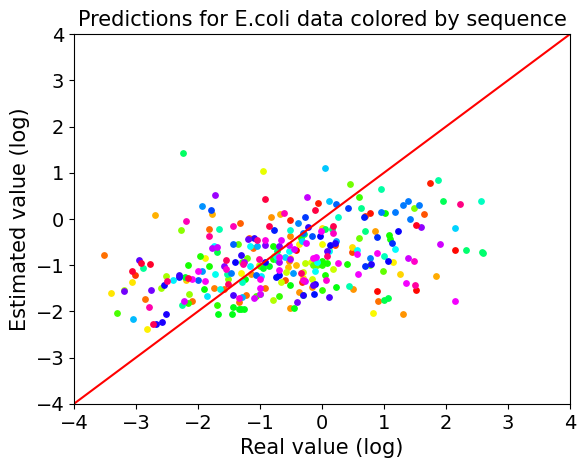

In [10]:
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cmx

uniq = list(set(df['enzyme']))
z = range(1, len(uniq))
hot = plt.get_cmap('hsv')
cNorm = colors.Normalize(vmin=0, vmax=len(uniq))
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=hot)

for i in range(len(uniq)):
    indx = df['enzyme'] == uniq[i]
    plt.scatter(df["value"][indx], df["KM [mM]"][indx], s=15, color=scalarMap.to_rgba(i), label=uniq[i])
    
plt.xlim(-4,4)
plt.ylim(-4,4)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Real value (log)', fontsize=15)
plt.ylabel('Estimated value (log)', fontsize=15)
plt.title('Predictions for E.coli data colored by sequence', fontsize=15)
plt.axline((1, 1), slope=1, c='red')
plt.show()

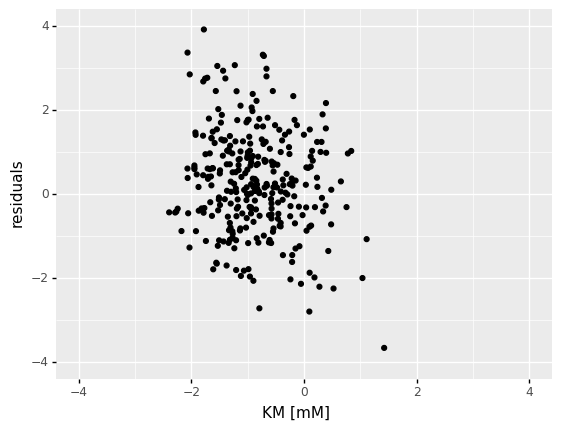

<ggplot: (-9223371936259200564)>

In [11]:
import plotnine

df["residuals"] = df["value"] - df["KM [mM]"]
    
(plotnine.ggplot(df, plotnine.aes(x = "KM [mM]", y ="residuals")) +
plotnine.geom_point()+
plotnine.xlim(-4,4)+
plotnine.ylim(-4,4))

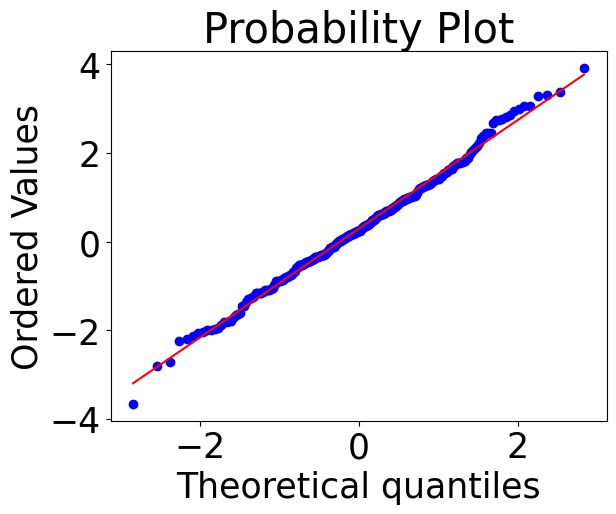

In [53]:
sci.stats.probplot(np.subtract(np.array(df["value"].tolist()), np.array(df["KM [mM]"].tolist())), dist="norm", plot=plt)
plt.show()

In [15]:
# EC_KM_pred =[[] for _ in range(6)]
# EC_KM =[[] for _ in range(6)]

# for ind in df.index:
#     try:
#         EC = int(df["EC"][ind][0][0])
#         EC_KM[EC-1].append(df["value"][ind])
#         EC_KM_pred[EC-1].append(df["KM [mM]"][ind])
#     except IndexError:
#         pass

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


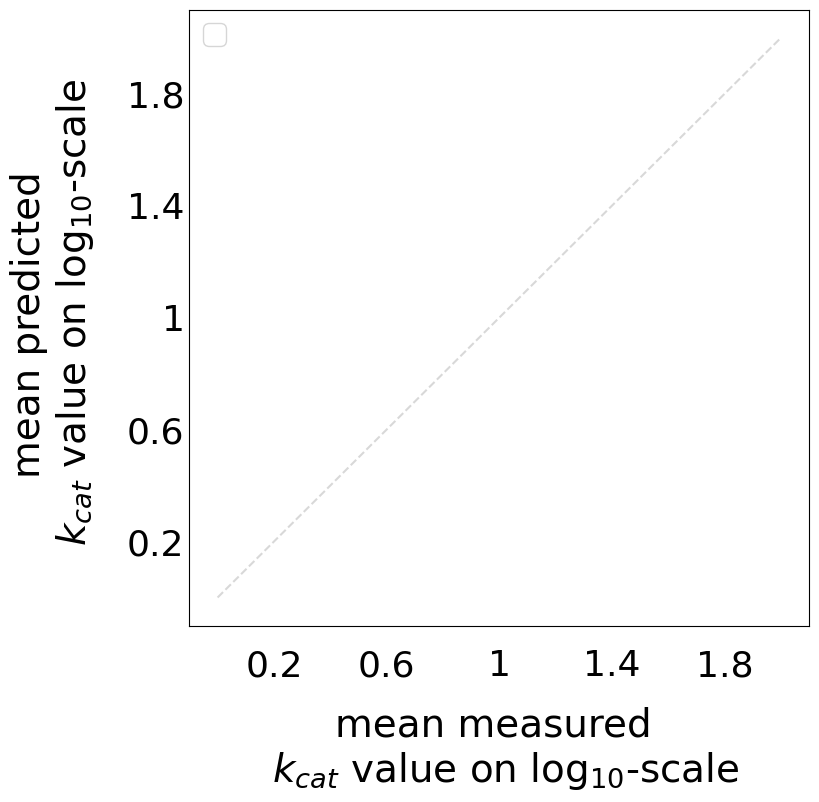

In [20]:
# fig, ax = plt.subplots(figsize= (8,8))
# plt.rcParams.update({'font.size': 28})

# classes = [str(i) for i in range(1,7)]

# for i in range(len(EC_KM)):
    
#     circle = plt.Circle((np.mean(EC_KM[i]), np.mean(EC_KM_pred[i]) ),
#                         np.sqrt(len(EC_KM_pred[i]))/300, color='navy', fill = True)
#     ax.add_artist(circle)
#     if i ==5:
#         ax.annotate("EC"+ str(i+1), (np.mean(EC_KM[i])+0.01, np.mean(EC_KM_pred[i])-0.05), fontsize=17, c='red', weight = "bold")
#     else:
#         ax.annotate("EC"+ str(i+1), (np.mean(EC_KM[i])+0.03, np.mean(EC_KM_pred[i])-0.01), fontsize=17, c='red', weight = "bold")
    

# ticks2 = [0.2, 0.6,1,1.4,1.8]
# labs = ticks2
# ax.set_xticks(ticks2)
# ax.set_xticklabels(labs,  y= -0.03, fontsize=26)
# ax.tick_params(axis='x', length=0, rotation = 0)

# ax.set_yticks(ticks2)
# ax.set_yticklabels(labs,  y= -0.03, fontsize=26)
# ax.tick_params(axis='y', length=0, rotation = 0)

# # plt.ylim((0,2))
# # plt.xlim((0, 2))
# plt.legend(loc = "upper left", fontsize=20)
# plt.xlabel('mean measured \n $k_{cat}$ value on $\log_{10}$-scale')
# plt.ylabel('mean predicted \n $k_{cat}$ value on $\log_{10}$-scale')
# ax.yaxis.set_label_coords(-0.15, 0.5)
# ax.xaxis.set_label_coords(0.5,-0.13)

# plt.plot([0,2], [0,2], color='grey', alpha = 0.3, linestyle='dashed')
# plt.savefig(join("..", "data", "EC_classes_mean_kcat.png"))
# plt.show()

In [ ]:
df["global_sim"] = (df["seq_sim"]/100)*df["reaction_sim"]

In [47]:
help_df = df

sim_bins_lb = [0.0, 0.4, 0.8]
sim_bins_ub = [0.4, 0.8, 1]
r2_scores, n_points, pearson_r = [], [], []
for i in range(len(sim_bins_lb)):
    help_df2 = help_df.loc[help_df["reaction_sim"] <= sim_bins_ub[i]].loc[help_df["reaction_sim"] >= sim_bins_lb[i]]
    pred = np.array(help_df2["KM [mM]"])
    true = np.array(help_df2["value"])
    r2_scores.append(sk.r2_score(true, pred))
    pearson_r.append(sci.stats.pearsonr(true, pred)[0])
    mse = np.mean(abs(true - pred)**2)
    n_points.append(len(pred))
    print("%s - %s" % (sim_bins_lb[i], sim_bins_ub[i]), r2_scores[-1], pearson_r[-1], mse, len(pred))
    

plt.rcParams.update({'font.size': 28})

fig, ax = plt.subplots(figsize= (8,6))

for i in range(len(sim_bins_lb)):    
    plt.scatter(i, r2_scores[i], c='navy', marker="o", linewidths= 8)
    ax.annotate(n_points[i], (i-0.06, r2_scores[i]+0.03), fontsize=17, c= "black", weight = "bold")

    
plt.xlabel('Global imilarity score')
plt.ylabel('Coefficient of \n determination R²')
ax.yaxis.set_label_coords(-0.13, 0.5)
ax.xaxis.set_label_coords(0.5,-0.23)

ticks2 = np.array(range(len(sim_bins_lb)))
labs = ["%s - %s" % (sim_bins_lb[i], sim_bins_ub[i]) for i in range(len(sim_bins_lb))]
ax.set_xticks(ticks2)
ax.set_xticklabels(labs,  y= -0.03, fontsize=24)
ax.tick_params(axis='x', length=0, rotation = 0)

plt.ylim((-1,1))
plt.show()

ValueError: x and y must have length at least 2.

In [ ]:
df.to_pickle('../data/final_output_' + organism + '.pkl')